# Lecture 5: Analyzing Massive Graphs - Part II
### The Art of Analyzing Big Data - The Data Scientist’s Toolbox 

## 0. Package Setup
For this lecture, we are going to use the [Kaggle](https://github.com/Kaggle/kaggle-api), [TuriCreate](https://github.com/apple/turicreate), and [Networkx](https://networkx.github.io) packages. Let's set them up:

In [1]:
# Installing the Kaggle package
!pip install kaggle 

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"<Insert Your Kaggle User Name>","key":"<Insert Your Kaggle API key>"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('~/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 ~/.kaggle/kaggle.json

In [2]:
!pip install turicreate
!pip install networkx

## Example 1:  Marvel Superheroes - Link Prediction

### Creating a Simple Friends Recommender
We can use networks to give recommendations to a vertex about other vertices it may want to connect to (with a link). One straightforward example to achieve this is by finding friends-of-friends with the highest number of common friends. For example, if we look at the Marvel Superheroes graph and want to give Antman suggestions about other heroes/villains he may want to interact with, we can look at the heroes Antman already connects to in the network. Then, we look at the heroes connected to the heroes that are already connected to Antman, i.e., friends-of-friends. Next, we can rank these friends-of-friends according to the number of common connections they have with Antman, i.e., according to their common-friends number with Antman.

Let's use Networkx to create a simple recommendation algorithm. First, let load the [Marvel Universe Social Network](https://www.kaggle.com/csanhueza/the-marvel-universe-social-network#edges.csv) dataset into a Networkx object:

In [ ]:
# Installing the Kaggle package
!pip install kaggle 

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"<Insert Your Kaggle User Name>","key":"<Insert Your Kaggle API key>"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('~/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 ~/.kaggle/kaggle.json

In [3]:
import networkx as nx
import turicreate as tc 


e_sf = tc.SFrame.read_csv("./datasets/the-marvel-universe-social-network/hero-network.csv")
g = nx.Graph() # Creating Undirected Graph
# adding all nodes and vertices at once
g.add_edges_from([(r['hero1'],r['hero2']) for r in e_sf])
print(nx.info(g))

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/the-marvel-universe-social-network/hero-network.csv

Parsing completed. Parsed 100 lines in 0.397145 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/the-marvel-universe-social-network/hero-network.csv

Parsing completed. Parsed 574467 lines in 0.334314 secs.

Name: 
Type: Graph
Number of nodes: 6426
Number of edges: 167219
Average degree:  52.0445


Now, let's write a function that returns the number of common friends of two vertices:

In [4]:
def common_friends(g,u,v):
    if not g.has_node(u) or not g.has_node(v):
        return None
    return set(g.neighbors(u)) & set(g.neighbors(v))

common_friends(g, 'SPIDER-MAN/PETER PAR', 'GREEN GOBLIN/NORMAN ')

{'ABSORBING MAN/CARL C',
 'ANGEL IV',
 'ANGEL/WARREN KENNETH',
 'ANT-MAN II/SCOTT HAR',
 'ANT-MAN/DR. HENRY J.',
 'AURA/ANN HERD',
 'AVRIL, SALLY',
 'BATWING/',
 'BEAST/HENRY &HANK& P',
 'BENDIX, DR. ALBERT',
 'BIG MAN/FREDERICK FO',
 'BLACK KING/SEBASTIAN',
 'BLACK KNIGHT IV/PROF',
 'BLACK KNIGHT V/DANE ',
 'BLACK TARANTULA II/C',
 'BLACKOUT/MARCUS DANI',
 'BLIZZARD/PROF. GREGO',
 'BROMWELL, DR.',
 'BROWN, MINDY MCPHERS',
 'BUSHKIN, BARNEY',
 'BUZZ',
 'CACHES, PROF. MARINA',
 'CAGE, LUKE/CARL LUCA',
 'CALYPSO',
 'CAPTAIN AMERICA',
 'CAPTAIN MARVEL II/MO',
 'CAPTAIN MARVEL/CAPTA',
 'CARNAGE/CLETUS KASAD',
 'CHALIZ, HAZRAM',
 'CHALIZ, SHANAZ RAYNA',
 'CHALIZ, TABRIAZ',
 'CHAN, SARAH',
 'CHERRYH, RANDOLPH WI',
 'CHESBRO',
 'CICERO, CAESAR BIG C',
 'CITIZEN V II/HELMUT ',
 'COLLECTOR/TANELEER T',
 'CONUNDRUM/',
 'CREEP/',
 'CRIME-MASTER/NICK LU',
 'CROMWELL, HAMILTON',
 'CYCLOPS/SCOTT SUMMER',
 'DAREDEVIL/MATT MURDO',
 'DEATH',
 'DELILAH',
 'DIPALMA, JOHNNY',
 'DR. DOOM/VICTOR VON ',
 'DR

Now let's write a simple function that ranks friends-of-friends according to the number of common friends: 

In [5]:
import operator
def find_friends_of_friends(g, v):
    "Returns a set with all the friends of friends of v that are not friends of v"
    friends_set = set(g.neighbors(v))
    friends_of_friends_set = set()
    for f in friends_set:
        friends_of_friends_set |= set(g.neighbors(f))
    friends_of_friends_set -= friends_set
    friends_of_friends_set -= {v}
    return friends_of_friends_set


def rank_friends_of_friends(g, v):
    rank_dict = {}
    vertices_set = find_friends_of_friends(g, v)
    for u in vertices_set:
        rank_dict[u] = len(common_friends(g, v, u))
    sorted_d = sorted(rank_dict.items(), key=operator.itemgetter(1), reverse=True)
    return sorted_d

rank_friends_of_friends(g, 'ANT-MAN/DR. HENRY J.')

[('KA-ZAR/KEVIN PLUNDER', 197),
 ('SUNSPOT/ROBERTO DACO', 184),
 ('RHINO', 171),
 ('HIGH EVOLUTIONARY/HE', 171),
 ("SHANNA/SHANNA O'HARA", 170),
 ('PALADIN/PAUL DENNIS', 168),
 ('PHOENIX III/RACHEL S', 163),
 ('GUARDIAN/JAMES MACDO', 160),
 ('SABRA/RUTH BAT-SERAP', 152),
 ('SNOWBIRD/NARYA/ANNE ', 152),
 ('MACTAGGERT, MOIRA KI', 150),
 ('HELA [ASGARDIAN]', 149),
 ('JUBILEE/JUBILATION L', 144),
 ('BEYONDER', 143),
 ('ZABU', 143),
 ('WARLOCK III', 140),
 ('TORPEDO III/BROCK JO', 140),
 ('URSA MAJOR/MIKHAIL U', 137),
 ('CYPHER/DOUG RAMSEY', 137),
 ('LOCKHEED', 135),
 ('MIRAGE II/DANIELLE M', 133),
 ('BLITZKRIEG/', 131),
 ('ROM, SPACEKNIGHT', 131),
 ('BOOMERANG/FRED MYERS', 129),
 ('MEGGAN', 128),
 ('BALLANTINE, KAYLA', 126),
 ('ARABIAN KNIGHT/ABDUL', 126),
 ('SHAMROCK/MOLLY FITZG', 125),
 ('BOOMER/TABITHA SMITH', 124),
 ('GHOST RIDER III/DAN ', 120),
 ('MAGIK/ILLYANA RASPUT', 119),
 ('BROTHER VOODOO/DANIE', 116),
 ('SIRYN/THERESA ROURKE', 116),
 ('AJAK/TECUMOTZIN [ETE', 115),
 ('GEE/ALEX P

In [6]:
rank_friends_of_friends(g,'HULK/DR. ROBERT BRUC')

[('SUNSPOT/ROBERTO DACO', 170),
 ('KINGPIN/WILSON FISK', 168),
 ('KNIGHT, MISTY', 158),
 ('MACTAGGERT, MOIRA KI', 147),
 ('COBRA/KLAUS VORHEES', 136),
 ('TOAD/MORTIMER TOYNBE', 133),
 ('BOOMER/TABITHA SMITH', 130),
 ('DIABLO/ESTEBAN DE AB', 128),
 ('RED SKULL/JOHANN SCH', 127),
 ('HYDROMAN/MORRIE BENC', 127),
 ('MEGGAN', 126),
 ('GEE/ALEX POWER', 126),
 ('KENT, CLARK', 121),
 ('CARTER, SHARON', 119),
 ('SPIDER-MAN CLONE/BEN', 118),
 ('COUNTERWEIGHT II/KAT', 116),
 ('COUNTERWEIGHT/JACK P', 113),
 ('LIGHTSPEED/JULIE POW', 113),
 ('THENA', 112),
 ('WING, COLLEEN', 111),
 ('CORSAIR', 107),
 ('SIRYN/THERESA ROURKE', 106),
 ('FORGOTTEN ONE/GILGAM', 105),
 ('DESTINY II/IRENE ADL', 105),
 ('DIAMONDBACK II/RACHE', 104),
 ('KRAVEN THE HUNTER/SE', 100),
 ('SPIRAL', 99),
 ('RADIOACTIVE MAN/DR. ', 99),
 ('ROSENTHAL, BERNIE', 98),
 ('LANG, CASSANDRA CASS', 98),
 ('SHOCKER/HERMAN SCHUL', 95),
 ("CH'OD", 95),
 ('SUMMERS, MADELYNE MA', 95),
 ('CITIZEN V III/DALLAS', 95),
 ("DEATHBIRD [SHI'AR]", 94),
 (

### Using Supervised Learning

While using the above method is simple for recommending friends, it is not accurate enough. For example, we may not recommend that a user connects to other people with similar interests or to users that are at a distance greater than 2. To overcome this issue, we can create a machine learning classifier that can predict the probability of a link existing. There are two scenarios for which this type of classifier can be useful: 
* _predicting missing links_. 
* _predicting future links_.

To predict links, we first need to construct a dataset of positive and negative examples. We select the positive links as observed links in the network, while negative links are selected at random (for a better strategy for the selection of negative links please see [Fire et al., 2013](http://www.ise.bgu.ac.il/faculty/fire/pdf/link_tists.pdf)). Let's write a function that creates negative and positive link sets:

In [7]:
# This is for predicting missing links scenario
import random 

def select_random_existing_links(g, n):
    l =list(g.edges())
    random.shuffle(l)
    return l[:n]

def select_random_non_existing_links(g, n):
    select_links = set()
    v_list = list(g.nodes())
    while len(select_links) < n:
        u = random.choice(v_list)
        v = random.choice(v_list)
        if g.has_edge(u,v) or (u,v) in select_links:
            continue
        else:
            select_links.add((u,v))
    return list(select_links)
            
    
postive_links = select_random_existing_links(g,10000)
negative_links = select_random_non_existing_links(g,10000)



After creating negative and positive links, the next setup is to calculate the features of each link. Let’s create a function that for each link calculates several simple links features:


**Note:** For the next example, we are using the [tqdm pacakge](https://github.com/tqdm/tqdm), which can be installed using:


In [8]:
!pip install tqdm

In [9]:
from tqdm import tqdm_notebook as tqdm 
def friends_measure(g, u,v):
    s = 0
    for x in g.neighbors(u):
        for y in g.neighbors(v):
            if g.has_edge(x,y) or x == y:
                s += 1
    return s

def total_friends(g, u, v):   
    return len(set(g.neighbors(v)) | set(g.neighbors(u)))

def get_features_dict(g,u, v):
    removed_edge = False
    if g.has_edge(u,v):
        g.remove_edge(u,v) #  remove edge before feature calculation
        removed_edge = True
    try:
        d = {
            'degree_v': len(list(g.neighbors(v))),
            'degree_u': len(list(g.neighbors(u))),
            'total_friends': total_friends(g,u,v),
            'common_friends': len(common_friends(g,u,v)),
            'jaccard_coefficient': list(nx.jaccard_coefficient(g,[(u,v)]))[0][2],
            'adamic_adar_index': list(nx.adamic_adar_index(g,[(u,v)]))[0][2],
            'friends_measure': friends_measure(g, u,v)
        }
    except:
        if removed_edge:
            g.add_edge(u,v) # return the edge back to the graph
        return None

    
    if removed_edge:
        g.add_edge(u,v) # return the edge back to the graph
    return d

links_features = []

for i in tqdm(range(len(postive_links))):    
    u,v = postive_links[i]
    d = get_features_dict(g, u,v )
    if d is None:
        continue
    d['class'] = True
    links_features.append(d)

for i in tqdm(range(len(negative_links))):    
    u,v = negative_links[i]
    d = get_features_dict(g, u,v )
    if d is None:
        continue
    d['class'] = False
    links_features.append(d)
links_features[0]


{'degree_v': 126,
 'degree_u': 595,
 'total_friends': 665,
 'common_friends': 56,
 'jaccard_coefficient': 0.08421052631578947,
 'adamic_adar_index': 9.63012536981076,
 'friends_measure': 15178,
 'class': True}

Let's load the dictionary into an SFrame object:

In [10]:
import turicreate as tc
features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure', 'class' ]
data_dict = {f:[] for f in features_list}
 

for d in links_features:
    for feature in features_list:
        data_dict[feature].append(d[feature])
sf = tc.SFrame(data_dict)
sf
    

adamic_adar_index,class,common_friends,degree_u,degree_v,friends_measure,jaccard_coefficient,total_friends
9.63012536981076,1,56,595,126,15178,0.08421052631578947,665
4.186902067216953,1,24,856,24,8355,0.028037383177570093,856
4.242886491926066,1,23,1235,34,8206,0.018459069020866775,1246
4.738654289778933,1,21,96,21,859,0.21875,96
6.341018866909226,1,33,47,76,2158,0.36666666666666664,90
5.563543248815053,1,31,438,41,6187,0.06919642857142858,448
3.6362877162031806,1,15,966,21,1538,0.015432098765432098,972
12.239509304670118,1,72,476,86,16127,0.1469387755102041,490
34.135022263064855,1,192,1081,376,54647,0.15177865612648223,1265
15.612959228629327,1,72,642,87,10550,0.1095890410958904,657


Let's use the data to construct a classifier:

In [11]:
test, train  = sf.random_split(0.2)
print(f"Train size {len(train)}\nTest size: {len(test)}" )
features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure' ]
cls = tc.classifier.create(train,features=features_list, target="class")


Train size 16031
Test size: 3969
PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.

PROGRESS: The following methods are available for this type of problem.
PROGRESS: BoostedTreesClassifier, RandomForestClassifier, DecisionTreeClassifier, SVMClassifier, LogisticClassifier
PROGRESS: The returned model will be chosen according to validation accuracy.


Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.021860     | 0.982402          | 0.973815            | 0.454018          | 0.458446            |

| 2         | 0.031141     | 0.982730          | 0.971322            | 0.320561          | 0.326452            |

| 3         | 0.041332     | 0.983978          | 0.976309            | 0.236801          | 0.244700            |

| 4         | 0.052336     | 0.984175          | 0.976309            | 0.180736          | 0.190014            |

| 5         | 0.061114     | 0.983912          | 0.976309            | 0.141353          | 0.153566            |

| 10        | 0.110484     | 0.986933          | 0.976309            | 0.059458          | 0.081363            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Random forest classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.018019     | 0.974785          | 0.961347            | 0.178501          | 0.198648            |

| 2         | 0.027120     | 0.979316          | 0.972569            | 0.168392          | 0.181552            |

| 3         | 0.036311     | 0.981220          | 0.973815            | 0.167023          | 0.180029            |

| 4         | 0.046117     | 0.981483          | 0.971322            | 0.166206          | 0.178449            |

| 5         | 0.054712     | 0.982139          | 0.972569            | 0.165200          | 0.177956            |

| 10        | 0.099185     | 0.981942          | 0.971322            | 0.165173          | 0.177849            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Decision tree classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.020862     | 0.982402          | 0.973815            | 0.164380          | 0.178365            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

SVM:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients    : 8

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 2        | 1.000000  | 0.043674     | 0.499770          | 0.497506            |

| 1         | 5        | 5.000000  | 0.123181     | 0.926981          | 0.920200            |

| 2         | 6        | 5.000000  | 0.164217     | 0.919102          | 0.903990            |

| 3         | 8        | 2.139840  | 0.222925     | 0.953050          | 0.947631            |

| 4         | 10       | 2.139840  | 0.286101     | 0.956990          | 0.956359            |

| 9         | 16       | 1.490248  | 0.512787     | 0.968547          | 0.963840            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients      : 8

Starting Newton Method

--------------------------------------------------------

+-----------+----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+--------------+-------------------+---------------------+

| 1         | 2        | 0.043056     | 0.911419          | 0.900249            |

| 2         | 3        | 0.088976     | 0.939064          | 0.936409            |

| 3         | 4        | 0.134020     | 0.957647          | 0.950125            |

| 4         | 5        | 0.173059     | 0.967431          | 0.962594            |

| 5         | 6        | 0.215573     | 0.973800          | 0.966334            |

| 6         | 7        | 0.258268     | 0.975967          | 0.975062            |

+-----------+----------+--------------+-------------------+---------------------+

TERMINATED: Terminated due to numerical difficulties.

This model may not be ideal. To improve it, consider doing one of the following:
(a) Increasing the regularization.
(b) Standardizing the input data.
(c) Removing highly correlated features.
(d) Removing `inf` and `NaN` values in the training data.

PROGRESS: Model selection based on validation accuracy:
PROGRESS: ---------------------------------------------
PROGRESS: BoostedTreesClassifier          : 0.9763092269326683
PROGRESS: RandomForestClassifier          : 0.9713216957605985
PROGRESS: DecisionTreeClassifier          : 0.972568578553616
PROGRESS: SVMClassifier                   : 0.9638403990024937
PROGRESS: LogisticClassifier              : 0.9750623441396509
PROGRESS: ---------------------------------------------
PROGRESS: Selecting BoostedTreesClassifier based on validation set performance.


 We can also calculate the classifier's AUC:

In [12]:
cls

Class                          : BoostedTreesClassifier

Schema
------
Number of examples             : 15229
Number of feature columns      : 7
Number of unpacked features    : 7
Number of classes              : 2

Settings
--------
Number of trees                : 10
Max tree depth                 : 6
Training time (sec)            : 0.1109
Training accuracy              : 0.9869
Validation accuracy            : 0.9763
Training log_loss              : 0.0595
Validation log_loss            : 0.0814
Training auc                   : 0.9989
Validation auc                 : 0.9945

In [13]:
results = cls.evaluate(test)
results

{'accuracy': 0.9778281683043588,
 'auc': 0.9960666140200752,
 'confusion_matrix': Columns:
 	target_label	int
 	predicted_label	int
 	count	int
 
 Rows: 4
 
 Data:
 +--------------+-----------------+-------+
 | target_label | predicted_label | count |
 +--------------+-----------------+-------+
 |      1       |        0        |   42  |
 |      1       |        1        |  1948 |
 |      0       |        1        |   46  |
 |      0       |        0        |  1933 |
 +--------------+-----------------+-------+
 [4 rows x 3 columns],
 'f1_score': 0.9779116465863453,
 'log_loss': 0.07745466638213759,
 'precision': 0.9769307923771314,
 'recall': 0.978894472361809,
 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 
 Rows: 100001
 
 Data:
 +-----------+-----+-----+------+------+
 | threshold | fpr | tpr |  p   |  n   |
 +-----------+-----+-----+------+------+
 |    0.0    | 1.0 | 1.0 | 1990 | 1979 |
 |   1e-05   | 1.0 | 1.0 | 1990 | 1979 |
 |   2e-05   | 1.0 

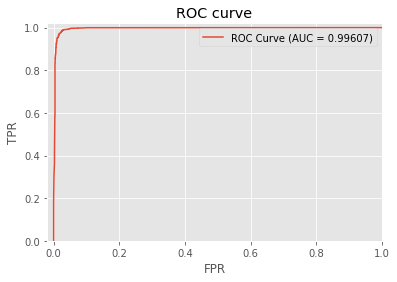

In [14]:
import matplotlib.pyplot as plt
%matplotlib inline

plt.style.use('ggplot')
plt.plot(results['roc_curve']['fpr'],
         results['roc_curve']['tpr'],
         label='ROC Curve (AUC = %0.5f)' %results['auc'])

plt.xlim([-0.02, 1.0])
plt.ylim([0., 1.02])
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('ROC curve')
plt.legend()
plt.show()

We can check the classifier's prediction probabilities:

In [15]:
cls.classify(test)

class,probability
1,0.9751444458961487
1,0.9751444458961487
0,0.6578031778335571
1,0.9754379391670227
1,0.9348450899124146
1,0.9716320037841797
1,0.9716320037841797
0,0.6157830059528351
1,0.9754379391670227
1,0.8576820492744446


Let's check how well, we can predict links by only using the _common-friends_:

In [16]:
cls = tc.classifier.create(train,features=["common_friends"], target="class")
results = cls.evaluate(test)
results

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.

PROGRESS: The following methods are available for this type of problem.
PROGRESS: BoostedTreesClassifier, RandomForestClassifier, DecisionTreeClassifier, SVMClassifier, LogisticClassifier
PROGRESS: The returned model will be chosen according to validation accuracy.


Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 1

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.011448     | 0.943069          | 0.958853            | 0.483386          | 0.475059            |

| 2         | 0.037764     | 0.943069          | 0.958853            | 0.368681          | 0.354964            |

| 3         | 0.052362     | 0.943069          | 0.958853            | 0.298004          | 0.280471            |

| 4         | 0.059595     | 0.943069          | 0.958853            | 0.252069          | 0.231606            |

| 5         | 0.067634     | 0.943069          | 0.958853            | 0.221329          | 0.198702            |

| 10        | 0.104377     | 0.943069          | 0.958853            | 0.164212          | 0.136824            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Random forest classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 1

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.010177     | 0.943069          | 0.958853            | 0.232676          | 0.209531            |

| 2         | 0.017015     | 0.943069          | 0.958853            | 0.232597          | 0.209418            |

| 3         | 0.024316     | 0.943069          | 0.958853            | 0.232495          | 0.209478            |

| 4         | 0.031075     | 0.943069          | 0.958853            | 0.232571          | 0.209626            |

| 5         | 0.037741     | 0.943069          | 0.958853            | 0.232553          | 0.209676            |

| 10        | 0.074133     | 0.943069          | 0.958853            | 0.232621          | 0.209785            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Decision tree classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 1

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.010577     | 0.943069          | 0.958853            | 0.232643          | 0.209640            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

SVM:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 1

Number of coefficients    : 2

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 3        | 5.000000  | 0.007891     | 0.500230          | 0.488778            |

| 1         | 6        | 2.500000  | 0.017523     | 0.752183          | 0.764339            |

| 2         | 11       | 1.245513  | 0.030740     | 0.821787          | 0.827930            |

| 3         | 12       | 1.245513  | 0.035083     | 0.893361          | 0.906484            |

| 4         | 14       | 1.245513  | 0.041269     | 0.928360          | 0.950125            |

| 9         | 21       | 1.245513  | 0.075452     | 0.939458          | 0.958853            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 1

Number of unpacked features : 1

Number of coefficients      : 2

Starting Newton Method

--------------------------------------------------------

+-----------+----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+--------------+-------------------+---------------------+

| 1         | 2        | 0.018461     | 0.783374          | 0.799252            |

| 2         | 3        | 0.027386     | 0.837612          | 0.841646            |

| 3         | 4        | 0.035500     | 0.875566          | 0.890274            |

| 4         | 5        | 0.043887     | 0.909712          | 0.926434            |

| 5         | 6        | 0.052430     | 0.922057          | 0.941397            |

| 8         | 9        | 0.077325     | 0.928360          | 0.950125            |

+-----------+----------+--------------+-------------------+---------------------+

SUCCESS: Optimal solution found.

PROGRESS: Model selection based on validation accuracy:
PROGRESS: ---------------------------------------------
PROGRESS: BoostedTreesClassifier          : 0.9588528678304239
PROGRESS: RandomForestClassifier          : 0.9588528678304239
PROGRESS: DecisionTreeClassifier          : 0.9588528678304239
PROGRESS: SVMClassifier                   : 0.9588528678304239
PROGRESS: LogisticClassifier              : 0.9501246882793017
PROGRESS: ---------------------------------------------
PROGRESS: Selecting BoostedTreesClassifier based on validation set performance.


{'accuracy': 0.9372637944066515,
 'auc': 0.9829088596088071,
 'confusion_matrix': Columns:
 	target_label	int
 	predicted_label	int
 	count	int
 
 Rows: 4
 
 Data:
 +--------------+-----------------+-------+
 | target_label | predicted_label | count |
 +--------------+-----------------+-------+
 |      1       |        0        |   69  |
 |      1       |        1        |  1921 |
 |      0       |        1        |  180  |
 |      0       |        0        |  1799 |
 +--------------+-----------------+-------+
 [4 rows x 3 columns],
 'f1_score': 0.9391346858958691,
 'log_loss': 0.17018960410565084,
 'precision': 0.91432651118515,
 'recall': 0.9653266331658291,
 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 
 Rows: 100001
 
 Data:
 +-----------+-----+-----+------+------+
 | threshold | fpr | tpr |  p   |  n   |
 +-----------+-----+-----+------+------+
 |    0.0    | 1.0 | 1.0 | 1990 | 1979 |
 |   1e-05   | 1.0 | 1.0 | 1990 | 1979 |
 |   2e-05   | 1.0 |

The above example is a "toy example" for creating a link prediction classifier.  Even using the common-friends as a single feature can provide pretty good results. 

**Question: Why are the classification results so high?**

Use the above classifier to create better friend recommendations to a specific vertex:


In [17]:
def get_friends_of_friends_sframe(g, v):
    l = find_friends_of_friends(g,v)
    features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure', 'class' ]
    data_dict = {f:[] for f in features_list}
    data_dict['name'] = []
    for u in l:
        d = get_features_dict(g,u, v)
        d['class'] = g.has_edge(u,v)
        for f in features_list:
            data_dict[f].append(d[f])
        data_dict["name"].append(u)
    return tc.SFrame(data_dict)

r_sf = get_friends_of_friends_sframe(g, 'ANT-MAN/DR. HENRY J.')
r_sf

adamic_adar_index,class,common_friends,degree_u,degree_v,friends_measure,jaccard_coefficient
0.8763205019834988,0,6,22,1082,4061,0.00546448087431694
3.8088215604162623,0,23,58,1082,7366,0.020590868397493287
1.7432602441427572,0,11,41,1082,4148,0.009892086330935251
0.29580751552438866,0,2,4,1082,749,0.0018450184501845018
0.14334147177031822,0,1,3,1082,605,0.0009225092250922509
0.16175772657433624,0,1,10,1082,224,0.0009165902841429881
1.0740765186349095,0,6,11,1082,1304,0.005519779208831647
1.3284494409303538,0,8,10,1082,1782,0.007380073800738007
0.4837108720332133,0,2,5,1082,693,0.0018433179723502304
1.1361420825493826,0,7,26,1082,3156,0.006357856494096276


In [18]:
features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure' ]
cls = tc.classifier.create(train,features=features_list, target="class")

r_sf['probability'] = cls.classify(r_sf[features_list])['probability']
r_sf = r_sf.sort(['probability','common_friends'] , ascending=False) 
r_sf['name', 'common_friends', 'probability'].print_rows(100)
r_sf['name', 'common_friends', 'probability'][5000:5100].print_rows(100)

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.

PROGRESS: The following methods are available for this type of problem.
PROGRESS: BoostedTreesClassifier, RandomForestClassifier, DecisionTreeClassifier, SVMClassifier, LogisticClassifier
PROGRESS: The returned model will be chosen according to validation accuracy.


Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.016405     | 0.982271          | 0.980050            | 0.454090          | 0.456094            |

| 2         | 0.027891     | 0.983059          | 0.978803            | 0.321072          | 0.325265            |

| 3         | 0.037906     | 0.983453          | 0.978803            | 0.236729          | 0.243982            |

| 4         | 0.048596     | 0.984503          | 0.978803            | 0.180071          | 0.188782            |

| 5         | 0.058629     | 0.984963          | 0.980050            | 0.140834          | 0.151927            |

| 10        | 0.106595     | 0.987589          | 0.975062            | 0.058624          | 0.079087            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Random forest classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.019865     | 0.981023          | 0.975062            | 0.166870          | 0.175949            |

| 2         | 0.028210     | 0.981811          | 0.977556            | 0.164671          | 0.171538            |

| 3         | 0.038440     | 0.982468          | 0.973815            | 0.164590          | 0.176791            |

| 4         | 0.046585     | 0.983387          | 0.973815            | 0.164188          | 0.175833            |

| 5         | 0.056338     | 0.983124          | 0.970075            | 0.164509          | 0.178038            |

| 10        | 0.101126     | 0.982599          | 0.972569            | 0.165241          | 0.177215            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Decision tree classifier:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.018705     | 0.982271          | 0.980050            | 0.164564          | 0.169696            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

SVM:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients    : 8

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 2        | 1.000000  | 0.041999     | 0.499376          | 0.504988            |

| 1         | 5        | 5.000000  | 0.120942     | 0.927244          | 0.930175            |

| 2         | 6        | 5.000000  | 0.160495     | 0.918642          | 0.917706            |

| 3         | 8        | 2.114265  | 0.220401     | 0.952787          | 0.950125            |

| 4         | 10       | 2.114265  | 0.280764     | 0.956793          | 0.953865            |

| 9         | 21       | 1.510830  | 0.595377     | 0.966183          | 0.965087            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 15229

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients      : 8

Starting Newton Method

--------------------------------------------------------

+-----------+----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+--------------+-------------------+---------------------+

| 1         | 2        | 0.052639     | 0.910959          | 0.913965            |

| 2         | 3        | 0.095983     | 0.938538          | 0.940150            |

| 3         | 4        | 0.140870     | 0.957778          | 0.956359            |

| 4         | 5        | 0.185104     | 0.967168          | 0.967581            |

| 5         | 6        | 0.229164     | 0.973734          | 0.972569            |

| 6         | 7        | 0.272626     | 0.976033          | 0.976309            |

+-----------+----------+--------------+-------------------+---------------------+

TERMINATED: Terminated due to numerical difficulties.

This model may not be ideal. To improve it, consider doing one of the following:
(a) Increasing the regularization.
(b) Standardizing the input data.
(c) Removing highly correlated features.
(d) Removing `inf` and `NaN` values in the training data.

PROGRESS: Model selection based on validation accuracy:
PROGRESS: ---------------------------------------------
PROGRESS: BoostedTreesClassifier          : 0.9750623441396509
PROGRESS: RandomForestClassifier          : 0.972568578553616
PROGRESS: DecisionTreeClassifier          : 0.9788029925187033
PROGRESS: SVMClassifier                   : 0.9650872817955112
PROGRESS: LogisticClassifier              : 0.9763092269326683
PROGRESS: ---------------------------------------------
PROGRESS: Selecting DecisionTreeClassifier based on validation set performance.
+----------------------+----------------+-------------------+
|         name         | common_friends |    probability    |
+----------------------+----------------+-------------------+
|          T           |       4        | 0.879461832344532 |
|   MISS SACCHARINE    |       4        | 0.879461832344532 |
|    CARLTON, JAKE     |       4        | 0.879461832344532 |
| QUINN, MIRANDA/M'RYN |       4        | 0.879461832344532 |
|   

In [19]:
 r_sf.sort('common_friends', ascending=False)

adamic_adar_index,class,common_friends,degree_u,degree_v,friends_measure,jaccard_coefficient
34.787538986069194,0,197,330,1082,55641,0.16213991769547326
32.49765233496148,0,184,521,1082,54425,0.12966878083157152
30.555924209079787,0,171,311,1082,46327,0.13993453355155483
30.111859635387702,0,171,334,1082,50290,0.13734939759036144
29.838643814460504,0,170,279,1082,50423,0.14273719563392107
29.188735513873617,0,168,300,1082,51439,0.13838550247116968
28.884310227841862,0,163,397,1082,49875,0.12386018237082067
27.31869529333024,0,160,304,1082,51232,0.13050570962479607
25.821185858193154,0,152,228,1082,48346,0.13126079447322972
25.882310796918194,0,152,244,1082,49490,0.12947189097103917


We can take a different approach to build the classifier by selecting a different set of negative links that 
are not selected completely in random (this selection may be very important in massive graphs - why?):

In [20]:
def get_random_friend_of_friend(g, v, max_tries=100):
    for i in range(max_tries):
        u = random.choice(list(g.neighbors(v)))
        x = random.choice(list(g.neighbors(u)))
        if not g.has_edge(v,x):
            return x
    return None
    
def select_random_non_existing_links_distance_2(g, n):
    select_links = set()
    v_list = list(g.nodes())
    while len(select_links) < n:
        v = random.choice(v_list)
        u = get_random_friend_of_friend(g, v)
        if u is None:
            continue
        select_links.add((v,u))
    return list(select_links)

negative_links = select_random_non_existing_links_distance_2(g, 10000)
len(negative_links)

10000

Let's retrain the classifier with the new example of negative links:

In [21]:
links_features = []
for i in tqdm(range(len(postive_links))):    
    u,v = postive_links[i]
    d = get_features_dict(g, u,v )
    d['class'] = True
    links_features.append(d)

for i in tqdm(range(len(negative_links))):    
    u,v = negative_links[i]
    d = get_features_dict(g, u,v )
    if d is None:
        continue
    d['class'] = False
    links_features.append(d)

    
features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure', 'class' ]
data_dict = {f:[] for f in features_list}
for d in links_features:
    for feature in features_list:
        data_dict[feature].append(d[feature])
sf = tc.SFrame(data_dict)
sf

adamic_adar_index,class,common_friends,degree_u,degree_v,friends_measure,jaccard_coefficient,total_friends
9.630125369810763,1,56,595,126,15178,0.08421052631578947,665
4.186902067216954,1,24,856,24,8355,0.028037383177570093,856
4.242886491926065,1,23,1235,34,8206,0.018459069020866775,1246
4.738654289778934,1,21,96,21,859,0.21875,96
6.341018866909225,1,33,47,76,2158,0.36666666666666664,90
5.563543248815053,1,31,438,41,6187,0.06919642857142858,448
3.6362877162031806,1,15,966,21,1538,0.015432098765432098,972
12.239509304670118,1,72,476,86,16127,0.1469387755102041,490
34.13502226306484,1,192,1081,376,54647,0.15177865612648223,1265
15.612959228629332,1,72,642,87,10550,0.1095890410958904,657


In [22]:
test, train  = sf.random_split(0.2)
print(f"Train size {len(train)}\nTest size: {len(test)}" )
features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure' ]
cls = tc.classifier.create(train,features=features_list, target="class")

Train size 15911
Test size: 4084
PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.

PROGRESS: The following methods are available for this type of problem.
PROGRESS: BoostedTreesClassifier, RandomForestClassifier, DecisionTreeClassifier, SVMClassifier, LogisticClassifier
PROGRESS: The returned model will be chosen according to validation accuracy.


Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.019639     | 0.914787          | 0.919598            | 0.501979          | 0.502327            |

| 2         | 0.030255     | 0.921535          | 0.924623            | 0.393752          | 0.396487            |

| 3         | 0.040271     | 0.923917          | 0.920854            | 0.325248          | 0.328521            |

| 4         | 0.051535     | 0.924578          | 0.923367            | 0.279848          | 0.286472            |

| 5         | 0.062766     | 0.928614          | 0.930905            | 0.247168          | 0.257851            |

| 10        | 0.112601     | 0.937413          | 0.922111            | 0.173620          | 0.198396            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Random forest classifier:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.021764     | 0.877737          | 0.870603            | 0.342846          | 0.345350            |

| 2         | 0.030993     | 0.916441          | 0.914573            | 0.290101          | 0.295666            |

| 3         | 0.040812     | 0.923652          | 0.912060            | 0.278714          | 0.287122            |

| 4         | 0.049855     | 0.921998          | 0.912060            | 0.276937          | 0.286162            |

| 5         | 0.060722     | 0.922593          | 0.910804            | 0.274622          | 0.282034            |

| 10        | 0.118699     | 0.925041          | 0.919598            | 0.269616          | 0.275334            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Decision tree classifier:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.019565     | 0.914787          | 0.919598            | 0.273553          | 0.273217            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

SVM:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients    : 8

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 2        | 1.000000  | 0.055003     | 0.521667          | 0.517588            |

| 1         | 5        | 5.000000  | 0.144228     | 0.873172          | 0.883166            |

| 2         | 6        | 5.000000  | 0.190399     | 0.791862          | 0.777638            |

| 3         | 11       | 0.889270  | 0.325526     | 0.854846          | 0.855528            |

| 4         | 13       | 0.889270  | 0.397568     | 0.874429          | 0.880653            |

| 9         | 19       | 1.000000  | 0.644084     | 0.883030          | 0.883166            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients      : 8

Starting Newton Method

--------------------------------------------------------

+-----------+----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+--------------+-------------------+---------------------+

| 1         | 2        | 0.052544     | 0.832220          | 0.832915            |

| 2         | 3        | 0.101365     | 0.857029          | 0.863065            |

| 3         | 4        | 0.150279     | 0.875753          | 0.878141            |

| 4         | 5        | 0.199140     | 0.882898          | 0.883166            |

| 5         | 6        | 0.247299     | 0.883890          | 0.884422            |

| 7         | 8        | 0.346505     | 0.883758          | 0.884422            |

+-----------+----------+--------------+-------------------+---------------------+

SUCCESS: Optimal solution found.

PROGRESS: Model selection based on validation accuracy:
PROGRESS: ---------------------------------------------
PROGRESS: BoostedTreesClassifier          : 0.9221105527638191
PROGRESS: RandomForestClassifier          : 0.9195979899497487
PROGRESS: DecisionTreeClassifier          : 0.9195979899497487
PROGRESS: SVMClassifier                   : 0.8831658291457286
PROGRESS: LogisticClassifier              : 0.8844221105527639
PROGRESS: ---------------------------------------------
PROGRESS: Selecting BoostedTreesClassifier based on validation set performance.


In [23]:
features_list = ['degree_v', 'degree_u', 'total_friends', 'common_friends', 'jaccard_coefficient', 'adamic_adar_index', 'friends_measure' ]
cls = tc.classifier.create(train,features=features_list, target="class")

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.

PROGRESS: The following methods are available for this type of problem.
PROGRESS: BoostedTreesClassifier, RandomForestClassifier, DecisionTreeClassifier, SVMClassifier, LogisticClassifier
PROGRESS: The returned model will be chosen according to validation accuracy.


Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.019848     | 0.920146          | 0.917085            | 0.500454          | 0.504346            |

| 2         | 0.031966     | 0.922527          | 0.914573            | 0.393697          | 0.402629            |

| 3         | 0.043331     | 0.925240          | 0.919598            | 0.324735          | 0.337694            |

| 4         | 0.056352     | 0.928680          | 0.914573            | 0.277956          | 0.293943            |

| 5         | 0.067251     | 0.929871          | 0.914573            | 0.245897          | 0.267384            |

| 10        | 0.124786     | 0.936619          | 0.917085            | 0.173354          | 0.205300            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Random forest classifier:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.017324     | 0.910354          | 0.896985            | 0.286857          | 0.294182            |

| 2         | 0.026087     | 0.914853          | 0.904523            | 0.280528          | 0.295482            |

| 3         | 0.035900     | 0.917433          | 0.893216            | 0.278688          | 0.293904            |

| 4         | 0.044677     | 0.919484          | 0.902010            | 0.274601          | 0.290174            |

| 5         | 0.054180     | 0.920609          | 0.903266            | 0.272888          | 0.288768            |

| 10        | 0.102172     | 0.920741          | 0.905779            | 0.271054          | 0.285946            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

Decision tree classifier:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.015915     | 0.920146          | 0.917085            | 0.270431          | 0.284441            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

SVM:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients    : 8

Starting L-BFGS

--------------------------------------------------------

+-----------+----------+-----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Step size | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+-----------+--------------+-------------------+---------------------+

| 0         | 2        | 1.000000  | 0.046014     | 0.515647          | 0.471106            |

| 1         | 5        | 5.000000  | 0.136277     | 0.875620          | 0.884422            |

| 2         | 6        | 5.000000  | 0.181647     | 0.784320          | 0.812814            |

| 3         | 12       | 4.240610  | 0.368782     | 0.884089          | 0.883166            |

| 4         | 17       | 2.991946  | 0.510386     | 0.871254          | 0.879397            |

| 9         | 24       | 1.692704  | 0.782789     | 0.800265          | 0.825377            |

+-----------+----------+-----------+--------------+-------------------+---------------------+

Logistic regression:

--------------------------------------------------------

Number of examples          : 15115

Number of classes           : 2

Number of feature columns   : 7

Number of unpacked features : 7

Number of coefficients      : 8

Starting Newton Method

--------------------------------------------------------

+-----------+----------+--------------+-------------------+---------------------+

| Iteration | Passes   | Elapsed Time | Training Accuracy | Validation Accuracy |

+-----------+----------+--------------+-------------------+---------------------+

| 1         | 2        | 0.051495     | 0.831690          | 0.853015            |

| 2         | 3        | 0.100329     | 0.856765          | 0.875628            |

| 3         | 4        | 0.151532     | 0.875223          | 0.885678            |

| 4         | 5        | 0.200004     | 0.881641          | 0.891960            |

| 5         | 6        | 0.249238     | 0.881972          | 0.893216            |

| 7         | 8        | 0.346695     | 0.881972          | 0.893216            |

+-----------+----------+--------------+-------------------+---------------------+

SUCCESS: Optimal solution found.

PROGRESS: Model selection based on validation accuracy:
PROGRESS: ---------------------------------------------
PROGRESS: BoostedTreesClassifier          : 0.9170854271356784
PROGRESS: RandomForestClassifier          : 0.9057788944723618
PROGRESS: DecisionTreeClassifier          : 0.9170854271356784
PROGRESS: SVMClassifier                   : 0.8253768844221105
PROGRESS: LogisticClassifier              : 0.8932160804020101
PROGRESS: ---------------------------------------------
PROGRESS: Selecting BoostedTreesClassifier based on validation set performance.


In [24]:
r_sf['probability'] = cls.classify(r_sf[features_list])['probability']
r_sf = r_sf.sort([ 'probability'] , ascending=False) 
r_sf['name', 'common_friends', 'probability'].print_rows(100)
r_sf['name', 'common_friends', 'probability'][5000:5100].print_rows(100)

+----------------------+----------------+--------------------+
|         name         | common_friends |    probability     |
+----------------------+----------------+--------------------+
|          T           |       4        | 0.9756927657872438 |
|   MISS SACCHARINE    |       4        | 0.9756927657872438 |
|    CARLTON, JAKE     |       4        | 0.9756927657872438 |
| QUINN, MIRANDA/M'RYN |       4        | 0.9756927657872438 |
|    MARTINEZ, MR.     |       4        | 0.9756927657872438 |
|   MCCORMICK, BARRY   |       4        | 0.9756927657872438 |
|     AUSTIN, GEN.     |       4        | 0.9756927657872438 |
|   WILLIFORD, BRENT   |       4        | 0.9756927657872438 |
|        COACH         |       4        | 0.9756927657872438 |
|    GILMORE, BERT     |       4        | 0.9756927657872438 |
|       CROSSBOW       |       4        | 0.9756927657872438 |
|         DOOP         |       4        | 0.9756927657872438 |
|    GALANNAN, BILL    |       4        | 0.97569276578

## Example 2:  Predicting a Vertex's Attributes

A network structure can be utilized to predict various entity's attributes. For example, we can look at a classroom and construct a social network based on it. This later can be used to predict various vertex’s attributes, such as a student’s department or [final exam score](http://www.ise.bgu.ac.il/faculty/fire/pdf/fire2012predicting.pdf). Another example is using a network structure to predict an individual’s lifespan. This can be done by converting the individual’s family tree into a network, and using various features, such as parents’ and siblings’ lifespans to construct a classifier that can predict  [an individual’s lifespan]( https://arxiv.org/pdf/1311.4276).
In this section, we show a simple example of how to use networks to complete missing data. We will utilize the [WikiTree data]( https://www.wikitree.com/wiki/Help:Database_Dumps) to construct a network. Then, we use the network to predict an individual’s place of birth.

First let’s create a network with users’ place of birth:

**Note:** Due to privacy concerns, you need to ask permission in order to download the WikiTree dataset.


In [35]:
import turicreate as tc
import networkx as nx

sf = tc.SFrame.read_csv('./datasets/wikitree/dump_people_users.csv', delimiter="\t", verbose=False)['User ID','Father', 'Mother', 'Birth Location']
sf = sf[sf.apply(lambda r: r['Father'] != 0 and r['Mother'] != 0)]
sf['Birth Location'] = sf['Birth Location'].apply(lambda s: s.split(",")[-1] if len(s) > 0 else "") 
sf.materialize()

We loaded the data to an SFrame object. Next, let's join tables to create an SFrame object with data regarding the sibling connections:

In [36]:
sf2 = sf.join(sf, on=["Father"])
sf2 = sf2.remove_columns(["Mother.1", "Birth Location.1"])
sf2 = sf2[sf2['User ID'] != sf2['User ID.1']]
sf2 = sf2.rename({'User ID.1':'Sibling'})

In [37]:
sf3 = sf.join(sf, on=["Mother"])
sf3 = sf3.remove_columns(["Father.1", "Birth Location.1"])
sf3 = sf3[sf3['User ID'] != sf3['User ID.1']]
sf3 = sf3.rename({'User ID.1':'Sibling'})

Now, we can create a single SFrame with all the links:

In [38]:
links_sf = sf2['User ID', 'Father']
links_sf = links_sf.rename({'User ID': "User1", "Father": "User2"})

t_sf = sf2['User ID', 'Mother']
t_sf = t_sf.rename({'User ID': "User1", "Mother": "User2"})
links_sf = links_sf.append(t_sf)

t_sf = sf2['User ID', 'Sibling']
t_sf = t_sf.rename({'User ID': "User1", "Sibling": "User2"})
links_sf = links_sf.append(t_sf)

t_sf = sf3['User ID', 'Sibling']
t_sf = t_sf.rename({'User ID': "User1", "Sibling": "User2"})
links_sf = links_sf.append(t_sf)

links_sf


User1,User2
57,55
63,249
94,249
288,66
289,66
291,66
87,425
102,425
115,112
116,112


Let's create an SGraph object using the links and vertices data:

In [39]:
links_sf = links_sf.unique()
v_sf = sf['User ID','Birth Location']
sg = tc.SGraph(vertices=v_sf, edges=links_sf, vid_field='User ID', src_field='User1', dst_field='User2')
sg.summary()

{'num_edges': 31717439, 'num_vertices': 6146450}

Now, we can use the SGraph object to predict a vertex's location based on the majority of its neighborhood:

In [40]:
from collections import Counter
import random
def predict_location_according_to_majority(v_id):
    d = {}
    try:
        g = sg.get_neighborhood(v_id)
        locations = []
    except:
        return None
    for r in g.vertices:
        if r["__id"] == v_id:
            d['actual'] = r['Birth Location']
        else:
            locations.append(r['Birth Location'])
    c = Counter(locations)
    d['predict'] = c.most_common(1)
    
    return d
v_list = list(v_sf["User ID"])
random.shuffle(v_list)
v_list = v_list[:20]
for i in v_list:    
    p = predict_location_according_to_majority(i)
    if p is None:
        continue
    print("Location: %s"  % (p))

Location: {'actual': ' Scotland', 'predict': [(' Scotland', 3)]}
Location: {'actual': ' Canada', 'predict': [(' Canada', 7)]}
Location: {'actual': ' United Kingdom', 'predict': [(None, 2)]}
Location: {'actual': 'Ollie Keokuk Co Iowa', 'predict': [('Ollie Keokuk Co Iowa', 7)]}
Location: {'actual': '', 'predict': [(None, 2)]}
Location: {'actual': ' USA', 'predict': [('', 1)]}
Location: {'actual': ' Sicily', 'predict': [(' Sicily', 4)]}
Location: {'actual': ' United States', 'predict': [('Ohio', 4)]}
Location: {'actual': '', 'predict': [('', 6)]}
Location: {'actual': '', 'predict': [('', 6)]}
Location: {'actual': ' Kentucky', 'predict': [(None, 2)]}
Location: {'actual': ' Netherlands', 'predict': [(None, 1)]}
Location: {'actual': '', 'predict': [('', 8)]}
Location: {'actual': ' United States', 'predict': [(' United States', 7)]}
Location: {'actual': '', 'predict': [('Pennsylvania', 5)]}
Location: {'actual': ' Virginia', 'predict': [('Louisa Co. Va.', 3)]}
Location: {'actual': ' USA', 'pre

## Example 3:  Identifying  Anomalous/Key Vertices

We can use a network structure to identify anomalous entities. For example, we can identify an anomalous vertex, which could be a spammer, socialbot, celebrity, or key employee, by identifying vertices which are connected to many different communities.

Let's analyze the [Enron Emails dataset](https://www.cs.cmu.edu/~./enron/) and construct the email networks by parsing the emails' _To_ and _From_ headers. Using the constructed Enron network, we will try to find methods to identify key employees in the company:

In [41]:
!mkdir ./datasets/enron
!wget -O ./datasets/enron/enron_mail_20150507.tar.gz https://www.cs.cmu.edu/~./enron/enron_mail_20150507.tar.gz
!tar -zxvf ./datasets/enron/enron_mail_20150507.tar.gz -C ./datasets/enron/
!ls ./datasets/enron

mkdir: ./datasets/enron: File exists
--2020-03-15 17:51:34--  https://www.cs.cmu.edu/~./enron/enron_mail_20150507.tar.gz
Resolving www.cs.cmu.edu (www.cs.cmu.edu)... 128.2.42.95
Connecting to www.cs.cmu.edu (www.cs.cmu.edu)|128.2.42.95|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 443254787 (423M) [application/x-gzip]
Saving to: ‘./datasets/enron/enron_mail_20150507.tar.gz’

./datasets/enron/en 100%[===================>] 422.72M  36.7KB/s    in 2h 36m  

2020-03-15 20:27:45 (46.2 KB/s) - ‘./datasets/enron/enron_mail_20150507.tar.gz’ saved [443254787/443254787]

x maildir/
x maildir/blair-l/
x maildir/blair-l/personnel___promotions/
x maildir/blair-l/personnel___promotions/1.
x maildir/blair-l/meetings___nng_customer_mtg/
x maildir/blair-l/meetings___nng_customer_mtg/8.
x maildir/blair-l/meetings___nng_customer_mtg/16.
x maildir/blair-l/meetings___nng_customer_mtg/13.
x maildir/blair-l/meetings___nng_customer_mtg/14.
x maildir/blair-l/meetings___nng_customer_

x maildir/blair-l/inbox/268.
x maildir/blair-l/inbox/133.
x maildir/blair-l/inbox/174.
x maildir/blair-l/inbox/151.
x maildir/blair-l/inbox/103.
x maildir/blair-l/inbox/208.
x maildir/blair-l/inbox/73.
x maildir/blair-l/inbox/120.
x maildir/blair-l/inbox/168.
x maildir/blair-l/inbox/33.
x maildir/blair-l/inbox/290.
x maildir/blair-l/inbox/263.
x maildir/blair-l/inbox/295.
x maildir/blair-l/inbox/96.
x maildir/blair-l/inbox/35.
x maildir/blair-l/inbox/158.
x maildir/blair-l/inbox/241.
x maildir/blair-l/inbox/64.
x maildir/blair-l/inbox/82.
x maildir/blair-l/inbox/10.
x maildir/blair-l/inbox/67.
x maildir/blair-l/inbox/221.
x maildir/blair-l/inbox/124.
x maildir/blair-l/inbox/206.
x maildir/blair-l/inbox/126.
x maildir/blair-l/inbox/199.
x maildir/blair-l/inbox/146.
x maildir/blair-l/inbox/200.
x maildir/blair-l/inbox/107.
x maildir/blair-l/inbox/138.
x maildir/blair-l/inbox/22.
x maildir/blair-l/inbox/89.
x maildir/blair-l/inbox/275.
x maildir/blair-l/inbox/76.
x maildir/blair-l/inbox/2

x maildir/blair-l/meetings/1046.
x maildir/blair-l/meetings/844.
x maildir/blair-l/meetings/957.
x maildir/blair-l/meetings/232.
x maildir/blair-l/meetings/450.
x maildir/blair-l/meetings/1015.
x maildir/blair-l/meetings/550.
x maildir/blair-l/meetings/396.
x maildir/blair-l/meetings/40.
x maildir/blair-l/meetings/383.
x maildir/blair-l/meetings/907.
x maildir/blair-l/meetings/561.
x maildir/blair-l/meetings/193.
x maildir/blair-l/meetings/1053.
x maildir/blair-l/meetings/311.
x maildir/blair-l/meetings/1115.
x maildir/blair-l/meetings/744.
x maildir/blair-l/meetings/697.
x maildir/blair-l/meetings/1008.
x maildir/blair-l/meetings/551.
x maildir/blair-l/meetings/223.
x maildir/blair-l/meetings/719.
x maildir/blair-l/meetings/845.
x maildir/blair-l/meetings/795.
x maildir/blair-l/meetings/316.
x maildir/blair-l/meetings/77.
x maildir/blair-l/meetings/433.
x maildir/blair-l/meetings/302.
x maildir/blair-l/meetings/58.
x maildir/blair-l/meetings/512.
x maildir/blair-l/meetings/81.
x maild

x maildir/blair-l/meetings/449.
x maildir/blair-l/meetings/643.
x maildir/blair-l/meetings/172.
x maildir/blair-l/meetings/508.
x maildir/blair-l/meetings/247.
x maildir/blair-l/meetings/848.
x maildir/blair-l/meetings/341.
x maildir/blair-l/meetings/805.
x maildir/blair-l/meetings/778.
x maildir/blair-l/meetings/621.
x maildir/blair-l/meetings/808.
x maildir/blair-l/meetings/47.
x maildir/blair-l/meetings/881.
x maildir/blair-l/meetings/625.
x maildir/blair-l/meetings/878.
x maildir/blair-l/meetings/143.
x maildir/blair-l/meetings/243.
x maildir/blair-l/meetings/614.
x maildir/blair-l/meetings/793.
x maildir/blair-l/meetings/506.
x maildir/blair-l/meetings/703.
x maildir/blair-l/meetings/28.
x maildir/blair-l/meetings/260.
x maildir/blair-l/meetings/24.
x maildir/blair-l/meetings/467.
x maildir/blair-l/meetings/812.
x maildir/blair-l/meetings/53.
x maildir/blair-l/meetings/657.
x maildir/blair-l/meetings/882.
x maildir/blair-l/meetings/1035.
x maildir/blair-l/meetings/160.
x maildir/b

x maildir/blair-l/meetings/611.
x maildir/blair-l/meetings/327.
x maildir/blair-l/meetings/18.
x maildir/blair-l/meetings/288.
x maildir/blair-l/meetings/953.
x maildir/blair-l/meetings/358.
x maildir/blair-l/meetings/325.
x maildir/blair-l/meetings/779.
x maildir/blair-l/meetings/155.
x maildir/blair-l/meetings/42.
x maildir/blair-l/meetings/515.
x maildir/blair-l/meetings/941.
x maildir/blair-l/meetings/307.
x maildir/blair-l/meetings/943.
x maildir/blair-l/meetings/1041.
x maildir/blair-l/meetings/266.
x maildir/blair-l/meetings/855.
x maildir/blair-l/meetings/481.
x maildir/blair-l/meetings/97.
x maildir/blair-l/meetings/201.
x maildir/blair-l/meetings/349.
x maildir/blair-l/meetings/610.
x maildir/blair-l/meetings/17.
x maildir/blair-l/meetings/78.
x maildir/blair-l/meetings/273.
x maildir/blair-l/meetings/125.
x maildir/blair-l/meetings/44.
x maildir/blair-l/meetings/834.
x maildir/blair-l/meetings/899.
x maildir/blair-l/meetings/851.
x maildir/blair-l/meetings/497.
x maildir/bla

x maildir/blair-l/sent_items/550.
x maildir/blair-l/sent_items/396.
x maildir/blair-l/sent_items/40.
x maildir/blair-l/sent_items/383.
x maildir/blair-l/sent_items/907.
x maildir/blair-l/sent_items/561.
x maildir/blair-l/sent_items/193.
x maildir/blair-l/sent_items/311.
x maildir/blair-l/sent_items/744.
x maildir/blair-l/sent_items/697.
x maildir/blair-l/sent_items/551.
x maildir/blair-l/sent_items/223.
x maildir/blair-l/sent_items/719.
x maildir/blair-l/sent_items/795.
x maildir/blair-l/sent_items/316.
x maildir/blair-l/sent_items/77.
x maildir/blair-l/sent_items/433.
x maildir/blair-l/sent_items/302.
x maildir/blair-l/sent_items/58.
x maildir/blair-l/sent_items/512.
x maildir/blair-l/sent_items/81.
x maildir/blair-l/sent_items/46.
x maildir/blair-l/sent_items/892.
x maildir/blair-l/sent_items/543.
x maildir/blair-l/sent_items/387.
x maildir/blair-l/sent_items/937.
x maildir/blair-l/sent_items/526.
x maildir/blair-l/sent_items/768.
x maildir/blair-l/sent_items/16.
x maildir/blair-l/se

x maildir/blair-l/sent_items/216.
x maildir/blair-l/sent_items/455.
x maildir/blair-l/sent_items/799.
x maildir/blair-l/sent_items/887.
x maildir/blair-l/sent_items/929.
x maildir/blair-l/sent_items/585.
x maildir/blair-l/sent_items/520.
x maildir/blair-l/sent_items/762.
x maildir/blair-l/sent_items/800.
x maildir/blair-l/sent_items/432.
x maildir/blair-l/sent_items/156.
x maildir/blair-l/sent_items/15.
x maildir/blair-l/sent_items/80.
x maildir/blair-l/sent_items/92.
x maildir/blair-l/sent_items/544.
x maildir/blair-l/sent_items/713.
x maildir/blair-l/sent_items/552.
x maildir/blair-l/sent_items/772.
x maildir/blair-l/sent_items/32.
x maildir/blair-l/sent_items/644.
x maildir/blair-l/sent_items/500.
x maildir/blair-l/sent_items/165.
x maildir/blair-l/sent_items/571.
x maildir/blair-l/sent_items/661.
x maildir/blair-l/sent_items/130.
x maildir/blair-l/sent_items/87.
x maildir/blair-l/sent_items/385.
x maildir/blair-l/sent_items/86.
x maildir/blair-l/sent_items/722.
x maildir/blair-l/se

x maildir/blair-l/sent_items/502.
x maildir/blair-l/sent_items/910.
x maildir/blair-l/sent_items/919.
x maildir/blair-l/sent_items/116.
x maildir/blair-l/sent_items/227.
x maildir/blair-l/sent_items/738.
x maildir/blair-l/sent_items/620.
x maildir/blair-l/sent_items/336.
x maildir/blair-l/sent_items/555.
x maildir/blair-l/sent_items/607.
x maildir/blair-l/sent_items/751.
x maildir/blair-l/sent_items/361.
x maildir/blair-l/sent_items/491.
x maildir/blair-l/sent_items/950.
x maildir/blair-l/sent_items/394.
x maildir/blair-l/sent_items/371.
x maildir/blair-l/sent_items/774.
x maildir/blair-l/sent_items/688.
x maildir/blair-l/sent_items/930.
x maildir/blair-l/sent_items/753.
x maildir/blair-l/sent_items/313.
x maildir/blair-l/sent_items/894.
x maildir/blair-l/sent_items/277.
x maildir/blair-l/sent_items/395.
x maildir/blair-l/sent_items/874.
x maildir/blair-l/sent_items/85.
x maildir/blair-l/sent_items/466.
x maildir/blair-l/sent_items/880.
x maildir/blair-l/sent_items/84.
x maildir/blair-

x maildir/blair-l/deleted_items/62.
x maildir/blair-l/deleted_items/517.
x maildir/blair-l/deleted_items/217.
x maildir/blair-l/deleted_items/408.
x maildir/blair-l/deleted_items/629.
x maildir/blair-l/deleted_items/245.
x maildir/blair-l/deleted_items/63.
x maildir/blair-l/deleted_items/407.
x maildir/blair-l/deleted_items/287.
x maildir/blair-l/deleted_items/412.
x maildir/blair-l/deleted_items/90.
x maildir/blair-l/deleted_items/534.
x maildir/blair-l/deleted_items/360.
x maildir/blair-l/deleted_items/670.
x maildir/blair-l/deleted_items/177.
x maildir/blair-l/deleted_items/329.
x maildir/blair-l/deleted_items/300.
x maildir/blair-l/deleted_items/218.
x maildir/blair-l/deleted_items/666.
x maildir/blair-l/deleted_items/638.
x maildir/blair-l/deleted_items/581.
x maildir/blair-l/deleted_items/333.
x maildir/blair-l/deleted_items/249.
x maildir/blair-l/deleted_items/631.
x maildir/blair-l/deleted_items/251.
x maildir/blair-l/deleted_items/540.
x maildir/blair-l/deleted_items/545.
x ma

x maildir/blair-l/deleted_items/448.
x maildir/blair-l/deleted_items/400.
x maildir/blair-l/deleted_items/224.
x maildir/blair-l/deleted_items/188.
x maildir/blair-l/deleted_items/254.
x maildir/blair-l/deleted_items/529.
x maildir/blair-l/deleted_items/399.
x maildir/blair-l/deleted_items/564.
x maildir/blair-l/deleted_items/374.
x maildir/blair-l/deleted_items/191.
x maildir/blair-l/deleted_items/105.
x maildir/blair-l/deleted_items/324.
x maildir/blair-l/deleted_items/647.
x maildir/blair-l/deleted_items/570.
x maildir/blair-l/deleted_items/487.
x maildir/blair-l/deleted_items/598.
x maildir/blair-l/deleted_items/686.
x maildir/blair-l/deleted_items/68.
x maildir/blair-l/deleted_items/353.
x maildir/blair-l/deleted_items/628.
x maildir/blair-l/deleted_items/119.
x maildir/blair-l/deleted_items/292.
x maildir/blair-l/deleted_items/665.
x maildir/blair-l/deleted_items/364.
x maildir/blair-l/deleted_items/645.
x maildir/blair-l/deleted_items/451.
x maildir/blair-l/deleted_items/197.
x 

x maildir/badeer-r/all_documents/54.
x maildir/badeer-r/all_documents/186.
x maildir/badeer-r/all_documents/164.
x maildir/badeer-r/all_documents/3.
x maildir/badeer-r/all_documents/136.
x maildir/badeer-r/all_documents/183.
x maildir/badeer-r/all_documents/52.
x maildir/badeer-r/all_documents/194.
x maildir/badeer-r/all_documents/296.
x maildir/badeer-r/all_documents/202.
x maildir/badeer-r/all_documents/121.
x maildir/badeer-r/all_documents/93.
x maildir/badeer-r/all_documents/220.
x maildir/badeer-r/all_documents/212.
x maildir/badeer-r/all_documents/229.
x maildir/badeer-r/all_documents/75.
x maildir/badeer-r/all_documents/257.
x maildir/badeer-r/all_documents/114.
x maildir/badeer-r/all_documents/142.
x maildir/badeer-r/all_documents/59.
x maildir/badeer-r/all_documents/56.
x maildir/badeer-r/all_documents/4.
x maildir/badeer-r/all_documents/161.
x maildir/badeer-r/all_documents/6.
x maildir/badeer-r/all_documents/166.
x maildir/badeer-r/all_documents/279.
x maildir/badeer-r/all_d

x maildir/badeer-r/discussion_threads/177.
x maildir/badeer-r/discussion_threads/218.
x maildir/badeer-r/discussion_threads/249.
x maildir/badeer-r/discussion_threads/251.
x maildir/badeer-r/discussion_threads/222.
x maildir/badeer-r/discussion_threads/185.
x maildir/badeer-r/discussion_threads/176.
x maildir/badeer-r/discussion_threads/205.
x maildir/badeer-r/discussion_threads/237.
x maildir/badeer-r/discussion_threads/271.
x maildir/badeer-r/discussion_threads/65.
x maildir/badeer-r/discussion_threads/250.
x maildir/badeer-r/discussion_threads/131.
x maildir/badeer-r/discussion_threads/144.
x maildir/badeer-r/discussion_threads/38.
x maildir/badeer-r/discussion_threads/11.
x maildir/badeer-r/discussion_threads/264.
x maildir/badeer-r/discussion_threads/57.
x maildir/badeer-r/discussion_threads/215.
x maildir/badeer-r/discussion_threads/157.
x maildir/badeer-r/discussion_threads/172.
x maildir/badeer-r/discussion_threads/247.
x maildir/badeer-r/discussion_threads/47.
x maildir/badeer

x maildir/ring-r/eesidealsgsaregion1/15.
x maildir/ring-r/eesidealsgsaregion1/32.
x maildir/ring-r/eesidealsgsaregion1/3.
x maildir/ring-r/eesidealsgsaregion1/4.
x maildir/ring-r/eesidealsgsaregion1/6.
x maildir/ring-r/eesidealsgsaregion1/34.
x maildir/ring-r/eesidealsgsaregion1/7.
x maildir/ring-r/eesidealsgsaregion1/20.
x maildir/ring-r/eesidealsgsaregion1/5.
x maildir/ring-r/eesidealsgsaregion1/2.
x maildir/ring-r/eesidealsgsaregion1/1.
x maildir/ring-r/eesidealsgsaregion1/12.
x maildir/ring-r/eesidealsgsaregion1/18.
x maildir/ring-r/eesidealsgsaregion1/17.
x maildir/ring-r/eesidealsgsaregion1/37.
x maildir/ring-r/eesidealsgsaregion1/31.
x maildir/ring-r/eesidealsgsaregion1/36.
x maildir/ring-r/eesidealsgsaregion1/26.
x maildir/ring-r/inbox/
x maildir/ring-r/inbox/61.
x maildir/ring-r/inbox/29.
x maildir/ring-r/inbox/30.
x maildir/ring-r/inbox/55.
x maildir/ring-r/inbox/27.
x maildir/ring-r/inbox/8.
x maildir/ring-r/inbox/23.
x maildir/ring-r/inbox/19.
x maildir/ring-r/inbox/72.
x m

x maildir/ring-r/eesirenewableenergy/431.
x maildir/ring-r/eesirenewableenergy/61.
x maildir/ring-r/eesirenewableenergy/110.
x maildir/ring-r/eesirenewableenergy/29.
x maildir/ring-r/eesirenewableenergy/30.
x maildir/ring-r/eesirenewableenergy/112.
x maildir/ring-r/eesirenewableenergy/219.
x maildir/ring-r/eesirenewableenergy/55.
x maildir/ring-r/eesirenewableenergy/27.
x maildir/ring-r/eesirenewableenergy/43.
x maildir/ring-r/eesirenewableenergy/226.
x maildir/ring-r/eesirenewableenergy/210.
x maildir/ring-r/eesirenewableenergy/8.
x maildir/ring-r/eesirenewableenergy/463.
x maildir/ring-r/eesirenewableenergy/413.
x maildir/ring-r/eesirenewableenergy/182.
x maildir/ring-r/eesirenewableenergy/23.
x maildir/ring-r/eesirenewableenergy/19.
x maildir/ring-r/eesirenewableenergy/214.
x maildir/ring-r/eesirenewableenergy/170.
x maildir/ring-r/eesirenewableenergy/72.
x maildir/ring-r/eesirenewableenergy/190.
x maildir/ring-r/eesirenewableenergy/235.
x maildir/ring-r/eesirenewableenergy/230.
x m

x maildir/ring-r/sent_items/14.
x maildir/ring-r/sent_items/39.
x maildir/ring-r/sent_items/33.
x maildir/ring-r/sent_items/35.
x maildir/ring-r/sent_items/10.
x maildir/ring-r/sent_items/22.
x maildir/ring-r/sent_items/41.
x maildir/ring-r/sent_items/9.
x maildir/ring-r/sent_items/25.
x maildir/ring-r/sent_items/38.
x maildir/ring-r/sent_items/11.
x maildir/ring-r/sent_items/47.
x maildir/ring-r/sent_items/28.
x maildir/ring-r/sent_items/24.
x maildir/ring-r/sent_items/15.
x maildir/ring-r/sent_items/32.
x maildir/ring-r/sent_items/3.
x maildir/ring-r/sent_items/52.
x maildir/ring-r/sent_items/4.
x maildir/ring-r/sent_items/6.
x maildir/ring-r/sent_items/34.
x maildir/ring-r/sent_items/7.
x maildir/ring-r/sent_items/50.
x maildir/ring-r/sent_items/20.
x maildir/ring-r/sent_items/49.
x maildir/ring-r/sent_items/5.
x maildir/ring-r/sent_items/51.
x maildir/ring-r/sent_items/2.
x maildir/ring-r/sent_items/1.
x maildir/ring-r/sent_items/45.
x maildir/ring-r/sent_items/12.
x maildir/ring-r

x maildir/ring-r/deleted_items/45.
x maildir/ring-r/deleted_items/12.
x maildir/ring-r/deleted_items/18.
x maildir/ring-r/deleted_items/288.
x maildir/ring-r/deleted_items/155.
x maildir/ring-r/deleted_items/42.
x maildir/ring-r/deleted_items/266.
x maildir/ring-r/deleted_items/97.
x maildir/ring-r/deleted_items/201.
x maildir/ring-r/deleted_items/17.
x maildir/ring-r/deleted_items/78.
x maildir/ring-r/deleted_items/273.
x maildir/ring-r/deleted_items/125.
x maildir/ring-r/deleted_items/44.
x maildir/ring-r/deleted_items/37.
x maildir/ring-r/deleted_items/253.
x maildir/ring-r/deleted_items/123.
x maildir/ring-r/deleted_items/207.
x maildir/ring-r/deleted_items/48.
x maildir/ring-r/deleted_items/106.
x maildir/ring-r/deleted_items/233.
x maildir/ring-r/deleted_items/31.
x maildir/ring-r/deleted_items/267.
x maildir/ring-r/deleted_items/196.
x maildir/ring-r/deleted_items/137.
x maildir/ring-r/deleted_items/192.
x maildir/ring-r/deleted_items/36.
x maildir/ring-r/deleted_items/256.
x ma

x maildir/cuilla-m/inbox/75.
x maildir/cuilla-m/inbox/56.
x maildir/cuilla-m/inbox/4.
x maildir/cuilla-m/inbox/6.
x maildir/cuilla-m/inbox/34.
x maildir/cuilla-m/inbox/7.
x maildir/cuilla-m/inbox/20.
x maildir/cuilla-m/inbox/5.
x maildir/cuilla-m/inbox/2.
x maildir/cuilla-m/inbox/1.
x maildir/cuilla-m/inbox/12.
x maildir/cuilla-m/inbox/18.
x maildir/cuilla-m/inbox/42.
x maildir/cuilla-m/inbox/17.
x maildir/cuilla-m/inbox/78.
x maildir/cuilla-m/inbox/44.
x maildir/cuilla-m/inbox/37.
x maildir/cuilla-m/inbox/31.
x maildir/cuilla-m/inbox/36.
x maildir/cuilla-m/inbox/68.
x maildir/cuilla-m/inbox/74.
x maildir/cuilla-m/inbox/26.
x maildir/cuilla-m/10_fantasy/
x maildir/cuilla-m/10_fantasy/29.
x maildir/cuilla-m/10_fantasy/30.
x maildir/cuilla-m/10_fantasy/27.
x maildir/cuilla-m/10_fantasy/43.
x maildir/cuilla-m/10_fantasy/8.
x maildir/cuilla-m/10_fantasy/23.
x maildir/cuilla-m/10_fantasy/19.
x maildir/cuilla-m/10_fantasy/40.
x maildir/cuilla-m/10_fantasy/46.
x maildir/cuilla-m/10_fantasy/16

x maildir/cuilla-m/sent_items/49.
x maildir/cuilla-m/sent_items/5.
x maildir/cuilla-m/sent_items/51.
x maildir/cuilla-m/sent_items/2.
x maildir/cuilla-m/sent_items/95.
x maildir/cuilla-m/sent_items/1.
x maildir/cuilla-m/sent_items/171.
x maildir/cuilla-m/sent_items/45.
x maildir/cuilla-m/sent_items/12.
x maildir/cuilla-m/sent_items/18.
x maildir/cuilla-m/sent_items/42.
x maildir/cuilla-m/sent_items/97.
x maildir/cuilla-m/sent_items/17.
x maildir/cuilla-m/sent_items/78.
x maildir/cuilla-m/sent_items/125.
x maildir/cuilla-m/sent_items/44.
x maildir/cuilla-m/sent_items/37.
x maildir/cuilla-m/sent_items/123.
x maildir/cuilla-m/sent_items/48.
x maildir/cuilla-m/sent_items/106.
x maildir/cuilla-m/sent_items/31.
x maildir/cuilla-m/sent_items/36.
x maildir/cuilla-m/sent_items/100.
x maildir/cuilla-m/sent_items/105.
x maildir/cuilla-m/sent_items/68.
x maildir/cuilla-m/sent_items/119.
x maildir/cuilla-m/sent_items/116.
x maildir/cuilla-m/sent_items/85.
x maildir/cuilla-m/sent_items/84.
x maildir

x maildir/cuilla-m/deleted_items/156.
x maildir/cuilla-m/deleted_items/15.
x maildir/cuilla-m/deleted_items/80.
x maildir/cuilla-m/deleted_items/92.
x maildir/cuilla-m/deleted_items/552.
x maildir/cuilla-m/deleted_items/32.
x maildir/cuilla-m/deleted_items/165.
x maildir/cuilla-m/deleted_items/130.
x maildir/cuilla-m/deleted_items/87.
x maildir/cuilla-m/deleted_items/385.
x maildir/cuilla-m/deleted_items/86.
x maildir/cuilla-m/deleted_items/209.
x maildir/cuilla-m/deleted_items/102.
x maildir/cuilla-m/deleted_items/98.
x maildir/cuilla-m/deleted_items/416.
x maildir/cuilla-m/deleted_items/159.
x maildir/cuilla-m/deleted_items/440.
x maildir/cuilla-m/deleted_items/559.
x maildir/cuilla-m/deleted_items/437.
x maildir/cuilla-m/deleted_items/280.
x maildir/cuilla-m/deleted_items/445.
x maildir/cuilla-m/deleted_items/355.
x maildir/cuilla-m/deleted_items/386.
x maildir/cuilla-m/deleted_items/265.
x maildir/cuilla-m/deleted_items/91.
x maildir/cuilla-m/deleted_items/418.
x maildir/cuilla-m/d

x maildir/harris-s/inbox/62.
x maildir/harris-s/inbox/38.
x maildir/harris-s/inbox/57.
x maildir/harris-s/inbox/47.
x maildir/harris-s/inbox/28.
x maildir/harris-s/inbox/24.
x maildir/harris-s/inbox/53.
x maildir/harris-s/inbox/15.
x maildir/harris-s/inbox/54.
x maildir/harris-s/inbox/3.
x maildir/harris-s/inbox/52.
x maildir/harris-s/inbox/59.
x maildir/harris-s/inbox/56.
x maildir/harris-s/inbox/4.
x maildir/harris-s/inbox/6.
x maildir/harris-s/inbox/7.
x maildir/harris-s/inbox/50.
x maildir/harris-s/inbox/20.
x maildir/harris-s/inbox/49.
x maildir/harris-s/inbox/5.
x maildir/harris-s/inbox/51.
x maildir/harris-s/inbox/2.
x maildir/harris-s/inbox/1.
x maildir/harris-s/inbox/45.
x maildir/harris-s/inbox/12.
x maildir/harris-s/inbox/18.
x maildir/harris-s/inbox/42.
x maildir/harris-s/inbox/17.
x maildir/harris-s/inbox/44.
x maildir/harris-s/inbox/37.
x maildir/harris-s/inbox/48.
x maildir/harris-s/inbox/31.
x maildir/harris-s/inbox/36.
x maildir/harris-s/inbox/26.
x maildir/harris-s/de

x maildir/harris-s/deleted_items/322.
x maildir/harris-s/deleted_items/129.
x maildir/harris-s/deleted_items/270.
x maildir/harris-s/deleted_items/479.
x maildir/harris-s/deleted_items/505.
x maildir/harris-s/deleted_items/189.
x maildir/harris-s/deleted_items/430.
x maildir/harris-s/deleted_items/484.
x maildir/harris-s/deleted_items/54.
x maildir/harris-s/deleted_items/186.
x maildir/harris-s/deleted_items/164.
x maildir/harris-s/deleted_items/494.
x maildir/harris-s/deleted_items/507.
x maildir/harris-s/deleted_items/136.
x maildir/harris-s/deleted_items/183.
x maildir/harris-s/deleted_items/52.
x maildir/harris-s/deleted_items/425.
x maildir/harris-s/deleted_items/194.
x maildir/harris-s/deleted_items/296.
x maildir/harris-s/deleted_items/202.
x maildir/harris-s/deleted_items/121.
x maildir/harris-s/deleted_items/365.
x maildir/harris-s/deleted_items/220.
x maildir/harris-s/deleted_items/212.
x maildir/harris-s/deleted_items/229.
x maildir/harris-s/deleted_items/303.
x maildir/harr

x maildir/mckay-b/inbox/72.
x maildir/mckay-b/inbox/60.
x maildir/mckay-b/inbox/40.
x maildir/mckay-b/inbox/58.
x maildir/mckay-b/inbox/46.
x maildir/mckay-b/inbox/16.
x maildir/mckay-b/inbox/13.
x maildir/mckay-b/inbox/21.
x maildir/mckay-b/inbox/70.
x maildir/mckay-b/inbox/149.
x maildir/mckay-b/inbox/150.
x maildir/mckay-b/inbox/66.
x maildir/mckay-b/inbox/14.
x maildir/mckay-b/inbox/39.
x maildir/mckay-b/inbox/133.
x maildir/mckay-b/inbox/151.
x maildir/mckay-b/inbox/33.
x maildir/mckay-b/inbox/35.
x maildir/mckay-b/inbox/64.
x maildir/mckay-b/inbox/10.
x maildir/mckay-b/inbox/67.
x maildir/mckay-b/inbox/146.
x maildir/mckay-b/inbox/138.
x maildir/mckay-b/inbox/41.
x maildir/mckay-b/inbox/69.
x maildir/mckay-b/inbox/9.
x maildir/mckay-b/inbox/25.
x maildir/mckay-b/inbox/62.
x maildir/mckay-b/inbox/63.
x maildir/mckay-b/inbox/65.
x maildir/mckay-b/inbox/131.
x maildir/mckay-b/inbox/38.
x maildir/mckay-b/inbox/11.
x maildir/mckay-b/inbox/57.
x maildir/mckay-b/inbox/47.
x maildir/mcka

x maildir/mckay-b/deleted_items/260.
x maildir/mckay-b/deleted_items/24.
x maildir/mckay-b/deleted_items/53.
x maildir/mckay-b/deleted_items/160.
x maildir/mckay-b/deleted_items/281.
x maildir/mckay-b/deleted_items/108.
x maildir/mckay-b/deleted_items/284.
x maildir/mckay-b/deleted_items/154.
x maildir/mckay-b/deleted_items/173.
x maildir/mckay-b/deleted_items/147.
x maildir/mckay-b/deleted_items/285.
x maildir/mckay-b/deleted_items/83.
x maildir/mckay-b/deleted_items/242.
x maildir/mckay-b/deleted_items/148.
x maildir/mckay-b/deleted_items/71.
x maildir/mckay-b/deleted_items/211.
x maildir/mckay-b/deleted_items/309.
x maildir/mckay-b/deleted_items/291.
x maildir/mckay-b/deleted_items/156.
x maildir/mckay-b/deleted_items/15.
x maildir/mckay-b/deleted_items/80.
x maildir/mckay-b/deleted_items/92.
x maildir/mckay-b/deleted_items/32.
x maildir/mckay-b/deleted_items/165.
x maildir/mckay-b/deleted_items/130.
x maildir/mckay-b/deleted_items/87.
x maildir/mckay-b/deleted_items/86.
x maildir/m

x maildir/corman-s/all_documents/1.
x maildir/corman-s/all_documents/12.
x maildir/corman-s/all_documents/18.
x maildir/corman-s/all_documents/17.
x maildir/corman-s/calendar/
x maildir/corman-s/calendar/61.
x maildir/corman-s/calendar/29.
x maildir/corman-s/calendar/30.
x maildir/corman-s/calendar/55.
x maildir/corman-s/calendar/27.
x maildir/corman-s/calendar/43.
x maildir/corman-s/calendar/8.
x maildir/corman-s/calendar/23.
x maildir/corman-s/calendar/19.
x maildir/corman-s/calendar/72.
x maildir/corman-s/calendar/60.
x maildir/corman-s/calendar/79.
x maildir/corman-s/calendar/40.
x maildir/corman-s/calendar/77.
x maildir/corman-s/calendar/58.
x maildir/corman-s/calendar/81.
x maildir/corman-s/calendar/46.
x maildir/corman-s/calendar/16.
x maildir/corman-s/calendar/13.
x maildir/corman-s/calendar/94.
x maildir/corman-s/calendar/21.
x maildir/corman-s/calendar/70.
x maildir/corman-s/calendar/66.
x maildir/corman-s/calendar/14.
x maildir/corman-s/calendar/39.
x maildir/corman-s/calend

x maildir/corman-s/inbox/archives/19.
x maildir/corman-s/inbox/archives/214.
x maildir/corman-s/inbox/archives/457.
x maildir/corman-s/inbox/archives/170.
x maildir/corman-s/inbox/archives/72.
x maildir/corman-s/inbox/archives/252.
x maildir/corman-s/inbox/archives/190.
x maildir/corman-s/inbox/archives/235.
x maildir/corman-s/inbox/archives/230.
x maildir/corman-s/inbox/archives/314.
x maildir/corman-s/inbox/archives/198.
x maildir/corman-s/inbox/archives/60.
x maildir/corman-s/inbox/archives/379.
x maildir/corman-s/inbox/archives/79.
x maildir/corman-s/inbox/archives/293.
x maildir/corman-s/inbox/archives/368.
x maildir/corman-s/inbox/archives/232.
x maildir/corman-s/inbox/archives/450.
x maildir/corman-s/inbox/archives/396.
x maildir/corman-s/inbox/archives/40.
x maildir/corman-s/inbox/archives/383.
x maildir/corman-s/inbox/archives/193.
x maildir/corman-s/inbox/archives/311.
x maildir/corman-s/inbox/archives/223.
x maildir/corman-s/inbox/archives/316.
x maildir/corman-s/inbox/archi

x maildir/corman-s/inbox/archives/old_messages/130.
x maildir/corman-s/inbox/archives/old_messages/87.
x maildir/corman-s/inbox/archives/old_messages/86.
x maildir/corman-s/inbox/archives/old_messages/102.
x maildir/corman-s/inbox/archives/old_messages/98.
x maildir/corman-s/inbox/archives/old_messages/159.
x maildir/corman-s/inbox/archives/old_messages/91.
x maildir/corman-s/inbox/archives/old_messages/111.
x maildir/corman-s/inbox/archives/old_messages/129.
x maildir/corman-s/inbox/archives/old_messages/54.
x maildir/corman-s/inbox/archives/old_messages/164.
x maildir/corman-s/inbox/archives/old_messages/3.
x maildir/corman-s/inbox/archives/old_messages/136.
x maildir/corman-s/inbox/archives/old_messages/121.
x maildir/corman-s/inbox/archives/old_messages/93.
x maildir/corman-s/inbox/archives/old_messages/75.
x maildir/corman-s/inbox/archives/old_messages/114.
x maildir/corman-s/inbox/archives/old_messages/142.
x maildir/corman-s/inbox/archives/old_messages/59.
x maildir/corman-s/inb

x maildir/corman-s/sent_items/169.
x maildir/corman-s/sent_items/388.
x maildir/corman-s/sent_items/473.
x maildir/corman-s/sent_items/246.
x maildir/corman-s/sent_items/269.
x maildir/corman-s/sent_items/431.
x maildir/corman-s/sent_items/61.
x maildir/corman-s/sent_items/110.
x maildir/corman-s/sent_items/29.
x maildir/corman-s/sent_items/258.
x maildir/corman-s/sent_items/261.
x maildir/corman-s/sent_items/375.
x maildir/corman-s/sent_items/30.
x maildir/corman-s/sent_items/112.
x maildir/corman-s/sent_items/539.
x maildir/corman-s/sent_items/219.
x maildir/corman-s/sent_items/297.
x maildir/corman-s/sent_items/55.
x maildir/corman-s/sent_items/377.
x maildir/corman-s/sent_items/587.
x maildir/corman-s/sent_items/619.
x maildir/corman-s/sent_items/27.
x maildir/corman-s/sent_items/43.
x maildir/corman-s/sent_items/226.
x maildir/corman-s/sent_items/210.
x maildir/corman-s/sent_items/471.
x maildir/corman-s/sent_items/8.
x maildir/corman-s/sent_items/338.
x maildir/corman-s/sent_item

x maildir/corman-s/sent_items/291.
x maildir/corman-s/sent_items/608.
x maildir/corman-s/sent_items/216.
x maildir/corman-s/sent_items/455.
x maildir/corman-s/sent_items/585.
x maildir/corman-s/sent_items/520.
x maildir/corman-s/sent_items/432.
x maildir/corman-s/sent_items/156.
x maildir/corman-s/sent_items/15.
x maildir/corman-s/sent_items/80.
x maildir/corman-s/sent_items/92.
x maildir/corman-s/sent_items/544.
x maildir/corman-s/sent_items/552.
x maildir/corman-s/sent_items/32.
x maildir/corman-s/sent_items/500.
x maildir/corman-s/sent_items/165.
x maildir/corman-s/sent_items/571.
x maildir/corman-s/sent_items/130.
x maildir/corman-s/sent_items/87.
x maildir/corman-s/sent_items/385.
x maildir/corman-s/sent_items/209.
x maildir/corman-s/sent_items/486.
x maildir/corman-s/sent_items/102.
x maildir/corman-s/sent_items/98.
x maildir/corman-s/sent_items/343.
x maildir/corman-s/sent_items/461.
x maildir/corman-s/sent_items/495.
x maildir/corman-s/sent_items/416.
x maildir/corman-s/sent_it

x maildir/corman-s/marketingaffiliate/4.
x maildir/corman-s/marketingaffiliate/6.
x maildir/corman-s/marketingaffiliate/7.
x maildir/corman-s/marketingaffiliate/5.
x maildir/corman-s/marketingaffiliate/2.
x maildir/corman-s/marketingaffiliate/1.
x maildir/corman-s/deleted_items/
x maildir/corman-s/deleted_items/354.
x maildir/corman-s/deleted_items/169.
x maildir/corman-s/deleted_items/388.
x maildir/corman-s/deleted_items/473.
x maildir/corman-s/deleted_items/246.
x maildir/corman-s/deleted_items/269.
x maildir/corman-s/deleted_items/431.
x maildir/corman-s/deleted_items/61.
x maildir/corman-s/deleted_items/110.
x maildir/corman-s/deleted_items/29.
x maildir/corman-s/deleted_items/258.
x maildir/corman-s/deleted_items/261.
x maildir/corman-s/deleted_items/375.
x maildir/corman-s/deleted_items/30.
x maildir/corman-s/deleted_items/112.
x maildir/corman-s/deleted_items/219.
x maildir/corman-s/deleted_items/297.
x maildir/corman-s/deleted_items/55.
x maildir/corman-s/deleted_items/377.
x 

x maildir/corman-s/deleted_items/386.
x maildir/corman-s/deleted_items/265.
x maildir/corman-s/deleted_items/91.
x maildir/corman-s/deleted_items/418.
x maildir/corman-s/deleted_items/231.
x maildir/corman-s/deleted_items/111.
x maildir/corman-s/deleted_items/453.
x maildir/corman-s/deleted_items/322.
x maildir/corman-s/deleted_items/129.
x maildir/corman-s/deleted_items/270.
x maildir/corman-s/deleted_items/189.
x maildir/corman-s/deleted_items/430.
x maildir/corman-s/deleted_items/54.
x maildir/corman-s/deleted_items/186.
x maildir/corman-s/deleted_items/164.
x maildir/corman-s/deleted_items/350.
x maildir/corman-s/deleted_items/456.
x maildir/corman-s/deleted_items/3.
x maildir/corman-s/deleted_items/136.
x maildir/corman-s/deleted_items/183.
x maildir/corman-s/deleted_items/52.
x maildir/corman-s/deleted_items/425.
x maildir/corman-s/deleted_items/194.
x maildir/corman-s/deleted_items/296.
x maildir/corman-s/deleted_items/202.
x maildir/corman-s/deleted_items/121.
x maildir/corman-

x maildir/scholtes-d/west_bank/21.
x maildir/scholtes-d/west_bank/14.
x maildir/scholtes-d/west_bank/39.
x maildir/scholtes-d/west_bank/33.
x maildir/scholtes-d/west_bank/35.
x maildir/scholtes-d/west_bank/10.
x maildir/scholtes-d/west_bank/22.
x maildir/scholtes-d/west_bank/41.
x maildir/scholtes-d/west_bank/9.
x maildir/scholtes-d/west_bank/25.
x maildir/scholtes-d/west_bank/38.
x maildir/scholtes-d/west_bank/11.
x maildir/scholtes-d/west_bank/28.
x maildir/scholtes-d/west_bank/24.
x maildir/scholtes-d/west_bank/15.
x maildir/scholtes-d/west_bank/32.
x maildir/scholtes-d/west_bank/3.
x maildir/scholtes-d/west_bank/4.
x maildir/scholtes-d/west_bank/6.
x maildir/scholtes-d/west_bank/34.
x maildir/scholtes-d/west_bank/7.
x maildir/scholtes-d/west_bank/20.
x maildir/scholtes-d/west_bank/5.
x maildir/scholtes-d/west_bank/2.
x maildir/scholtes-d/west_bank/1.
x maildir/scholtes-d/west_bank/12.
x maildir/scholtes-d/west_bank/18.
x maildir/scholtes-d/west_bank/42.
x maildir/scholtes-d/west_ba

x maildir/scholtes-d/stf/current_issues/24.
x maildir/scholtes-d/stf/current_issues/15.
x maildir/scholtes-d/stf/current_issues/32.
x maildir/scholtes-d/stf/current_issues/3.
x maildir/scholtes-d/stf/current_issues/4.
x maildir/scholtes-d/stf/current_issues/6.
x maildir/scholtes-d/stf/current_issues/34.
x maildir/scholtes-d/stf/current_issues/7.
x maildir/scholtes-d/stf/current_issues/20.
x maildir/scholtes-d/stf/current_issues/5.
x maildir/scholtes-d/stf/current_issues/2.
x maildir/scholtes-d/stf/current_issues/1.
x maildir/scholtes-d/stf/current_issues/12.
x maildir/scholtes-d/stf/current_issues/18.
x maildir/scholtes-d/stf/current_issues/17.
x maildir/scholtes-d/stf/current_issues/31.
x maildir/scholtes-d/stf/current_issues/36.
x maildir/scholtes-d/stf/current_issues/26.
x maildir/scholtes-d/stf/12.
x maildir/scholtes-d/stf/18.
x maildir/scholtes-d/stf/17.
x maildir/scholtes-d/stf/e_tag/
x maildir/scholtes-d/stf/e_tag/3.
x maildir/scholtes-d/stf/e_tag/2.
x maildir/scholtes-d/stf/e_t

x maildir/whalley-g/all_documents/67.
x maildir/whalley-g/all_documents/221.
x maildir/whalley-g/all_documents/124.
x maildir/whalley-g/all_documents/206.
x maildir/whalley-g/all_documents/126.
x maildir/whalley-g/all_documents/199.
x maildir/whalley-g/all_documents/225.
x maildir/whalley-g/all_documents/200.
x maildir/whalley-g/all_documents/339.
x maildir/whalley-g/all_documents/107.
x maildir/whalley-g/all_documents/138.
x maildir/whalley-g/all_documents/22.
x maildir/whalley-g/all_documents/89.
x maildir/whalley-g/all_documents/275.
x maildir/whalley-g/all_documents/362.
x maildir/whalley-g/all_documents/76.
x maildir/whalley-g/all_documents/310.
x maildir/whalley-g/all_documents/248.
x maildir/whalley-g/all_documents/113.
x maildir/whalley-g/all_documents/41.
x maildir/whalley-g/all_documents/187.
x maildir/whalley-g/all_documents/69.
x maildir/whalley-g/all_documents/286.
x maildir/whalley-g/all_documents/317.
x maildir/whalley-g/all_documents/9.
x maildir/whalley-g/all_documents

x maildir/whalley-g/calendar/79.
x maildir/whalley-g/calendar/40.
x maildir/whalley-g/calendar/77.
x maildir/whalley-g/calendar/58.
x maildir/whalley-g/calendar/81.
x maildir/whalley-g/calendar/46.
x maildir/whalley-g/calendar/16.
x maildir/whalley-g/calendar/13.
x maildir/whalley-g/calendar/141.
x maildir/whalley-g/calendar/94.
x maildir/whalley-g/calendar/153.
x maildir/whalley-g/calendar/21.
x maildir/whalley-g/calendar/118.
x maildir/whalley-g/calendar/117.
x maildir/whalley-g/calendar/115.
x maildir/whalley-g/calendar/140.
x maildir/whalley-g/calendar/70.
x maildir/whalley-g/calendar/149.
x maildir/whalley-g/calendar/150.
x maildir/whalley-g/calendar/66.
x maildir/whalley-g/calendar/14.
x maildir/whalley-g/calendar/39.
x maildir/whalley-g/calendar/133.
x maildir/whalley-g/calendar/151.
x maildir/whalley-g/calendar/103.
x maildir/whalley-g/calendar/73.
x maildir/whalley-g/calendar/120.
x maildir/whalley-g/calendar/33.
x maildir/whalley-g/calendar/96.
x maildir/whalley-g/calendar/35

x maildir/whalley-g/inbox/28.
x maildir/whalley-g/inbox/260.
x maildir/whalley-g/inbox/24.
x maildir/whalley-g/inbox/467.
x maildir/whalley-g/inbox/53.
x maildir/whalley-g/inbox/160.
x maildir/whalley-g/inbox/281.
x maildir/whalley-g/inbox/108.
x maildir/whalley-g/inbox/284.
x maildir/whalley-g/inbox/469.
x maildir/whalley-g/inbox/478.
x maildir/whalley-g/inbox/356.
x maildir/whalley-g/inbox/475.
x maildir/whalley-g/inbox/154.
x maildir/whalley-g/inbox/173.
x maildir/whalley-g/inbox/337.
x maildir/whalley-g/inbox/109.
x maildir/whalley-g/inbox/147.
x maildir/whalley-g/inbox/285.
x maildir/whalley-g/inbox/83.
x maildir/whalley-g/inbox/351.
x maildir/whalley-g/inbox/242.
x maildir/whalley-g/inbox/148.
x maildir/whalley-g/inbox/441.
x maildir/whalley-g/inbox/71.
x maildir/whalley-g/inbox/211.
x maildir/whalley-g/inbox/309.
x maildir/whalley-g/inbox/291.
x maildir/whalley-g/inbox/455.
x maildir/whalley-g/inbox/520.
x maildir/whalley-g/inbox/432.
x maildir/whalley-g/inbox/156.
x maildir/wha

x maildir/whalley-g/discussion_threads/41.
x maildir/whalley-g/discussion_threads/187.
x maildir/whalley-g/discussion_threads/69.
x maildir/whalley-g/discussion_threads/286.
x maildir/whalley-g/discussion_threads/317.
x maildir/whalley-g/discussion_threads/9.
x maildir/whalley-g/discussion_threads/234.
x maildir/whalley-g/discussion_threads/204.
x maildir/whalley-g/discussion_threads/62.
x maildir/whalley-g/discussion_threads/217.
x maildir/whalley-g/discussion_threads/245.
x maildir/whalley-g/discussion_threads/262.
x maildir/whalley-g/discussion_threads/63.
x maildir/whalley-g/discussion_threads/287.
x maildir/whalley-g/discussion_threads/90.
x maildir/whalley-g/discussion_threads/177.
x maildir/whalley-g/discussion_threads/329.
x maildir/whalley-g/discussion_threads/300.
x maildir/whalley-g/discussion_threads/218.
x maildir/whalley-g/discussion_threads/333.
x maildir/whalley-g/discussion_threads/249.
x maildir/whalley-g/discussion_threads/251.
x maildir/whalley-g/discussion_threads/

x maildir/whalley-g/test/tasks/1.
x maildir/whalley-g/test/tasks/26.
x maildir/whalley-g/contacts/
x maildir/whalley-g/contacts/1.
x maildir/whalley-g/connect_deletes/
x maildir/whalley-g/connect_deletes/169.
x maildir/whalley-g/connect_deletes/61.
x maildir/whalley-g/connect_deletes/29.
x maildir/whalley-g/connect_deletes/30.
x maildir/whalley-g/connect_deletes/112.
x maildir/whalley-g/connect_deletes/55.
x maildir/whalley-g/connect_deletes/27.
x maildir/whalley-g/connect_deletes/43.
x maildir/whalley-g/connect_deletes/8.
x maildir/whalley-g/connect_deletes/182.
x maildir/whalley-g/connect_deletes/23.
x maildir/whalley-g/connect_deletes/19.
x maildir/whalley-g/connect_deletes/170.
x maildir/whalley-g/connect_deletes/72.
x maildir/whalley-g/connect_deletes/60.
x maildir/whalley-g/connect_deletes/40.
x maildir/whalley-g/connect_deletes/77.
x maildir/whalley-g/connect_deletes/58.
x maildir/whalley-g/connect_deletes/81.
x maildir/whalley-g/connect_deletes/46.
x maildir/whalley-g/connect_d

x maildir/whalley-g/deleted_items/48.
x maildir/whalley-g/deleted_items/31.
x maildir/whalley-g/deleted_items/36.
x maildir/whalley-g/deleted_items/26.
x maildir/whalley-g/mariner/
x maildir/whalley-g/mariner/3.
x maildir/whalley-g/mariner/4.
x maildir/whalley-g/mariner/5.
x maildir/whalley-g/mariner/2.
x maildir/whalley-g/mariner/1.
x maildir/whalley-g/tasks/
x maildir/whalley-g/tasks/27.
x maildir/whalley-g/tasks/2.
x maildir/whalley-g/tasks/1.
x maildir/whalley-g/_sent_mail/
x maildir/whalley-g/_sent_mail/8.
x maildir/whalley-g/_sent_mail/23.
x maildir/whalley-g/_sent_mail/19.
x maildir/whalley-g/_sent_mail/16.
x maildir/whalley-g/_sent_mail/13.
x maildir/whalley-g/_sent_mail/21.
x maildir/whalley-g/_sent_mail/14.
x maildir/whalley-g/_sent_mail/10.
x maildir/whalley-g/_sent_mail/22.
x maildir/whalley-g/_sent_mail/9.
x maildir/whalley-g/_sent_mail/11.
x maildir/whalley-g/_sent_mail/24.
x maildir/whalley-g/_sent_mail/15.
x maildir/whalley-g/_sent_mail/3.
x maildir/whalley-g/_sent_mail

x maildir/cash-m/all_documents/717.
x maildir/cash-m/all_documents/581.
x maildir/cash-m/all_documents/333.
x maildir/cash-m/all_documents/249.
x maildir/cash-m/all_documents/251.
x maildir/cash-m/all_documents/540.
x maildir/cash-m/all_documents/545.
x maildir/cash-m/all_documents/528.
x maildir/cash-m/all_documents/483.
x maildir/cash-m/all_documents/406.
x maildir/cash-m/all_documents/312.
x maildir/cash-m/all_documents/222.
x maildir/cash-m/all_documents/776.
x maildir/cash-m/all_documents/492.
x maildir/cash-m/all_documents/422.
x maildir/cash-m/all_documents/185.
x maildir/cash-m/all_documents/176.
x maildir/cash-m/all_documents/205.
x maildir/cash-m/all_documents/769.
x maildir/cash-m/all_documents/436.
x maildir/cash-m/all_documents/237.
x maildir/cash-m/all_documents/752.
x maildir/cash-m/all_documents/271.
x maildir/cash-m/all_documents/65.
x maildir/cash-m/all_documents/250.
x maildir/cash-m/all_documents/131.
x maildir/cash-m/all_documents/380.
x maildir/cash-m/all_document

x maildir/cash-m/all_documents/428.
x maildir/cash-m/all_documents/233.
x maildir/cash-m/all_documents/323.
x maildir/cash-m/all_documents/390.
x maildir/cash-m/all_documents/726.
x maildir/cash-m/all_documents/402.
x maildir/cash-m/all_documents/304.
x maildir/cash-m/all_documents/31.
x maildir/cash-m/all_documents/267.
x maildir/cash-m/all_documents/531.
x maildir/cash-m/all_documents/790.
x maildir/cash-m/all_documents/468.
x maildir/cash-m/all_documents/196.
x maildir/cash-m/all_documents/758.
x maildir/cash-m/all_documents/382.
x maildir/cash-m/all_documents/589.
x maildir/cash-m/all_documents/794.
x maildir/cash-m/all_documents/720.
x maildir/cash-m/all_documents/442.
x maildir/cash-m/all_documents/335.
x maildir/cash-m/all_documents/308.
x maildir/cash-m/all_documents/683.
x maildir/cash-m/all_documents/320.
x maildir/cash-m/all_documents/827.
x maildir/cash-m/all_documents/826.
x maildir/cash-m/all_documents/192.
x maildir/cash-m/all_documents/36.
x maildir/cash-m/all_documents

x maildir/cash-m/inbox/dlr/11.
x maildir/cash-m/inbox/dlr/28.
x maildir/cash-m/inbox/dlr/24.
x maildir/cash-m/inbox/dlr/15.
x maildir/cash-m/inbox/dlr/32.
x maildir/cash-m/inbox/dlr/3.
x maildir/cash-m/inbox/dlr/4.
x maildir/cash-m/inbox/dlr/6.
x maildir/cash-m/inbox/dlr/34.
x maildir/cash-m/inbox/dlr/7.
x maildir/cash-m/inbox/dlr/20.
x maildir/cash-m/inbox/dlr/5.
x maildir/cash-m/inbox/dlr/2.
x maildir/cash-m/inbox/dlr/1.
x maildir/cash-m/inbox/dlr/12.
x maildir/cash-m/inbox/dlr/18.
x maildir/cash-m/inbox/dlr/42.
x maildir/cash-m/inbox/dlr/17.
x maildir/cash-m/inbox/dlr/37.
x maildir/cash-m/inbox/dlr/31.
x maildir/cash-m/inbox/dlr/36.
x maildir/cash-m/inbox/dlr/26.
x maildir/cash-m/inbox/143.
x maildir/cash-m/inbox/243.
x maildir/cash-m/inbox/28.
x maildir/cash-m/inbox/260.
x maildir/cash-m/inbox/24.
x maildir/cash-m/inbox/53.
x maildir/cash-m/inbox/160.
x maildir/cash-m/inbox/281.
x maildir/cash-m/inbox/108.
x maildir/cash-m/inbox/284.
x maildir/cash-m/inbox/356.
x maildir/cash-m/inb

x maildir/cash-m/sent/118.
x maildir/cash-m/sent/117.
x maildir/cash-m/sent/658.
x maildir/cash-m/sent/181.
x maildir/cash-m/sent/115.
x maildir/cash-m/sent/140.
x maildir/cash-m/sent/426.
x maildir/cash-m/sent/326.
x maildir/cash-m/sent/70.
x maildir/cash-m/sent/592.
x maildir/cash-m/sent/376.
x maildir/cash-m/sent/299.
x maildir/cash-m/sent/149.
x maildir/cash-m/sent/239.
x maildir/cash-m/sent/398.
x maildir/cash-m/sent/150.
x maildir/cash-m/sent/579.
x maildir/cash-m/sent/347.
x maildir/cash-m/sent/66.
x maildir/cash-m/sent/244.
x maildir/cash-m/sent/664.
x maildir/cash-m/sent/14.
x maildir/cash-m/sent/609.
x maildir/cash-m/sent/348.
x maildir/cash-m/sent/389.
x maildir/cash-m/sent/39.
x maildir/cash-m/sent/639.
x maildir/cash-m/sent/584.
x maildir/cash-m/sent/429.
x maildir/cash-m/sent/424.
x maildir/cash-m/sent/328.
x maildir/cash-m/sent/319.
x maildir/cash-m/sent/268.
x maildir/cash-m/sent/133.
x maildir/cash-m/sent/174.
x maildir/cash-m/sent/344.
x maildir/cash-m/sent/454.
x mai

x maildir/cash-m/sent/610.
x maildir/cash-m/sent/17.
x maildir/cash-m/sent/78.
x maildir/cash-m/sent/273.
x maildir/cash-m/sent/125.
x maildir/cash-m/sent/44.
x maildir/cash-m/sent/427.
x maildir/cash-m/sent/602.
x maildir/cash-m/sent/37.
x maildir/cash-m/sent/253.
x maildir/cash-m/sent/123.
x maildir/cash-m/sent/652.
x maildir/cash-m/sent/345.
x maildir/cash-m/sent/357.
x maildir/cash-m/sent/586.
x maildir/cash-m/sent/404.
x maildir/cash-m/sent/460.
x maildir/cash-m/sent/207.
x maildir/cash-m/sent/648.
x maildir/cash-m/sent/48.
x maildir/cash-m/sent/106.
x maildir/cash-m/sent/452.
x maildir/cash-m/sent/298.
x maildir/cash-m/sent/428.
x maildir/cash-m/sent/233.
x maildir/cash-m/sent/323.
x maildir/cash-m/sent/390.
x maildir/cash-m/sent/402.
x maildir/cash-m/sent/304.
x maildir/cash-m/sent/31.
x maildir/cash-m/sent/267.
x maildir/cash-m/sent/632.
x maildir/cash-m/sent/196.
x maildir/cash-m/sent/382.
x maildir/cash-m/sent/589.
x maildir/cash-m/sent/137.
x maildir/cash-m/sent/442.
x maild

x maildir/cash-m/sent_items/63.
x maildir/cash-m/sent_items/407.
x maildir/cash-m/sent_items/287.
x maildir/cash-m/sent_items/412.
x maildir/cash-m/sent_items/90.
x maildir/cash-m/sent_items/534.
x maildir/cash-m/sent_items/360.
x maildir/cash-m/sent_items/177.
x maildir/cash-m/sent_items/329.
x maildir/cash-m/sent_items/300.
x maildir/cash-m/sent_items/218.
x maildir/cash-m/sent_items/333.
x maildir/cash-m/sent_items/249.
x maildir/cash-m/sent_items/251.
x maildir/cash-m/sent_items/528.
x maildir/cash-m/sent_items/483.
x maildir/cash-m/sent_items/312.
x maildir/cash-m/sent_items/222.
x maildir/cash-m/sent_items/492.
x maildir/cash-m/sent_items/422.
x maildir/cash-m/sent_items/185.
x maildir/cash-m/sent_items/176.
x maildir/cash-m/sent_items/205.
x maildir/cash-m/sent_items/436.
x maildir/cash-m/sent_items/237.
x maildir/cash-m/sent_items/271.
x maildir/cash-m/sent_items/65.
x maildir/cash-m/sent_items/250.
x maildir/cash-m/sent_items/131.
x maildir/cash-m/sent_items/380.
x maildir/cas

x maildir/cash-m/meeting_invites_confirms/19.
x maildir/cash-m/meeting_invites_confirms/labor_resumes/
x maildir/cash-m/meeting_invites_confirms/labor_resumes/2.
x maildir/cash-m/meeting_invites_confirms/labor_resumes/1.
x maildir/cash-m/meeting_invites_confirms/13.
x maildir/cash-m/meeting_invites_confirms/21.
x maildir/cash-m/meeting_invites_confirms/14.
x maildir/cash-m/meeting_invites_confirms/10.
x maildir/cash-m/meeting_invites_confirms/22.
x maildir/cash-m/meeting_invites_confirms/9.
x maildir/cash-m/meeting_invites_confirms/11.
x maildir/cash-m/meeting_invites_confirms/24.
x maildir/cash-m/meeting_invites_confirms/15.
x maildir/cash-m/meeting_invites_confirms/3.
x maildir/cash-m/meeting_invites_confirms/4.
x maildir/cash-m/meeting_invites_confirms/6.
x maildir/cash-m/meeting_invites_confirms/7.
x maildir/cash-m/meeting_invites_confirms/20.
x maildir/cash-m/meeting_invites_confirms/5.
x maildir/cash-m/meeting_invites_confirms/2.
x maildir/cash-m/meeting_invites_confirms/1.
x mai

x maildir/cash-m/deleted_items/259.
x maildir/cash-m/deleted_items/50.
x maildir/cash-m/deleted_items/139.
x maildir/cash-m/deleted_items/152.
x maildir/cash-m/deleted_items/175.
x maildir/cash-m/deleted_items/332.
x maildir/cash-m/deleted_items/145.
x maildir/cash-m/deleted_items/213.
x maildir/cash-m/deleted_items/367.
x maildir/cash-m/deleted_items/20.
x maildir/cash-m/deleted_items/49.
x maildir/cash-m/deleted_items/346.
x maildir/cash-m/deleted_items/5.
x maildir/cash-m/deleted_items/127.
x maildir/cash-m/deleted_items/195.
x maildir/cash-m/deleted_items/276.
x maildir/cash-m/deleted_items/184.
x maildir/cash-m/deleted_items/391.
x maildir/cash-m/deleted_items/51.
x maildir/cash-m/deleted_items/419.
x maildir/cash-m/deleted_items/255.
x maildir/cash-m/deleted_items/2.
x maildir/cash-m/deleted_items/334.
x maildir/cash-m/deleted_items/95.
x maildir/cash-m/deleted_items/1.
x maildir/cash-m/deleted_items/238.
x maildir/cash-m/deleted_items/135.
x maildir/cash-m/deleted_items/289.
x m

x maildir/benson-r/notes_inbox/31.
x maildir/benson-r/notes_inbox/36.
x maildir/benson-r/notes_inbox/68.
x maildir/benson-r/notes_inbox/74.
x maildir/benson-r/notes_inbox/26.
x maildir/benson-r/calendar/
x maildir/benson-r/calendar/3.
x maildir/benson-r/calendar/4.
x maildir/benson-r/calendar/6.
x maildir/benson-r/calendar/5.
x maildir/benson-r/calendar/2.
x maildir/benson-r/calendar/1.
x maildir/benson-r/inbox/
x maildir/benson-r/inbox/169.
x maildir/benson-r/inbox/246.
x maildir/benson-r/inbox/269.
x maildir/benson-r/inbox/61.
x maildir/benson-r/inbox/110.
x maildir/benson-r/inbox/29.
x maildir/benson-r/inbox/258.
x maildir/benson-r/inbox/261.
x maildir/benson-r/inbox/30.
x maildir/benson-r/inbox/112.
x maildir/benson-r/inbox/219.
x maildir/benson-r/inbox/55.
x maildir/benson-r/inbox/27.
x maildir/benson-r/inbox/43.
x maildir/benson-r/inbox/226.
x maildir/benson-r/inbox/210.
x maildir/benson-r/inbox/8.
x maildir/benson-r/inbox/182.
x maildir/benson-r/inbox/23.
x maildir/benson-r/inbo

x maildir/benson-r/discussion_threads/82.
x maildir/benson-r/discussion_threads/10.
x maildir/benson-r/discussion_threads/67.
x maildir/benson-r/discussion_threads/22.
x maildir/benson-r/discussion_threads/76.
x maildir/benson-r/discussion_threads/69.
x maildir/benson-r/discussion_threads/9.
x maildir/benson-r/discussion_threads/25.
x maildir/benson-r/discussion_threads/62.
x maildir/benson-r/discussion_threads/63.
x maildir/benson-r/discussion_threads/65.
x maildir/benson-r/discussion_threads/38.
x maildir/benson-r/discussion_threads/11.
x maildir/benson-r/discussion_threads/57.
x maildir/benson-r/discussion_threads/47.
x maildir/benson-r/discussion_threads/28.
x maildir/benson-r/discussion_threads/24.
x maildir/benson-r/discussion_threads/53.
x maildir/benson-r/discussion_threads/71.
x maildir/benson-r/discussion_threads/15.
x maildir/benson-r/discussion_threads/80.
x maildir/benson-r/discussion_threads/32.
x maildir/benson-r/discussion_threads/54.
x maildir/benson-r/discussion_threa

x maildir/hain-m/all_documents/258.
x maildir/hain-m/all_documents/893.
x maildir/hain-m/all_documents/261.
x maildir/hain-m/all_documents/1264.
x maildir/hain-m/all_documents/1003.
x maildir/hain-m/all_documents/375.
x maildir/hain-m/all_documents/30.
x maildir/hain-m/all_documents/694.
x maildir/hain-m/all_documents/112.
x maildir/hain-m/all_documents/539.
x maildir/hain-m/all_documents/1317.
x maildir/hain-m/all_documents/219.
x maildir/hain-m/all_documents/297.
x maildir/hain-m/all_documents/55.
x maildir/hain-m/all_documents/377.
x maildir/hain-m/all_documents/587.
x maildir/hain-m/all_documents/619.
x maildir/hain-m/all_documents/27.
x maildir/hain-m/all_documents/43.
x maildir/hain-m/all_documents/1245.
x maildir/hain-m/all_documents/226.
x maildir/hain-m/all_documents/729.
x maildir/hain-m/all_documents/210.
x maildir/hain-m/all_documents/1346.
x maildir/hain-m/all_documents/1352.
x maildir/hain-m/all_documents/471.
x maildir/hain-m/all_documents/1258.
x maildir/hain-m/all_docu

x maildir/hain-m/all_documents/330.
x maildir/hain-m/all_documents/73.
x maildir/hain-m/all_documents/120.
x maildir/hain-m/all_documents/649.
x maildir/hain-m/all_documents/168.
x maildir/hain-m/all_documents/704.
x maildir/hain-m/all_documents/591.
x maildir/hain-m/all_documents/33.
x maildir/hain-m/all_documents/535.
x maildir/hain-m/all_documents/1065.
x maildir/hain-m/all_documents/689.
x maildir/hain-m/all_documents/290.
x maildir/hain-m/all_documents/1090.
x maildir/hain-m/all_documents/1244.
x maildir/hain-m/all_documents/474.
x maildir/hain-m/all_documents/750.
x maildir/hain-m/all_documents/263.
x maildir/hain-m/all_documents/912.
x maildir/hain-m/all_documents/763.
x maildir/hain-m/all_documents/295.
x maildir/hain-m/all_documents/975.
x maildir/hain-m/all_documents/1048.
x maildir/hain-m/all_documents/577.
x maildir/hain-m/all_documents/1210.
x maildir/hain-m/all_documents/663.
x maildir/hain-m/all_documents/472.
x maildir/hain-m/all_documents/654.
x maildir/hain-m/all_docu

x maildir/hain-m/all_documents/1332.
x maildir/hain-m/all_documents/536.
x maildir/hain-m/all_documents/108.
x maildir/hain-m/all_documents/1005.
x maildir/hain-m/all_documents/594.
x maildir/hain-m/all_documents/1277.
x maildir/hain-m/all_documents/716.
x maildir/hain-m/all_documents/284.
x maildir/hain-m/all_documents/469.
x maildir/hain-m/all_documents/478.
x maildir/hain-m/all_documents/356.
x maildir/hain-m/all_documents/1181.
x maildir/hain-m/all_documents/475.
x maildir/hain-m/all_documents/699.
x maildir/hain-m/all_documents/849.
x maildir/hain-m/all_documents/154.
x maildir/hain-m/all_documents/1103.
x maildir/hain-m/all_documents/1058.
x maildir/hain-m/all_documents/852.
x maildir/hain-m/all_documents/173.
x maildir/hain-m/all_documents/337.
x maildir/hain-m/all_documents/700.
x maildir/hain-m/all_documents/679.
x maildir/hain-m/all_documents/109.
x maildir/hain-m/all_documents/1354.
x maildir/hain-m/all_documents/147.
x maildir/hain-m/all_documents/285.
x maildir/hain-m/all_

x maildir/hain-m/all_documents/1128.
x maildir/hain-m/all_documents/213.
x maildir/hain-m/all_documents/367.
x maildir/hain-m/all_documents/616.
x maildir/hain-m/all_documents/20.
x maildir/hain-m/all_documents/49.
x maildir/hain-m/all_documents/837.
x maildir/hain-m/all_documents/1082.
x maildir/hain-m/all_documents/346.
x maildir/hain-m/all_documents/5.
x maildir/hain-m/all_documents/127.
x maildir/hain-m/all_documents/927.
x maildir/hain-m/all_documents/1063.
x maildir/hain-m/all_documents/195.
x maildir/hain-m/all_documents/184.
x maildir/hain-m/all_documents/391.
x maildir/hain-m/all_documents/51.
x maildir/hain-m/all_documents/1140.
x maildir/hain-m/all_documents/1166.
x maildir/hain-m/all_documents/932.
x maildir/hain-m/all_documents/419.
x maildir/hain-m/all_documents/732.
x maildir/hain-m/all_documents/1067.
x maildir/hain-m/all_documents/255.
x maildir/hain-m/all_documents/2.
x maildir/hain-m/all_documents/1011.
x maildir/hain-m/all_documents/334.
x maildir/hain-m/all_documen

x maildir/hain-m/all_documents/613.
x maildir/hain-m/all_documents/671.
x maildir/hain-m/all_documents/1280.
x maildir/hain-m/all_documents/1025.
x maildir/hain-m/all_documents/162.
x maildir/hain-m/all_documents/1124.
x maildir/hain-m/all_documents/954.
x maildir/hain-m/all_documents/1345.
x maildir/hain-m/all_documents/122.
x maildir/hain-m/all_documents/482.
x maildir/hain-m/all_documents/1177.
x maildir/hain-m/all_documents/411.
x maildir/hain-m/all_documents/509.
x maildir/hain-m/notes_inbox/
x maildir/hain-m/notes_inbox/604.
x maildir/hain-m/notes_inbox/318.
x maildir/hain-m/notes_inbox/354.
x maildir/hain-m/notes_inbox/169.
x maildir/hain-m/notes_inbox/388.
x maildir/hain-m/notes_inbox/473.
x maildir/hain-m/notes_inbox/246.
x maildir/hain-m/notes_inbox/269.
x maildir/hain-m/notes_inbox/668.
x maildir/hain-m/notes_inbox/754.
x maildir/hain-m/notes_inbox/431.
x maildir/hain-m/notes_inbox/838.
x maildir/hain-m/notes_inbox/807.
x maildir/hain-m/notes_inbox/714.
x maildir/hain-m/note

x maildir/hain-m/notes_inbox/840.
x maildir/hain-m/notes_inbox/412.
x maildir/hain-m/notes_inbox/90.
x maildir/hain-m/notes_inbox/534.
x maildir/hain-m/notes_inbox/360.
x maildir/hain-m/notes_inbox/670.
x maildir/hain-m/notes_inbox/177.
x maildir/hain-m/notes_inbox/329.
x maildir/hain-m/notes_inbox/300.
x maildir/hain-m/notes_inbox/218.
x maildir/hain-m/notes_inbox/666.
x maildir/hain-m/notes_inbox/717.
x maildir/hain-m/notes_inbox/638.
x maildir/hain-m/notes_inbox/581.
x maildir/hain-m/notes_inbox/333.
x maildir/hain-m/notes_inbox/249.
x maildir/hain-m/notes_inbox/631.
x maildir/hain-m/notes_inbox/864.
x maildir/hain-m/notes_inbox/251.
x maildir/hain-m/notes_inbox/540.
x maildir/hain-m/notes_inbox/545.
x maildir/hain-m/notes_inbox/528.
x maildir/hain-m/notes_inbox/483.
x maildir/hain-m/notes_inbox/600.
x maildir/hain-m/notes_inbox/406.
x maildir/hain-m/notes_inbox/312.
x maildir/hain-m/notes_inbox/222.
x maildir/hain-m/notes_inbox/776.
x maildir/hain-m/notes_inbox/492.
x maildir/hain-

x maildir/hain-m/notes_inbox/583.
x maildir/hain-m/notes_inbox/499.
x maildir/hain-m/notes_inbox/611.
x maildir/hain-m/notes_inbox/327.
x maildir/hain-m/notes_inbox/18.
x maildir/hain-m/notes_inbox/288.
x maildir/hain-m/notes_inbox/358.
x maildir/hain-m/notes_inbox/325.
x maildir/hain-m/notes_inbox/779.
x maildir/hain-m/notes_inbox/155.
x maildir/hain-m/notes_inbox/42.
x maildir/hain-m/notes_inbox/515.
x maildir/hain-m/notes_inbox/307.
x maildir/hain-m/notes_inbox/266.
x maildir/hain-m/notes_inbox/855.
x maildir/hain-m/notes_inbox/481.
x maildir/hain-m/notes_inbox/97.
x maildir/hain-m/notes_inbox/201.
x maildir/hain-m/notes_inbox/349.
x maildir/hain-m/notes_inbox/610.
x maildir/hain-m/notes_inbox/17.
x maildir/hain-m/notes_inbox/78.
x maildir/hain-m/notes_inbox/273.
x maildir/hain-m/notes_inbox/125.
x maildir/hain-m/notes_inbox/44.
x maildir/hain-m/notes_inbox/834.
x maildir/hain-m/notes_inbox/851.
x maildir/hain-m/notes_inbox/497.
x maildir/hain-m/notes_inbox/427.
x maildir/hain-m/not

x maildir/hain-m/discussion_threads/957.
x maildir/hain-m/discussion_threads/232.
x maildir/hain-m/discussion_threads/450.
x maildir/hain-m/discussion_threads/1015.
x maildir/hain-m/discussion_threads/1189.
x maildir/hain-m/discussion_threads/550.
x maildir/hain-m/discussion_threads/396.
x maildir/hain-m/discussion_threads/40.
x maildir/hain-m/discussion_threads/383.
x maildir/hain-m/discussion_threads/907.
x maildir/hain-m/discussion_threads/561.
x maildir/hain-m/discussion_threads/193.
x maildir/hain-m/discussion_threads/1053.
x maildir/hain-m/discussion_threads/311.
x maildir/hain-m/discussion_threads/1115.
x maildir/hain-m/discussion_threads/744.
x maildir/hain-m/discussion_threads/697.
x maildir/hain-m/discussion_threads/1008.
x maildir/hain-m/discussion_threads/551.
x maildir/hain-m/discussion_threads/223.
x maildir/hain-m/discussion_threads/719.
x maildir/hain-m/discussion_threads/845.
x maildir/hain-m/discussion_threads/795.
x maildir/hain-m/discussion_threads/1173.
x maildir/h

x maildir/hain-m/discussion_threads/549.
x maildir/hain-m/discussion_threads/187.
x maildir/hain-m/discussion_threads/856.
x maildir/hain-m/discussion_threads/959.
x maildir/hain-m/discussion_threads/923.
x maildir/hain-m/discussion_threads/381.
x maildir/hain-m/discussion_threads/69.
x maildir/hain-m/discussion_threads/421.
x maildir/hain-m/discussion_threads/896.
x maildir/hain-m/discussion_threads/286.
x maildir/hain-m/discussion_threads/921.
x maildir/hain-m/discussion_threads/760.
x maildir/hain-m/discussion_threads/1212.
x maildir/hain-m/discussion_threads/764.
x maildir/hain-m/discussion_threads/317.
x maildir/hain-m/discussion_threads/378.
x maildir/hain-m/discussion_threads/9.
x maildir/hain-m/discussion_threads/25.
x maildir/hain-m/discussion_threads/234.
x maildir/hain-m/discussion_threads/1071.
x maildir/hain-m/discussion_threads/547.
x maildir/hain-m/discussion_threads/204.
x maildir/hain-m/discussion_threads/567.
x maildir/hain-m/discussion_threads/1146.
x maildir/hain-m/

x maildir/hain-m/discussion_threads/786.
x maildir/hain-m/discussion_threads/756.
x maildir/hain-m/discussion_threads/861.
x maildir/hain-m/discussion_threads/909.
x maildir/hain-m/discussion_threads/216.
x maildir/hain-m/discussion_threads/455.
x maildir/hain-m/discussion_threads/799.
x maildir/hain-m/discussion_threads/887.
x maildir/hain-m/discussion_threads/929.
x maildir/hain-m/discussion_threads/585.
x maildir/hain-m/discussion_threads/520.
x maildir/hain-m/discussion_threads/762.
x maildir/hain-m/discussion_threads/800.
x maildir/hain-m/discussion_threads/432.
x maildir/hain-m/discussion_threads/156.
x maildir/hain-m/discussion_threads/15.
x maildir/hain-m/discussion_threads/80.
x maildir/hain-m/discussion_threads/92.
x maildir/hain-m/discussion_threads/544.
x maildir/hain-m/discussion_threads/713.
x maildir/hain-m/discussion_threads/552.
x maildir/hain-m/discussion_threads/1192.
x maildir/hain-m/discussion_threads/772.
x maildir/hain-m/discussion_threads/32.
x maildir/hain-m/di

x maildir/hain-m/discussion_threads/1131.
x maildir/hain-m/discussion_threads/1190.
x maildir/hain-m/discussion_threads/139.
x maildir/hain-m/discussion_threads/966.
x maildir/hain-m/discussion_threads/152.
x maildir/hain-m/discussion_threads/175.
x maildir/hain-m/discussion_threads/575.
x maildir/hain-m/discussion_threads/655.
x maildir/hain-m/discussion_threads/493.
x maildir/hain-m/discussion_threads/332.
x maildir/hain-m/discussion_threads/931.
x maildir/hain-m/discussion_threads/911.
x maildir/hain-m/discussion_threads/145.
x maildir/hain-m/discussion_threads/1128.
x maildir/hain-m/discussion_threads/213.
x maildir/hain-m/discussion_threads/367.
x maildir/hain-m/discussion_threads/616.
x maildir/hain-m/discussion_threads/20.
x maildir/hain-m/discussion_threads/49.
x maildir/hain-m/discussion_threads/837.
x maildir/hain-m/discussion_threads/1082.
x maildir/hain-m/discussion_threads/346.
x maildir/hain-m/discussion_threads/5.
x maildir/hain-m/discussion_threads/127.
x maildir/hain-m

x maildir/hain-m/discussion_threads/1123.
x maildir/hain-m/discussion_threads/555.
x maildir/hain-m/discussion_threads/607.
x maildir/hain-m/discussion_threads/751.
x maildir/hain-m/discussion_threads/361.
x maildir/hain-m/discussion_threads/491.
x maildir/hain-m/discussion_threads/950.
x maildir/hain-m/discussion_threads/394.
x maildir/hain-m/discussion_threads/371.
x maildir/hain-m/discussion_threads/774.
x maildir/hain-m/discussion_threads/1205.
x maildir/hain-m/discussion_threads/688.
x maildir/hain-m/discussion_threads/930.
x maildir/hain-m/discussion_threads/753.
x maildir/hain-m/discussion_threads/313.
x maildir/hain-m/discussion_threads/894.
x maildir/hain-m/discussion_threads/969.
x maildir/hain-m/discussion_threads/277.
x maildir/hain-m/discussion_threads/395.
x maildir/hain-m/discussion_threads/874.
x maildir/hain-m/discussion_threads/1184.
x maildir/hain-m/discussion_threads/85.
x maildir/hain-m/discussion_threads/1204.
x maildir/hain-m/discussion_threads/1068.
x maildir/ha

x maildir/hain-m/_sent_mail/4.
x maildir/hain-m/_sent_mail/352.
x maildir/hain-m/_sent_mail/359.
x maildir/hain-m/_sent_mail/161.
x maildir/hain-m/_sent_mail/6.
x maildir/hain-m/_sent_mail/166.
x maildir/hain-m/_sent_mail/279.
x maildir/hain-m/_sent_mail/203.
x maildir/hain-m/_sent_mail/99.
x maildir/hain-m/_sent_mail/34.
x maildir/hain-m/_sent_mail/331.
x maildir/hain-m/_sent_mail/7.
x maildir/hain-m/_sent_mail/283.
x maildir/hain-m/_sent_mail/305.
x maildir/hain-m/_sent_mail/240.
x maildir/hain-m/_sent_mail/259.
x maildir/hain-m/_sent_mail/50.
x maildir/hain-m/_sent_mail/139.
x maildir/hain-m/_sent_mail/152.
x maildir/hain-m/_sent_mail/175.
x maildir/hain-m/_sent_mail/332.
x maildir/hain-m/_sent_mail/145.
x maildir/hain-m/_sent_mail/213.
x maildir/hain-m/_sent_mail/20.
x maildir/hain-m/_sent_mail/49.
x maildir/hain-m/_sent_mail/346.
x maildir/hain-m/_sent_mail/5.
x maildir/hain-m/_sent_mail/127.
x maildir/hain-m/_sent_mail/195.
x maildir/hain-m/_sent_mail/276.
x maildir/hain-m/_sent_

x maildir/guzman-m/all_documents/1417.
x maildir/guzman-m/all_documents/1488.
x maildir/guzman-m/all_documents/1243.
x maildir/guzman-m/all_documents/884.
x maildir/guzman-m/all_documents/1820.
x maildir/guzman-m/all_documents/368.
x maildir/guzman-m/all_documents/1046.
x maildir/guzman-m/all_documents/844.
x maildir/guzman-m/all_documents/957.
x maildir/guzman-m/all_documents/232.
x maildir/guzman-m/all_documents/450.
x maildir/guzman-m/all_documents/1015.
x maildir/guzman-m/all_documents/1189.
x maildir/guzman-m/all_documents/550.
x maildir/guzman-m/all_documents/2041.
x maildir/guzman-m/all_documents/396.
x maildir/guzman-m/all_documents/1848.
x maildir/guzman-m/all_documents/40.
x maildir/guzman-m/all_documents/383.
x maildir/guzman-m/all_documents/907.
x maildir/guzman-m/all_documents/561.
x maildir/guzman-m/all_documents/193.
x maildir/guzman-m/all_documents/1053.
x maildir/guzman-m/all_documents/311.
x maildir/guzman-m/all_documents/1115.
x maildir/guzman-m/all_documents/1339.
x

x maildir/guzman-m/all_documents/1498.
x maildir/guzman-m/all_documents/1048.
x maildir/guzman-m/all_documents/1633.
x maildir/guzman-m/all_documents/1806.
x maildir/guzman-m/all_documents/577.
x maildir/guzman-m/all_documents/1210.
x maildir/guzman-m/all_documents/663.
x maildir/guzman-m/all_documents/472.
x maildir/guzman-m/all_documents/654.
x maildir/guzman-m/all_documents/1183.
x maildir/guzman-m/all_documents/435.
x maildir/guzman-m/all_documents/96.
x maildir/guzman-m/all_documents/1450.
x maildir/guzman-m/all_documents/677.
x maildir/guzman-m/all_documents/817.
x maildir/guzman-m/all_documents/860.
x maildir/guzman-m/all_documents/1832.
x maildir/guzman-m/all_documents/1143.
x maildir/guzman-m/all_documents/642.
x maildir/guzman-m/all_documents/1263.
x maildir/guzman-m/all_documents/1500.
x maildir/guzman-m/all_documents/1286.
x maildir/guzman-m/all_documents/1395.
x maildir/guzman-m/all_documents/35.
x maildir/guzman-m/all_documents/444.
x maildir/guzman-m/all_documents/158.
x

x maildir/guzman-m/all_documents/366.
x maildir/guzman-m/all_documents/601.
x maildir/guzman-m/all_documents/796.
x maildir/guzman-m/all_documents/144.
x maildir/guzman-m/all_documents/1591.
x maildir/guzman-m/all_documents/942.
x maildir/guzman-m/all_documents/815.
x maildir/guzman-m/all_documents/558.
x maildir/guzman-m/all_documents/1776.
x maildir/guzman-m/all_documents/2060.
x maildir/guzman-m/all_documents/1295.
x maildir/guzman-m/all_documents/1349.
x maildir/guzman-m/all_documents/996.
x maildir/guzman-m/all_documents/1722.
x maildir/guzman-m/all_documents/1185.
x maildir/guzman-m/all_documents/568.
x maildir/guzman-m/all_documents/904.
x maildir/guzman-m/all_documents/922.
x maildir/guzman-m/all_documents/38.
x maildir/guzman-m/all_documents/11.
x maildir/guzman-m/all_documents/1520.
x maildir/guzman-m/all_documents/401.
x maildir/guzman-m/all_documents/1876.
x maildir/guzman-m/all_documents/1085.
x maildir/guzman-m/all_documents/1583.
x maildir/guzman-m/all_documents/854.
x m

x maildir/guzman-m/all_documents/1687.
x maildir/guzman-m/all_documents/343.
x maildir/guzman-m/all_documents/814.
x maildir/guzman-m/all_documents/1156.
x maildir/guzman-m/all_documents/1239.
x maildir/guzman-m/all_documents/1428.
x maildir/guzman-m/all_documents/461.
x maildir/guzman-m/all_documents/495.
x maildir/guzman-m/all_documents/1413.
x maildir/guzman-m/all_documents/1018.
x maildir/guzman-m/all_documents/889.
x maildir/guzman-m/all_documents/416.
x maildir/guzman-m/all_documents/646.
x maildir/guzman-m/all_documents/1406.
x maildir/guzman-m/all_documents/1880.
x maildir/guzman-m/all_documents/1650.
x maildir/guzman-m/all_documents/159.
x maildir/guzman-m/all_documents/1456.
x maildir/guzman-m/all_documents/532.
x maildir/guzman-m/all_documents/822.
x maildir/guzman-m/all_documents/1548.
x maildir/guzman-m/all_documents/1235.
x maildir/guzman-m/all_documents/1980.
x maildir/guzman-m/all_documents/624.
x maildir/guzman-m/all_documents/1032.
x maildir/guzman-m/all_documents/192

x maildir/guzman-m/all_documents/240.
x maildir/guzman-m/all_documents/1817.
x maildir/guzman-m/all_documents/1211.
x maildir/guzman-m/all_documents/1402.
x maildir/guzman-m/all_documents/488.
x maildir/guzman-m/all_documents/2061.
x maildir/guzman-m/all_documents/259.
x maildir/guzman-m/all_documents/1047.
x maildir/guzman-m/all_documents/2015.
x maildir/guzman-m/all_documents/50.
x maildir/guzman-m/all_documents/1683.
x maildir/guzman-m/all_documents/891.
x maildir/guzman-m/all_documents/1787.
x maildir/guzman-m/all_documents/1131.
x maildir/guzman-m/all_documents/1847.
x maildir/guzman-m/all_documents/2001.
x maildir/guzman-m/all_documents/2029.
x maildir/guzman-m/all_documents/1190.
x maildir/guzman-m/all_documents/139.
x maildir/guzman-m/all_documents/966.
x maildir/guzman-m/all_documents/152.
x maildir/guzman-m/all_documents/175.
x maildir/guzman-m/all_documents/575.
x maildir/guzman-m/all_documents/1558.
x maildir/guzman-m/all_documents/1719.
x maildir/guzman-m/all_documents/655

x maildir/guzman-m/all_documents/538.
x maildir/guzman-m/all_documents/876.
x maildir/guzman-m/all_documents/321.
x maildir/guzman-m/all_documents/990.
x maildir/guzman-m/all_documents/1842.
x maildir/guzman-m/all_documents/1460.
x maildir/guzman-m/all_documents/1376.
x maildir/guzman-m/all_documents/1840.
x maildir/guzman-m/all_documents/274.
x maildir/guzman-m/all_documents/448.
x maildir/guzman-m/all_documents/1692.
x maildir/guzman-m/all_documents/1621.
x maildir/guzman-m/all_documents/400.
x maildir/guzman-m/all_documents/1922.
x maildir/guzman-m/all_documents/224.
x maildir/guzman-m/all_documents/188.
x maildir/guzman-m/all_documents/1394.
x maildir/guzman-m/all_documents/1670.
x maildir/guzman-m/all_documents/1927.
x maildir/guzman-m/all_documents/1678.
x maildir/guzman-m/all_documents/706.
x maildir/guzman-m/all_documents/254.
x maildir/guzman-m/all_documents/1429.
x maildir/guzman-m/all_documents/1940.
x maildir/guzman-m/all_documents/1343.
x maildir/guzman-m/all_documents/170

x maildir/guzman-m/notes_inbox/537.
x maildir/guzman-m/notes_inbox/1231.
x maildir/guzman-m/notes_inbox/1409.
x maildir/guzman-m/notes_inbox/379.
x maildir/guzman-m/notes_inbox/1298.
x maildir/guzman-m/notes_inbox/485.
x maildir/guzman-m/notes_inbox/711.
x maildir/guzman-m/notes_inbox/79.
x maildir/guzman-m/notes_inbox/1706.
x maildir/guzman-m/notes_inbox/1638.
x maildir/guzman-m/notes_inbox/960.
x maildir/guzman-m/notes_inbox/806.
x maildir/guzman-m/notes_inbox/842.
x maildir/guzman-m/notes_inbox/522.
x maildir/guzman-m/notes_inbox/1712.
x maildir/guzman-m/notes_inbox/797.
x maildir/guzman-m/notes_inbox/1697.
x maildir/guzman-m/notes_inbox/633.
x maildir/guzman-m/notes_inbox/1293.
x maildir/guzman-m/notes_inbox/513.
x maildir/guzman-m/notes_inbox/293.
x maildir/guzman-m/notes_inbox/1330.
x maildir/guzman-m/notes_inbox/740.
x maildir/guzman-m/notes_inbox/831.
x maildir/guzman-m/notes_inbox/1608.
x maildir/guzman-m/notes_inbox/1417.
x maildir/guzman-m/notes_inbox/1488.
x maildir/guzman-

x maildir/guzman-m/notes_inbox/635.
x maildir/guzman-m/notes_inbox/82.
x maildir/guzman-m/notes_inbox/1518.
x maildir/guzman-m/notes_inbox/10.
x maildir/guzman-m/notes_inbox/1287.
x maildir/guzman-m/notes_inbox/67.
x maildir/guzman-m/notes_inbox/221.
x maildir/guzman-m/notes_inbox/553.
x maildir/guzman-m/notes_inbox/1316.
x maildir/guzman-m/notes_inbox/622.
x maildir/guzman-m/notes_inbox/124.
x maildir/guzman-m/notes_inbox/206.
x maildir/guzman-m/notes_inbox/1105.
x maildir/guzman-m/notes_inbox/1355.
x maildir/guzman-m/notes_inbox/1060.
x maildir/guzman-m/notes_inbox/1404.
x maildir/guzman-m/notes_inbox/1554.
x maildir/guzman-m/notes_inbox/1078.
x maildir/guzman-m/notes_inbox/1186.
x maildir/guzman-m/notes_inbox/126.
x maildir/guzman-m/notes_inbox/199.
x maildir/guzman-m/notes_inbox/1114.
x maildir/guzman-m/notes_inbox/496.
x maildir/guzman-m/notes_inbox/146.
x maildir/guzman-m/notes_inbox/605.
x maildir/guzman-m/notes_inbox/465.
x maildir/guzman-m/notes_inbox/1209.
x maildir/guzman-m/

x maildir/guzman-m/notes_inbox/1544.
x maildir/guzman-m/notes_inbox/909.
x maildir/guzman-m/notes_inbox/216.
x maildir/guzman-m/notes_inbox/455.
x maildir/guzman-m/notes_inbox/799.
x maildir/guzman-m/notes_inbox/887.
x maildir/guzman-m/notes_inbox/929.
x maildir/guzman-m/notes_inbox/585.
x maildir/guzman-m/notes_inbox/1328.
x maildir/guzman-m/notes_inbox/520.
x maildir/guzman-m/notes_inbox/762.
x maildir/guzman-m/notes_inbox/800.
x maildir/guzman-m/notes_inbox/1641.
x maildir/guzman-m/notes_inbox/432.
x maildir/guzman-m/notes_inbox/156.
x maildir/guzman-m/notes_inbox/15.
x maildir/guzman-m/notes_inbox/80.
x maildir/guzman-m/notes_inbox/92.
x maildir/guzman-m/notes_inbox/544.
x maildir/guzman-m/notes_inbox/713.
x maildir/guzman-m/notes_inbox/552.
x maildir/guzman-m/notes_inbox/1192.
x maildir/guzman-m/notes_inbox/772.
x maildir/guzman-m/notes_inbox/32.
x maildir/guzman-m/notes_inbox/982.
x maildir/guzman-m/notes_inbox/1499.
x maildir/guzman-m/notes_inbox/835.
x maildir/guzman-m/notes_in

x maildir/guzman-m/notes_inbox/50.
x maildir/guzman-m/notes_inbox/1683.
x maildir/guzman-m/notes_inbox/891.
x maildir/guzman-m/notes_inbox/1131.
x maildir/guzman-m/notes_inbox/1190.
x maildir/guzman-m/notes_inbox/139.
x maildir/guzman-m/notes_inbox/966.
x maildir/guzman-m/notes_inbox/152.
x maildir/guzman-m/notes_inbox/175.
x maildir/guzman-m/notes_inbox/575.
x maildir/guzman-m/notes_inbox/1558.
x maildir/guzman-m/notes_inbox/655.
x maildir/guzman-m/notes_inbox/493.
x maildir/guzman-m/notes_inbox/332.
x maildir/guzman-m/notes_inbox/1630.
x maildir/guzman-m/notes_inbox/1643.
x maildir/guzman-m/notes_inbox/931.
x maildir/guzman-m/notes_inbox/911.
x maildir/guzman-m/notes_inbox/1664.
x maildir/guzman-m/notes_inbox/1666.
x maildir/guzman-m/notes_inbox/1260.
x maildir/guzman-m/notes_inbox/145.
x maildir/guzman-m/notes_inbox/1128.
x maildir/guzman-m/notes_inbox/1662.
x maildir/guzman-m/notes_inbox/213.
x maildir/guzman-m/notes_inbox/367.
x maildir/guzman-m/notes_inbox/616.
x maildir/guzman-m

x maildir/guzman-m/notes_inbox/119.
x maildir/guzman-m/notes_inbox/1099.
x maildir/guzman-m/notes_inbox/292.
x maildir/guzman-m/notes_inbox/1647.
x maildir/guzman-m/notes_inbox/1483.
x maildir/guzman-m/notes_inbox/665.
x maildir/guzman-m/notes_inbox/1504.
x maildir/guzman-m/notes_inbox/364.
x maildir/guzman-m/notes_inbox/645.
x maildir/guzman-m/notes_inbox/724.
x maildir/guzman-m/notes_inbox/451.
x maildir/guzman-m/notes_inbox/197.
x maildir/guzman-m/notes_inbox/1669.
x maildir/guzman-m/notes_inbox/1246.
x maildir/guzman-m/notes_inbox/1040.
x maildir/guzman-m/notes_inbox/502.
x maildir/guzman-m/notes_inbox/1561.
x maildir/guzman-m/notes_inbox/910.
x maildir/guzman-m/notes_inbox/1129.
x maildir/guzman-m/notes_inbox/919.
x maildir/guzman-m/notes_inbox/979.
x maildir/guzman-m/notes_inbox/116.
x maildir/guzman-m/notes_inbox/1088.
x maildir/guzman-m/notes_inbox/1175.
x maildir/guzman-m/notes_inbox/227.
x maildir/guzman-m/notes_inbox/738.
x maildir/guzman-m/notes_inbox/1037.
x maildir/guzman

x maildir/guzman-m/discussion_threads/1526.
x maildir/guzman-m/discussion_threads/1407.
x maildir/guzman-m/discussion_threads/1470.
x maildir/guzman-m/discussion_threads/746.
x maildir/guzman-m/discussion_threads/518.
x maildir/guzman-m/discussion_threads/1358.
x maildir/guzman-m/discussion_threads/1885.
x maildir/guzman-m/discussion_threads/1804.
x maildir/guzman-m/discussion_threads/1789.
x maildir/guzman-m/discussion_threads/1917.
x maildir/guzman-m/discussion_threads/443.
x maildir/guzman-m/discussion_threads/1390.
x maildir/guzman-m/discussion_threads/972.
x maildir/guzman-m/discussion_threads/877.
x maildir/guzman-m/discussion_threads/1931.
x maildir/guzman-m/discussion_threads/405.
x maildir/guzman-m/discussion_threads/272.
x maildir/guzman-m/discussion_threads/978.
x maildir/guzman-m/discussion_threads/1746.
x maildir/guzman-m/discussion_threads/1203.
x maildir/guzman-m/discussion_threads/153.
x maildir/guzman-m/discussion_threads/782.
x maildir/guzman-m/discussion_threads/1480

x maildir/guzman-m/discussion_threads/689.
x maildir/guzman-m/discussion_threads/1735.
x maildir/guzman-m/discussion_threads/290.
x maildir/guzman-m/discussion_threads/1648.
x maildir/guzman-m/discussion_threads/1557.
x maildir/guzman-m/discussion_threads/1686.
x maildir/guzman-m/discussion_threads/1090.
x maildir/guzman-m/discussion_threads/1244.
x maildir/guzman-m/discussion_threads/474.
x maildir/guzman-m/discussion_threads/750.
x maildir/guzman-m/discussion_threads/263.
x maildir/guzman-m/discussion_threads/912.
x maildir/guzman-m/discussion_threads/763.
x maildir/guzman-m/discussion_threads/1585.
x maildir/guzman-m/discussion_threads/295.
x maildir/guzman-m/discussion_threads/975.
x maildir/guzman-m/discussion_threads/1498.
x maildir/guzman-m/discussion_threads/1048.
x maildir/guzman-m/discussion_threads/1633.
x maildir/guzman-m/discussion_threads/1806.
x maildir/guzman-m/discussion_threads/577.
x maildir/guzman-m/discussion_threads/1210.
x maildir/guzman-m/discussion_threads/663.

x maildir/guzman-m/discussion_threads/408.
x maildir/guzman-m/discussion_threads/629.
x maildir/guzman-m/discussion_threads/1838.
x maildir/guzman-m/discussion_threads/245.
x maildir/guzman-m/discussion_threads/1028.
x maildir/guzman-m/discussion_threads/781.
x maildir/guzman-m/discussion_threads/1711.
x maildir/guzman-m/discussion_threads/262.
x maildir/guzman-m/discussion_threads/1207.
x maildir/guzman-m/discussion_threads/63.
x maildir/guzman-m/discussion_threads/407.
x maildir/guzman-m/discussion_threads/287.
x maildir/guzman-m/discussion_threads/830.
x maildir/guzman-m/discussion_threads/1069.
x maildir/guzman-m/discussion_threads/1139.
x maildir/guzman-m/discussion_threads/1072.
x maildir/guzman-m/discussion_threads/1442.
x maildir/guzman-m/discussion_threads/748.
x maildir/guzman-m/discussion_threads/840.
x maildir/guzman-m/discussion_threads/412.
x maildir/guzman-m/discussion_threads/90.
x maildir/guzman-m/discussion_threads/1478.
x maildir/guzman-m/discussion_threads/916.
x ma

x maildir/guzman-m/discussion_threads/1642.
x maildir/guzman-m/discussion_threads/486.
x maildir/guzman-m/discussion_threads/1109.
x maildir/guzman-m/discussion_threads/767.
x maildir/guzman-m/discussion_threads/1513.
x maildir/guzman-m/discussion_threads/102.
x maildir/guzman-m/discussion_threads/1675.
x maildir/guzman-m/discussion_threads/1891.
x maildir/guzman-m/discussion_threads/917.
x maildir/guzman-m/discussion_threads/735.
x maildir/guzman-m/discussion_threads/1178.
x maildir/guzman-m/discussion_threads/946.
x maildir/guzman-m/discussion_threads/98.
x maildir/guzman-m/discussion_threads/1687.
x maildir/guzman-m/discussion_threads/343.
x maildir/guzman-m/discussion_threads/814.
x maildir/guzman-m/discussion_threads/1156.
x maildir/guzman-m/discussion_threads/1239.
x maildir/guzman-m/discussion_threads/1428.
x maildir/guzman-m/discussion_threads/461.
x maildir/guzman-m/discussion_threads/495.
x maildir/guzman-m/discussion_threads/1413.
x maildir/guzman-m/discussion_threads/1018.


x maildir/guzman-m/discussion_threads/1323.
x maildir/guzman-m/discussion_threads/1681.
x maildir/guzman-m/discussion_threads/1596.
x maildir/guzman-m/discussion_threads/446.
x maildir/guzman-m/discussion_threads/257.
x maildir/guzman-m/discussion_threads/1007.
x maildir/guzman-m/discussion_threads/757.
x maildir/guzman-m/discussion_threads/858.
x maildir/guzman-m/discussion_threads/470.
x maildir/guzman-m/discussion_threads/1229.
x maildir/guzman-m/discussion_threads/1601.
x maildir/guzman-m/discussion_threads/546.
x maildir/guzman-m/discussion_threads/599.
x maildir/guzman-m/discussion_threads/1906.
x maildir/guzman-m/discussion_threads/114.
x maildir/guzman-m/discussion_threads/695.
x maildir/guzman-m/discussion_threads/142.
x maildir/guzman-m/discussion_threads/898.
x maildir/guzman-m/discussion_threads/59.
x maildir/guzman-m/discussion_threads/56.
x maildir/guzman-m/discussion_threads/627.
x maildir/guzman-m/discussion_threads/1598.
x maildir/guzman-m/discussion_threads/1740.
x ma

x maildir/guzman-m/discussion_threads/1377.
x maildir/guzman-m/discussion_threads/1.
x maildir/guzman-m/discussion_threads/687.
x maildir/guzman-m/discussion_threads/1132.
x maildir/guzman-m/discussion_threads/1224.
x maildir/guzman-m/discussion_threads/238.
x maildir/guzman-m/discussion_threads/1097.
x maildir/guzman-m/discussion_threads/1247.
x maildir/guzman-m/discussion_threads/1437.
x maildir/guzman-m/discussion_threads/1337.
x maildir/guzman-m/discussion_threads/1255.
x maildir/guzman-m/discussion_threads/1421.
x maildir/guzman-m/discussion_threads/1587.
x maildir/guzman-m/discussion_threads/742.
x maildir/guzman-m/discussion_threads/135.
x maildir/guzman-m/discussion_threads/289.
x maildir/guzman-m/discussion_threads/867.
x maildir/guzman-m/discussion_threads/1455.
x maildir/guzman-m/discussion_threads/1772.
x maildir/guzman-m/discussion_threads/132.
x maildir/guzman-m/discussion_threads/859.
x maildir/guzman-m/discussion_threads/171.
x maildir/guzman-m/discussion_threads/1786.


x maildir/guzman-m/discussion_threads/1375.
x maildir/guzman-m/discussion_threads/1314.
x maildir/guzman-m/discussion_threads/1796.
x maildir/guzman-m/discussion_threads/1916.
x maildir/guzman-m/discussion_threads/874.
x maildir/guzman-m/discussion_threads/1184.
x maildir/guzman-m/discussion_threads/85.
x maildir/guzman-m/discussion_threads/1204.
x maildir/guzman-m/discussion_threads/1462.
x maildir/guzman-m/discussion_threads/1068.
x maildir/guzman-m/discussion_threads/466.
x maildir/guzman-m/discussion_threads/880.
x maildir/guzman-m/discussion_threads/84.
x maildir/guzman-m/discussion_threads/1423.
x maildir/guzman-m/discussion_threads/101.
x maildir/guzman-m/discussion_threads/863.
x maildir/guzman-m/discussion_threads/707.
x maildir/guzman-m/discussion_threads/1685.
x maildir/guzman-m/discussion_threads/480.
x maildir/guzman-m/discussion_threads/104.
x maildir/guzman-m/discussion_threads/991.
x maildir/guzman-m/discussion_threads/709.
x maildir/guzman-m/discussion_threads/980.
x m

x maildir/guzman-m/_sent_mail/31.
x maildir/guzman-m/_sent_mail/267.
x maildir/guzman-m/_sent_mail/196.
x maildir/guzman-m/_sent_mail/137.
x maildir/guzman-m/_sent_mail/335.
x maildir/guzman-m/_sent_mail/308.
x maildir/guzman-m/_sent_mail/320.
x maildir/guzman-m/_sent_mail/192.
x maildir/guzman-m/_sent_mail/36.
x maildir/guzman-m/_sent_mail/256.
x maildir/guzman-m/_sent_mail/100.
x maildir/guzman-m/_sent_mail/278.
x maildir/guzman-m/_sent_mail/282.
x maildir/guzman-m/_sent_mail/321.
x maildir/guzman-m/_sent_mail/274.
x maildir/guzman-m/_sent_mail/224.
x maildir/guzman-m/_sent_mail/188.
x maildir/guzman-m/_sent_mail/254.
x maildir/guzman-m/_sent_mail/191.
x maildir/guzman-m/_sent_mail/105.
x maildir/guzman-m/_sent_mail/324.
x maildir/guzman-m/_sent_mail/68.
x maildir/guzman-m/_sent_mail/353.
x maildir/guzman-m/_sent_mail/119.
x maildir/guzman-m/_sent_mail/292.
x maildir/guzman-m/_sent_mail/197.
x maildir/guzman-m/_sent_mail/116.
x maildir/guzman-m/_sent_mail/227.
x maildir/guzman-m/_sen

x maildir/may-l/inbox/354.
x maildir/may-l/inbox/169.
x maildir/may-l/inbox/388.
x maildir/may-l/inbox/473.
x maildir/may-l/inbox/246.
x maildir/may-l/inbox/269.
x maildir/may-l/inbox/1133.
x maildir/may-l/inbox/668.
x maildir/may-l/inbox/754.
x maildir/may-l/inbox/431.
x maildir/may-l/inbox/1079.
x maildir/may-l/inbox/838.
x maildir/may-l/inbox/807.
x maildir/may-l/inbox/714.
x maildir/may-l/inbox/61.
x maildir/may-l/inbox/810.
x maildir/may-l/inbox/1142.
x maildir/may-l/inbox/110.
x maildir/may-l/inbox/29.
x maildir/may-l/inbox/258.
x maildir/may-l/inbox/893.
x maildir/may-l/inbox/261.
x maildir/may-l/inbox/1003.
x maildir/may-l/inbox/375.
x maildir/may-l/inbox/30.
x maildir/may-l/inbox/694.
x maildir/may-l/inbox/539.
x maildir/may-l/inbox/219.
x maildir/may-l/inbox/297.
x maildir/may-l/inbox/55.
x maildir/may-l/inbox/377.
x maildir/may-l/inbox/587.
x maildir/may-l/inbox/619.
x maildir/may-l/inbox/27.
x maildir/may-l/inbox/43.
x maildir/may-l/inbox/226.
x maildir/may-l/inbox/729.
x m

x maildir/may-l/inbox/89.
x maildir/may-l/inbox/1098.
x maildir/may-l/inbox/1089.
x maildir/may-l/inbox/967.
x maildir/may-l/inbox/275.
x maildir/may-l/inbox/362.
x maildir/may-l/inbox/739.
x maildir/may-l/inbox/76.
x maildir/may-l/inbox/310.
x maildir/may-l/inbox/530.
x maildir/may-l/inbox/248.
x maildir/may-l/inbox/672.
x maildir/may-l/inbox/113.
x maildir/may-l/inbox/373.
x maildir/may-l/inbox/527.
x maildir/may-l/inbox/476.
x maildir/may-l/inbox/384.
x maildir/may-l/inbox/41.
x maildir/may-l/inbox/593.
x maildir/may-l/inbox/997.
x maildir/may-l/inbox/549.
x maildir/may-l/inbox/187.
x maildir/may-l/inbox/856.
x maildir/may-l/inbox/959.
x maildir/may-l/inbox/923.
x maildir/may-l/inbox/381.
x maildir/may-l/inbox/69.
x maildir/may-l/inbox/421.
x maildir/may-l/inbox/896.
x maildir/may-l/inbox/286.
x maildir/may-l/inbox/760.
x maildir/may-l/inbox/764.
x maildir/may-l/inbox/317.
x maildir/may-l/inbox/378.
x maildir/may-l/inbox/9.
x maildir/may-l/inbox/25.
x maildir/may-l/inbox/234.
x mail

x maildir/may-l/inbox/925.
x maildir/may-l/inbox/879.
x maildir/may-l/inbox/669.
x maildir/may-l/inbox/618.
x maildir/may-l/inbox/868.
x maildir/may-l/inbox/843.
x maildir/may-l/inbox/952.
x maildir/may-l/inbox/1102.
x maildir/may-l/inbox/741.
x maildir/may-l/inbox/220.
x maildir/may-l/inbox/630.
x maildir/may-l/inbox/787.
x maildir/may-l/inbox/212.
x maildir/may-l/inbox/229.
x maildir/may-l/inbox/303.
x maildir/may-l/inbox/75.
x maildir/may-l/inbox/446.
x maildir/may-l/inbox/257.
x maildir/may-l/inbox/1007.
x maildir/may-l/inbox/757.
x maildir/may-l/inbox/858.
x maildir/may-l/inbox/470.
x maildir/may-l/inbox/546.
x maildir/may-l/inbox/599.
x maildir/may-l/inbox/114.
x maildir/may-l/inbox/695.
x maildir/may-l/inbox/142.
x maildir/may-l/inbox/898.
x maildir/may-l/inbox/59.
x maildir/may-l/inbox/56.
x maildir/may-l/inbox/627.
x maildir/may-l/inbox/886.
x maildir/may-l/inbox/617.
x maildir/may-l/inbox/4.
x maildir/may-l/inbox/803.
x maildir/may-l/inbox/651.
x maildir/may-l/inbox/612.
x ma

x maildir/may-l/inbox/749.
x maildir/may-l/inbox/977.
x maildir/may-l/inbox/26.
x maildir/may-l/inbox/1116.
x maildir/may-l/inbox/88.
x maildir/may-l/inbox/459.
x maildir/may-l/inbox/180.
x maildir/may-l/inbox/900.
x maildir/may-l/inbox/989.
x maildir/may-l/inbox/516.
x maildir/may-l/inbox/306.
x maildir/may-l/inbox/947.
x maildir/may-l/inbox/660.
x maildir/may-l/inbox/464.
x maildir/may-l/inbox/1122.
x maildir/may-l/inbox/519.
x maildir/may-l/inbox/1084.
x maildir/may-l/inbox/613.
x maildir/may-l/inbox/671.
x maildir/may-l/inbox/162.
x maildir/may-l/inbox/1124.
x maildir/may-l/inbox/954.
x maildir/may-l/inbox/122.
x maildir/may-l/inbox/482.
x maildir/may-l/inbox/411.
x maildir/may-l/inbox/509.
x maildir/may-l/discussion_threads/
x maildir/may-l/discussion_threads/61.
x maildir/may-l/discussion_threads/110.
x maildir/may-l/discussion_threads/29.
x maildir/may-l/discussion_threads/30.
x maildir/may-l/discussion_threads/112.
x maildir/may-l/discussion_threads/55.
x maildir/may-l/discussi

x maildir/keiser-k/inbox/43.
x maildir/keiser-k/inbox/226.
x maildir/keiser-k/inbox/210.
x maildir/keiser-k/inbox/8.
x maildir/keiser-k/inbox/338.
x maildir/keiser-k/inbox/340.
x maildir/keiser-k/inbox/301.
x maildir/keiser-k/inbox/182.
x maildir/keiser-k/inbox/23.
x maildir/keiser-k/inbox/19.
x maildir/keiser-k/inbox/214.
x maildir/keiser-k/inbox/170.
x maildir/keiser-k/inbox/72.
x maildir/keiser-k/inbox/252.
x maildir/keiser-k/inbox/190.
x maildir/keiser-k/inbox/235.
x maildir/keiser-k/inbox/230.
x maildir/keiser-k/inbox/314.
x maildir/keiser-k/inbox/198.
x maildir/keiser-k/inbox/60.
x maildir/keiser-k/inbox/379.
x maildir/keiser-k/inbox/79.
x maildir/keiser-k/inbox/293.
x maildir/keiser-k/inbox/368.
x maildir/keiser-k/inbox/232.
x maildir/keiser-k/inbox/40.
x maildir/keiser-k/inbox/383.
x maildir/keiser-k/inbox/193.
x maildir/keiser-k/inbox/311.
x maildir/keiser-k/inbox/223.
x maildir/keiser-k/inbox/316.
x maildir/keiser-k/inbox/77.
x maildir/keiser-k/inbox/302.
x maildir/keiser-k/i

x maildir/keiser-k/inbox/74.
x maildir/keiser-k/inbox/26.
x maildir/keiser-k/inbox/88.
x maildir/keiser-k/inbox/180.
x maildir/keiser-k/inbox/306.
x maildir/keiser-k/inbox/162.
x maildir/keiser-k/inbox/122.
x maildir/keiser-k/sent_items/
x maildir/keiser-k/sent_items/318.
x maildir/keiser-k/sent_items/354.
x maildir/keiser-k/sent_items/169.
x maildir/keiser-k/sent_items/246.
x maildir/keiser-k/sent_items/269.
x maildir/keiser-k/sent_items/61.
x maildir/keiser-k/sent_items/110.
x maildir/keiser-k/sent_items/29.
x maildir/keiser-k/sent_items/258.
x maildir/keiser-k/sent_items/261.
x maildir/keiser-k/sent_items/30.
x maildir/keiser-k/sent_items/112.
x maildir/keiser-k/sent_items/219.
x maildir/keiser-k/sent_items/297.
x maildir/keiser-k/sent_items/55.
x maildir/keiser-k/sent_items/27.
x maildir/keiser-k/sent_items/43.
x maildir/keiser-k/sent_items/226.
x maildir/keiser-k/sent_items/210.
x maildir/keiser-k/sent_items/8.
x maildir/keiser-k/sent_items/338.
x maildir/keiser-k/sent_items/340.


x maildir/keiser-k/deleted_items/23.
x maildir/keiser-k/deleted_items/19.
x maildir/keiser-k/deleted_items/214.
x maildir/keiser-k/deleted_items/170.
x maildir/keiser-k/deleted_items/72.
x maildir/keiser-k/deleted_items/252.
x maildir/keiser-k/deleted_items/190.
x maildir/keiser-k/deleted_items/235.
x maildir/keiser-k/deleted_items/230.
x maildir/keiser-k/deleted_items/198.
x maildir/keiser-k/deleted_items/60.
x maildir/keiser-k/deleted_items/79.
x maildir/keiser-k/deleted_items/293.
x maildir/keiser-k/deleted_items/40.
x maildir/keiser-k/deleted_items/193.
x maildir/keiser-k/deleted_items/77.
x maildir/keiser-k/deleted_items/302.
x maildir/keiser-k/deleted_items/58.
x maildir/keiser-k/deleted_items/81.
x maildir/keiser-k/deleted_items/16.
x maildir/keiser-k/deleted_items/13.
x maildir/keiser-k/deleted_items/272.
x maildir/keiser-k/deleted_items/153.
x maildir/keiser-k/deleted_items/178.
x maildir/keiser-k/deleted_items/163.
x maildir/keiser-k/deleted_items/21.
x maildir/keiser-k/delet

x maildir/lay-k/all_documents/485.
x maildir/lay-k/all_documents/711.
x maildir/lay-k/all_documents/79.
x maildir/lay-k/all_documents/960.
x maildir/lay-k/all_documents/806.
x maildir/lay-k/all_documents/842.
x maildir/lay-k/all_documents/522.
x maildir/lay-k/all_documents/797.
x maildir/lay-k/all_documents/633.
x maildir/lay-k/all_documents/513.
x maildir/lay-k/all_documents/293.
x maildir/lay-k/all_documents/1330.
x maildir/lay-k/all_documents/740.
x maildir/lay-k/all_documents/831.
x maildir/lay-k/all_documents/884.
x maildir/lay-k/all_documents/368.
x maildir/lay-k/all_documents/1046.
x maildir/lay-k/all_documents/844.
x maildir/lay-k/all_documents/957.
x maildir/lay-k/all_documents/232.
x maildir/lay-k/all_documents/450.
x maildir/lay-k/all_documents/1015.
x maildir/lay-k/all_documents/550.
x maildir/lay-k/all_documents/396.
x maildir/lay-k/all_documents/40.
x maildir/lay-k/all_documents/383.
x maildir/lay-k/all_documents/561.
x maildir/lay-k/all_documents/193.
x maildir/lay-k/all

x maildir/lay-k/all_documents/205.
x maildir/lay-k/all_documents/769.
x maildir/lay-k/all_documents/436.
x maildir/lay-k/all_documents/653.
x maildir/lay-k/all_documents/237.
x maildir/lay-k/all_documents/752.
x maildir/lay-k/all_documents/271.
x maildir/lay-k/all_documents/65.
x maildir/lay-k/all_documents/250.
x maildir/lay-k/all_documents/131.
x maildir/lay-k/all_documents/380.
x maildir/lay-k/all_documents/1110.
x maildir/lay-k/all_documents/366.
x maildir/lay-k/all_documents/601.
x maildir/lay-k/all_documents/796.
x maildir/lay-k/all_documents/144.
x maildir/lay-k/all_documents/942.
x maildir/lay-k/all_documents/815.
x maildir/lay-k/all_documents/558.
x maildir/lay-k/all_documents/996.
x maildir/lay-k/all_documents/568.
x maildir/lay-k/all_documents/904.
x maildir/lay-k/all_documents/922.
x maildir/lay-k/all_documents/38.
x maildir/lay-k/all_documents/11.
x maildir/lay-k/all_documents/401.
x maildir/lay-k/all_documents/1085.
x maildir/lay-k/all_documents/854.
x maildir/lay-k/all_d

x maildir/lay-k/all_documents/49.
x maildir/lay-k/all_documents/837.
x maildir/lay-k/all_documents/1082.
x maildir/lay-k/all_documents/346.
x maildir/lay-k/all_documents/5.
x maildir/lay-k/all_documents/127.
x maildir/lay-k/all_documents/927.
x maildir/lay-k/all_documents/1063.
x maildir/lay-k/all_documents/195.
x maildir/lay-k/all_documents/276.
x maildir/lay-k/all_documents/184.
x maildir/lay-k/all_documents/391.
x maildir/lay-k/all_documents/51.
x maildir/lay-k/all_documents/932.
x maildir/lay-k/all_documents/419.
x maildir/lay-k/all_documents/732.
x maildir/lay-k/all_documents/1067.
x maildir/lay-k/all_documents/255.
x maildir/lay-k/all_documents/2.
x maildir/lay-k/all_documents/1011.
x maildir/lay-k/all_documents/334.
x maildir/lay-k/all_documents/95.
x maildir/lay-k/all_documents/789.
x maildir/lay-k/all_documents/1.
x maildir/lay-k/all_documents/687.
x maildir/lay-k/all_documents/1132.
x maildir/lay-k/all_documents/238.
x maildir/lay-k/all_documents/1097.
x maildir/lay-k/all_doc

x maildir/lay-k/notes_inbox/658.
x maildir/lay-k/notes_inbox/181.
x maildir/lay-k/notes_inbox/115.
x maildir/lay-k/notes_inbox/140.
x maildir/lay-k/notes_inbox/426.
x maildir/lay-k/notes_inbox/326.
x maildir/lay-k/notes_inbox/685.
x maildir/lay-k/notes_inbox/70.
x maildir/lay-k/notes_inbox/771.
x maildir/lay-k/notes_inbox/592.
x maildir/lay-k/notes_inbox/770.
x maildir/lay-k/notes_inbox/376.
x maildir/lay-k/notes_inbox/299.
x maildir/lay-k/notes_inbox/149.
x maildir/lay-k/notes_inbox/490.
x maildir/lay-k/notes_inbox/239.
x maildir/lay-k/notes_inbox/398.
x maildir/lay-k/notes_inbox/150.
x maildir/lay-k/notes_inbox/579.
x maildir/lay-k/notes_inbox/347.
x maildir/lay-k/notes_inbox/66.
x maildir/lay-k/notes_inbox/244.
x maildir/lay-k/notes_inbox/664.
x maildir/lay-k/notes_inbox/14.
x maildir/lay-k/notes_inbox/609.
x maildir/lay-k/notes_inbox/348.
x maildir/lay-k/notes_inbox/766.
x maildir/lay-k/notes_inbox/389.
x maildir/lay-k/notes_inbox/745.
x maildir/lay-k/notes_inbox/39.
x maildir/lay-

x maildir/lay-k/notes_inbox/303.
x maildir/lay-k/notes_inbox/75.
x maildir/lay-k/notes_inbox/446.
x maildir/lay-k/notes_inbox/257.
x maildir/lay-k/notes_inbox/757.
x maildir/lay-k/notes_inbox/470.
x maildir/lay-k/notes_inbox/546.
x maildir/lay-k/notes_inbox/599.
x maildir/lay-k/notes_inbox/114.
x maildir/lay-k/notes_inbox/695.
x maildir/lay-k/notes_inbox/142.
x maildir/lay-k/notes_inbox/59.
x maildir/lay-k/notes_inbox/56.
x maildir/lay-k/notes_inbox/627.
x maildir/lay-k/notes_inbox/617.
x maildir/lay-k/notes_inbox/4.
x maildir/lay-k/notes_inbox/803.
x maildir/lay-k/notes_inbox/651.
x maildir/lay-k/notes_inbox/612.
x maildir/lay-k/notes_inbox/352.
x maildir/lay-k/notes_inbox/580.
x maildir/lay-k/notes_inbox/721.
x maildir/lay-k/notes_inbox/503.
x maildir/lay-k/notes_inbox/541.
x maildir/lay-k/notes_inbox/634.
x maildir/lay-k/notes_inbox/359.
x maildir/lay-k/notes_inbox/161.
x maildir/lay-k/notes_inbox/397.
x maildir/lay-k/notes_inbox/747.
x maildir/lay-k/notes_inbox/556.
x maildir/lay-k

x maildir/lay-k/inbox/230.
x maildir/lay-k/inbox/314.
x maildir/lay-k/inbox/824.
x maildir/lay-k/inbox/198.
x maildir/lay-k/inbox/1016.
x maildir/lay-k/inbox/712.
x maildir/lay-k/inbox/60.
x maildir/lay-k/inbox/676.
x maildir/lay-k/inbox/537.
x maildir/lay-k/inbox/379.
x maildir/lay-k/inbox/1843.
x maildir/lay-k/inbox/485.
x maildir/lay-k/inbox/711.
x maildir/lay-k/inbox/79.
x maildir/lay-k/inbox/1706.
x maildir/lay-k/inbox/1822.
x maildir/lay-k/inbox/1638.
x maildir/lay-k/inbox/960.
x maildir/lay-k/inbox/806.
x maildir/lay-k/inbox/842.
x maildir/lay-k/inbox/1801.
x maildir/lay-k/inbox/522.
x maildir/lay-k/inbox/1712.
x maildir/lay-k/inbox/797.
x maildir/lay-k/inbox/1697.
x maildir/lay-k/inbox/1773.
x maildir/lay-k/inbox/633.
x maildir/lay-k/inbox/513.
x maildir/lay-k/inbox/293.
x maildir/lay-k/inbox/740.
x maildir/lay-k/inbox/831.
x maildir/lay-k/inbox/884.
x maildir/lay-k/inbox/1820.
x maildir/lay-k/inbox/368.
x maildir/lay-k/inbox/1046.
x maildir/lay-k/inbox/844.
x maildir/lay-k/inb

x maildir/lay-k/inbox/959.
x maildir/lay-k/inbox/923.
x maildir/lay-k/inbox/381.
x maildir/lay-k/inbox/69.
x maildir/lay-k/inbox/421.
x maildir/lay-k/inbox/896.
x maildir/lay-k/inbox/286.
x maildir/lay-k/inbox/921.
x maildir/lay-k/inbox/760.
x maildir/lay-k/inbox/1680.
x maildir/lay-k/inbox/764.
x maildir/lay-k/inbox/317.
x maildir/lay-k/inbox/378.
x maildir/lay-k/inbox/1788.
x maildir/lay-k/inbox/9.
x maildir/lay-k/inbox/1783.
x maildir/lay-k/inbox/25.
x maildir/lay-k/inbox/234.
x maildir/lay-k/inbox/1071.
x maildir/lay-k/inbox/547.
x maildir/lay-k/inbox/204.
x maildir/lay-k/inbox/1749.
x maildir/lay-k/inbox/567.
x maildir/lay-k/inbox/62.
x maildir/lay-k/inbox/517.
x maildir/lay-k/inbox/1850.
x maildir/lay-k/inbox/217.
x maildir/lay-k/inbox/734.
x maildir/lay-k/inbox/408.
x maildir/lay-k/inbox/629.
x maildir/lay-k/inbox/1838.
x maildir/lay-k/inbox/245.
x maildir/lay-k/inbox/1028.
x maildir/lay-k/inbox/781.
x maildir/lay-k/inbox/1711.
x maildir/lay-k/inbox/262.
x maildir/lay-k/inbox/63

x maildir/lay-k/inbox/202.
x maildir/lay-k/inbox/121.
x maildir/lay-k/inbox/365.
x maildir/lay-k/inbox/1454.
x maildir/lay-k/inbox/1009.
x maildir/lay-k/inbox/974.
x maildir/lay-k/inbox/925.
x maildir/lay-k/inbox/1649.
x maildir/lay-k/inbox/879.
x maildir/lay-k/inbox/1690.
x maildir/lay-k/inbox/1714.
x maildir/lay-k/inbox/669.
x maildir/lay-k/inbox/1793.
x maildir/lay-k/inbox/618.
x maildir/lay-k/inbox/1873.
x maildir/lay-k/inbox/868.
x maildir/lay-k/inbox/1751.
x maildir/lay-k/inbox/843.
x maildir/lay-k/inbox/952.
x maildir/lay-k/inbox/1102.
x maildir/lay-k/inbox/741.
x maildir/lay-k/inbox/220.
x maildir/lay-k/inbox/1757.
x maildir/lay-k/inbox/630.
x maildir/lay-k/inbox/787.
x maildir/lay-k/inbox/212.
x maildir/lay-k/inbox/229.
x maildir/lay-k/inbox/1677.
x maildir/lay-k/inbox/303.
x maildir/lay-k/inbox/1681.
x maildir/lay-k/inbox/446.
x maildir/lay-k/inbox/257.
x maildir/lay-k/inbox/757.
x maildir/lay-k/inbox/858.
x maildir/lay-k/inbox/470.
x maildir/lay-k/inbox/546.
x maildir/lay-k/

x maildir/lay-k/inbox/683.
x maildir/lay-k/inbox/320.
x maildir/lay-k/inbox/827.
x maildir/lay-k/inbox/1645.
x maildir/lay-k/inbox/987.
x maildir/lay-k/inbox/1100.
x maildir/lay-k/inbox/985.
x maildir/lay-k/inbox/826.
x maildir/lay-k/inbox/192.
x maildir/lay-k/inbox/36.
x maildir/lay-k/inbox/948.
x maildir/lay-k/inbox/1734.
x maildir/lay-k/inbox/501.
x maildir/lay-k/inbox/256.
x maildir/lay-k/inbox/1108.
x maildir/lay-k/inbox/100.
x maildir/lay-k/inbox/1747.
x maildir/lay-k/inbox/1758.
x maildir/lay-k/inbox/1739.
x maildir/lay-k/inbox/278.
x maildir/lay-k/inbox/674.
x maildir/lay-k/inbox/282.
x maildir/lay-k/inbox/759.
x maildir/lay-k/inbox/538.
x maildir/lay-k/inbox/876.
x maildir/lay-k/inbox/321.
x maildir/lay-k/inbox/990.
x maildir/lay-k/inbox/1842.
x maildir/lay-k/inbox/1840.
x maildir/lay-k/inbox/274.
x maildir/lay-k/inbox/448.
x maildir/lay-k/inbox/1692.
x maildir/lay-k/inbox/400.
x maildir/lay-k/inbox/224.
x maildir/lay-k/inbox/188.
x maildir/lay-k/inbox/1670.
x maildir/lay-k/in

x maildir/lay-k/discussion_threads/103.
x maildir/lay-k/discussion_threads/783.
x maildir/lay-k/discussion_threads/944.
x maildir/lay-k/discussion_threads/640.
x maildir/lay-k/discussion_threads/208.
x maildir/lay-k/discussion_threads/417.
x maildir/lay-k/discussion_threads/330.
x maildir/lay-k/discussion_threads/73.
x maildir/lay-k/discussion_threads/120.
x maildir/lay-k/discussion_threads/649.
x maildir/lay-k/discussion_threads/168.
x maildir/lay-k/discussion_threads/704.
x maildir/lay-k/discussion_threads/591.
x maildir/lay-k/discussion_threads/33.
x maildir/lay-k/discussion_threads/535.
x maildir/lay-k/discussion_threads/689.
x maildir/lay-k/discussion_threads/290.
x maildir/lay-k/discussion_threads/474.
x maildir/lay-k/discussion_threads/750.
x maildir/lay-k/discussion_threads/263.
x maildir/lay-k/discussion_threads/763.
x maildir/lay-k/discussion_threads/295.
x maildir/lay-k/discussion_threads/577.
x maildir/lay-k/discussion_threads/663.
x maildir/lay-k/discussion_threads/472.
x 

x maildir/lay-k/discussion_threads/787.
x maildir/lay-k/discussion_threads/212.
x maildir/lay-k/discussion_threads/229.
x maildir/lay-k/discussion_threads/303.
x maildir/lay-k/discussion_threads/75.
x maildir/lay-k/discussion_threads/446.
x maildir/lay-k/discussion_threads/257.
x maildir/lay-k/discussion_threads/757.
x maildir/lay-k/discussion_threads/858.
x maildir/lay-k/discussion_threads/470.
x maildir/lay-k/discussion_threads/546.
x maildir/lay-k/discussion_threads/599.
x maildir/lay-k/discussion_threads/114.
x maildir/lay-k/discussion_threads/695.
x maildir/lay-k/discussion_threads/142.
x maildir/lay-k/discussion_threads/898.
x maildir/lay-k/discussion_threads/59.
x maildir/lay-k/discussion_threads/56.
x maildir/lay-k/discussion_threads/627.
x maildir/lay-k/discussion_threads/886.
x maildir/lay-k/discussion_threads/617.
x maildir/lay-k/discussion_threads/4.
x maildir/lay-k/discussion_threads/803.
x maildir/lay-k/discussion_threads/651.
x maildir/lay-k/discussion_threads/612.
x mai

x maildir/lay-k/sent/33.
x maildir/lay-k/sent/263.
x maildir/lay-k/sent/96.
x maildir/lay-k/sent/35.
x maildir/lay-k/sent/158.
x maildir/lay-k/sent/241.
x maildir/lay-k/sent/64.
x maildir/lay-k/sent/82.
x maildir/lay-k/sent/10.
x maildir/lay-k/sent/67.
x maildir/lay-k/sent/221.
x maildir/lay-k/sent/124.
x maildir/lay-k/sent/206.
x maildir/lay-k/sent/126.
x maildir/lay-k/sent/199.
x maildir/lay-k/sent/146.
x maildir/lay-k/sent/225.
x maildir/lay-k/sent/200.
x maildir/lay-k/sent/107.
x maildir/lay-k/sent/138.
x maildir/lay-k/sent/22.
x maildir/lay-k/sent/89.
x maildir/lay-k/sent/76.
x maildir/lay-k/sent/248.
x maildir/lay-k/sent/113.
x maildir/lay-k/sent/41.
x maildir/lay-k/sent/187.
x maildir/lay-k/sent/69.
x maildir/lay-k/sent/9.
x maildir/lay-k/sent/25.
x maildir/lay-k/sent/234.
x maildir/lay-k/sent/204.
x maildir/lay-k/sent/62.
x maildir/lay-k/sent/217.
x maildir/lay-k/sent/245.
x maildir/lay-k/sent/262.
x maildir/lay-k/sent/63.
x maildir/lay-k/sent/90.
x maildir/lay-k/sent/177.
x ma

x maildir/lay-k/_sent/42.
x maildir/lay-k/_sent/97.
x maildir/lay-k/_sent/201.
x maildir/lay-k/_sent/17.
x maildir/lay-k/_sent/78.
x maildir/lay-k/_sent/125.
x maildir/lay-k/_sent/44.
x maildir/lay-k/_sent/37.
x maildir/lay-k/_sent/253.
x maildir/lay-k/_sent/123.
x maildir/lay-k/_sent/207.
x maildir/lay-k/_sent/48.
x maildir/lay-k/_sent/106.
x maildir/lay-k/_sent/233.
x maildir/lay-k/_sent/31.
x maildir/lay-k/_sent/196.
x maildir/lay-k/_sent/137.
x maildir/lay-k/_sent/192.
x maildir/lay-k/_sent/36.
x maildir/lay-k/_sent/256.
x maildir/lay-k/_sent/100.
x maildir/lay-k/_sent/224.
x maildir/lay-k/_sent/188.
x maildir/lay-k/_sent/254.
x maildir/lay-k/_sent/191.
x maildir/lay-k/_sent/105.
x maildir/lay-k/_sent/68.
x maildir/lay-k/_sent/119.
x maildir/lay-k/_sent/197.
x maildir/lay-k/_sent/116.
x maildir/lay-k/_sent/227.
x maildir/lay-k/_sent/85.
x maildir/lay-k/_sent/84.
x maildir/lay-k/_sent/101.
x maildir/lay-k/_sent/104.
x maildir/lay-k/_sent/128.
x maildir/lay-k/_sent/167.
x maildir/lay

x maildir/lay-k/deleted_items/476.
x maildir/lay-k/deleted_items/384.
x maildir/lay-k/deleted_items/41.
x maildir/lay-k/deleted_items/593.
x maildir/lay-k/deleted_items/997.
x maildir/lay-k/deleted_items/549.
x maildir/lay-k/deleted_items/187.
x maildir/lay-k/deleted_items/959.
x maildir/lay-k/deleted_items/923.
x maildir/lay-k/deleted_items/381.
x maildir/lay-k/deleted_items/69.
x maildir/lay-k/deleted_items/421.
x maildir/lay-k/deleted_items/896.
x maildir/lay-k/deleted_items/286.
x maildir/lay-k/deleted_items/921.
x maildir/lay-k/deleted_items/760.
x maildir/lay-k/deleted_items/764.
x maildir/lay-k/deleted_items/317.
x maildir/lay-k/deleted_items/378.
x maildir/lay-k/deleted_items/9.
x maildir/lay-k/deleted_items/25.
x maildir/lay-k/deleted_items/234.
x maildir/lay-k/deleted_items/1071.
x maildir/lay-k/deleted_items/547.
x maildir/lay-k/deleted_items/204.
x maildir/lay-k/deleted_items/567.
x maildir/lay-k/deleted_items/62.
x maildir/lay-k/deleted_items/517.
x maildir/lay-k/deleted_i

x maildir/lay-k/deleted_items/130.
x maildir/lay-k/deleted_items/87.
x maildir/lay-k/deleted_items/385.
x maildir/lay-k/deleted_items/86.
x maildir/lay-k/deleted_items/722.
x maildir/lay-k/deleted_items/209.
x maildir/lay-k/deleted_items/1087.
x maildir/lay-k/deleted_items/486.
x maildir/lay-k/deleted_items/1109.
x maildir/lay-k/deleted_items/767.
x maildir/lay-k/deleted_items/102.
x maildir/lay-k/deleted_items/917.
x maildir/lay-k/deleted_items/735.
x maildir/lay-k/deleted_items/946.
x maildir/lay-k/deleted_items/98.
x maildir/lay-k/deleted_items/343.
x maildir/lay-k/deleted_items/814.
x maildir/lay-k/deleted_items/461.
x maildir/lay-k/deleted_items/495.
x maildir/lay-k/deleted_items/1018.
x maildir/lay-k/deleted_items/889.
x maildir/lay-k/deleted_items/416.
x maildir/lay-k/deleted_items/646.
x maildir/lay-k/deleted_items/159.
x maildir/lay-k/deleted_items/532.
x maildir/lay-k/deleted_items/822.
x maildir/lay-k/deleted_items/624.
x maildir/lay-k/deleted_items/1032.
x maildir/lay-k/del

x maildir/lay-k/deleted_items/867.
x maildir/lay-k/deleted_items/132.
x maildir/lay-k/deleted_items/859.
x maildir/lay-k/deleted_items/171.
x maildir/lay-k/deleted_items/179.
x maildir/lay-k/deleted_items/1004.
x maildir/lay-k/deleted_items/818.
x maildir/lay-k/deleted_items/963.
x maildir/lay-k/deleted_items/236.
x maildir/lay-k/deleted_items/597.
x maildir/lay-k/deleted_items/228.
x maildir/lay-k/deleted_items/562.
x maildir/lay-k/deleted_items/1127.
x maildir/lay-k/deleted_items/897.
x maildir/lay-k/deleted_items/294.
x maildir/lay-k/deleted_items/1044.
x maildir/lay-k/deleted_items/45.
x maildir/lay-k/deleted_items/839.
x maildir/lay-k/deleted_items/675.
x maildir/lay-k/deleted_items/691.
x maildir/lay-k/deleted_items/525.
x maildir/lay-k/deleted_items/1000.
x maildir/lay-k/deleted_items/813.
x maildir/lay-k/deleted_items/447.
x maildir/lay-k/deleted_items/12.
x maildir/lay-k/deleted_items/1134.
x maildir/lay-k/deleted_items/583.
x maildir/lay-k/deleted_items/1096.
x maildir/lay-k/

x maildir/neal-s/all_documents/263.
x maildir/neal-s/all_documents/295.
x maildir/neal-s/all_documents/577.
x maildir/neal-s/all_documents/472.
x maildir/neal-s/all_documents/435.
x maildir/neal-s/all_documents/96.
x maildir/neal-s/all_documents/35.
x maildir/neal-s/all_documents/444.
x maildir/neal-s/all_documents/158.
x maildir/neal-s/all_documents/573.
x maildir/neal-s/all_documents/565.
x maildir/neal-s/all_documents/582.
x maildir/neal-s/all_documents/315.
x maildir/neal-s/all_documents/241.
x maildir/neal-s/all_documents/542.
x maildir/neal-s/all_documents/342.
x maildir/neal-s/all_documents/64.
x maildir/neal-s/all_documents/523.
x maildir/neal-s/all_documents/533.
x maildir/neal-s/all_documents/82.
x maildir/neal-s/all_documents/10.
x maildir/neal-s/all_documents/67.
x maildir/neal-s/all_documents/221.
x maildir/neal-s/all_documents/553.
x maildir/neal-s/all_documents/622.
x maildir/neal-s/all_documents/124.
x maildir/neal-s/all_documents/206.
x maildir/neal-s/all_documents/126

x maildir/neal-s/all_documents/278.
x maildir/neal-s/all_documents/282.
x maildir/neal-s/all_documents/538.
x maildir/neal-s/all_documents/321.
x maildir/neal-s/all_documents/274.
x maildir/neal-s/all_documents/448.
x maildir/neal-s/all_documents/400.
x maildir/neal-s/all_documents/224.
x maildir/neal-s/all_documents/188.
x maildir/neal-s/all_documents/254.
x maildir/neal-s/all_documents/529.
x maildir/neal-s/all_documents/399.
x maildir/neal-s/all_documents/564.
x maildir/neal-s/all_documents/374.
x maildir/neal-s/all_documents/191.
x maildir/neal-s/all_documents/105.
x maildir/neal-s/all_documents/324.
x maildir/neal-s/all_documents/570.
x maildir/neal-s/all_documents/487.
x maildir/neal-s/all_documents/598.
x maildir/neal-s/all_documents/595.
x maildir/neal-s/all_documents/68.
x maildir/neal-s/all_documents/353.
x maildir/neal-s/all_documents/628.
x maildir/neal-s/all_documents/119.
x maildir/neal-s/all_documents/292.
x maildir/neal-s/all_documents/364.
x maildir/neal-s/all_document

x maildir/neal-s/inbox/220.
x maildir/neal-s/inbox/212.
x maildir/neal-s/inbox/229.
x maildir/neal-s/inbox/75.
x maildir/neal-s/inbox/257.
x maildir/neal-s/inbox/114.
x maildir/neal-s/inbox/142.
x maildir/neal-s/inbox/59.
x maildir/neal-s/inbox/56.
x maildir/neal-s/inbox/4.
x maildir/neal-s/inbox/161.
x maildir/neal-s/inbox/6.
x maildir/neal-s/inbox/166.
x maildir/neal-s/inbox/203.
x maildir/neal-s/inbox/99.
x maildir/neal-s/inbox/34.
x maildir/neal-s/inbox/7.
x maildir/neal-s/inbox/259.
x maildir/neal-s/inbox/50.
x maildir/neal-s/inbox/139.
x maildir/neal-s/inbox/152.
x maildir/neal-s/inbox/175.
x maildir/neal-s/inbox/145.
x maildir/neal-s/inbox/213.
x maildir/neal-s/inbox/20.
x maildir/neal-s/inbox/49.
x maildir/neal-s/inbox/5.
x maildir/neal-s/inbox/127.
x maildir/neal-s/inbox/195.
x maildir/neal-s/inbox/184.
x maildir/neal-s/inbox/51.
x maildir/neal-s/inbox/255.
x maildir/neal-s/inbox/2.
x maildir/neal-s/inbox/95.
x maildir/neal-s/inbox/1.
x maildir/neal-s/inbox/238.
x maildir/neal

x maildir/neal-s/discussion_threads/152.
x maildir/neal-s/discussion_threads/175.
x maildir/neal-s/discussion_threads/332.
x maildir/neal-s/discussion_threads/145.
x maildir/neal-s/discussion_threads/213.
x maildir/neal-s/discussion_threads/367.
x maildir/neal-s/discussion_threads/20.
x maildir/neal-s/discussion_threads/49.
x maildir/neal-s/discussion_threads/5.
x maildir/neal-s/discussion_threads/127.
x maildir/neal-s/discussion_threads/195.
x maildir/neal-s/discussion_threads/276.
x maildir/neal-s/discussion_threads/184.
x maildir/neal-s/discussion_threads/391.
x maildir/neal-s/discussion_threads/51.
x maildir/neal-s/discussion_threads/419.
x maildir/neal-s/discussion_threads/255.
x maildir/neal-s/discussion_threads/2.
x maildir/neal-s/discussion_threads/334.
x maildir/neal-s/discussion_threads/95.
x maildir/neal-s/discussion_threads/1.
x maildir/neal-s/discussion_threads/238.
x maildir/neal-s/discussion_threads/135.
x maildir/neal-s/discussion_threads/289.
x maildir/neal-s/discussio

x maildir/neal-s/sent/332.
x maildir/neal-s/sent/145.
x maildir/neal-s/sent/213.
x maildir/neal-s/sent/367.
x maildir/neal-s/sent/20.
x maildir/neal-s/sent/49.
x maildir/neal-s/sent/346.
x maildir/neal-s/sent/5.
x maildir/neal-s/sent/127.
x maildir/neal-s/sent/195.
x maildir/neal-s/sent/276.
x maildir/neal-s/sent/184.
x maildir/neal-s/sent/391.
x maildir/neal-s/sent/51.
x maildir/neal-s/sent/419.
x maildir/neal-s/sent/255.
x maildir/neal-s/sent/2.
x maildir/neal-s/sent/334.
x maildir/neal-s/sent/95.
x maildir/neal-s/sent/1.
x maildir/neal-s/sent/238.
x maildir/neal-s/sent/135.
x maildir/neal-s/sent/289.
x maildir/neal-s/sent/132.
x maildir/neal-s/sent/171.
x maildir/neal-s/sent/179.
x maildir/neal-s/sent/236.
x maildir/neal-s/sent/228.
x maildir/neal-s/sent/294.
x maildir/neal-s/sent/45.
x maildir/neal-s/sent/12.
x maildir/neal-s/sent/327.
x maildir/neal-s/sent/18.
x maildir/neal-s/sent/288.
x maildir/neal-s/sent/358.
x maildir/neal-s/sent/325.
x maildir/neal-s/sent/155.
x maildir/neal

x maildir/neal-s/deleted_items/27.
x maildir/neal-s/deleted_items/43.
x maildir/neal-s/deleted_items/226.
x maildir/neal-s/deleted_items/210.
x maildir/neal-s/deleted_items/471.
x maildir/neal-s/deleted_items/8.
x maildir/neal-s/deleted_items/338.
x maildir/neal-s/deleted_items/340.
x maildir/neal-s/deleted_items/463.
x maildir/neal-s/deleted_items/301.
x maildir/neal-s/deleted_items/413.
x maildir/neal-s/deleted_items/182.
x maildir/neal-s/deleted_items/23.
x maildir/neal-s/deleted_items/19.
x maildir/neal-s/deleted_items/214.
x maildir/neal-s/deleted_items/457.
x maildir/neal-s/deleted_items/170.
x maildir/neal-s/deleted_items/72.
x maildir/neal-s/deleted_items/489.
x maildir/neal-s/deleted_items/548.
x maildir/neal-s/deleted_items/252.
x maildir/neal-s/deleted_items/755.
x maildir/neal-s/deleted_items/615.
x maildir/neal-s/deleted_items/656.
x maildir/neal-s/deleted_items/190.
x maildir/neal-s/deleted_items/504.
x maildir/neal-s/deleted_items/235.
x maildir/neal-s/deleted_items/230.

x maildir/neal-s/deleted_items/456.
x maildir/neal-s/deleted_items/507.
x maildir/neal-s/deleted_items/554.
x maildir/neal-s/deleted_items/3.
x maildir/neal-s/deleted_items/136.
x maildir/neal-s/deleted_items/560.
x maildir/neal-s/deleted_items/183.
x maildir/neal-s/deleted_items/52.
x maildir/neal-s/deleted_items/425.
x maildir/neal-s/deleted_items/194.
x maildir/neal-s/deleted_items/650.
x maildir/neal-s/deleted_items/296.
x maildir/neal-s/deleted_items/202.
x maildir/neal-s/deleted_items/121.
x maildir/neal-s/deleted_items/365.
x maildir/neal-s/deleted_items/618.
x maildir/neal-s/deleted_items/93.
x maildir/neal-s/deleted_items/220.
x maildir/neal-s/deleted_items/630.
x maildir/neal-s/deleted_items/212.
x maildir/neal-s/deleted_items/229.
x maildir/neal-s/deleted_items/303.
x maildir/neal-s/deleted_items/75.
x maildir/neal-s/deleted_items/446.
x maildir/neal-s/deleted_items/257.
x maildir/neal-s/deleted_items/757.
x maildir/neal-s/deleted_items/470.
x maildir/neal-s/deleted_items/54

x maildir/neal-s/_sent_mail/177.
x maildir/neal-s/_sent_mail/329.
x maildir/neal-s/_sent_mail/300.
x maildir/neal-s/_sent_mail/218.
x maildir/neal-s/_sent_mail/333.
x maildir/neal-s/_sent_mail/249.
x maildir/neal-s/_sent_mail/251.
x maildir/neal-s/_sent_mail/483.
x maildir/neal-s/_sent_mail/406.
x maildir/neal-s/_sent_mail/312.
x maildir/neal-s/_sent_mail/222.
x maildir/neal-s/_sent_mail/422.
x maildir/neal-s/_sent_mail/185.
x maildir/neal-s/_sent_mail/176.
x maildir/neal-s/_sent_mail/205.
x maildir/neal-s/_sent_mail/436.
x maildir/neal-s/_sent_mail/237.
x maildir/neal-s/_sent_mail/271.
x maildir/neal-s/_sent_mail/250.
x maildir/neal-s/_sent_mail/131.
x maildir/neal-s/_sent_mail/380.
x maildir/neal-s/_sent_mail/366.
x maildir/neal-s/_sent_mail/144.
x maildir/neal-s/_sent_mail/11.
x maildir/neal-s/_sent_mail/401.
x maildir/neal-s/_sent_mail/264.
x maildir/neal-s/_sent_mail/462.
x maildir/neal-s/_sent_mail/215.
x maildir/neal-s/_sent_mail/393.
x maildir/neal-s/_sent_mail/420.
x maildir/n

x maildir/heard-m/inbox/master_netting/198.
x maildir/heard-m/inbox/master_netting/60.
x maildir/heard-m/inbox/master_netting/79.
x maildir/heard-m/inbox/master_netting/232.
x maildir/heard-m/inbox/master_netting/40.
x maildir/heard-m/inbox/master_netting/193.
x maildir/heard-m/inbox/master_netting/223.
x maildir/heard-m/inbox/master_netting/77.
x maildir/heard-m/inbox/master_netting/58.
x maildir/heard-m/inbox/master_netting/81.
x maildir/heard-m/inbox/master_netting/46.
x maildir/heard-m/inbox/master_netting/16.
x maildir/heard-m/inbox/master_netting/13.
x maildir/heard-m/inbox/master_netting/94.
x maildir/heard-m/inbox/master_netting/272.
x maildir/heard-m/inbox/master_netting/178.
x maildir/heard-m/inbox/master_netting/21.
x maildir/heard-m/inbox/master_netting/118.
x maildir/heard-m/inbox/master_netting/117.
x maildir/heard-m/inbox/master_netting/181.
x maildir/heard-m/inbox/master_netting/115.
x maildir/heard-m/inbox/master_netting/140.
x maildir/heard-m/inbox/master_netting/149.

x maildir/heard-m/inbox/91.
x maildir/heard-m/inbox/111.
x maildir/heard-m/inbox/322.
x maildir/heard-m/inbox/129.
x maildir/heard-m/inbox/270.
x maildir/heard-m/inbox/189.
x maildir/heard-m/inbox/54.
x maildir/heard-m/inbox/186.
x maildir/heard-m/inbox/164.
x maildir/heard-m/inbox/3.
x maildir/heard-m/inbox/136.
x maildir/heard-m/inbox/183.
x maildir/heard-m/inbox/52.
x maildir/heard-m/inbox/194.
x maildir/heard-m/inbox/296.
x maildir/heard-m/inbox/202.
x maildir/heard-m/inbox/121.
x maildir/heard-m/inbox/93.
x maildir/heard-m/inbox/220.
x maildir/heard-m/inbox/212.
x maildir/heard-m/inbox/229.
x maildir/heard-m/inbox/303.
x maildir/heard-m/inbox/75.
x maildir/heard-m/inbox/257.
x maildir/heard-m/inbox/114.
x maildir/heard-m/inbox/142.
x maildir/heard-m/inbox/59.
x maildir/heard-m/inbox/56.
x maildir/heard-m/inbox/4.
x maildir/heard-m/inbox/161.
x maildir/heard-m/inbox/6.
x maildir/heard-m/inbox/166.
x maildir/heard-m/inbox/279.
x maildir/heard-m/inbox/203.
x maildir/heard-m/inbox/99.

x maildir/heard-m/sent_items/426.
x maildir/heard-m/sent_items/326.
x maildir/heard-m/sent_items/685.
x maildir/heard-m/sent_items/70.
x maildir/heard-m/sent_items/771.
x maildir/heard-m/sent_items/770.
x maildir/heard-m/sent_items/376.
x maildir/heard-m/sent_items/299.
x maildir/heard-m/sent_items/821.
x maildir/heard-m/sent_items/149.
x maildir/heard-m/sent_items/490.
x maildir/heard-m/sent_items/239.
x maildir/heard-m/sent_items/398.
x maildir/heard-m/sent_items/150.
x maildir/heard-m/sent_items/347.
x maildir/heard-m/sent_items/66.
x maildir/heard-m/sent_items/784.
x maildir/heard-m/sent_items/244.
x maildir/heard-m/sent_items/664.
x maildir/heard-m/sent_items/14.
x maildir/heard-m/sent_items/609.
x maildir/heard-m/sent_items/811.
x maildir/heard-m/sent_items/348.
x maildir/heard-m/sent_items/766.
x maildir/heard-m/sent_items/389.
x maildir/heard-m/sent_items/745.
x maildir/heard-m/sent_items/39.
x maildir/heard-m/sent_items/639.
x maildir/heard-m/sent_items/429.
x maildir/heard-m/

x maildir/heard-m/sent_items/111.
x maildir/heard-m/sent_items/836.
x maildir/heard-m/sent_items/453.
x maildir/heard-m/sent_items/678.
x maildir/heard-m/sent_items/322.
x maildir/heard-m/sent_items/129.
x maildir/heard-m/sent_items/270.
x maildir/heard-m/sent_items/662.
x maildir/heard-m/sent_items/505.
x maildir/heard-m/sent_items/189.
x maildir/heard-m/sent_items/430.
x maildir/heard-m/sent_items/484.
x maildir/heard-m/sent_items/54.
x maildir/heard-m/sent_items/702.
x maildir/heard-m/sent_items/186.
x maildir/heard-m/sent_items/164.
x maildir/heard-m/sent_items/350.
x maildir/heard-m/sent_items/494.
x maildir/heard-m/sent_items/456.
x maildir/heard-m/sent_items/681.
x maildir/heard-m/sent_items/507.
x maildir/heard-m/sent_items/3.
x maildir/heard-m/sent_items/136.
x maildir/heard-m/sent_items/673.
x maildir/heard-m/sent_items/560.
x maildir/heard-m/sent_items/773.
x maildir/heard-m/sent_items/183.
x maildir/heard-m/sent_items/52.
x maildir/heard-m/sent_items/425.
x maildir/heard-m/

x maildir/heard-m/deleted_items/200.
x maildir/heard-m/deleted_items/107.
x maildir/heard-m/deleted_items/138.
x maildir/heard-m/deleted_items/22.
x maildir/heard-m/deleted_items/89.
x maildir/heard-m/deleted_items/76.
x maildir/heard-m/deleted_items/113.
x maildir/heard-m/deleted_items/41.
x maildir/heard-m/deleted_items/187.
x maildir/heard-m/deleted_items/69.
x maildir/heard-m/deleted_items/9.
x maildir/heard-m/deleted_items/25.
x maildir/heard-m/deleted_items/234.
x maildir/heard-m/deleted_items/204.
x maildir/heard-m/deleted_items/62.
x maildir/heard-m/deleted_items/217.
x maildir/heard-m/deleted_items/63.
x maildir/heard-m/deleted_items/90.
x maildir/heard-m/deleted_items/177.
x maildir/heard-m/deleted_items/222.
x maildir/heard-m/deleted_items/185.
x maildir/heard-m/deleted_items/176.
x maildir/heard-m/deleted_items/237.
x maildir/heard-m/deleted_items/65.
x maildir/heard-m/deleted_items/131.
x maildir/heard-m/deleted_items/144.
x maildir/heard-m/deleted_items/38.
x maildir/hear

x maildir/presto-k/sent_items/561.
x maildir/presto-k/sent_items/193.
x maildir/presto-k/sent_items/1053.
x maildir/presto-k/sent_items/311.
x maildir/presto-k/sent_items/744.
x maildir/presto-k/sent_items/697.
x maildir/presto-k/sent_items/1008.
x maildir/presto-k/sent_items/551.
x maildir/presto-k/sent_items/223.
x maildir/presto-k/sent_items/719.
x maildir/presto-k/sent_items/845.
x maildir/presto-k/sent_items/795.
x maildir/presto-k/sent_items/316.
x maildir/presto-k/sent_items/77.
x maildir/presto-k/sent_items/302.
x maildir/presto-k/sent_items/58.
x maildir/presto-k/sent_items/512.
x maildir/presto-k/sent_items/81.
x maildir/presto-k/sent_items/46.
x maildir/presto-k/sent_items/892.
x maildir/presto-k/sent_items/543.
x maildir/presto-k/sent_items/937.
x maildir/presto-k/sent_items/526.
x maildir/presto-k/sent_items/768.
x maildir/presto-k/sent_items/1057.
x maildir/presto-k/sent_items/16.
x maildir/presto-k/sent_items/13.
x maildir/presto-k/sent_items/1010.
x maildir/presto-k/sen

x maildir/presto-k/sent_items/109.
x maildir/presto-k/sent_items/147.
x maildir/presto-k/sent_items/285.
x maildir/presto-k/sent_items/736.
x maildir/presto-k/sent_items/804.
x maildir/presto-k/sent_items/846.
x maildir/presto-k/sent_items/1049.
x maildir/presto-k/sent_items/875.
x maildir/presto-k/sent_items/83.
x maildir/presto-k/sent_items/563.
x maildir/presto-k/sent_items/351.
x maildir/presto-k/sent_items/1062.
x maildir/presto-k/sent_items/242.
x maildir/presto-k/sent_items/148.
x maildir/presto-k/sent_items/890.
x maildir/presto-k/sent_items/71.
x maildir/presto-k/sent_items/828.
x maildir/presto-k/sent_items/574.
x maildir/presto-k/sent_items/211.
x maildir/presto-k/sent_items/309.
x maildir/presto-k/sent_items/291.
x maildir/presto-k/sent_items/608.
x maildir/presto-k/sent_items/786.
x maildir/presto-k/sent_items/756.
x maildir/presto-k/sent_items/861.
x maildir/presto-k/sent_items/909.
x maildir/presto-k/sent_items/216.
x maildir/presto-k/sent_items/799.
x maildir/presto-k/s

x maildir/presto-k/sent_items/948.
x maildir/presto-k/sent_items/501.
x maildir/presto-k/sent_items/256.
x maildir/presto-k/sent_items/1108.
x maildir/presto-k/sent_items/100.
x maildir/presto-k/sent_items/278.
x maildir/presto-k/sent_items/674.
x maildir/presto-k/sent_items/282.
x maildir/presto-k/sent_items/759.
x maildir/presto-k/sent_items/538.
x maildir/presto-k/sent_items/876.
x maildir/presto-k/sent_items/321.
x maildir/presto-k/sent_items/990.
x maildir/presto-k/sent_items/274.
x maildir/presto-k/sent_items/224.
x maildir/presto-k/sent_items/188.
x maildir/presto-k/sent_items/706.
x maildir/presto-k/sent_items/254.
x maildir/presto-k/sent_items/529.
x maildir/presto-k/sent_items/816.
x maildir/presto-k/sent_items/564.
x maildir/presto-k/sent_items/191.
x maildir/presto-k/sent_items/105.
x maildir/presto-k/sent_items/324.
x maildir/presto-k/sent_items/647.
x maildir/presto-k/sent_items/570.
x maildir/presto-k/sent_items/487.
x maildir/presto-k/sent_items/1093.
x maildir/presto-k

x maildir/presto-k/deleted_items/510.
x maildir/presto-k/deleted_items/410.
x maildir/presto-k/deleted_items/1321.
x maildir/presto-k/deleted_items/439.
x maildir/presto-k/deleted_items/178.
x maildir/presto-k/deleted_items/477.
x maildir/presto-k/deleted_items/163.
x maildir/presto-k/deleted_items/1368.
x maildir/presto-k/deleted_items/623.
x maildir/presto-k/deleted_items/809.
x maildir/presto-k/deleted_items/414.
x maildir/presto-k/deleted_items/372.
x maildir/presto-k/deleted_items/21.
x maildir/presto-k/deleted_items/118.
x maildir/presto-k/deleted_items/1338.
x maildir/presto-k/deleted_items/117.
x maildir/presto-k/deleted_items/1486.
x maildir/presto-k/deleted_items/658.
x maildir/presto-k/deleted_items/181.
x maildir/presto-k/deleted_items/1469.
x maildir/presto-k/deleted_items/1449.
x maildir/presto-k/deleted_items/115.
x maildir/presto-k/deleted_items/140.
x maildir/presto-k/deleted_items/426.
x maildir/presto-k/deleted_items/326.
x maildir/presto-k/deleted_items/685.
x maild

x maildir/presto-k/deleted_items/356.
x maildir/presto-k/deleted_items/1523.
x maildir/presto-k/deleted_items/475.
x maildir/presto-k/deleted_items/699.
x maildir/presto-k/deleted_items/1430.
x maildir/presto-k/deleted_items/154.
x maildir/presto-k/deleted_items/173.
x maildir/presto-k/deleted_items/337.
x maildir/presto-k/deleted_items/700.
x maildir/presto-k/deleted_items/679.
x maildir/presto-k/deleted_items/109.
x maildir/presto-k/deleted_items/1354.
x maildir/presto-k/deleted_items/1366.
x maildir/presto-k/deleted_items/147.
x maildir/presto-k/deleted_items/285.
x maildir/presto-k/deleted_items/736.
x maildir/presto-k/deleted_items/804.
x maildir/presto-k/deleted_items/83.
x maildir/presto-k/deleted_items/563.
x maildir/presto-k/deleted_items/351.
x maildir/presto-k/deleted_items/242.
x maildir/presto-k/deleted_items/148.
x maildir/presto-k/deleted_items/441.
x maildir/presto-k/deleted_items/71.
x maildir/presto-k/deleted_items/828.
x maildir/presto-k/deleted_items/1419.
x maildir

x maildir/presto-k/deleted_items/632.
x maildir/presto-k/deleted_items/196.
x maildir/presto-k/deleted_items/758.
x maildir/presto-k/deleted_items/382.
x maildir/presto-k/deleted_items/589.
x maildir/presto-k/deleted_items/1320.
x maildir/presto-k/deleted_items/794.
x maildir/presto-k/deleted_items/720.
x maildir/presto-k/deleted_items/1458.
x maildir/presto-k/deleted_items/137.
x maildir/presto-k/deleted_items/1311.
x maildir/presto-k/deleted_items/692.
x maildir/presto-k/deleted_items/1325.
x maildir/presto-k/deleted_items/1335.
x maildir/presto-k/deleted_items/442.
x maildir/presto-k/deleted_items/1539.
x maildir/presto-k/deleted_items/335.
x maildir/presto-k/deleted_items/308.
x maildir/presto-k/deleted_items/683.
x maildir/presto-k/deleted_items/320.
x maildir/presto-k/deleted_items/827.
x maildir/presto-k/deleted_items/826.
x maildir/presto-k/deleted_items/192.
x maildir/presto-k/deleted_items/36.
x maildir/presto-k/deleted_items/501.
x maildir/presto-k/deleted_items/256.
x maild

x maildir/quigley-d/inbox/75.
x maildir/quigley-d/inbox/142.
x maildir/quigley-d/inbox/59.
x maildir/quigley-d/inbox/56.
x maildir/quigley-d/inbox/4.
x maildir/quigley-d/inbox/6.
x maildir/quigley-d/inbox/34.
x maildir/quigley-d/inbox/7.
x maildir/quigley-d/inbox/50.
x maildir/quigley-d/inbox/20.
x maildir/quigley-d/inbox/49.
x maildir/quigley-d/inbox/5.
x maildir/quigley-d/inbox/127.
x maildir/quigley-d/inbox/51.
x maildir/quigley-d/inbox/2.
x maildir/quigley-d/inbox/1.
x maildir/quigley-d/inbox/45.
x maildir/quigley-d/inbox/12.
x maildir/quigley-d/inbox/18.
x maildir/quigley-d/inbox/42.
x maildir/quigley-d/inbox/17.
x maildir/quigley-d/inbox/78.
x maildir/quigley-d/inbox/44.
x maildir/quigley-d/inbox/37.
x maildir/quigley-d/inbox/123.
x maildir/quigley-d/inbox/48.
x maildir/quigley-d/inbox/31.
x maildir/quigley-d/inbox/36.
x maildir/quigley-d/inbox/68.
x maildir/quigley-d/inbox/85.
x maildir/quigley-d/inbox/84.
x maildir/quigley-d/inbox/128.
x maildir/quigley-d/inbox/74.
x maildir/qu

x maildir/quigley-d/sent_items/263.
x maildir/quigley-d/sent_items/295.
x maildir/quigley-d/sent_items/472.
x maildir/quigley-d/sent_items/96.
x maildir/quigley-d/sent_items/35.
x maildir/quigley-d/sent_items/158.
x maildir/quigley-d/sent_items/315.
x maildir/quigley-d/sent_items/241.
x maildir/quigley-d/sent_items/542.
x maildir/quigley-d/sent_items/342.
x maildir/quigley-d/sent_items/64.
x maildir/quigley-d/sent_items/523.
x maildir/quigley-d/sent_items/533.
x maildir/quigley-d/sent_items/82.
x maildir/quigley-d/sent_items/10.
x maildir/quigley-d/sent_items/67.
x maildir/quigley-d/sent_items/221.
x maildir/quigley-d/sent_items/553.
x maildir/quigley-d/sent_items/206.
x maildir/quigley-d/sent_items/126.
x maildir/quigley-d/sent_items/199.
x maildir/quigley-d/sent_items/496.
x maildir/quigley-d/sent_items/146.
x maildir/quigley-d/sent_items/403.
x maildir/quigley-d/sent_items/225.
x maildir/quigley-d/sent_items/200.
x maildir/quigley-d/sent_items/339.
x maildir/quigley-d/sent_items/107

x maildir/quigley-d/_exchange_info/40.
x maildir/quigley-d/_exchange_info/77.
x maildir/quigley-d/_exchange_info/58.
x maildir/quigley-d/_exchange_info/81.
x maildir/quigley-d/_exchange_info/46.
x maildir/quigley-d/_exchange_info/16.
x maildir/quigley-d/_exchange_info/13.
x maildir/quigley-d/_exchange_info/94.
x maildir/quigley-d/_exchange_info/21.
x maildir/quigley-d/_exchange_info/70.
x maildir/quigley-d/_exchange_info/66.
x maildir/quigley-d/_exchange_info/14.
x maildir/quigley-d/_exchange_info/73.
x maildir/quigley-d/_exchange_info/33.
x maildir/quigley-d/_exchange_info/96.
x maildir/quigley-d/_exchange_info/35.
x maildir/quigley-d/_exchange_info/64.
x maildir/quigley-d/_exchange_info/82.
x maildir/quigley-d/_exchange_info/10.
x maildir/quigley-d/_exchange_info/67.
x maildir/quigley-d/_exchange_info/22.
x maildir/quigley-d/_exchange_info/89.
x maildir/quigley-d/_exchange_info/76.
x maildir/quigley-d/_exchange_info/41.
x maildir/quigley-d/_exchange_info/69.
x maildir/quigley-d/_exch

x maildir/quigley-d/deleted_items/346.
x maildir/quigley-d/deleted_items/5.
x maildir/quigley-d/deleted_items/127.
x maildir/quigley-d/deleted_items/195.
x maildir/quigley-d/deleted_items/276.
x maildir/quigley-d/deleted_items/184.
x maildir/quigley-d/deleted_items/391.
x maildir/quigley-d/deleted_items/51.
x maildir/quigley-d/deleted_items/255.
x maildir/quigley-d/deleted_items/2.
x maildir/quigley-d/deleted_items/334.
x maildir/quigley-d/deleted_items/95.
x maildir/quigley-d/deleted_items/1.
x maildir/quigley-d/deleted_items/238.
x maildir/quigley-d/deleted_items/135.
x maildir/quigley-d/deleted_items/289.
x maildir/quigley-d/deleted_items/132.
x maildir/quigley-d/deleted_items/171.
x maildir/quigley-d/deleted_items/179.
x maildir/quigley-d/deleted_items/236.
x maildir/quigley-d/deleted_items/228.
x maildir/quigley-d/deleted_items/294.
x maildir/quigley-d/deleted_items/45.
x maildir/quigley-d/deleted_items/12.
x maildir/quigley-d/deleted_items/327.
x maildir/quigley-d/deleted_items/1

x maildir/causholli-m/inbox/111.
x maildir/causholli-m/inbox/129.
x maildir/causholli-m/inbox/189.
x maildir/causholli-m/inbox/186.
x maildir/causholli-m/inbox/164.
x maildir/causholli-m/inbox/3.
x maildir/causholli-m/inbox/136.
x maildir/causholli-m/inbox/183.
x maildir/causholli-m/inbox/194.
x maildir/causholli-m/inbox/202.
x maildir/causholli-m/inbox/121.
x maildir/causholli-m/inbox/93.
x maildir/causholli-m/inbox/114.
x maildir/causholli-m/inbox/142.
x maildir/causholli-m/inbox/4.
x maildir/causholli-m/inbox/352.
x maildir/causholli-m/inbox/359.
x maildir/causholli-m/inbox/161.
x maildir/causholli-m/inbox/6.
x maildir/causholli-m/inbox/166.
x maildir/causholli-m/inbox/203.
x maildir/causholli-m/inbox/99.
x maildir/causholli-m/inbox/34.
x maildir/causholli-m/inbox/7.
x maildir/causholli-m/inbox/50.
x maildir/causholli-m/inbox/139.
x maildir/causholli-m/inbox/152.
x maildir/causholli-m/inbox/175.
x maildir/causholli-m/inbox/332.
x maildir/causholli-m/inbox/145.
x maildir/causholli-m/

x maildir/causholli-m/deleted_items/163.
x maildir/causholli-m/deleted_items/414.
x maildir/causholli-m/deleted_items/372.
x maildir/causholli-m/deleted_items/21.
x maildir/causholli-m/deleted_items/118.
x maildir/causholli-m/deleted_items/117.
x maildir/causholli-m/deleted_items/181.
x maildir/causholli-m/deleted_items/115.
x maildir/causholli-m/deleted_items/140.
x maildir/causholli-m/deleted_items/426.
x maildir/causholli-m/deleted_items/326.
x maildir/causholli-m/deleted_items/70.
x maildir/causholli-m/deleted_items/376.
x maildir/causholli-m/deleted_items/299.
x maildir/causholli-m/deleted_items/149.
x maildir/causholli-m/deleted_items/490.
x maildir/causholli-m/deleted_items/239.
x maildir/causholli-m/deleted_items/398.
x maildir/causholli-m/deleted_items/150.
x maildir/causholli-m/deleted_items/347.
x maildir/causholli-m/deleted_items/66.
x maildir/causholli-m/deleted_items/244.
x maildir/causholli-m/deleted_items/14.
x maildir/causholli-m/deleted_items/348.
x maildir/causholli-

x maildir/causholli-m/deleted_items/437.
x maildir/causholli-m/deleted_items/280.
x maildir/causholli-m/deleted_items/603.
x maildir/causholli-m/deleted_items/445.
x maildir/causholli-m/deleted_items/355.
x maildir/causholli-m/deleted_items/386.
x maildir/causholli-m/deleted_items/265.
x maildir/causholli-m/deleted_items/91.
x maildir/causholli-m/deleted_items/418.
x maildir/causholli-m/deleted_items/231.
x maildir/causholli-m/deleted_items/111.
x maildir/causholli-m/deleted_items/453.
x maildir/causholli-m/deleted_items/322.
x maildir/causholli-m/deleted_items/129.
x maildir/causholli-m/deleted_items/270.
x maildir/causholli-m/deleted_items/479.
x maildir/causholli-m/deleted_items/505.
x maildir/causholli-m/deleted_items/189.
x maildir/causholli-m/deleted_items/430.
x maildir/causholli-m/deleted_items/484.
x maildir/causholli-m/deleted_items/54.
x maildir/causholli-m/deleted_items/186.
x maildir/causholli-m/deleted_items/164.
x maildir/causholli-m/deleted_items/350.
x maildir/causholl

x maildir/causholli-m/deleted_items/438.
x maildir/causholli-m/deleted_items/167.
x maildir/causholli-m/deleted_items/134.
x maildir/causholli-m/deleted_items/74.
x maildir/causholli-m/deleted_items/26.
x maildir/causholli-m/deleted_items/88.
x maildir/causholli-m/deleted_items/459.
x maildir/causholli-m/deleted_items/180.
x maildir/causholli-m/deleted_items/306.
x maildir/causholli-m/deleted_items/464.
x maildir/causholli-m/deleted_items/162.
x maildir/causholli-m/deleted_items/122.
x maildir/causholli-m/deleted_items/482.
x maildir/causholli-m/deleted_items/411.
x maildir/causholli-m/deleted_items/509.
x maildir/martin-t/
x maildir/martin-t/all_documents/
x maildir/martin-t/all_documents/110.
x maildir/martin-t/all_documents/112.
x maildir/martin-t/all_documents/8.
x maildir/martin-t/all_documents/72.
x maildir/martin-t/all_documents/79.
x maildir/martin-t/all_documents/77.
x maildir/martin-t/all_documents/81.
x maildir/martin-t/all_documents/16.
x maildir/martin-t/all_documents/13.


x maildir/martin-t/inbox/90.
x maildir/martin-t/inbox/360.
x maildir/martin-t/inbox/177.
x maildir/martin-t/inbox/329.
x maildir/martin-t/inbox/300.
x maildir/martin-t/inbox/218.
x maildir/martin-t/inbox/333.
x maildir/martin-t/inbox/251.
x maildir/martin-t/inbox/483.
x maildir/martin-t/inbox/406.
x maildir/martin-t/inbox/312.
x maildir/martin-t/inbox/222.
x maildir/martin-t/inbox/492.
x maildir/martin-t/inbox/422.
x maildir/martin-t/inbox/185.
x maildir/martin-t/inbox/176.
x maildir/martin-t/inbox/205.
x maildir/martin-t/inbox/436.
x maildir/martin-t/inbox/271.
x maildir/martin-t/inbox/65.
x maildir/martin-t/inbox/250.
x maildir/martin-t/inbox/131.
x maildir/martin-t/inbox/380.
x maildir/martin-t/inbox/366.
x maildir/martin-t/inbox/144.
x maildir/martin-t/inbox/38.
x maildir/martin-t/inbox/11.
x maildir/martin-t/inbox/401.
x maildir/martin-t/inbox/264.
x maildir/martin-t/inbox/462.
x maildir/martin-t/inbox/57.
x maildir/martin-t/inbox/215.
x maildir/martin-t/inbox/393.
x maildir/marti

x maildir/martin-t/sent_items/218.
x maildir/martin-t/sent_items/222.
x maildir/martin-t/sent_items/185.
x maildir/martin-t/sent_items/176.
x maildir/martin-t/sent_items/237.
x maildir/martin-t/sent_items/65.
x maildir/martin-t/sent_items/131.
x maildir/martin-t/sent_items/144.
x maildir/martin-t/sent_items/38.
x maildir/martin-t/sent_items/11.
x maildir/martin-t/sent_items/57.
x maildir/martin-t/sent_items/215.
x maildir/martin-t/sent_items/157.
x maildir/martin-t/sent_items/172.
x maildir/martin-t/sent_items/47.
x maildir/martin-t/sent_items/143.
x maildir/martin-t/sent_items/243.
x maildir/martin-t/sent_items/28.
x maildir/martin-t/sent_items/24.
x maildir/martin-t/sent_items/53.
x maildir/martin-t/sent_items/160.
x maildir/martin-t/sent_items/108.
x maildir/martin-t/sent_items/154.
x maildir/martin-t/sent_items/173.
x maildir/martin-t/sent_items/109.
x maildir/martin-t/sent_items/147.
x maildir/martin-t/sent_items/83.
x maildir/martin-t/sent_items/242.
x maildir/martin-t/sent_items

x maildir/martin-t/deleted_items/54.
x maildir/martin-t/deleted_items/186.
x maildir/martin-t/deleted_items/164.
x maildir/martin-t/deleted_items/3.
x maildir/martin-t/deleted_items/136.
x maildir/martin-t/deleted_items/183.
x maildir/martin-t/deleted_items/52.
x maildir/martin-t/deleted_items/194.
x maildir/martin-t/deleted_items/202.
x maildir/martin-t/deleted_items/121.
x maildir/martin-t/deleted_items/93.
x maildir/martin-t/deleted_items/220.
x maildir/martin-t/deleted_items/212.
x maildir/martin-t/deleted_items/229.
x maildir/martin-t/deleted_items/75.
x maildir/martin-t/deleted_items/114.
x maildir/martin-t/deleted_items/142.
x maildir/martin-t/deleted_items/59.
x maildir/martin-t/deleted_items/4.
x maildir/martin-t/deleted_items/161.
x maildir/martin-t/deleted_items/6.
x maildir/martin-t/deleted_items/166.
x maildir/martin-t/deleted_items/203.
x maildir/martin-t/deleted_items/99.
x maildir/martin-t/deleted_items/34.
x maildir/martin-t/deleted_items/7.
x maildir/martin-t/deleted_

x maildir/williams-w3/symesees/19.
x maildir/williams-w3/symesees/72.
x maildir/williams-w3/symesees/40.
x maildir/williams-w3/symesees/58.
x maildir/williams-w3/symesees/81.
x maildir/williams-w3/symesees/46.
x maildir/williams-w3/symesees/94.
x maildir/williams-w3/symesees/21.
x maildir/williams-w3/symesees/66.
x maildir/williams-w3/symesees/14.
x maildir/williams-w3/symesees/39.
x maildir/williams-w3/symesees/103.
x maildir/williams-w3/symesees/73.
x maildir/williams-w3/symesees/33.
x maildir/williams-w3/symesees/96.
x maildir/williams-w3/symesees/35.
x maildir/williams-w3/symesees/64.
x maildir/williams-w3/symesees/10.
x maildir/williams-w3/symesees/67.
x maildir/williams-w3/symesees/107.
x maildir/williams-w3/symesees/22.
x maildir/williams-w3/symesees/76.
x maildir/williams-w3/symesees/69.
x maildir/williams-w3/symesees/9.
x maildir/williams-w3/symesees/63.
x maildir/williams-w3/symesees/90.
x maildir/williams-w3/symesees/38.
x maildir/williams-w3/symesees/11.
x maildir/williams-

x maildir/williams-w3/sent_items/398.
x maildir/williams-w3/sent_items/150.
x maildir/williams-w3/sent_items/347.
x maildir/williams-w3/sent_items/66.
x maildir/williams-w3/sent_items/244.
x maildir/williams-w3/sent_items/14.
x maildir/williams-w3/sent_items/348.
x maildir/williams-w3/sent_items/389.
x maildir/williams-w3/sent_items/39.
x maildir/williams-w3/sent_items/429.
x maildir/williams-w3/sent_items/521.
x maildir/williams-w3/sent_items/424.
x maildir/williams-w3/sent_items/328.
x maildir/williams-w3/sent_items/319.
x maildir/williams-w3/sent_items/268.
x maildir/williams-w3/sent_items/133.
x maildir/williams-w3/sent_items/511.
x maildir/williams-w3/sent_items/174.
x maildir/williams-w3/sent_items/344.
x maildir/williams-w3/sent_items/454.
x maildir/williams-w3/sent_items/458.
x maildir/williams-w3/sent_items/151.
x maildir/williams-w3/sent_items/498.
x maildir/williams-w3/sent_items/103.
x maildir/williams-w3/sent_items/208.
x maildir/williams-w3/sent_items/417.
x maildir/willi

x maildir/williams-w3/sent_items/390.
x maildir/williams-w3/sent_items/402.
x maildir/williams-w3/sent_items/304.
x maildir/williams-w3/sent_items/31.
x maildir/williams-w3/sent_items/267.
x maildir/williams-w3/sent_items/468.
x maildir/williams-w3/sent_items/196.
x maildir/williams-w3/sent_items/382.
x maildir/williams-w3/sent_items/137.
x maildir/williams-w3/sent_items/442.
x maildir/williams-w3/sent_items/335.
x maildir/williams-w3/sent_items/308.
x maildir/williams-w3/sent_items/320.
x maildir/williams-w3/sent_items/36.
x maildir/williams-w3/sent_items/501.
x maildir/williams-w3/sent_items/256.
x maildir/williams-w3/sent_items/100.
x maildir/williams-w3/sent_items/278.
x maildir/williams-w3/sent_items/282.
x maildir/williams-w3/sent_items/321.
x maildir/williams-w3/sent_items/274.
x maildir/williams-w3/sent_items/448.
x maildir/williams-w3/sent_items/400.
x maildir/williams-w3/sent_items/224.
x maildir/williams-w3/sent_items/188.
x maildir/williams-w3/sent_items/254.
x maildir/will

x maildir/williams-w3/schedule_crawler/398.
x maildir/williams-w3/schedule_crawler/150.
x maildir/williams-w3/schedule_crawler/955.
x maildir/williams-w3/schedule_crawler/579.
x maildir/williams-w3/schedule_crawler/1125.
x maildir/williams-w3/schedule_crawler/347.
x maildir/williams-w3/schedule_crawler/1070.
x maildir/williams-w3/schedule_crawler/1267.
x maildir/williams-w3/schedule_crawler/66.
x maildir/williams-w3/schedule_crawler/784.
x maildir/williams-w3/schedule_crawler/244.
x maildir/williams-w3/schedule_crawler/992.
x maildir/williams-w3/schedule_crawler/664.
x maildir/williams-w3/schedule_crawler/885.
x maildir/williams-w3/schedule_crawler/14.
x maildir/williams-w3/schedule_crawler/609.
x maildir/williams-w3/schedule_crawler/1208.
x maildir/williams-w3/schedule_crawler/811.
x maildir/williams-w3/schedule_crawler/348.
x maildir/williams-w3/schedule_crawler/994.
x maildir/williams-w3/schedule_crawler/1363.
x maildir/williams-w3/schedule_crawler/999.
x maildir/williams-w3/schedul

x maildir/williams-w3/schedule_crawler/621.
x maildir/williams-w3/schedule_crawler/808.
x maildir/williams-w3/schedule_crawler/47.
x maildir/williams-w3/schedule_crawler/1371.
x maildir/williams-w3/schedule_crawler/1262.
x maildir/williams-w3/schedule_crawler/881.
x maildir/williams-w3/schedule_crawler/625.
x maildir/williams-w3/schedule_crawler/1271.
x maildir/williams-w3/schedule_crawler/878.
x maildir/williams-w3/schedule_crawler/143.
x maildir/williams-w3/schedule_crawler/243.
x maildir/williams-w3/schedule_crawler/614.
x maildir/williams-w3/schedule_crawler/793.
x maildir/williams-w3/schedule_crawler/1234.
x maildir/williams-w3/schedule_crawler/506.
x maildir/williams-w3/schedule_crawler/1408.
x maildir/williams-w3/schedule_crawler/703.
x maildir/williams-w3/schedule_crawler/28.
x maildir/williams-w3/schedule_crawler/260.
x maildir/williams-w3/schedule_crawler/24.
x maildir/williams-w3/schedule_crawler/467.
x maildir/williams-w3/schedule_crawler/1261.
x maildir/williams-w3/schedul

x maildir/williams-w3/schedule_crawler/129.
x maildir/williams-w3/schedule_crawler/270.
x maildir/williams-w3/schedule_crawler/662.
x maildir/williams-w3/schedule_crawler/1080.
x maildir/williams-w3/schedule_crawler/189.
x maildir/williams-w3/schedule_crawler/430.
x maildir/williams-w3/schedule_crawler/484.
x maildir/williams-w3/schedule_crawler/1433.
x maildir/williams-w3/schedule_crawler/54.
x maildir/williams-w3/schedule_crawler/566.
x maildir/williams-w3/schedule_crawler/1001.
x maildir/williams-w3/schedule_crawler/1036.
x maildir/williams-w3/schedule_crawler/702.
x maildir/williams-w3/schedule_crawler/961.
x maildir/williams-w3/schedule_crawler/1126.
x maildir/williams-w3/schedule_crawler/186.
x maildir/williams-w3/schedule_crawler/164.
x maildir/williams-w3/schedule_crawler/350.
x maildir/williams-w3/schedule_crawler/951.
x maildir/williams-w3/schedule_crawler/494.
x maildir/williams-w3/schedule_crawler/456.
x maildir/williams-w3/schedule_crawler/866.
x maildir/williams-w3/schedu

x maildir/williams-w3/schedule_crawler/1067.
x maildir/williams-w3/schedule_crawler/255.
x maildir/williams-w3/schedule_crawler/2.
x maildir/williams-w3/schedule_crawler/1011.
x maildir/williams-w3/schedule_crawler/334.
x maildir/williams-w3/schedule_crawler/1385.
x maildir/williams-w3/schedule_crawler/1425.
x maildir/williams-w3/schedule_crawler/95.
x maildir/williams-w3/schedule_crawler/789.
x maildir/williams-w3/schedule_crawler/1403.
x maildir/williams-w3/schedule_crawler/1377.
x maildir/williams-w3/schedule_crawler/1.
x maildir/williams-w3/schedule_crawler/687.
x maildir/williams-w3/schedule_crawler/1132.
x maildir/williams-w3/schedule_crawler/1224.
x maildir/williams-w3/schedule_crawler/238.
x maildir/williams-w3/schedule_crawler/1097.
x maildir/williams-w3/schedule_crawler/1247.
x maildir/williams-w3/schedule_crawler/1337.
x maildir/williams-w3/schedule_crawler/1255.
x maildir/williams-w3/schedule_crawler/1421.
x maildir/williams-w3/schedule_crawler/742.
x maildir/williams-w3/sc

x maildir/williams-w3/schedule_crawler/1039.
x maildir/williams-w3/schedule_crawler/1322.
x maildir/williams-w3/schedule_crawler/399.
x maildir/williams-w3/schedule_crawler/816.
x maildir/williams-w3/schedule_crawler/564.
x maildir/williams-w3/schedule_crawler/374.
x maildir/williams-w3/schedule_crawler/191.
x maildir/williams-w3/schedule_crawler/105.
x maildir/williams-w3/schedule_crawler/324.
x maildir/williams-w3/schedule_crawler/647.
x maildir/williams-w3/schedule_crawler/1136.
x maildir/williams-w3/schedule_crawler/570.
x maildir/williams-w3/schedule_crawler/1093.
x maildir/williams-w3/schedule_crawler/598.
x maildir/williams-w3/schedule_crawler/833.
x maildir/williams-w3/schedule_crawler/686.
x maildir/williams-w3/schedule_crawler/701.
x maildir/williams-w3/schedule_crawler/1220.
x maildir/williams-w3/schedule_crawler/595.
x maildir/williams-w3/schedule_crawler/829.
x maildir/williams-w3/schedule_crawler/68.
x maildir/williams-w3/schedule_crawler/353.
x maildir/williams-w3/schedu

x maildir/williams-w3/bill_williams_iii/962.
x maildir/williams-w3/bill_williams_iii/949.
x maildir/williams-w3/bill_williams_iii/239.
x maildir/williams-w3/bill_williams_iii/398.
x maildir/williams-w3/bill_williams_iii/150.
x maildir/williams-w3/bill_williams_iii/955.
x maildir/williams-w3/bill_williams_iii/579.
x maildir/williams-w3/bill_williams_iii/347.
x maildir/williams-w3/bill_williams_iii/66.
x maildir/williams-w3/bill_williams_iii/784.
x maildir/williams-w3/bill_williams_iii/244.
x maildir/williams-w3/bill_williams_iii/992.
x maildir/williams-w3/bill_williams_iii/664.
x maildir/williams-w3/bill_williams_iii/885.
x maildir/williams-w3/bill_williams_iii/14.
x maildir/williams-w3/bill_williams_iii/609.
x maildir/williams-w3/bill_williams_iii/811.
x maildir/williams-w3/bill_williams_iii/348.
x maildir/williams-w3/bill_williams_iii/994.
x maildir/williams-w3/bill_williams_iii/999.
x maildir/williams-w3/bill_williams_iii/766.
x maildir/williams-w3/bill_williams_iii/389.
x maildir/wi

x maildir/williams-w3/bill_williams_iii/830.
x maildir/williams-w3/bill_williams_iii/748.
x maildir/williams-w3/bill_williams_iii/840.
x maildir/williams-w3/bill_williams_iii/412.
x maildir/williams-w3/bill_williams_iii/90.
x maildir/williams-w3/bill_williams_iii/916.
x maildir/williams-w3/bill_williams_iii/534.
x maildir/williams-w3/bill_williams_iii/360.
x maildir/williams-w3/bill_williams_iii/670.
x maildir/williams-w3/bill_williams_iii/177.
x maildir/williams-w3/bill_williams_iii/329.
x maildir/williams-w3/bill_williams_iii/901.
x maildir/williams-w3/bill_williams_iii/300.
x maildir/williams-w3/bill_williams_iii/218.
x maildir/williams-w3/bill_williams_iii/666.
x maildir/williams-w3/bill_williams_iii/717.
x maildir/williams-w3/bill_williams_iii/638.
x maildir/williams-w3/bill_williams_iii/581.
x maildir/williams-w3/bill_williams_iii/333.
x maildir/williams-w3/bill_williams_iii/249.
x maildir/williams-w3/bill_williams_iii/631.
x maildir/williams-w3/bill_williams_iii/864.
x maildir/w

x maildir/williams-w3/bill_williams_iii/532.
x maildir/williams-w3/bill_williams_iii/822.
x maildir/williams-w3/bill_williams_iii/624.
x maildir/williams-w3/bill_williams_iii/1032.
x maildir/williams-w3/bill_williams_iii/440.
x maildir/williams-w3/bill_williams_iii/1002.
x maildir/williams-w3/bill_williams_iii/559.
x maildir/williams-w3/bill_williams_iii/437.
x maildir/williams-w3/bill_williams_iii/862.
x maildir/williams-w3/bill_williams_iii/659.
x maildir/williams-w3/bill_williams_iii/1034.
x maildir/williams-w3/bill_williams_iii/280.
x maildir/williams-w3/bill_williams_iii/718.
x maildir/williams-w3/bill_williams_iii/590.
x maildir/williams-w3/bill_williams_iii/603.
x maildir/williams-w3/bill_williams_iii/445.
x maildir/williams-w3/bill_williams_iii/355.
x maildir/williams-w3/bill_williams_iii/667.
x maildir/williams-w3/bill_williams_iii/888.
x maildir/williams-w3/bill_williams_iii/588.
x maildir/williams-w3/bill_williams_iii/883.
x maildir/williams-w3/bill_williams_iii/386.
x maild

x maildir/williams-w3/bill_williams_iii/49.
x maildir/williams-w3/bill_williams_iii/837.
x maildir/williams-w3/bill_williams_iii/346.
x maildir/williams-w3/bill_williams_iii/5.
x maildir/williams-w3/bill_williams_iii/127.
x maildir/williams-w3/bill_williams_iii/927.
x maildir/williams-w3/bill_williams_iii/195.
x maildir/williams-w3/bill_williams_iii/276.
x maildir/williams-w3/bill_williams_iii/184.
x maildir/williams-w3/bill_williams_iii/391.
x maildir/williams-w3/bill_williams_iii/51.
x maildir/williams-w3/bill_williams_iii/932.
x maildir/williams-w3/bill_williams_iii/419.
x maildir/williams-w3/bill_williams_iii/732.
x maildir/williams-w3/bill_williams_iii/255.
x maildir/williams-w3/bill_williams_iii/2.
x maildir/williams-w3/bill_williams_iii/1011.
x maildir/williams-w3/bill_williams_iii/334.
x maildir/williams-w3/bill_williams_iii/95.
x maildir/williams-w3/bill_williams_iii/789.
x maildir/williams-w3/bill_williams_iii/1.
x maildir/williams-w3/bill_williams_iii/687.
x maildir/williams

x maildir/williams-w3/bill_williams_iii/969.
x maildir/williams-w3/bill_williams_iii/277.
x maildir/williams-w3/bill_williams_iii/395.
x maildir/williams-w3/bill_williams_iii/874.
x maildir/williams-w3/bill_williams_iii/85.
x maildir/williams-w3/bill_williams_iii/466.
x maildir/williams-w3/bill_williams_iii/880.
x maildir/williams-w3/bill_williams_iii/84.
x maildir/williams-w3/bill_williams_iii/101.
x maildir/williams-w3/bill_williams_iii/863.
x maildir/williams-w3/bill_williams_iii/707.
x maildir/williams-w3/bill_williams_iii/480.
x maildir/williams-w3/bill_williams_iii/104.
x maildir/williams-w3/bill_williams_iii/991.
x maildir/williams-w3/bill_williams_iii/709.
x maildir/williams-w3/bill_williams_iii/980.
x maildir/williams-w3/bill_williams_iii/128.
x maildir/williams-w3/bill_williams_iii/415.
x maildir/williams-w3/bill_williams_iii/438.
x maildir/williams-w3/bill_williams_iii/690.
x maildir/williams-w3/bill_williams_iii/906.
x maildir/williams-w3/bill_williams_iii/167.
x maildir/wi

x maildir/dickson-s/all_documents/20.
x maildir/dickson-s/all_documents/49.
x maildir/dickson-s/all_documents/5.
x maildir/dickson-s/all_documents/127.
x maildir/dickson-s/all_documents/195.
x maildir/dickson-s/all_documents/184.
x maildir/dickson-s/all_documents/51.
x maildir/dickson-s/all_documents/2.
x maildir/dickson-s/all_documents/95.
x maildir/dickson-s/all_documents/1.
x maildir/dickson-s/all_documents/135.
x maildir/dickson-s/all_documents/132.
x maildir/dickson-s/all_documents/171.
x maildir/dickson-s/all_documents/179.
x maildir/dickson-s/all_documents/45.
x maildir/dickson-s/all_documents/12.
x maildir/dickson-s/all_documents/18.
x maildir/dickson-s/all_documents/155.
x maildir/dickson-s/all_documents/42.
x maildir/dickson-s/all_documents/97.
x maildir/dickson-s/all_documents/201.
x maildir/dickson-s/all_documents/17.
x maildir/dickson-s/all_documents/78.
x maildir/dickson-s/all_documents/125.
x maildir/dickson-s/all_documents/44.
x maildir/dickson-s/all_documents/37.
x mai

x maildir/lenhart-m/all_documents/656.
x maildir/lenhart-m/all_documents/190.
x maildir/lenhart-m/all_documents/1281.
x maildir/lenhart-m/all_documents/504.
x maildir/lenhart-m/all_documents/1611.
x maildir/lenhart-m/all_documents/2984.
x maildir/lenhart-m/all_documents/1653.
x maildir/lenhart-m/all_documents/2018.
x maildir/lenhart-m/all_documents/235.
x maildir/lenhart-m/all_documents/1372.
x maildir/lenhart-m/all_documents/3073.
x maildir/lenhart-m/all_documents/1563.
x maildir/lenhart-m/all_documents/230.
x maildir/lenhart-m/all_documents/1566.
x maildir/lenhart-m/all_documents/314.
x maildir/lenhart-m/all_documents/824.
x maildir/lenhart-m/all_documents/198.
x maildir/lenhart-m/all_documents/1016.
x maildir/lenhart-m/all_documents/712.
x maildir/lenhart-m/all_documents/60.
x maildir/lenhart-m/all_documents/676.
x maildir/lenhart-m/all_documents/1231.
x maildir/lenhart-m/all_documents/1409.
x maildir/lenhart-m/all_documents/379.
x maildir/lenhart-m/all_documents/1843.
x maildir/len

x maildir/lenhart-m/all_documents/1183.
x maildir/lenhart-m/all_documents/435.
x maildir/lenhart-m/all_documents/96.
x maildir/lenhart-m/all_documents/1450.
x maildir/lenhart-m/all_documents/677.
x maildir/lenhart-m/all_documents/817.
x maildir/lenhart-m/all_documents/860.
x maildir/lenhart-m/all_documents/1832.
x maildir/lenhart-m/all_documents/1143.
x maildir/lenhart-m/all_documents/642.
x maildir/lenhart-m/all_documents/1263.
x maildir/lenhart-m/all_documents/1500.
x maildir/lenhart-m/all_documents/1286.
x maildir/lenhart-m/all_documents/1395.
x maildir/lenhart-m/all_documents/35.
x maildir/lenhart-m/all_documents/444.
x maildir/lenhart-m/all_documents/158.
x maildir/lenhart-m/all_documents/573.
x maildir/lenhart-m/all_documents/1837.
x maildir/lenhart-m/all_documents/1083.
x maildir/lenhart-m/all_documents/565.
x maildir/lenhart-m/all_documents/802.
x maildir/lenhart-m/all_documents/582.
x maildir/lenhart-m/all_documents/1081.
x maildir/lenhart-m/all_documents/1671.
x maildir/lenha

x maildir/lenhart-m/all_documents/1967.
x maildir/lenhart-m/all_documents/1938.
x maildir/lenhart-m/all_documents/63.
x maildir/lenhart-m/all_documents/2470.
x maildir/lenhart-m/all_documents/407.
x maildir/lenhart-m/all_documents/287.
x maildir/lenhart-m/all_documents/830.
x maildir/lenhart-m/all_documents/1069.
x maildir/lenhart-m/all_documents/1072.
x maildir/lenhart-m/all_documents/1442.
x maildir/lenhart-m/all_documents/748.
x maildir/lenhart-m/all_documents/840.
x maildir/lenhart-m/all_documents/412.
x maildir/lenhart-m/all_documents/90.
x maildir/lenhart-m/all_documents/1478.
x maildir/lenhart-m/all_documents/916.
x maildir/lenhart-m/all_documents/534.
x maildir/lenhart-m/all_documents/1308.
x maildir/lenhart-m/all_documents/2995.
x maildir/lenhart-m/all_documents/360.
x maildir/lenhart-m/all_documents/1530.
x maildir/lenhart-m/all_documents/670.
x maildir/lenhart-m/all_documents/1222.
x maildir/lenhart-m/all_documents/177.
x maildir/lenhart-m/all_documents/329.
x maildir/lenhar

x maildir/lenhart-m/all_documents/1810.
x maildir/lenhart-m/all_documents/657.
x maildir/lenhart-m/all_documents/882.
x maildir/lenhart-m/all_documents/1035.
x maildir/lenhart-m/all_documents/160.
x maildir/lenhart-m/all_documents/281.
x maildir/lenhart-m/all_documents/1215.
x maildir/lenhart-m/all_documents/1226.
x maildir/lenhart-m/all_documents/1332.
x maildir/lenhart-m/all_documents/536.
x maildir/lenhart-m/all_documents/108.
x maildir/lenhart-m/all_documents/1005.
x maildir/lenhart-m/all_documents/594.
x maildir/lenhart-m/all_documents/1277.
x maildir/lenhart-m/all_documents/1510.
x maildir/lenhart-m/all_documents/716.
x maildir/lenhart-m/all_documents/284.
x maildir/lenhart-m/all_documents/469.
x maildir/lenhart-m/all_documents/478.
x maildir/lenhart-m/all_documents/356.
x maildir/lenhart-m/all_documents/1523.
x maildir/lenhart-m/all_documents/1181.
x maildir/lenhart-m/all_documents/475.
x maildir/lenhart-m/all_documents/699.
x maildir/lenhart-m/all_documents/1715.
x maildir/lenh

x maildir/lenhart-m/all_documents/546.
x maildir/lenhart-m/all_documents/599.
x maildir/lenhart-m/all_documents/1906.
x maildir/lenhart-m/all_documents/2731.
x maildir/lenhart-m/all_documents/114.
x maildir/lenhart-m/all_documents/695.
x maildir/lenhart-m/all_documents/142.
x maildir/lenhart-m/all_documents/898.
x maildir/lenhart-m/all_documents/59.
x maildir/lenhart-m/all_documents/56.
x maildir/lenhart-m/all_documents/627.
x maildir/lenhart-m/all_documents/1598.
x maildir/lenhart-m/all_documents/1740.
x maildir/lenhart-m/all_documents/2973.
x maildir/lenhart-m/all_documents/886.
x maildir/lenhart-m/all_documents/617.
x maildir/lenhart-m/all_documents/4.
x maildir/lenhart-m/all_documents/1708.
x maildir/lenhart-m/all_documents/1031.
x maildir/lenhart-m/all_documents/1945.
x maildir/lenhart-m/all_documents/803.
x maildir/lenhart-m/all_documents/651.
x maildir/lenhart-m/all_documents/612.
x maildir/lenhart-m/all_documents/352.
x maildir/lenhart-m/all_documents/1792.
x maildir/lenhart-m/

x maildir/lenhart-m/all_documents/632.
x maildir/lenhart-m/all_documents/196.
x maildir/lenhart-m/all_documents/758.
x maildir/lenhart-m/all_documents/382.
x maildir/lenhart-m/all_documents/589.
x maildir/lenhart-m/all_documents/1320.
x maildir/lenhart-m/all_documents/794.
x maildir/lenhart-m/all_documents/720.
x maildir/lenhart-m/all_documents/1458.
x maildir/lenhart-m/all_documents/137.
x maildir/lenhart-m/all_documents/1311.
x maildir/lenhart-m/all_documents/1030.
x maildir/lenhart-m/all_documents/1759.
x maildir/lenhart-m/all_documents/1865.
x maildir/lenhart-m/all_documents/692.
x maildir/lenhart-m/all_documents/1592.
x maildir/lenhart-m/all_documents/1325.
x maildir/lenhart-m/all_documents/1335.
x maildir/lenhart-m/all_documents/895.
x maildir/lenhart-m/all_documents/442.
x maildir/lenhart-m/all_documents/1216.
x maildir/lenhart-m/all_documents/1539.
x maildir/lenhart-m/all_documents/1620.
x maildir/lenhart-m/all_documents/335.
x maildir/lenhart-m/all_documents/308.
x maildir/len

x maildir/lenhart-m/inbox/18.
x maildir/lenhart-m/inbox/42.
x maildir/lenhart-m/inbox/17.
x maildir/lenhart-m/inbox/44.
x maildir/lenhart-m/inbox/48.
x maildir/lenhart-m/inbox/31.
x maildir/lenhart-m/discussion_threads/
x maildir/lenhart-m/discussion_threads/604.
x maildir/lenhart-m/discussion_threads/318.
x maildir/lenhart-m/discussion_threads/354.
x maildir/lenhart-m/discussion_threads/169.
x maildir/lenhart-m/discussion_threads/388.
x maildir/lenhart-m/discussion_threads/246.
x maildir/lenhart-m/discussion_threads/269.
x maildir/lenhart-m/discussion_threads/668.
x maildir/lenhart-m/discussion_threads/61.
x maildir/lenhart-m/discussion_threads/110.
x maildir/lenhart-m/discussion_threads/29.
x maildir/lenhart-m/discussion_threads/258.
x maildir/lenhart-m/discussion_threads/261.
x maildir/lenhart-m/discussion_threads/375.
x maildir/lenhart-m/discussion_threads/30.
x maildir/lenhart-m/discussion_threads/694.
x maildir/lenhart-m/discussion_threads/112.
x maildir/lenhart-m/discussion_thre

x maildir/lenhart-m/discussion_threads/300.
x maildir/lenhart-m/discussion_threads/218.
x maildir/lenhart-m/discussion_threads/666.
x maildir/lenhart-m/discussion_threads/638.
x maildir/lenhart-m/discussion_threads/581.
x maildir/lenhart-m/discussion_threads/333.
x maildir/lenhart-m/discussion_threads/249.
x maildir/lenhart-m/discussion_threads/631.
x maildir/lenhart-m/discussion_threads/251.
x maildir/lenhart-m/discussion_threads/540.
x maildir/lenhart-m/discussion_threads/545.
x maildir/lenhart-m/discussion_threads/528.
x maildir/lenhart-m/discussion_threads/483.
x maildir/lenhart-m/discussion_threads/600.
x maildir/lenhart-m/discussion_threads/312.
x maildir/lenhart-m/discussion_threads/222.
x maildir/lenhart-m/discussion_threads/185.
x maildir/lenhart-m/discussion_threads/176.
x maildir/lenhart-m/discussion_threads/205.
x maildir/lenhart-m/discussion_threads/653.
x maildir/lenhart-m/discussion_threads/237.
x maildir/lenhart-m/discussion_threads/271.
x maildir/lenhart-m/discussion_t

x maildir/lenhart-m/discussion_threads/334.
x maildir/lenhart-m/discussion_threads/95.
x maildir/lenhart-m/discussion_threads/1.
x maildir/lenhart-m/discussion_threads/238.
x maildir/lenhart-m/discussion_threads/135.
x maildir/lenhart-m/discussion_threads/289.
x maildir/lenhart-m/discussion_threads/132.
x maildir/lenhart-m/discussion_threads/171.
x maildir/lenhart-m/discussion_threads/179.
x maildir/lenhart-m/discussion_threads/236.
x maildir/lenhart-m/discussion_threads/597.
x maildir/lenhart-m/discussion_threads/228.
x maildir/lenhart-m/discussion_threads/294.
x maildir/lenhart-m/discussion_threads/45.
x maildir/lenhart-m/discussion_threads/525.
x maildir/lenhart-m/discussion_threads/12.
x maildir/lenhart-m/discussion_threads/327.
x maildir/lenhart-m/discussion_threads/18.
x maildir/lenhart-m/discussion_threads/288.
x maildir/lenhart-m/discussion_threads/358.
x maildir/lenhart-m/discussion_threads/325.
x maildir/lenhart-m/discussion_threads/155.
x maildir/lenhart-m/discussion_threads

x maildir/lenhart-m/sent/405.
x maildir/lenhart-m/sent/272.
x maildir/lenhart-m/sent/978.
x maildir/lenhart-m/sent/1746.
x maildir/lenhart-m/sent/1203.
x maildir/lenhart-m/sent/153.
x maildir/lenhart-m/sent/782.
x maildir/lenhart-m/sent/1480.
x maildir/lenhart-m/sent/1728.
x maildir/lenhart-m/sent/1043.
x maildir/lenhart-m/sent/1600.
x maildir/lenhart-m/sent/1580.
x maildir/lenhart-m/sent/819.
x maildir/lenhart-m/sent/1689.
x maildir/lenhart-m/sent/1344.
x maildir/lenhart-m/sent/1380.
x maildir/lenhart-m/sent/409.
x maildir/lenhart-m/sent/510.
x maildir/lenhart-m/sent/1905.
x maildir/lenhart-m/sent/2013.
x maildir/lenhart-m/sent/2004.
x maildir/lenhart-m/sent/410.
x maildir/lenhart-m/sent/1321.
x maildir/lenhart-m/sent/439.
x maildir/lenhart-m/sent/1095.
x maildir/lenhart-m/sent/178.
x maildir/lenhart-m/sent/477.
x maildir/lenhart-m/sent/163.
x maildir/lenhart-m/sent/1896.
x maildir/lenhart-m/sent/1665.
x maildir/lenhart-m/sent/964.
x maildir/lenhart-m/sent/623.
x maildir/lenhart-m/sen

x maildir/lenhart-m/sent/1783.
x maildir/lenhart-m/sent/25.
x maildir/lenhart-m/sent/234.
x maildir/lenhart-m/sent/1071.
x maildir/lenhart-m/sent/547.
x maildir/lenhart-m/sent/204.
x maildir/lenhart-m/sent/1749.
x maildir/lenhart-m/sent/567.
x maildir/lenhart-m/sent/1257.
x maildir/lenhart-m/sent/1146.
x maildir/lenhart-m/sent/1521.
x maildir/lenhart-m/sent/62.
x maildir/lenhart-m/sent/517.
x maildir/lenhart-m/sent/1289.
x maildir/lenhart-m/sent/1850.
x maildir/lenhart-m/sent/217.
x maildir/lenhart-m/sent/1155.
x maildir/lenhart-m/sent/734.
x maildir/lenhart-m/sent/1537.
x maildir/lenhart-m/sent/408.
x maildir/lenhart-m/sent/629.
x maildir/lenhart-m/sent/1838.
x maildir/lenhart-m/sent/245.
x maildir/lenhart-m/sent/1028.
x maildir/lenhart-m/sent/781.
x maildir/lenhart-m/sent/1711.
x maildir/lenhart-m/sent/262.
x maildir/lenhart-m/sent/1207.
x maildir/lenhart-m/sent/1967.
x maildir/lenhart-m/sent/1938.
x maildir/lenhart-m/sent/63.
x maildir/lenhart-m/sent/407.
x maildir/lenhart-m/sent/28

x maildir/lenhart-m/sent/1456.
x maildir/lenhart-m/sent/532.
x maildir/lenhart-m/sent/822.
x maildir/lenhart-m/sent/1548.
x maildir/lenhart-m/sent/1235.
x maildir/lenhart-m/sent/1980.
x maildir/lenhart-m/sent/624.
x maildir/lenhart-m/sent/1032.
x maildir/lenhart-m/sent/1920.
x maildir/lenhart-m/sent/440.
x maildir/lenhart-m/sent/1002.
x maildir/lenhart-m/sent/1076.
x maildir/lenhart-m/sent/559.
x maildir/lenhart-m/sent/437.
x maildir/lenhart-m/sent/1835.
x maildir/lenhart-m/sent/1463.
x maildir/lenhart-m/sent/1497.
x maildir/lenhart-m/sent/1333.
x maildir/lenhart-m/sent/1266.
x maildir/lenhart-m/sent/862.
x maildir/lenhart-m/sent/1180.
x maildir/lenhart-m/sent/1991.
x maildir/lenhart-m/sent/1196.
x maildir/lenhart-m/sent/659.
x maildir/lenhart-m/sent/1034.
x maildir/lenhart-m/sent/1265.
x maildir/lenhart-m/sent/280.
x maildir/lenhart-m/sent/718.
x maildir/lenhart-m/sent/590.
x maildir/lenhart-m/sent/1111.
x maildir/lenhart-m/sent/603.
x maildir/lenhart-m/sent/445.
x maildir/lenhart-m/s

x maildir/lenhart-m/sent/5.
x maildir/lenhart-m/sent/1824.
x maildir/lenhart-m/sent/127.
x maildir/lenhart-m/sent/927.
x maildir/lenhart-m/sent/1063.
x maildir/lenhart-m/sent/195.
x maildir/lenhart-m/sent/276.
x maildir/lenhart-m/sent/1393.
x maildir/lenhart-m/sent/184.
x maildir/lenhart-m/sent/391.
x maildir/lenhart-m/sent/51.
x maildir/lenhart-m/sent/1367.
x maildir/lenhart-m/sent/1140.
x maildir/lenhart-m/sent/1166.
x maildir/lenhart-m/sent/932.
x maildir/lenhart-m/sent/419.
x maildir/lenhart-m/sent/1541.
x maildir/lenhart-m/sent/1950.
x maildir/lenhart-m/sent/732.
x maildir/lenhart-m/sent/1067.
x maildir/lenhart-m/sent/255.
x maildir/lenhart-m/sent/2.
x maildir/lenhart-m/sent/334.
x maildir/lenhart-m/sent/1385.
x maildir/lenhart-m/sent/1425.
x maildir/lenhart-m/sent/95.
x maildir/lenhart-m/sent/789.
x maildir/lenhart-m/sent/1509.
x maildir/lenhart-m/sent/1936.
x maildir/lenhart-m/sent/1403.
x maildir/lenhart-m/sent/1377.
x maildir/lenhart-m/sent/1.
x maildir/lenhart-m/sent/687.
x m

x maildir/lenhart-m/sent/2007.
x maildir/lenhart-m/sent/1123.
x maildir/lenhart-m/sent/555.
x maildir/lenhart-m/sent/607.
x maildir/lenhart-m/sent/1493.
x maildir/lenhart-m/sent/751.
x maildir/lenhart-m/sent/361.
x maildir/lenhart-m/sent/491.
x maildir/lenhart-m/sent/950.
x maildir/lenhart-m/sent/1560.
x maildir/lenhart-m/sent/394.
x maildir/lenhart-m/sent/371.
x maildir/lenhart-m/sent/774.
x maildir/lenhart-m/sent/1593.
x maildir/lenhart-m/sent/1729.
x maildir/lenhart-m/sent/1205.
x maildir/lenhart-m/sent/688.
x maildir/lenhart-m/sent/930.
x maildir/lenhart-m/sent/1405.
x maildir/lenhart-m/sent/753.
x maildir/lenhart-m/sent/313.
x maildir/lenhart-m/sent/1913.
x maildir/lenhart-m/sent/894.
x maildir/lenhart-m/sent/1383.
x maildir/lenhart-m/sent/969.
x maildir/lenhart-m/sent/277.
x maildir/lenhart-m/sent/1673.
x maildir/lenhart-m/sent/1310.
x maildir/lenhart-m/sent/395.
x maildir/lenhart-m/sent/1375.
x maildir/lenhart-m/sent/1314.
x maildir/lenhart-m/sent/1796.
x maildir/lenhart-m/sent/

x maildir/lenhart-m/sent_items/760.
x maildir/lenhart-m/sent_items/764.
x maildir/lenhart-m/sent_items/317.
x maildir/lenhart-m/sent_items/378.
x maildir/lenhart-m/sent_items/9.
x maildir/lenhart-m/sent_items/25.
x maildir/lenhart-m/sent_items/234.
x maildir/lenhart-m/sent_items/547.
x maildir/lenhart-m/sent_items/204.
x maildir/lenhart-m/sent_items/567.
x maildir/lenhart-m/sent_items/62.
x maildir/lenhart-m/sent_items/517.
x maildir/lenhart-m/sent_items/217.
x maildir/lenhart-m/sent_items/734.
x maildir/lenhart-m/sent_items/408.
x maildir/lenhart-m/sent_items/629.
x maildir/lenhart-m/sent_items/245.
x maildir/lenhart-m/sent_items/781.
x maildir/lenhart-m/sent_items/262.
x maildir/lenhart-m/sent_items/63.
x maildir/lenhart-m/sent_items/407.
x maildir/lenhart-m/sent_items/287.
x maildir/lenhart-m/sent_items/830.
x maildir/lenhart-m/sent_items/748.
x maildir/lenhart-m/sent_items/840.
x maildir/lenhart-m/sent_items/412.
x maildir/lenhart-m/sent_items/90.
x maildir/lenhart-m/sent_items/534

x maildir/lenhart-m/sent_items/294.
x maildir/lenhart-m/sent_items/1044.
x maildir/lenhart-m/sent_items/45.
x maildir/lenhart-m/sent_items/839.
x maildir/lenhart-m/sent_items/525.
x maildir/lenhart-m/sent_items/813.
x maildir/lenhart-m/sent_items/447.
x maildir/lenhart-m/sent_items/12.
x maildir/lenhart-m/sent_items/583.
x maildir/lenhart-m/sent_items/499.
x maildir/lenhart-m/sent_items/611.
x maildir/lenhart-m/sent_items/327.
x maildir/lenhart-m/sent_items/18.
x maildir/lenhart-m/sent_items/288.
x maildir/lenhart-m/sent_items/358.
x maildir/lenhart-m/sent_items/325.
x maildir/lenhart-m/sent_items/779.
x maildir/lenhart-m/sent_items/155.
x maildir/lenhart-m/sent_items/42.
x maildir/lenhart-m/sent_items/515.
x maildir/lenhart-m/sent_items/307.
x maildir/lenhart-m/sent_items/266.
x maildir/lenhart-m/sent_items/481.
x maildir/lenhart-m/sent_items/97.
x maildir/lenhart-m/sent_items/349.
x maildir/lenhart-m/sent_items/610.
x maildir/lenhart-m/sent_items/17.
x maildir/lenhart-m/sent_items/78

x maildir/lenhart-m/deleted_items/337.
x maildir/lenhart-m/deleted_items/109.
x maildir/lenhart-m/deleted_items/147.
x maildir/lenhart-m/deleted_items/285.
x maildir/lenhart-m/deleted_items/83.
x maildir/lenhart-m/deleted_items/351.
x maildir/lenhart-m/deleted_items/242.
x maildir/lenhart-m/deleted_items/148.
x maildir/lenhart-m/deleted_items/441.
x maildir/lenhart-m/deleted_items/71.
x maildir/lenhart-m/deleted_items/211.
x maildir/lenhart-m/deleted_items/309.
x maildir/lenhart-m/deleted_items/291.
x maildir/lenhart-m/deleted_items/455.
x maildir/lenhart-m/deleted_items/156.
x maildir/lenhart-m/deleted_items/15.
x maildir/lenhart-m/deleted_items/80.
x maildir/lenhart-m/deleted_items/92.
x maildir/lenhart-m/deleted_items/32.
x maildir/lenhart-m/deleted_items/165.
x maildir/lenhart-m/deleted_items/130.
x maildir/lenhart-m/deleted_items/87.
x maildir/lenhart-m/deleted_items/385.
x maildir/lenhart-m/deleted_items/86.
x maildir/lenhart-m/deleted_items/209.
x maildir/lenhart-m/deleted_items

x maildir/rodrique-r/all_documents/387.
x maildir/rodrique-r/all_documents/526.
x maildir/rodrique-r/all_documents/768.
x maildir/rodrique-r/all_documents/16.
x maildir/rodrique-r/all_documents/13.
x maildir/rodrique-r/all_documents/141.
x maildir/rodrique-r/all_documents/94.
x maildir/rodrique-r/all_documents/606.
x maildir/rodrique-r/all_documents/514.
x maildir/rodrique-r/all_documents/370.
x maildir/rodrique-r/all_documents/746.
x maildir/rodrique-r/all_documents/518.
x maildir/rodrique-r/all_documents/443.
x maildir/rodrique-r/all_documents/405.
x maildir/rodrique-r/all_documents/272.
x maildir/rodrique-r/all_documents/153.
x maildir/rodrique-r/all_documents/782.
x maildir/rodrique-r/all_documents/819.
x maildir/rodrique-r/all_documents/409.
x maildir/rodrique-r/all_documents/510.
x maildir/rodrique-r/all_documents/410.
x maildir/rodrique-r/all_documents/439.
x maildir/rodrique-r/all_documents/178.
x maildir/rodrique-r/all_documents/477.
x maildir/rodrique-r/all_documents/163.
x m

x maildir/rodrique-r/all_documents/600.
x maildir/rodrique-r/all_documents/406.
x maildir/rodrique-r/all_documents/312.
x maildir/rodrique-r/all_documents/222.
x maildir/rodrique-r/all_documents/776.
x maildir/rodrique-r/all_documents/492.
x maildir/rodrique-r/all_documents/422.
x maildir/rodrique-r/all_documents/185.
x maildir/rodrique-r/all_documents/176.
x maildir/rodrique-r/all_documents/205.
x maildir/rodrique-r/all_documents/769.
x maildir/rodrique-r/all_documents/436.
x maildir/rodrique-r/all_documents/653.
x maildir/rodrique-r/all_documents/237.
x maildir/rodrique-r/all_documents/752.
x maildir/rodrique-r/all_documents/271.
x maildir/rodrique-r/all_documents/65.
x maildir/rodrique-r/all_documents/250.
x maildir/rodrique-r/all_documents/131.
x maildir/rodrique-r/all_documents/380.
x maildir/rodrique-r/all_documents/366.
x maildir/rodrique-r/all_documents/601.
x maildir/rodrique-r/all_documents/796.
x maildir/rodrique-r/all_documents/144.
x maildir/rodrique-r/all_documents/815.
x

x maildir/rodrique-r/all_documents/365.
x maildir/rodrique-r/all_documents/669.
x maildir/rodrique-r/all_documents/618.
x maildir/rodrique-r/all_documents/93.
x maildir/rodrique-r/all_documents/741.
x maildir/rodrique-r/all_documents/220.
x maildir/rodrique-r/all_documents/630.
x maildir/rodrique-r/all_documents/787.
x maildir/rodrique-r/all_documents/212.
x maildir/rodrique-r/all_documents/229.
x maildir/rodrique-r/all_documents/303.
x maildir/rodrique-r/all_documents/75.
x maildir/rodrique-r/all_documents/446.
x maildir/rodrique-r/all_documents/257.
x maildir/rodrique-r/all_documents/757.
x maildir/rodrique-r/all_documents/470.
x maildir/rodrique-r/all_documents/546.
x maildir/rodrique-r/all_documents/599.
x maildir/rodrique-r/all_documents/114.
x maildir/rodrique-r/all_documents/695.
x maildir/rodrique-r/all_documents/142.
x maildir/rodrique-r/all_documents/59.
x maildir/rodrique-r/all_documents/56.
x maildir/rodrique-r/all_documents/627.
x maildir/rodrique-r/all_documents/617.
x ma

x maildir/rodrique-r/all_documents/448.
x maildir/rodrique-r/all_documents/400.
x maildir/rodrique-r/all_documents/224.
x maildir/rodrique-r/all_documents/188.
x maildir/rodrique-r/all_documents/706.
x maildir/rodrique-r/all_documents/254.
x maildir/rodrique-r/all_documents/529.
x maildir/rodrique-r/all_documents/399.
x maildir/rodrique-r/all_documents/816.
x maildir/rodrique-r/all_documents/564.
x maildir/rodrique-r/all_documents/374.
x maildir/rodrique-r/all_documents/191.
x maildir/rodrique-r/all_documents/105.
x maildir/rodrique-r/all_documents/324.
x maildir/rodrique-r/all_documents/647.
x maildir/rodrique-r/all_documents/570.
x maildir/rodrique-r/all_documents/487.
x maildir/rodrique-r/all_documents/598.
x maildir/rodrique-r/all_documents/686.
x maildir/rodrique-r/all_documents/701.
x maildir/rodrique-r/all_documents/595.
x maildir/rodrique-r/all_documents/68.
x maildir/rodrique-r/all_documents/353.
x maildir/rodrique-r/all_documents/628.
x maildir/rodrique-r/all_documents/119.
x

x maildir/rodrique-r/discussion_threads/334.
x maildir/rodrique-r/discussion_threads/95.
x maildir/rodrique-r/discussion_threads/1.
x maildir/rodrique-r/discussion_threads/238.
x maildir/rodrique-r/discussion_threads/135.
x maildir/rodrique-r/discussion_threads/289.
x maildir/rodrique-r/discussion_threads/132.
x maildir/rodrique-r/discussion_threads/171.
x maildir/rodrique-r/discussion_threads/179.
x maildir/rodrique-r/discussion_threads/236.
x maildir/rodrique-r/discussion_threads/228.
x maildir/rodrique-r/discussion_threads/294.
x maildir/rodrique-r/discussion_threads/45.
x maildir/rodrique-r/discussion_threads/327.
x maildir/rodrique-r/discussion_threads/18.
x maildir/rodrique-r/discussion_threads/288.
x maildir/rodrique-r/discussion_threads/358.
x maildir/rodrique-r/discussion_threads/325.
x maildir/rodrique-r/discussion_threads/155.
x maildir/rodrique-r/discussion_threads/42.
x maildir/rodrique-r/discussion_threads/307.
x maildir/rodrique-r/discussion_threads/266.
x maildir/rodriq

x maildir/rodrique-r/sent/401.
x maildir/rodrique-r/sent/524.
x maildir/rodrique-r/sent/264.
x maildir/rodrique-r/sent/710.
x maildir/rodrique-r/sent/462.
x maildir/rodrique-r/sent/57.
x maildir/rodrique-r/sent/215.
x maildir/rodrique-r/sent/393.
x maildir/rodrique-r/sent/420.
x maildir/rodrique-r/sent/363.
x maildir/rodrique-r/sent/157.
x maildir/rodrique-r/sent/449.
x maildir/rodrique-r/sent/643.
x maildir/rodrique-r/sent/172.
x maildir/rodrique-r/sent/508.
x maildir/rodrique-r/sent/247.
x maildir/rodrique-r/sent/341.
x maildir/rodrique-r/sent/621.
x maildir/rodrique-r/sent/47.
x maildir/rodrique-r/sent/625.
x maildir/rodrique-r/sent/143.
x maildir/rodrique-r/sent/243.
x maildir/rodrique-r/sent/614.
x maildir/rodrique-r/sent/506.
x maildir/rodrique-r/sent/703.
x maildir/rodrique-r/sent/28.
x maildir/rodrique-r/sent/260.
x maildir/rodrique-r/sent/24.
x maildir/rodrique-r/sent/467.
x maildir/rodrique-r/sent/53.
x maildir/rodrique-r/sent/657.
x maildir/rodrique-r/sent/160.
x maildir/rod

x maildir/rodrique-r/dublin/26.
x maildir/rodrique-r/file/
x maildir/rodrique-r/file/8.
x maildir/rodrique-r/file/16.
x maildir/rodrique-r/file/13.
x maildir/rodrique-r/file/14.
x maildir/rodrique-r/file/10.
x maildir/rodrique-r/file/9.
x maildir/rodrique-r/file/11.
x maildir/rodrique-r/file/15.
x maildir/rodrique-r/file/3.
x maildir/rodrique-r/file/4.
x maildir/rodrique-r/file/6.
x maildir/rodrique-r/file/7.
x maildir/rodrique-r/file/5.
x maildir/rodrique-r/file/2.
x maildir/rodrique-r/file/1.
x maildir/rodrique-r/file/12.
x maildir/rodrique-r/file/17.
x maildir/rodrique-r/_sent_mail/
x maildir/rodrique-r/_sent_mail/604.
x maildir/rodrique-r/_sent_mail/318.
x maildir/rodrique-r/_sent_mail/354.
x maildir/rodrique-r/_sent_mail/169.
x maildir/rodrique-r/_sent_mail/388.
x maildir/rodrique-r/_sent_mail/473.
x maildir/rodrique-r/_sent_mail/246.
x maildir/rodrique-r/_sent_mail/269.
x maildir/rodrique-r/_sent_mail/668.
x maildir/rodrique-r/_sent_mail/431.
x maildir/rodrique-r/_sent_mail/714.


x maildir/rodrique-r/_sent_mail/624.
x maildir/rodrique-r/_sent_mail/440.
x maildir/rodrique-r/_sent_mail/559.
x maildir/rodrique-r/_sent_mail/437.
x maildir/rodrique-r/_sent_mail/659.
x maildir/rodrique-r/_sent_mail/280.
x maildir/rodrique-r/_sent_mail/718.
x maildir/rodrique-r/_sent_mail/590.
x maildir/rodrique-r/_sent_mail/603.
x maildir/rodrique-r/_sent_mail/445.
x maildir/rodrique-r/_sent_mail/355.
x maildir/rodrique-r/_sent_mail/667.
x maildir/rodrique-r/_sent_mail/588.
x maildir/rodrique-r/_sent_mail/386.
x maildir/rodrique-r/_sent_mail/265.
x maildir/rodrique-r/_sent_mail/91.
x maildir/rodrique-r/_sent_mail/418.
x maildir/rodrique-r/_sent_mail/231.
x maildir/rodrique-r/_sent_mail/636.
x maildir/rodrique-r/_sent_mail/111.
x maildir/rodrique-r/_sent_mail/453.
x maildir/rodrique-r/_sent_mail/576.
x maildir/rodrique-r/_sent_mail/678.
x maildir/rodrique-r/_sent_mail/322.
x maildir/rodrique-r/_sent_mail/129.
x maildir/rodrique-r/_sent_mail/270.
x maildir/rodrique-r/_sent_mail/662.
x 

x maildir/panus-s/contacts/1.
x maildir/panus-s/sent_items/
x maildir/panus-s/sent_items/29.
x maildir/panus-s/sent_items/30.
x maildir/panus-s/sent_items/27.
x maildir/panus-s/sent_items/8.
x maildir/panus-s/sent_items/23.
x maildir/panus-s/sent_items/13.
x maildir/panus-s/sent_items/21.
x maildir/panus-s/sent_items/14.
x maildir/panus-s/sent_items/10.
x maildir/panus-s/sent_items/22.
x maildir/panus-s/sent_items/9.
x maildir/panus-s/sent_items/25.
x maildir/panus-s/sent_items/11.
x maildir/panus-s/sent_items/28.
x maildir/panus-s/sent_items/24.
x maildir/panus-s/sent_items/3.
x maildir/panus-s/sent_items/4.
x maildir/panus-s/sent_items/6.
x maildir/panus-s/sent_items/7.
x maildir/panus-s/sent_items/20.
x maildir/panus-s/sent_items/5.
x maildir/panus-s/sent_items/2.
x maildir/panus-s/sent_items/1.
x maildir/panus-s/sent_items/12.
x maildir/panus-s/sent_items/31.
x maildir/panus-s/sent_items/26.
x maildir/panus-s/deleted_items/
x maildir/panus-s/deleted_items/318.
x maildir/panus-s/del

x maildir/panus-s/deleted_items/294.
x maildir/panus-s/deleted_items/45.
x maildir/panus-s/deleted_items/12.
x maildir/panus-s/deleted_items/327.
x maildir/panus-s/deleted_items/18.
x maildir/panus-s/deleted_items/288.
x maildir/panus-s/deleted_items/358.
x maildir/panus-s/deleted_items/325.
x maildir/panus-s/deleted_items/155.
x maildir/panus-s/deleted_items/42.
x maildir/panus-s/deleted_items/307.
x maildir/panus-s/deleted_items/266.
x maildir/panus-s/deleted_items/97.
x maildir/panus-s/deleted_items/201.
x maildir/panus-s/deleted_items/349.
x maildir/panus-s/deleted_items/17.
x maildir/panus-s/deleted_items/78.
x maildir/panus-s/deleted_items/273.
x maildir/panus-s/deleted_items/125.
x maildir/panus-s/deleted_items/44.
x maildir/panus-s/deleted_items/37.
x maildir/panus-s/deleted_items/253.
x maildir/panus-s/deleted_items/123.
x maildir/panus-s/deleted_items/345.
x maildir/panus-s/deleted_items/207.
x maildir/panus-s/deleted_items/48.
x maildir/panus-s/deleted_items/106.
x maildir/p

x maildir/taylor-m/all_documents/3796.
x maildir/taylor-m/all_documents/3654.
x maildir/taylor-m/all_documents/3579.
x maildir/taylor-m/all_documents/1988.
x maildir/taylor-m/all_documents/3934.
x maildir/taylor-m/all_documents/2675.
x maildir/taylor-m/all_documents/2808.
x maildir/taylor-m/all_documents/2777.
x maildir/taylor-m/all_documents/8.
x maildir/taylor-m/all_documents/2747.
x maildir/taylor-m/all_documents/3641.
x maildir/taylor-m/all_documents/3273.
x maildir/taylor-m/all_documents/338.
x maildir/taylor-m/all_documents/2136.
x maildir/taylor-m/all_documents/340.
x maildir/taylor-m/all_documents/7909.
x maildir/taylor-m/all_documents/2678.
x maildir/taylor-m/all_documents/1846.
x maildir/taylor-m/all_documents/727.
x maildir/taylor-m/all_documents/8432.
x maildir/taylor-m/all_documents/3571.
x maildir/taylor-m/all_documents/1803.
x maildir/taylor-m/all_documents/7940.
x maildir/taylor-m/all_documents/8315.
x maildir/taylor-m/all_documents/7486.
x maildir/taylor-m/all_document

x maildir/taylor-m/all_documents/232.
x maildir/taylor-m/all_documents/3708.
x maildir/taylor-m/all_documents/450.
x maildir/taylor-m/all_documents/7680.
x maildir/taylor-m/all_documents/3423.
x maildir/taylor-m/all_documents/1015.
x maildir/taylor-m/all_documents/1189.
x maildir/taylor-m/all_documents/2527.
x maildir/taylor-m/all_documents/550.
x maildir/taylor-m/all_documents/2041.
x maildir/taylor-m/all_documents/8082.
x maildir/taylor-m/all_documents/7459.
x maildir/taylor-m/all_documents/8022.
x maildir/taylor-m/all_documents/7884.
x maildir/taylor-m/all_documents/396.
x maildir/taylor-m/all_documents/7361.
x maildir/taylor-m/all_documents/2748.
x maildir/taylor-m/all_documents/1848.
x maildir/taylor-m/all_documents/40.
x maildir/taylor-m/all_documents/3220.
x maildir/taylor-m/all_documents/383.
x maildir/taylor-m/all_documents/907.
x maildir/taylor-m/all_documents/7652.
x maildir/taylor-m/all_documents/7531.
x maildir/taylor-m/all_documents/561.
x maildir/taylor-m/all_documents/3

x maildir/taylor-m/all_documents/3100.
x maildir/taylor-m/all_documents/1551.
x maildir/taylor-m/all_documents/1724.
x maildir/taylor-m/all_documents/3037.
x maildir/taylor-m/all_documents/376.
x maildir/taylor-m/all_documents/1340.
x maildir/taylor-m/all_documents/7428.
x maildir/taylor-m/all_documents/1388.
x maildir/taylor-m/all_documents/1179.
x maildir/taylor-m/all_documents/1074.
x maildir/taylor-m/all_documents/7937.
x maildir/taylor-m/all_documents/1392.
x maildir/taylor-m/all_documents/3268.
x maildir/taylor-m/all_documents/1091.
x maildir/taylor-m/all_documents/8518.
x maildir/taylor-m/all_documents/1202.
x maildir/taylor-m/all_documents/299.
x maildir/taylor-m/all_documents/8109.
x maildir/taylor-m/all_documents/2030.
x maildir/taylor-m/all_documents/1733.
x maildir/taylor-m/all_documents/821.
x maildir/taylor-m/all_documents/3830.
x maildir/taylor-m/all_documents/1550.
x maildir/taylor-m/all_documents/7782.
x maildir/taylor-m/all_documents/149.
x maildir/taylor-m/all_docume

x maildir/taylor-m/all_documents/8319.
x maildir/taylor-m/all_documents/7964.
x maildir/taylor-m/all_documents/3686.
x maildir/taylor-m/all_documents/642.
x maildir/taylor-m/all_documents/1263.
x maildir/taylor-m/all_documents/2222.
x maildir/taylor-m/all_documents/1500.
x maildir/taylor-m/all_documents/3730.
x maildir/taylor-m/all_documents/2854.
x maildir/taylor-m/all_documents/7717.
x maildir/taylor-m/all_documents/1286.
x maildir/taylor-m/all_documents/1395.
x maildir/taylor-m/all_documents/35.
x maildir/taylor-m/all_documents/2348.
x maildir/taylor-m/all_documents/7938.
x maildir/taylor-m/all_documents/7827.
x maildir/taylor-m/all_documents/444.
x maildir/taylor-m/all_documents/158.
x maildir/taylor-m/all_documents/8466.
x maildir/taylor-m/all_documents/2738.
x maildir/taylor-m/all_documents/7753.
x maildir/taylor-m/all_documents/7503.
x maildir/taylor-m/all_documents/573.
x maildir/taylor-m/all_documents/2632.
x maildir/taylor-m/all_documents/3546.
x maildir/taylor-m/all_document

x maildir/taylor-m/all_documents/339.
x maildir/taylor-m/all_documents/1283.
x maildir/taylor-m/all_documents/940.
x maildir/taylor-m/all_documents/7621.
x maildir/taylor-m/all_documents/8138.
x maildir/taylor-m/all_documents/3591.
x maildir/taylor-m/all_documents/777.
x maildir/taylor-m/all_documents/1422.
x maildir/taylor-m/all_documents/2173.
x maildir/taylor-m/all_documents/1949.
x maildir/taylor-m/all_documents/3840.
x maildir/taylor-m/all_documents/8472.
x maildir/taylor-m/all_documents/107.
x maildir/taylor-m/all_documents/2950.
x maildir/taylor-m/all_documents/3492.
x maildir/taylor-m/all_documents/3776.
x maildir/taylor-m/all_documents/2534.
x maildir/taylor-m/all_documents/2790.
x maildir/taylor-m/all_documents/3467.
x maildir/taylor-m/all_documents/7741.
x maildir/taylor-m/all_documents/2038.
x maildir/taylor-m/all_documents/2945.
x maildir/taylor-m/all_documents/1640.
x maildir/taylor-m/all_documents/7564.
x maildir/taylor-m/all_documents/138.
x maildir/taylor-m/all_documen

x maildir/taylor-m/all_documents/864.
x maildir/taylor-m/all_documents/1191.
x maildir/taylor-m/all_documents/1294.
x maildir/taylor-m/all_documents/7321.
x maildir/taylor-m/all_documents/3767.
x maildir/taylor-m/all_documents/3389.
x maildir/taylor-m/all_documents/251.
x maildir/taylor-m/all_documents/1416.
x maildir/taylor-m/all_documents/540.
x maildir/taylor-m/all_documents/1559.
x maildir/taylor-m/all_documents/2769.
x maildir/taylor-m/all_documents/545.
x maildir/taylor-m/all_documents/1225.
x maildir/taylor-m/all_documents/528.
x maildir/taylor-m/all_documents/1312.
x maildir/taylor-m/all_documents/3649.
x maildir/taylor-m/all_documents/2312.
x maildir/taylor-m/all_documents/1781.
x maildir/taylor-m/all_documents/4030.
x maildir/taylor-m/all_documents/8111.
x maildir/taylor-m/all_documents/2548.
x maildir/taylor-m/all_documents/7896.
x maildir/taylor-m/all_documents/3531.
x maildir/taylor-m/all_documents/7609.
x maildir/taylor-m/all_documents/3953.
x maildir/taylor-m/all_documen

x maildir/taylor-m/all_documents/3556.
x maildir/taylor-m/all_documents/3422.
x maildir/taylor-m/all_documents/2589.
x maildir/taylor-m/all_documents/2039.
x maildir/taylor-m/all_documents/7930.
x maildir/taylor-m/all_documents/467.
x maildir/taylor-m/all_documents/7825.
x maildir/taylor-m/all_documents/2373.
x maildir/taylor-m/all_documents/1879.
x maildir/taylor-m/all_documents/1962.
x maildir/taylor-m/all_documents/2656.
x maildir/taylor-m/all_documents/8411.
x maildir/taylor-m/all_documents/3224.
x maildir/taylor-m/all_documents/8478.
x maildir/taylor-m/all_documents/2861.
x maildir/taylor-m/all_documents/1261.
x maildir/taylor-m/all_documents/7435.
x maildir/taylor-m/all_documents/7994.
x maildir/taylor-m/all_documents/3472.
x maildir/taylor-m/all_documents/8507.
x maildir/taylor-m/all_documents/3024.
x maildir/taylor-m/all_documents/2302.
x maildir/taylor-m/all_documents/2112.
x maildir/taylor-m/all_documents/2049.
x maildir/taylor-m/all_documents/2354.
x maildir/taylor-m/all_doc

x maildir/taylor-m/all_documents/1192.
x maildir/taylor-m/all_documents/7812.
x maildir/taylor-m/all_documents/772.
x maildir/taylor-m/all_documents/3911.
x maildir/taylor-m/all_documents/7787.
x maildir/taylor-m/all_documents/8169.
x maildir/taylor-m/all_documents/32.
x maildir/taylor-m/all_documents/1889.
x maildir/taylor-m/all_documents/982.
x maildir/taylor-m/all_documents/3170.
x maildir/taylor-m/all_documents/1499.
x maildir/taylor-m/all_documents/835.
x maildir/taylor-m/all_documents/1386.
x maildir/taylor-m/all_documents/1176.
x maildir/taylor-m/all_documents/7810.
x maildir/taylor-m/all_documents/1214.
x maildir/taylor-m/all_documents/7892.
x maildir/taylor-m/all_documents/2515.
x maildir/taylor-m/all_documents/1721.
x maildir/taylor-m/all_documents/644.
x maildir/taylor-m/all_documents/2141.
x maildir/taylor-m/all_documents/7917.
x maildir/taylor-m/all_documents/7711.
x maildir/taylor-m/all_documents/3179.
x maildir/taylor-m/all_documents/1791.
x maildir/taylor-m/all_document

x maildir/taylor-m/all_documents/3581.
x maildir/taylor-m/all_documents/8483.
x maildir/taylor-m/all_documents/1150.
x maildir/taylor-m/all_documents/3859.
x maildir/taylor-m/all_documents/7946.
x maildir/taylor-m/all_documents/2000.
x maildir/taylor-m/all_documents/3642.
x maildir/taylor-m/all_documents/1471.
x maildir/taylor-m/all_documents/3996.
x maildir/taylor-m/all_documents/3698.
x maildir/taylor-m/all_documents/2137.
x maildir/taylor-m/all_documents/7846.
x maildir/taylor-m/all_documents/4007.
x maildir/taylor-m/all_documents/1590.
x maildir/taylor-m/all_documents/4041.
x maildir/taylor-m/all_documents/576.
x maildir/taylor-m/all_documents/2595.
x maildir/taylor-m/all_documents/1288.
x maildir/taylor-m/all_documents/7653.
x maildir/taylor-m/all_documents/7355.
x maildir/taylor-m/all_documents/3474.
x maildir/taylor-m/all_documents/8283.
x maildir/taylor-m/all_documents/3956.
x maildir/taylor-m/all_documents/2938.
x maildir/taylor-m/all_documents/8354.
x maildir/taylor-m/all_doc

x maildir/taylor-m/all_documents/3258.
x maildir/taylor-m/all_documents/7923.
x maildir/taylor-m/all_documents/7393.
x maildir/taylor-m/all_documents/2263.
x maildir/taylor-m/all_documents/2325.
x maildir/taylor-m/all_documents/3564.
x maildir/taylor-m/all_documents/627.
x maildir/taylor-m/all_documents/2179.
x maildir/taylor-m/all_documents/1598.
x maildir/taylor-m/all_documents/3689.
x maildir/taylor-m/all_documents/3165.
x maildir/taylor-m/all_documents/1740.
x maildir/taylor-m/all_documents/3623.
x maildir/taylor-m/all_documents/2446.
x maildir/taylor-m/all_documents/2973.
x maildir/taylor-m/all_documents/886.
x maildir/taylor-m/all_documents/617.
x maildir/taylor-m/all_documents/4.
x maildir/taylor-m/all_documents/3506.
x maildir/taylor-m/all_documents/1708.
x maildir/taylor-m/all_documents/1031.
x maildir/taylor-m/all_documents/1945.
x maildir/taylor-m/all_documents/803.
x maildir/taylor-m/all_documents/8235.
x maildir/taylor-m/all_documents/651.
x maildir/taylor-m/all_documents/

x maildir/taylor-m/all_documents/7928.
x maildir/taylor-m/all_documents/1260.
x maildir/taylor-m/all_documents/3959.
x maildir/taylor-m/all_documents/1972.
x maildir/taylor-m/all_documents/145.
x maildir/taylor-m/all_documents/1753.
x maildir/taylor-m/all_documents/1128.
x maildir/taylor-m/all_documents/2250.
x maildir/taylor-m/all_documents/2050.
x maildir/taylor-m/all_documents/1662.
x maildir/taylor-m/all_documents/3428.
x maildir/taylor-m/all_documents/213.
x maildir/taylor-m/all_documents/367.
x maildir/taylor-m/all_documents/616.
x maildir/taylor-m/all_documents/1418.
x maildir/taylor-m/all_documents/7941.
x maildir/taylor-m/all_documents/20.
x maildir/taylor-m/all_documents/49.
x maildir/taylor-m/all_documents/8199.
x maildir/taylor-m/all_documents/837.
x maildir/taylor-m/all_documents/1484.
x maildir/taylor-m/all_documents/1082.
x maildir/taylor-m/all_documents/346.
x maildir/taylor-m/all_documents/7472.
x maildir/taylor-m/all_documents/7359.
x maildir/taylor-m/all_documents/16

x maildir/taylor-m/all_documents/1829.
x maildir/taylor-m/all_documents/943.
x maildir/taylor-m/all_documents/1041.
x maildir/taylor-m/all_documents/3684.
x maildir/taylor-m/all_documents/3532.
x maildir/taylor-m/all_documents/266.
x maildir/taylor-m/all_documents/7608.
x maildir/taylor-m/all_documents/855.
x maildir/taylor-m/all_documents/481.
x maildir/taylor-m/all_documents/1779.
x maildir/taylor-m/all_documents/3816.
x maildir/taylor-m/all_documents/7441.
x maildir/taylor-m/all_documents/7837.
x maildir/taylor-m/all_documents/97.
x maildir/taylor-m/all_documents/3241.
x maildir/taylor-m/all_documents/1481.
x maildir/taylor-m/all_documents/2214.
x maildir/taylor-m/all_documents/7563.
x maildir/taylor-m/all_documents/1742.
x maildir/taylor-m/all_documents/8204.
x maildir/taylor-m/all_documents/3111.
x maildir/taylor-m/all_documents/3992.
x maildir/taylor-m/all_documents/4017.
x maildir/taylor-m/all_documents/8544.
x maildir/taylor-m/all_documents/1336.
x maildir/taylor-m/all_document

x maildir/taylor-m/all_documents/3085.
x maildir/taylor-m/all_documents/3035.
x maildir/taylor-m/all_documents/3766.
x maildir/taylor-m/all_documents/7841.
x maildir/taylor-m/all_documents/7470.
x maildir/taylor-m/all_documents/3086.
x maildir/taylor-m/all_documents/3524.
x maildir/taylor-m/all_documents/8511.
x maildir/taylor-m/all_documents/188.
x maildir/taylor-m/all_documents/1394.
x maildir/taylor-m/all_documents/7750.
x maildir/taylor-m/all_documents/3713.
x maildir/taylor-m/all_documents/7412.
x maildir/taylor-m/all_documents/2820.
x maildir/taylor-m/all_documents/1670.
x maildir/taylor-m/all_documents/1927.
x maildir/taylor-m/all_documents/2389.
x maildir/taylor-m/all_documents/1678.
x maildir/taylor-m/all_documents/2940.
x maildir/taylor-m/all_documents/8457.
x maildir/taylor-m/all_documents/706.
x maildir/taylor-m/all_documents/7974.
x maildir/taylor-m/all_documents/254.
x maildir/taylor-m/all_documents/1429.
x maildir/taylor-m/all_documents/7939.
x maildir/taylor-m/all_docum

x maildir/taylor-m/all_documents/128.
x maildir/taylor-m/all_documents/7673.
x maildir/taylor-m/all_documents/1579.
x maildir/taylor-m/all_documents/2338.
x maildir/taylor-m/all_documents/2231.
x maildir/taylor-m/all_documents/2473.
x maildir/taylor-m/all_documents/1798.
x maildir/taylor-m/all_documents/438.
x maildir/taylor-m/all_documents/1453.
x maildir/taylor-m/all_documents/2487.
x maildir/taylor-m/all_documents/3396.
x maildir/taylor-m/all_documents/1315.
x maildir/taylor-m/all_documents/3626.
x maildir/taylor-m/all_documents/2651.
x maildir/taylor-m/all_documents/7348.
x maildir/taylor-m/all_documents/3018.
x maildir/taylor-m/all_documents/8164.
x maildir/taylor-m/all_documents/2296.
x maildir/taylor-m/all_documents/1086.
x maildir/taylor-m/all_documents/1754.
x maildir/taylor-m/all_documents/8353.
x maildir/taylor-m/all_documents/1347.
x maildir/taylor-m/all_documents/2987.
x maildir/taylor-m/all_documents/690.
x maildir/taylor-m/all_documents/3010.
x maildir/taylor-m/all_docum

x maildir/taylor-m/notes_inbox/340.
x maildir/taylor-m/notes_inbox/2678.
x maildir/taylor-m/notes_inbox/1846.
x maildir/taylor-m/notes_inbox/727.
x maildir/taylor-m/notes_inbox/1803.
x maildir/taylor-m/notes_inbox/463.
x maildir/taylor-m/notes_inbox/928.
x maildir/taylor-m/notes_inbox/2722.
x maildir/taylor-m/notes_inbox/1259.
x maildir/taylor-m/notes_inbox/924.
x maildir/taylor-m/notes_inbox/936.
x maildir/taylor-m/notes_inbox/1908.
x maildir/taylor-m/notes_inbox/2504.
x maildir/taylor-m/notes_inbox/2284.
x maildir/taylor-m/notes_inbox/1014.
x maildir/taylor-m/notes_inbox/2648.
x maildir/taylor-m/notes_inbox/301.
x maildir/taylor-m/notes_inbox/780.
x maildir/taylor-m/notes_inbox/913.
x maildir/taylor-m/notes_inbox/2012.
x maildir/taylor-m/notes_inbox/872.
x maildir/taylor-m/notes_inbox/2330.
x maildir/taylor-m/notes_inbox/413.
x maildir/taylor-m/notes_inbox/1013.
x maildir/taylor-m/notes_inbox/182.
x maildir/taylor-m/notes_inbox/1985.
x maildir/taylor-m/notes_inbox/1718.
x maildir/tay

x maildir/taylor-m/notes_inbox/1165.
x maildir/taylor-m/notes_inbox/1476.
x maildir/taylor-m/notes_inbox/1831.
x maildir/taylor-m/notes_inbox/934.
x maildir/taylor-m/notes_inbox/2590.
x maildir/taylor-m/notes_inbox/1573.
x maildir/taylor-m/notes_inbox/2184.
x maildir/taylor-m/notes_inbox/1546.
x maildir/taylor-m/notes_inbox/962.
x maildir/taylor-m/notes_inbox/949.
x maildir/taylor-m/notes_inbox/1999.
x maildir/taylor-m/notes_inbox/1525.
x maildir/taylor-m/notes_inbox/1101.
x maildir/taylor-m/notes_inbox/1474.
x maildir/taylor-m/notes_inbox/2122.
x maildir/taylor-m/notes_inbox/2679.
x maildir/taylor-m/notes_inbox/1195.
x maildir/taylor-m/notes_inbox/239.
x maildir/taylor-m/notes_inbox/398.
x maildir/taylor-m/notes_inbox/1594.
x maildir/taylor-m/notes_inbox/150.
x maildir/taylor-m/notes_inbox/2106.
x maildir/taylor-m/notes_inbox/955.
x maildir/taylor-m/notes_inbox/579.
x maildir/taylor-m/notes_inbox/1125.
x maildir/taylor-m/notes_inbox/347.
x maildir/taylor-m/notes_inbox/2712.
x maildir/

x maildir/taylor-m/notes_inbox/2336.
x maildir/taylor-m/notes_inbox/1353.
x maildir/taylor-m/notes_inbox/113.
x maildir/taylor-m/notes_inbox/373.
x maildir/taylor-m/notes_inbox/1775.
x maildir/taylor-m/notes_inbox/2372.
x maildir/taylor-m/notes_inbox/1479.
x maildir/taylor-m/notes_inbox/2412.
x maildir/taylor-m/notes_inbox/1800.
x maildir/taylor-m/notes_inbox/527.
x maildir/taylor-m/notes_inbox/476.
x maildir/taylor-m/notes_inbox/1617.
x maildir/taylor-m/notes_inbox/384.
x maildir/taylor-m/notes_inbox/2359.
x maildir/taylor-m/notes_inbox/1540.
x maildir/taylor-m/notes_inbox/2220.
x maildir/taylor-m/notes_inbox/41.
x maildir/taylor-m/notes_inbox/593.
x maildir/taylor-m/notes_inbox/997.
x maildir/taylor-m/notes_inbox/549.
x maildir/taylor-m/notes_inbox/1937.
x maildir/taylor-m/notes_inbox/187.
x maildir/taylor-m/notes_inbox/1607.
x maildir/taylor-m/notes_inbox/856.
x maildir/taylor-m/notes_inbox/959.
x maildir/taylor-m/notes_inbox/923.
x maildir/taylor-m/notes_inbox/2109.
x maildir/taylo

x maildir/taylor-m/notes_inbox/1715.
x maildir/taylor-m/notes_inbox/2283.
x maildir/taylor-m/notes_inbox/2365.
x maildir/taylor-m/notes_inbox/1430.
x maildir/taylor-m/notes_inbox/2405.
x maildir/taylor-m/notes_inbox/849.
x maildir/taylor-m/notes_inbox/1901.
x maildir/taylor-m/notes_inbox/2396.
x maildir/taylor-m/notes_inbox/1547.
x maildir/taylor-m/notes_inbox/2614.
x maildir/taylor-m/notes_inbox/2607.
x maildir/taylor-m/notes_inbox/1570.
x maildir/taylor-m/notes_inbox/2394.
x maildir/taylor-m/notes_inbox/2709.
x maildir/taylor-m/notes_inbox/1782.
x maildir/taylor-m/notes_inbox/154.
x maildir/taylor-m/notes_inbox/1103.
x maildir/taylor-m/notes_inbox/1058.
x maildir/taylor-m/notes_inbox/1898.
x maildir/taylor-m/notes_inbox/852.
x maildir/taylor-m/notes_inbox/173.
x maildir/taylor-m/notes_inbox/1605.
x maildir/taylor-m/notes_inbox/337.
x maildir/taylor-m/notes_inbox/2319.
x maildir/taylor-m/notes_inbox/700.
x maildir/taylor-m/notes_inbox/2638.
x maildir/taylor-m/notes_inbox/2209.
x maild

x maildir/taylor-m/notes_inbox/961.
x maildir/taylor-m/notes_inbox/1887.
x maildir/taylor-m/notes_inbox/1755.
x maildir/taylor-m/notes_inbox/1126.
x maildir/taylor-m/notes_inbox/186.
x maildir/taylor-m/notes_inbox/164.
x maildir/taylor-m/notes_inbox/350.
x maildir/taylor-m/notes_inbox/1743.
x maildir/taylor-m/notes_inbox/2292.
x maildir/taylor-m/notes_inbox/2652.
x maildir/taylor-m/notes_inbox/2425.
x maildir/taylor-m/notes_inbox/2724.
x maildir/taylor-m/notes_inbox/951.
x maildir/taylor-m/notes_inbox/494.
x maildir/taylor-m/notes_inbox/456.
x maildir/taylor-m/notes_inbox/866.
x maildir/taylor-m/notes_inbox/681.
x maildir/taylor-m/notes_inbox/507.
x maildir/taylor-m/notes_inbox/2452.
x maildir/taylor-m/notes_inbox/554.
x maildir/taylor-m/notes_inbox/3.
x maildir/taylor-m/notes_inbox/2285.
x maildir/taylor-m/notes_inbox/1845.
x maildir/taylor-m/notes_inbox/136.
x maildir/taylor-m/notes_inbox/673.
x maildir/taylor-m/notes_inbox/560.
x maildir/taylor-m/notes_inbox/2418.
x maildir/taylor-m

x maildir/taylor-m/notes_inbox/1541.
x maildir/taylor-m/notes_inbox/1950.
x maildir/taylor-m/notes_inbox/732.
x maildir/taylor-m/notes_inbox/1067.
x maildir/taylor-m/notes_inbox/255.
x maildir/taylor-m/notes_inbox/2583.
x maildir/taylor-m/notes_inbox/2.
x maildir/taylor-m/notes_inbox/2624.
x maildir/taylor-m/notes_inbox/1011.
x maildir/taylor-m/notes_inbox/334.
x maildir/taylor-m/notes_inbox/2355.
x maildir/taylor-m/notes_inbox/1385.
x maildir/taylor-m/notes_inbox/1425.
x maildir/taylor-m/notes_inbox/95.
x maildir/taylor-m/notes_inbox/789.
x maildir/taylor-m/notes_inbox/2256.
x maildir/taylor-m/notes_inbox/1509.
x maildir/taylor-m/notes_inbox/1936.
x maildir/taylor-m/notes_inbox/2593.
x maildir/taylor-m/notes_inbox/1403.
x maildir/taylor-m/notes_inbox/1377.
x maildir/taylor-m/notes_inbox/1.
x maildir/taylor-m/notes_inbox/687.
x maildir/taylor-m/notes_inbox/1132.
x maildir/taylor-m/notes_inbox/2740.
x maildir/taylor-m/notes_inbox/1224.
x maildir/taylor-m/notes_inbox/238.
x maildir/taylo

x maildir/taylor-m/notes_inbox/1343.
x maildir/taylor-m/notes_inbox/1704.
x maildir/taylor-m/notes_inbox/2430.
x maildir/taylor-m/notes_inbox/529.
x maildir/taylor-m/notes_inbox/2384.
x maildir/taylor-m/notes_inbox/2188.
x maildir/taylor-m/notes_inbox/2719.
x maildir/taylor-m/notes_inbox/1039.
x maildir/taylor-m/notes_inbox/1694.
x maildir/taylor-m/notes_inbox/1322.
x maildir/taylor-m/notes_inbox/2602.
x maildir/taylor-m/notes_inbox/2585.
x maildir/taylor-m/notes_inbox/1613.
x maildir/taylor-m/notes_inbox/399.
x maildir/taylor-m/notes_inbox/816.
x maildir/taylor-m/notes_inbox/564.
x maildir/taylor-m/notes_inbox/374.
x maildir/taylor-m/notes_inbox/191.
x maildir/taylor-m/notes_inbox/2669.
x maildir/taylor-m/notes_inbox/105.
x maildir/taylor-m/notes_inbox/324.
x maildir/taylor-m/notes_inbox/647.
x maildir/taylor-m/notes_inbox/1568.
x maildir/taylor-m/notes_inbox/2578.
x maildir/taylor-m/notes_inbox/1136.
x maildir/taylor-m/notes_inbox/2426.
x maildir/taylor-m/notes_inbox/2191.
x maildir/

x maildir/taylor-m/inbox/66.
x maildir/taylor-m/inbox/244.
x maildir/taylor-m/inbox/14.
x maildir/taylor-m/inbox/enron_south/
x maildir/taylor-m/inbox/enron_south/2.
x maildir/taylor-m/inbox/enron_south/1.
x maildir/taylor-m/inbox/348.
x maildir/taylor-m/inbox/39.
x maildir/taylor-m/inbox/328.
x maildir/taylor-m/inbox/319.
x maildir/taylor-m/inbox/268.
x maildir/taylor-m/inbox/133.
x maildir/taylor-m/inbox/174.
x maildir/taylor-m/inbox/344.
x maildir/taylor-m/inbox/151.
x maildir/taylor-m/inbox/103.
x maildir/taylor-m/inbox/208.
x maildir/taylor-m/inbox/options/
x maildir/taylor-m/inbox/options/2.
x maildir/taylor-m/inbox/options/1.
x maildir/taylor-m/inbox/330.
x maildir/taylor-m/inbox/73.
x maildir/taylor-m/inbox/120.
x maildir/taylor-m/inbox/168.
x maildir/taylor-m/inbox/33.
x maildir/taylor-m/inbox/290.
x maildir/taylor-m/inbox/263.
x maildir/taylor-m/inbox/295.
x maildir/taylor-m/inbox/96.
x maildir/taylor-m/inbox/35.
x maildir/taylor-m/inbox/158.
x maildir/taylor-m/inbox/atlanta/

x maildir/taylor-m/inbox/social/50.
x maildir/taylor-m/inbox/social/20.
x maildir/taylor-m/inbox/social/49.
x maildir/taylor-m/inbox/social/5.
x maildir/taylor-m/inbox/social/51.
x maildir/taylor-m/inbox/social/2.
x maildir/taylor-m/inbox/social/1.
x maildir/taylor-m/inbox/social/45.
x maildir/taylor-m/inbox/social/12.
x maildir/taylor-m/inbox/social/18.
x maildir/taylor-m/inbox/social/42.
x maildir/taylor-m/inbox/social/97.
x maildir/taylor-m/inbox/social/17.
x maildir/taylor-m/inbox/social/78.
x maildir/taylor-m/inbox/social/44.
x maildir/taylor-m/inbox/social/37.
x maildir/taylor-m/inbox/social/48.
x maildir/taylor-m/inbox/social/31.
x maildir/taylor-m/inbox/social/36.
x maildir/taylor-m/inbox/social/68.
x maildir/taylor-m/inbox/social/167.
x maildir/taylor-m/inbox/social/74.
x maildir/taylor-m/inbox/social/26.
x maildir/taylor-m/inbox/159.
x maildir/taylor-m/inbox/forbes/
x maildir/taylor-m/inbox/forbes/1.
x maildir/taylor-m/inbox/280.
x maildir/taylor-m/inbox/355.
x maildir/taylor

x maildir/taylor-m/online_trading/credit_derivatives/14.
x maildir/taylor-m/online_trading/credit_derivatives/39.
x maildir/taylor-m/online_trading/credit_derivatives/103.
x maildir/taylor-m/online_trading/credit_derivatives/33.
x maildir/taylor-m/online_trading/credit_derivatives/96.
x maildir/taylor-m/online_trading/credit_derivatives/35.
x maildir/taylor-m/online_trading/credit_derivatives/10.
x maildir/taylor-m/online_trading/credit_derivatives/67.
x maildir/taylor-m/online_trading/credit_derivatives/22.
x maildir/taylor-m/online_trading/credit_derivatives/113.
x maildir/taylor-m/online_trading/credit_derivatives/41.
x maildir/taylor-m/online_trading/credit_derivatives/69.
x maildir/taylor-m/online_trading/credit_derivatives/9.
x maildir/taylor-m/online_trading/credit_derivatives/25.
x maildir/taylor-m/online_trading/credit_derivatives/62.
x maildir/taylor-m/online_trading/credit_derivatives/90.
x maildir/taylor-m/online_trading/credit_derivatives/38.
x maildir/taylor-m/online_trad

x maildir/taylor-m/online_trading/product_descriptions/7.
x maildir/taylor-m/online_trading/product_descriptions/50.
x maildir/taylor-m/online_trading/product_descriptions/49.
x maildir/taylor-m/online_trading/product_descriptions/5.
x maildir/taylor-m/online_trading/product_descriptions/51.
x maildir/taylor-m/online_trading/product_descriptions/2.
x maildir/taylor-m/online_trading/product_descriptions/1.
x maildir/taylor-m/online_trading/product_descriptions/45.
x maildir/taylor-m/online_trading/product_descriptions/12.
x maildir/taylor-m/online_trading/product_descriptions/42.
x maildir/taylor-m/online_trading/product_descriptions/17.
x maildir/taylor-m/online_trading/product_descriptions/44.
x maildir/taylor-m/online_trading/product_descriptions/37.
x maildir/taylor-m/online_trading/product_descriptions/48.
x maildir/taylor-m/online_trading/product_descriptions/36.
x maildir/taylor-m/online_trading/product_descriptions/68.
x maildir/taylor-m/online_trading/356.
x maildir/taylor-m/on

x maildir/taylor-m/stored_messages/37.
x maildir/taylor-m/stored_messages/31.
x maildir/taylor-m/stored_messages/36.
x maildir/taylor-m/stored_messages/85.
x maildir/taylor-m/stored_messages/84.
x maildir/taylor-m/stored_messages/26.
x maildir/taylor-m/click_at_home/
x maildir/taylor-m/click_at_home/3.
x maildir/taylor-m/click_at_home/4.
x maildir/taylor-m/click_at_home/6.
x maildir/taylor-m/click_at_home/5.
x maildir/taylor-m/click_at_home/1.
x maildir/taylor-m/sent/
x maildir/taylor-m/sent/1443.
x maildir/taylor-m/sent/604.
x maildir/taylor-m/sent/1515.
x maildir/taylor-m/sent/318.
x maildir/taylor-m/sent/354.
x maildir/taylor-m/sent/169.
x maildir/taylor-m/sent/1149.
x maildir/taylor-m/sent/388.
x maildir/taylor-m/sent/473.
x maildir/taylor-m/sent/246.
x maildir/taylor-m/sent/269.
x maildir/taylor-m/sent/1133.
x maildir/taylor-m/sent/668.
x maildir/taylor-m/sent/754.
x maildir/taylor-m/sent/1334.
x maildir/taylor-m/sent/1050.
x maildir/taylor-m/sent/431.
x maildir/taylor-m/sent/3413

x maildir/taylor-m/sent/1465.
x maildir/taylor-m/sent/3120.
x maildir/taylor-m/sent/1120.
x maildir/taylor-m/sent/39.
x maildir/taylor-m/sent/903.
x maildir/taylor-m/sent/639.
x maildir/taylor-m/sent/584.
x maildir/taylor-m/sent/429.
x maildir/taylor-m/sent/1167.
x maildir/taylor-m/sent/521.
x maildir/taylor-m/sent/968.
x maildir/taylor-m/sent/424.
x maildir/taylor-m/sent/328.
x maildir/taylor-m/sent/1154.
x maildir/taylor-m/sent/1503.
x maildir/taylor-m/sent/1361.
x maildir/taylor-m/sent/1121.
x maildir/taylor-m/sent/319.
x maildir/taylor-m/sent/761.
x maildir/taylor-m/sent/3243.
x maildir/taylor-m/sent/3108.
x maildir/taylor-m/sent/1059.
x maildir/taylor-m/sent/268.
x maildir/taylor-m/sent/133.
x maildir/taylor-m/sent/3255.
x maildir/taylor-m/sent/3177.
x maildir/taylor-m/sent/1362.
x maildir/taylor-m/sent/511.
x maildir/taylor-m/sent/174.
x maildir/taylor-m/sent/986.
x maildir/taylor-m/sent/1299.
x maildir/taylor-m/sent/1301.
x maildir/taylor-m/sent/993.
x maildir/taylor-m/sent/1370

x maildir/taylor-m/sent/765.
x maildir/taylor-m/sent/462.
x maildir/taylor-m/sent/57.
x maildir/taylor-m/sent/1206.
x maildir/taylor-m/sent/1400.
x maildir/taylor-m/sent/215.
x maildir/taylor-m/sent/393.
x maildir/taylor-m/sent/1501.
x maildir/taylor-m/sent/3280.
x maildir/taylor-m/sent/1012.
x maildir/taylor-m/sent/3216.
x maildir/taylor-m/sent/1313.
x maildir/taylor-m/sent/420.
x maildir/taylor-m/sent/1024.
x maildir/taylor-m/sent/363.
x maildir/taylor-m/sent/3321.
x maildir/taylor-m/sent/157.
x maildir/taylor-m/sent/449.
x maildir/taylor-m/sent/3214.
x maildir/taylor-m/sent/643.
x maildir/taylor-m/sent/172.
x maildir/taylor-m/sent/508.
x maildir/taylor-m/sent/3139.
x maildir/taylor-m/sent/247.
x maildir/taylor-m/sent/3392.
x maildir/taylor-m/sent/1492.
x maildir/taylor-m/sent/1514.
x maildir/taylor-m/sent/848.
x maildir/taylor-m/sent/805.
x maildir/taylor-m/sent/1350.
x maildir/taylor-m/sent/1137.
x maildir/taylor-m/sent/778.
x maildir/taylor-m/sent/621.
x maildir/taylor-m/sent/808.

x maildir/taylor-m/sent/1009.
x maildir/taylor-m/sent/974.
x maildir/taylor-m/sent/925.
x maildir/taylor-m/sent/3107.
x maildir/taylor-m/sent/879.
x maildir/taylor-m/sent/1452.
x maildir/taylor-m/sent/669.
x maildir/taylor-m/sent/1410.
x maildir/taylor-m/sent/618.
x maildir/taylor-m/sent/868.
x maildir/taylor-m/sent/93.
x maildir/taylor-m/sent/843.
x maildir/taylor-m/sent/3346.
x maildir/taylor-m/sent/952.
x maildir/taylor-m/sent/1102.
x maildir/taylor-m/sent/741.
x maildir/taylor-m/sent/220.
x maildir/taylor-m/sent/3417.
x maildir/taylor-m/sent/3354.
x maildir/taylor-m/sent/630.
x maildir/taylor-m/sent/1505.
x maildir/taylor-m/sent/787.
x maildir/taylor-m/sent/1360.
x maildir/taylor-m/sent/212.
x maildir/taylor-m/sent/1436.
x maildir/taylor-m/sent/229.
x maildir/taylor-m/sent/303.
x maildir/taylor-m/sent/75.
x maildir/taylor-m/sent/1323.
x maildir/taylor-m/sent/3409.
x maildir/taylor-m/sent/3233.
x maildir/taylor-m/sent/446.
x maildir/taylor-m/sent/257.
x maildir/taylor-m/sent/1007.
x

x maildir/taylor-m/sent/402.
x maildir/taylor-m/sent/1201.
x maildir/taylor-m/sent/304.
x maildir/taylor-m/sent/31.
x maildir/taylor-m/sent/1045.
x maildir/taylor-m/sent/267.
x maildir/taylor-m/sent/3327.
x maildir/taylor-m/sent/3298.
x maildir/taylor-m/sent/1489.
x maildir/taylor-m/sent/531.
x maildir/taylor-m/sent/790.
x maildir/taylor-m/sent/468.
x maildir/taylor-m/sent/632.
x maildir/taylor-m/sent/196.
x maildir/taylor-m/sent/3105.
x maildir/taylor-m/sent/758.
x maildir/taylor-m/sent/382.
x maildir/taylor-m/sent/589.
x maildir/taylor-m/sent/1320.
x maildir/taylor-m/sent/794.
x maildir/taylor-m/sent/720.
x maildir/taylor-m/sent/1458.
x maildir/taylor-m/sent/137.
x maildir/taylor-m/sent/1021.
x maildir/taylor-m/sent/3178.
x maildir/taylor-m/sent/1311.
x maildir/taylor-m/sent/1030.
x maildir/taylor-m/sent/692.
x maildir/taylor-m/sent/1325.
x maildir/taylor-m/sent/1335.
x maildir/taylor-m/sent/895.
x maildir/taylor-m/sent/3401.
x maildir/taylor-m/sent/442.
x maildir/taylor-m/sent/1216.

x maildir/taylor-m/archive/9_00/4.
x maildir/taylor-m/archive/9_00/6.
x maildir/taylor-m/archive/9_00/99.
x maildir/taylor-m/archive/9_00/34.
x maildir/taylor-m/archive/9_00/7.
x maildir/taylor-m/archive/9_00/50.
x maildir/taylor-m/archive/9_00/20.
x maildir/taylor-m/archive/9_00/49.
x maildir/taylor-m/archive/9_00/5.
x maildir/taylor-m/archive/9_00/127.
x maildir/taylor-m/archive/9_00/51.
x maildir/taylor-m/archive/9_00/2.
x maildir/taylor-m/archive/9_00/95.
x maildir/taylor-m/archive/9_00/1.
x maildir/taylor-m/archive/9_00/45.
x maildir/taylor-m/archive/9_00/12.
x maildir/taylor-m/archive/9_00/18.
x maildir/taylor-m/archive/9_00/42.
x maildir/taylor-m/archive/9_00/97.
x maildir/taylor-m/archive/9_00/17.
x maildir/taylor-m/archive/9_00/78.
x maildir/taylor-m/archive/9_00/125.
x maildir/taylor-m/archive/9_00/44.
x maildir/taylor-m/archive/9_00/37.
x maildir/taylor-m/archive/9_00/123.
x maildir/taylor-m/archive/9_00/48.
x maildir/taylor-m/archive/9_00/106.
x maildir/taylor-m/archive/9_0

x maildir/taylor-m/archive/2001_08/12.
x maildir/taylor-m/archive/2001_08/42.
x maildir/taylor-m/archive/2001_08/17.
x maildir/taylor-m/archive/2001_08/44.
x maildir/taylor-m/archive/2001_08/37.
x maildir/taylor-m/archive/2001_08/48.
x maildir/taylor-m/archive/2001_08/31.
x maildir/taylor-m/archive/2001_08/36.
x maildir/taylor-m/archive/2001_08/119.
x maildir/taylor-m/archive/2001_08/26.
x maildir/taylor-m/archive/2001_10/
x maildir/taylor-m/archive/2001_10/29.
x maildir/taylor-m/archive/2001_10/30.
x maildir/taylor-m/archive/2001_10/27.
x maildir/taylor-m/archive/2001_10/8.
x maildir/taylor-m/archive/2001_10/23.
x maildir/taylor-m/archive/2001_10/19.
x maildir/taylor-m/archive/2001_10/16.
x maildir/taylor-m/archive/2001_10/13.
x maildir/taylor-m/archive/2001_10/21.
x maildir/taylor-m/archive/2001_10/14.
x maildir/taylor-m/archive/2001_10/33.
x maildir/taylor-m/archive/2001_10/35.
x maildir/taylor-m/archive/2001_10/10.
x maildir/taylor-m/archive/2001_10/22.
x maildir/taylor-m/archive/2

x maildir/taylor-m/archive/2001_06/16.
x maildir/taylor-m/archive/2001_06/13.
x maildir/taylor-m/archive/2001_06/21.
x maildir/taylor-m/archive/2001_06/14.
x maildir/taylor-m/archive/2001_06/10.
x maildir/taylor-m/archive/2001_06/41.
x maildir/taylor-m/archive/2001_06/9.
x maildir/taylor-m/archive/2001_06/11.
x maildir/taylor-m/archive/2001_06/15.
x maildir/taylor-m/archive/2001_06/3.
x maildir/taylor-m/archive/2001_06/4.
x maildir/taylor-m/archive/2001_06/6.
x maildir/taylor-m/archive/2001_06/7.
x maildir/taylor-m/archive/2001_06/20.
x maildir/taylor-m/archive/2001_06/5.
x maildir/taylor-m/archive/2001_06/2.
x maildir/taylor-m/archive/2001_06/1.
x maildir/taylor-m/archive/2001_06/12.
x maildir/taylor-m/archive/2001_06/18.
x maildir/taylor-m/archive/2001_06/42.
x maildir/taylor-m/archive/2001_06/17.
x maildir/taylor-m/archive/3.
x maildir/taylor-m/archive/4.
x maildir/taylor-m/archive/6.
x maildir/taylor-m/archive/6_00/
x maildir/taylor-m/archive/6_00/61.
x maildir/taylor-m/archive/6_0

x maildir/taylor-m/sent_items/340.
x maildir/taylor-m/sent_items/463.
x maildir/taylor-m/sent_items/301.
x maildir/taylor-m/sent_items/182.
x maildir/taylor-m/sent_items/23.
x maildir/taylor-m/sent_items/19.
x maildir/taylor-m/sent_items/214.
x maildir/taylor-m/sent_items/457.
x maildir/taylor-m/sent_items/170.
x maildir/taylor-m/sent_items/72.
x maildir/taylor-m/sent_items/489.
x maildir/taylor-m/sent_items/548.
x maildir/taylor-m/sent_items/252.
x maildir/taylor-m/sent_items/190.
x maildir/taylor-m/sent_items/504.
x maildir/taylor-m/sent_items/235.
x maildir/taylor-m/sent_items/230.
x maildir/taylor-m/sent_items/314.
x maildir/taylor-m/sent_items/198.
x maildir/taylor-m/sent_items/60.
x maildir/taylor-m/sent_items/537.
x maildir/taylor-m/sent_items/379.
x maildir/taylor-m/sent_items/485.
x maildir/taylor-m/sent_items/79.
x maildir/taylor-m/sent_items/522.
x maildir/taylor-m/sent_items/513.
x maildir/taylor-m/sent_items/293.
x maildir/taylor-m/sent_items/368.
x maildir/taylor-m/sent_i

x maildir/taylor-m/sent_items/45.
x maildir/taylor-m/sent_items/525.
x maildir/taylor-m/sent_items/447.
x maildir/taylor-m/sent_items/12.
x maildir/taylor-m/sent_items/499.
x maildir/taylor-m/sent_items/327.
x maildir/taylor-m/sent_items/18.
x maildir/taylor-m/sent_items/288.
x maildir/taylor-m/sent_items/358.
x maildir/taylor-m/sent_items/325.
x maildir/taylor-m/sent_items/155.
x maildir/taylor-m/sent_items/42.
x maildir/taylor-m/sent_items/515.
x maildir/taylor-m/sent_items/307.
x maildir/taylor-m/sent_items/266.
x maildir/taylor-m/sent_items/481.
x maildir/taylor-m/sent_items/97.
x maildir/taylor-m/sent_items/201.
x maildir/taylor-m/sent_items/349.
x maildir/taylor-m/sent_items/17.
x maildir/taylor-m/sent_items/78.
x maildir/taylor-m/sent_items/273.
x maildir/taylor-m/sent_items/125.
x maildir/taylor-m/sent_items/44.
x maildir/taylor-m/sent_items/497.
x maildir/taylor-m/sent_items/37.
x maildir/taylor-m/sent_items/253.
x maildir/taylor-m/sent_items/123.
x maildir/taylor-m/sent_items

x maildir/taylor-m/deleted_items/362.
x maildir/taylor-m/deleted_items/76.
x maildir/taylor-m/deleted_items/310.
x maildir/taylor-m/deleted_items/530.
x maildir/taylor-m/deleted_items/248.
x maildir/taylor-m/deleted_items/113.
x maildir/taylor-m/deleted_items/373.
x maildir/taylor-m/deleted_items/527.
x maildir/taylor-m/deleted_items/476.
x maildir/taylor-m/deleted_items/384.
x maildir/taylor-m/deleted_items/41.
x maildir/taylor-m/deleted_items/593.
x maildir/taylor-m/deleted_items/549.
x maildir/taylor-m/deleted_items/187.
x maildir/taylor-m/deleted_items/381.
x maildir/taylor-m/deleted_items/69.
x maildir/taylor-m/deleted_items/421.
x maildir/taylor-m/deleted_items/286.
x maildir/taylor-m/deleted_items/317.
x maildir/taylor-m/deleted_items/378.
x maildir/taylor-m/deleted_items/9.
x maildir/taylor-m/deleted_items/25.
x maildir/taylor-m/deleted_items/234.
x maildir/taylor-m/deleted_items/547.
x maildir/taylor-m/deleted_items/567.
x maildir/taylor-m/deleted_items/62.
x maildir/taylor-m/

x maildir/taylor-m/deleted_items/374.
x maildir/taylor-m/deleted_items/191.
x maildir/taylor-m/deleted_items/105.
x maildir/taylor-m/deleted_items/324.
x maildir/taylor-m/deleted_items/647.
x maildir/taylor-m/deleted_items/570.
x maildir/taylor-m/deleted_items/487.
x maildir/taylor-m/deleted_items/598.
x maildir/taylor-m/deleted_items/595.
x maildir/taylor-m/deleted_items/68.
x maildir/taylor-m/deleted_items/353.
x maildir/taylor-m/deleted_items/628.
x maildir/taylor-m/deleted_items/119.
x maildir/taylor-m/deleted_items/292.
x maildir/taylor-m/deleted_items/364.
x maildir/taylor-m/deleted_items/645.
x maildir/taylor-m/deleted_items/451.
x maildir/taylor-m/deleted_items/197.
x maildir/taylor-m/deleted_items/116.
x maildir/taylor-m/deleted_items/227.
x maildir/taylor-m/deleted_items/620.
x maildir/taylor-m/deleted_items/336.
x maildir/taylor-m/deleted_items/555.
x maildir/taylor-m/deleted_items/607.
x maildir/taylor-m/deleted_items/361.
x maildir/taylor-m/deleted_items/491.
x maildir/tay

x maildir/meyers-a/deleted_items/302.
x maildir/meyers-a/deleted_items/58.
x maildir/meyers-a/deleted_items/512.
x maildir/meyers-a/deleted_items/81.
x maildir/meyers-a/deleted_items/46.
x maildir/meyers-a/deleted_items/892.
x maildir/meyers-a/deleted_items/387.
x maildir/meyers-a/deleted_items/937.
x maildir/meyers-a/deleted_items/526.
x maildir/meyers-a/deleted_items/768.
x maildir/meyers-a/deleted_items/1057.
x maildir/meyers-a/deleted_items/16.
x maildir/meyers-a/deleted_items/13.
x maildir/meyers-a/deleted_items/1010.
x maildir/meyers-a/deleted_items/141.
x maildir/meyers-a/deleted_items/1119.
x maildir/meyers-a/deleted_items/94.
x maildir/meyers-a/deleted_items/606.
x maildir/meyers-a/deleted_items/514.
x maildir/meyers-a/deleted_items/370.
x maildir/meyers-a/deleted_items/746.
x maildir/meyers-a/deleted_items/518.
x maildir/meyers-a/deleted_items/443.
x maildir/meyers-a/deleted_items/972.
x maildir/meyers-a/deleted_items/877.
x maildir/meyers-a/deleted_items/405.
x maildir/meyer

x maildir/meyers-a/deleted_items/777.
x maildir/meyers-a/deleted_items/107.
x maildir/meyers-a/deleted_items/138.
x maildir/meyers-a/deleted_items/22.
x maildir/meyers-a/deleted_items/958.
x maildir/meyers-a/deleted_items/832.
x maildir/meyers-a/deleted_items/1052.
x maildir/meyers-a/deleted_items/983.
x maildir/meyers-a/deleted_items/89.
x maildir/meyers-a/deleted_items/1098.
x maildir/meyers-a/deleted_items/1089.
x maildir/meyers-a/deleted_items/967.
x maildir/meyers-a/deleted_items/275.
x maildir/meyers-a/deleted_items/362.
x maildir/meyers-a/deleted_items/739.
x maildir/meyers-a/deleted_items/1020.
x maildir/meyers-a/deleted_items/76.
x maildir/meyers-a/deleted_items/310.
x maildir/meyers-a/deleted_items/530.
x maildir/meyers-a/deleted_items/248.
x maildir/meyers-a/deleted_items/672.
x maildir/meyers-a/deleted_items/113.
x maildir/meyers-a/deleted_items/373.
x maildir/meyers-a/deleted_items/476.
x maildir/meyers-a/deleted_items/384.
x maildir/meyers-a/deleted_items/41.
x maildir/me

x maildir/meyers-a/deleted_items/423.
x maildir/meyers-a/deleted_items/99.
x maildir/meyers-a/deleted_items/34.
x maildir/meyers-a/deleted_items/1017.
x maildir/meyers-a/deleted_items/331.
x maildir/meyers-a/deleted_items/572.
x maildir/meyers-a/deleted_items/731.
x maildir/meyers-a/deleted_items/7.
x maildir/meyers-a/deleted_items/283.
x maildir/meyers-a/deleted_items/857.
x maildir/meyers-a/deleted_items/392.
x maildir/meyers-a/deleted_items/728.
x maildir/meyers-a/deleted_items/369.
x maildir/meyers-a/deleted_items/305.
x maildir/meyers-a/deleted_items/240.
x maildir/meyers-a/deleted_items/488.
x maildir/meyers-a/deleted_items/259.
x maildir/meyers-a/deleted_items/1047.
x maildir/meyers-a/deleted_items/50.
x maildir/meyers-a/deleted_items/891.
x maildir/meyers-a/deleted_items/139.
x maildir/meyers-a/deleted_items/966.
x maildir/meyers-a/deleted_items/152.
x maildir/meyers-a/deleted_items/175.
x maildir/meyers-a/deleted_items/655.
x maildir/meyers-a/deleted_items/493.
x maildir/meyer

x maildir/solberg-g/inbox/130.
x maildir/solberg-g/inbox/87.
x maildir/solberg-g/inbox/86.
x maildir/solberg-g/inbox/102.
x maildir/solberg-g/inbox/98.
x maildir/solberg-g/inbox/159.
x maildir/solberg-g/inbox/91.
x maildir/solberg-g/inbox/111.
x maildir/solberg-g/inbox/129.
x maildir/solberg-g/inbox/54.
x maildir/solberg-g/inbox/164.
x maildir/solberg-g/inbox/3.
x maildir/solberg-g/inbox/136.
x maildir/solberg-g/inbox/52.
x maildir/solberg-g/inbox/121.
x maildir/solberg-g/inbox/93.
x maildir/solberg-g/inbox/75.
x maildir/solberg-g/inbox/114.
x maildir/solberg-g/inbox/142.
x maildir/solberg-g/inbox/59.
x maildir/solberg-g/inbox/56.
x maildir/solberg-g/inbox/4.
x maildir/solberg-g/inbox/161.
x maildir/solberg-g/inbox/6.
x maildir/solberg-g/inbox/166.
x maildir/solberg-g/inbox/99.
x maildir/solberg-g/inbox/34.
x maildir/solberg-g/inbox/7.
x maildir/solberg-g/inbox/50.
x maildir/solberg-g/inbox/139.
x maildir/solberg-g/inbox/152.
x maildir/solberg-g/inbox/145.
x maildir/solberg-g/inbox/20.

x maildir/solberg-g/deleted_items/89.
x maildir/solberg-g/deleted_items/275.
x maildir/solberg-g/deleted_items/362.
x maildir/solberg-g/deleted_items/739.
x maildir/solberg-g/deleted_items/76.
x maildir/solberg-g/deleted_items/310.
x maildir/solberg-g/deleted_items/530.
x maildir/solberg-g/deleted_items/248.
x maildir/solberg-g/deleted_items/672.
x maildir/solberg-g/deleted_items/113.
x maildir/solberg-g/deleted_items/373.
x maildir/solberg-g/deleted_items/527.
x maildir/solberg-g/deleted_items/476.
x maildir/solberg-g/deleted_items/384.
x maildir/solberg-g/deleted_items/41.
x maildir/solberg-g/deleted_items/593.
x maildir/solberg-g/deleted_items/549.
x maildir/solberg-g/deleted_items/187.
x maildir/solberg-g/deleted_items/381.
x maildir/solberg-g/deleted_items/69.
x maildir/solberg-g/deleted_items/421.
x maildir/solberg-g/deleted_items/286.
x maildir/solberg-g/deleted_items/760.
x maildir/solberg-g/deleted_items/764.
x maildir/solberg-g/deleted_items/317.
x maildir/solberg-g/deleted_i

x maildir/solberg-g/deleted_items/98.
x maildir/solberg-g/deleted_items/343.
x maildir/solberg-g/deleted_items/814.
x maildir/solberg-g/deleted_items/461.
x maildir/solberg-g/deleted_items/495.
x maildir/solberg-g/deleted_items/416.
x maildir/solberg-g/deleted_items/646.
x maildir/solberg-g/deleted_items/159.
x maildir/solberg-g/deleted_items/532.
x maildir/solberg-g/deleted_items/822.
x maildir/solberg-g/deleted_items/624.
x maildir/solberg-g/deleted_items/440.
x maildir/solberg-g/deleted_items/559.
x maildir/solberg-g/deleted_items/437.
x maildir/solberg-g/deleted_items/659.
x maildir/solberg-g/deleted_items/280.
x maildir/solberg-g/deleted_items/718.
x maildir/solberg-g/deleted_items/590.
x maildir/solberg-g/deleted_items/603.
x maildir/solberg-g/deleted_items/445.
x maildir/solberg-g/deleted_items/355.
x maildir/solberg-g/deleted_items/667.
x maildir/solberg-g/deleted_items/588.
x maildir/solberg-g/deleted_items/386.
x maildir/solberg-g/deleted_items/733.
x maildir/solberg-g/delete

x maildir/solberg-g/deleted_items/779.
x maildir/solberg-g/deleted_items/155.
x maildir/solberg-g/deleted_items/42.
x maildir/solberg-g/deleted_items/515.
x maildir/solberg-g/deleted_items/307.
x maildir/solberg-g/deleted_items/266.
x maildir/solberg-g/deleted_items/481.
x maildir/solberg-g/deleted_items/97.
x maildir/solberg-g/deleted_items/201.
x maildir/solberg-g/deleted_items/349.
x maildir/solberg-g/deleted_items/610.
x maildir/solberg-g/deleted_items/17.
x maildir/solberg-g/deleted_items/78.
x maildir/solberg-g/deleted_items/273.
x maildir/solberg-g/deleted_items/125.
x maildir/solberg-g/deleted_items/44.
x maildir/solberg-g/deleted_items/834.
x maildir/solberg-g/deleted_items/851.
x maildir/solberg-g/deleted_items/497.
x maildir/solberg-g/deleted_items/427.
x maildir/solberg-g/deleted_items/602.
x maildir/solberg-g/deleted_items/37.
x maildir/solberg-g/deleted_items/253.
x maildir/solberg-g/deleted_items/123.
x maildir/solberg-g/deleted_items/652.
x maildir/solberg-g/deleted_ite

x maildir/delainey-d/all_documents/705.
x maildir/delainey-d/all_documents/23.
x maildir/delainey-d/all_documents/19.
x maildir/delainey-d/all_documents/214.
x maildir/delainey-d/all_documents/457.
x maildir/delainey-d/all_documents/170.
x maildir/delainey-d/all_documents/72.
x maildir/delainey-d/all_documents/489.
x maildir/delainey-d/all_documents/696.
x maildir/delainey-d/all_documents/548.
x maildir/delainey-d/all_documents/723.
x maildir/delainey-d/all_documents/252.
x maildir/delainey-d/all_documents/755.
x maildir/delainey-d/all_documents/615.
x maildir/delainey-d/all_documents/656.
x maildir/delainey-d/all_documents/190.
x maildir/delainey-d/all_documents/504.
x maildir/delainey-d/all_documents/235.
x maildir/delainey-d/all_documents/230.
x maildir/delainey-d/all_documents/314.
x maildir/delainey-d/all_documents/824.
x maildir/delainey-d/all_documents/198.
x maildir/delainey-d/all_documents/712.
x maildir/delainey-d/all_documents/60.
x maildir/delainey-d/all_documents/676.
x ma

x maildir/delainey-d/all_documents/812.
x maildir/delainey-d/all_documents/53.
x maildir/delainey-d/all_documents/657.
x maildir/delainey-d/all_documents/882.
x maildir/delainey-d/all_documents/160.
x maildir/delainey-d/all_documents/281.
x maildir/delainey-d/all_documents/536.
x maildir/delainey-d/all_documents/108.
x maildir/delainey-d/all_documents/594.
x maildir/delainey-d/all_documents/716.
x maildir/delainey-d/all_documents/284.
x maildir/delainey-d/all_documents/469.
x maildir/delainey-d/all_documents/478.
x maildir/delainey-d/all_documents/356.
x maildir/delainey-d/all_documents/475.
x maildir/delainey-d/all_documents/699.
x maildir/delainey-d/all_documents/849.
x maildir/delainey-d/all_documents/1547.
x maildir/delainey-d/all_documents/154.
x maildir/delainey-d/all_documents/852.
x maildir/delainey-d/all_documents/173.
x maildir/delainey-d/all_documents/337.
x maildir/delainey-d/all_documents/700.
x maildir/delainey-d/all_documents/679.
x maildir/delainey-d/all_documents/109.


x maildir/delainey-d/all_documents/541.
x maildir/delainey-d/all_documents/634.
x maildir/delainey-d/all_documents/359.
x maildir/delainey-d/all_documents/161.
x maildir/delainey-d/all_documents/397.
x maildir/delainey-d/all_documents/747.
x maildir/delainey-d/all_documents/556.
x maildir/delainey-d/all_documents/715.
x maildir/delainey-d/all_documents/801.
x maildir/delainey-d/all_documents/737.
x maildir/delainey-d/all_documents/820.
x maildir/delainey-d/all_documents/578.
x maildir/delainey-d/all_documents/684.
x maildir/delainey-d/all_documents/6.
x maildir/delainey-d/all_documents/873.
x maildir/delainey-d/all_documents/626.
x maildir/delainey-d/all_documents/637.
x maildir/delainey-d/all_documents/557.
x maildir/delainey-d/all_documents/865.
x maildir/delainey-d/all_documents/798.
x maildir/delainey-d/all_documents/641.
x maildir/delainey-d/all_documents/434.
x maildir/delainey-d/all_documents/166.
x maildir/delainey-d/all_documents/680.
x maildir/delainey-d/all_documents/279.
x 

x maildir/delainey-d/discussion_threads/1298.
x maildir/delainey-d/discussion_threads/485.
x maildir/delainey-d/discussion_threads/79.
x maildir/delainey-d/discussion_threads/522.
x maildir/delainey-d/discussion_threads/1293.
x maildir/delainey-d/discussion_threads/513.
x maildir/delainey-d/discussion_threads/293.
x maildir/delainey-d/discussion_threads/1330.
x maildir/delainey-d/discussion_threads/1243.
x maildir/delainey-d/discussion_threads/368.
x maildir/delainey-d/discussion_threads/232.
x maildir/delainey-d/discussion_threads/450.
x maildir/delainey-d/discussion_threads/550.
x maildir/delainey-d/discussion_threads/396.
x maildir/delainey-d/discussion_threads/40.
x maildir/delainey-d/discussion_threads/383.
x maildir/delainey-d/discussion_threads/561.
x maildir/delainey-d/discussion_threads/193.
x maildir/delainey-d/discussion_threads/311.
x maildir/delainey-d/discussion_threads/1339.
x maildir/delainey-d/discussion_threads/1249.
x maildir/delainey-d/discussion_threads/551.
x mail

x maildir/delainey-d/discussion_threads/41.
x maildir/delainey-d/discussion_threads/593.
x maildir/delainey-d/discussion_threads/549.
x maildir/delainey-d/discussion_threads/187.
x maildir/delainey-d/discussion_threads/381.
x maildir/delainey-d/discussion_threads/69.
x maildir/delainey-d/discussion_threads/421.
x maildir/delainey-d/discussion_threads/286.
x maildir/delainey-d/discussion_threads/1256.
x maildir/delainey-d/discussion_threads/1212.
x maildir/delainey-d/discussion_threads/317.
x maildir/delainey-d/discussion_threads/378.
x maildir/delainey-d/discussion_threads/1290.
x maildir/delainey-d/discussion_threads/9.
x maildir/delainey-d/discussion_threads/25.
x maildir/delainey-d/discussion_threads/234.
x maildir/delainey-d/discussion_threads/547.
x maildir/delainey-d/discussion_threads/204.
x maildir/delainey-d/discussion_threads/567.
x maildir/delainey-d/discussion_threads/1257.
x maildir/delainey-d/discussion_threads/62.
x maildir/delainey-d/discussion_threads/517.
x maildir/de

x maildir/delainey-d/discussion_threads/532.
x maildir/delainey-d/discussion_threads/1235.
x maildir/delainey-d/discussion_threads/624.
x maildir/delainey-d/discussion_threads/440.
x maildir/delainey-d/discussion_threads/559.
x maildir/delainey-d/discussion_threads/437.
x maildir/delainey-d/discussion_threads/1333.
x maildir/delainey-d/discussion_threads/1266.
x maildir/delainey-d/discussion_threads/1196.
x maildir/delainey-d/discussion_threads/1265.
x maildir/delainey-d/discussion_threads/280.
x maildir/delainey-d/discussion_threads/590.
x maildir/delainey-d/discussion_threads/603.
x maildir/delainey-d/discussion_threads/445.
x maildir/delainey-d/discussion_threads/355.
x maildir/delainey-d/discussion_threads/588.
x maildir/delainey-d/discussion_threads/1213.
x maildir/delainey-d/discussion_threads/386.
x maildir/delainey-d/discussion_threads/265.
x maildir/delainey-d/discussion_threads/1342.
x maildir/delainey-d/discussion_threads/91.
x maildir/delainey-d/discussion_threads/418.
x ma

x maildir/delainey-d/discussion_threads/602.
x maildir/delainey-d/discussion_threads/37.
x maildir/delainey-d/discussion_threads/253.
x maildir/delainey-d/discussion_threads/123.
x maildir/delainey-d/discussion_threads/345.
x maildir/delainey-d/discussion_threads/357.
x maildir/delainey-d/discussion_threads/586.
x maildir/delainey-d/discussion_threads/404.
x maildir/delainey-d/discussion_threads/460.
x maildir/delainey-d/discussion_threads/207.
x maildir/delainey-d/discussion_threads/48.
x maildir/delainey-d/discussion_threads/106.
x maildir/delainey-d/discussion_threads/452.
x maildir/delainey-d/discussion_threads/298.
x maildir/delainey-d/discussion_threads/428.
x maildir/delainey-d/discussion_threads/233.
x maildir/delainey-d/discussion_threads/323.
x maildir/delainey-d/discussion_threads/390.
x maildir/delainey-d/discussion_threads/1223.
x maildir/delainey-d/discussion_threads/402.
x maildir/delainey-d/discussion_threads/1201.
x maildir/delainey-d/discussion_threads/304.
x maildir/

x maildir/delainey-d/sent/76.
x maildir/delainey-d/sent/310.
x maildir/delainey-d/sent/530.
x maildir/delainey-d/sent/248.
x maildir/delainey-d/sent/672.
x maildir/delainey-d/sent/113.
x maildir/delainey-d/sent/373.
x maildir/delainey-d/sent/527.
x maildir/delainey-d/sent/476.
x maildir/delainey-d/sent/384.
x maildir/delainey-d/sent/41.
x maildir/delainey-d/sent/593.
x maildir/delainey-d/sent/549.
x maildir/delainey-d/sent/187.
x maildir/delainey-d/sent/856.
x maildir/delainey-d/sent/381.
x maildir/delainey-d/sent/69.
x maildir/delainey-d/sent/421.
x maildir/delainey-d/sent/286.
x maildir/delainey-d/sent/764.
x maildir/delainey-d/sent/317.
x maildir/delainey-d/sent/378.
x maildir/delainey-d/sent/9.
x maildir/delainey-d/sent/25.
x maildir/delainey-d/sent/234.
x maildir/delainey-d/sent/547.
x maildir/delainey-d/sent/204.
x maildir/delainey-d/sent/567.
x maildir/delainey-d/sent/62.
x maildir/delainey-d/sent/517.
x maildir/delainey-d/sent/217.
x maildir/delainey-d/sent/734.
x maildir/delai

x maildir/delainey-d/sent/837.
x maildir/delainey-d/sent/346.
x maildir/delainey-d/sent/5.
x maildir/delainey-d/sent/195.
x maildir/delainey-d/sent/276.
x maildir/delainey-d/sent/184.
x maildir/delainey-d/sent/391.
x maildir/delainey-d/sent/51.
x maildir/delainey-d/sent/419.
x maildir/delainey-d/sent/732.
x maildir/delainey-d/sent/255.
x maildir/delainey-d/sent/2.
x maildir/delainey-d/sent/334.
x maildir/delainey-d/sent/95.
x maildir/delainey-d/sent/789.
x maildir/delainey-d/sent/1509.
x maildir/delainey-d/sent/1.
x maildir/delainey-d/sent/687.
x maildir/delainey-d/sent/238.
x maildir/delainey-d/sent/742.
x maildir/delainey-d/sent/135.
x maildir/delainey-d/sent/289.
x maildir/delainey-d/sent/867.
x maildir/delainey-d/sent/132.
x maildir/delainey-d/sent/859.
x maildir/delainey-d/sent/171.
x maildir/delainey-d/sent/179.
x maildir/delainey-d/sent/818.
x maildir/delainey-d/sent/236.
x maildir/delainey-d/sent/597.
x maildir/delainey-d/sent/228.
x maildir/delainey-d/sent/562.
x maildir/delai

x maildir/delainey-d/_sent_mail/697.
x maildir/delainey-d/_sent_mail/551.
x maildir/delainey-d/_sent_mail/223.
x maildir/delainey-d/_sent_mail/719.
x maildir/delainey-d/_sent_mail/845.
x maildir/delainey-d/_sent_mail/795.
x maildir/delainey-d/_sent_mail/316.
x maildir/delainey-d/_sent_mail/77.
x maildir/delainey-d/_sent_mail/433.
x maildir/delainey-d/_sent_mail/302.
x maildir/delainey-d/_sent_mail/58.
x maildir/delainey-d/_sent_mail/512.
x maildir/delainey-d/_sent_mail/81.
x maildir/delainey-d/_sent_mail/46.
x maildir/delainey-d/_sent_mail/1507.
x maildir/delainey-d/_sent_mail/543.
x maildir/delainey-d/_sent_mail/387.
x maildir/delainey-d/_sent_mail/526.
x maildir/delainey-d/_sent_mail/768.
x maildir/delainey-d/_sent_mail/16.
x maildir/delainey-d/_sent_mail/13.
x maildir/delainey-d/_sent_mail/141.
x maildir/delainey-d/_sent_mail/94.
x maildir/delainey-d/_sent_mail/606.
x maildir/delainey-d/_sent_mail/514.
x maildir/delainey-d/_sent_mail/370.
x maildir/delainey-d/_sent_mail/746.
x maild

x maildir/delainey-d/_sent_mail/667.
x maildir/delainey-d/_sent_mail/588.
x maildir/delainey-d/_sent_mail/386.
x maildir/delainey-d/_sent_mail/733.
x maildir/delainey-d/_sent_mail/265.
x maildir/delainey-d/_sent_mail/91.
x maildir/delainey-d/_sent_mail/418.
x maildir/delainey-d/_sent_mail/231.
x maildir/delainey-d/_sent_mail/636.
x maildir/delainey-d/_sent_mail/825.
x maildir/delainey-d/_sent_mail/111.
x maildir/delainey-d/_sent_mail/836.
x maildir/delainey-d/_sent_mail/453.
x maildir/delainey-d/_sent_mail/576.
x maildir/delainey-d/_sent_mail/678.
x maildir/delainey-d/_sent_mail/322.
x maildir/delainey-d/_sent_mail/129.
x maildir/delainey-d/_sent_mail/270.
x maildir/delainey-d/_sent_mail/662.
x maildir/delainey-d/_sent_mail/479.
x maildir/delainey-d/_sent_mail/505.
x maildir/delainey-d/_sent_mail/189.
x maildir/delainey-d/_sent_mail/430.
x maildir/delainey-d/_sent_mail/484.
x maildir/delainey-d/_sent_mail/54.
x maildir/delainey-d/_sent_mail/566.
x maildir/delainey-d/_sent_mail/702.
x m

x maildir/dasovich-j/general_rate_case_s_/1.
x maildir/dasovich-j/all_documents/
x maildir/dasovich-j/all_documents/12002.
x maildir/dasovich-j/all_documents/1443.
x maildir/dasovich-j/all_documents/12281.
x maildir/dasovich-j/all_documents/27943.
x maildir/dasovich-j/all_documents/2116.
x maildir/dasovich-j/all_documents/28409.
x maildir/dasovich-j/all_documents/604.
x maildir/dasovich-j/all_documents/1515.
x maildir/dasovich-j/all_documents/2604.
x maildir/dasovich-j/all_documents/28912.
x maildir/dasovich-j/all_documents/28541.
x maildir/dasovich-j/all_documents/8976.
x maildir/dasovich-j/all_documents/318.
x maildir/dasovich-j/all_documents/2941.
x maildir/dasovich-j/all_documents/8371.
x maildir/dasovich-j/all_documents/11475.
x maildir/dasovich-j/all_documents/8792.
x maildir/dasovich-j/all_documents/3928.
x maildir/dasovich-j/all_documents/10005.
x maildir/dasovich-j/all_documents/2341.
x maildir/dasovich-j/all_documents/11287.
x maildir/dasovich-j/all_documents/13157.
x maildir

x maildir/dasovich-j/all_documents/4020.
x maildir/dasovich-j/all_documents/28529.
x maildir/dasovich-j/all_documents/8820.
x maildir/dasovich-j/all_documents/27.
x maildir/dasovich-j/all_documents/11814.
x maildir/dasovich-j/all_documents/12032.
x maildir/dasovich-j/all_documents/10577.
x maildir/dasovich-j/all_documents/8869.
x maildir/dasovich-j/all_documents/28029.
x maildir/dasovich-j/all_documents/28629.
x maildir/dasovich-j/all_documents/4376.
x maildir/dasovich-j/all_documents/13460.
x maildir/dasovich-j/all_documents/7805.
x maildir/dasovich-j/all_documents/10436.
x maildir/dasovich-j/all_documents/2531.
x maildir/dasovich-j/all_documents/10413.
x maildir/dasovich-j/all_documents/8402.
x maildir/dasovich-j/all_documents/10217.
x maildir/dasovich-j/all_documents/43.
x maildir/dasovich-j/all_documents/2357.
x maildir/dasovich-j/all_documents/1597.
x maildir/dasovich-j/all_documents/3789.
x maildir/dasovich-j/all_documents/2617.
x maildir/dasovich-j/all_documents/8762.
x maildir/

x maildir/dasovich-j/all_documents/11408.
x maildir/dasovich-j/all_documents/2124.
x maildir/dasovich-j/all_documents/10576.
x maildir/dasovich-j/all_documents/9040.
x maildir/dasovich-j/all_documents/8391.
x maildir/dasovich-j/all_documents/11570.
x maildir/dasovich-j/all_documents/4234.
x maildir/dasovich-j/all_documents/13084.
x maildir/dasovich-j/all_documents/12603.
x maildir/dasovich-j/all_documents/11905.
x maildir/dasovich-j/all_documents/457.
x maildir/dasovich-j/all_documents/9318.
x maildir/dasovich-j/all_documents/8928.
x maildir/dasovich-j/all_documents/9992.
x maildir/dasovich-j/all_documents/8984.
x maildir/dasovich-j/all_documents/8320.
x maildir/dasovich-j/all_documents/29093.
x maildir/dasovich-j/all_documents/2067.
x maildir/dasovich-j/all_documents/2451.
x maildir/dasovich-j/all_documents/13213.
x maildir/dasovich-j/all_documents/1588.
x maildir/dasovich-j/all_documents/8017.
x maildir/dasovich-j/all_documents/1878.
x maildir/dasovich-j/all_documents/10658.
x maildi

x maildir/dasovich-j/all_documents/10124.
x maildir/dasovich-j/all_documents/12948.
x maildir/dasovich-j/all_documents/3968.
x maildir/dasovich-j/all_documents/3760.
x maildir/dasovich-j/all_documents/1822.
x maildir/dasovich-j/all_documents/1995.
x maildir/dasovich-j/all_documents/11919.
x maildir/dasovich-j/all_documents/4116.
x maildir/dasovich-j/all_documents/9121.
x maildir/dasovich-j/all_documents/11709.
x maildir/dasovich-j/all_documents/2637.
x maildir/dasovich-j/all_documents/1638.
x maildir/dasovich-j/all_documents/11689.
x maildir/dasovich-j/all_documents/12405.
x maildir/dasovich-j/all_documents/8750.
x maildir/dasovich-j/all_documents/3998.
x maildir/dasovich-j/all_documents/2378.
x maildir/dasovich-j/all_documents/29266.
x maildir/dasovich-j/all_documents/8212.
x maildir/dasovich-j/all_documents/8428.
x maildir/dasovich-j/all_documents/10912.
x maildir/dasovich-j/all_documents/12055.
x maildir/dasovich-j/all_documents/960.
x maildir/dasovich-j/all_documents/806.
x maildir

x maildir/dasovich-j/all_documents/1396.
x maildir/dasovich-j/all_documents/3601.
x maildir/dasovich-j/all_documents/10803.
x maildir/dasovich-j/all_documents/12954.
x maildir/dasovich-j/all_documents/4656.
x maildir/dasovich-j/all_documents/4491.
x maildir/dasovich-j/all_documents/2301.
x maildir/dasovich-j/all_documents/29209.
x maildir/dasovich-j/all_documents/3092.
x maildir/dasovich-j/all_documents/12902.
x maildir/dasovich-j/all_documents/1676.
x maildir/dasovich-j/all_documents/8650.
x maildir/dasovich-j/all_documents/3604.
x maildir/dasovich-j/all_documents/1254.
x maildir/dasovich-j/all_documents/12489.
x maildir/dasovich-j/all_documents/3145.
x maildir/dasovich-j/all_documents/9071.
x maildir/dasovich-j/all_documents/4229.
x maildir/dasovich-j/all_documents/2812.
x maildir/dasovich-j/all_documents/2032.
x maildir/dasovich-j/all_documents/4589.
x maildir/dasovich-j/all_documents/2609.
x maildir/dasovich-j/all_documents/28814.
x maildir/dasovich-j/all_documents/4023.
x maildir/

x maildir/dasovich-j/all_documents/11561.
x maildir/dasovich-j/all_documents/12355.
x maildir/dasovich-j/all_documents/27872.
x maildir/dasovich-j/all_documents/7976.
x maildir/dasovich-j/all_documents/2291.
x maildir/dasovich-j/all_documents/12022.
x maildir/dasovich-j/all_documents/28280.
x maildir/dasovich-j/all_documents/13040.
x maildir/dasovich-j/all_documents/28744.
x maildir/dasovich-j/all_documents/3109.
x maildir/dasovich-j/all_documents/2059.
x maildir/dasovich-j/all_documents/12786.
x maildir/dasovich-j/all_documents/28577.
x maildir/dasovich-j/all_documents/2064.
x maildir/dasovich-j/all_documents/12175.
x maildir/dasovich-j/all_documents/3144.
x maildir/dasovich-j/all_documents/28001.
x maildir/dasovich-j/all_documents/8910.
x maildir/dasovich-j/all_documents/2062.
x maildir/dasovich-j/all_documents/13245.
x maildir/dasovich-j/all_documents/9565.
x maildir/dasovich-j/all_documents/3326.
x maildir/dasovich-j/all_documents/28727.
x maildir/dasovich-j/all_documents/28606.
x 

x maildir/dasovich-j/all_documents/7782.
x maildir/dasovich-j/all_documents/149.
x maildir/dasovich-j/all_documents/902.
x maildir/dasovich-j/all_documents/12520.
x maildir/dasovich-j/all_documents/2241.
x maildir/dasovich-j/all_documents/9422.
x maildir/dasovich-j/all_documents/28584.
x maildir/dasovich-j/all_documents/8690.
x maildir/dasovich-j/all_documents/490.
x maildir/dasovich-j/all_documents/11390.
x maildir/dasovich-j/all_documents/10673.
x maildir/dasovich-j/all_documents/9595.
x maildir/dasovich-j/all_documents/2267.
x maildir/dasovich-j/all_documents/11218.
x maildir/dasovich-j/all_documents/1165.
x maildir/dasovich-j/all_documents/13206.
x maildir/dasovich-j/all_documents/28361.
x maildir/dasovich-j/all_documents/28477.
x maildir/dasovich-j/all_documents/9225.
x maildir/dasovich-j/all_documents/13172.
x maildir/dasovich-j/all_documents/4691.
x maildir/dasovich-j/all_documents/28976.
x maildir/dasovich-j/all_documents/12894.
x maildir/dasovich-j/all_documents/10667.
x maild

x maildir/dasovich-j/all_documents/12702.
x maildir/dasovich-j/all_documents/11195.
x maildir/dasovich-j/all_documents/8580.
x maildir/dasovich-j/all_documents/9392.
x maildir/dasovich-j/all_documents/11534.
x maildir/dasovich-j/all_documents/12725.
x maildir/dasovich-j/all_documents/389.
x maildir/dasovich-j/all_documents/9951.
x maildir/dasovich-j/all_documents/2775.
x maildir/dasovich-j/all_documents/10363.
x maildir/dasovich-j/all_documents/2255.
x maildir/dasovich-j/all_documents/11426.
x maildir/dasovich-j/all_documents/10298.
x maildir/dasovich-j/all_documents/11957.
x maildir/dasovich-j/all_documents/9561.
x maildir/dasovich-j/all_documents/9450.
x maildir/dasovich-j/all_documents/3306.
x maildir/dasovich-j/all_documents/11817.
x maildir/dasovich-j/all_documents/2792.
x maildir/dasovich-j/all_documents/2117.
x maildir/dasovich-j/all_documents/2057.
x maildir/dasovich-j/all_documents/8608.
x maildir/dasovich-j/all_documents/28035.
x maildir/dasovich-j/all_documents/9894.
x maild

x maildir/dasovich-j/all_documents/4242.
x maildir/dasovich-j/all_documents/2367.
x maildir/dasovich-j/all_documents/9280.
x maildir/dasovich-j/all_documents/3735.
x maildir/dasovich-j/all_documents/11802.
x maildir/dasovich-j/all_documents/11227.
x maildir/dasovich-j/all_documents/12870.
x maildir/dasovich-j/all_documents/9122.
x maildir/dasovich-j/all_documents/12362.
x maildir/dasovich-j/all_documents/208.
x maildir/dasovich-j/all_documents/4149.
x maildir/dasovich-j/all_documents/8361.
x maildir/dasovich-j/all_documents/1639.
x maildir/dasovich-j/all_documents/3612.
x maildir/dasovich-j/all_documents/28679.
x maildir/dasovich-j/all_documents/12805.
x maildir/dasovich-j/all_documents/12993.
x maildir/dasovich-j/all_documents/3427.
x maildir/dasovich-j/all_documents/4712.
x maildir/dasovich-j/all_documents/1688.
x maildir/dasovich-j/all_documents/3744.
x maildir/dasovich-j/all_documents/11576.
x maildir/dasovich-j/all_documents/2704.
x maildir/dasovich-j/all_documents/1073.
x maildir

x maildir/dasovich-j/all_documents/10231.
x maildir/dasovich-j/all_documents/8173.
x maildir/dasovich-j/all_documents/1450.
x maildir/dasovich-j/all_documents/677.
x maildir/dasovich-j/all_documents/10760.
x maildir/dasovich-j/all_documents/8947.
x maildir/dasovich-j/all_documents/3219.
x maildir/dasovich-j/all_documents/28443.
x maildir/dasovich-j/all_documents/4710.
x maildir/dasovich-j/all_documents/3687.
x maildir/dasovich-j/all_documents/8824.
x maildir/dasovich-j/all_documents/8888.
x maildir/dasovich-j/all_documents/817.
x maildir/dasovich-j/all_documents/9621.
x maildir/dasovich-j/all_documents/860.
x maildir/dasovich-j/all_documents/11669.
x maildir/dasovich-j/all_documents/9093.
x maildir/dasovich-j/all_documents/4504.
x maildir/dasovich-j/all_documents/8641.
x maildir/dasovich-j/all_documents/11885.
x maildir/dasovich-j/all_documents/4674.
x maildir/dasovich-j/all_documents/27922.
x maildir/dasovich-j/all_documents/12122.
x maildir/dasovich-j/all_documents/9079.
x maildir/da

x maildir/dasovich-j/all_documents/13345.
x maildir/dasovich-j/all_documents/11187.
x maildir/dasovich-j/all_documents/2476.
x maildir/dasovich-j/all_documents/10017.
x maildir/dasovich-j/all_documents/82.
x maildir/dasovich-j/all_documents/29296.
x maildir/dasovich-j/all_documents/12512.
x maildir/dasovich-j/all_documents/7854.
x maildir/dasovich-j/all_documents/12918.
x maildir/dasovich-j/all_documents/1518.
x maildir/dasovich-j/all_documents/13325.
x maildir/dasovich-j/all_documents/8722.
x maildir/dasovich-j/all_documents/11238.
x maildir/dasovich-j/all_documents/4699.
x maildir/dasovich-j/all_documents/3847.
x maildir/dasovich-j/all_documents/12846.
x maildir/dasovich-j/all_documents/11065.
x maildir/dasovich-j/all_documents/29147.
x maildir/dasovich-j/all_documents/13044.
x maildir/dasovich-j/all_documents/9660.
x maildir/dasovich-j/all_documents/13380.
x maildir/dasovich-j/all_documents/10.
x maildir/dasovich-j/all_documents/4671.
x maildir/dasovich-j/all_documents/8909.
x maild

x maildir/dasovich-j/all_documents/11209.
x maildir/dasovich-j/all_documents/12381.
x maildir/dasovich-j/all_documents/28047.
x maildir/dasovich-j/all_documents/3895.
x maildir/dasovich-j/all_documents/958.
x maildir/dasovich-j/all_documents/29223.
x maildir/dasovich-j/all_documents/2763.
x maildir/dasovich-j/all_documents/29206.
x maildir/dasovich-j/all_documents/7793.
x maildir/dasovich-j/all_documents/3066.
x maildir/dasovich-j/all_documents/27732.
x maildir/dasovich-j/all_documents/12975.
x maildir/dasovich-j/all_documents/28270.
x maildir/dasovich-j/all_documents/3854.
x maildir/dasovich-j/all_documents/27966.
x maildir/dasovich-j/all_documents/1903.
x maildir/dasovich-j/all_documents/29367.
x maildir/dasovich-j/all_documents/2948.
x maildir/dasovich-j/all_documents/27711.
x maildir/dasovich-j/all_documents/832.
x maildir/dasovich-j/all_documents/2584.
x maildir/dasovich-j/all_documents/1381.
x maildir/dasovich-j/all_documents/3278.
x maildir/dasovich-j/all_documents/2132.
x maild

x maildir/dasovich-j/all_documents/28179.
x maildir/dasovich-j/all_documents/1937.
x maildir/dasovich-j/all_documents/7761.
x maildir/dasovich-j/all_documents/4454.
x maildir/dasovich-j/all_documents/12198.
x maildir/dasovich-j/all_documents/11213.
x maildir/dasovich-j/all_documents/12076.
x maildir/dasovich-j/all_documents/28959.
x maildir/dasovich-j/all_documents/8160.
x maildir/dasovich-j/all_documents/3554.
x maildir/dasovich-j/all_documents/9345.
x maildir/dasovich-j/all_documents/187.
x maildir/dasovich-j/all_documents/28598.
x maildir/dasovich-j/all_documents/7840.
x maildir/dasovich-j/all_documents/3824.
x maildir/dasovich-j/all_documents/10147.
x maildir/dasovich-j/all_documents/12403.
x maildir/dasovich-j/all_documents/11715.
x maildir/dasovich-j/all_documents/12305.
x maildir/dasovich-j/all_documents/10609.
x maildir/dasovich-j/all_documents/10076.
x maildir/dasovich-j/all_documents/13006.
x maildir/dasovich-j/all_documents/3166.
x maildir/dasovich-j/all_documents/1607.
x ma

x maildir/dasovich-j/all_documents/4530.
x maildir/dasovich-j/all_documents/7993.
x maildir/dasovich-j/all_documents/3180.
x maildir/dasovich-j/all_documents/28455.
x maildir/dasovich-j/all_documents/12793.
x maildir/dasovich-j/all_documents/29234.
x maildir/dasovich-j/all_documents/2414.
x maildir/dasovich-j/all_documents/7950.
x maildir/dasovich-j/all_documents/412.
x maildir/dasovich-j/all_documents/90.
x maildir/dasovich-j/all_documents/27905.
x maildir/dasovich-j/all_documents/2957.
x maildir/dasovich-j/all_documents/1478.
x maildir/dasovich-j/all_documents/916.
x maildir/dasovich-j/all_documents/4531.
x maildir/dasovich-j/all_documents/11993.
x maildir/dasovich-j/all_documents/8534.
x maildir/dasovich-j/all_documents/2976.
x maildir/dasovich-j/all_documents/29286.
x maildir/dasovich-j/all_documents/11620.
x maildir/dasovich-j/all_documents/12225.
x maildir/dasovich-j/all_documents/28422.
x maildir/dasovich-j/all_documents/27967.
x maildir/dasovich-j/all_documents/9519.
x maildir/

x maildir/dasovich-j/all_documents/10079.
x maildir/dasovich-j/all_documents/10080.
x maildir/dasovich-j/all_documents/11762.
x maildir/dasovich-j/all_documents/7896.
x maildir/dasovich-j/all_documents/9474.
x maildir/dasovich-j/all_documents/11111.
x maildir/dasovich-j/all_documents/3531.
x maildir/dasovich-j/all_documents/12857.
x maildir/dasovich-j/all_documents/13356.
x maildir/dasovich-j/all_documents/3953.
x maildir/dasovich-j/all_documents/9136.
x maildir/dasovich-j/all_documents/483.
x maildir/dasovich-j/all_documents/1511.
x maildir/dasovich-j/all_documents/2298.
x maildir/dasovich-j/all_documents/11131.
x maildir/dasovich-j/all_documents/29228.
x maildir/dasovich-j/all_documents/28182.
x maildir/dasovich-j/all_documents/600.
x maildir/dasovich-j/all_documents/27846.
x maildir/dasovich-j/all_documents/2543.
x maildir/dasovich-j/all_documents/406.
x maildir/dasovich-j/all_documents/11488.
x maildir/dasovich-j/all_documents/13483.
x maildir/dasovich-j/all_documents/29145.
x mail

x maildir/dasovich-j/all_documents/9201.
x maildir/dasovich-j/all_documents/10234.
x maildir/dasovich-j/all_documents/1776.
x maildir/dasovich-j/all_documents/12244.
x maildir/dasovich-j/all_documents/28132.
x maildir/dasovich-j/all_documents/28907.
x maildir/dasovich-j/all_documents/2060.
x maildir/dasovich-j/all_documents/9176.
x maildir/dasovich-j/all_documents/2582.
x maildir/dasovich-j/all_documents/8987.
x maildir/dasovich-j/all_documents/11850.
x maildir/dasovich-j/all_documents/2866.
x maildir/dasovich-j/all_documents/3079.
x maildir/dasovich-j/all_documents/8715.
x maildir/dasovich-j/all_documents/9657.
x maildir/dasovich-j/all_documents/27717.
x maildir/dasovich-j/all_documents/1295.
x maildir/dasovich-j/all_documents/4193.
x maildir/dasovich-j/all_documents/1349.
x maildir/dasovich-j/all_documents/12006.
x maildir/dasovich-j/all_documents/12096.
x maildir/dasovich-j/all_documents/28403.
x maildir/dasovich-j/all_documents/11353.
x maildir/dasovich-j/all_documents/996.
x maild

x maildir/dasovich-j/all_documents/10573.
x maildir/dasovich-j/all_documents/9189.
x maildir/dasovich-j/all_documents/10517.
x maildir/dasovich-j/all_documents/9817.
x maildir/dasovich-j/all_documents/2918.
x maildir/dasovich-j/all_documents/363.
x maildir/dasovich-j/all_documents/4600.
x maildir/dasovich-j/all_documents/11286.
x maildir/dasovich-j/all_documents/11292.
x maildir/dasovich-j/all_documents/10684.
x maildir/dasovich-j/all_documents/28707.
x maildir/dasovich-j/all_documents/9344.
x maildir/dasovich-j/all_documents/11356.
x maildir/dasovich-j/all_documents/4127.
x maildir/dasovich-j/all_documents/4579.
x maildir/dasovich-j/all_documents/3770.
x maildir/dasovich-j/all_documents/3321.
x maildir/dasovich-j/all_documents/4082.
x maildir/dasovich-j/all_documents/28555.
x maildir/dasovich-j/all_documents/157.
x maildir/dasovich-j/all_documents/3050.
x maildir/dasovich-j/all_documents/10501.
x maildir/dasovich-j/all_documents/7779.
x maildir/dasovich-j/all_documents/7936.
x maildir

x maildir/dasovich-j/all_documents/11059.
x maildir/dasovich-j/all_documents/9255.
x maildir/dasovich-j/all_documents/10980.
x maildir/dasovich-j/all_documents/2701.
x maildir/dasovich-j/all_documents/12609.
x maildir/dasovich-j/all_documents/1279.
x maildir/dasovich-j/all_documents/8545.
x maildir/dasovich-j/all_documents/1240.
x maildir/dasovich-j/all_documents/9223.
x maildir/dasovich-j/all_documents/8890.
x maildir/dasovich-j/all_documents/11157.
x maildir/dasovich-j/all_documents/12238.
x maildir/dasovich-j/all_documents/3884.
x maildir/dasovich-j/all_documents/3814.
x maildir/dasovich-j/all_documents/53.
x maildir/dasovich-j/all_documents/1863.
x maildir/dasovich-j/all_documents/11148.
x maildir/dasovich-j/all_documents/1660.
x maildir/dasovich-j/all_documents/2402.
x maildir/dasovich-j/all_documents/8851.
x maildir/dasovich-j/all_documents/9008.
x maildir/dasovich-j/all_documents/29037.
x maildir/dasovich-j/all_documents/11688.
x maildir/dasovich-j/all_documents/1745.
x maildir/

x maildir/dasovich-j/all_documents/12537.
x maildir/dasovich-j/all_documents/4728.
x maildir/dasovich-j/all_documents/846.
x maildir/dasovich-j/all_documents/3070.
x maildir/dasovich-j/all_documents/28082.
x maildir/dasovich-j/all_documents/10361.
x maildir/dasovich-j/all_documents/27752.
x maildir/dasovich-j/all_documents/29365.
x maildir/dasovich-j/all_documents/1623.
x maildir/dasovich-j/all_documents/27888.
x maildir/dasovich-j/all_documents/2749.
x maildir/dasovich-j/all_documents/10987.
x maildir/dasovich-j/all_documents/1049.
x maildir/dasovich-j/all_documents/9931.
x maildir/dasovich-j/all_documents/875.
x maildir/dasovich-j/all_documents/1974.
x maildir/dasovich-j/all_documents/2523.
x maildir/dasovich-j/all_documents/9343.
x maildir/dasovich-j/all_documents/28702.
x maildir/dasovich-j/all_documents/8477.
x maildir/dasovich-j/all_documents/12668.
x maildir/dasovich-j/all_documents/4631.
x maildir/dasovich-j/all_documents/83.
x maildir/dasovich-j/all_documents/9226.
x maildir/d

x maildir/dasovich-j/all_documents/2818.
x maildir/dasovich-j/all_documents/585.
x maildir/dasovich-j/all_documents/4488.
x maildir/dasovich-j/all_documents/8456.
x maildir/dasovich-j/all_documents/1328.
x maildir/dasovich-j/all_documents/27857.
x maildir/dasovich-j/all_documents/29028.
x maildir/dasovich-j/all_documents/12913.
x maildir/dasovich-j/all_documents/520.
x maildir/dasovich-j/all_documents/8211.
x maildir/dasovich-j/all_documents/2831.
x maildir/dasovich-j/all_documents/10935.
x maildir/dasovich-j/all_documents/3736.
x maildir/dasovich-j/all_documents/3115.
x maildir/dasovich-j/all_documents/9262.
x maildir/dasovich-j/all_documents/10564.
x maildir/dasovich-j/all_documents/11658.
x maildir/dasovich-j/all_documents/8822.
x maildir/dasovich-j/all_documents/10181.
x maildir/dasovich-j/all_documents/762.
x maildir/dasovich-j/all_documents/12617.
x maildir/dasovich-j/all_documents/8582.
x maildir/dasovich-j/all_documents/27886.
x maildir/dasovich-j/all_documents/8123.
x maildir/

x maildir/dasovich-j/all_documents/28165.
x maildir/dasovich-j/all_documents/9562.
x maildir/dasovich-j/all_documents/8862.
x maildir/dasovich-j/all_documents/11068.
x maildir/dasovich-j/all_documents/3116.
x maildir/dasovich-j/all_documents/2230.
x maildir/dasovich-j/all_documents/4048.
x maildir/dasovich-j/all_documents/10810.
x maildir/dasovich-j/all_documents/10841.
x maildir/dasovich-j/all_documents/3384.
x maildir/dasovich-j/all_documents/8066.
x maildir/dasovich-j/all_documents/767.
x maildir/dasovich-j/all_documents/11184.
x maildir/dasovich-j/all_documents/29137.
x maildir/dasovich-j/all_documents/1513.
x maildir/dasovich-j/all_documents/8663.
x maildir/dasovich-j/all_documents/28991.
x maildir/dasovich-j/all_documents/8050.
x maildir/dasovich-j/all_documents/9886.
x maildir/dasovich-j/all_documents/12960.
x maildir/dasovich-j/all_documents/29163.
x maildir/dasovich-j/all_documents/27952.
x maildir/dasovich-j/all_documents/3507.
x maildir/dasovich-j/all_documents/3484.
x maild

x maildir/dasovich-j/all_documents/4004.
x maildir/dasovich-j/all_documents/10591.
x maildir/dasovich-j/all_documents/4039.
x maildir/dasovich-j/all_documents/10148.
x maildir/dasovich-j/all_documents/10131.
x maildir/dasovich-j/all_documents/8051.
x maildir/dasovich-j/all_documents/4371.
x maildir/dasovich-j/all_documents/9493.
x maildir/dasovich-j/all_documents/445.
x maildir/dasovich-j/all_documents/10693.
x maildir/dasovich-j/all_documents/7748.
x maildir/dasovich-j/all_documents/355.
x maildir/dasovich-j/all_documents/3057.
x maildir/dasovich-j/all_documents/10049.
x maildir/dasovich-j/all_documents/12258.
x maildir/dasovich-j/all_documents/9797.
x maildir/dasovich-j/all_documents/8913.
x maildir/dasovich-j/all_documents/10910.
x maildir/dasovich-j/all_documents/3792.
x maildir/dasovich-j/all_documents/10240.
x maildir/dasovich-j/all_documents/11573.
x maildir/dasovich-j/all_documents/11530.
x maildir/dasovich-j/all_documents/2323.
x maildir/dasovich-j/all_documents/12183.
x maild

x maildir/dasovich-j/all_documents/3915.
x maildir/dasovich-j/all_documents/11200.
x maildir/dasovich-j/all_documents/1655.
x maildir/dasovich-j/all_documents/8380.
x maildir/dasovich-j/all_documents/3237.
x maildir/dasovich-j/all_documents/28131.
x maildir/dasovich-j/all_documents/9103.
x maildir/dasovich-j/all_documents/4258.
x maildir/dasovich-j/all_documents/3607.
x maildir/dasovich-j/all_documents/11123.
x maildir/dasovich-j/all_documents/2596.
x maildir/dasovich-j/all_documents/10565.
x maildir/dasovich-j/all_documents/28098.
x maildir/dasovich-j/all_documents/3081.
x maildir/dasovich-j/all_documents/11121.
x maildir/dasovich-j/all_documents/2717.
x maildir/dasovich-j/all_documents/12053.
x maildir/dasovich-j/all_documents/10521.
x maildir/dasovich-j/all_documents/3924.
x maildir/dasovich-j/all_documents/12722.
x maildir/dasovich-j/all_documents/8801.
x maildir/dasovich-j/all_documents/28268.
x maildir/dasovich-j/all_documents/29373.
x maildir/dasovich-j/all_documents/13102.
x ma

x maildir/dasovich-j/all_documents/12412.
x maildir/dasovich-j/all_documents/12214.
x maildir/dasovich-j/all_documents/4605.
x maildir/dasovich-j/all_documents/8125.
x maildir/dasovich-j/all_documents/12748.
x maildir/dasovich-j/all_documents/3415.
x maildir/dasovich-j/all_documents/2919.
x maildir/dasovich-j/all_documents/28973.
x maildir/dasovich-j/all_documents/2842.
x maildir/dasovich-j/all_documents/425.
x maildir/dasovich-j/all_documents/11962.
x maildir/dasovich-j/all_documents/12675.
x maildir/dasovich-j/all_documents/12564.
x maildir/dasovich-j/all_documents/4038.
x maildir/dasovich-j/all_documents/13223.
x maildir/dasovich-j/all_documents/3269.
x maildir/dasovich-j/all_documents/194.
x maildir/dasovich-j/all_documents/3339.
x maildir/dasovich-j/all_documents/9978.
x maildir/dasovich-j/all_documents/4268.
x maildir/dasovich-j/all_documents/1169.
x maildir/dasovich-j/all_documents/8385.
x maildir/dasovich-j/all_documents/13394.
x maildir/dasovich-j/all_documents/1182.
x maildir

x maildir/dasovich-j/all_documents/10144.
x maildir/dasovich-j/all_documents/28037.
x maildir/dasovich-j/all_documents/11215.
x maildir/dasovich-j/all_documents/7934.
x maildir/dasovich-j/all_documents/8488.
x maildir/dasovich-j/all_documents/27811.
x maildir/dasovich-j/all_documents/858.
x maildir/dasovich-j/all_documents/28773.
x maildir/dasovich-j/all_documents/28972.
x maildir/dasovich-j/all_documents/4137.
x maildir/dasovich-j/all_documents/2168.
x maildir/dasovich-j/all_documents/2840.
x maildir/dasovich-j/all_documents/28127.
x maildir/dasovich-j/all_documents/29068.
x maildir/dasovich-j/all_documents/4035.
x maildir/dasovich-j/all_documents/9645.
x maildir/dasovich-j/all_documents/470.
x maildir/dasovich-j/all_documents/11671.
x maildir/dasovich-j/all_documents/28620.
x maildir/dasovich-j/all_documents/8171.
x maildir/dasovich-j/all_documents/1229.
x maildir/dasovich-j/all_documents/13027.
x maildir/dasovich-j/all_documents/10985.
x maildir/dasovich-j/all_documents/13048.
x mai

x maildir/dasovich-j/all_documents/3501.
x maildir/dasovich-j/all_documents/747.
x maildir/dasovich-j/all_documents/11528.
x maildir/dasovich-j/all_documents/1533.
x maildir/dasovich-j/all_documents/9101.
x maildir/dasovich-j/all_documents/3923.
x maildir/dasovich-j/all_documents/1948.
x maildir/dasovich-j/all_documents/10475.
x maildir/dasovich-j/all_documents/28926.
x maildir/dasovich-j/all_documents/8343.
x maildir/dasovich-j/all_documents/11054.
x maildir/dasovich-j/all_documents/8503.
x maildir/dasovich-j/all_documents/556.
x maildir/dasovich-j/all_documents/3599.
x maildir/dasovich-j/all_documents/8049.
x maildir/dasovich-j/all_documents/11291.
x maildir/dasovich-j/all_documents/3242.
x maildir/dasovich-j/all_documents/2491.
x maildir/dasovich-j/all_documents/2988.
x maildir/dasovich-j/all_documents/28801.
x maildir/dasovich-j/all_documents/11089.
x maildir/dasovich-j/all_documents/715.
x maildir/dasovich-j/all_documents/801.
x maildir/dasovich-j/all_documents/2258.
x maildir/das

x maildir/dasovich-j/all_documents/9457.
x maildir/dasovich-j/all_documents/434.
x maildir/dasovich-j/all_documents/3552.
x maildir/dasovich-j/all_documents/10976.
x maildir/dasovich-j/all_documents/166.
x maildir/dasovich-j/all_documents/4178.
x maildir/dasovich-j/all_documents/1348.
x maildir/dasovich-j/all_documents/10875.
x maildir/dasovich-j/all_documents/11552.
x maildir/dasovich-j/all_documents/2024.
x maildir/dasovich-j/all_documents/11466.
x maildir/dasovich-j/all_documents/3521.
x maildir/dasovich-j/all_documents/8217.
x maildir/dasovich-j/all_documents/3919.
x maildir/dasovich-j/all_documents/9014.
x maildir/dasovich-j/all_documents/10447.
x maildir/dasovich-j/all_documents/9471.
x maildir/dasovich-j/all_documents/12078.
x maildir/dasovich-j/all_documents/3656.
x maildir/dasovich-j/all_documents/680.
x maildir/dasovich-j/all_documents/28772.
x maildir/dasovich-j/all_documents/11686.
x maildir/dasovich-j/all_documents/12288.
x maildir/dasovich-j/all_documents/8531.
x maildir/

x maildir/dasovich-j/all_documents/2449.
x maildir/dasovich-j/all_documents/2562.
x maildir/dasovich-j/all_documents/2587.
x maildir/dasovich-j/all_documents/139.
x maildir/dasovich-j/all_documents/9174.
x maildir/dasovich-j/all_documents/11930.
x maildir/dasovich-j/all_documents/12015.
x maildir/dasovich-j/all_documents/966.
x maildir/dasovich-j/all_documents/29173.
x maildir/dasovich-j/all_documents/4645.
x maildir/dasovich-j/all_documents/9272.
x maildir/dasovich-j/all_documents/7973.
x maildir/dasovich-j/all_documents/12574.
x maildir/dasovich-j/all_documents/13209.
x maildir/dasovich-j/all_documents/152.
x maildir/dasovich-j/all_documents/3026.
x maildir/dasovich-j/all_documents/28733.
x maildir/dasovich-j/all_documents/175.
x maildir/dasovich-j/all_documents/2695.
x maildir/dasovich-j/all_documents/9020.
x maildir/dasovich-j/all_documents/4474.
x maildir/dasovich-j/all_documents/575.
x maildir/dasovich-j/all_documents/12972.
x maildir/dasovich-j/all_documents/1558.
x maildir/daso

x maildir/dasovich-j/all_documents/4011.
x maildir/dasovich-j/all_documents/2718.
x maildir/dasovich-j/all_documents/4256.
x maildir/dasovich-j/all_documents/9288.
x maildir/dasovich-j/all_documents/12137.
x maildir/dasovich-j/all_documents/28030.
x maildir/dasovich-j/all_documents/3555.
x maildir/dasovich-j/all_documents/10325.
x maildir/dasovich-j/all_documents/3801.
x maildir/dasovich-j/all_documents/12261.
x maildir/dasovich-j/all_documents/4558.
x maildir/dasovich-j/all_documents/12186.
x maildir/dasovich-j/all_documents/9834.
x maildir/dasovich-j/all_documents/12597.
x maildir/dasovich-j/all_documents/1247.
x maildir/dasovich-j/all_documents/29051.
x maildir/dasovich-j/all_documents/4551.
x maildir/dasovich-j/all_documents/1437.
x maildir/dasovich-j/all_documents/1337.
x maildir/dasovich-j/all_documents/12963.
x maildir/dasovich-j/all_documents/3117.
x maildir/dasovich-j/all_documents/12974.
x maildir/dasovich-j/all_documents/29089.
x maildir/dasovich-j/all_documents/3802.
x mail

x maildir/dasovich-j/all_documents/9517.
x maildir/dasovich-j/all_documents/3253.
x maildir/dasovich-j/all_documents/1148.
x maildir/dasovich-j/all_documents/12676.
x maildir/dasovich-j/all_documents/28601.
x maildir/dasovich-j/all_documents/28916.
x maildir/dasovich-j/all_documents/11432.
x maildir/dasovich-j/all_documents/28770.
x maildir/dasovich-j/all_documents/12289.
x maildir/dasovich-j/all_documents/691.
x maildir/dasovich-j/all_documents/3383.
x maildir/dasovich-j/all_documents/13269.
x maildir/dasovich-j/all_documents/11493.
x maildir/dasovich-j/all_documents/12548.
x maildir/dasovich-j/all_documents/3497.
x maildir/dasovich-j/all_documents/9084.
x maildir/dasovich-j/all_documents/10843.
x maildir/dasovich-j/all_documents/2573.
x maildir/dasovich-j/all_documents/2904.
x maildir/dasovich-j/all_documents/8537.
x maildir/dasovich-j/all_documents/3335.
x maildir/dasovich-j/all_documents/9268.
x maildir/dasovich-j/all_documents/3448.
x maildir/dasovich-j/all_documents/10869.
x mail

x maildir/dasovich-j/all_documents/12029.
x maildir/dasovich-j/all_documents/8994.
x maildir/dasovich-j/all_documents/201.
x maildir/dasovich-j/all_documents/28997.
x maildir/dasovich-j/all_documents/8542.
x maildir/dasovich-j/all_documents/12661.
x maildir/dasovich-j/all_documents/10953.
x maildir/dasovich-j/all_documents/28860.
x maildir/dasovich-j/all_documents/9878.
x maildir/dasovich-j/all_documents/12652.
x maildir/dasovich-j/all_documents/8362.
x maildir/dasovich-j/all_documents/12905.
x maildir/dasovich-j/all_documents/1569.
x maildir/dasovich-j/all_documents/8381.
x maildir/dasovich-j/all_documents/1769.
x maildir/dasovich-j/all_documents/9009.
x maildir/dasovich-j/all_documents/27754.
x maildir/dasovich-j/all_documents/27825.
x maildir/dasovich-j/all_documents/3508.
x maildir/dasovich-j/all_documents/3732.
x maildir/dasovich-j/all_documents/28162.
x maildir/dasovich-j/all_documents/3225.
x maildir/dasovich-j/all_documents/27995.
x maildir/dasovich-j/all_documents/12149.
x mai

x maildir/dasovich-j/all_documents/1223.
x maildir/dasovich-j/all_documents/8282.
x maildir/dasovich-j/all_documents/8926.
x maildir/dasovich-j/all_documents/726.
x maildir/dasovich-j/all_documents/13039.
x maildir/dasovich-j/all_documents/11166.
x maildir/dasovich-j/all_documents/28657.
x maildir/dasovich-j/all_documents/4625.
x maildir/dasovich-j/all_documents/11800.
x maildir/dasovich-j/all_documents/28004.
x maildir/dasovich-j/all_documents/2386.
x maildir/dasovich-j/all_documents/8770.
x maildir/dasovich-j/all_documents/4412.
x maildir/dasovich-j/all_documents/9428.
x maildir/dasovich-j/all_documents/11579.
x maildir/dasovich-j/all_documents/1152.
x maildir/dasovich-j/all_documents/10508.
x maildir/dasovich-j/all_documents/3947.
x maildir/dasovich-j/all_documents/28593.
x maildir/dasovich-j/all_documents/4185.
x maildir/dasovich-j/all_documents/2387.
x maildir/dasovich-j/all_documents/9403.
x maildir/dasovich-j/all_documents/1904.
x maildir/dasovich-j/all_documents/10271.
x maildi

x maildir/dasovich-j/all_documents/3867.
x maildir/dasovich-j/all_documents/29042.
x maildir/dasovich-j/all_documents/9957.
x maildir/dasovich-j/all_documents/29077.
x maildir/dasovich-j/all_documents/1241.
x maildir/dasovich-j/all_documents/28686.
x maildir/dasovich-j/all_documents/8175.
x maildir/dasovich-j/all_documents/2135.
x maildir/dasovich-j/all_documents/28335.
x maildir/dasovich-j/all_documents/1108.
x maildir/dasovich-j/all_documents/9838.
x maildir/dasovich-j/all_documents/100.
x maildir/dasovich-j/all_documents/8436.
x maildir/dasovich-j/all_documents/8752.
x maildir/dasovich-j/all_documents/9012.
x maildir/dasovich-j/all_documents/2046.
x maildir/dasovich-j/all_documents/28093.
x maildir/dasovich-j/all_documents/1909.
x maildir/dasovich-j/all_documents/13459.
x maildir/dasovich-j/all_documents/9954.
x maildir/dasovich-j/all_documents/28235.
x maildir/dasovich-j/all_documents/12983.
x maildir/dasovich-j/all_documents/28511.
x maildir/dasovich-j/all_documents/27864.
x maild

x maildir/dasovich-j/all_documents/10112.
x maildir/dasovich-j/all_documents/2578.
x maildir/dasovich-j/all_documents/11642.
x maildir/dasovich-j/all_documents/1136.
x maildir/dasovich-j/all_documents/27879.
x maildir/dasovich-j/all_documents/10472.
x maildir/dasovich-j/all_documents/9296.
x maildir/dasovich-j/all_documents/9679.
x maildir/dasovich-j/all_documents/2426.
x maildir/dasovich-j/all_documents/8266.
x maildir/dasovich-j/all_documents/4361.
x maildir/dasovich-j/all_documents/9501.
x maildir/dasovich-j/all_documents/8701.
x maildir/dasovich-j/all_documents/2191.
x maildir/dasovich-j/all_documents/10862.
x maildir/dasovich-j/all_documents/28791.
x maildir/dasovich-j/all_documents/11792.
x maildir/dasovich-j/all_documents/10044.
x maildir/dasovich-j/all_documents/2737.
x maildir/dasovich-j/all_documents/13290.
x maildir/dasovich-j/all_documents/9614.
x maildir/dasovich-j/all_documents/2688.
x maildir/dasovich-j/all_documents/8727.
x maildir/dasovich-j/all_documents/9502.
x maild

x maildir/dasovich-j/all_documents/3783.
x maildir/dasovich-j/all_documents/2726.
x maildir/dasovich-j/all_documents/4561.
x maildir/dasovich-j/all_documents/8703.
x maildir/dasovich-j/all_documents/8738.
x maildir/dasovich-j/all_documents/11865.
x maildir/dasovich-j/all_documents/7998.
x maildir/dasovich-j/all_documents/12058.
x maildir/dasovich-j/all_documents/7875.
x maildir/dasovich-j/all_documents/27887.
x maildir/dasovich-j/all_documents/8854.
x maildir/dasovich-j/all_documents/9698.
x maildir/dasovich-j/all_documents/12916.
x maildir/dasovich-j/all_documents/738.
x maildir/dasovich-j/all_documents/9594.
x maildir/dasovich-j/all_documents/29312.
x maildir/dasovich-j/all_documents/29325.
x maildir/dasovich-j/all_documents/3222.
x maildir/dasovich-j/all_documents/10902.
x maildir/dasovich-j/all_documents/9257.
x maildir/dasovich-j/all_documents/8020.
x maildir/dasovich-j/all_documents/11075.
x maildir/dasovich-j/all_documents/1037.
x maildir/dasovich-j/all_documents/28106.
x maildi

x maildir/dasovich-j/all_documents/85.
x maildir/dasovich-j/all_documents/7876.
x maildir/dasovich-j/all_documents/12278.
x maildir/dasovich-j/all_documents/28658.
x maildir/dasovich-j/all_documents/10626.
x maildir/dasovich-j/all_documents/10382.
x maildir/dasovich-j/all_documents/10386.
x maildir/dasovich-j/all_documents/2677.
x maildir/dasovich-j/all_documents/2052.
x maildir/dasovich-j/all_documents/2092.
x maildir/dasovich-j/all_documents/8479.
x maildir/dasovich-j/all_documents/29058.
x maildir/dasovich-j/all_documents/8190.
x maildir/dasovich-j/all_documents/3618.
x maildir/dasovich-j/all_documents/1204.
x maildir/dasovich-j/all_documents/1462.
x maildir/dasovich-j/all_documents/2720.
x maildir/dasovich-j/all_documents/11322.
x maildir/dasovich-j/all_documents/4046.
x maildir/dasovich-j/all_documents/8186.
x maildir/dasovich-j/all_documents/4610.
x maildir/dasovich-j/all_documents/3272.
x maildir/dasovich-j/all_documents/2905.
x maildir/dasovich-j/all_documents/12156.
x maildir/

x maildir/dasovich-j/all_documents/12163.
x maildir/dasovich-j/all_documents/10713.
x maildir/dasovich-j/all_documents/11654.
x maildir/dasovich-j/all_documents/10010.
x maildir/dasovich-j/all_documents/10529.
x maildir/dasovich-j/all_documents/3325.
x maildir/dasovich-j/all_documents/4180.
x maildir/dasovich-j/all_documents/12037.
x maildir/dasovich-j/all_documents/3811.
x maildir/dasovich-j/all_documents/4568.
x maildir/dasovich-j/all_documents/26.
x maildir/dasovich-j/all_documents/13153.
x maildir/dasovich-j/all_documents/11860.
x maildir/dasovich-j/all_documents/8052.
x maildir/dasovich-j/all_documents/11839.
x maildir/dasovich-j/all_documents/9470.
x maildir/dasovich-j/all_documents/9899.
x maildir/dasovich-j/all_documents/1116.
x maildir/dasovich-j/all_documents/4729.
x maildir/dasovich-j/all_documents/88.
x maildir/dasovich-j/all_documents/3537.
x maildir/dasovich-j/all_documents/3701.
x maildir/dasovich-j/all_documents/27962.
x maildir/dasovich-j/all_documents/9827.
x maildir/

x maildir/dasovich-j/all_documents/12190.
x maildir/dasovich-j/all_documents/11602.
x maildir/dasovich-j/all_documents/9661.
x maildir/dasovich-j/all_documents/3765.
x maildir/dasovich-j/all_documents/29056.
x maildir/dasovich-j/all_documents/9902.
x maildir/dasovich-j/all_documents/9786.
x maildir/dasovich-j/all_documents/10155.
x maildir/dasovich-j/all_documents/27964.
x maildir/dasovich-j/all_documents/27819.
x maildir/dasovich-j/all_documents/10391.
x maildir/dasovich-j/all_documents/13415.
x maildir/dasovich-j/all_documents/3021.
x maildir/dasovich-j/all_documents/28343.
x maildir/dasovich-j/all_documents/10090.
x maildir/dasovich-j/all_documents/8286.
x maildir/dasovich-j/all_documents/13231.
x maildir/dasovich-j/all_documents/11584.
x maildir/dasovich-j/all_documents/3774.
x maildir/dasovich-j/all_documents/7808.
x maildir/dasovich-j/all_documents/10782.
x maildir/dasovich-j/all_documents/9882.
x maildir/dasovich-j/all_documents/1415.
x maildir/dasovich-j/all_documents/1536.
x m

x maildir/dasovich-j/notes_inbox/1866.
x maildir/dasovich-j/notes_inbox/619.
x maildir/dasovich-j/notes_inbox/4020.
x maildir/dasovich-j/notes_inbox/27.
x maildir/dasovich-j/notes_inbox/11814.
x maildir/dasovich-j/notes_inbox/12032.
x maildir/dasovich-j/notes_inbox/4376.
x maildir/dasovich-j/notes_inbox/2531.
x maildir/dasovich-j/notes_inbox/43.
x maildir/dasovich-j/notes_inbox/2357.
x maildir/dasovich-j/notes_inbox/1597.
x maildir/dasovich-j/notes_inbox/3789.
x maildir/dasovich-j/notes_inbox/1684.
x maildir/dasovich-j/notes_inbox/2617.
x maildir/dasovich-j/notes_inbox/1998.
x maildir/dasovich-j/notes_inbox/11522.
x maildir/dasovich-j/notes_inbox/11987.
x maildir/dasovich-j/notes_inbox/5028.
x maildir/dasovich-j/notes_inbox/1245.
x maildir/dasovich-j/notes_inbox/3670.
x maildir/dasovich-j/notes_inbox/12294.
x maildir/dasovich-j/notes_inbox/4898.
x maildir/dasovich-j/notes_inbox/3722.
x maildir/dasovich-j/notes_inbox/3949.
x maildir/dasovich-j/notes_inbox/2827.
x maildir/dasovich-j/note

x maildir/dasovich-j/notes_inbox/11672.
x maildir/dasovich-j/notes_inbox/4026.
x maildir/dasovich-j/notes_inbox/12221.
x maildir/dasovich-j/notes_inbox/5917.
x maildir/dasovich-j/notes_inbox/12518.
x maildir/dasovich-j/notes_inbox/2908.
x maildir/dasovich-j/notes_inbox/615.
x maildir/dasovich-j/notes_inbox/12347.
x maildir/dasovich-j/notes_inbox/3846.
x maildir/dasovich-j/notes_inbox/12521.
x maildir/dasovich-j/notes_inbox/12073.
x maildir/dasovich-j/notes_inbox/656.
x maildir/dasovich-j/notes_inbox/3933.
x maildir/dasovich-j/notes_inbox/6007.
x maildir/dasovich-j/notes_inbox/2409.
x maildir/dasovich-j/notes_inbox/190.
x maildir/dasovich-j/notes_inbox/1281.
x maildir/dasovich-j/notes_inbox/4708.
x maildir/dasovich-j/notes_inbox/5513.
x maildir/dasovich-j/notes_inbox/2554.
x maildir/dasovich-j/notes_inbox/5230.
x maildir/dasovich-j/notes_inbox/2646.
x maildir/dasovich-j/notes_inbox/3858.
x maildir/dasovich-j/notes_inbox/504.
x maildir/dasovich-j/notes_inbox/5933.
x maildir/dasovich-j/no

x maildir/dasovich-j/notes_inbox/4783.
x maildir/dasovich-j/notes_inbox/6117.
x maildir/dasovich-j/notes_inbox/1676.
x maildir/dasovich-j/notes_inbox/3604.
x maildir/dasovich-j/notes_inbox/1254.
x maildir/dasovich-j/notes_inbox/12489.
x maildir/dasovich-j/notes_inbox/3145.
x maildir/dasovich-j/notes_inbox/4229.
x maildir/dasovich-j/notes_inbox/5022.
x maildir/dasovich-j/notes_inbox/2812.
x maildir/dasovich-j/notes_inbox/2032.
x maildir/dasovich-j/notes_inbox/4589.
x maildir/dasovich-j/notes_inbox/2609.
x maildir/dasovich-j/notes_inbox/4023.
x maildir/dasovich-j/notes_inbox/12001.
x maildir/dasovich-j/notes_inbox/4715.
x maildir/dasovich-j/notes_inbox/795.
x maildir/dasovich-j/notes_inbox/1957.
x maildir/dasovich-j/notes_inbox/1173.
x maildir/dasovich-j/notes_inbox/4559.
x maildir/dasovich-j/notes_inbox/12643.
x maildir/dasovich-j/notes_inbox/4203.
x maildir/dasovich-j/notes_inbox/316.
x maildir/dasovich-j/notes_inbox/77.
x maildir/dasovich-j/notes_inbox/5934.
x maildir/dasovich-j/notes

x maildir/dasovich-j/notes_inbox/4874.
x maildir/dasovich-j/notes_inbox/181.
x maildir/dasovich-j/notes_inbox/11562.
x maildir/dasovich-j/notes_inbox/2040.
x maildir/dasovich-j/notes_inbox/5165.
x maildir/dasovich-j/notes_inbox/1469.
x maildir/dasovich-j/notes_inbox/5952.
x maildir/dasovich-j/notes_inbox/920.
x maildir/dasovich-j/notes_inbox/5418.
x maildir/dasovich-j/notes_inbox/1615.
x maildir/dasovich-j/notes_inbox/4943.
x maildir/dasovich-j/notes_inbox/5281.
x maildir/dasovich-j/notes_inbox/1449.
x maildir/dasovich-j/notes_inbox/3661.
x maildir/dasovich-j/notes_inbox/115.
x maildir/dasovich-j/notes_inbox/5843.
x maildir/dasovich-j/notes_inbox/12101.
x maildir/dasovich-j/notes_inbox/5793.
x maildir/dasovich-j/notes_inbox/140.
x maildir/dasovich-j/notes_inbox/1862.
x maildir/dasovich-j/notes_inbox/12636.
x maildir/dasovich-j/notes_inbox/4382.
x maildir/dasovich-j/notes_inbox/12448.
x maildir/dasovich-j/notes_inbox/3503.
x maildir/dasovich-j/notes_inbox/935.
x maildir/dasovich-j/notes

x maildir/dasovich-j/notes_inbox/1154.
x maildir/dasovich-j/notes_inbox/11568.
x maildir/dasovich-j/notes_inbox/1503.
x maildir/dasovich-j/notes_inbox/11942.
x maildir/dasovich-j/notes_inbox/4368.
x maildir/dasovich-j/notes_inbox/12575.
x maildir/dasovich-j/notes_inbox/12559.
x maildir/dasovich-j/notes_inbox/1361.
x maildir/dasovich-j/notes_inbox/1121.
x maildir/dasovich-j/notes_inbox/12522.
x maildir/dasovich-j/notes_inbox/319.
x maildir/dasovich-j/notes_inbox/761.
x maildir/dasovich-j/notes_inbox/2895.
x maildir/dasovich-j/notes_inbox/12497.
x maildir/dasovich-j/notes_inbox/2581.
x maildir/dasovich-j/notes_inbox/3843.
x maildir/dasovich-j/notes_inbox/6101.
x maildir/dasovich-j/notes_inbox/3243.
x maildir/dasovich-j/notes_inbox/3108.
x maildir/dasovich-j/notes_inbox/2448.
x maildir/dasovich-j/notes_inbox/3737.
x maildir/dasovich-j/notes_inbox/1059.
x maildir/dasovich-j/notes_inbox/4781.
x maildir/dasovich-j/notes_inbox/268.
x maildir/dasovich-j/notes_inbox/133.
x maildir/dasovich-j/no

x maildir/dasovich-j/notes_inbox/802.
x maildir/dasovich-j/notes_inbox/3083.
x maildir/dasovich-j/notes_inbox/6025.
x maildir/dasovich-j/notes_inbox/3135.
x maildir/dasovich-j/notes_inbox/582.
x maildir/dasovich-j/notes_inbox/12030.
x maildir/dasovich-j/notes_inbox/3457.
x maildir/dasovich-j/notes_inbox/12543.
x maildir/dasovich-j/notes_inbox/5139.
x maildir/dasovich-j/notes_inbox/1081.
x maildir/dasovich-j/notes_inbox/1671.
x maildir/dasovich-j/notes_inbox/2175.
x maildir/dasovich-j/notes_inbox/2705.
x maildir/dasovich-j/notes_inbox/4033.
x maildir/dasovich-j/notes_inbox/3572.
x maildir/dasovich-j/notes_inbox/4345.
x maildir/dasovich-j/notes_inbox/12277.
x maildir/dasovich-j/notes_inbox/315.
x maildir/dasovich-j/notes_inbox/2759.
x maildir/dasovich-j/notes_inbox/4643.
x maildir/dasovich-j/notes_inbox/5817.
x maildir/dasovich-j/notes_inbox/1807.
x maildir/dasovich-j/notes_inbox/730.
x maildir/dasovich-j/notes_inbox/1983.
x maildir/dasovich-j/notes_inbox/12097.
x maildir/dasovich-j/note

x maildir/dasovich-j/notes_inbox/1903.
x maildir/dasovich-j/notes_inbox/6033.
x maildir/dasovich-j/notes_inbox/2948.
x maildir/dasovich-j/notes_inbox/832.
x maildir/dasovich-j/notes_inbox/2584.
x maildir/dasovich-j/notes_inbox/1381.
x maildir/dasovich-j/notes_inbox/3278.
x maildir/dasovich-j/notes_inbox/2132.
x maildir/dasovich-j/notes_inbox/1052.
x maildir/dasovich-j/notes_inbox/2794.
x maildir/dasovich-j/notes_inbox/1461.
x maildir/dasovich-j/notes_inbox/1952.
x maildir/dasovich-j/notes_inbox/2978.
x maildir/dasovich-j/notes_inbox/4102.
x maildir/dasovich-j/notes_inbox/12431.
x maildir/dasovich-j/notes_inbox/2295.
x maildir/dasovich-j/notes_inbox/2655.
x maildir/dasovich-j/notes_inbox/4700.
x maildir/dasovich-j/notes_inbox/5712.
x maildir/dasovich-j/notes_inbox/12283.
x maildir/dasovich-j/notes_inbox/983.
x maildir/dasovich-j/notes_inbox/6069.
x maildir/dasovich-j/notes_inbox/89.
x maildir/dasovich-j/notes_inbox/2224.
x maildir/dasovich-j/notes_inbox/3215.
x maildir/dasovich-j/notes_

x maildir/dasovich-j/notes_inbox/3482.
x maildir/dasovich-j/notes_inbox/5553.
x maildir/dasovich-j/notes_inbox/3935.
x maildir/dasovich-j/notes_inbox/4548.
x maildir/dasovich-j/notes_inbox/4383.
x maildir/dasovich-j/notes_inbox/11789.
x maildir/dasovich-j/notes_inbox/3414.
x maildir/dasovich-j/notes_inbox/4204.
x maildir/dasovich-j/notes_inbox/3365.
x maildir/dasovich-j/notes_inbox/2239.
x maildir/dasovich-j/notes_inbox/1788.
x maildir/dasovich-j/notes_inbox/9.
x maildir/dasovich-j/notes_inbox/12295.
x maildir/dasovich-j/notes_inbox/1783.
x maildir/dasovich-j/notes_inbox/25.
x maildir/dasovich-j/notes_inbox/234.
x maildir/dasovich-j/notes_inbox/6092.
x maildir/dasovich-j/notes_inbox/11882.
x maildir/dasovich-j/notes_inbox/5590.
x maildir/dasovich-j/notes_inbox/2406.
x maildir/dasovich-j/notes_inbox/1071.
x maildir/dasovich-j/notes_inbox/4811.
x maildir/dasovich-j/notes_inbox/547.
x maildir/dasovich-j/notes_inbox/204.
x maildir/dasovich-j/notes_inbox/1749.
x maildir/dasovich-j/notes_inb

x maildir/dasovich-j/notes_inbox/12556.
x maildir/dasovich-j/notes_inbox/5543.
x maildir/dasovich-j/notes_inbox/1844.
x maildir/dasovich-j/notes_inbox/1932.
x maildir/dasovich-j/notes_inbox/3494.
x maildir/dasovich-j/notes_inbox/11630.
x maildir/dasovich-j/notes_inbox/3936.
x maildir/dasovich-j/notes_inbox/3481.
x maildir/dasovich-j/notes_inbox/1578.
x maildir/dasovich-j/notes_inbox/12199.
x maildir/dasovich-j/notes_inbox/4408.
x maildir/dasovich-j/notes_inbox/3353.
x maildir/dasovich-j/notes_inbox/4968.
x maildir/dasovich-j/notes_inbox/3558.
x maildir/dasovich-j/notes_inbox/2694.
x maildir/dasovich-j/notes_inbox/3058.
x maildir/dasovich-j/notes_inbox/5406.
x maildir/dasovich-j/notes_inbox/769.
x maildir/dasovich-j/notes_inbox/436.
x maildir/dasovich-j/notes_inbox/653.
x maildir/dasovich-j/notes_inbox/3345.
x maildir/dasovich-j/notes_inbox/4687.
x maildir/dasovich-j/notes_inbox/12005.
x maildir/dasovich-j/notes_inbox/11687.
x maildir/dasovich-j/notes_inbox/12352.
x maildir/dasovich-j/n

x maildir/dasovich-j/notes_inbox/621.
x maildir/dasovich-j/notes_inbox/1661.
x maildir/dasovich-j/notes_inbox/808.
x maildir/dasovich-j/notes_inbox/5940.
x maildir/dasovich-j/notes_inbox/11932.
x maildir/dasovich-j/notes_inbox/5396.
x maildir/dasovich-j/notes_inbox/47.
x maildir/dasovich-j/notes_inbox/4807.
x maildir/dasovich-j/notes_inbox/3031.
x maildir/dasovich-j/notes_inbox/5289.
x maildir/dasovich-j/notes_inbox/6019.
x maildir/dasovich-j/notes_inbox/12021.
x maildir/dasovich-j/notes_inbox/1371.
x maildir/dasovich-j/notes_inbox/2308.
x maildir/dasovich-j/notes_inbox/3852.
x maildir/dasovich-j/notes_inbox/5066.
x maildir/dasovich-j/notes_inbox/1262.
x maildir/dasovich-j/notes_inbox/3150.
x maildir/dasovich-j/notes_inbox/3637.
x maildir/dasovich-j/notes_inbox/5560.
x maildir/dasovich-j/notes_inbox/1545.
x maildir/dasovich-j/notes_inbox/1748.
x maildir/dasovich-j/notes_inbox/5629.
x maildir/dasovich-j/notes_inbox/881.
x maildir/dasovich-j/notes_inbox/5105.
x maildir/dasovich-j/notes_i

x maildir/dasovich-j/notes_inbox/11943.
x maildir/dasovich-j/notes_inbox/4592.
x maildir/dasovich-j/notes_inbox/1366.
x maildir/dasovich-j/notes_inbox/4663.
x maildir/dasovich-j/notes_inbox/2182.
x maildir/dasovich-j/notes_inbox/147.
x maildir/dasovich-j/notes_inbox/11683.
x maildir/dasovich-j/notes_inbox/5324.
x maildir/dasovich-j/notes_inbox/3149.
x maildir/dasovich-j/notes_inbox/285.
x maildir/dasovich-j/notes_inbox/736.
x maildir/dasovich-j/notes_inbox/5809.
x maildir/dasovich-j/notes_inbox/3699.
x maildir/dasovich-j/notes_inbox/804.
x maildir/dasovich-j/notes_inbox/4216.
x maildir/dasovich-j/notes_inbox/4964.
x maildir/dasovich-j/notes_inbox/2160.
x maildir/dasovich-j/notes_inbox/11978.
x maildir/dasovich-j/notes_inbox/2435.
x maildir/dasovich-j/notes_inbox/3082.
x maildir/dasovich-j/notes_inbox/5746.
x maildir/dasovich-j/notes_inbox/12537.
x maildir/dasovich-j/notes_inbox/4728.
x maildir/dasovich-j/notes_inbox/846.
x maildir/dasovich-j/notes_inbox/3070.
x maildir/dasovich-j/notes

x maildir/dasovich-j/notes_inbox/3712.
x maildir/dasovich-j/notes_inbox/2547.
x maildir/dasovich-j/notes_inbox/11780.
x maildir/dasovich-j/notes_inbox/4852.
x maildir/dasovich-j/notes_inbox/11958.
x maildir/dasovich-j/notes_inbox/2735.
x maildir/dasovich-j/notes_inbox/3547.
x maildir/dasovich-j/notes_inbox/11741.
x maildir/dasovich-j/notes_inbox/80.
x maildir/dasovich-j/notes_inbox/5949.
x maildir/dasovich-j/notes_inbox/2511.
x maildir/dasovich-j/notes_inbox/1730.
x maildir/dasovich-j/notes_inbox/4882.
x maildir/dasovich-j/notes_inbox/12235.
x maildir/dasovich-j/notes_inbox/5052.
x maildir/dasovich-j/notes_inbox/1827.
x maildir/dasovich-j/notes_inbox/92.
x maildir/dasovich-j/notes_inbox/5001.
x maildir/dasovich-j/notes_inbox/544.
x maildir/dasovich-j/notes_inbox/713.
x maildir/dasovich-j/notes_inbox/3772.
x maildir/dasovich-j/notes_inbox/4419.
x maildir/dasovich-j/notes_inbox/1870.
x maildir/dasovich-j/notes_inbox/5495.
x maildir/dasovich-j/notes_inbox/12657.
x maildir/dasovich-j/notes

x maildir/dasovich-j/notes_inbox/5504.
x maildir/dasovich-j/notes_inbox/437.
x maildir/dasovich-j/notes_inbox/11765.
x maildir/dasovich-j/notes_inbox/1835.
x maildir/dasovich-j/notes_inbox/12167.
x maildir/dasovich-j/notes_inbox/4680.
x maildir/dasovich-j/notes_inbox/5782.
x maildir/dasovich-j/notes_inbox/2828.
x maildir/dasovich-j/notes_inbox/4621.
x maildir/dasovich-j/notes_inbox/1463.
x maildir/dasovich-j/notes_inbox/4732.
x maildir/dasovich-j/notes_inbox/3828.
x maildir/dasovich-j/notes_inbox/1497.
x maildir/dasovich-j/notes_inbox/5227.
x maildir/dasovich-j/notes_inbox/1333.
x maildir/dasovich-j/notes_inbox/4228.
x maildir/dasovich-j/notes_inbox/4576.
x maildir/dasovich-j/notes_inbox/3862.
x maildir/dasovich-j/notes_inbox/2074.
x maildir/dasovich-j/notes_inbox/5098.
x maildir/dasovich-j/notes_inbox/3643.
x maildir/dasovich-j/notes_inbox/1266.
x maildir/dasovich-j/notes_inbox/13844.
x maildir/dasovich-j/notes_inbox/4747.
x maildir/dasovich-j/notes_inbox/862.
x maildir/dasovich-j/not

x maildir/dasovich-j/notes_inbox/12600.
x maildir/dasovich-j/notes_inbox/4350.
x maildir/dasovich-j/notes_inbox/4524.
x maildir/dasovich-j/notes_inbox/3692.
x maildir/dasovich-j/notes_inbox/1574.
x maildir/dasovich-j/notes_inbox/2014.
x maildir/dasovich-j/notes_inbox/189.
x maildir/dasovich-j/notes_inbox/4098.
x maildir/dasovich-j/notes_inbox/2806.
x maildir/dasovich-j/notes_inbox/2273.
x maildir/dasovich-j/notes_inbox/430.
x maildir/dasovich-j/notes_inbox/4430.
x maildir/dasovich-j/notes_inbox/4538.
x maildir/dasovich-j/notes_inbox/2153.
x maildir/dasovich-j/notes_inbox/3158.
x maildir/dasovich-j/notes_inbox/1852.
x maildir/dasovich-j/notes_inbox/4319.
x maildir/dasovich-j/notes_inbox/484.
x maildir/dasovich-j/notes_inbox/12594.
x maildir/dasovich-j/notes_inbox/4050.
x maildir/dasovich-j/notes_inbox/4886.
x maildir/dasovich-j/notes_inbox/3266.
x maildir/dasovich-j/notes_inbox/3430.
x maildir/dasovich-j/notes_inbox/1433.
x maildir/dasovich-j/notes_inbox/54.
x maildir/dasovich-j/notes_i

x maildir/dasovich-j/notes_inbox/4820.
x maildir/dasovich-j/notes_inbox/75.
x maildir/dasovich-j/notes_inbox/3733.
x maildir/dasovich-j/notes_inbox/2266.
x maildir/dasovich-j/notes_inbox/2813.
x maildir/dasovich-j/notes_inbox/5291.
x maildir/dasovich-j/notes_inbox/1323.
x maildir/dasovich-j/notes_inbox/2985.
x maildir/dasovich-j/notes_inbox/4108.
x maildir/dasovich-j/notes_inbox/4111.
x maildir/dasovich-j/notes_inbox/4609.
x maildir/dasovich-j/notes_inbox/3459.
x maildir/dasovich-j/notes_inbox/2954.
x maildir/dasovich-j/notes_inbox/1681.
x maildir/dasovich-j/notes_inbox/2397.
x maildir/dasovich-j/notes_inbox/5537.
x maildir/dasovich-j/notes_inbox/3885.
x maildir/dasovich-j/notes_inbox/1596.
x maildir/dasovich-j/notes_inbox/3409.
x maildir/dasovich-j/notes_inbox/2008.
x maildir/dasovich-j/notes_inbox/3233.
x maildir/dasovich-j/notes_inbox/4100.
x maildir/dasovich-j/notes_inbox/4356.
x maildir/dasovich-j/notes_inbox/446.
x maildir/dasovich-j/notes_inbox/257.
x maildir/dasovich-j/notes_in

x maildir/dasovich-j/notes_inbox/5380.
x maildir/dasovich-j/notes_inbox/4985.
x maildir/dasovich-j/notes_inbox/6109.
x maildir/dasovich-j/notes_inbox/637.
x maildir/dasovich-j/notes_inbox/1019.
x maildir/dasovich-j/notes_inbox/1472.
x maildir/dasovich-j/notes_inbox/3198.
x maildir/dasovich-j/notes_inbox/557.
x maildir/dasovich-j/notes_inbox/865.
x maildir/dasovich-j/notes_inbox/3463.
x maildir/dasovich-j/notes_inbox/4653.
x maildir/dasovich-j/notes_inbox/2710.
x maildir/dasovich-j/notes_inbox/5827.
x maildir/dasovich-j/notes_inbox/4125.
x maildir/dasovich-j/notes_inbox/956.
x maildir/dasovich-j/notes_inbox/3742.
x maildir/dasovich-j/notes_inbox/798.
x maildir/dasovich-j/notes_inbox/11950.
x maildir/dasovich-j/notes_inbox/3080.
x maildir/dasovich-j/notes_inbox/641.
x maildir/dasovich-j/notes_inbox/3559.
x maildir/dasovich-j/notes_inbox/5744.
x maildir/dasovich-j/notes_inbox/1910.
x maildir/dasovich-j/notes_inbox/4154.
x maildir/dasovich-j/notes_inbox/12026.
x maildir/dasovich-j/notes_in

x maildir/dasovich-j/notes_inbox/5345.
x maildir/dasovich-j/notes_inbox/5012.
x maildir/dasovich-j/notes_inbox/1662.
x maildir/dasovich-j/notes_inbox/4243.
x maildir/dasovich-j/notes_inbox/3428.
x maildir/dasovich-j/notes_inbox/4614.
x maildir/dasovich-j/notes_inbox/11771.
x maildir/dasovich-j/notes_inbox/12477.
x maildir/dasovich-j/notes_inbox/12618.
x maildir/dasovich-j/notes_inbox/5413.
x maildir/dasovich-j/notes_inbox/5682.
x maildir/dasovich-j/notes_inbox/213.
x maildir/dasovich-j/notes_inbox/367.
x maildir/dasovich-j/notes_inbox/5899.
x maildir/dasovich-j/notes_inbox/616.
x maildir/dasovich-j/notes_inbox/4659.
x maildir/dasovich-j/notes_inbox/12419.
x maildir/dasovich-j/notes_inbox/20.
x maildir/dasovich-j/notes_inbox/49.
x maildir/dasovich-j/notes_inbox/837.
x maildir/dasovich-j/notes_inbox/1484.
x maildir/dasovich-j/notes_inbox/1082.
x maildir/dasovich-j/notes_inbox/4742.
x maildir/dasovich-j/notes_inbox/346.
x maildir/dasovich-j/notes_inbox/1609.
x maildir/dasovich-j/notes_inb

x maildir/dasovich-j/notes_inbox/12160.
x maildir/dasovich-j/notes_inbox/4394.
x maildir/dasovich-j/notes_inbox/5678.
x maildir/dasovich-j/notes_inbox/3248.
x maildir/dasovich-j/notes_inbox/11890.
x maildir/dasovich-j/notes_inbox/839.
x maildir/dasovich-j/notes_inbox/675.
x maildir/dasovich-j/notes_inbox/4545.
x maildir/dasovich-j/notes_inbox/4900.
x maildir/dasovich-j/notes_inbox/11816.
x maildir/dasovich-j/notes_inbox/12116.
x maildir/dasovich-j/notes_inbox/5987.
x maildir/dasovich-j/notes_inbox/1651.
x maildir/dasovich-j/notes_inbox/3695.
x maildir/dasovich-j/notes_inbox/3253.
x maildir/dasovich-j/notes_inbox/1148.
x maildir/dasovich-j/notes_inbox/12289.
x maildir/dasovich-j/notes_inbox/691.
x maildir/dasovich-j/notes_inbox/3383.
x maildir/dasovich-j/notes_inbox/12548.
x maildir/dasovich-j/notes_inbox/3497.
x maildir/dasovich-j/notes_inbox/5228.
x maildir/dasovich-j/notes_inbox/2573.
x maildir/dasovich-j/notes_inbox/2904.
x maildir/dasovich-j/notes_inbox/3335.
x maildir/dasovich-j/n

x maildir/dasovich-j/notes_inbox/3892.
x maildir/dasovich-j/notes_inbox/3293.
x maildir/dasovich-j/notes_inbox/870.
x maildir/dasovich-j/notes_inbox/3652.
x maildir/dasovich-j/notes_inbox/698.
x maildir/dasovich-j/notes_inbox/2051.
x maildir/dasovich-j/notes_inbox/905.
x maildir/dasovich-j/notes_inbox/2484.
x maildir/dasovich-j/notes_inbox/5962.
x maildir/dasovich-j/notes_inbox/5723.
x maildir/dasovich-j/notes_inbox/2309.
x maildir/dasovich-j/notes_inbox/11639.
x maildir/dasovich-j/notes_inbox/915.
x maildir/dasovich-j/notes_inbox/4515.
x maildir/dasovich-j/notes_inbox/4282.
x maildir/dasovich-j/notes_inbox/3452.
x maildir/dasovich-j/notes_inbox/2574.
x maildir/dasovich-j/notes_inbox/2093.
x maildir/dasovich-j/notes_inbox/4340.
x maildir/dasovich-j/notes_inbox/2565.
x maildir/dasovich-j/notes_inbox/5041.
x maildir/dasovich-j/notes_inbox/3647.
x maildir/dasovich-j/notes_inbox/1496.
x maildir/dasovich-j/notes_inbox/3663.
x maildir/dasovich-j/notes_inbox/4840.
x maildir/dasovich-j/notes_i

x maildir/dasovich-j/notes_inbox/1373.
x maildir/dasovich-j/notes_inbox/11775.
x maildir/dasovich-j/notes_inbox/1747.
x maildir/dasovich-j/notes_inbox/3376.
x maildir/dasovich-j/notes_inbox/2502.
x maildir/dasovich-j/notes_inbox/2120.
x maildir/dasovich-j/notes_inbox/1356.
x maildir/dasovich-j/notes_inbox/1625.
x maildir/dasovich-j/notes_inbox/5302.
x maildir/dasovich-j/notes_inbox/2620.
x maildir/dasovich-j/notes_inbox/1944.
x maildir/dasovich-j/notes_inbox/1448.
x maildir/dasovich-j/notes_inbox/2982.
x maildir/dasovich-j/notes_inbox/1758.
x maildir/dasovich-j/notes_inbox/4704.
x maildir/dasovich-j/notes_inbox/1739.
x maildir/dasovich-j/notes_inbox/278.
x maildir/dasovich-j/notes_inbox/4403.
x maildir/dasovich-j/notes_inbox/674.
x maildir/dasovich-j/notes_inbox/12337.
x maildir/dasovich-j/notes_inbox/282.
x maildir/dasovich-j/notes_inbox/12476.
x maildir/dasovich-j/notes_inbox/4724.
x maildir/dasovich-j/notes_inbox/1572.
x maildir/dasovich-j/notes_inbox/759.
x maildir/dasovich-j/notes

x maildir/dasovich-j/notes_inbox/2246.
x maildir/dasovich-j/notes_inbox/910.
x maildir/dasovich-j/notes_inbox/4775.
x maildir/dasovich-j/notes_inbox/3167.
x maildir/dasovich-j/notes_inbox/1129.
x maildir/dasovich-j/notes_inbox/2428.
x maildir/dasovich-j/notes_inbox/919.
x maildir/dasovich-j/notes_inbox/5919.
x maildir/dasovich-j/notes_inbox/5921.
x maildir/dasovich-j/notes_inbox/5394.
x maildir/dasovich-j/notes_inbox/5875.
x maildir/dasovich-j/notes_inbox/12223.
x maildir/dasovich-j/notes_inbox/4617.
x maildir/dasovich-j/notes_inbox/5356.
x maildir/dasovich-j/notes_inbox/4373.
x maildir/dasovich-j/notes_inbox/12409.
x maildir/dasovich-j/notes_inbox/3653.
x maildir/dasovich-j/notes_inbox/5583.
x maildir/dasovich-j/notes_inbox/979.
x maildir/dasovich-j/notes_inbox/3038.
x maildir/dasovich-j/notes_inbox/1976.
x maildir/dasovich-j/notes_inbox/2159.
x maildir/dasovich-j/notes_inbox/5270.
x maildir/dasovich-j/notes_inbox/5385.
x maildir/dasovich-j/notes_inbox/5398.
x maildir/dasovich-j/notes

x maildir/dasovich-j/notes_inbox/5779.
x maildir/dasovich-j/notes_inbox/167.
x maildir/dasovich-j/notes_inbox/5570.
x maildir/dasovich-j/notes_inbox/2090.
x maildir/dasovich-j/notes_inbox/11795.
x maildir/dasovich-j/notes_inbox/869.
x maildir/dasovich-j/notes_inbox/3239.
x maildir/dasovich-j/notes_inbox/1145.
x maildir/dasovich-j/notes_inbox/134.
x maildir/dasovich-j/notes_inbox/5297.
x maildir/dasovich-j/notes_inbox/4760.
x maildir/dasovich-j/notes_inbox/12473.
x maildir/dasovich-j/notes_inbox/11996.
x maildir/dasovich-j/notes_inbox/74.
x maildir/dasovich-j/notes_inbox/3749.
x maildir/dasovich-j/notes_inbox/749.
x maildir/dasovich-j/notes_inbox/5958.
x maildir/dasovich-j/notes_inbox/1716.
x maildir/dasovich-j/notes_inbox/12274.
x maildir/dasovich-j/notes_inbox/977.
x maildir/dasovich-j/notes_inbox/4171.
x maildir/dasovich-j/notes_inbox/3921.
x maildir/dasovich-j/notes_inbox/12385.
x maildir/dasovich-j/notes_inbox/3533.
x maildir/dasovich-j/notes_inbox/12546.
x maildir/dasovich-j/notes

x maildir/dasovich-j/inbox/169.
x maildir/dasovich-j/inbox/388.
x maildir/dasovich-j/inbox/473.
x maildir/dasovich-j/inbox/246.
x maildir/dasovich-j/inbox/269.
x maildir/dasovich-j/inbox/668.
x maildir/dasovich-j/inbox/754.
x maildir/dasovich-j/inbox/1050.
x maildir/dasovich-j/inbox/1667.
x maildir/dasovich-j/inbox/431.
x maildir/dasovich-j/inbox/1079.
x maildir/dasovich-j/inbox/1491.
x maildir/dasovich-j/inbox/838.
x maildir/dasovich-j/inbox/807.
x maildir/dasovich-j/inbox/714.
x maildir/dasovich-j/inbox/61.
x maildir/dasovich-j/inbox/810.
x maildir/dasovich-j/inbox/110.
x maildir/dasovich-j/inbox/29.
x maildir/dasovich-j/inbox/258.
x maildir/dasovich-j/inbox/893.
x maildir/dasovich-j/inbox/1726.
x maildir/dasovich-j/inbox/261.
x maildir/dasovich-j/inbox/1003.
x maildir/dasovich-j/inbox/375.
x maildir/dasovich-j/inbox/30.
x maildir/dasovich-j/inbox/1631.
x maildir/dasovich-j/inbox/694.
x maildir/dasovich-j/inbox/112.
x maildir/dasovich-j/inbox/539.
x maildir/dasovich-j/inbox/1618.
x m

x maildir/dasovich-j/inbox/1774.
x maildir/dasovich-j/inbox/168.
x maildir/dasovich-j/inbox/704.
x maildir/dasovich-j/inbox/591.
x maildir/dasovich-j/inbox/33.
x maildir/dasovich-j/inbox/535.
x maildir/dasovich-j/inbox/1065.
x maildir/dasovich-j/inbox/689.
x maildir/dasovich-j/inbox/290.
x maildir/dasovich-j/inbox/1648.
x maildir/dasovich-j/inbox/1557.
x maildir/dasovich-j/inbox/1090.
x maildir/dasovich-j/inbox/474.
x maildir/dasovich-j/inbox/750.
x maildir/dasovich-j/inbox/263.
x maildir/dasovich-j/inbox/912.
x maildir/dasovich-j/inbox/763.
x maildir/dasovich-j/inbox/1585.
x maildir/dasovich-j/inbox/295.
x maildir/dasovich-j/inbox/975.
x maildir/dasovich-j/inbox/1498.
x maildir/dasovich-j/inbox/1048.
x maildir/dasovich-j/inbox/1633.
x maildir/dasovich-j/inbox/577.
x maildir/dasovich-j/inbox/663.
x maildir/dasovich-j/inbox/472.
x maildir/dasovich-j/inbox/654.
x maildir/dasovich-j/inbox/435.
x maildir/dasovich-j/inbox/96.
x maildir/dasovich-j/inbox/677.
x maildir/dasovich-j/inbox/817.
x

x maildir/dasovich-j/inbox/536.
x maildir/dasovich-j/inbox/108.
x maildir/dasovich-j/inbox/1005.
x maildir/dasovich-j/inbox/594.
x maildir/dasovich-j/inbox/1510.
x maildir/dasovich-j/inbox/716.
x maildir/dasovich-j/inbox/284.
x maildir/dasovich-j/inbox/469.
x maildir/dasovich-j/inbox/478.
x maildir/dasovich-j/inbox/356.
x maildir/dasovich-j/inbox/1523.
x maildir/dasovich-j/inbox/475.
x maildir/dasovich-j/inbox/699.
x maildir/dasovich-j/inbox/1715.
x maildir/dasovich-j/inbox/849.
x maildir/dasovich-j/inbox/1547.
x maildir/dasovich-j/inbox/1570.
x maildir/dasovich-j/inbox/154.
x maildir/dasovich-j/inbox/1103.
x maildir/dasovich-j/inbox/1058.
x maildir/dasovich-j/inbox/852.
x maildir/dasovich-j/inbox/173.
x maildir/dasovich-j/inbox/1605.
x maildir/dasovich-j/inbox/337.
x maildir/dasovich-j/inbox/700.
x maildir/dasovich-j/inbox/679.
x maildir/dasovich-j/inbox/109.
x maildir/dasovich-j/inbox/147.
x maildir/dasovich-j/inbox/285.
x maildir/dasovich-j/inbox/736.
x maildir/dasovich-j/inbox/804.

x maildir/dasovich-j/inbox/1017.
x maildir/dasovich-j/inbox/331.
x maildir/dasovich-j/inbox/572.
x maildir/dasovich-j/inbox/731.
x maildir/dasovich-j/inbox/7.
x maildir/dasovich-j/inbox/283.
x maildir/dasovich-j/inbox/857.
x maildir/dasovich-j/inbox/392.
x maildir/dasovich-j/inbox/728.
x maildir/dasovich-j/inbox/369.
x maildir/dasovich-j/inbox/1761.
x maildir/dasovich-j/inbox/305.
x maildir/dasovich-j/inbox/240.
x maildir/dasovich-j/inbox/488.
x maildir/dasovich-j/inbox/259.
x maildir/dasovich-j/inbox/1047.
x maildir/dasovich-j/inbox/50.
x maildir/dasovich-j/inbox/1683.
x maildir/dasovich-j/inbox/1787.
x maildir/dasovich-j/inbox/139.
x maildir/dasovich-j/inbox/966.
x maildir/dasovich-j/inbox/152.
x maildir/dasovich-j/inbox/175.
x maildir/dasovich-j/inbox/575.
x maildir/dasovich-j/inbox/1558.
x maildir/dasovich-j/inbox/655.
x maildir/dasovich-j/inbox/493.
x maildir/dasovich-j/inbox/332.
x maildir/dasovich-j/inbox/1630.
x maildir/dasovich-j/inbox/1643.
x maildir/dasovich-j/inbox/931.
x m

x maildir/dasovich-j/inbox/277.
x maildir/dasovich-j/inbox/1673.
x maildir/dasovich-j/inbox/395.
x maildir/dasovich-j/inbox/874.
x maildir/dasovich-j/inbox/85.
x maildir/dasovich-j/inbox/1462.
x maildir/dasovich-j/inbox/1068.
x maildir/dasovich-j/inbox/466.
x maildir/dasovich-j/inbox/880.
x maildir/dasovich-j/inbox/84.
x maildir/dasovich-j/inbox/1423.
x maildir/dasovich-j/inbox/101.
x maildir/dasovich-j/inbox/863.
x maildir/dasovich-j/inbox/707.
x maildir/dasovich-j/inbox/480.
x maildir/dasovich-j/inbox/104.
x maildir/dasovich-j/inbox/991.
x maildir/dasovich-j/inbox/709.
x maildir/dasovich-j/inbox/980.
x maildir/dasovich-j/inbox/128.
x maildir/dasovich-j/inbox/1579.
x maildir/dasovich-j/inbox/415.
x maildir/dasovich-j/inbox/438.
x maildir/dasovich-j/inbox/1453.
x maildir/dasovich-j/inbox/1086.
x maildir/dasovich-j/inbox/690.
x maildir/dasovich-j/inbox/906.
x maildir/dasovich-j/inbox/167.
x maildir/dasovich-j/inbox/869.
x maildir/dasovich-j/inbox/134.
x maildir/dasovich-j/inbox/74.
x ma

x maildir/dasovich-j/sent/3176.
x maildir/dasovich-j/sent/2874.
x maildir/dasovich-j/sent/12205.
x maildir/dasovich-j/sent/4379.
x maildir/dasovich-j/sent/3596.
x maildir/dasovich-j/sent/1258.
x maildir/dasovich-j/sent/3796.
x maildir/dasovich-j/sent/3654.
x maildir/dasovich-j/sent/3579.
x maildir/dasovich-j/sent/4129.
x maildir/dasovich-j/sent/3934.
x maildir/dasovich-j/sent/2675.
x maildir/dasovich-j/sent/4329.
x maildir/dasovich-j/sent/2808.
x maildir/dasovich-j/sent/4657.
x maildir/dasovich-j/sent/4335.
x maildir/dasovich-j/sent/11949.
x maildir/dasovich-j/sent/2777.
x maildir/dasovich-j/sent/8.
x maildir/dasovich-j/sent/2747.
x maildir/dasovich-j/sent/3641.
x maildir/dasovich-j/sent/4367.
x maildir/dasovich-j/sent/3273.
x maildir/dasovich-j/sent/12176.
x maildir/dasovich-j/sent/338.
x maildir/dasovich-j/sent/11779.
x maildir/dasovich-j/sent/340.
x maildir/dasovich-j/sent/11867.
x maildir/dasovich-j/sent/11969.
x maildir/dasovich-j/sent/2678.
x maildir/dasovich-j/sent/727.
x maildi

x maildir/dasovich-j/sent/3898.
x maildir/dasovich-j/sent/370.
x maildir/dasovich-j/sent/3870.
x maildir/dasovich-j/sent/2848.
x maildir/dasovich-j/sent/3328.
x maildir/dasovich-j/sent/3509.
x maildir/dasovich-j/sent/11835.
x maildir/dasovich-j/sent/3603.
x maildir/dasovich-j/sent/3363.
x maildir/dasovich-j/sent/746.
x maildir/dasovich-j/sent/518.
x maildir/dasovich-j/sent/1358.
x maildir/dasovich-j/sent/4369.
x maildir/dasovich-j/sent/3795.
x maildir/dasovich-j/sent/11811.
x maildir/dasovich-j/sent/3932.
x maildir/dasovich-j/sent/3279.
x maildir/dasovich-j/sent/4460.
x maildir/dasovich-j/sent/3761.
x maildir/dasovich-j/sent/3900.
x maildir/dasovich-j/sent/4527.
x maildir/dasovich-j/sent/443.
x maildir/dasovich-j/sent/4463.
x maildir/dasovich-j/sent/4069.
x maildir/dasovich-j/sent/4222.
x maildir/dasovich-j/sent/972.
x maildir/dasovich-j/sent/877.
x maildir/dasovich-j/sent/4433.
x maildir/dasovich-j/sent/405.
x maildir/dasovich-j/sent/4018.
x maildir/dasovich-j/sent/272.
x maildir/daso

x maildir/dasovich-j/sent/11802.
x maildir/dasovich-j/sent/208.
x maildir/dasovich-j/sent/3612.
x maildir/dasovich-j/sent/3427.
x maildir/dasovich-j/sent/4712.
x maildir/dasovich-j/sent/3744.
x maildir/dasovich-j/sent/2704.
x maildir/dasovich-j/sent/1073.
x maildir/dasovich-j/sent/4741.
x maildir/dasovich-j/sent/4785.
x maildir/dasovich-j/sent/417.
x maildir/dasovich-j/sent/1193.
x maildir/dasovich-j/sent/4015.
x maildir/dasovich-j/sent/330.
x maildir/dasovich-j/sent/11726.
x maildir/dasovich-j/sent/73.
x maildir/dasovich-j/sent/12166.
x maildir/dasovich-j/sent/120.
x maildir/dasovich-j/sent/649.
x maildir/dasovich-j/sent/168.
x maildir/dasovich-j/sent/12018.
x maildir/dasovich-j/sent/4205.
x maildir/dasovich-j/sent/704.
x maildir/dasovich-j/sent/3089.
x maildir/dasovich-j/sent/591.
x maildir/dasovich-j/sent/33.
x maildir/dasovich-j/sent/535.
x maildir/dasovich-j/sent/2834.
x maildir/dasovich-j/sent/4341.
x maildir/dasovich-j/sent/4264.
x maildir/dasovich-j/sent/2923.
x maildir/dasovic

x maildir/dasovich-j/sent/12159.
x maildir/dasovich-j/sent/2875.
x maildir/dasovich-j/sent/3842.
x maildir/dasovich-j/sent/2836.
x maildir/dasovich-j/sent/4266.
x maildir/dasovich-j/sent/310.
x maildir/dasovich-j/sent/11794.
x maildir/dasovich-j/sent/3386.
x maildir/dasovich-j/sent/530.
x maildir/dasovich-j/sent/248.
x maildir/dasovich-j/sent/1199.
x maildir/dasovich-j/sent/4363.
x maildir/dasovich-j/sent/3880.
x maildir/dasovich-j/sent/2926.
x maildir/dasovich-j/sent/4117.
x maildir/dasovich-j/sent/672.
x maildir/dasovich-j/sent/2880.
x maildir/dasovich-j/sent/1353.
x maildir/dasovich-j/sent/4606.
x maildir/dasovich-j/sent/12195.
x maildir/dasovich-j/sent/113.
x maildir/dasovich-j/sent/3969.
x maildir/dasovich-j/sent/373.
x maildir/dasovich-j/sent/3515.
x maildir/dasovich-j/sent/3434.
x maildir/dasovich-j/sent/527.
x maildir/dasovich-j/sent/4426.
x maildir/dasovich-j/sent/476.
x maildir/dasovich-j/sent/3781.
x maildir/dasovich-j/sent/4591.
x maildir/dasovich-j/sent/12208.
x maildir/da

x maildir/dasovich-j/sent/12035.
x maildir/dasovich-j/sent/11850.
x maildir/dasovich-j/sent/2866.
x maildir/dasovich-j/sent/3079.
x maildir/dasovich-j/sent/1295.
x maildir/dasovich-j/sent/4193.
x maildir/dasovich-j/sent/1349.
x maildir/dasovich-j/sent/12006.
x maildir/dasovich-j/sent/12096.
x maildir/dasovich-j/sent/996.
x maildir/dasovich-j/sent/3835.
x maildir/dasovich-j/sent/1185.
x maildir/dasovich-j/sent/2924.
x maildir/dasovich-j/sent/4448.
x maildir/dasovich-j/sent/3747.
x maildir/dasovich-j/sent/3320.
x maildir/dasovich-j/sent/12230.
x maildir/dasovich-j/sent/4188.
x maildir/dasovich-j/sent/568.
x maildir/dasovich-j/sent/11907.
x maildir/dasovich-j/sent/12226.
x maildir/dasovich-j/sent/3674.
x maildir/dasovich-j/sent/3382.
x maildir/dasovich-j/sent/904.
x maildir/dasovich-j/sent/922.
x maildir/dasovich-j/sent/38.
x maildir/dasovich-j/sent/11.
x maildir/dasovich-j/sent/3110.
x maildir/dasovich-j/sent/401.
x maildir/dasovich-j/sent/4328.
x maildir/dasovich-j/sent/1085.
x maildir/

x maildir/dasovich-j/sent/12036.
x maildir/dasovich-j/sent/1272.
x maildir/dasovich-j/sent/351.
x maildir/dasovich-j/sent/3284.
x maildir/dasovich-j/sent/3927.
x maildir/dasovich-j/sent/4134.
x maildir/dasovich-j/sent/3821.
x maildir/dasovich-j/sent/12049.
x maildir/dasovich-j/sent/2789.
x maildir/dasovich-j/sent/3829.
x maildir/dasovich-j/sent/1162.
x maildir/dasovich-j/sent/2949.
x maildir/dasovich-j/sent/1296.
x maildir/dasovich-j/sent/4541.
x maildir/dasovich-j/sent/3130.
x maildir/dasovich-j/sent/1062.
x maildir/dasovich-j/sent/242.
x maildir/dasovich-j/sent/3169.
x maildir/dasovich-j/sent/148.
x maildir/dasovich-j/sent/3746.
x maildir/dasovich-j/sent/12224.
x maildir/dasovich-j/sent/12079.
x maildir/dasovich-j/sent/3724.
x maildir/dasovich-j/sent/3305.
x maildir/dasovich-j/sent/3619.
x maildir/dasovich-j/sent/3930.
x maildir/dasovich-j/sent/890.
x maildir/dasovich-j/sent/1160.
x maildir/dasovich-j/sent/3631.
x maildir/dasovich-j/sent/3703.
x maildir/dasovich-j/sent/4214.
x maildi

x maildir/dasovich-j/sent/3639.
x maildir/dasovich-j/sent/1196.
x maildir/dasovich-j/sent/4509.
x maildir/dasovich-j/sent/11966.
x maildir/dasovich-j/sent/3412.
x maildir/dasovich-j/sent/12154.
x maildir/dasovich-j/sent/2684.
x maildir/dasovich-j/sent/659.
x maildir/dasovich-j/sent/2766.
x maildir/dasovich-j/sent/1034.
x maildir/dasovich-j/sent/3274.
x maildir/dasovich-j/sent/4109.
x maildir/dasovich-j/sent/1265.
x maildir/dasovich-j/sent/3831.
x maildir/dasovich-j/sent/11963.
x maildir/dasovich-j/sent/3991.
x maildir/dasovich-j/sent/280.
x maildir/dasovich-j/sent/718.
x maildir/dasovich-j/sent/3848.
x maildir/dasovich-j/sent/590.
x maildir/dasovich-j/sent/1111.
x maildir/dasovich-j/sent/3803.
x maildir/dasovich-j/sent/603.
x maildir/dasovich-j/sent/4004.
x maildir/dasovich-j/sent/4039.
x maildir/dasovich-j/sent/4371.
x maildir/dasovich-j/sent/445.
x maildir/dasovich-j/sent/355.
x maildir/dasovich-j/sent/3057.
x maildir/dasovich-j/sent/3792.
x maildir/dasovich-j/sent/12183.
x maildir/d

x maildir/dasovich-j/sent/470.
x maildir/dasovich-j/sent/1229.
x maildir/dasovich-j/sent/546.
x maildir/dasovich-j/sent/2697.
x maildir/dasovich-j/sent/599.
x maildir/dasovich-j/sent/3387.
x maildir/dasovich-j/sent/2731.
x maildir/dasovich-j/sent/11904.
x maildir/dasovich-j/sent/4401.
x maildir/dasovich-j/sent/114.
x maildir/dasovich-j/sent/4347.
x maildir/dasovich-j/sent/695.
x maildir/dasovich-j/sent/4348.
x maildir/dasovich-j/sent/4520.
x maildir/dasovich-j/sent/142.
x maildir/dasovich-j/sent/4543.
x maildir/dasovich-j/sent/898.
x maildir/dasovich-j/sent/2872.
x maildir/dasovich-j/sent/12233.
x maildir/dasovich-j/sent/4624.
x maildir/dasovich-j/sent/4006.
x maildir/dasovich-j/sent/3834.
x maildir/dasovich-j/sent/59.
x maildir/dasovich-j/sent/56.
x maildir/dasovich-j/sent/4438.
x maildir/dasovich-j/sent/3258.
x maildir/dasovich-j/sent/3564.
x maildir/dasovich-j/sent/627.
x maildir/dasovich-j/sent/3689.
x maildir/dasovich-j/sent/3165.
x maildir/dasovich-j/sent/3623.
x maildir/dasovich

x maildir/dasovich-j/sent/1132.
x maildir/dasovich-j/sent/3799.
x maildir/dasovich-j/sent/2740.
x maildir/dasovich-j/sent/1224.
x maildir/dasovich-j/sent/238.
x maildir/dasovich-j/sent/3034.
x maildir/dasovich-j/sent/3374.
x maildir/dasovich-j/sent/2980.
x maildir/dasovich-j/sent/3336.
x maildir/dasovich-j/sent/2702.
x maildir/dasovich-j/sent/11754.
x maildir/dasovich-j/sent/1097.
x maildir/dasovich-j/sent/11933.
x maildir/dasovich-j/sent/3754.
x maildir/dasovich-j/sent/4011.
x maildir/dasovich-j/sent/2718.
x maildir/dasovich-j/sent/4256.
x maildir/dasovich-j/sent/12137.
x maildir/dasovich-j/sent/3555.
x maildir/dasovich-j/sent/3801.
x maildir/dasovich-j/sent/4558.
x maildir/dasovich-j/sent/12186.
x maildir/dasovich-j/sent/1247.
x maildir/dasovich-j/sent/4551.
x maildir/dasovich-j/sent/1337.
x maildir/dasovich-j/sent/3117.
x maildir/dasovich-j/sent/3802.
x maildir/dasovich-j/sent/12081.
x maildir/dasovich-j/sent/3436.
x maildir/dasovich-j/sent/3498.
x maildir/dasovich-j/sent/4513.
x ma

x maildir/dasovich-j/sent/1201.
x maildir/dasovich-j/sent/12128.
x maildir/dasovich-j/sent/4073.
x maildir/dasovich-j/sent/3621.
x maildir/dasovich-j/sent/304.
x maildir/dasovich-j/sent/31.
x maildir/dasovich-j/sent/4215.
x maildir/dasovich-j/sent/12146.
x maildir/dasovich-j/sent/4189.
x maildir/dasovich-j/sent/12031.
x maildir/dasovich-j/sent/12060.
x maildir/dasovich-j/sent/1045.
x maildir/dasovich-j/sent/267.
x maildir/dasovich-j/sent/11822.
x maildir/dasovich-j/sent/3327.
x maildir/dasovich-j/sent/3298.
x maildir/dasovich-j/sent/3042.
x maildir/dasovich-j/sent/2796.
x maildir/dasovich-j/sent/4733.
x maildir/dasovich-j/sent/531.
x maildir/dasovich-j/sent/4265.
x maildir/dasovich-j/sent/790.
x maildir/dasovich-j/sent/12052.
x maildir/dasovich-j/sent/4036.
x maildir/dasovich-j/sent/632.
x maildir/dasovich-j/sent/11883.
x maildir/dasovich-j/sent/196.
x maildir/dasovich-j/sent/3105.
x maildir/dasovich-j/sent/758.
x maildir/dasovich-j/sent/3894.
x maildir/dasovich-j/sent/12066.
x maildir

x maildir/dasovich-j/sent/3634.
x maildir/dasovich-j/sent/3378.
x maildir/dasovich-j/sent/874.
x maildir/dasovich-j/sent/1184.
x maildir/dasovich-j/sent/85.
x maildir/dasovich-j/sent/2677.
x maildir/dasovich-j/sent/3618.
x maildir/dasovich-j/sent/1204.
x maildir/dasovich-j/sent/2720.
x maildir/dasovich-j/sent/4046.
x maildir/dasovich-j/sent/4610.
x maildir/dasovich-j/sent/3272.
x maildir/dasovich-j/sent/2905.
x maildir/dasovich-j/sent/12156.
x maildir/dasovich-j/sent/4768.
x maildir/dasovich-j/sent/3738.
x maildir/dasovich-j/sent/1068.
x maildir/dasovich-j/sent/12046.
x maildir/dasovich-j/sent/3773.
x maildir/dasovich-j/sent/3036.
x maildir/dasovich-j/sent/466.
x maildir/dasovich-j/sent/3975.
x maildir/dasovich-j/sent/3294.
x maildir/dasovich-j/sent/880.
x maildir/dasovich-j/sent/84.
x maildir/dasovich-j/sent/2826.
x maildir/dasovich-j/sent/101.
x maildir/dasovich-j/sent/3407.
x maildir/dasovich-j/sent/2983.
x maildir/dasovich-j/sent/863.
x maildir/dasovich-j/sent/2723.
x maildir/dasov

x maildir/dasovich-j/sent_items/893.
x maildir/dasovich-j/sent_items/2427.
x maildir/dasovich-j/sent_items/261.
x maildir/dasovich-j/sent_items/2247.
x maildir/dasovich-j/sent_items/375.
x maildir/dasovich-j/sent_items/1902.
x maildir/dasovich-j/sent_items/1892.
x maildir/dasovich-j/sent_items/2264.
x maildir/dasovich-j/sent_items/30.
x maildir/dasovich-j/sent_items/694.
x maildir/dasovich-j/sent_items/112.
x maildir/dasovich-j/sent_items/2238.
x maildir/dasovich-j/sent_items/539.
x maildir/dasovich-j/sent_items/219.
x maildir/dasovich-j/sent_items/297.
x maildir/dasovich-j/sent_items/55.
x maildir/dasovich-j/sent_items/377.
x maildir/dasovich-j/sent_items/587.
x maildir/dasovich-j/sent_items/1866.
x maildir/dasovich-j/sent_items/619.
x maildir/dasovich-j/sent_items/27.
x maildir/dasovich-j/sent_items/43.
x maildir/dasovich-j/sent_items/2357.
x maildir/dasovich-j/sent_items/226.
x maildir/dasovich-j/sent_items/729.
x maildir/dasovich-j/sent_items/210.
x maildir/dasovich-j/sent_items/23

x maildir/dasovich-j/sent_items/622.
x maildir/dasovich-j/sent_items/124.
x maildir/dasovich-j/sent_items/206.
x maildir/dasovich-j/sent_items/126.
x maildir/dasovich-j/sent_items/199.
x maildir/dasovich-j/sent_items/1114.
x maildir/dasovich-j/sent_items/496.
x maildir/dasovich-j/sent_items/146.
x maildir/dasovich-j/sent_items/2356.
x maildir/dasovich-j/sent_items/605.
x maildir/dasovich-j/sent_items/596.
x maildir/dasovich-j/sent_items/981.
x maildir/dasovich-j/sent_items/788.
x maildir/dasovich-j/sent_items/403.
x maildir/dasovich-j/sent_items/2390.
x maildir/dasovich-j/sent_items/2382.
x maildir/dasovich-j/sent_items/1022.
x maildir/dasovich-j/sent_items/871.
x maildir/dasovich-j/sent_items/2206.
x maildir/dasovich-j/sent_items/792.
x maildir/dasovich-j/sent_items/2242.
x maildir/dasovich-j/sent_items/225.
x maildir/dasovich-j/sent_items/200.
x maildir/dasovich-j/sent_items/339.
x maildir/dasovich-j/sent_items/940.
x maildir/dasovich-j/sent_items/777.
x maildir/dasovich-j/sent_items

x maildir/dasovich-j/sent_items/544.
x maildir/dasovich-j/sent_items/1870.
x maildir/dasovich-j/sent_items/552.
x maildir/dasovich-j/sent_items/772.
x maildir/dasovich-j/sent_items/32.
x maildir/dasovich-j/sent_items/1889.
x maildir/dasovich-j/sent_items/982.
x maildir/dasovich-j/sent_items/835.
x maildir/dasovich-j/sent_items/1386.
x maildir/dasovich-j/sent_items/644.
x maildir/dasovich-j/sent_items/2141.
x maildir/dasovich-j/sent_items/1791.
x maildir/dasovich-j/sent_items/500.
x maildir/dasovich-j/sent_items/2146.
x maildir/dasovich-j/sent_items/2211.
x maildir/dasovich-j/sent_items/165.
x maildir/dasovich-j/sent_items/1914.
x maildir/dasovich-j/sent_items/571.
x maildir/dasovich-j/sent_items/1860.
x maildir/dasovich-j/sent_items/661.
x maildir/dasovich-j/sent_items/130.
x maildir/dasovich-j/sent_items/1329.
x maildir/dasovich-j/sent_items/87.
x maildir/dasovich-j/sent_items/385.
x maildir/dasovich-j/sent_items/86.
x maildir/dasovich-j/sent_items/2218.
x maildir/dasovich-j/sent_item

x maildir/dasovich-j/sent_items/334.
x maildir/dasovich-j/sent_items/2355.
x maildir/dasovich-j/sent_items/1385.
x maildir/dasovich-j/sent_items/1425.
x maildir/dasovich-j/sent_items/95.
x maildir/dasovich-j/sent_items/789.
x maildir/dasovich-j/sent_items/2256.
x maildir/dasovich-j/sent_items/1936.
x maildir/dasovich-j/sent_items/1.
x maildir/dasovich-j/sent_items/687.
x maildir/dasovich-j/sent_items/1132.
x maildir/dasovich-j/sent_items/238.
x maildir/dasovich-j/sent_items/2196.
x maildir/dasovich-j/sent_items/1587.
x maildir/dasovich-j/sent_items/742.
x maildir/dasovich-j/sent_items/135.
x maildir/dasovich-j/sent_items/289.
x maildir/dasovich-j/sent_items/867.
x maildir/dasovich-j/sent_items/2217.
x maildir/dasovich-j/sent_items/2269.
x maildir/dasovich-j/sent_items/132.
x maildir/dasovich-j/sent_items/859.
x maildir/dasovich-j/sent_items/171.
x maildir/dasovich-j/sent_items/1786.
x maildir/dasovich-j/sent_items/179.
x maildir/dasovich-j/sent_items/818.
x maildir/dasovich-j/sent_item

x maildir/dasovich-j/gspp_conference/23.
x maildir/dasovich-j/gspp_conference/19.
x maildir/dasovich-j/gspp_conference/16.
x maildir/dasovich-j/gspp_conference/13.
x maildir/dasovich-j/gspp_conference/21.
x maildir/dasovich-j/gspp_conference/14.
x maildir/dasovich-j/gspp_conference/10.
x maildir/dasovich-j/gspp_conference/22.
x maildir/dasovich-j/gspp_conference/9.
x maildir/dasovich-j/gspp_conference/11.
x maildir/dasovich-j/gspp_conference/24.
x maildir/dasovich-j/gspp_conference/15.
x maildir/dasovich-j/gspp_conference/3.
x maildir/dasovich-j/gspp_conference/4.
x maildir/dasovich-j/gspp_conference/6.
x maildir/dasovich-j/gspp_conference/7.
x maildir/dasovich-j/gspp_conference/20.
x maildir/dasovich-j/gspp_conference/5.
x maildir/dasovich-j/gspp_conference/2.
x maildir/dasovich-j/gspp_conference/1.
x maildir/dasovich-j/gspp_conference/12.
x maildir/dasovich-j/gspp_conference/18.
x maildir/dasovich-j/gspp_conference/17.
x maildir/dasovich-j/mba__finance/
x maildir/dasovich-j/mba__fina

x maildir/dasovich-j/deleted_items/1614.
x maildir/dasovich-j/deleted_items/1935.
x maildir/dasovich-j/deleted_items/791.
x maildir/dasovich-j/deleted_items/723.
x maildir/dasovich-j/deleted_items/1907.
x maildir/dasovich-j/deleted_items/1763.
x maildir/dasovich-j/deleted_items/2020.
x maildir/dasovich-j/deleted_items/1709.
x maildir/dasovich-j/deleted_items/1771.
x maildir/dasovich-j/deleted_items/1956.
x maildir/dasovich-j/deleted_items/252.
x maildir/dasovich-j/deleted_items/2010.
x maildir/dasovich-j/deleted_items/755.
x maildir/dasovich-j/deleted_items/615.
x maildir/dasovich-j/deleted_items/656.
x maildir/dasovich-j/deleted_items/190.
x maildir/dasovich-j/deleted_items/504.
x maildir/dasovich-j/deleted_items/1611.
x maildir/dasovich-j/deleted_items/1653.
x maildir/dasovich-j/deleted_items/2018.
x maildir/dasovich-j/deleted_items/235.
x maildir/dasovich-j/deleted_items/1563.
x maildir/dasovich-j/deleted_items/230.
x maildir/dasovich-j/deleted_items/1566.
x maildir/dasovich-j/delet

x maildir/dasovich-j/deleted_items/1807.
x maildir/dasovich-j/deleted_items/730.
x maildir/dasovich-j/deleted_items/1983.
x maildir/dasovich-j/deleted_items/1795.
x maildir/dasovich-j/deleted_items/241.
x maildir/dasovich-j/deleted_items/693.
x maildir/dasovich-j/deleted_items/542.
x maildir/dasovich-j/deleted_items/1725.
x maildir/dasovich-j/deleted_items/342.
x maildir/dasovich-j/deleted_items/2063.
x maildir/dasovich-j/deleted_items/64.
x maildir/dasovich-j/deleted_items/523.
x maildir/dasovich-j/deleted_items/1881.
x maildir/dasovich-j/deleted_items/533.
x maildir/dasovich-j/deleted_items/823.
x maildir/dasovich-j/deleted_items/708.
x maildir/dasovich-j/deleted_items/1867.
x maildir/dasovich-j/deleted_items/682.
x maildir/dasovich-j/deleted_items/1656.
x maildir/dasovich-j/deleted_items/1958.
x maildir/dasovich-j/deleted_items/635.
x maildir/dasovich-j/deleted_items/82.
x maildir/dasovich-j/deleted_items/2016.
x maildir/dasovich-j/deleted_items/10.
x maildir/dasovich-j/deleted_item

x maildir/dasovich-j/deleted_items/1863.
x maildir/dasovich-j/deleted_items/1660.
x maildir/dasovich-j/deleted_items/1745.
x maildir/dasovich-j/deleted_items/1810.
x maildir/dasovich-j/deleted_items/657.
x maildir/dasovich-j/deleted_items/160.
x maildir/dasovich-j/deleted_items/281.
x maildir/dasovich-j/deleted_items/2048.
x maildir/dasovich-j/deleted_items/536.
x maildir/dasovich-j/deleted_items/108.
x maildir/dasovich-j/deleted_items/1005.
x maildir/dasovich-j/deleted_items/594.
x maildir/dasovich-j/deleted_items/2053.
x maildir/dasovich-j/deleted_items/716.
x maildir/dasovich-j/deleted_items/284.
x maildir/dasovich-j/deleted_items/469.
x maildir/dasovich-j/deleted_items/478.
x maildir/dasovich-j/deleted_items/356.
x maildir/dasovich-j/deleted_items/1523.
x maildir/dasovich-j/deleted_items/1181.
x maildir/dasovich-j/deleted_items/475.
x maildir/dasovich-j/deleted_items/699.
x maildir/dasovich-j/deleted_items/1715.
x maildir/dasovich-j/deleted_items/849.
x maildir/dasovich-j/deleted_i

x maildir/dasovich-j/deleted_items/1681.
x maildir/dasovich-j/deleted_items/1596.
x maildir/dasovich-j/deleted_items/2008.
x maildir/dasovich-j/deleted_items/446.
x maildir/dasovich-j/deleted_items/257.
x maildir/dasovich-j/deleted_items/1984.
x maildir/dasovich-j/deleted_items/1007.
x maildir/dasovich-j/deleted_items/757.
x maildir/dasovich-j/deleted_items/858.
x maildir/dasovich-j/deleted_items/470.
x maildir/dasovich-j/deleted_items/2073.
x maildir/dasovich-j/deleted_items/1601.
x maildir/dasovich-j/deleted_items/546.
x maildir/dasovich-j/deleted_items/599.
x maildir/dasovich-j/deleted_items/1906.
x maildir/dasovich-j/deleted_items/114.
x maildir/dasovich-j/deleted_items/695.
x maildir/dasovich-j/deleted_items/142.
x maildir/dasovich-j/deleted_items/59.
x maildir/dasovich-j/deleted_items/56.
x maildir/dasovich-j/deleted_items/627.
x maildir/dasovich-j/deleted_items/1598.
x maildir/dasovich-j/deleted_items/1740.
x maildir/dasovich-j/deleted_items/617.
x maildir/dasovich-j/deleted_ite

x maildir/dasovich-j/deleted_items/905.
x maildir/dasovich-j/deleted_items/915.
x maildir/dasovich-j/deleted_items/2093.
x maildir/dasovich-j/deleted_items/1496.
x maildir/dasovich-j/deleted_items/460.
x maildir/dasovich-j/deleted_items/207.
x maildir/dasovich-j/deleted_items/648.
x maildir/dasovich-j/deleted_items/48.
x maildir/dasovich-j/deleted_items/2072.
x maildir/dasovich-j/deleted_items/1549.
x maildir/dasovich-j/deleted_items/1884.
x maildir/dasovich-j/deleted_items/2066.
x maildir/dasovich-j/deleted_items/106.
x maildir/dasovich-j/deleted_items/452.
x maildir/dasovich-j/deleted_items/298.
x maildir/dasovich-j/deleted_items/2054.
x maildir/dasovich-j/deleted_items/428.
x maildir/dasovich-j/deleted_items/233.
x maildir/dasovich-j/deleted_items/323.
x maildir/dasovich-j/deleted_items/1629.
x maildir/dasovich-j/deleted_items/1752.
x maildir/dasovich-j/deleted_items/390.
x maildir/dasovich-j/deleted_items/1668.
x maildir/dasovich-j/deleted_items/726.
x maildir/dasovich-j/deleted_it

x maildir/dasovich-j/mba__financial_reporting/5.
x maildir/dasovich-j/mba__financial_reporting/2.
x maildir/dasovich-j/mba__financial_reporting/1.
x maildir/dasovich-j/mba__financial_reporting/12.
x maildir/dasovich-j/mba__financial_reporting/18.
x maildir/dasovich-j/mba__financial_reporting/17.
x maildir/dasovich-j/press_releases/
x maildir/dasovich-j/press_releases/3.
x maildir/dasovich-j/press_releases/2.
x maildir/dasovich-j/press_releases/1.
x maildir/dasovich-j/market_structure__task_force/
x maildir/dasovich-j/market_structure__task_force/1.
x maildir/bailey-s/
x maildir/bailey-s/all_documents/
x maildir/bailey-s/all_documents/8.
x maildir/bailey-s/all_documents/16.
x maildir/bailey-s/all_documents/13.
x maildir/bailey-s/all_documents/14.
x maildir/bailey-s/all_documents/10.
x maildir/bailey-s/all_documents/9.
x maildir/bailey-s/all_documents/11.
x maildir/bailey-s/all_documents/15.
x maildir/bailey-s/all_documents/3.
x maildir/bailey-s/all_documents/4.
x maildir/bailey-s/all_do

x maildir/bailey-s/deleted_items/139.
x maildir/bailey-s/deleted_items/152.
x maildir/bailey-s/deleted_items/175.
x maildir/bailey-s/deleted_items/332.
x maildir/bailey-s/deleted_items/145.
x maildir/bailey-s/deleted_items/213.
x maildir/bailey-s/deleted_items/367.
x maildir/bailey-s/deleted_items/20.
x maildir/bailey-s/deleted_items/49.
x maildir/bailey-s/deleted_items/346.
x maildir/bailey-s/deleted_items/5.
x maildir/bailey-s/deleted_items/127.
x maildir/bailey-s/deleted_items/195.
x maildir/bailey-s/deleted_items/276.
x maildir/bailey-s/deleted_items/184.
x maildir/bailey-s/deleted_items/391.
x maildir/bailey-s/deleted_items/51.
x maildir/bailey-s/deleted_items/419.
x maildir/bailey-s/deleted_items/255.
x maildir/bailey-s/deleted_items/2.
x maildir/bailey-s/deleted_items/334.
x maildir/bailey-s/deleted_items/95.
x maildir/bailey-s/deleted_items/1.
x maildir/bailey-s/deleted_items/238.
x maildir/bailey-s/deleted_items/135.
x maildir/bailey-s/deleted_items/289.
x maildir/bailey-s/del

x maildir/salisbury-h/inbox/649.
x maildir/salisbury-h/inbox/168.
x maildir/salisbury-h/inbox/704.
x maildir/salisbury-h/inbox/591.
x maildir/salisbury-h/inbox/33.
x maildir/salisbury-h/inbox/535.
x maildir/salisbury-h/inbox/1065.
x maildir/salisbury-h/inbox/689.
x maildir/salisbury-h/inbox/290.
x maildir/salisbury-h/inbox/1090.
x maildir/salisbury-h/inbox/474.
x maildir/salisbury-h/inbox/750.
x maildir/salisbury-h/inbox/263.
x maildir/salisbury-h/inbox/912.
x maildir/salisbury-h/inbox/763.
x maildir/salisbury-h/inbox/295.
x maildir/salisbury-h/inbox/975.
x maildir/salisbury-h/inbox/1048.
x maildir/salisbury-h/inbox/577.
x maildir/salisbury-h/inbox/663.
x maildir/salisbury-h/inbox/472.
x maildir/salisbury-h/inbox/654.
x maildir/salisbury-h/inbox/435.
x maildir/salisbury-h/inbox/96.
x maildir/salisbury-h/inbox/677.
x maildir/salisbury-h/inbox/817.
x maildir/salisbury-h/inbox/860.
x maildir/salisbury-h/inbox/1143.
x maildir/salisbury-h/inbox/642.
x maildir/salisbury-h/inbox/35.
x maildir

x maildir/salisbury-h/inbox/1111.
x maildir/salisbury-h/inbox/603.
x maildir/salisbury-h/inbox/445.
x maildir/salisbury-h/inbox/355.
x maildir/salisbury-h/inbox/667.
x maildir/salisbury-h/inbox/888.
x maildir/salisbury-h/inbox/588.
x maildir/salisbury-h/inbox/883.
x maildir/salisbury-h/inbox/1077.
x maildir/salisbury-h/inbox/386.
x maildir/salisbury-h/inbox/733.
x maildir/salisbury-h/inbox/265.
x maildir/salisbury-h/inbox/91.
x maildir/salisbury-h/inbox/1138.
x maildir/salisbury-h/inbox/418.
x maildir/salisbury-h/inbox/1033.
x maildir/salisbury-h/inbox/926.
x maildir/salisbury-h/inbox/933.
x maildir/salisbury-h/inbox/231.
x maildir/salisbury-h/inbox/1029.
x maildir/salisbury-h/inbox/1164.
x maildir/salisbury-h/inbox/636.
x maildir/salisbury-h/inbox/825.
x maildir/salisbury-h/inbox/111.
x maildir/salisbury-h/inbox/836.
x maildir/salisbury-h/inbox/453.
x maildir/salisbury-h/inbox/1150.
x maildir/salisbury-h/inbox/576.
x maildir/salisbury-h/inbox/678.
x maildir/salisbury-h/inbox/322.
x ma

x maildir/salisbury-h/inbox/224.
x maildir/salisbury-h/inbox/188.
x maildir/salisbury-h/inbox/706.
x maildir/salisbury-h/inbox/254.
x maildir/salisbury-h/inbox/529.
x maildir/salisbury-h/inbox/1039.
x maildir/salisbury-h/inbox/399.
x maildir/salisbury-h/inbox/816.
x maildir/salisbury-h/inbox/564.
x maildir/salisbury-h/inbox/374.
x maildir/salisbury-h/inbox/191.
x maildir/salisbury-h/inbox/105.
x maildir/salisbury-h/inbox/324.
x maildir/salisbury-h/inbox/647.
x maildir/salisbury-h/inbox/1136.
x maildir/salisbury-h/inbox/570.
x maildir/salisbury-h/inbox/487.
x maildir/salisbury-h/inbox/1093.
x maildir/salisbury-h/inbox/598.
x maildir/salisbury-h/inbox/833.
x maildir/salisbury-h/inbox/686.
x maildir/salisbury-h/inbox/701.
x maildir/salisbury-h/inbox/595.
x maildir/salisbury-h/inbox/829.
x maildir/salisbury-h/inbox/68.
x maildir/salisbury-h/inbox/353.
x maildir/salisbury-h/inbox/628.
x maildir/salisbury-h/inbox/119.
x maildir/salisbury-h/inbox/1099.
x maildir/salisbury-h/inbox/292.
x maild

x maildir/salisbury-h/read/288.
x maildir/salisbury-h/read/155.
x maildir/salisbury-h/read/42.
x maildir/salisbury-h/read/307.
x maildir/salisbury-h/read/266.
x maildir/salisbury-h/read/97.
x maildir/salisbury-h/read/201.
x maildir/salisbury-h/read/17.
x maildir/salisbury-h/read/78.
x maildir/salisbury-h/read/273.
x maildir/salisbury-h/read/125.
x maildir/salisbury-h/read/44.
x maildir/salisbury-h/read/37.
x maildir/salisbury-h/read/253.
x maildir/salisbury-h/read/123.
x maildir/salisbury-h/read/207.
x maildir/salisbury-h/read/48.
x maildir/salisbury-h/read/106.
x maildir/salisbury-h/read/298.
x maildir/salisbury-h/read/233.
x maildir/salisbury-h/read/304.
x maildir/salisbury-h/read/31.
x maildir/salisbury-h/read/267.
x maildir/salisbury-h/read/196.
x maildir/salisbury-h/read/137.
x maildir/salisbury-h/read/308.
x maildir/salisbury-h/read/192.
x maildir/salisbury-h/read/36.
x maildir/salisbury-h/read/256.
x maildir/salisbury-h/read/100.
x maildir/salisbury-h/read/278.
x maildir/salisbu

x maildir/schoolcraft-d/inbox/junk/223.
x maildir/schoolcraft-d/inbox/junk/316.
x maildir/schoolcraft-d/inbox/junk/77.
x maildir/schoolcraft-d/inbox/junk/302.
x maildir/schoolcraft-d/inbox/junk/58.
x maildir/schoolcraft-d/inbox/junk/81.
x maildir/schoolcraft-d/inbox/junk/46.
x maildir/schoolcraft-d/inbox/junk/543.
x maildir/schoolcraft-d/inbox/junk/387.
x maildir/schoolcraft-d/inbox/junk/526.
x maildir/schoolcraft-d/inbox/junk/16.
x maildir/schoolcraft-d/inbox/junk/13.
x maildir/schoolcraft-d/inbox/junk/141.
x maildir/schoolcraft-d/inbox/junk/94.
x maildir/schoolcraft-d/inbox/junk/606.
x maildir/schoolcraft-d/inbox/junk/514.
x maildir/schoolcraft-d/inbox/junk/370.
x maildir/schoolcraft-d/inbox/junk/518.
x maildir/schoolcraft-d/inbox/junk/443.
x maildir/schoolcraft-d/inbox/junk/405.
x maildir/schoolcraft-d/inbox/junk/272.
x maildir/schoolcraft-d/inbox/junk/153.
x maildir/schoolcraft-d/inbox/junk/409.
x maildir/schoolcraft-d/inbox/junk/510.
x maildir/schoolcraft-d/inbox/junk/410.
x maild

x maildir/schoolcraft-d/inbox/junk/34.
x maildir/schoolcraft-d/inbox/junk/331.
x maildir/schoolcraft-d/inbox/junk/572.
x maildir/schoolcraft-d/inbox/junk/7.
x maildir/schoolcraft-d/inbox/junk/283.
x maildir/schoolcraft-d/inbox/junk/305.
x maildir/schoolcraft-d/inbox/junk/240.
x maildir/schoolcraft-d/inbox/junk/488.
x maildir/schoolcraft-d/inbox/junk/50.
x maildir/schoolcraft-d/inbox/junk/139.
x maildir/schoolcraft-d/inbox/junk/152.
x maildir/schoolcraft-d/inbox/junk/175.
x maildir/schoolcraft-d/inbox/junk/575.
x maildir/schoolcraft-d/inbox/junk/493.
x maildir/schoolcraft-d/inbox/junk/332.
x maildir/schoolcraft-d/inbox/junk/145.
x maildir/schoolcraft-d/inbox/junk/213.
x maildir/schoolcraft-d/inbox/junk/616.
x maildir/schoolcraft-d/inbox/junk/20.
x maildir/schoolcraft-d/inbox/junk/49.
x maildir/schoolcraft-d/inbox/junk/5.
x maildir/schoolcraft-d/inbox/junk/127.
x maildir/schoolcraft-d/inbox/junk/195.
x maildir/schoolcraft-d/inbox/junk/276.
x maildir/schoolcraft-d/inbox/junk/391.
x maildi

x maildir/schoolcraft-d/sent_items/73.
x maildir/schoolcraft-d/sent_items/120.
x maildir/schoolcraft-d/sent_items/168.
x maildir/schoolcraft-d/sent_items/33.
x maildir/schoolcraft-d/sent_items/290.
x maildir/schoolcraft-d/sent_items/474.
x maildir/schoolcraft-d/sent_items/263.
x maildir/schoolcraft-d/sent_items/295.
x maildir/schoolcraft-d/sent_items/472.
x maildir/schoolcraft-d/sent_items/435.
x maildir/schoolcraft-d/sent_items/96.
x maildir/schoolcraft-d/sent_items/35.
x maildir/schoolcraft-d/sent_items/444.
x maildir/schoolcraft-d/sent_items/158.
x maildir/schoolcraft-d/sent_items/315.
x maildir/schoolcraft-d/sent_items/241.
x maildir/schoolcraft-d/sent_items/342.
x maildir/schoolcraft-d/sent_items/64.
x maildir/schoolcraft-d/sent_items/82.
x maildir/schoolcraft-d/sent_items/10.
x maildir/schoolcraft-d/sent_items/67.
x maildir/schoolcraft-d/sent_items/221.
x maildir/schoolcraft-d/sent_items/124.
x maildir/schoolcraft-d/sent_items/206.
x maildir/schoolcraft-d/sent_items/126.
x maildi

x maildir/schoolcraft-d/deleted_items/340.
x maildir/schoolcraft-d/deleted_items/301.
x maildir/schoolcraft-d/deleted_items/413.
x maildir/schoolcraft-d/deleted_items/23.
x maildir/schoolcraft-d/deleted_items/19.
x maildir/schoolcraft-d/deleted_items/214.
x maildir/schoolcraft-d/deleted_items/72.
x maildir/schoolcraft-d/deleted_items/696.
x maildir/schoolcraft-d/deleted_items/615.
x maildir/schoolcraft-d/deleted_items/656.
x maildir/schoolcraft-d/deleted_items/504.
x maildir/schoolcraft-d/deleted_items/235.
x maildir/schoolcraft-d/deleted_items/230.
x maildir/schoolcraft-d/deleted_items/314.
x maildir/schoolcraft-d/deleted_items/198.
x maildir/schoolcraft-d/deleted_items/60.
x maildir/schoolcraft-d/deleted_items/676.
x maildir/schoolcraft-d/deleted_items/537.
x maildir/schoolcraft-d/deleted_items/379.
x maildir/schoolcraft-d/deleted_items/79.
x maildir/schoolcraft-d/deleted_items/522.
x maildir/schoolcraft-d/deleted_items/633.
x maildir/schoolcraft-d/deleted_items/513.
x maildir/school

x maildir/schoolcraft-d/deleted_items/360.
x maildir/schoolcraft-d/deleted_items/670.
x maildir/schoolcraft-d/deleted_items/177.
x maildir/schoolcraft-d/deleted_items/329.
x maildir/schoolcraft-d/deleted_items/300.
x maildir/schoolcraft-d/deleted_items/218.
x maildir/schoolcraft-d/deleted_items/666.
x maildir/schoolcraft-d/deleted_items/638.
x maildir/schoolcraft-d/deleted_items/581.
x maildir/schoolcraft-d/deleted_items/333.
x maildir/schoolcraft-d/deleted_items/249.
x maildir/schoolcraft-d/deleted_items/540.
x maildir/schoolcraft-d/deleted_items/545.
x maildir/schoolcraft-d/deleted_items/483.
x maildir/schoolcraft-d/deleted_items/600.
x maildir/schoolcraft-d/deleted_items/406.
x maildir/schoolcraft-d/deleted_items/312.
x maildir/schoolcraft-d/deleted_items/222.
x maildir/schoolcraft-d/deleted_items/492.
x maildir/schoolcraft-d/deleted_items/422.
x maildir/schoolcraft-d/deleted_items/185.
x maildir/schoolcraft-d/deleted_items/176.
x maildir/schoolcraft-d/deleted_items/436.
x maildir/s

x maildir/schoolcraft-d/deleted_items/397.
x maildir/schoolcraft-d/deleted_items/556.
x maildir/schoolcraft-d/deleted_items/578.
x maildir/schoolcraft-d/deleted_items/684.
x maildir/schoolcraft-d/deleted_items/6.
x maildir/schoolcraft-d/deleted_items/626.
x maildir/schoolcraft-d/deleted_items/637.
x maildir/schoolcraft-d/deleted_items/557.
x maildir/schoolcraft-d/deleted_items/641.
x maildir/schoolcraft-d/deleted_items/434.
x maildir/schoolcraft-d/deleted_items/166.
x maildir/schoolcraft-d/deleted_items/680.
x maildir/schoolcraft-d/deleted_items/279.
x maildir/schoolcraft-d/deleted_items/203.
x maildir/schoolcraft-d/deleted_items/423.
x maildir/schoolcraft-d/deleted_items/34.
x maildir/schoolcraft-d/deleted_items/331.
x maildir/schoolcraft-d/deleted_items/572.
x maildir/schoolcraft-d/deleted_items/7.
x maildir/schoolcraft-d/deleted_items/283.
x maildir/schoolcraft-d/deleted_items/392.
x maildir/schoolcraft-d/deleted_items/369.
x maildir/schoolcraft-d/deleted_items/305.
x maildir/school

x maildir/schoolcraft-d/_sent_mail/29.
x maildir/schoolcraft-d/_sent_mail/30.
x maildir/schoolcraft-d/_sent_mail/27.
x maildir/schoolcraft-d/_sent_mail/8.
x maildir/schoolcraft-d/_sent_mail/23.
x maildir/schoolcraft-d/_sent_mail/19.
x maildir/schoolcraft-d/_sent_mail/16.
x maildir/schoolcraft-d/_sent_mail/13.
x maildir/schoolcraft-d/_sent_mail/21.
x maildir/schoolcraft-d/_sent_mail/14.
x maildir/schoolcraft-d/_sent_mail/33.
x maildir/schoolcraft-d/_sent_mail/35.
x maildir/schoolcraft-d/_sent_mail/10.
x maildir/schoolcraft-d/_sent_mail/22.
x maildir/schoolcraft-d/_sent_mail/9.
x maildir/schoolcraft-d/_sent_mail/25.
x maildir/schoolcraft-d/_sent_mail/38.
x maildir/schoolcraft-d/_sent_mail/11.
x maildir/schoolcraft-d/_sent_mail/28.
x maildir/schoolcraft-d/_sent_mail/24.
x maildir/schoolcraft-d/_sent_mail/15.
x maildir/schoolcraft-d/_sent_mail/32.
x maildir/schoolcraft-d/_sent_mail/3.
x maildir/schoolcraft-d/_sent_mail/4.
x maildir/schoolcraft-d/_sent_mail/6.
x maildir/schoolcraft-d/_sent_

x maildir/mccarty-d/sent_items/41.
x maildir/mccarty-d/sent_items/187.
x maildir/mccarty-d/sent_items/69.
x maildir/mccarty-d/sent_items/9.
x maildir/mccarty-d/sent_items/25.
x maildir/mccarty-d/sent_items/234.
x maildir/mccarty-d/sent_items/204.
x maildir/mccarty-d/sent_items/62.
x maildir/mccarty-d/sent_items/262.
x maildir/mccarty-d/sent_items/63.
x maildir/mccarty-d/sent_items/177.
x maildir/mccarty-d/sent_items/249.
x maildir/mccarty-d/sent_items/251.
x maildir/mccarty-d/sent_items/222.
x maildir/mccarty-d/sent_items/185.
x maildir/mccarty-d/sent_items/176.
x maildir/mccarty-d/sent_items/237.
x maildir/mccarty-d/sent_items/271.
x maildir/mccarty-d/sent_items/65.
x maildir/mccarty-d/sent_items/250.
x maildir/mccarty-d/sent_items/38.
x maildir/mccarty-d/sent_items/264.
x maildir/mccarty-d/sent_items/57.
x maildir/mccarty-d/sent_items/157.
x maildir/mccarty-d/sent_items/172.
x maildir/mccarty-d/sent_items/247.
x maildir/mccarty-d/sent_items/47.
x maildir/mccarty-d/sent_items/243.
x m

x maildir/mccarty-d/deleted_items/277.
x maildir/mccarty-d/deleted_items/85.
x maildir/mccarty-d/deleted_items/84.
x maildir/mccarty-d/deleted_items/101.
x maildir/mccarty-d/deleted_items/104.
x maildir/mccarty-d/deleted_items/128.
x maildir/mccarty-d/deleted_items/74.
x maildir/mccarty-d/deleted_items/26.
x maildir/mccarty-d/deleted_items/88.
x maildir/mccarty-d/deleted_items/306.
x maildir/fossum-d/
x maildir/fossum-d/all_documents/
x maildir/fossum-d/all_documents/1443.
x maildir/fossum-d/all_documents/604.
x maildir/fossum-d/all_documents/1515.
x maildir/fossum-d/all_documents/318.
x maildir/fossum-d/all_documents/1705.
x maildir/fossum-d/all_documents/354.
x maildir/fossum-d/all_documents/169.
x maildir/fossum-d/all_documents/388.
x maildir/fossum-d/all_documents/473.
x maildir/fossum-d/all_documents/246.
x maildir/fossum-d/all_documents/269.
x maildir/fossum-d/all_documents/668.
x maildir/fossum-d/all_documents/754.
x maildir/fossum-d/all_documents/1693.
x maildir/fossum-d/all_do

x maildir/fossum-d/all_documents/120.
x maildir/fossum-d/all_documents/649.
x maildir/fossum-d/all_documents/168.
x maildir/fossum-d/all_documents/704.
x maildir/fossum-d/all_documents/591.
x maildir/fossum-d/all_documents/33.
x maildir/fossum-d/all_documents/535.
x maildir/fossum-d/all_documents/1065.
x maildir/fossum-d/all_documents/689.
x maildir/fossum-d/all_documents/1735.
x maildir/fossum-d/all_documents/290.
x maildir/fossum-d/all_documents/1648.
x maildir/fossum-d/all_documents/1557.
x maildir/fossum-d/all_documents/1686.
x maildir/fossum-d/all_documents/1090.
x maildir/fossum-d/all_documents/474.
x maildir/fossum-d/all_documents/750.
x maildir/fossum-d/all_documents/263.
x maildir/fossum-d/all_documents/912.
x maildir/fossum-d/all_documents/763.
x maildir/fossum-d/all_documents/1585.
x maildir/fossum-d/all_documents/295.
x maildir/fossum-d/all_documents/975.
x maildir/fossum-d/all_documents/1498.
x maildir/fossum-d/all_documents/1048.
x maildir/fossum-d/all_documents/1633.
x m

x maildir/fossum-d/all_documents/1552.
x maildir/fossum-d/all_documents/1473.
x maildir/fossum-d/all_documents/703.
x maildir/fossum-d/all_documents/1464.
x maildir/fossum-d/all_documents/28.
x maildir/fossum-d/all_documents/260.
x maildir/fossum-d/all_documents/24.
x maildir/fossum-d/all_documents/467.
x maildir/fossum-d/all_documents/812.
x maildir/fossum-d/all_documents/53.
x maildir/fossum-d/all_documents/1660.
x maildir/fossum-d/all_documents/657.
x maildir/fossum-d/all_documents/882.
x maildir/fossum-d/all_documents/1035.
x maildir/fossum-d/all_documents/160.
x maildir/fossum-d/all_documents/281.
x maildir/fossum-d/all_documents/536.
x maildir/fossum-d/all_documents/108.
x maildir/fossum-d/all_documents/1005.
x maildir/fossum-d/all_documents/594.
x maildir/fossum-d/all_documents/1510.
x maildir/fossum-d/all_documents/716.
x maildir/fossum-d/all_documents/284.
x maildir/fossum-d/all_documents/469.
x maildir/fossum-d/all_documents/478.
x maildir/fossum-d/all_documents/356.
x maildi

x maildir/fossum-d/all_documents/891.
x maildir/fossum-d/all_documents/139.
x maildir/fossum-d/all_documents/966.
x maildir/fossum-d/all_documents/152.
x maildir/fossum-d/all_documents/175.
x maildir/fossum-d/all_documents/575.
x maildir/fossum-d/all_documents/1558.
x maildir/fossum-d/all_documents/655.
x maildir/fossum-d/all_documents/493.
x maildir/fossum-d/all_documents/332.
x maildir/fossum-d/all_documents/1630.
x maildir/fossum-d/all_documents/1643.
x maildir/fossum-d/all_documents/931.
x maildir/fossum-d/all_documents/911.
x maildir/fossum-d/all_documents/1664.
x maildir/fossum-d/all_documents/1666.
x maildir/fossum-d/all_documents/145.
x maildir/fossum-d/all_documents/1662.
x maildir/fossum-d/all_documents/213.
x maildir/fossum-d/all_documents/367.
x maildir/fossum-d/all_documents/616.
x maildir/fossum-d/all_documents/1418.
x maildir/fossum-d/all_documents/20.
x maildir/fossum-d/all_documents/49.
x maildir/fossum-d/all_documents/837.
x maildir/fossum-d/all_documents/1484.
x mail

x maildir/fossum-d/all_documents/464.
x maildir/fossum-d/all_documents/519.
x maildir/fossum-d/all_documents/1084.
x maildir/fossum-d/all_documents/613.
x maildir/fossum-d/all_documents/671.
x maildir/fossum-d/all_documents/1531.
x maildir/fossum-d/all_documents/1025.
x maildir/fossum-d/all_documents/162.
x maildir/fossum-d/all_documents/954.
x maildir/fossum-d/all_documents/122.
x maildir/fossum-d/all_documents/1426.
x maildir/fossum-d/all_documents/482.
x maildir/fossum-d/all_documents/1646.
x maildir/fossum-d/all_documents/1731.
x maildir/fossum-d/all_documents/411.
x maildir/fossum-d/all_documents/509.
x maildir/fossum-d/all_documents/1415.
x maildir/fossum-d/all_documents/1536.
x maildir/fossum-d/notes_inbox/
x maildir/fossum-d/notes_inbox/318.
x maildir/fossum-d/notes_inbox/169.
x maildir/fossum-d/notes_inbox/246.
x maildir/fossum-d/notes_inbox/269.
x maildir/fossum-d/notes_inbox/61.
x maildir/fossum-d/notes_inbox/110.
x maildir/fossum-d/notes_inbox/29.
x maildir/fossum-d/notes_i

x maildir/fossum-d/discussion_threads/1142.
x maildir/fossum-d/discussion_threads/110.
x maildir/fossum-d/discussion_threads/29.
x maildir/fossum-d/discussion_threads/258.
x maildir/fossum-d/discussion_threads/261.
x maildir/fossum-d/discussion_threads/1003.
x maildir/fossum-d/discussion_threads/375.
x maildir/fossum-d/discussion_threads/30.
x maildir/fossum-d/discussion_threads/694.
x maildir/fossum-d/discussion_threads/112.
x maildir/fossum-d/discussion_threads/539.
x maildir/fossum-d/discussion_threads/219.
x maildir/fossum-d/discussion_threads/297.
x maildir/fossum-d/discussion_threads/55.
x maildir/fossum-d/discussion_threads/377.
x maildir/fossum-d/discussion_threads/587.
x maildir/fossum-d/discussion_threads/619.
x maildir/fossum-d/discussion_threads/27.
x maildir/fossum-d/discussion_threads/43.
x maildir/fossum-d/discussion_threads/226.
x maildir/fossum-d/discussion_threads/729.
x maildir/fossum-d/discussion_threads/210.
x maildir/fossum-d/discussion_threads/471.
x maildir/foss

x maildir/fossum-d/discussion_threads/429.
x maildir/fossum-d/discussion_threads/424.
x maildir/fossum-d/discussion_threads/328.
x maildir/fossum-d/discussion_threads/1154.
x maildir/fossum-d/discussion_threads/1121.
x maildir/fossum-d/discussion_threads/319.
x maildir/fossum-d/discussion_threads/761.
x maildir/fossum-d/discussion_threads/1059.
x maildir/fossum-d/discussion_threads/268.
x maildir/fossum-d/discussion_threads/133.
x maildir/fossum-d/discussion_threads/511.
x maildir/fossum-d/discussion_threads/174.
x maildir/fossum-d/discussion_threads/344.
x maildir/fossum-d/discussion_threads/1092.
x maildir/fossum-d/discussion_threads/454.
x maildir/fossum-d/discussion_threads/569.
x maildir/fossum-d/discussion_threads/458.
x maildir/fossum-d/discussion_threads/151.
x maildir/fossum-d/discussion_threads/498.
x maildir/fossum-d/discussion_threads/103.
x maildir/fossum-d/discussion_threads/783.
x maildir/fossum-d/discussion_threads/640.
x maildir/fossum-d/discussion_threads/208.
x maild

x maildir/fossum-d/discussion_threads/185.
x maildir/fossum-d/discussion_threads/176.
x maildir/fossum-d/discussion_threads/205.
x maildir/fossum-d/discussion_threads/769.
x maildir/fossum-d/discussion_threads/436.
x maildir/fossum-d/discussion_threads/653.
x maildir/fossum-d/discussion_threads/237.
x maildir/fossum-d/discussion_threads/752.
x maildir/fossum-d/discussion_threads/271.
x maildir/fossum-d/discussion_threads/65.
x maildir/fossum-d/discussion_threads/250.
x maildir/fossum-d/discussion_threads/131.
x maildir/fossum-d/discussion_threads/380.
x maildir/fossum-d/discussion_threads/1110.
x maildir/fossum-d/discussion_threads/366.
x maildir/fossum-d/discussion_threads/601.
x maildir/fossum-d/discussion_threads/796.
x maildir/fossum-d/discussion_threads/144.
x maildir/fossum-d/discussion_threads/815.
x maildir/fossum-d/discussion_threads/558.
x maildir/fossum-d/discussion_threads/568.
x maildir/fossum-d/discussion_threads/38.
x maildir/fossum-d/discussion_threads/11.
x maildir/fos

x maildir/fossum-d/discussion_threads/111.
x maildir/fossum-d/discussion_threads/453.
x maildir/fossum-d/discussion_threads/1150.
x maildir/fossum-d/discussion_threads/576.
x maildir/fossum-d/discussion_threads/678.
x maildir/fossum-d/discussion_threads/322.
x maildir/fossum-d/discussion_threads/129.
x maildir/fossum-d/discussion_threads/270.
x maildir/fossum-d/discussion_threads/662.
x maildir/fossum-d/discussion_threads/1080.
x maildir/fossum-d/discussion_threads/479.
x maildir/fossum-d/discussion_threads/505.
x maildir/fossum-d/discussion_threads/189.
x maildir/fossum-d/discussion_threads/430.
x maildir/fossum-d/discussion_threads/484.
x maildir/fossum-d/discussion_threads/54.
x maildir/fossum-d/discussion_threads/566.
x maildir/fossum-d/discussion_threads/1036.
x maildir/fossum-d/discussion_threads/702.
x maildir/fossum-d/discussion_threads/1126.
x maildir/fossum-d/discussion_threads/186.
x maildir/fossum-d/discussion_threads/164.
x maildir/fossum-d/discussion_threads/350.
x maildi

x maildir/fossum-d/discussion_threads/88.
x maildir/fossum-d/discussion_threads/459.
x maildir/fossum-d/discussion_threads/180.
x maildir/fossum-d/discussion_threads/516.
x maildir/fossum-d/discussion_threads/306.
x maildir/fossum-d/discussion_threads/660.
x maildir/fossum-d/discussion_threads/464.
x maildir/fossum-d/discussion_threads/1122.
x maildir/fossum-d/discussion_threads/519.
x maildir/fossum-d/discussion_threads/1084.
x maildir/fossum-d/discussion_threads/613.
x maildir/fossum-d/discussion_threads/671.
x maildir/fossum-d/discussion_threads/1025.
x maildir/fossum-d/discussion_threads/162.
x maildir/fossum-d/discussion_threads/1124.
x maildir/fossum-d/discussion_threads/122.
x maildir/fossum-d/discussion_threads/482.
x maildir/fossum-d/discussion_threads/411.
x maildir/fossum-d/discussion_threads/509.
x maildir/fossum-d/sent/
x maildir/fossum-d/sent/604.
x maildir/fossum-d/sent/318.
x maildir/fossum-d/sent/354.
x maildir/fossum-d/sent/169.
x maildir/fossum-d/sent/1149.
x maildir

x maildir/fossum-d/sent/63.
x maildir/fossum-d/sent/407.
x maildir/fossum-d/sent/287.
x maildir/fossum-d/sent/1069.
x maildir/fossum-d/sent/1139.
x maildir/fossum-d/sent/1072.
x maildir/fossum-d/sent/412.
x maildir/fossum-d/sent/90.
x maildir/fossum-d/sent/534.
x maildir/fossum-d/sent/360.
x maildir/fossum-d/sent/1222.
x maildir/fossum-d/sent/177.
x maildir/fossum-d/sent/329.
x maildir/fossum-d/sent/300.
x maildir/fossum-d/sent/1237.
x maildir/fossum-d/sent/218.
x maildir/fossum-d/sent/638.
x maildir/fossum-d/sent/581.
x maildir/fossum-d/sent/333.
x maildir/fossum-d/sent/249.
x maildir/fossum-d/sent/631.
x maildir/fossum-d/sent/1191.
x maildir/fossum-d/sent/251.
x maildir/fossum-d/sent/540.
x maildir/fossum-d/sent/545.
x maildir/fossum-d/sent/1225.
x maildir/fossum-d/sent/528.
x maildir/fossum-d/sent/483.
x maildir/fossum-d/sent/600.
x maildir/fossum-d/sent/406.
x maildir/fossum-d/sent/312.
x maildir/fossum-d/sent/1168.
x maildir/fossum-d/sent/1170.
x maildir/fossum-d/sent/222.
x maild

x maildir/fossum-d/sent/184.
x maildir/fossum-d/sent/391.
x maildir/fossum-d/sent/51.
x maildir/fossum-d/sent/1140.
x maildir/fossum-d/sent/1166.
x maildir/fossum-d/sent/419.
x maildir/fossum-d/sent/1067.
x maildir/fossum-d/sent/255.
x maildir/fossum-d/sent/2.
x maildir/fossum-d/sent/1011.
x maildir/fossum-d/sent/334.
x maildir/fossum-d/sent/95.
x maildir/fossum-d/sent/1.
x maildir/fossum-d/sent/1132.
x maildir/fossum-d/sent/1224.
x maildir/fossum-d/sent/238.
x maildir/fossum-d/sent/1097.
x maildir/fossum-d/sent/1247.
x maildir/fossum-d/sent/1255.
x maildir/fossum-d/sent/135.
x maildir/fossum-d/sent/289.
x maildir/fossum-d/sent/132.
x maildir/fossum-d/sent/171.
x maildir/fossum-d/sent/179.
x maildir/fossum-d/sent/1004.
x maildir/fossum-d/sent/236.
x maildir/fossum-d/sent/1227.
x maildir/fossum-d/sent/597.
x maildir/fossum-d/sent/228.
x maildir/fossum-d/sent/562.
x maildir/fossum-d/sent/1127.
x maildir/fossum-d/sent/294.
x maildir/fossum-d/sent/1044.
x maildir/fossum-d/sent/45.
x maildi

x maildir/fossum-d/_sent_mail/892.
x maildir/fossum-d/_sent_mail/543.
x maildir/fossum-d/_sent_mail/387.
x maildir/fossum-d/_sent_mail/937.
x maildir/fossum-d/_sent_mail/526.
x maildir/fossum-d/_sent_mail/768.
x maildir/fossum-d/_sent_mail/16.
x maildir/fossum-d/_sent_mail/13.
x maildir/fossum-d/_sent_mail/141.
x maildir/fossum-d/_sent_mail/94.
x maildir/fossum-d/_sent_mail/606.
x maildir/fossum-d/_sent_mail/514.
x maildir/fossum-d/_sent_mail/1324.
x maildir/fossum-d/_sent_mail/370.
x maildir/fossum-d/_sent_mail/746.
x maildir/fossum-d/_sent_mail/518.
x maildir/fossum-d/_sent_mail/1358.
x maildir/fossum-d/_sent_mail/443.
x maildir/fossum-d/_sent_mail/1390.
x maildir/fossum-d/_sent_mail/877.
x maildir/fossum-d/_sent_mail/405.
x maildir/fossum-d/_sent_mail/272.
x maildir/fossum-d/_sent_mail/153.
x maildir/fossum-d/_sent_mail/782.
x maildir/fossum-d/_sent_mail/819.
x maildir/fossum-d/_sent_mail/1344.
x maildir/fossum-d/_sent_mail/1380.
x maildir/fossum-d/_sent_mail/409.
x maildir/fossum-d

x maildir/fossum-d/_sent_mail/904.
x maildir/fossum-d/_sent_mail/922.
x maildir/fossum-d/_sent_mail/38.
x maildir/fossum-d/_sent_mail/11.
x maildir/fossum-d/_sent_mail/401.
x maildir/fossum-d/_sent_mail/854.
x maildir/fossum-d/_sent_mail/524.
x maildir/fossum-d/_sent_mail/785.
x maildir/fossum-d/_sent_mail/264.
x maildir/fossum-d/_sent_mail/710.
x maildir/fossum-d/_sent_mail/765.
x maildir/fossum-d/_sent_mail/462.
x maildir/fossum-d/_sent_mail/57.
x maildir/fossum-d/_sent_mail/1400.
x maildir/fossum-d/_sent_mail/215.
x maildir/fossum-d/_sent_mail/393.
x maildir/fossum-d/_sent_mail/1313.
x maildir/fossum-d/_sent_mail/420.
x maildir/fossum-d/_sent_mail/363.
x maildir/fossum-d/_sent_mail/157.
x maildir/fossum-d/_sent_mail/449.
x maildir/fossum-d/_sent_mail/643.
x maildir/fossum-d/_sent_mail/172.
x maildir/fossum-d/_sent_mail/508.
x maildir/fossum-d/_sent_mail/247.
x maildir/fossum-d/_sent_mail/848.
x maildir/fossum-d/_sent_mail/341.
x maildir/fossum-d/_sent_mail/805.
x maildir/fossum-d/_s

x maildir/fossum-d/_sent_mail/911.
x maildir/fossum-d/_sent_mail/145.
x maildir/fossum-d/_sent_mail/213.
x maildir/fossum-d/_sent_mail/367.
x maildir/fossum-d/_sent_mail/616.
x maildir/fossum-d/_sent_mail/1418.
x maildir/fossum-d/_sent_mail/20.
x maildir/fossum-d/_sent_mail/49.
x maildir/fossum-d/_sent_mail/837.
x maildir/fossum-d/_sent_mail/346.
x maildir/fossum-d/_sent_mail/5.
x maildir/fossum-d/_sent_mail/127.
x maildir/fossum-d/_sent_mail/927.
x maildir/fossum-d/_sent_mail/195.
x maildir/fossum-d/_sent_mail/276.
x maildir/fossum-d/_sent_mail/1393.
x maildir/fossum-d/_sent_mail/184.
x maildir/fossum-d/_sent_mail/391.
x maildir/fossum-d/_sent_mail/51.
x maildir/fossum-d/_sent_mail/1367.
x maildir/fossum-d/_sent_mail/932.
x maildir/fossum-d/_sent_mail/419.
x maildir/fossum-d/_sent_mail/732.
x maildir/fossum-d/_sent_mail/255.
x maildir/fossum-d/_sent_mail/2.
x maildir/fossum-d/_sent_mail/334.
x maildir/fossum-d/_sent_mail/1385.
x maildir/fossum-d/_sent_mail/95.
x maildir/fossum-d/_sent

x maildir/rogers-b/all_documents/301.
x maildir/rogers-b/all_documents/780.
x maildir/rogers-b/all_documents/913.
x maildir/rogers-b/all_documents/2012.
x maildir/rogers-b/all_documents/872.
x maildir/rogers-b/all_documents/413.
x maildir/rogers-b/all_documents/1013.
x maildir/rogers-b/all_documents/182.
x maildir/rogers-b/all_documents/1985.
x maildir/rogers-b/all_documents/1718.
x maildir/rogers-b/all_documents/1117.
x maildir/rogers-b/all_documents/1702.
x maildir/rogers-b/all_documents/1306.
x maildir/rogers-b/all_documents/705.
x maildir/rogers-b/all_documents/1171.
x maildir/rogers-b/all_documents/2078.
x maildir/rogers-b/all_documents/23.
x maildir/rogers-b/all_documents/1986.
x maildir/rogers-b/all_documents/1644.
x maildir/rogers-b/all_documents/2088.
x maildir/rogers-b/all_documents/2104.
x maildir/rogers-b/all_documents/19.
x maildir/rogers-b/all_documents/1459.
x maildir/rogers-b/all_documents/971.
x maildir/rogers-b/all_documents/214.
x maildir/rogers-b/all_documents/457.


x maildir/rogers-b/all_documents/328.
x maildir/rogers-b/all_documents/1154.
x maildir/rogers-b/all_documents/1503.
x maildir/rogers-b/all_documents/1361.
x maildir/rogers-b/all_documents/1121.
x maildir/rogers-b/all_documents/319.
x maildir/rogers-b/all_documents/761.
x maildir/rogers-b/all_documents/1059.
x maildir/rogers-b/all_documents/268.
x maildir/rogers-b/all_documents/133.
x maildir/rogers-b/all_documents/1362.
x maildir/rogers-b/all_documents/511.
x maildir/rogers-b/all_documents/174.
x maildir/rogers-b/all_documents/986.
x maildir/rogers-b/all_documents/1299.
x maildir/rogers-b/all_documents/1301.
x maildir/rogers-b/all_documents/993.
x maildir/rogers-b/all_documents/344.
x maildir/rogers-b/all_documents/1990.
x maildir/rogers-b/all_documents/1370.
x maildir/rogers-b/all_documents/1092.
x maildir/rogers-b/all_documents/454.
x maildir/rogers-b/all_documents/569.
x maildir/rogers-b/all_documents/1327.
x maildir/rogers-b/all_documents/458.
x maildir/rogers-b/all_documents/151.


x maildir/rogers-b/all_documents/250.
x maildir/rogers-b/all_documents/131.
x maildir/rogers-b/all_documents/380.
x maildir/rogers-b/all_documents/1565.
x maildir/rogers-b/all_documents/1830.
x maildir/rogers-b/all_documents/1110.
x maildir/rogers-b/all_documents/366.
x maildir/rogers-b/all_documents/601.
x maildir/rogers-b/all_documents/796.
x maildir/rogers-b/all_documents/144.
x maildir/rogers-b/all_documents/1591.
x maildir/rogers-b/all_documents/942.
x maildir/rogers-b/all_documents/815.
x maildir/rogers-b/all_documents/558.
x maildir/rogers-b/all_documents/1776.
x maildir/rogers-b/all_documents/2060.
x maildir/rogers-b/all_documents/1295.
x maildir/rogers-b/all_documents/1349.
x maildir/rogers-b/all_documents/996.
x maildir/rogers-b/all_documents/1722.
x maildir/rogers-b/all_documents/1185.
x maildir/rogers-b/all_documents/568.
x maildir/rogers-b/all_documents/904.
x maildir/rogers-b/all_documents/922.
x maildir/rogers-b/all_documents/38.
x maildir/rogers-b/all_documents/11.
x ma

x maildir/rogers-b/all_documents/1959.
x maildir/rogers-b/all_documents/2076.
x maildir/rogers-b/all_documents/1164.
x maildir/rogers-b/all_documents/1886.
x maildir/rogers-b/all_documents/1682.
x maildir/rogers-b/all_documents/636.
x maildir/rogers-b/all_documents/1834.
x maildir/rogers-b/all_documents/825.
x maildir/rogers-b/all_documents/111.
x maildir/rogers-b/all_documents/836.
x maildir/rogers-b/all_documents/453.
x maildir/rogers-b/all_documents/1150.
x maildir/rogers-b/all_documents/2000.
x maildir/rogers-b/all_documents/1471.
x maildir/rogers-b/all_documents/1590.
x maildir/rogers-b/all_documents/576.
x maildir/rogers-b/all_documents/1288.
x maildir/rogers-b/all_documents/1655.
x maildir/rogers-b/all_documents/678.
x maildir/rogers-b/all_documents/2033.
x maildir/rogers-b/all_documents/1172.
x maildir/rogers-b/all_documents/1877.
x maildir/rogers-b/all_documents/322.
x maildir/rogers-b/all_documents/1970.
x maildir/rogers-b/all_documents/129.
x maildir/rogers-b/all_documents/2

x maildir/rogers-b/all_documents/1535.
x maildir/rogers-b/all_documents/1004.
x maildir/rogers-b/all_documents/818.
x maildir/rogers-b/all_documents/1770.
x maildir/rogers-b/all_documents/1522.
x maildir/rogers-b/all_documents/1528.
x maildir/rogers-b/all_documents/1802.
x maildir/rogers-b/all_documents/963.
x maildir/rogers-b/all_documents/2097.
x maildir/rogers-b/all_documents/236.
x maildir/rogers-b/all_documents/1637.
x maildir/rogers-b/all_documents/1227.
x maildir/rogers-b/all_documents/597.
x maildir/rogers-b/all_documents/228.
x maildir/rogers-b/all_documents/562.
x maildir/rogers-b/all_documents/1127.
x maildir/rogers-b/all_documents/897.
x maildir/rogers-b/all_documents/1737.
x maildir/rogers-b/all_documents/1475.
x maildir/rogers-b/all_documents/294.
x maildir/rogers-b/all_documents/1044.
x maildir/rogers-b/all_documents/1399.
x maildir/rogers-b/all_documents/45.
x maildir/rogers-b/all_documents/839.
x maildir/rogers-b/all_documents/675.
x maildir/rogers-b/all_documents/1651

x maildir/rogers-b/all_documents/1204.
x maildir/rogers-b/all_documents/1462.
x maildir/rogers-b/all_documents/1068.
x maildir/rogers-b/all_documents/466.
x maildir/rogers-b/all_documents/880.
x maildir/rogers-b/all_documents/84.
x maildir/rogers-b/all_documents/1423.
x maildir/rogers-b/all_documents/101.
x maildir/rogers-b/all_documents/863.
x maildir/rogers-b/all_documents/707.
x maildir/rogers-b/all_documents/1685.
x maildir/rogers-b/all_documents/480.
x maildir/rogers-b/all_documents/104.
x maildir/rogers-b/all_documents/991.
x maildir/rogers-b/all_documents/709.
x maildir/rogers-b/all_documents/980.
x maildir/rogers-b/all_documents/1118.
x maildir/rogers-b/all_documents/1710.
x maildir/rogers-b/all_documents/128.
x maildir/rogers-b/all_documents/1579.
x maildir/rogers-b/all_documents/415.
x maildir/rogers-b/all_documents/1798.
x maildir/rogers-b/all_documents/438.
x maildir/rogers-b/all_documents/1453.
x maildir/rogers-b/all_documents/1315.
x maildir/rogers-b/all_documents/1086.
x

x maildir/rogers-b/inbox/272.
x maildir/rogers-b/inbox/153.
x maildir/rogers-b/inbox/178.
x maildir/rogers-b/inbox/163.
x maildir/rogers-b/inbox/21.
x maildir/rogers-b/inbox/118.
x maildir/rogers-b/inbox/117.
x maildir/rogers-b/inbox/181.
x maildir/rogers-b/inbox/115.
x maildir/rogers-b/inbox/140.
x maildir/rogers-b/inbox/70.
x maildir/rogers-b/inbox/299.
x maildir/rogers-b/inbox/149.
x maildir/rogers-b/inbox/239.
x maildir/rogers-b/inbox/150.
x maildir/rogers-b/inbox/66.
x maildir/rogers-b/inbox/244.
x maildir/rogers-b/inbox/14.
x maildir/rogers-b/inbox/39.
x maildir/rogers-b/inbox/328.
x maildir/rogers-b/inbox/319.
x maildir/rogers-b/inbox/268.
x maildir/rogers-b/inbox/133.
x maildir/rogers-b/inbox/174.
x maildir/rogers-b/inbox/151.
x maildir/rogers-b/inbox/103.
x maildir/rogers-b/inbox/330.
x maildir/rogers-b/inbox/73.
x maildir/rogers-b/inbox/120.
x maildir/rogers-b/inbox/168.
x maildir/rogers-b/inbox/33.
x maildir/rogers-b/inbox/290.
x maildir/rogers-b/inbox/263.
x maildir/rogers-

x maildir/rogers-b/discussion_threads/1346.
x maildir/rogers-b/discussion_threads/1352.
x maildir/rogers-b/discussion_threads/471.
x maildir/rogers-b/discussion_threads/1258.
x maildir/rogers-b/discussion_threads/8.
x maildir/rogers-b/discussion_threads/338.
x maildir/rogers-b/discussion_threads/340.
x maildir/rogers-b/discussion_threads/1846.
x maildir/rogers-b/discussion_threads/727.
x maildir/rogers-b/discussion_threads/1803.
x maildir/rogers-b/discussion_threads/463.
x maildir/rogers-b/discussion_threads/928.
x maildir/rogers-b/discussion_threads/1259.
x maildir/rogers-b/discussion_threads/924.
x maildir/rogers-b/discussion_threads/936.
x maildir/rogers-b/discussion_threads/1908.
x maildir/rogers-b/discussion_threads/1014.
x maildir/rogers-b/discussion_threads/301.
x maildir/rogers-b/discussion_threads/780.
x maildir/rogers-b/discussion_threads/913.
x maildir/rogers-b/discussion_threads/872.
x maildir/rogers-b/discussion_threads/413.
x maildir/rogers-b/discussion_threads/1013.
x ma

x maildir/rogers-b/discussion_threads/1526.
x maildir/rogers-b/discussion_threads/1407.
x maildir/rogers-b/discussion_threads/1470.
x maildir/rogers-b/discussion_threads/746.
x maildir/rogers-b/discussion_threads/518.
x maildir/rogers-b/discussion_threads/1358.
x maildir/rogers-b/discussion_threads/1885.
x maildir/rogers-b/discussion_threads/1804.
x maildir/rogers-b/discussion_threads/1789.
x maildir/rogers-b/discussion_threads/1917.
x maildir/rogers-b/discussion_threads/443.
x maildir/rogers-b/discussion_threads/1390.
x maildir/rogers-b/discussion_threads/972.
x maildir/rogers-b/discussion_threads/877.
x maildir/rogers-b/discussion_threads/1931.
x maildir/rogers-b/discussion_threads/405.
x maildir/rogers-b/discussion_threads/272.
x maildir/rogers-b/discussion_threads/978.
x maildir/rogers-b/discussion_threads/1746.
x maildir/rogers-b/discussion_threads/1203.
x maildir/rogers-b/discussion_threads/153.
x maildir/rogers-b/discussion_threads/782.
x maildir/rogers-b/discussion_threads/1480

x maildir/rogers-b/discussion_threads/944.
x maildir/rogers-b/discussion_threads/640.
x maildir/rogers-b/discussion_threads/1818.
x maildir/rogers-b/discussion_threads/208.
x maildir/rogers-b/discussion_threads/1639.
x maildir/rogers-b/discussion_threads/1688.
x maildir/rogers-b/discussion_threads/1073.
x maildir/rogers-b/discussion_threads/417.
x maildir/rogers-b/discussion_threads/1193.
x maildir/rogers-b/discussion_threads/330.
x maildir/rogers-b/discussion_threads/73.
x maildir/rogers-b/discussion_threads/120.
x maildir/rogers-b/discussion_threads/649.
x maildir/rogers-b/discussion_threads/1774.
x maildir/rogers-b/discussion_threads/168.
x maildir/rogers-b/discussion_threads/704.
x maildir/rogers-b/discussion_threads/1841.
x maildir/rogers-b/discussion_threads/591.
x maildir/rogers-b/discussion_threads/33.
x maildir/rogers-b/discussion_threads/1825.
x maildir/rogers-b/discussion_threads/535.
x maildir/rogers-b/discussion_threads/1919.
x maildir/rogers-b/discussion_threads/1065.
x m

x maildir/rogers-b/discussion_threads/41.
x maildir/rogers-b/discussion_threads/593.
x maildir/rogers-b/discussion_threads/997.
x maildir/rogers-b/discussion_threads/549.
x maildir/rogers-b/discussion_threads/1937.
x maildir/rogers-b/discussion_threads/187.
x maildir/rogers-b/discussion_threads/1607.
x maildir/rogers-b/discussion_threads/856.
x maildir/rogers-b/discussion_threads/959.
x maildir/rogers-b/discussion_threads/923.
x maildir/rogers-b/discussion_threads/381.
x maildir/rogers-b/discussion_threads/69.
x maildir/rogers-b/discussion_threads/421.
x maildir/rogers-b/discussion_threads/1939.
x maildir/rogers-b/discussion_threads/896.
x maildir/rogers-b/discussion_threads/286.
x maildir/rogers-b/discussion_threads/921.
x maildir/rogers-b/discussion_threads/1256.
x maildir/rogers-b/discussion_threads/760.
x maildir/rogers-b/discussion_threads/1384.
x maildir/rogers-b/discussion_threads/1680.
x maildir/rogers-b/discussion_threads/1915.
x maildir/rogers-b/discussion_threads/1212.
x mai

x maildir/rogers-b/discussion_threads/80.
x maildir/rogers-b/discussion_threads/1730.
x maildir/rogers-b/discussion_threads/1827.
x maildir/rogers-b/discussion_threads/92.
x maildir/rogers-b/discussion_threads/544.
x maildir/rogers-b/discussion_threads/713.
x maildir/rogers-b/discussion_threads/1870.
x maildir/rogers-b/discussion_threads/552.
x maildir/rogers-b/discussion_threads/1192.
x maildir/rogers-b/discussion_threads/772.
x maildir/rogers-b/discussion_threads/32.
x maildir/rogers-b/discussion_threads/1889.
x maildir/rogers-b/discussion_threads/982.
x maildir/rogers-b/discussion_threads/1499.
x maildir/rogers-b/discussion_threads/835.
x maildir/rogers-b/discussion_threads/1386.
x maildir/rogers-b/discussion_threads/1176.
x maildir/rogers-b/discussion_threads/1214.
x maildir/rogers-b/discussion_threads/1721.
x maildir/rogers-b/discussion_threads/644.
x maildir/rogers-b/discussion_threads/1791.
x maildir/rogers-b/discussion_threads/500.
x maildir/rogers-b/discussion_threads/1228.
x 

x maildir/rogers-b/discussion_threads/3.
x maildir/rogers-b/discussion_threads/1845.
x maildir/rogers-b/discussion_threads/136.
x maildir/rogers-b/discussion_threads/673.
x maildir/rogers-b/discussion_threads/560.
x maildir/rogers-b/discussion_threads/773.
x maildir/rogers-b/discussion_threads/1055.
x maildir/rogers-b/discussion_threads/183.
x maildir/rogers-b/discussion_threads/973.
x maildir/rogers-b/discussion_threads/1061.
x maildir/rogers-b/discussion_threads/52.
x maildir/rogers-b/discussion_threads/425.
x maildir/rogers-b/discussion_threads/194.
x maildir/rogers-b/discussion_threads/1169.
x maildir/rogers-b/discussion_threads/1182.
x maildir/rogers-b/discussion_threads/725.
x maildir/rogers-b/discussion_threads/775.
x maildir/rogers-b/discussion_threads/650.
x maildir/rogers-b/discussion_threads/1679.
x maildir/rogers-b/discussion_threads/847.
x maildir/rogers-b/discussion_threads/1309.
x maildir/rogers-b/discussion_threads/1823.
x maildir/rogers-b/discussion_threads/296.
x mail

x maildir/rogers-b/discussion_threads/731.
x maildir/rogers-b/discussion_threads/7.
x maildir/rogers-b/discussion_threads/283.
x maildir/rogers-b/discussion_threads/857.
x maildir/rogers-b/discussion_threads/392.
x maildir/rogers-b/discussion_threads/728.
x maildir/rogers-b/discussion_threads/1816.
x maildir/rogers-b/discussion_threads/1307.
x maildir/rogers-b/discussion_threads/369.
x maildir/rogers-b/discussion_threads/1761.
x maildir/rogers-b/discussion_threads/1713.
x maildir/rogers-b/discussion_threads/305.
x maildir/rogers-b/discussion_threads/240.
x maildir/rogers-b/discussion_threads/1817.
x maildir/rogers-b/discussion_threads/1211.
x maildir/rogers-b/discussion_threads/1402.
x maildir/rogers-b/discussion_threads/488.
x maildir/rogers-b/discussion_threads/259.
x maildir/rogers-b/discussion_threads/1047.
x maildir/rogers-b/discussion_threads/50.
x maildir/rogers-b/discussion_threads/1683.
x maildir/rogers-b/discussion_threads/891.
x maildir/rogers-b/discussion_threads/1787.
x ma

x maildir/rogers-b/discussion_threads/1769.
x maildir/rogers-b/discussion_threads/1582.
x maildir/rogers-b/discussion_threads/1188.
x maildir/rogers-b/discussion_threads/349.
x maildir/rogers-b/discussion_threads/1284.
x maildir/rogers-b/discussion_threads/610.
x maildir/rogers-b/discussion_threads/1943.
x maildir/rogers-b/discussion_threads/1555.
x maildir/rogers-b/discussion_threads/1700.
x maildir/rogers-b/discussion_threads/1506.
x maildir/rogers-b/discussion_threads/17.
x maildir/rogers-b/discussion_threads/78.
x maildir/rogers-b/discussion_threads/1930.
x maildir/rogers-b/discussion_threads/273.
x maildir/rogers-b/discussion_threads/125.
x maildir/rogers-b/discussion_threads/44.
x maildir/rogers-b/discussion_threads/834.
x maildir/rogers-b/discussion_threads/899.
x maildir/rogers-b/discussion_threads/851.
x maildir/rogers-b/discussion_threads/1130.
x maildir/rogers-b/discussion_threads/497.
x maildir/rogers-b/discussion_threads/1556.
x maildir/rogers-b/discussion_threads/427.
x m

x maildir/rogers-b/texas_b_school/25.
x maildir/rogers-b/texas_b_school/11.
x maildir/rogers-b/texas_b_school/28.
x maildir/rogers-b/texas_b_school/24.
x maildir/rogers-b/texas_b_school/15.
x maildir/rogers-b/texas_b_school/32.
x maildir/rogers-b/texas_b_school/3.
x maildir/rogers-b/texas_b_school/4.
x maildir/rogers-b/texas_b_school/6.
x maildir/rogers-b/texas_b_school/7.
x maildir/rogers-b/texas_b_school/20.
x maildir/rogers-b/texas_b_school/5.
x maildir/rogers-b/texas_b_school/2.
x maildir/rogers-b/texas_b_school/1.
x maildir/rogers-b/texas_b_school/12.
x maildir/rogers-b/texas_b_school/18.
x maildir/rogers-b/texas_b_school/17.
x maildir/rogers-b/texas_b_school/31.
x maildir/rogers-b/texas_b_school/26.
x maildir/rogers-b/personal/
x maildir/rogers-b/personal/169.
x maildir/rogers-b/personal/246.
x maildir/rogers-b/personal/110.
x maildir/rogers-b/personal/29.
x maildir/rogers-b/personal/258.
x maildir/rogers-b/personal/261.
x maildir/rogers-b/personal/30.
x maildir/rogers-b/personal

x maildir/rogers-b/sent/514.
x maildir/rogers-b/sent/370.
x maildir/rogers-b/sent/746.
x maildir/rogers-b/sent/518.
x maildir/rogers-b/sent/443.
x maildir/rogers-b/sent/405.
x maildir/rogers-b/sent/272.
x maildir/rogers-b/sent/153.
x maildir/rogers-b/sent/782.
x maildir/rogers-b/sent/819.
x maildir/rogers-b/sent/409.
x maildir/rogers-b/sent/510.
x maildir/rogers-b/sent/410.
x maildir/rogers-b/sent/439.
x maildir/rogers-b/sent/178.
x maildir/rogers-b/sent/477.
x maildir/rogers-b/sent/163.
x maildir/rogers-b/sent/623.
x maildir/rogers-b/sent/809.
x maildir/rogers-b/sent/414.
x maildir/rogers-b/sent/372.
x maildir/rogers-b/sent/21.
x maildir/rogers-b/sent/118.
x maildir/rogers-b/sent/117.
x maildir/rogers-b/sent/658.
x maildir/rogers-b/sent/181.
x maildir/rogers-b/sent/115.
x maildir/rogers-b/sent/140.
x maildir/rogers-b/sent/426.
x maildir/rogers-b/sent/853.
x maildir/rogers-b/sent/326.
x maildir/rogers-b/sent/685.
x maildir/rogers-b/sent/70.
x maildir/rogers-b/sent/771.
x maildir/rogers

x maildir/rogers-b/sent/461.
x maildir/rogers-b/sent/495.
x maildir/rogers-b/sent/416.
x maildir/rogers-b/sent/646.
x maildir/rogers-b/sent/159.
x maildir/rogers-b/sent/532.
x maildir/rogers-b/sent/822.
x maildir/rogers-b/sent/624.
x maildir/rogers-b/sent/440.
x maildir/rogers-b/sent/559.
x maildir/rogers-b/sent/437.
x maildir/rogers-b/sent/862.
x maildir/rogers-b/sent/659.
x maildir/rogers-b/sent/280.
x maildir/rogers-b/sent/718.
x maildir/rogers-b/sent/590.
x maildir/rogers-b/sent/603.
x maildir/rogers-b/sent/445.
x maildir/rogers-b/sent/355.
x maildir/rogers-b/sent/667.
x maildir/rogers-b/sent/588.
x maildir/rogers-b/sent/386.
x maildir/rogers-b/sent/733.
x maildir/rogers-b/sent/265.
x maildir/rogers-b/sent/91.
x maildir/rogers-b/sent/418.
x maildir/rogers-b/sent/231.
x maildir/rogers-b/sent/636.
x maildir/rogers-b/sent/825.
x maildir/rogers-b/sent/111.
x maildir/rogers-b/sent/836.
x maildir/rogers-b/sent/453.
x maildir/rogers-b/sent/576.
x maildir/rogers-b/sent/678.
x maildir/roger

x maildir/rogers-b/genco_jv_ipo/269.
x maildir/rogers-b/genco_jv_ipo/431.
x maildir/rogers-b/genco_jv_ipo/61.
x maildir/rogers-b/genco_jv_ipo/110.
x maildir/rogers-b/genco_jv_ipo/29.
x maildir/rogers-b/genco_jv_ipo/258.
x maildir/rogers-b/genco_jv_ipo/261.
x maildir/rogers-b/genco_jv_ipo/375.
x maildir/rogers-b/genco_jv_ipo/30.
x maildir/rogers-b/genco_jv_ipo/112.
x maildir/rogers-b/genco_jv_ipo/219.
x maildir/rogers-b/genco_jv_ipo/297.
x maildir/rogers-b/genco_jv_ipo/55.
x maildir/rogers-b/genco_jv_ipo/377.
x maildir/rogers-b/genco_jv_ipo/27.
x maildir/rogers-b/genco_jv_ipo/43.
x maildir/rogers-b/genco_jv_ipo/226.
x maildir/rogers-b/genco_jv_ipo/210.
x maildir/rogers-b/genco_jv_ipo/471.
x maildir/rogers-b/genco_jv_ipo/8.
x maildir/rogers-b/genco_jv_ipo/338.
x maildir/rogers-b/genco_jv_ipo/340.
x maildir/rogers-b/genco_jv_ipo/463.
x maildir/rogers-b/genco_jv_ipo/301.
x maildir/rogers-b/genco_jv_ipo/413.
x maildir/rogers-b/genco_jv_ipo/182.
x maildir/rogers-b/genco_jv_ipo/23.
x maildir/

x maildir/rogers-b/genco_jv_ipo/45.
x maildir/rogers-b/genco_jv_ipo/447.
x maildir/rogers-b/genco_jv_ipo/12.
x maildir/rogers-b/genco_jv_ipo/327.
x maildir/rogers-b/genco_jv_ipo/18.
x maildir/rogers-b/genco_jv_ipo/288.
x maildir/rogers-b/genco_jv_ipo/358.
x maildir/rogers-b/genco_jv_ipo/325.
x maildir/rogers-b/genco_jv_ipo/155.
x maildir/rogers-b/genco_jv_ipo/42.
x maildir/rogers-b/genco_jv_ipo/307.
x maildir/rogers-b/genco_jv_ipo/266.
x maildir/rogers-b/genco_jv_ipo/481.
x maildir/rogers-b/genco_jv_ipo/97.
x maildir/rogers-b/genco_jv_ipo/201.
x maildir/rogers-b/genco_jv_ipo/349.
x maildir/rogers-b/genco_jv_ipo/17.
x maildir/rogers-b/genco_jv_ipo/78.
x maildir/rogers-b/genco_jv_ipo/273.
x maildir/rogers-b/genco_jv_ipo/125.
x maildir/rogers-b/genco_jv_ipo/44.
x maildir/rogers-b/genco_jv_ipo/427.
x maildir/rogers-b/genco_jv_ipo/37.
x maildir/rogers-b/genco_jv_ipo/253.
x maildir/rogers-b/genco_jv_ipo/123.
x maildir/rogers-b/genco_jv_ipo/345.
x maildir/rogers-b/genco_jv_ipo/357.
x maildir/

x maildir/rogers-b/teco/15.
x maildir/rogers-b/teco/32.
x maildir/rogers-b/teco/3.
x maildir/rogers-b/teco/4.
x maildir/rogers-b/teco/6.
x maildir/rogers-b/teco/34.
x maildir/rogers-b/teco/7.
x maildir/rogers-b/teco/20.
x maildir/rogers-b/teco/5.
x maildir/rogers-b/teco/2.
x maildir/rogers-b/teco/1.
x maildir/rogers-b/teco/12.
x maildir/rogers-b/teco/18.
x maildir/rogers-b/teco/17.
x maildir/rogers-b/teco/31.
x maildir/rogers-b/teco/26.
x maildir/rogers-b/genco/
x maildir/rogers-b/genco/29.
x maildir/rogers-b/genco/27.
x maildir/rogers-b/genco/8.
x maildir/rogers-b/genco/23.
x maildir/rogers-b/genco/19.
x maildir/rogers-b/genco/16.
x maildir/rogers-b/genco/13.
x maildir/rogers-b/genco/21.
x maildir/rogers-b/genco/14.
x maildir/rogers-b/genco/10.
x maildir/rogers-b/genco/22.
x maildir/rogers-b/genco/9.
x maildir/rogers-b/genco/25.
x maildir/rogers-b/genco/11.
x maildir/rogers-b/genco/28.
x maildir/rogers-b/genco/24.
x maildir/rogers-b/genco/15.
x maildir/rogers-b/genco/3.
x maildir/roge

x maildir/rogers-b/deleted_items/158.
x maildir/rogers-b/deleted_items/315.
x maildir/rogers-b/deleted_items/241.
x maildir/rogers-b/deleted_items/342.
x maildir/rogers-b/deleted_items/64.
x maildir/rogers-b/deleted_items/82.
x maildir/rogers-b/deleted_items/10.
x maildir/rogers-b/deleted_items/67.
x maildir/rogers-b/deleted_items/221.
x maildir/rogers-b/deleted_items/124.
x maildir/rogers-b/deleted_items/206.
x maildir/rogers-b/deleted_items/126.
x maildir/rogers-b/deleted_items/199.
x maildir/rogers-b/deleted_items/146.
x maildir/rogers-b/deleted_items/225.
x maildir/rogers-b/deleted_items/200.
x maildir/rogers-b/deleted_items/339.
x maildir/rogers-b/deleted_items/107.
x maildir/rogers-b/deleted_items/138.
x maildir/rogers-b/deleted_items/22.
x maildir/rogers-b/deleted_items/89.
x maildir/rogers-b/deleted_items/275.
x maildir/rogers-b/deleted_items/362.
x maildir/rogers-b/deleted_items/76.
x maildir/rogers-b/deleted_items/310.
x maildir/rogers-b/deleted_items/248.
x maildir/rogers-b/

x maildir/rogers-b/_sent_mail/587.
x maildir/rogers-b/_sent_mail/619.
x maildir/rogers-b/_sent_mail/27.
x maildir/rogers-b/_sent_mail/43.
x maildir/rogers-b/_sent_mail/226.
x maildir/rogers-b/_sent_mail/729.
x maildir/rogers-b/_sent_mail/210.
x maildir/rogers-b/_sent_mail/471.
x maildir/rogers-b/_sent_mail/8.
x maildir/rogers-b/_sent_mail/338.
x maildir/rogers-b/_sent_mail/340.
x maildir/rogers-b/_sent_mail/727.
x maildir/rogers-b/_sent_mail/463.
x maildir/rogers-b/_sent_mail/301.
x maildir/rogers-b/_sent_mail/780.
x maildir/rogers-b/_sent_mail/413.
x maildir/rogers-b/_sent_mail/182.
x maildir/rogers-b/_sent_mail/705.
x maildir/rogers-b/_sent_mail/23.
x maildir/rogers-b/_sent_mail/19.
x maildir/rogers-b/_sent_mail/214.
x maildir/rogers-b/_sent_mail/457.
x maildir/rogers-b/_sent_mail/170.
x maildir/rogers-b/_sent_mail/72.
x maildir/rogers-b/_sent_mail/489.
x maildir/rogers-b/_sent_mail/696.
x maildir/rogers-b/_sent_mail/548.
x maildir/rogers-b/_sent_mail/791.
x maildir/rogers-b/_sent_ma

x maildir/rogers-b/_sent_mail/300.
x maildir/rogers-b/_sent_mail/218.
x maildir/rogers-b/_sent_mail/666.
x maildir/rogers-b/_sent_mail/717.
x maildir/rogers-b/_sent_mail/638.
x maildir/rogers-b/_sent_mail/581.
x maildir/rogers-b/_sent_mail/333.
x maildir/rogers-b/_sent_mail/249.
x maildir/rogers-b/_sent_mail/631.
x maildir/rogers-b/_sent_mail/864.
x maildir/rogers-b/_sent_mail/251.
x maildir/rogers-b/_sent_mail/540.
x maildir/rogers-b/_sent_mail/545.
x maildir/rogers-b/_sent_mail/528.
x maildir/rogers-b/_sent_mail/483.
x maildir/rogers-b/_sent_mail/600.
x maildir/rogers-b/_sent_mail/406.
x maildir/rogers-b/_sent_mail/312.
x maildir/rogers-b/_sent_mail/222.
x maildir/rogers-b/_sent_mail/776.
x maildir/rogers-b/_sent_mail/492.
x maildir/rogers-b/_sent_mail/422.
x maildir/rogers-b/_sent_mail/185.
x maildir/rogers-b/_sent_mail/176.
x maildir/rogers-b/_sent_mail/205.
x maildir/rogers-b/_sent_mail/769.
x maildir/rogers-b/_sent_mail/436.
x maildir/rogers-b/_sent_mail/653.
x maildir/rogers-b/_

x maildir/rogers-b/_sent_mail/97.
x maildir/rogers-b/_sent_mail/201.
x maildir/rogers-b/_sent_mail/349.
x maildir/rogers-b/_sent_mail/610.
x maildir/rogers-b/_sent_mail/17.
x maildir/rogers-b/_sent_mail/78.
x maildir/rogers-b/_sent_mail/273.
x maildir/rogers-b/_sent_mail/125.
x maildir/rogers-b/_sent_mail/44.
x maildir/rogers-b/_sent_mail/834.
x maildir/rogers-b/_sent_mail/851.
x maildir/rogers-b/_sent_mail/497.
x maildir/rogers-b/_sent_mail/427.
x maildir/rogers-b/_sent_mail/602.
x maildir/rogers-b/_sent_mail/37.
x maildir/rogers-b/_sent_mail/253.
x maildir/rogers-b/_sent_mail/123.
x maildir/rogers-b/_sent_mail/652.
x maildir/rogers-b/_sent_mail/345.
x maildir/rogers-b/_sent_mail/357.
x maildir/rogers-b/_sent_mail/850.
x maildir/rogers-b/_sent_mail/586.
x maildir/rogers-b/_sent_mail/404.
x maildir/rogers-b/_sent_mail/870.
x maildir/rogers-b/_sent_mail/698.
x maildir/rogers-b/_sent_mail/460.
x maildir/rogers-b/_sent_mail/207.
x maildir/rogers-b/_sent_mail/648.
x maildir/rogers-b/_sent_

x maildir/dean-c/info/195.
x maildir/dean-c/info/184.
x maildir/dean-c/info/51.
x maildir/dean-c/info/2.
x maildir/dean-c/info/95.
x maildir/dean-c/info/1.
x maildir/dean-c/info/238.
x maildir/dean-c/info/135.
x maildir/dean-c/info/289.
x maildir/dean-c/info/132.
x maildir/dean-c/info/171.
x maildir/dean-c/info/179.
x maildir/dean-c/info/236.
x maildir/dean-c/info/228.
x maildir/dean-c/info/294.
x maildir/dean-c/info/45.
x maildir/dean-c/info/12.
x maildir/dean-c/info/155.
x maildir/dean-c/info/42.
x maildir/dean-c/info/97.
x maildir/dean-c/info/201.
x maildir/dean-c/info/349.
x maildir/dean-c/info/78.
x maildir/dean-c/info/125.
x maildir/dean-c/info/44.
x maildir/dean-c/info/37.
x maildir/dean-c/info/123.
x maildir/dean-c/info/207.
x maildir/dean-c/info/48.
x maildir/dean-c/info/106.
x maildir/dean-c/info/233.
x maildir/dean-c/info/196.
x maildir/dean-c/info/137.
x maildir/dean-c/info/192.
x maildir/dean-c/info/36.
x maildir/dean-c/info/100.
x maildir/dean-c/info/224.
x maildir/dean-c

x maildir/dean-c/all_documents/48.
x maildir/dean-c/all_documents/106.
x maildir/dean-c/all_documents/298.
x maildir/dean-c/all_documents/323.
x maildir/dean-c/all_documents/304.
x maildir/dean-c/all_documents/267.
x maildir/dean-c/all_documents/196.
x maildir/dean-c/all_documents/137.
x maildir/dean-c/all_documents/335.
x maildir/dean-c/all_documents/320.
x maildir/dean-c/all_documents/192.
x maildir/dean-c/all_documents/36.
x maildir/dean-c/all_documents/256.
x maildir/dean-c/all_documents/100.
x maildir/dean-c/all_documents/278.
x maildir/dean-c/all_documents/282.
x maildir/dean-c/all_documents/321.
x maildir/dean-c/all_documents/274.
x maildir/dean-c/all_documents/224.
x maildir/dean-c/all_documents/188.
x maildir/dean-c/all_documents/254.
x maildir/dean-c/all_documents/191.
x maildir/dean-c/all_documents/105.
x maildir/dean-c/all_documents/324.
x maildir/dean-c/all_documents/68.
x maildir/dean-c/all_documents/119.
x maildir/dean-c/all_documents/292.
x maildir/dean-c/all_documents/

x maildir/dean-c/inbox/117.
x maildir/dean-c/inbox/658.
x maildir/dean-c/inbox/908.
x maildir/dean-c/inbox/181.
x maildir/dean-c/inbox/920.
x maildir/dean-c/inbox/115.
x maildir/dean-c/inbox/140.
x maildir/dean-c/inbox/935.
x maildir/dean-c/inbox/918.
x maildir/dean-c/inbox/426.
x maildir/dean-c/inbox/853.
x maildir/dean-c/inbox/326.
x maildir/dean-c/inbox/685.
x maildir/dean-c/inbox/70.
x maildir/dean-c/inbox/984.
x maildir/dean-c/inbox/771.
x maildir/dean-c/inbox/592.
x maildir/dean-c/inbox/770.
x maildir/dean-c/inbox/376.
x maildir/dean-c/inbox/299.
x maildir/dean-c/inbox/821.
x maildir/dean-c/inbox/149.
x maildir/dean-c/inbox/902.
x maildir/dean-c/inbox/490.
x maildir/dean-c/inbox/934.
x maildir/dean-c/inbox/962.
x maildir/dean-c/inbox/949.
x maildir/dean-c/inbox/239.
x maildir/dean-c/inbox/398.
x maildir/dean-c/inbox/150.
x maildir/dean-c/inbox/955.
x maildir/dean-c/inbox/579.
x maildir/dean-c/inbox/347.
x maildir/dean-c/inbox/66.
x maildir/dean-c/inbox/784.
x maildir/dean-c/inbox

x maildir/dean-c/inbox/159.
x maildir/dean-c/inbox/532.
x maildir/dean-c/inbox/822.
x maildir/dean-c/inbox/624.
x maildir/dean-c/inbox/440.
x maildir/dean-c/inbox/1002.
x maildir/dean-c/inbox/559.
x maildir/dean-c/inbox/437.
x maildir/dean-c/inbox/862.
x maildir/dean-c/inbox/659.
x maildir/dean-c/inbox/280.
x maildir/dean-c/inbox/718.
x maildir/dean-c/inbox/590.
x maildir/dean-c/inbox/603.
x maildir/dean-c/inbox/445.
x maildir/dean-c/inbox/355.
x maildir/dean-c/inbox/667.
x maildir/dean-c/inbox/888.
x maildir/dean-c/inbox/588.
x maildir/dean-c/inbox/883.
x maildir/dean-c/inbox/386.
x maildir/dean-c/inbox/733.
x maildir/dean-c/inbox/265.
x maildir/dean-c/inbox/91.
x maildir/dean-c/inbox/418.
x maildir/dean-c/inbox/926.
x maildir/dean-c/inbox/933.
x maildir/dean-c/inbox/231.
x maildir/dean-c/inbox/636.
x maildir/dean-c/inbox/825.
x maildir/dean-c/inbox/111.
x maildir/dean-c/inbox/836.
x maildir/dean-c/inbox/453.
x maildir/dean-c/inbox/576.
x maildir/dean-c/inbox/678.
x maildir/dean-c/inb

x maildir/dean-c/inbox/84.
x maildir/dean-c/inbox/101.
x maildir/dean-c/inbox/863.
x maildir/dean-c/inbox/707.
x maildir/dean-c/inbox/480.
x maildir/dean-c/inbox/104.
x maildir/dean-c/inbox/991.
x maildir/dean-c/inbox/709.
x maildir/dean-c/inbox/980.
x maildir/dean-c/inbox/128.
x maildir/dean-c/inbox/415.
x maildir/dean-c/inbox/438.
x maildir/dean-c/inbox/690.
x maildir/dean-c/inbox/906.
x maildir/dean-c/inbox/167.
x maildir/dean-c/inbox/869.
x maildir/dean-c/inbox/134.
x maildir/dean-c/inbox/74.
x maildir/dean-c/inbox/749.
x maildir/dean-c/inbox/977.
x maildir/dean-c/inbox/26.
x maildir/dean-c/inbox/88.
x maildir/dean-c/inbox/459.
x maildir/dean-c/inbox/180.
x maildir/dean-c/inbox/900.
x maildir/dean-c/inbox/306.
x maildir/dean-c/inbox/947.
x maildir/dean-c/inbox/660.
x maildir/dean-c/inbox/464.
x maildir/dean-c/inbox/519.
x maildir/dean-c/inbox/613.
x maildir/dean-c/inbox/671.
x maildir/dean-c/inbox/162.
x maildir/dean-c/inbox/954.
x maildir/dean-c/inbox/122.
x maildir/dean-c/inbox/4

x maildir/dean-c/discussion_threads/224.
x maildir/dean-c/discussion_threads/188.
x maildir/dean-c/discussion_threads/254.
x maildir/dean-c/discussion_threads/191.
x maildir/dean-c/discussion_threads/105.
x maildir/dean-c/discussion_threads/324.
x maildir/dean-c/discussion_threads/68.
x maildir/dean-c/discussion_threads/353.
x maildir/dean-c/discussion_threads/119.
x maildir/dean-c/discussion_threads/292.
x maildir/dean-c/discussion_threads/197.
x maildir/dean-c/discussion_threads/116.
x maildir/dean-c/discussion_threads/227.
x maildir/dean-c/discussion_threads/313.
x maildir/dean-c/discussion_threads/277.
x maildir/dean-c/discussion_threads/85.
x maildir/dean-c/discussion_threads/84.
x maildir/dean-c/discussion_threads/101.
x maildir/dean-c/discussion_threads/104.
x maildir/dean-c/discussion_threads/128.
x maildir/dean-c/discussion_threads/167.
x maildir/dean-c/discussion_threads/134.
x maildir/dean-c/discussion_threads/74.
x maildir/dean-c/discussion_threads/88.
x maildir/dean-c/disc

x maildir/dean-c/deleted_items/45.
x maildir/dean-c/deleted_items/12.
x maildir/dean-c/deleted_items/327.
x maildir/dean-c/deleted_items/288.
x maildir/dean-c/deleted_items/325.
x maildir/dean-c/deleted_items/155.
x maildir/dean-c/deleted_items/307.
x maildir/dean-c/deleted_items/266.
x maildir/dean-c/deleted_items/201.
x maildir/dean-c/deleted_items/349.
x maildir/dean-c/deleted_items/78.
x maildir/dean-c/deleted_items/273.
x maildir/dean-c/deleted_items/125.
x maildir/dean-c/deleted_items/253.
x maildir/dean-c/deleted_items/123.
x maildir/dean-c/deleted_items/345.
x maildir/dean-c/deleted_items/404.
x maildir/dean-c/deleted_items/207.
x maildir/dean-c/deleted_items/106.
x maildir/dean-c/deleted_items/298.
x maildir/dean-c/deleted_items/233.
x maildir/dean-c/deleted_items/323.
x maildir/dean-c/deleted_items/390.
x maildir/dean-c/deleted_items/402.
x maildir/dean-c/deleted_items/304.
x maildir/dean-c/deleted_items/267.
x maildir/dean-c/deleted_items/196.
x maildir/dean-c/deleted_items/

x maildir/forney-j/sent_items/330.
x maildir/forney-j/sent_items/73.
x maildir/forney-j/sent_items/120.
x maildir/forney-j/sent_items/168.
x maildir/forney-j/sent_items/33.
x maildir/forney-j/sent_items/290.
x maildir/forney-j/sent_items/263.
x maildir/forney-j/sent_items/295.
x maildir/forney-j/sent_items/435.
x maildir/forney-j/sent_items/96.
x maildir/forney-j/sent_items/35.
x maildir/forney-j/sent_items/158.
x maildir/forney-j/sent_items/315.
x maildir/forney-j/sent_items/241.
x maildir/forney-j/sent_items/342.
x maildir/forney-j/sent_items/64.
x maildir/forney-j/sent_items/82.
x maildir/forney-j/sent_items/10.
x maildir/forney-j/sent_items/67.
x maildir/forney-j/sent_items/221.
x maildir/forney-j/sent_items/124.
x maildir/forney-j/sent_items/206.
x maildir/forney-j/sent_items/126.
x maildir/forney-j/sent_items/199.
x maildir/forney-j/sent_items/146.
x maildir/forney-j/sent_items/403.
x maildir/forney-j/sent_items/225.
x maildir/forney-j/sent_items/200.
x maildir/forney-j/sent_item

x maildir/forney-j/deleted_items/69.
x maildir/forney-j/deleted_items/9.
x maildir/forney-j/deleted_items/25.
x maildir/forney-j/deleted_items/62.
x maildir/forney-j/deleted_items/63.
x maildir/forney-j/deleted_items/90.
x maildir/forney-j/deleted_items/65.
x maildir/forney-j/deleted_items/38.
x maildir/forney-j/deleted_items/11.
x maildir/forney-j/deleted_items/57.
x maildir/forney-j/deleted_items/47.
x maildir/forney-j/deleted_items/28.
x maildir/forney-j/deleted_items/24.
x maildir/forney-j/deleted_items/53.
x maildir/forney-j/deleted_items/108.
x maildir/forney-j/deleted_items/109.
x maildir/forney-j/deleted_items/83.
x maildir/forney-j/deleted_items/71.
x maildir/forney-j/deleted_items/15.
x maildir/forney-j/deleted_items/80.
x maildir/forney-j/deleted_items/92.
x maildir/forney-j/deleted_items/32.
x maildir/forney-j/deleted_items/87.
x maildir/forney-j/deleted_items/86.
x maildir/forney-j/deleted_items/102.
x maildir/forney-j/deleted_items/98.
x maildir/forney-j/deleted_items/91.

x maildir/donohoe-t/notes_inbox/132.
x maildir/donohoe-t/notes_inbox/45.
x maildir/donohoe-t/notes_inbox/12.
x maildir/donohoe-t/notes_inbox/18.
x maildir/donohoe-t/notes_inbox/42.
x maildir/donohoe-t/notes_inbox/97.
x maildir/donohoe-t/notes_inbox/17.
x maildir/donohoe-t/notes_inbox/78.
x maildir/donohoe-t/notes_inbox/125.
x maildir/donohoe-t/notes_inbox/44.
x maildir/donohoe-t/notes_inbox/37.
x maildir/donohoe-t/notes_inbox/123.
x maildir/donohoe-t/notes_inbox/48.
x maildir/donohoe-t/notes_inbox/106.
x maildir/donohoe-t/notes_inbox/137.
x maildir/donohoe-t/notes_inbox/36.
x maildir/donohoe-t/notes_inbox/100.
x maildir/donohoe-t/notes_inbox/105.
x maildir/donohoe-t/notes_inbox/68.
x maildir/donohoe-t/notes_inbox/119.
x maildir/donohoe-t/notes_inbox/116.
x maildir/donohoe-t/notes_inbox/85.
x maildir/donohoe-t/notes_inbox/84.
x maildir/donohoe-t/notes_inbox/101.
x maildir/donohoe-t/notes_inbox/104.
x maildir/donohoe-t/notes_inbox/134.
x maildir/donohoe-t/notes_inbox/74.
x maildir/donoho

x maildir/donohoe-t/inbox/4.
x maildir/donohoe-t/inbox/352.
x maildir/donohoe-t/inbox/503.
x maildir/donohoe-t/inbox/634.
x maildir/donohoe-t/inbox/359.
x maildir/donohoe-t/inbox/161.
x maildir/donohoe-t/inbox/434.
x maildir/donohoe-t/inbox/166.
x maildir/donohoe-t/inbox/279.
x maildir/donohoe-t/inbox/203.
x maildir/donohoe-t/inbox/99.
x maildir/donohoe-t/inbox/34.
x maildir/donohoe-t/inbox/331.
x maildir/donohoe-t/inbox/7.
x maildir/donohoe-t/inbox/283.
x maildir/donohoe-t/inbox/369.
x maildir/donohoe-t/inbox/305.
x maildir/donohoe-t/inbox/240.
x maildir/donohoe-t/inbox/488.
x maildir/donohoe-t/inbox/259.
x maildir/donohoe-t/inbox/50.
x maildir/donohoe-t/inbox/139.
x maildir/donohoe-t/inbox/175.
x maildir/donohoe-t/inbox/493.
x maildir/donohoe-t/inbox/332.
x maildir/donohoe-t/inbox/145.
x maildir/donohoe-t/inbox/213.
x maildir/donohoe-t/inbox/367.
x maildir/donohoe-t/inbox/20.
x maildir/donohoe-t/inbox/49.
x maildir/donohoe-t/inbox/346.
x maildir/donohoe-t/inbox/5.
x maildir/donohoe-t

x maildir/donohoe-t/sent_items/7.
x maildir/donohoe-t/sent_items/5.
x maildir/donohoe-t/sent_items/51.
x maildir/donohoe-t/sent_items/2.
x maildir/donohoe-t/sent_items/1.
x maildir/donohoe-t/sent_items/12.
x maildir/donohoe-t/sent_items/18.
x maildir/donohoe-t/sent_items/17.
x maildir/donohoe-t/sent_items/31.
x maildir/donohoe-t/sent_items/36.
x maildir/donohoe-t/sent_items/26.
x maildir/donohoe-t/deleted_items/
x maildir/donohoe-t/deleted_items/29.
x maildir/donohoe-t/deleted_items/30.
x maildir/donohoe-t/deleted_items/27.
x maildir/donohoe-t/deleted_items/8.
x maildir/donohoe-t/deleted_items/23.
x maildir/donohoe-t/deleted_items/19.
x maildir/donohoe-t/deleted_items/16.
x maildir/donohoe-t/deleted_items/13.
x maildir/donohoe-t/deleted_items/21.
x maildir/donohoe-t/deleted_items/14.
x maildir/donohoe-t/deleted_items/22.
x maildir/donohoe-t/deleted_items/9.
x maildir/donohoe-t/deleted_items/25.
x maildir/donohoe-t/deleted_items/11.
x maildir/donohoe-t/deleted_items/28.
x maildir/donoho

x maildir/keavey-p/all_documents/240.
x maildir/keavey-p/all_documents/259.
x maildir/keavey-p/all_documents/50.
x maildir/keavey-p/all_documents/139.
x maildir/keavey-p/all_documents/152.
x maildir/keavey-p/all_documents/175.
x maildir/keavey-p/all_documents/332.
x maildir/keavey-p/all_documents/145.
x maildir/keavey-p/all_documents/213.
x maildir/keavey-p/all_documents/367.
x maildir/keavey-p/all_documents/20.
x maildir/keavey-p/all_documents/49.
x maildir/keavey-p/all_documents/346.
x maildir/keavey-p/all_documents/5.
x maildir/keavey-p/all_documents/127.
x maildir/keavey-p/all_documents/195.
x maildir/keavey-p/all_documents/276.
x maildir/keavey-p/all_documents/184.
x maildir/keavey-p/all_documents/391.
x maildir/keavey-p/all_documents/51.
x maildir/keavey-p/all_documents/419.
x maildir/keavey-p/all_documents/255.
x maildir/keavey-p/all_documents/2.
x maildir/keavey-p/all_documents/334.
x maildir/keavey-p/all_documents/95.
x maildir/keavey-p/all_documents/1.
x maildir/keavey-p/all_

x maildir/keavey-p/notes_inbox/51.
x maildir/keavey-p/notes_inbox/255.
x maildir/keavey-p/notes_inbox/2.
x maildir/keavey-p/notes_inbox/95.
x maildir/keavey-p/notes_inbox/1.
x maildir/keavey-p/notes_inbox/238.
x maildir/keavey-p/notes_inbox/135.
x maildir/keavey-p/notes_inbox/289.
x maildir/keavey-p/notes_inbox/132.
x maildir/keavey-p/notes_inbox/171.
x maildir/keavey-p/notes_inbox/179.
x maildir/keavey-p/notes_inbox/236.
x maildir/keavey-p/notes_inbox/228.
x maildir/keavey-p/notes_inbox/294.
x maildir/keavey-p/notes_inbox/45.
x maildir/keavey-p/notes_inbox/12.
x maildir/keavey-p/notes_inbox/18.
x maildir/keavey-p/notes_inbox/288.
x maildir/keavey-p/notes_inbox/155.
x maildir/keavey-p/notes_inbox/42.
x maildir/keavey-p/notes_inbox/266.
x maildir/keavey-p/notes_inbox/97.
x maildir/keavey-p/notes_inbox/201.
x maildir/keavey-p/notes_inbox/17.
x maildir/keavey-p/notes_inbox/78.
x maildir/keavey-p/notes_inbox/273.
x maildir/keavey-p/notes_inbox/125.
x maildir/keavey-p/notes_inbox/44.
x mail

x maildir/keavey-p/inbox/385.
x maildir/keavey-p/inbox/86.
x maildir/keavey-p/inbox/209.
x maildir/keavey-p/inbox/486.
x maildir/keavey-p/inbox/102.
x maildir/keavey-p/inbox/98.
x maildir/keavey-p/inbox/343.
x maildir/keavey-p/inbox/461.
x maildir/keavey-p/inbox/495.
x maildir/keavey-p/inbox/416.
x maildir/keavey-p/inbox/159.
x maildir/keavey-p/inbox/440.
x maildir/keavey-p/inbox/559.
x maildir/keavey-p/inbox/437.
x maildir/keavey-p/inbox/280.
x maildir/keavey-p/inbox/445.
x maildir/keavey-p/inbox/355.
x maildir/keavey-p/inbox/386.
x maildir/keavey-p/inbox/265.
x maildir/keavey-p/inbox/91.
x maildir/keavey-p/inbox/418.
x maildir/keavey-p/inbox/231.
x maildir/keavey-p/inbox/111.
x maildir/keavey-p/inbox/453.
x maildir/keavey-p/inbox/322.
x maildir/keavey-p/inbox/129.
x maildir/keavey-p/inbox/270.
x maildir/keavey-p/inbox/479.
x maildir/keavey-p/inbox/505.
x maildir/keavey-p/inbox/189.
x maildir/keavey-p/inbox/430.
x maildir/keavey-p/inbox/484.
x maildir/keavey-p/inbox/54.
x maildir/keav

x maildir/keavey-p/discussion_threads/403.
x maildir/keavey-p/discussion_threads/225.
x maildir/keavey-p/discussion_threads/200.
x maildir/keavey-p/discussion_threads/339.
x maildir/keavey-p/discussion_threads/107.
x maildir/keavey-p/discussion_threads/138.
x maildir/keavey-p/discussion_threads/22.
x maildir/keavey-p/discussion_threads/89.
x maildir/keavey-p/discussion_threads/275.
x maildir/keavey-p/discussion_threads/362.
x maildir/keavey-p/discussion_threads/76.
x maildir/keavey-p/discussion_threads/310.
x maildir/keavey-p/discussion_threads/248.
x maildir/keavey-p/discussion_threads/113.
x maildir/keavey-p/discussion_threads/373.
x maildir/keavey-p/discussion_threads/384.
x maildir/keavey-p/discussion_threads/41.
x maildir/keavey-p/discussion_threads/187.
x maildir/keavey-p/discussion_threads/381.
x maildir/keavey-p/discussion_threads/69.
x maildir/keavey-p/discussion_threads/421.
x maildir/keavey-p/discussion_threads/286.
x maildir/keavey-p/discussion_threads/317.
x maildir/keavey

x maildir/keavey-p/sent_items/35.
x maildir/keavey-p/sent_items/10.
x maildir/keavey-p/sent_items/22.
x maildir/keavey-p/sent_items/9.
x maildir/keavey-p/sent_items/25.
x maildir/keavey-p/sent_items/38.
x maildir/keavey-p/sent_items/11.
x maildir/keavey-p/sent_items/24.
x maildir/keavey-p/sent_items/15.
x maildir/keavey-p/sent_items/32.
x maildir/keavey-p/sent_items/3.
x maildir/keavey-p/sent_items/4.
x maildir/keavey-p/sent_items/6.
x maildir/keavey-p/sent_items/34.
x maildir/keavey-p/sent_items/7.
x maildir/keavey-p/sent_items/20.
x maildir/keavey-p/sent_items/5.
x maildir/keavey-p/sent_items/2.
x maildir/keavey-p/sent_items/1.
x maildir/keavey-p/sent_items/12.
x maildir/keavey-p/sent_items/18.
x maildir/keavey-p/sent_items/17.
x maildir/keavey-p/sent_items/37.
x maildir/keavey-p/sent_items/36.
x maildir/keavey-p/deleted_items/
x maildir/keavey-p/deleted_items/169.
x maildir/keavey-p/deleted_items/473.
x maildir/keavey-p/deleted_items/246.
x maildir/keavey-p/deleted_items/269.
x mail

x maildir/keavey-p/deleted_items/104.
x maildir/keavey-p/deleted_items/128.
x maildir/keavey-p/deleted_items/167.
x maildir/keavey-p/deleted_items/134.
x maildir/keavey-p/deleted_items/74.
x maildir/keavey-p/deleted_items/26.
x maildir/keavey-p/deleted_items/88.
x maildir/keavey-p/deleted_items/180.
x maildir/keavey-p/deleted_items/306.
x maildir/keavey-p/deleted_items/162.
x maildir/keavey-p/deleted_items/122.
x maildir/keavey-p/saved_mail/
x maildir/keavey-p/saved_mail/2.
x maildir/keavey-p/saved_mail/1.
x maildir/keavey-p/_sent_mail/
x maildir/keavey-p/_sent_mail/61.
x maildir/keavey-p/_sent_mail/29.
x maildir/keavey-p/_sent_mail/30.
x maildir/keavey-p/_sent_mail/55.
x maildir/keavey-p/_sent_mail/27.
x maildir/keavey-p/_sent_mail/43.
x maildir/keavey-p/_sent_mail/23.
x maildir/keavey-p/_sent_mail/19.
x maildir/keavey-p/_sent_mail/72.
x maildir/keavey-p/_sent_mail/60.
x maildir/keavey-p/_sent_mail/40.
x maildir/keavey-p/_sent_mail/77.
x maildir/keavey-p/_sent_mail/58.
x maildir/keave

x maildir/linder-e/all_documents/896.
x maildir/linder-e/all_documents/286.
x maildir/linder-e/all_documents/921.
x maildir/linder-e/all_documents/760.
x maildir/linder-e/all_documents/764.
x maildir/linder-e/all_documents/317.
x maildir/linder-e/all_documents/378.
x maildir/linder-e/all_documents/25.
x maildir/linder-e/all_documents/234.
x maildir/linder-e/all_documents/547.
x maildir/linder-e/all_documents/204.
x maildir/linder-e/all_documents/567.
x maildir/linder-e/all_documents/62.
x maildir/linder-e/all_documents/517.
x maildir/linder-e/all_documents/217.
x maildir/linder-e/all_documents/734.
x maildir/linder-e/all_documents/408.
x maildir/linder-e/all_documents/629.
x maildir/linder-e/all_documents/245.
x maildir/linder-e/all_documents/781.
x maildir/linder-e/all_documents/262.
x maildir/linder-e/all_documents/63.
x maildir/linder-e/all_documents/407.
x maildir/linder-e/all_documents/287.
x maildir/linder-e/all_documents/830.
x maildir/linder-e/all_documents/748.
x maildir/linde

x maildir/linder-e/all_documents/731.
x maildir/linder-e/all_documents/7.
x maildir/linder-e/all_documents/283.
x maildir/linder-e/all_documents/857.
x maildir/linder-e/all_documents/392.
x maildir/linder-e/all_documents/728.
x maildir/linder-e/all_documents/369.
x maildir/linder-e/all_documents/305.
x maildir/linder-e/all_documents/240.
x maildir/linder-e/all_documents/488.
x maildir/linder-e/all_documents/259.
x maildir/linder-e/all_documents/50.
x maildir/linder-e/all_documents/891.
x maildir/linder-e/all_documents/139.
x maildir/linder-e/all_documents/152.
x maildir/linder-e/all_documents/175.
x maildir/linder-e/all_documents/575.
x maildir/linder-e/all_documents/655.
x maildir/linder-e/all_documents/493.
x maildir/linder-e/all_documents/332.
x maildir/linder-e/all_documents/931.
x maildir/linder-e/all_documents/911.
x maildir/linder-e/all_documents/145.
x maildir/linder-e/all_documents/213.
x maildir/linder-e/all_documents/367.
x maildir/linder-e/all_documents/616.
x maildir/linde

x maildir/linder-e/notes_inbox/884.
x maildir/linder-e/notes_inbox/368.
x maildir/linder-e/notes_inbox/844.
x maildir/linder-e/notes_inbox/232.
x maildir/linder-e/notes_inbox/450.
x maildir/linder-e/notes_inbox/550.
x maildir/linder-e/notes_inbox/396.
x maildir/linder-e/notes_inbox/40.
x maildir/linder-e/notes_inbox/383.
x maildir/linder-e/notes_inbox/907.
x maildir/linder-e/notes_inbox/561.
x maildir/linder-e/notes_inbox/193.
x maildir/linder-e/notes_inbox/311.
x maildir/linder-e/notes_inbox/744.
x maildir/linder-e/notes_inbox/697.
x maildir/linder-e/notes_inbox/551.
x maildir/linder-e/notes_inbox/223.
x maildir/linder-e/notes_inbox/719.
x maildir/linder-e/notes_inbox/845.
x maildir/linder-e/notes_inbox/795.
x maildir/linder-e/notes_inbox/316.
x maildir/linder-e/notes_inbox/77.
x maildir/linder-e/notes_inbox/433.
x maildir/linder-e/notes_inbox/302.
x maildir/linder-e/notes_inbox/58.
x maildir/linder-e/notes_inbox/512.
x maildir/linder-e/notes_inbox/81.
x maildir/linder-e/notes_inbox/4

x maildir/linder-e/notes_inbox/875.
x maildir/linder-e/notes_inbox/83.
x maildir/linder-e/notes_inbox/563.
x maildir/linder-e/notes_inbox/351.
x maildir/linder-e/notes_inbox/242.
x maildir/linder-e/notes_inbox/148.
x maildir/linder-e/notes_inbox/890.
x maildir/linder-e/notes_inbox/441.
x maildir/linder-e/notes_inbox/71.
x maildir/linder-e/notes_inbox/828.
x maildir/linder-e/notes_inbox/574.
x maildir/linder-e/notes_inbox/211.
x maildir/linder-e/notes_inbox/309.
x maildir/linder-e/notes_inbox/291.
x maildir/linder-e/notes_inbox/608.
x maildir/linder-e/notes_inbox/786.
x maildir/linder-e/notes_inbox/756.
x maildir/linder-e/notes_inbox/861.
x maildir/linder-e/notes_inbox/909.
x maildir/linder-e/notes_inbox/216.
x maildir/linder-e/notes_inbox/455.
x maildir/linder-e/notes_inbox/799.
x maildir/linder-e/notes_inbox/887.
x maildir/linder-e/notes_inbox/929.
x maildir/linder-e/notes_inbox/585.
x maildir/linder-e/notes_inbox/520.
x maildir/linder-e/notes_inbox/762.
x maildir/linder-e/notes_inbox

x maildir/linder-e/notes_inbox/564.
x maildir/linder-e/notes_inbox/374.
x maildir/linder-e/notes_inbox/191.
x maildir/linder-e/notes_inbox/105.
x maildir/linder-e/notes_inbox/324.
x maildir/linder-e/notes_inbox/647.
x maildir/linder-e/notes_inbox/570.
x maildir/linder-e/notes_inbox/487.
x maildir/linder-e/notes_inbox/598.
x maildir/linder-e/notes_inbox/833.
x maildir/linder-e/notes_inbox/686.
x maildir/linder-e/notes_inbox/701.
x maildir/linder-e/notes_inbox/595.
x maildir/linder-e/notes_inbox/829.
x maildir/linder-e/notes_inbox/68.
x maildir/linder-e/notes_inbox/353.
x maildir/linder-e/notes_inbox/628.
x maildir/linder-e/notes_inbox/119.
x maildir/linder-e/notes_inbox/292.
x maildir/linder-e/notes_inbox/665.
x maildir/linder-e/notes_inbox/364.
x maildir/linder-e/notes_inbox/645.
x maildir/linder-e/notes_inbox/724.
x maildir/linder-e/notes_inbox/451.
x maildir/linder-e/notes_inbox/197.
x maildir/linder-e/notes_inbox/502.
x maildir/linder-e/notes_inbox/910.
x maildir/linder-e/notes_inbo

x maildir/linder-e/discussion_threads/543.
x maildir/linder-e/discussion_threads/387.
x maildir/linder-e/discussion_threads/526.
x maildir/linder-e/discussion_threads/768.
x maildir/linder-e/discussion_threads/16.
x maildir/linder-e/discussion_threads/13.
x maildir/linder-e/discussion_threads/141.
x maildir/linder-e/discussion_threads/94.
x maildir/linder-e/discussion_threads/606.
x maildir/linder-e/discussion_threads/514.
x maildir/linder-e/discussion_threads/370.
x maildir/linder-e/discussion_threads/746.
x maildir/linder-e/discussion_threads/518.
x maildir/linder-e/discussion_threads/443.
x maildir/linder-e/discussion_threads/877.
x maildir/linder-e/discussion_threads/405.
x maildir/linder-e/discussion_threads/272.
x maildir/linder-e/discussion_threads/153.
x maildir/linder-e/discussion_threads/782.
x maildir/linder-e/discussion_threads/819.
x maildir/linder-e/discussion_threads/409.
x maildir/linder-e/discussion_threads/510.
x maildir/linder-e/discussion_threads/410.
x maildir/lind

x maildir/linder-e/discussion_threads/921.
x maildir/linder-e/discussion_threads/760.
x maildir/linder-e/discussion_threads/764.
x maildir/linder-e/discussion_threads/317.
x maildir/linder-e/discussion_threads/378.
x maildir/linder-e/discussion_threads/25.
x maildir/linder-e/discussion_threads/234.
x maildir/linder-e/discussion_threads/547.
x maildir/linder-e/discussion_threads/204.
x maildir/linder-e/discussion_threads/567.
x maildir/linder-e/discussion_threads/62.
x maildir/linder-e/discussion_threads/517.
x maildir/linder-e/discussion_threads/217.
x maildir/linder-e/discussion_threads/734.
x maildir/linder-e/discussion_threads/408.
x maildir/linder-e/discussion_threads/629.
x maildir/linder-e/discussion_threads/245.
x maildir/linder-e/discussion_threads/781.
x maildir/linder-e/discussion_threads/262.
x maildir/linder-e/discussion_threads/63.
x maildir/linder-e/discussion_threads/407.
x maildir/linder-e/discussion_threads/287.
x maildir/linder-e/discussion_threads/830.
x maildir/lind

x maildir/linder-e/discussion_threads/889.
x maildir/linder-e/discussion_threads/416.
x maildir/linder-e/discussion_threads/646.
x maildir/linder-e/discussion_threads/159.
x maildir/linder-e/discussion_threads/532.
x maildir/linder-e/discussion_threads/822.
x maildir/linder-e/discussion_threads/624.
x maildir/linder-e/discussion_threads/440.
x maildir/linder-e/discussion_threads/559.
x maildir/linder-e/discussion_threads/437.
x maildir/linder-e/discussion_threads/862.
x maildir/linder-e/discussion_threads/659.
x maildir/linder-e/discussion_threads/280.
x maildir/linder-e/discussion_threads/718.
x maildir/linder-e/discussion_threads/590.
x maildir/linder-e/discussion_threads/603.
x maildir/linder-e/discussion_threads/445.
x maildir/linder-e/discussion_threads/355.
x maildir/linder-e/discussion_threads/667.
x maildir/linder-e/discussion_threads/888.
x maildir/linder-e/discussion_threads/588.
x maildir/linder-e/discussion_threads/883.
x maildir/linder-e/discussion_threads/386.
x maildir/l

x maildir/linder-e/discussion_threads/1.
x maildir/linder-e/discussion_threads/687.
x maildir/linder-e/discussion_threads/238.
x maildir/linder-e/discussion_threads/742.
x maildir/linder-e/discussion_threads/135.
x maildir/linder-e/discussion_threads/289.
x maildir/linder-e/discussion_threads/867.
x maildir/linder-e/discussion_threads/132.
x maildir/linder-e/discussion_threads/859.
x maildir/linder-e/discussion_threads/171.
x maildir/linder-e/discussion_threads/179.
x maildir/linder-e/discussion_threads/818.
x maildir/linder-e/discussion_threads/236.
x maildir/linder-e/discussion_threads/597.
x maildir/linder-e/discussion_threads/228.
x maildir/linder-e/discussion_threads/562.
x maildir/linder-e/discussion_threads/897.
x maildir/linder-e/discussion_threads/294.
x maildir/linder-e/discussion_threads/45.
x maildir/linder-e/discussion_threads/839.
x maildir/linder-e/discussion_threads/675.
x maildir/linder-e/discussion_threads/691.
x maildir/linder-e/discussion_threads/525.
x maildir/lind

x maildir/linder-e/discussion_threads/74.
x maildir/linder-e/discussion_threads/749.
x maildir/linder-e/discussion_threads/26.
x maildir/linder-e/discussion_threads/88.
x maildir/linder-e/discussion_threads/459.
x maildir/linder-e/discussion_threads/180.
x maildir/linder-e/discussion_threads/900.
x maildir/linder-e/discussion_threads/516.
x maildir/linder-e/discussion_threads/306.
x maildir/linder-e/discussion_threads/660.
x maildir/linder-e/discussion_threads/464.
x maildir/linder-e/discussion_threads/519.
x maildir/linder-e/discussion_threads/613.
x maildir/linder-e/discussion_threads/671.
x maildir/linder-e/discussion_threads/162.
x maildir/linder-e/discussion_threads/122.
x maildir/linder-e/discussion_threads/482.
x maildir/linder-e/discussion_threads/411.
x maildir/linder-e/discussion_threads/509.
x maildir/linder-e/_sent_mail/
x maildir/linder-e/_sent_mail/3.
x maildir/linder-e/_sent_mail/4.
x maildir/linder-e/_sent_mail/6.
x maildir/linder-e/_sent_mail/5.
x maildir/linder-e/_sen

x maildir/ruscitti-k/emailaddresses/23.
x maildir/ruscitti-k/emailaddresses/19.
x maildir/ruscitti-k/emailaddresses/16.
x maildir/ruscitti-k/emailaddresses/13.
x maildir/ruscitti-k/emailaddresses/21.
x maildir/ruscitti-k/emailaddresses/14.
x maildir/ruscitti-k/emailaddresses/33.
x maildir/ruscitti-k/emailaddresses/35.
x maildir/ruscitti-k/emailaddresses/82.
x maildir/ruscitti-k/emailaddresses/10.
x maildir/ruscitti-k/emailaddresses/22.
x maildir/ruscitti-k/emailaddresses/89.
x maildir/ruscitti-k/emailaddresses/9.
x maildir/ruscitti-k/emailaddresses/25.
x maildir/ruscitti-k/emailaddresses/90.
x maildir/ruscitti-k/emailaddresses/11.
x maildir/ruscitti-k/emailaddresses/28.
x maildir/ruscitti-k/emailaddresses/24.
x maildir/ruscitti-k/emailaddresses/83.
x maildir/ruscitti-k/emailaddresses/15.
x maildir/ruscitti-k/emailaddresses/92.
x maildir/ruscitti-k/emailaddresses/32.
x maildir/ruscitti-k/emailaddresses/87.
x maildir/ruscitti-k/emailaddresses/86.
x maildir/ruscitti-k/emailaddresses/91.
x

x maildir/ruscitti-k/inbox/137.
x maildir/ruscitti-k/inbox/192.
x maildir/ruscitti-k/inbox/36.
x maildir/ruscitti-k/inbox/256.
x maildir/ruscitti-k/inbox/100.
x maildir/ruscitti-k/inbox/278.
x maildir/ruscitti-k/inbox/274.
x maildir/ruscitti-k/inbox/224.
x maildir/ruscitti-k/inbox/188.
x maildir/ruscitti-k/inbox/254.
x maildir/ruscitti-k/inbox/191.
x maildir/ruscitti-k/inbox/105.
x maildir/ruscitti-k/inbox/68.
x maildir/ruscitti-k/inbox/119.
x maildir/ruscitti-k/inbox/364.
x maildir/ruscitti-k/inbox/197.
x maildir/ruscitti-k/inbox/116.
x maildir/ruscitti-k/inbox/227.
x maildir/ruscitti-k/inbox/361.
x maildir/ruscitti-k/inbox/277.
x maildir/ruscitti-k/inbox/85.
x maildir/ruscitti-k/inbox/101.
x maildir/ruscitti-k/inbox/104.
x maildir/ruscitti-k/inbox/128.
x maildir/ruscitti-k/inbox/167.
x maildir/ruscitti-k/inbox/134.
x maildir/ruscitti-k/inbox/74.
x maildir/ruscitti-k/inbox/26.
x maildir/ruscitti-k/inbox/180.
x maildir/ruscitti-k/inbox/162.
x maildir/ruscitti-k/inbox/122.
x maildir/rus

x maildir/ruscitti-k/discussion_threads/194.
x maildir/ruscitti-k/discussion_threads/296.
x maildir/ruscitti-k/discussion_threads/202.
x maildir/ruscitti-k/discussion_threads/121.
x maildir/ruscitti-k/discussion_threads/93.
x maildir/ruscitti-k/discussion_threads/75.
x maildir/ruscitti-k/discussion_threads/114.
x maildir/ruscitti-k/discussion_threads/142.
x maildir/ruscitti-k/discussion_threads/59.
x maildir/ruscitti-k/discussion_threads/56.
x maildir/ruscitti-k/discussion_threads/4.
x maildir/ruscitti-k/discussion_threads/161.
x maildir/ruscitti-k/discussion_threads/6.
x maildir/ruscitti-k/discussion_threads/166.
x maildir/ruscitti-k/discussion_threads/279.
x maildir/ruscitti-k/discussion_threads/203.
x maildir/ruscitti-k/discussion_threads/99.
x maildir/ruscitti-k/discussion_threads/34.
x maildir/ruscitti-k/discussion_threads/7.
x maildir/ruscitti-k/discussion_threads/283.
x maildir/ruscitti-k/discussion_threads/305.
x maildir/ruscitti-k/discussion_threads/50.
x maildir/ruscitti-k/di

x maildir/ruscitti-k/deleted_items/30.
x maildir/ruscitti-k/deleted_items/112.
x maildir/ruscitti-k/deleted_items/55.
x maildir/ruscitti-k/deleted_items/27.
x maildir/ruscitti-k/deleted_items/43.
x maildir/ruscitti-k/deleted_items/8.
x maildir/ruscitti-k/deleted_items/23.
x maildir/ruscitti-k/deleted_items/19.
x maildir/ruscitti-k/deleted_items/72.
x maildir/ruscitti-k/deleted_items/60.
x maildir/ruscitti-k/deleted_items/79.
x maildir/ruscitti-k/deleted_items/40.
x maildir/ruscitti-k/deleted_items/77.
x maildir/ruscitti-k/deleted_items/58.
x maildir/ruscitti-k/deleted_items/81.
x maildir/ruscitti-k/deleted_items/46.
x maildir/ruscitti-k/deleted_items/16.
x maildir/ruscitti-k/deleted_items/13.
x maildir/ruscitti-k/deleted_items/141.
x maildir/ruscitti-k/deleted_items/94.
x maildir/ruscitti-k/deleted_items/21.
x maildir/ruscitti-k/deleted_items/118.
x maildir/ruscitti-k/deleted_items/117.
x maildir/ruscitti-k/deleted_items/115.
x maildir/ruscitti-k/deleted_items/140.
x maildir/ruscitti-k

x maildir/griffith-j/national_steel/1.
x maildir/griffith-j/benefits/
x maildir/griffith-j/benefits/3.
x maildir/griffith-j/benefits/4.
x maildir/griffith-j/benefits/5.
x maildir/griffith-j/benefits/2.
x maildir/griffith-j/benefits/1.
x maildir/griffith-j/pseg/
x maildir/griffith-j/pseg/3.
x maildir/griffith-j/pseg/2.
x maildir/griffith-j/pseg/1.
x maildir/griffith-j/black_hills/
x maildir/griffith-j/black_hills/1.
x maildir/griffith-j/skew/
x maildir/griffith-j/skew/29.
x maildir/griffith-j/skew/30.
x maildir/griffith-j/skew/55.
x maildir/griffith-j/skew/27.
x maildir/griffith-j/skew/43.
x maildir/griffith-j/skew/8.
x maildir/griffith-j/skew/23.
x maildir/griffith-j/skew/19.
x maildir/griffith-j/skew/40.
x maildir/griffith-j/skew/46.
x maildir/griffith-j/skew/16.
x maildir/griffith-j/skew/13.
x maildir/griffith-j/skew/21.
x maildir/griffith-j/skew/70.
x maildir/griffith-j/skew/14.
x maildir/griffith-j/skew/39.
x maildir/griffith-j/skew/33.
x maildir/griffith-j/skew/35.
x maildir/griff

x maildir/griffith-j/all_documents/441.
x maildir/griffith-j/all_documents/71.
x maildir/griffith-j/all_documents/574.
x maildir/griffith-j/all_documents/211.
x maildir/griffith-j/all_documents/309.
x maildir/griffith-j/all_documents/291.
x maildir/griffith-j/all_documents/608.
x maildir/griffith-j/all_documents/216.
x maildir/griffith-j/all_documents/455.
x maildir/griffith-j/all_documents/520.
x maildir/griffith-j/all_documents/432.
x maildir/griffith-j/all_documents/156.
x maildir/griffith-j/all_documents/15.
x maildir/griffith-j/all_documents/80.
x maildir/griffith-j/all_documents/92.
x maildir/griffith-j/all_documents/32.
x maildir/griffith-j/all_documents/644.
x maildir/griffith-j/all_documents/500.
x maildir/griffith-j/all_documents/165.
x maildir/griffith-j/all_documents/571.
x maildir/griffith-j/all_documents/130.
x maildir/griffith-j/all_documents/87.
x maildir/griffith-j/all_documents/385.
x maildir/griffith-j/all_documents/86.
x maildir/griffith-j/all_documents/209.
x maild

x maildir/griffith-j/design/8.
x maildir/griffith-j/design/23.
x maildir/griffith-j/design/19.
x maildir/griffith-j/design/16.
x maildir/griffith-j/design/13.
x maildir/griffith-j/design/14.
x maildir/griffith-j/design/10.
x maildir/griffith-j/design/22.
x maildir/griffith-j/design/9.
x maildir/griffith-j/design/25.
x maildir/griffith-j/design/11.
x maildir/griffith-j/design/28.
x maildir/griffith-j/design/24.
x maildir/griffith-j/design/15.
x maildir/griffith-j/design/3.
x maildir/griffith-j/design/4.
x maildir/griffith-j/design/6.
x maildir/griffith-j/design/7.
x maildir/griffith-j/design/20.
x maildir/griffith-j/design/5.
x maildir/griffith-j/design/2.
x maildir/griffith-j/design/1.
x maildir/griffith-j/design/12.
x maildir/griffith-j/design/18.
x maildir/griffith-j/design/17.
x maildir/griffith-j/cqg/
x maildir/griffith-j/cqg/3.
x maildir/griffith-j/cqg/2.
x maildir/griffith-j/cqg/1.
x maildir/griffith-j/transport/
x maildir/griffith-j/transport/8.
x maildir/griffith-j/transport/9.

x maildir/griffith-j/discussion_threads/57.
x maildir/griffith-j/discussion_threads/215.
x maildir/griffith-j/discussion_threads/393.
x maildir/griffith-j/discussion_threads/420.
x maildir/griffith-j/discussion_threads/363.
x maildir/griffith-j/discussion_threads/157.
x maildir/griffith-j/discussion_threads/449.
x maildir/griffith-j/discussion_threads/172.
x maildir/griffith-j/discussion_threads/247.
x maildir/griffith-j/discussion_threads/341.
x maildir/griffith-j/discussion_threads/47.
x maildir/griffith-j/discussion_threads/625.
x maildir/griffith-j/discussion_threads/143.
x maildir/griffith-j/discussion_threads/243.
x maildir/griffith-j/discussion_threads/614.
x maildir/griffith-j/discussion_threads/28.
x maildir/griffith-j/discussion_threads/260.
x maildir/griffith-j/discussion_threads/24.
x maildir/griffith-j/discussion_threads/467.
x maildir/griffith-j/discussion_threads/53.
x maildir/griffith-j/discussion_threads/160.
x maildir/griffith-j/discussion_threads/281.
x maildir/griff

x maildir/griffith-j/new_items/1.
x maildir/griffith-j/compression_services/
x maildir/griffith-j/compression_services/8.
x maildir/griffith-j/compression_services/10.
x maildir/griffith-j/compression_services/9.
x maildir/griffith-j/compression_services/11.
x maildir/griffith-j/compression_services/3.
x maildir/griffith-j/compression_services/4.
x maildir/griffith-j/compression_services/6.
x maildir/griffith-j/compression_services/7.
x maildir/griffith-j/compression_services/5.
x maildir/griffith-j/compression_services/2.
x maildir/griffith-j/compression_services/1.
x maildir/griffith-j/compression_services/12.
x maildir/griffith-j/east_coast_power/
x maildir/griffith-j/east_coast_power/8.
x maildir/griffith-j/east_coast_power/23.
x maildir/griffith-j/east_coast_power/16.
x maildir/griffith-j/east_coast_power/13.
x maildir/griffith-j/east_coast_power/21.
x maildir/griffith-j/east_coast_power/14.
x maildir/griffith-j/east_coast_power/10.
x maildir/griffith-j/east_coast_power/22.
x mail

x maildir/griffith-j/deleted_items/471.
x maildir/griffith-j/deleted_items/8.
x maildir/griffith-j/deleted_items/338.
x maildir/griffith-j/deleted_items/340.
x maildir/griffith-j/deleted_items/727.
x maildir/griffith-j/deleted_items/463.
x maildir/griffith-j/deleted_items/936.
x maildir/griffith-j/deleted_items/301.
x maildir/griffith-j/deleted_items/780.
x maildir/griffith-j/deleted_items/913.
x maildir/griffith-j/deleted_items/872.
x maildir/griffith-j/deleted_items/413.
x maildir/griffith-j/deleted_items/1117.
x maildir/griffith-j/deleted_items/705.
x maildir/griffith-j/deleted_items/1171.
x maildir/griffith-j/deleted_items/23.
x maildir/griffith-j/deleted_items/19.
x maildir/griffith-j/deleted_items/214.
x maildir/griffith-j/deleted_items/457.
x maildir/griffith-j/deleted_items/1107.
x maildir/griffith-j/deleted_items/170.
x maildir/griffith-j/deleted_items/72.
x maildir/griffith-j/deleted_items/eol_restored_by_exmerge_/
x maildir/griffith-j/deleted_items/eol_restored_by_exmerge_/c

x maildir/griffith-j/deleted_items/540.
x maildir/griffith-j/deleted_items/545.
x maildir/griffith-j/deleted_items/528.
x maildir/griffith-j/deleted_items/483.
x maildir/griffith-j/deleted_items/600.
x maildir/griffith-j/deleted_items/406.
x maildir/griffith-j/deleted_items/312.
x maildir/griffith-j/deleted_items/1168.
x maildir/griffith-j/deleted_items/1170.
x maildir/griffith-j/deleted_items/222.
x maildir/griffith-j/deleted_items/776.
x maildir/griffith-j/deleted_items/492.
x maildir/griffith-j/deleted_items/422.
x maildir/griffith-j/deleted_items/176.
x maildir/griffith-j/deleted_items/205.
x maildir/griffith-j/deleted_items/769.
x maildir/griffith-j/deleted_items/436.
x maildir/griffith-j/deleted_items/237.
x maildir/griffith-j/deleted_items/752.
x maildir/griffith-j/deleted_items/131.
x maildir/griffith-j/deleted_items/380.
x maildir/griffith-j/deleted_items/1110.
x maildir/griffith-j/deleted_items/366.
x maildir/griffith-j/deleted_items/601.
x maildir/griffith-j/deleted_items/79

x maildir/griffith-j/deleted_items/238.
x maildir/griffith-j/deleted_items/1097.
x maildir/griffith-j/deleted_items/742.
x maildir/griffith-j/deleted_items/289.
x maildir/griffith-j/deleted_items/867.
x maildir/griffith-j/deleted_items/132.
x maildir/griffith-j/deleted_items/859.
x maildir/griffith-j/deleted_items/171.
x maildir/griffith-j/deleted_items/818.
x maildir/griffith-j/deleted_items/963.
x maildir/griffith-j/deleted_items/236.
x maildir/griffith-j/deleted_items/597.
x maildir/griffith-j/deleted_items/562.
x maildir/griffith-j/deleted_items/1127.
x maildir/griffith-j/deleted_items/294.
x maildir/griffith-j/deleted_items/839.
x maildir/griffith-j/deleted_items/1148.
x maildir/griffith-j/deleted_items/691.
x maildir/griffith-j/deleted_items/525.
x maildir/griffith-j/deleted_items/813.
x maildir/griffith-j/deleted_items/447.
x maildir/griffith-j/deleted_items/12.
x maildir/griffith-j/deleted_items/1134.
x maildir/griffith-j/deleted_items/583.
x maildir/griffith-j/deleted_items/49

x maildir/griffith-j/private_folders/personal/60.
x maildir/griffith-j/private_folders/personal/40.
x maildir/griffith-j/private_folders/personal/46.
x maildir/griffith-j/private_folders/personal/16.
x maildir/griffith-j/private_folders/personal/13.
x maildir/griffith-j/private_folders/personal/21.
x maildir/griffith-j/private_folders/personal/66.
x maildir/griffith-j/private_folders/personal/14.
x maildir/griffith-j/private_folders/personal/39.
x maildir/griffith-j/private_folders/personal/33.
x maildir/griffith-j/private_folders/personal/35.
x maildir/griffith-j/private_folders/personal/64.
x maildir/griffith-j/private_folders/personal/10.
x maildir/griffith-j/private_folders/personal/67.
x maildir/griffith-j/private_folders/personal/22.
x maildir/griffith-j/private_folders/personal/89.
x maildir/griffith-j/private_folders/personal/41.
x maildir/griffith-j/private_folders/personal/9.
x maildir/griffith-j/private_folders/personal/25.
x maildir/griffith-j/private_folders/personal/62.
x

x maildir/saibi-e/inbox/685.
x maildir/saibi-e/inbox/1094.
x maildir/saibi-e/inbox/70.
x maildir/saibi-e/inbox/1042.
x maildir/saibi-e/inbox/1054.
x maildir/saibi-e/inbox/771.
x maildir/saibi-e/inbox/592.
x maildir/saibi-e/inbox/770.
x maildir/saibi-e/inbox/376.
x maildir/saibi-e/inbox/1074.
x maildir/saibi-e/inbox/1091.
x maildir/saibi-e/inbox/299.
x maildir/saibi-e/inbox/821.
x maildir/saibi-e/inbox/149.
x maildir/saibi-e/inbox/490.
x maildir/saibi-e/inbox/1165.
x maildir/saibi-e/inbox/1101.
x maildir/saibi-e/inbox/239.
x maildir/saibi-e/inbox/398.
x maildir/saibi-e/inbox/150.
x maildir/saibi-e/inbox/579.
x maildir/saibi-e/inbox/1125.
x maildir/saibi-e/inbox/347.
x maildir/saibi-e/inbox/1070.
x maildir/saibi-e/inbox/66.
x maildir/saibi-e/inbox/784.
x maildir/saibi-e/inbox/244.
x maildir/saibi-e/inbox/664.
x maildir/saibi-e/inbox/14.
x maildir/saibi-e/inbox/609.
x maildir/saibi-e/inbox/811.
x maildir/saibi-e/inbox/999.
x maildir/saibi-e/inbox/766.
x maildir/saibi-e/inbox/389.
x maildi

x maildir/saibi-e/inbox/154.
x maildir/saibi-e/inbox/1103.
x maildir/saibi-e/inbox/1058.
x maildir/saibi-e/inbox/852.
x maildir/saibi-e/inbox/173.
x maildir/saibi-e/inbox/337.
x maildir/saibi-e/inbox/700.
x maildir/saibi-e/inbox/679.
x maildir/saibi-e/inbox/109.
x maildir/saibi-e/inbox/147.
x maildir/saibi-e/inbox/285.
x maildir/saibi-e/inbox/736.
x maildir/saibi-e/inbox/804.
x maildir/saibi-e/inbox/846.
x maildir/saibi-e/inbox/1049.
x maildir/saibi-e/inbox/875.
x maildir/saibi-e/inbox/83.
x maildir/saibi-e/inbox/563.
x maildir/saibi-e/inbox/351.
x maildir/saibi-e/inbox/1162.
x maildir/saibi-e/inbox/1062.
x maildir/saibi-e/inbox/242.
x maildir/saibi-e/inbox/148.
x maildir/saibi-e/inbox/1160.
x maildir/saibi-e/inbox/441.
x maildir/saibi-e/inbox/71.
x maildir/saibi-e/inbox/828.
x maildir/saibi-e/inbox/1141.
x maildir/saibi-e/inbox/211.
x maildir/saibi-e/inbox/309.
x maildir/saibi-e/inbox/291.
x maildir/saibi-e/inbox/608.
x maildir/saibi-e/inbox/1135.
x maildir/saibi-e/inbox/786.
x maildi

x maildir/saibi-e/inbox/447.
x maildir/saibi-e/inbox/12.
x maildir/saibi-e/inbox/1134.
x maildir/saibi-e/inbox/583.
x maildir/saibi-e/inbox/1096.
x maildir/saibi-e/inbox/499.
x maildir/saibi-e/inbox/611.
x maildir/saibi-e/inbox/327.
x maildir/saibi-e/inbox/18.
x maildir/saibi-e/inbox/288.
x maildir/saibi-e/inbox/358.
x maildir/saibi-e/inbox/325.
x maildir/saibi-e/inbox/779.
x maildir/saibi-e/inbox/155.
x maildir/saibi-e/inbox/42.
x maildir/saibi-e/inbox/515.
x maildir/saibi-e/inbox/1151.
x maildir/saibi-e/inbox/307.
x maildir/saibi-e/inbox/1041.
x maildir/saibi-e/inbox/266.
x maildir/saibi-e/inbox/855.
x maildir/saibi-e/inbox/481.
x maildir/saibi-e/inbox/97.
x maildir/saibi-e/inbox/201.
x maildir/saibi-e/inbox/349.
x maildir/saibi-e/inbox/610.
x maildir/saibi-e/inbox/17.
x maildir/saibi-e/inbox/78.
x maildir/saibi-e/inbox/273.
x maildir/saibi-e/inbox/125.
x maildir/saibi-e/inbox/44.
x maildir/saibi-e/inbox/834.
x maildir/saibi-e/inbox/851.
x maildir/saibi-e/inbox/1130.
x maildir/saibi-

x maildir/stepenovitch-j/all_documents/163.
x maildir/stepenovitch-j/all_documents/21.
x maildir/stepenovitch-j/all_documents/118.
x maildir/stepenovitch-j/all_documents/117.
x maildir/stepenovitch-j/all_documents/181.
x maildir/stepenovitch-j/all_documents/115.
x maildir/stepenovitch-j/all_documents/140.
x maildir/stepenovitch-j/all_documents/70.
x maildir/stepenovitch-j/all_documents/149.
x maildir/stepenovitch-j/all_documents/150.
x maildir/stepenovitch-j/all_documents/66.
x maildir/stepenovitch-j/all_documents/14.
x maildir/stepenovitch-j/all_documents/39.
x maildir/stepenovitch-j/all_documents/133.
x maildir/stepenovitch-j/all_documents/174.
x maildir/stepenovitch-j/all_documents/151.
x maildir/stepenovitch-j/all_documents/103.
x maildir/stepenovitch-j/all_documents/208.
x maildir/stepenovitch-j/all_documents/73.
x maildir/stepenovitch-j/all_documents/120.
x maildir/stepenovitch-j/all_documents/168.
x maildir/stepenovitch-j/all_documents/33.
x maildir/stepenovitch-j/all_documents/

x maildir/stepenovitch-j/inbox/work_mail/125.
x maildir/stepenovitch-j/inbox/work_mail/44.
x maildir/stepenovitch-j/inbox/work_mail/37.
x maildir/stepenovitch-j/inbox/work_mail/123.
x maildir/stepenovitch-j/inbox/work_mail/48.
x maildir/stepenovitch-j/inbox/work_mail/31.
x maildir/stepenovitch-j/inbox/work_mail/36.
x maildir/stepenovitch-j/inbox/work_mail/68.
x maildir/stepenovitch-j/inbox/work_mail/119.
x maildir/stepenovitch-j/inbox/work_mail/116.
x maildir/stepenovitch-j/inbox/work_mail/227.
x maildir/stepenovitch-j/inbox/work_mail/85.
x maildir/stepenovitch-j/inbox/work_mail/84.
x maildir/stepenovitch-j/inbox/work_mail/74.
x maildir/stepenovitch-j/inbox/work_mail/26.
x maildir/stepenovitch-j/inbox/work_mail/88.
x maildir/stepenovitch-j/inbox/work_mail/122.
x maildir/stepenovitch-j/inbox/79.
x maildir/stepenovitch-j/inbox/40.
x maildir/stepenovitch-j/inbox/193.
x maildir/stepenovitch-j/inbox/77.
x maildir/stepenovitch-j/inbox/58.
x maildir/stepenovitch-j/inbox/81.
x maildir/stepenov

x maildir/stepenovitch-j/discussion_threads/138.
x maildir/stepenovitch-j/discussion_threads/22.
x maildir/stepenovitch-j/discussion_threads/89.
x maildir/stepenovitch-j/discussion_threads/76.
x maildir/stepenovitch-j/discussion_threads/113.
x maildir/stepenovitch-j/discussion_threads/41.
x maildir/stepenovitch-j/discussion_threads/187.
x maildir/stepenovitch-j/discussion_threads/69.
x maildir/stepenovitch-j/discussion_threads/9.
x maildir/stepenovitch-j/discussion_threads/25.
x maildir/stepenovitch-j/discussion_threads/204.
x maildir/stepenovitch-j/discussion_threads/62.
x maildir/stepenovitch-j/discussion_threads/63.
x maildir/stepenovitch-j/discussion_threads/90.
x maildir/stepenovitch-j/discussion_threads/177.
x maildir/stepenovitch-j/discussion_threads/185.
x maildir/stepenovitch-j/discussion_threads/176.
x maildir/stepenovitch-j/discussion_threads/205.
x maildir/stepenovitch-j/discussion_threads/65.
x maildir/stepenovitch-j/discussion_threads/131.
x maildir/stepenovitch-j/discuss

x maildir/stepenovitch-j/sent_items/59.
x maildir/stepenovitch-j/sent_items/56.
x maildir/stepenovitch-j/sent_items/4.
x maildir/stepenovitch-j/sent_items/6.
x maildir/stepenovitch-j/sent_items/34.
x maildir/stepenovitch-j/sent_items/7.
x maildir/stepenovitch-j/sent_items/50.
x maildir/stepenovitch-j/sent_items/20.
x maildir/stepenovitch-j/sent_items/49.
x maildir/stepenovitch-j/sent_items/5.
x maildir/stepenovitch-j/sent_items/51.
x maildir/stepenovitch-j/sent_items/2.
x maildir/stepenovitch-j/sent_items/1.
x maildir/stepenovitch-j/sent_items/45.
x maildir/stepenovitch-j/sent_items/12.
x maildir/stepenovitch-j/sent_items/42.
x maildir/stepenovitch-j/sent_items/17.
x maildir/stepenovitch-j/sent_items/44.
x maildir/stepenovitch-j/sent_items/37.
x maildir/stepenovitch-j/sent_items/48.
x maildir/stepenovitch-j/sent_items/31.
x maildir/stepenovitch-j/sent_items/36.
x maildir/stepenovitch-j/sent_items/85.
x maildir/stepenovitch-j/sent_items/84.
x maildir/stepenovitch-j/sent_items/26.
x mail

x maildir/stepenovitch-j/deleted_items/242.
x maildir/stepenovitch-j/deleted_items/148.
x maildir/stepenovitch-j/deleted_items/211.
x maildir/stepenovitch-j/deleted_items/309.
x maildir/stepenovitch-j/deleted_items/291.
x maildir/stepenovitch-j/deleted_items/216.
x maildir/stepenovitch-j/deleted_items/156.
x maildir/stepenovitch-j/deleted_items/15.
x maildir/stepenovitch-j/deleted_items/80.
x maildir/stepenovitch-j/deleted_items/92.
x maildir/stepenovitch-j/deleted_items/32.
x maildir/stepenovitch-j/deleted_items/165.
x maildir/stepenovitch-j/deleted_items/87.
x maildir/stepenovitch-j/deleted_items/86.
x maildir/stepenovitch-j/deleted_items/209.
x maildir/stepenovitch-j/deleted_items/102.
x maildir/stepenovitch-j/deleted_items/98.
x maildir/stepenovitch-j/deleted_items/159.
x maildir/stepenovitch-j/deleted_items/280.
x maildir/stepenovitch-j/deleted_items/265.
x maildir/stepenovitch-j/deleted_items/91.
x maildir/stepenovitch-j/deleted_items/231.
x maildir/stepenovitch-j/deleted_items/1

x maildir/crandell-s/inbox/59.
x maildir/crandell-s/inbox/56.
x maildir/crandell-s/inbox/4.
x maildir/crandell-s/inbox/161.
x maildir/crandell-s/inbox/6.
x maildir/crandell-s/inbox/166.
x maildir/crandell-s/inbox/203.
x maildir/crandell-s/inbox/99.
x maildir/crandell-s/inbox/34.
x maildir/crandell-s/inbox/ferc/
x maildir/crandell-s/inbox/ferc/1.
x maildir/crandell-s/inbox/7.
x maildir/crandell-s/inbox/240.
x maildir/crandell-s/inbox/50.
x maildir/crandell-s/inbox/139.
x maildir/crandell-s/inbox/152.
x maildir/crandell-s/inbox/175.
x maildir/crandell-s/inbox/145.
x maildir/crandell-s/inbox/213.
x maildir/crandell-s/inbox/20.
x maildir/crandell-s/inbox/49.
x maildir/crandell-s/inbox/5.
x maildir/crandell-s/inbox/127.
x maildir/crandell-s/inbox/195.
x maildir/crandell-s/inbox/184.
x maildir/crandell-s/inbox/51.
x maildir/crandell-s/inbox/2.
x maildir/crandell-s/inbox/95.
x maildir/crandell-s/inbox/1.
x maildir/crandell-s/inbox/238.
x maildir/crandell-s/inbox/135.
x maildir/crandell-s/inbo

x maildir/wolfe-j/10_saved/90.
x maildir/wolfe-j/10_saved/65.
x maildir/wolfe-j/10_saved/38.
x maildir/wolfe-j/10_saved/11.
x maildir/wolfe-j/10_saved/57.
x maildir/wolfe-j/10_saved/47.
x maildir/wolfe-j/10_saved/28.
x maildir/wolfe-j/10_saved/24.
x maildir/wolfe-j/10_saved/53.
x maildir/wolfe-j/10_saved/83.
x maildir/wolfe-j/10_saved/71.
x maildir/wolfe-j/10_saved/15.
x maildir/wolfe-j/10_saved/80.
x maildir/wolfe-j/10_saved/32.
x maildir/wolfe-j/10_saved/87.
x maildir/wolfe-j/10_saved/86.
x maildir/wolfe-j/10_saved/54.
x maildir/wolfe-j/10_saved/3.
x maildir/wolfe-j/10_saved/52.
x maildir/wolfe-j/10_saved/75.
x maildir/wolfe-j/10_saved/59.
x maildir/wolfe-j/10_saved/56.
x maildir/wolfe-j/10_saved/4.
x maildir/wolfe-j/10_saved/6.
x maildir/wolfe-j/10_saved/34.
x maildir/wolfe-j/10_saved/7.
x maildir/wolfe-j/10_saved/50.
x maildir/wolfe-j/10_saved/20.
x maildir/wolfe-j/10_saved/49.
x maildir/wolfe-j/10_saved/5.
x maildir/wolfe-j/10_saved/51.
x maildir/wolfe-j/10_saved/2.
x maildir/wolf

x maildir/wolfe-j/saved_03/5.
x maildir/wolfe-j/saved_03/2.
x maildir/wolfe-j/saved_03/1.
x maildir/wolfe-j/saved_03/45.
x maildir/wolfe-j/saved_03/12.
x maildir/wolfe-j/saved_03/18.
x maildir/wolfe-j/saved_03/42.
x maildir/wolfe-j/saved_03/17.
x maildir/wolfe-j/saved_03/44.
x maildir/wolfe-j/saved_03/37.
x maildir/wolfe-j/saved_03/48.
x maildir/wolfe-j/saved_03/31.
x maildir/wolfe-j/saved_03/36.
x maildir/wolfe-j/saved_03/26.
x maildir/wolfe-j/saved_11/
x maildir/wolfe-j/saved_11/3.
x maildir/wolfe-j/saved_11/2.
x maildir/wolfe-j/saved_11/1.
x maildir/wolfe-j/inbox/
x maildir/wolfe-j/inbox/318.
x maildir/wolfe-j/inbox/169.
x maildir/wolfe-j/inbox/246.
x maildir/wolfe-j/inbox/269.
x maildir/wolfe-j/inbox/61.
x maildir/wolfe-j/inbox/110.
x maildir/wolfe-j/inbox/29.
x maildir/wolfe-j/inbox/258.
x maildir/wolfe-j/inbox/261.
x maildir/wolfe-j/inbox/30.
x maildir/wolfe-j/inbox/112.
x maildir/wolfe-j/inbox/219.
x maildir/wolfe-j/inbox/297.
x maildir/wolfe-j/inbox/55.
x maildir/wolfe-j/inbox/

x maildir/wolfe-j/08_saved/33.
x maildir/wolfe-j/08_saved/10.
x maildir/wolfe-j/08_saved/22.
x maildir/wolfe-j/08_saved/9.
x maildir/wolfe-j/08_saved/25.
x maildir/wolfe-j/08_saved/11.
x maildir/wolfe-j/08_saved/28.
x maildir/wolfe-j/08_saved/24.
x maildir/wolfe-j/08_saved/15.
x maildir/wolfe-j/08_saved/32.
x maildir/wolfe-j/08_saved/3.
x maildir/wolfe-j/08_saved/4.
x maildir/wolfe-j/08_saved/6.
x maildir/wolfe-j/08_saved/34.
x maildir/wolfe-j/08_saved/7.
x maildir/wolfe-j/08_saved/20.
x maildir/wolfe-j/08_saved/5.
x maildir/wolfe-j/08_saved/2.
x maildir/wolfe-j/08_saved/1.
x maildir/wolfe-j/08_saved/12.
x maildir/wolfe-j/08_saved/18.
x maildir/wolfe-j/08_saved/17.
x maildir/wolfe-j/08_saved/31.
x maildir/wolfe-j/08_saved/26.
x maildir/wolfe-j/09_saved/
x maildir/wolfe-j/09_saved/29.
x maildir/wolfe-j/09_saved/30.
x maildir/wolfe-j/09_saved/27.
x maildir/wolfe-j/09_saved/43.
x maildir/wolfe-j/09_saved/8.
x maildir/wolfe-j/09_saved/23.
x maildir/wolfe-j/09_saved/19.
x maildir/wolfe-j/09

x maildir/wolfe-j/06_saved/12.
x maildir/wolfe-j/06_saved/18.
x maildir/wolfe-j/06_saved/42.
x maildir/wolfe-j/06_saved/17.
x maildir/wolfe-j/06_saved/78.
x maildir/wolfe-j/06_saved/44.
x maildir/wolfe-j/06_saved/37.
x maildir/wolfe-j/06_saved/48.
x maildir/wolfe-j/06_saved/106.
x maildir/wolfe-j/06_saved/31.
x maildir/wolfe-j/06_saved/36.
x maildir/wolfe-j/06_saved/100.
x maildir/wolfe-j/06_saved/105.
x maildir/wolfe-j/06_saved/68.
x maildir/wolfe-j/06_saved/85.
x maildir/wolfe-j/06_saved/84.
x maildir/wolfe-j/06_saved/101.
x maildir/wolfe-j/06_saved/104.
x maildir/wolfe-j/06_saved/74.
x maildir/wolfe-j/06_saved/26.
x maildir/wolfe-j/06_saved/88.
x maildir/wolfe-j/sent_items/
x maildir/wolfe-j/sent_items/61.
x maildir/wolfe-j/sent_items/29.
x maildir/wolfe-j/sent_items/30.
x maildir/wolfe-j/sent_items/27.
x maildir/wolfe-j/sent_items/43.
x maildir/wolfe-j/sent_items/8.
x maildir/wolfe-j/sent_items/23.
x maildir/wolfe-j/sent_items/19.
x maildir/wolfe-j/sent_items/72.
x maildir/wolfe-j/

x maildir/wolfe-j/07_saved/65.
x maildir/wolfe-j/07_saved/38.
x maildir/wolfe-j/07_saved/11.
x maildir/wolfe-j/07_saved/57.
x maildir/wolfe-j/07_saved/47.
x maildir/wolfe-j/07_saved/28.
x maildir/wolfe-j/07_saved/24.
x maildir/wolfe-j/07_saved/53.
x maildir/wolfe-j/07_saved/83.
x maildir/wolfe-j/07_saved/71.
x maildir/wolfe-j/07_saved/15.
x maildir/wolfe-j/07_saved/80.
x maildir/wolfe-j/07_saved/92.
x maildir/wolfe-j/07_saved/32.
x maildir/wolfe-j/07_saved/87.
x maildir/wolfe-j/07_saved/86.
x maildir/wolfe-j/07_saved/98.
x maildir/wolfe-j/07_saved/91.
x maildir/wolfe-j/07_saved/54.
x maildir/wolfe-j/07_saved/3.
x maildir/wolfe-j/07_saved/52.
x maildir/wolfe-j/07_saved/93.
x maildir/wolfe-j/07_saved/75.
x maildir/wolfe-j/07_saved/59.
x maildir/wolfe-j/07_saved/56.
x maildir/wolfe-j/07_saved/4.
x maildir/wolfe-j/07_saved/6.
x maildir/wolfe-j/07_saved/34.
x maildir/wolfe-j/07_saved/7.
x maildir/wolfe-j/07_saved/50.
x maildir/wolfe-j/07_saved/20.
x maildir/wolfe-j/07_saved/49.
x maildir/wo

x maildir/shively-h/all_documents/100.
x maildir/shively-h/all_documents/278.
x maildir/shively-h/all_documents/282.
x maildir/shively-h/all_documents/274.
x maildir/shively-h/all_documents/224.
x maildir/shively-h/all_documents/188.
x maildir/shively-h/all_documents/254.
x maildir/shively-h/all_documents/191.
x maildir/shively-h/all_documents/105.
x maildir/shively-h/all_documents/68.
x maildir/shively-h/all_documents/119.
x maildir/shively-h/all_documents/197.
x maildir/shively-h/all_documents/116.
x maildir/shively-h/all_documents/227.
x maildir/shively-h/all_documents/277.
x maildir/shively-h/all_documents/85.
x maildir/shively-h/all_documents/84.
x maildir/shively-h/all_documents/101.
x maildir/shively-h/all_documents/128.
x maildir/shively-h/all_documents/167.
x maildir/shively-h/all_documents/134.
x maildir/shively-h/all_documents/74.
x maildir/shively-h/all_documents/26.
x maildir/shively-h/all_documents/88.
x maildir/shively-h/all_documents/180.
x maildir/shively-h/all_documen

x maildir/shively-h/discussion_threads/183.
x maildir/shively-h/discussion_threads/52.
x maildir/shively-h/discussion_threads/194.
x maildir/shively-h/discussion_threads/121.
x maildir/shively-h/discussion_threads/93.
x maildir/shively-h/discussion_threads/75.
x maildir/shively-h/discussion_threads/114.
x maildir/shively-h/discussion_threads/142.
x maildir/shively-h/discussion_threads/59.
x maildir/shively-h/discussion_threads/56.
x maildir/shively-h/discussion_threads/4.
x maildir/shively-h/discussion_threads/161.
x maildir/shively-h/discussion_threads/6.
x maildir/shively-h/discussion_threads/166.
x maildir/shively-h/discussion_threads/99.
x maildir/shively-h/discussion_threads/34.
x maildir/shively-h/discussion_threads/7.
x maildir/shively-h/discussion_threads/50.
x maildir/shively-h/discussion_threads/139.
x maildir/shively-h/discussion_threads/152.
x maildir/shively-h/discussion_threads/175.
x maildir/shively-h/discussion_threads/145.
x maildir/shively-h/discussion_threads/20.
x m

x maildir/shively-h/peoples_hedges/4.
x maildir/shively-h/peoples_hedges/6.
x maildir/shively-h/peoples_hedges/7.
x maildir/shively-h/peoples_hedges/5.
x maildir/shively-h/peoples_hedges/2.
x maildir/shively-h/peoples_hedges/1.
x maildir/shively-h/contacts/
x maildir/shively-h/contacts/8.
x maildir/shively-h/contacts/16.
x maildir/shively-h/contacts/13.
x maildir/shively-h/contacts/14.
x maildir/shively-h/contacts/10.
x maildir/shively-h/contacts/9.
x maildir/shively-h/contacts/11.
x maildir/shively-h/contacts/15.
x maildir/shively-h/contacts/3.
x maildir/shively-h/contacts/4.
x maildir/shively-h/contacts/6.
x maildir/shively-h/contacts/7.
x maildir/shively-h/contacts/5.
x maildir/shively-h/contacts/2.
x maildir/shively-h/contacts/1.
x maildir/shively-h/contacts/12.
x maildir/shively-h/contacts/17.
x maildir/shively-h/misc/
x maildir/shively-h/misc/23.
x maildir/shively-h/misc/19.
x maildir/shively-h/misc/16.
x maildir/shively-h/misc/13.
x maildir/shively-h/misc/21.
x maildir/shively-h

x maildir/shively-h/deleted_items/33.
x maildir/shively-h/deleted_items/535.
x maildir/shively-h/deleted_items/689.
x maildir/shively-h/deleted_items/474.
x maildir/shively-h/deleted_items/577.
x maildir/shively-h/deleted_items/663.
x maildir/shively-h/deleted_items/472.
x maildir/shively-h/deleted_items/654.
x maildir/shively-h/deleted_items/435.
x maildir/shively-h/deleted_items/96.
x maildir/shively-h/deleted_items/677.
x maildir/shively-h/deleted_items/642.
x maildir/shively-h/deleted_items/35.
x maildir/shively-h/deleted_items/444.
x maildir/shively-h/deleted_items/158.
x maildir/shively-h/deleted_items/573.
x maildir/shively-h/deleted_items/565.
x maildir/shively-h/deleted_items/582.
x maildir/shively-h/deleted_items/730.
x maildir/shively-h/deleted_items/693.
x maildir/shively-h/deleted_items/542.
x maildir/shively-h/deleted_items/342.
x maildir/shively-h/deleted_items/64.
x maildir/shively-h/deleted_items/523.
x maildir/shively-h/deleted_items/533.
x maildir/shively-h/deleted_i

x maildir/shively-h/deleted_items/562.
x maildir/shively-h/deleted_items/45.
x maildir/shively-h/deleted_items/675.
x maildir/shively-h/deleted_items/691.
x maildir/shively-h/deleted_items/525.
x maildir/shively-h/deleted_items/447.
x maildir/shively-h/deleted_items/12.
x maildir/shively-h/deleted_items/583.
x maildir/shively-h/deleted_items/499.
x maildir/shively-h/deleted_items/611.
x maildir/shively-h/deleted_items/327.
x maildir/shively-h/deleted_items/18.
x maildir/shively-h/deleted_items/358.
x maildir/shively-h/deleted_items/325.
x maildir/shively-h/deleted_items/155.
x maildir/shively-h/deleted_items/42.
x maildir/shively-h/deleted_items/515.
x maildir/shively-h/deleted_items/307.
x maildir/shively-h/deleted_items/481.
x maildir/shively-h/deleted_items/97.
x maildir/shively-h/deleted_items/349.
x maildir/shively-h/deleted_items/610.
x maildir/shively-h/deleted_items/78.
x maildir/shively-h/deleted_items/125.
x maildir/shively-h/deleted_items/44.
x maildir/shively-h/deleted_item

x maildir/shively-h/_sent_mail/276.
x maildir/shively-h/_sent_mail/184.
x maildir/shively-h/_sent_mail/255.
x maildir/shively-h/_sent_mail/2.
x maildir/shively-h/_sent_mail/95.
x maildir/shively-h/_sent_mail/1.
x maildir/shively-h/_sent_mail/238.
x maildir/shively-h/_sent_mail/135.
x maildir/shively-h/_sent_mail/289.
x maildir/shively-h/_sent_mail/132.
x maildir/shively-h/_sent_mail/171.
x maildir/shively-h/_sent_mail/179.
x maildir/shively-h/_sent_mail/236.
x maildir/shively-h/_sent_mail/228.
x maildir/shively-h/_sent_mail/294.
x maildir/shively-h/_sent_mail/45.
x maildir/shively-h/_sent_mail/12.
x maildir/shively-h/_sent_mail/18.
x maildir/shively-h/_sent_mail/288.
x maildir/shively-h/_sent_mail/155.
x maildir/shively-h/_sent_mail/307.
x maildir/shively-h/_sent_mail/266.
x maildir/shively-h/_sent_mail/97.
x maildir/shively-h/_sent_mail/201.
x maildir/shively-h/_sent_mail/17.
x maildir/shively-h/_sent_mail/78.
x maildir/shively-h/_sent_mail/273.
x maildir/shively-h/_sent_mail/253.
x m

x maildir/schwieger-j/personal/10.
x maildir/schwieger-j/personal/67.
x maildir/schwieger-j/personal/199.
x maildir/schwieger-j/personal/200.
x maildir/schwieger-j/personal/22.
x maildir/schwieger-j/personal/89.
x maildir/schwieger-j/personal/76.
x maildir/schwieger-j/personal/41.
x maildir/schwieger-j/personal/9.
x maildir/schwieger-j/personal/25.
x maildir/schwieger-j/personal/62.
x maildir/schwieger-j/personal/63.
x maildir/schwieger-j/personal/90.
x maildir/schwieger-j/personal/177.
x maildir/schwieger-j/personal/185.
x maildir/schwieger-j/personal/65.
x maildir/schwieger-j/personal/38.
x maildir/schwieger-j/personal/11.
x maildir/schwieger-j/personal/264.
x maildir/schwieger-j/personal/57.
x maildir/schwieger-j/personal/47.
x maildir/schwieger-j/personal/28.
x maildir/schwieger-j/personal/24.
x maildir/schwieger-j/personal/53.
x maildir/schwieger-j/personal/83.
x maildir/schwieger-j/personal/71.
x maildir/schwieger-j/personal/15.
x maildir/schwieger-j/personal/80.
x maildir/schwie

x maildir/schwieger-j/deleted_items/50.
x maildir/schwieger-j/deleted_items/139.
x maildir/schwieger-j/deleted_items/152.
x maildir/schwieger-j/deleted_items/175.
x maildir/schwieger-j/deleted_items/145.
x maildir/schwieger-j/deleted_items/20.
x maildir/schwieger-j/deleted_items/49.
x maildir/schwieger-j/deleted_items/5.
x maildir/schwieger-j/deleted_items/127.
x maildir/schwieger-j/deleted_items/195.
x maildir/schwieger-j/deleted_items/184.
x maildir/schwieger-j/deleted_items/51.
x maildir/schwieger-j/deleted_items/2.
x maildir/schwieger-j/deleted_items/1.
x maildir/schwieger-j/deleted_items/135.
x maildir/schwieger-j/deleted_items/132.
x maildir/schwieger-j/deleted_items/171.
x maildir/schwieger-j/deleted_items/179.
x maildir/schwieger-j/deleted_items/45.
x maildir/schwieger-j/deleted_items/12.
x maildir/schwieger-j/deleted_items/18.
x maildir/schwieger-j/deleted_items/155.
x maildir/schwieger-j/deleted_items/42.
x maildir/schwieger-j/deleted_items/201.
x maildir/schwieger-j/deleted_

x maildir/gilbertsmith-d/inbox/9.
x maildir/gilbertsmith-d/inbox/25.
x maildir/gilbertsmith-d/inbox/62.
x maildir/gilbertsmith-d/inbox/63.
x maildir/gilbertsmith-d/inbox/90.
x maildir/gilbertsmith-d/inbox/65.
x maildir/gilbertsmith-d/inbox/131.
x maildir/gilbertsmith-d/inbox/38.
x maildir/gilbertsmith-d/inbox/11.
x maildir/gilbertsmith-d/inbox/57.
x maildir/gilbertsmith-d/inbox/47.
x maildir/gilbertsmith-d/inbox/28.
x maildir/gilbertsmith-d/inbox/24.
x maildir/gilbertsmith-d/inbox/53.
x maildir/gilbertsmith-d/inbox/108.
x maildir/gilbertsmith-d/inbox/109.
x maildir/gilbertsmith-d/inbox/83.
x maildir/gilbertsmith-d/inbox/71.
x maildir/gilbertsmith-d/inbox/15.
x maildir/gilbertsmith-d/inbox/80.
x maildir/gilbertsmith-d/inbox/92.
x maildir/gilbertsmith-d/inbox/32.
x maildir/gilbertsmith-d/inbox/130.
x maildir/gilbertsmith-d/inbox/87.
x maildir/gilbertsmith-d/inbox/86.
x maildir/gilbertsmith-d/inbox/102.
x maildir/gilbertsmith-d/inbox/98.
x maildir/gilbertsmith-d/inbox/91.
x maildir/gilber

x maildir/gilbertsmith-d/deleted_items/106.
x maildir/gilbertsmith-d/deleted_items/31.
x maildir/gilbertsmith-d/deleted_items/137.
x maildir/gilbertsmith-d/deleted_items/192.
x maildir/gilbertsmith-d/deleted_items/36.
x maildir/gilbertsmith-d/deleted_items/100.
x maildir/gilbertsmith-d/deleted_items/188.
x maildir/gilbertsmith-d/deleted_items/191.
x maildir/gilbertsmith-d/deleted_items/105.
x maildir/gilbertsmith-d/deleted_items/68.
x maildir/gilbertsmith-d/deleted_items/119.
x maildir/gilbertsmith-d/deleted_items/116.
x maildir/gilbertsmith-d/deleted_items/85.
x maildir/gilbertsmith-d/deleted_items/84.
x maildir/gilbertsmith-d/deleted_items/104.
x maildir/gilbertsmith-d/deleted_items/128.
x maildir/gilbertsmith-d/deleted_items/167.
x maildir/gilbertsmith-d/deleted_items/134.
x maildir/gilbertsmith-d/deleted_items/74.
x maildir/gilbertsmith-d/deleted_items/26.
x maildir/gilbertsmith-d/deleted_items/88.
x maildir/gilbertsmith-d/deleted_items/180.
x maildir/gilbertsmith-d/deleted_items/1

x maildir/tycholiz-b/inbox/225.
x maildir/tycholiz-b/inbox/200.
x maildir/tycholiz-b/inbox/339.
x maildir/tycholiz-b/inbox/107.
x maildir/tycholiz-b/inbox/138.
x maildir/tycholiz-b/inbox/22.
x maildir/tycholiz-b/inbox/89.
x maildir/tycholiz-b/inbox/275.
x maildir/tycholiz-b/inbox/362.
x maildir/tycholiz-b/inbox/76.
x maildir/tycholiz-b/inbox/310.
x maildir/tycholiz-b/inbox/530.
x maildir/tycholiz-b/inbox/248.
x maildir/tycholiz-b/inbox/113.
x maildir/tycholiz-b/inbox/373.
x maildir/tycholiz-b/inbox/527.
x maildir/tycholiz-b/inbox/384.
x maildir/tycholiz-b/inbox/41.
x maildir/tycholiz-b/inbox/593.
x maildir/tycholiz-b/inbox/549.
x maildir/tycholiz-b/inbox/187.
x maildir/tycholiz-b/inbox/381.
x maildir/tycholiz-b/inbox/69.
x maildir/tycholiz-b/inbox/421.
x maildir/tycholiz-b/inbox/286.
x maildir/tycholiz-b/inbox/317.
x maildir/tycholiz-b/inbox/378.
x maildir/tycholiz-b/inbox/9.
x maildir/tycholiz-b/inbox/25.
x maildir/tycholiz-b/inbox/234.
x maildir/tycholiz-b/inbox/547.
x maildir/tychol

x maildir/tycholiz-b/inbox/555.
x maildir/tycholiz-b/inbox/361.
x maildir/tycholiz-b/inbox/394.
x maildir/tycholiz-b/inbox/371.
x maildir/tycholiz-b/inbox/313.
x maildir/tycholiz-b/inbox/277.
x maildir/tycholiz-b/inbox/395.
x maildir/tycholiz-b/inbox/85.
x maildir/tycholiz-b/inbox/84.
x maildir/tycholiz-b/inbox/101.
x maildir/tycholiz-b/inbox/104.
x maildir/tycholiz-b/inbox/128.
x maildir/tycholiz-b/inbox/415.
x maildir/tycholiz-b/inbox/438.
x maildir/tycholiz-b/inbox/167.
x maildir/tycholiz-b/inbox/134.
x maildir/tycholiz-b/inbox/74.
x maildir/tycholiz-b/inbox/26.
x maildir/tycholiz-b/inbox/88.
x maildir/tycholiz-b/inbox/180.
x maildir/tycholiz-b/inbox/306.
x maildir/tycholiz-b/inbox/162.
x maildir/tycholiz-b/inbox/122.
x maildir/tycholiz-b/inbox/411.
x maildir/tycholiz-b/discussion_threads/
x maildir/tycholiz-b/discussion_threads/8.
x maildir/tycholiz-b/discussion_threads/16.
x maildir/tycholiz-b/discussion_threads/13.
x maildir/tycholiz-b/discussion_threads/14.
x maildir/tycholiz-b/

x maildir/tycholiz-b/sent_items/215.
x maildir/tycholiz-b/sent_items/393.
x maildir/tycholiz-b/sent_items/420.
x maildir/tycholiz-b/sent_items/157.
x maildir/tycholiz-b/sent_items/172.
x maildir/tycholiz-b/sent_items/247.
x maildir/tycholiz-b/sent_items/47.
x maildir/tycholiz-b/sent_items/143.
x maildir/tycholiz-b/sent_items/243.
x maildir/tycholiz-b/sent_items/28.
x maildir/tycholiz-b/sent_items/260.
x maildir/tycholiz-b/sent_items/24.
x maildir/tycholiz-b/sent_items/53.
x maildir/tycholiz-b/sent_items/160.
x maildir/tycholiz-b/sent_items/108.
x maildir/tycholiz-b/sent_items/154.
x maildir/tycholiz-b/sent_items/173.
x maildir/tycholiz-b/sent_items/109.
x maildir/tycholiz-b/sent_items/147.
x maildir/tycholiz-b/sent_items/83.
x maildir/tycholiz-b/sent_items/242.
x maildir/tycholiz-b/sent_items/148.
x maildir/tycholiz-b/sent_items/441.
x maildir/tycholiz-b/sent_items/71.
x maildir/tycholiz-b/sent_items/211.
x maildir/tycholiz-b/sent_items/216.
x maildir/tycholiz-b/sent_items/432.
x maild

x maildir/tycholiz-b/deleted_items/144.
x maildir/tycholiz-b/deleted_items/38.
x maildir/tycholiz-b/deleted_items/11.
x maildir/tycholiz-b/deleted_items/57.
x maildir/tycholiz-b/deleted_items/157.
x maildir/tycholiz-b/deleted_items/47.
x maildir/tycholiz-b/deleted_items/143.
x maildir/tycholiz-b/deleted_items/28.
x maildir/tycholiz-b/deleted_items/24.
x maildir/tycholiz-b/deleted_items/53.
x maildir/tycholiz-b/deleted_items/154.
x maildir/tycholiz-b/deleted_items/109.
x maildir/tycholiz-b/deleted_items/147.
x maildir/tycholiz-b/deleted_items/83.
x maildir/tycholiz-b/deleted_items/148.
x maildir/tycholiz-b/deleted_items/71.
x maildir/tycholiz-b/deleted_items/156.
x maildir/tycholiz-b/deleted_items/15.
x maildir/tycholiz-b/deleted_items/80.
x maildir/tycholiz-b/deleted_items/92.
x maildir/tycholiz-b/deleted_items/32.
x maildir/tycholiz-b/deleted_items/130.
x maildir/tycholiz-b/deleted_items/87.
x maildir/tycholiz-b/deleted_items/86.
x maildir/tycholiz-b/deleted_items/102.
x maildir/tycho

x maildir/germany-c/all_documents/1432.
x maildir/germany-c/all_documents/1491.
x maildir/germany-c/all_documents/2274.
x maildir/germany-c/all_documents/838.
x maildir/germany-c/all_documents/807.
x maildir/germany-c/all_documents/714.
x maildir/germany-c/all_documents/61.
x maildir/germany-c/all_documents/2667.
x maildir/germany-c/all_documents/810.
x maildir/germany-c/all_documents/3039.
x maildir/germany-c/all_documents/1142.
x maildir/germany-c/all_documents/1233.
x maildir/germany-c/all_documents/29.
x maildir/germany-c/all_documents/258.
x maildir/germany-c/all_documents/893.
x maildir/germany-c/all_documents/2786.
x maildir/germany-c/all_documents/2561.
x maildir/germany-c/all_documents/1768.
x maildir/germany-c/all_documents/2427.
x maildir/germany-c/all_documents/1726.
x maildir/germany-c/all_documents/261.
x maildir/germany-c/all_documents/1946.
x maildir/germany-c/all_documents/1264.
x maildir/germany-c/all_documents/2629.
x maildir/germany-c/all_documents/1003.
x maildir/g

x maildir/germany-c/all_documents/957.
x maildir/germany-c/all_documents/3062.
x maildir/germany-c/all_documents/232.
x maildir/germany-c/all_documents/450.
x maildir/germany-c/all_documents/1015.
x maildir/germany-c/all_documents/1189.
x maildir/germany-c/all_documents/2527.
x maildir/germany-c/all_documents/550.
x maildir/germany-c/all_documents/2041.
x maildir/germany-c/all_documents/396.
x maildir/germany-c/all_documents/2748.
x maildir/germany-c/all_documents/1848.
x maildir/germany-c/all_documents/40.
x maildir/germany-c/all_documents/3220.
x maildir/germany-c/all_documents/383.
x maildir/germany-c/all_documents/907.
x maildir/germany-c/all_documents/561.
x maildir/germany-c/all_documents/3041.
x maildir/germany-c/all_documents/193.
x maildir/germany-c/all_documents/1053.
x maildir/germany-c/all_documents/2893.
x maildir/germany-c/all_documents/2779.
x maildir/germany-c/all_documents/311.
x maildir/germany-c/all_documents/1115.
x maildir/germany-c/all_documents/2328.
x maildir/ge

x maildir/germany-c/all_documents/1573.
x maildir/germany-c/all_documents/2184.
x maildir/germany-c/all_documents/1546.
x maildir/germany-c/all_documents/962.
x maildir/germany-c/all_documents/949.
x maildir/germany-c/all_documents/1999.
x maildir/germany-c/all_documents/1525.
x maildir/germany-c/all_documents/1101.
x maildir/germany-c/all_documents/1474.
x maildir/germany-c/all_documents/2122.
x maildir/germany-c/all_documents/2679.
x maildir/germany-c/all_documents/1195.
x maildir/germany-c/all_documents/239.
x maildir/germany-c/all_documents/398.
x maildir/germany-c/all_documents/3020.
x maildir/germany-c/all_documents/1594.
x maildir/germany-c/all_documents/2106.
x maildir/germany-c/all_documents/955.
x maildir/germany-c/all_documents/579.
x maildir/germany-c/all_documents/2862.
x maildir/germany-c/all_documents/1125.
x maildir/germany-c/all_documents/347.
x maildir/germany-c/all_documents/2712.
x maildir/germany-c/all_documents/1070.
x maildir/germany-c/all_documents/1267.
x maild

x maildir/germany-c/all_documents/1554.
x maildir/germany-c/all_documents/1078.
x maildir/germany-c/all_documents/1186.
x maildir/germany-c/all_documents/2549.
x maildir/germany-c/all_documents/1114.
x maildir/germany-c/all_documents/496.
x maildir/germany-c/all_documents/2625.
x maildir/germany-c/all_documents/2356.
x maildir/germany-c/all_documents/605.
x maildir/germany-c/all_documents/2732.
x maildir/germany-c/all_documents/465.
x maildir/germany-c/all_documents/3102.
x maildir/germany-c/all_documents/1209.
x maildir/germany-c/all_documents/1517.
x maildir/germany-c/all_documents/2635.
x maildir/germany-c/all_documents/2773.
x maildir/germany-c/all_documents/596.
x maildir/germany-c/all_documents/2026.
x maildir/germany-c/all_documents/981.
x maildir/germany-c/all_documents/2538.
x maildir/germany-c/all_documents/788.
x maildir/germany-c/all_documents/2952.
x maildir/germany-c/all_documents/1106.
x maildir/germany-c/all_documents/3201.
x maildir/germany-c/all_documents/2512.
x mail

x maildir/germany-c/all_documents/769.
x maildir/germany-c/all_documents/436.
x maildir/germany-c/all_documents/653.
x maildir/germany-c/all_documents/237.
x maildir/germany-c/all_documents/1849.
x maildir/germany-c/all_documents/2237.
x maildir/germany-c/all_documents/2145.
x maildir/germany-c/all_documents/752.
x maildir/germany-c/all_documents/2559.
x maildir/germany-c/all_documents/1634.
x maildir/germany-c/all_documents/2622.
x maildir/germany-c/all_documents/271.
x maildir/germany-c/all_documents/3129.
x maildir/germany-c/all_documents/65.
x maildir/germany-c/all_documents/250.
x maildir/germany-c/all_documents/380.
x maildir/germany-c/all_documents/1565.
x maildir/germany-c/all_documents/1830.
x maildir/germany-c/all_documents/3196.
x maildir/germany-c/all_documents/2746.
x maildir/germany-c/all_documents/1110.
x maildir/germany-c/all_documents/366.
x maildir/germany-c/all_documents/601.
x maildir/germany-c/all_documents/796.
x maildir/germany-c/all_documents/3232.
x maildir/ger

x maildir/germany-c/all_documents/756.
x maildir/germany-c/all_documents/1441.
x maildir/germany-c/all_documents/2128.
x maildir/germany-c/all_documents/861.
x maildir/germany-c/all_documents/2532.
x maildir/germany-c/all_documents/1544.
x maildir/germany-c/all_documents/909.
x maildir/germany-c/all_documents/2899.
x maildir/germany-c/all_documents/216.
x maildir/germany-c/all_documents/455.
x maildir/germany-c/all_documents/799.
x maildir/germany-c/all_documents/1836.
x maildir/germany-c/all_documents/2946.
x maildir/germany-c/all_documents/3051.
x maildir/germany-c/all_documents/1727.
x maildir/germany-c/all_documents/2380.
x maildir/germany-c/all_documents/887.
x maildir/germany-c/all_documents/2560.
x maildir/germany-c/all_documents/1760.
x maildir/germany-c/all_documents/2752.
x maildir/germany-c/all_documents/2991.
x maildir/germany-c/all_documents/2287.
x maildir/germany-c/all_documents/2807.
x maildir/germany-c/all_documents/2516.
x maildir/germany-c/all_documents/3022.
x maild

x maildir/germany-c/all_documents/725.
x maildir/germany-c/all_documents/775.
x maildir/germany-c/all_documents/2437.
x maildir/germany-c/all_documents/650.
x maildir/germany-c/all_documents/1679.
x maildir/germany-c/all_documents/847.
x maildir/germany-c/all_documents/1309.
x maildir/germany-c/all_documents/1823.
x maildir/germany-c/all_documents/1158.
x maildir/germany-c/all_documents/1961.
x maildir/germany-c/all_documents/743.
x maildir/germany-c/all_documents/1341.
x maildir/germany-c/all_documents/1485.
x maildir/germany-c/all_documents/2645.
x maildir/germany-c/all_documents/202.
x maildir/germany-c/all_documents/365.
x maildir/germany-c/all_documents/1454.
x maildir/germany-c/all_documents/3052.
x maildir/germany-c/all_documents/1009.
x maildir/germany-c/all_documents/2943.
x maildir/germany-c/all_documents/974.
x maildir/germany-c/all_documents/925.
x maildir/germany-c/all_documents/3061.
x maildir/germany-c/all_documents/1649.
x maildir/germany-c/all_documents/3107.
x maildir

x maildir/germany-c/all_documents/1067.
x maildir/germany-c/all_documents/255.
x maildir/germany-c/all_documents/2583.
x maildir/germany-c/all_documents/2.
x maildir/germany-c/all_documents/2624.
x maildir/germany-c/all_documents/1011.
x maildir/germany-c/all_documents/334.
x maildir/germany-c/all_documents/2355.
x maildir/germany-c/all_documents/1385.
x maildir/germany-c/all_documents/1425.
x maildir/germany-c/all_documents/789.
x maildir/germany-c/all_documents/2256.
x maildir/germany-c/all_documents/1509.
x maildir/germany-c/all_documents/1936.
x maildir/germany-c/all_documents/2593.
x maildir/germany-c/all_documents/1403.
x maildir/germany-c/all_documents/2916.
x maildir/germany-c/all_documents/1377.
x maildir/germany-c/all_documents/1.
x maildir/germany-c/all_documents/687.
x maildir/germany-c/all_documents/1132.
x maildir/germany-c/all_documents/3011.
x maildir/germany-c/all_documents/2740.
x maildir/germany-c/all_documents/1224.
x maildir/germany-c/all_documents/3034.
x maildir/

x maildir/germany-c/all_documents/2525.
x maildir/germany-c/all_documents/2442.
x maildir/germany-c/all_documents/2035.
x maildir/germany-c/all_documents/985.
x maildir/germany-c/all_documents/826.
x maildir/germany-c/all_documents/192.
x maildir/germany-c/all_documents/1926.
x maildir/germany-c/all_documents/36.
x maildir/germany-c/all_documents/948.
x maildir/germany-c/all_documents/1734.
x maildir/germany-c/all_documents/501.
x maildir/germany-c/all_documents/1923.
x maildir/germany-c/all_documents/256.
x maildir/germany-c/all_documents/1241.
x maildir/germany-c/all_documents/2135.
x maildir/germany-c/all_documents/1108.
x maildir/germany-c/all_documents/2046.
x maildir/germany-c/all_documents/1909.
x maildir/germany-c/all_documents/1238.
x maildir/germany-c/all_documents/2313.
x maildir/germany-c/all_documents/1954.
x maildir/germany-c/all_documents/2047.
x maildir/germany-c/all_documents/2960.
x maildir/germany-c/all_documents/2917.
x maildir/germany-c/all_documents/1434.
x maildi

x maildir/germany-c/all_documents/2204.
x maildir/germany-c/all_documents/2754.
x maildir/germany-c/all_documents/1854.
x maildir/germany-c/all_documents/671.
x maildir/germany-c/all_documents/1861.
x maildir/germany-c/all_documents/1531.
x maildir/germany-c/all_documents/2858.
x maildir/germany-c/all_documents/1767.
x maildir/germany-c/all_documents/1280.
x maildir/germany-c/all_documents/1025.
x maildir/germany-c/all_documents/1124.
x maildir/germany-c/all_documents/3045.
x maildir/germany-c/all_documents/2234.
x maildir/germany-c/all_documents/2103.
x maildir/germany-c/all_documents/954.
x maildir/germany-c/all_documents/1345.
x maildir/germany-c/all_documents/1809.
x maildir/germany-c/all_documents/2681.
x maildir/germany-c/all_documents/2107.
x maildir/germany-c/all_documents/1387.
x maildir/germany-c/all_documents/1426.
x maildir/germany-c/all_documents/2542.
x maildir/germany-c/all_documents/482.
x maildir/germany-c/all_documents/2725.
x maildir/germany-c/all_documents/1646.
x m

x maildir/germany-c/inbox/223.
x maildir/germany-c/inbox/316.
x maildir/germany-c/inbox/77.
x maildir/germany-c/inbox/302.
x maildir/germany-c/inbox/58.
x maildir/germany-c/inbox/81.
x maildir/germany-c/inbox/46.
x maildir/germany-c/inbox/387.
x maildir/germany-c/inbox/16.
x maildir/germany-c/inbox/13.
x maildir/germany-c/inbox/141.
x maildir/germany-c/inbox/94.
x maildir/germany-c/inbox/272.
x maildir/germany-c/inbox/153.
x maildir/germany-c/inbox/178.
x maildir/germany-c/inbox/163.
x maildir/germany-c/inbox/21.
x maildir/germany-c/inbox/118.
x maildir/germany-c/inbox/117.
x maildir/germany-c/inbox/181.
x maildir/germany-c/inbox/115.
x maildir/germany-c/inbox/140.
x maildir/germany-c/inbox/70.
x maildir/germany-c/inbox/299.
x maildir/germany-c/inbox/149.
x maildir/germany-c/inbox/239.
x maildir/germany-c/inbox/398.
x maildir/germany-c/inbox/150.
x maildir/germany-c/inbox/66.
x maildir/germany-c/inbox/244.
x maildir/germany-c/inbox/14.
x maildir/germany-c/inbox/389.
x maildir/germany-c

x maildir/germany-c/discussion_threads/1684.
x maildir/germany-c/discussion_threads/1998.
x maildir/germany-c/discussion_threads/1245.
x maildir/germany-c/discussion_threads/729.
x maildir/germany-c/discussion_threads/210.
x maildir/germany-c/discussion_threads/1346.
x maildir/germany-c/discussion_threads/1352.
x maildir/germany-c/discussion_threads/471.
x maildir/germany-c/discussion_threads/1960.
x maildir/germany-c/discussion_threads/1258.
x maildir/germany-c/discussion_threads/8.
x maildir/germany-c/discussion_threads/338.
x maildir/germany-c/discussion_threads/340.
x maildir/germany-c/discussion_threads/1846.
x maildir/germany-c/discussion_threads/727.
x maildir/germany-c/discussion_threads/1803.
x maildir/germany-c/discussion_threads/463.
x maildir/germany-c/discussion_threads/928.
x maildir/germany-c/discussion_threads/1259.
x maildir/germany-c/discussion_threads/924.
x maildir/germany-c/discussion_threads/936.
x maildir/germany-c/discussion_threads/1908.
x maildir/germany-c/dis

x maildir/germany-c/discussion_threads/1695.
x maildir/germany-c/discussion_threads/606.
x maildir/germany-c/discussion_threads/514.
x maildir/germany-c/discussion_threads/2068.
x maildir/germany-c/discussion_threads/1324.
x maildir/germany-c/discussion_threads/1147.
x maildir/germany-c/discussion_threads/370.
x maildir/germany-c/discussion_threads/1526.
x maildir/germany-c/discussion_threads/1987.
x maildir/germany-c/discussion_threads/1407.
x maildir/germany-c/discussion_threads/1470.
x maildir/germany-c/discussion_threads/746.
x maildir/germany-c/discussion_threads/518.
x maildir/germany-c/discussion_threads/1358.
x maildir/germany-c/discussion_threads/1885.
x maildir/germany-c/discussion_threads/1804.
x maildir/germany-c/discussion_threads/1789.
x maildir/germany-c/discussion_threads/1917.
x maildir/germany-c/discussion_threads/443.
x maildir/germany-c/discussion_threads/1390.
x maildir/germany-c/discussion_threads/972.
x maildir/germany-c/discussion_threads/877.
x maildir/germany-

x maildir/germany-c/discussion_threads/328.
x maildir/germany-c/discussion_threads/1154.
x maildir/germany-c/discussion_threads/1503.
x maildir/germany-c/discussion_threads/1361.
x maildir/germany-c/discussion_threads/1121.
x maildir/germany-c/discussion_threads/319.
x maildir/germany-c/discussion_threads/761.
x maildir/germany-c/discussion_threads/1059.
x maildir/germany-c/discussion_threads/268.
x maildir/germany-c/discussion_threads/1362.
x maildir/germany-c/discussion_threads/511.
x maildir/germany-c/discussion_threads/174.
x maildir/germany-c/discussion_threads/986.
x maildir/germany-c/discussion_threads/1299.
x maildir/germany-c/discussion_threads/1301.
x maildir/germany-c/discussion_threads/993.
x maildir/germany-c/discussion_threads/344.
x maildir/germany-c/discussion_threads/1370.
x maildir/germany-c/discussion_threads/1092.
x maildir/germany-c/discussion_threads/454.
x maildir/germany-c/discussion_threads/569.
x maildir/germany-c/discussion_threads/1327.
x maildir/germany-c/d

x maildir/germany-c/discussion_threads/601.
x maildir/germany-c/discussion_threads/796.
x maildir/germany-c/discussion_threads/144.
x maildir/germany-c/discussion_threads/1591.
x maildir/germany-c/discussion_threads/942.
x maildir/germany-c/discussion_threads/815.
x maildir/germany-c/discussion_threads/558.
x maildir/germany-c/discussion_threads/1776.
x maildir/germany-c/discussion_threads/1295.
x maildir/germany-c/discussion_threads/1349.
x maildir/germany-c/discussion_threads/996.
x maildir/germany-c/discussion_threads/1722.
x maildir/germany-c/discussion_threads/1185.
x maildir/germany-c/discussion_threads/568.
x maildir/germany-c/discussion_threads/904.
x maildir/germany-c/discussion_threads/922.
x maildir/germany-c/discussion_threads/38.
x maildir/germany-c/discussion_threads/11.
x maildir/germany-c/discussion_threads/1520.
x maildir/germany-c/discussion_threads/401.
x maildir/germany-c/discussion_threads/1876.
x maildir/germany-c/discussion_threads/1085.
x maildir/germany-c/discu

x maildir/germany-c/discussion_threads/1077.
x maildir/germany-c/discussion_threads/386.
x maildir/germany-c/discussion_threads/1814.
x maildir/germany-c/discussion_threads/1628.
x maildir/germany-c/discussion_threads/733.
x maildir/germany-c/discussion_threads/265.
x maildir/germany-c/discussion_threads/1895.
x maildir/germany-c/discussion_threads/1342.
x maildir/germany-c/discussion_threads/1138.
x maildir/germany-c/discussion_threads/418.
x maildir/germany-c/discussion_threads/1033.
x maildir/germany-c/discussion_threads/1444.
x maildir/germany-c/discussion_threads/2110.
x maildir/germany-c/discussion_threads/926.
x maildir/germany-c/discussion_threads/933.
x maildir/germany-c/discussion_threads/2087.
x maildir/germany-c/discussion_threads/231.
x maildir/germany-c/discussion_threads/1029.
x maildir/germany-c/discussion_threads/1975.
x maildir/germany-c/discussion_threads/1959.
x maildir/germany-c/discussion_threads/2076.
x maildir/germany-c/discussion_threads/1886.
x maildir/germany

x maildir/germany-c/discussion_threads/419.
x maildir/germany-c/discussion_threads/1541.
x maildir/germany-c/discussion_threads/1950.
x maildir/germany-c/discussion_threads/732.
x maildir/germany-c/discussion_threads/1067.
x maildir/germany-c/discussion_threads/255.
x maildir/germany-c/discussion_threads/2.
x maildir/germany-c/discussion_threads/1011.
x maildir/germany-c/discussion_threads/334.
x maildir/germany-c/discussion_threads/1385.
x maildir/germany-c/discussion_threads/1425.
x maildir/germany-c/discussion_threads/789.
x maildir/germany-c/discussion_threads/1509.
x maildir/germany-c/discussion_threads/1936.
x maildir/germany-c/discussion_threads/1403.
x maildir/germany-c/discussion_threads/1377.
x maildir/germany-c/discussion_threads/1.
x maildir/germany-c/discussion_threads/687.
x maildir/germany-c/discussion_threads/1132.
x maildir/germany-c/discussion_threads/1224.
x maildir/germany-c/discussion_threads/238.
x maildir/germany-c/discussion_threads/2058.
x maildir/germany-c/dis

x maildir/germany-c/discussion_threads/68.
x maildir/germany-c/discussion_threads/353.
x maildir/germany-c/discussion_threads/1636.
x maildir/germany-c/discussion_threads/628.
x maildir/germany-c/discussion_threads/1928.
x maildir/germany-c/discussion_threads/1696.
x maildir/germany-c/discussion_threads/1942.
x maildir/germany-c/discussion_threads/1099.
x maildir/germany-c/discussion_threads/292.
x maildir/germany-c/discussion_threads/1647.
x maildir/germany-c/discussion_threads/2085.
x maildir/germany-c/discussion_threads/1483.
x maildir/germany-c/discussion_threads/665.
x maildir/germany-c/discussion_threads/1504.
x maildir/germany-c/discussion_threads/364.
x maildir/germany-c/discussion_threads/1732.
x maildir/germany-c/discussion_threads/645.
x maildir/germany-c/discussion_threads/724.
x maildir/germany-c/discussion_threads/451.
x maildir/germany-c/discussion_threads/197.
x maildir/germany-c/discussion_threads/1669.
x maildir/germany-c/discussion_threads/1246.
x maildir/germany-c/d

x maildir/germany-c/sent/29.
x maildir/germany-c/sent/258.
x maildir/germany-c/sent/893.
x maildir/germany-c/sent/1768.
x maildir/germany-c/sent/1726.
x maildir/germany-c/sent/261.
x maildir/germany-c/sent/1946.
x maildir/germany-c/sent/1264.
x maildir/germany-c/sent/1003.
x maildir/germany-c/sent/375.
x maildir/germany-c/sent/1902.
x maildir/germany-c/sent/1892.
x maildir/germany-c/sent/1951.
x maildir/germany-c/sent/30.
x maildir/germany-c/sent/1631.
x maildir/germany-c/sent/694.
x maildir/germany-c/sent/112.
x maildir/germany-c/sent/1420.
x maildir/germany-c/sent/1379.
x maildir/germany-c/sent/539.
x maildir/germany-c/sent/1618.
x maildir/germany-c/sent/2055.
x maildir/germany-c/sent/1317.
x maildir/germany-c/sent/1391.
x maildir/germany-c/sent/219.
x maildir/germany-c/sent/297.
x maildir/germany-c/sent/1411.
x maildir/germany-c/sent/55.
x maildir/germany-c/sent/377.
x maildir/germany-c/sent/1553.
x maildir/germany-c/sent/587.
x maildir/germany-c/sent/1866.
x maildir/germany-c/sent/

x maildir/germany-c/sent/1074.
x maildir/germany-c/sent/1392.
x maildir/germany-c/sent/1091.
x maildir/germany-c/sent/1202.
x maildir/germany-c/sent/299.
x maildir/germany-c/sent/2030.
x maildir/germany-c/sent/1733.
x maildir/germany-c/sent/1550.
x maildir/germany-c/sent/149.
x maildir/germany-c/sent/902.
x maildir/germany-c/sent/490.
x maildir/germany-c/sent/1165.
x maildir/germany-c/sent/1476.
x maildir/germany-c/sent/1831.
x maildir/germany-c/sent/934.
x maildir/germany-c/sent/1573.
x maildir/germany-c/sent/1546.
x maildir/germany-c/sent/962.
x maildir/germany-c/sent/949.
x maildir/germany-c/sent/1999.
x maildir/germany-c/sent/1525.
x maildir/germany-c/sent/1101.
x maildir/germany-c/sent/1474.
x maildir/germany-c/sent/2122.
x maildir/germany-c/sent/1195.
x maildir/germany-c/sent/239.
x maildir/germany-c/sent/398.
x maildir/germany-c/sent/1594.
x maildir/germany-c/sent/150.
x maildir/germany-c/sent/2106.
x maildir/germany-c/sent/955.
x maildir/germany-c/sent/579.
x maildir/germany-c/

x maildir/germany-c/sent/262.
x maildir/germany-c/sent/1207.
x maildir/germany-c/sent/1967.
x maildir/germany-c/sent/1938.
x maildir/germany-c/sent/63.
x maildir/germany-c/sent/407.
x maildir/germany-c/sent/287.
x maildir/germany-c/sent/830.
x maildir/germany-c/sent/1069.
x maildir/germany-c/sent/1139.
x maildir/germany-c/sent/1072.
x maildir/germany-c/sent/1442.
x maildir/germany-c/sent/748.
x maildir/germany-c/sent/840.
x maildir/germany-c/sent/412.
x maildir/germany-c/sent/1478.
x maildir/germany-c/sent/916.
x maildir/germany-c/sent/534.
x maildir/germany-c/sent/1308.
x maildir/germany-c/sent/360.
x maildir/germany-c/sent/1530.
x maildir/germany-c/sent/670.
x maildir/germany-c/sent/1222.
x maildir/germany-c/sent/177.
x maildir/germany-c/sent/329.
x maildir/germany-c/sent/901.
x maildir/germany-c/sent/1874.
x maildir/germany-c/sent/300.
x maildir/germany-c/sent/1331.
x maildir/germany-c/sent/1237.
x maildir/germany-c/sent/218.
x maildir/germany-c/sent/666.
x maildir/germany-c/sent/71

x maildir/germany-c/sent/571.
x maildir/germany-c/sent/1860.
x maildir/germany-c/sent/1811.
x maildir/germany-c/sent/1652.
x maildir/germany-c/sent/661.
x maildir/germany-c/sent/1051.
x maildir/germany-c/sent/130.
x maildir/germany-c/sent/1438.
x maildir/germany-c/sent/1329.
x maildir/germany-c/sent/87.
x maildir/germany-c/sent/385.
x maildir/germany-c/sent/86.
x maildir/germany-c/sent/722.
x maildir/germany-c/sent/1200.
x maildir/germany-c/sent/209.
x maildir/germany-c/sent/1087.
x maildir/germany-c/sent/1642.
x maildir/germany-c/sent/486.
x maildir/germany-c/sent/1109.
x maildir/germany-c/sent/767.
x maildir/germany-c/sent/1513.
x maildir/germany-c/sent/102.
x maildir/germany-c/sent/1675.
x maildir/germany-c/sent/1891.
x maildir/germany-c/sent/917.
x maildir/germany-c/sent/735.
x maildir/germany-c/sent/1178.
x maildir/germany-c/sent/946.
x maildir/germany-c/sent/98.
x maildir/germany-c/sent/1687.
x maildir/germany-c/sent/343.
x maildir/germany-c/sent/814.
x maildir/germany-c/sent/115

x maildir/germany-c/sent/369.
x maildir/germany-c/sent/1965.
x maildir/germany-c/sent/1761.
x maildir/germany-c/sent/1713.
x maildir/germany-c/sent/305.
x maildir/germany-c/sent/240.
x maildir/germany-c/sent/1817.
x maildir/germany-c/sent/1211.
x maildir/germany-c/sent/1402.
x maildir/germany-c/sent/488.
x maildir/germany-c/sent/2061.
x maildir/germany-c/sent/2095.
x maildir/germany-c/sent/259.
x maildir/germany-c/sent/1047.
x maildir/germany-c/sent/2015.
x maildir/germany-c/sent/2080.
x maildir/germany-c/sent/50.
x maildir/germany-c/sent/1683.
x maildir/germany-c/sent/891.
x maildir/germany-c/sent/1787.
x maildir/germany-c/sent/1131.
x maildir/germany-c/sent/1847.
x maildir/germany-c/sent/2001.
x maildir/germany-c/sent/2029.
x maildir/germany-c/sent/1190.
x maildir/germany-c/sent/139.
x maildir/germany-c/sent/966.
x maildir/germany-c/sent/152.
x maildir/germany-c/sent/175.
x maildir/germany-c/sent/575.
x maildir/germany-c/sent/1558.
x maildir/germany-c/sent/1719.
x maildir/germany-c/s

x maildir/germany-c/sent/1759.
x maildir/germany-c/sent/1865.
x maildir/germany-c/sent/692.
x maildir/germany-c/sent/1592.
x maildir/germany-c/sent/1325.
x maildir/germany-c/sent/1335.
x maildir/germany-c/sent/895.
x maildir/germany-c/sent/442.
x maildir/germany-c/sent/1216.
x maildir/germany-c/sent/2031.
x maildir/germany-c/sent/1539.
x maildir/germany-c/sent/1620.
x maildir/germany-c/sent/335.
x maildir/germany-c/sent/308.
x maildir/germany-c/sent/1968.
x maildir/germany-c/sent/683.
x maildir/germany-c/sent/320.
x maildir/germany-c/sent/827.
x maildir/germany-c/sent/2089.
x maildir/germany-c/sent/1645.
x maildir/germany-c/sent/987.
x maildir/germany-c/sent/1100.
x maildir/germany-c/sent/2035.
x maildir/germany-c/sent/985.
x maildir/germany-c/sent/826.
x maildir/germany-c/sent/192.
x maildir/germany-c/sent/1926.
x maildir/germany-c/sent/36.
x maildir/germany-c/sent/948.
x maildir/germany-c/sent/1734.
x maildir/germany-c/sent/501.
x maildir/germany-c/sent/1923.
x maildir/germany-c/sent

x maildir/germany-c/takeover/5.
x maildir/germany-c/takeover/2.
x maildir/germany-c/takeover/1.
x maildir/germany-c/appala/
x maildir/germany-c/appala/61.
x maildir/germany-c/appala/29.
x maildir/germany-c/appala/30.
x maildir/germany-c/appala/55.
x maildir/germany-c/appala/27.
x maildir/germany-c/appala/43.
x maildir/germany-c/appala/8.
x maildir/germany-c/appala/23.
x maildir/germany-c/appala/19.
x maildir/germany-c/appala/72.
x maildir/germany-c/appala/60.
x maildir/germany-c/appala/79.
x maildir/germany-c/appala/40.
x maildir/germany-c/appala/77.
x maildir/germany-c/appala/58.
x maildir/germany-c/appala/81.
x maildir/germany-c/appala/46.
x maildir/germany-c/appala/16.
x maildir/germany-c/appala/13.
x maildir/germany-c/appala/94.
x maildir/germany-c/appala/21.
x maildir/germany-c/appala/70.
x maildir/germany-c/appala/66.
x maildir/germany-c/appala/14.
x maildir/germany-c/appala/39.
x maildir/germany-c/appala/103.
x maildir/germany-c/appala/73.
x maildir/germany-c/appala/33.
x maildi

x maildir/germany-c/sent_items/117.
x maildir/germany-c/sent_items/658.
x maildir/germany-c/sent_items/908.
x maildir/germany-c/sent_items/181.
x maildir/germany-c/sent_items/1232.
x maildir/germany-c/sent_items/920.
x maildir/germany-c/sent_items/115.
x maildir/germany-c/sent_items/140.
x maildir/germany-c/sent_items/935.
x maildir/germany-c/sent_items/918.
x maildir/germany-c/sent_items/1066.
x maildir/germany-c/sent_items/426.
x maildir/germany-c/sent_items/853.
x maildir/germany-c/sent_items/1157.
x maildir/germany-c/sent_items/326.
x maildir/germany-c/sent_items/685.
x maildir/germany-c/sent_items/1094.
x maildir/germany-c/sent_items/70.
x maildir/germany-c/sent_items/1042.
x maildir/germany-c/sent_items/984.
x maildir/germany-c/sent_items/1305.
x maildir/germany-c/sent_items/1054.
x maildir/germany-c/sent_items/771.
x maildir/germany-c/sent_items/592.
x maildir/germany-c/sent_items/1378.
x maildir/germany-c/sent_items/770.
x maildir/germany-c/sent_items/376.
x maildir/germany-c/s

x maildir/germany-c/sent_items/11.
x maildir/germany-c/sent_items/401.
x maildir/germany-c/sent_items/1085.
x maildir/germany-c/sent_items/854.
x maildir/germany-c/sent_items/965.
x maildir/germany-c/sent_items/524.
x maildir/germany-c/sent_items/785.
x maildir/germany-c/sent_items/264.
x maildir/germany-c/sent_items/710.
x maildir/germany-c/sent_items/765.
x maildir/germany-c/sent_items/462.
x maildir/germany-c/sent_items/57.
x maildir/germany-c/sent_items/1206.
x maildir/germany-c/sent_items/215.
x maildir/germany-c/sent_items/393.
x maildir/germany-c/sent_items/1012.
x maildir/germany-c/sent_items/1313.
x maildir/germany-c/sent_items/420.
x maildir/germany-c/sent_items/1024.
x maildir/germany-c/sent_items/363.
x maildir/germany-c/sent_items/157.
x maildir/germany-c/sent_items/449.
x maildir/germany-c/sent_items/643.
x maildir/germany-c/sent_items/172.
x maildir/germany-c/sent_items/508.
x maildir/germany-c/sent_items/247.
x maildir/germany-c/sent_items/848.
x maildir/germany-c/sent_

x maildir/germany-c/sent_items/578.
x maildir/germany-c/sent_items/684.
x maildir/germany-c/sent_items/6.
x maildir/germany-c/sent_items/873.
x maildir/germany-c/sent_items/939.
x maildir/germany-c/sent_items/1248.
x maildir/germany-c/sent_items/626.
x maildir/germany-c/sent_items/637.
x maildir/germany-c/sent_items/1019.
x maildir/germany-c/sent_items/557.
x maildir/germany-c/sent_items/865.
x maildir/germany-c/sent_items/956.
x maildir/germany-c/sent_items/798.
x maildir/germany-c/sent_items/641.
x maildir/germany-c/sent_items/434.
x maildir/germany-c/sent_items/166.
x maildir/germany-c/sent_items/1348.
x maildir/germany-c/sent_items/680.
x maildir/germany-c/sent_items/1221.
x maildir/germany-c/sent_items/1304.
x maildir/germany-c/sent_items/279.
x maildir/germany-c/sent_items/203.
x maildir/germany-c/sent_items/1006.
x maildir/germany-c/sent_items/423.
x maildir/germany-c/sent_items/99.
x maildir/germany-c/sent_items/34.
x maildir/germany-c/sent_items/1017.
x maildir/germany-c/sent_

x maildir/germany-c/sent_items/1204.
x maildir/germany-c/sent_items/1068.
x maildir/germany-c/sent_items/466.
x maildir/germany-c/sent_items/880.
x maildir/germany-c/sent_items/84.
x maildir/germany-c/sent_items/101.
x maildir/germany-c/sent_items/863.
x maildir/germany-c/sent_items/707.
x maildir/germany-c/sent_items/480.
x maildir/germany-c/sent_items/104.
x maildir/germany-c/sent_items/991.
x maildir/germany-c/sent_items/709.
x maildir/germany-c/sent_items/980.
x maildir/germany-c/sent_items/1118.
x maildir/germany-c/sent_items/128.
x maildir/germany-c/sent_items/415.
x maildir/germany-c/sent_items/438.
x maildir/germany-c/sent_items/1315.
x maildir/germany-c/sent_items/1086.
x maildir/germany-c/sent_items/1347.
x maildir/germany-c/sent_items/690.
x maildir/germany-c/sent_items/906.
x maildir/germany-c/sent_items/167.
x maildir/germany-c/sent_items/869.
x maildir/germany-c/sent_items/1145.
x maildir/germany-c/sent_items/134.
x maildir/germany-c/sent_items/74.
x maildir/germany-c/sen

x maildir/germany-c/bankrupt/transport/36.
x maildir/germany-c/bankrupt/transport/el_paso/
x maildir/germany-c/bankrupt/transport/el_paso/8.
x maildir/germany-c/bankrupt/transport/el_paso/3.
x maildir/germany-c/bankrupt/transport/el_paso/4.
x maildir/germany-c/bankrupt/transport/el_paso/6.
x maildir/germany-c/bankrupt/transport/el_paso/7.
x maildir/germany-c/bankrupt/transport/el_paso/5.
x maildir/germany-c/bankrupt/transport/el_paso/2.
x maildir/germany-c/bankrupt/transport/el_paso/1.
x maildir/germany-c/bankrupt/transport/ena_upstream/
x maildir/germany-c/bankrupt/transport/ena_upstream/3.
x maildir/germany-c/bankrupt/transport/ena_upstream/2.
x maildir/germany-c/bankrupt/transport/ena_upstream/1.
x maildir/germany-c/bankrupt/transport/26.
x maildir/germany-c/bankrupt/10.
x maildir/germany-c/bankrupt/67.
x maildir/germany-c/bankrupt/cleburne_lone_star/
x maildir/germany-c/bankrupt/cleburne_lone_star/61.
x maildir/germany-c/bankrupt/cleburne_lone_star/29.
x maildir/germany-c/bankrupt/

x maildir/germany-c/bankrupt/tall_dominion/32.
x maildir/germany-c/bankrupt/tall_dominion/3.
x maildir/germany-c/bankrupt/tall_dominion/4.
x maildir/germany-c/bankrupt/tall_dominion/6.
x maildir/germany-c/bankrupt/tall_dominion/34.
x maildir/germany-c/bankrupt/tall_dominion/7.
x maildir/germany-c/bankrupt/tall_dominion/20.
x maildir/germany-c/bankrupt/tall_dominion/5.
x maildir/germany-c/bankrupt/tall_dominion/2.
x maildir/germany-c/bankrupt/tall_dominion/1.
x maildir/germany-c/bankrupt/tall_dominion/45.
x maildir/germany-c/bankrupt/tall_dominion/12.
x maildir/germany-c/bankrupt/tall_dominion/18.
x maildir/germany-c/bankrupt/tall_dominion/42.
x maildir/germany-c/bankrupt/tall_dominion/17.
x maildir/germany-c/bankrupt/tall_dominion/44.
x maildir/germany-c/bankrupt/tall_dominion/37.
x maildir/germany-c/bankrupt/tall_dominion/31.
x maildir/germany-c/bankrupt/tall_dominion/36.
x maildir/germany-c/bankrupt/tall_dominion/26.
x maildir/germany-c/bankrupt/57.
x maildir/germany-c/bankrupt/relia

x maildir/germany-c/deleted_items/177.
x maildir/germany-c/deleted_items/329.
x maildir/germany-c/deleted_items/300.
x maildir/germany-c/deleted_items/218.
x maildir/germany-c/deleted_items/333.
x maildir/germany-c/deleted_items/249.
x maildir/germany-c/deleted_items/251.
x maildir/germany-c/deleted_items/312.
x maildir/germany-c/deleted_items/222.
x maildir/germany-c/deleted_items/185.
x maildir/germany-c/deleted_items/205.
x maildir/germany-c/deleted_items/237.
x maildir/germany-c/deleted_items/271.
x maildir/germany-c/deleted_items/65.
x maildir/germany-c/deleted_items/250.
x maildir/germany-c/deleted_items/131.
x maildir/germany-c/deleted_items/144.
x maildir/germany-c/deleted_items/38.
x maildir/germany-c/deleted_items/11.
x maildir/germany-c/deleted_items/264.
x maildir/germany-c/deleted_items/57.
x maildir/germany-c/deleted_items/215.
x maildir/germany-c/deleted_items/157.
x maildir/germany-c/deleted_items/172.
x maildir/germany-c/deleted_items/247.
x maildir/germany-c/deleted_i

x maildir/germany-c/ces/113.
x maildir/germany-c/ces/373.
x maildir/germany-c/ces/384.
x maildir/germany-c/ces/41.
x maildir/germany-c/ces/187.
x maildir/germany-c/ces/381.
x maildir/germany-c/ces/69.
x maildir/germany-c/ces/286.
x maildir/germany-c/ces/317.
x maildir/germany-c/ces/378.
x maildir/germany-c/ces/25.
x maildir/germany-c/ces/234.
x maildir/germany-c/ces/62.
x maildir/germany-c/ces/217.
x maildir/germany-c/ces/408.
x maildir/germany-c/ces/245.
x maildir/germany-c/ces/262.
x maildir/germany-c/ces/63.
x maildir/germany-c/ces/407.
x maildir/germany-c/ces/287.
x maildir/germany-c/ces/90.
x maildir/germany-c/ces/360.
x maildir/germany-c/ces/177.
x maildir/germany-c/ces/329.
x maildir/germany-c/ces/300.
x maildir/germany-c/ces/218.
x maildir/germany-c/ces/333.
x maildir/germany-c/ces/249.
x maildir/germany-c/ces/251.
x maildir/germany-c/ces/406.
x maildir/germany-c/ces/312.
x maildir/germany-c/ces/185.
x maildir/germany-c/ces/176.
x maildir/germany-c/ces/205.
x maildir/germany-c/

x maildir/germany-c/_sent_mail/1726.
x maildir/germany-c/_sent_mail/1264.
x maildir/germany-c/_sent_mail/1003.
x maildir/germany-c/_sent_mail/375.
x maildir/germany-c/_sent_mail/30.
x maildir/germany-c/_sent_mail/1631.
x maildir/germany-c/_sent_mail/694.
x maildir/germany-c/_sent_mail/1420.
x maildir/germany-c/_sent_mail/1379.
x maildir/germany-c/_sent_mail/539.
x maildir/germany-c/_sent_mail/1618.
x maildir/germany-c/_sent_mail/1317.
x maildir/germany-c/_sent_mail/1391.
x maildir/germany-c/_sent_mail/1411.
x maildir/germany-c/_sent_mail/55.
x maildir/germany-c/_sent_mail/377.
x maildir/germany-c/_sent_mail/1553.
x maildir/germany-c/_sent_mail/587.
x maildir/germany-c/_sent_mail/1866.
x maildir/germany-c/_sent_mail/619.
x maildir/germany-c/_sent_mail/27.
x maildir/germany-c/_sent_mail/43.
x maildir/germany-c/_sent_mail/1597.
x maildir/germany-c/_sent_mail/1684.
x maildir/germany-c/_sent_mail/1245.
x maildir/germany-c/_sent_mail/729.
x maildir/germany-c/_sent_mail/1346.
x maildir/german

x maildir/germany-c/_sent_mail/435.
x maildir/germany-c/_sent_mail/96.
x maildir/germany-c/_sent_mail/1450.
x maildir/germany-c/_sent_mail/677.
x maildir/germany-c/_sent_mail/817.
x maildir/germany-c/_sent_mail/860.
x maildir/germany-c/_sent_mail/1832.
x maildir/germany-c/_sent_mail/1143.
x maildir/germany-c/_sent_mail/642.
x maildir/germany-c/_sent_mail/1263.
x maildir/germany-c/_sent_mail/1500.
x maildir/germany-c/_sent_mail/1286.
x maildir/germany-c/_sent_mail/1395.
x maildir/germany-c/_sent_mail/35.
x maildir/germany-c/_sent_mail/444.
x maildir/germany-c/_sent_mail/573.
x maildir/germany-c/_sent_mail/1837.
x maildir/germany-c/_sent_mail/1083.
x maildir/germany-c/_sent_mail/565.
x maildir/germany-c/_sent_mail/802.
x maildir/germany-c/_sent_mail/582.
x maildir/germany-c/_sent_mail/1081.
x maildir/germany-c/_sent_mail/1671.
x maildir/germany-c/_sent_mail/1807.
x maildir/germany-c/_sent_mail/730.
x maildir/germany-c/_sent_mail/1795.
x maildir/germany-c/_sent_mail/693.
x maildir/germany

x maildir/germany-c/_sent_mail/563.
x maildir/germany-c/_sent_mail/1198.
x maildir/germany-c/_sent_mail/1799.
x maildir/germany-c/_sent_mail/1659.
x maildir/germany-c/_sent_mail/1272.
x maildir/germany-c/_sent_mail/351.
x maildir/germany-c/_sent_mail/1162.
x maildir/germany-c/_sent_mail/1296.
x maildir/germany-c/_sent_mail/1532.
x maildir/germany-c/_sent_mail/890.
x maildir/germany-c/_sent_mail/1839.
x maildir/germany-c/_sent_mail/1160.
x maildir/germany-c/_sent_mail/441.
x maildir/germany-c/_sent_mail/71.
x maildir/germany-c/_sent_mail/828.
x maildir/germany-c/_sent_mail/1657.
x maildir/germany-c/_sent_mail/1242.
x maildir/germany-c/_sent_mail/1562.
x maildir/germany-c/_sent_mail/1141.
x maildir/germany-c/_sent_mail/1419.
x maildir/germany-c/_sent_mail/1292.
x maildir/germany-c/_sent_mail/574.
x maildir/germany-c/_sent_mail/1466.
x maildir/germany-c/_sent_mail/1439.
x maildir/germany-c/_sent_mail/1445.
x maildir/germany-c/_sent_mail/1622.
x maildir/germany-c/_sent_mail/608.
x maildir/

x maildir/germany-c/_sent_mail/891.
x maildir/germany-c/_sent_mail/1787.
x maildir/germany-c/_sent_mail/1131.
x maildir/germany-c/_sent_mail/1847.
x maildir/germany-c/_sent_mail/1190.
x maildir/germany-c/_sent_mail/966.
x maildir/germany-c/_sent_mail/575.
x maildir/germany-c/_sent_mail/1558.
x maildir/germany-c/_sent_mail/1719.
x maildir/germany-c/_sent_mail/655.
x maildir/germany-c/_sent_mail/493.
x maildir/germany-c/_sent_mail/332.
x maildir/germany-c/_sent_mail/1630.
x maildir/germany-c/_sent_mail/1643.
x maildir/germany-c/_sent_mail/931.
x maildir/germany-c/_sent_mail/911.
x maildir/germany-c/_sent_mail/1664.
x maildir/germany-c/_sent_mail/1666.
x maildir/germany-c/_sent_mail/1260.
x maildir/germany-c/_sent_mail/1753.
x maildir/germany-c/_sent_mail/1128.
x maildir/germany-c/_sent_mail/1662.
x maildir/germany-c/_sent_mail/367.
x maildir/germany-c/_sent_mail/616.
x maildir/germany-c/_sent_mail/1418.
x maildir/germany-c/_sent_mail/20.
x maildir/germany-c/_sent_mail/49.
x maildir/germa

x maildir/germany-c/_sent_mail/1710.
x maildir/germany-c/_sent_mail/1579.
x maildir/germany-c/_sent_mail/415.
x maildir/germany-c/_sent_mail/1798.
x maildir/germany-c/_sent_mail/438.
x maildir/germany-c/_sent_mail/1453.
x maildir/germany-c/_sent_mail/1315.
x maildir/germany-c/_sent_mail/1086.
x maildir/germany-c/_sent_mail/1754.
x maildir/germany-c/_sent_mail/1347.
x maildir/germany-c/_sent_mail/690.
x maildir/germany-c/_sent_mail/906.
x maildir/germany-c/_sent_mail/869.
x maildir/germany-c/_sent_mail/1145.
x maildir/germany-c/_sent_mail/74.
x maildir/germany-c/_sent_mail/749.
x maildir/germany-c/_sent_mail/1716.
x maildir/germany-c/_sent_mail/977.
x maildir/germany-c/_sent_mail/1159.
x maildir/germany-c/_sent_mail/26.
x maildir/germany-c/_sent_mail/1116.
x maildir/germany-c/_sent_mail/88.
x maildir/germany-c/_sent_mail/459.
x maildir/germany-c/_sent_mail/1784.
x maildir/germany-c/_sent_mail/900.
x maildir/germany-c/_sent_mail/1187.
x maildir/germany-c/_sent_mail/989.
x maildir/germany

x maildir/merriss-s/all_documents/270.
x maildir/merriss-s/all_documents/479.
x maildir/merriss-s/all_documents/505.
x maildir/merriss-s/all_documents/189.
x maildir/merriss-s/all_documents/430.
x maildir/merriss-s/all_documents/484.
x maildir/merriss-s/all_documents/54.
x maildir/merriss-s/all_documents/186.
x maildir/merriss-s/all_documents/164.
x maildir/merriss-s/all_documents/350.
x maildir/merriss-s/all_documents/494.
x maildir/merriss-s/all_documents/456.
x maildir/merriss-s/all_documents/507.
x maildir/merriss-s/all_documents/3.
x maildir/merriss-s/all_documents/136.
x maildir/merriss-s/all_documents/183.
x maildir/merriss-s/all_documents/52.
x maildir/merriss-s/all_documents/425.
x maildir/merriss-s/all_documents/194.
x maildir/merriss-s/all_documents/296.
x maildir/merriss-s/all_documents/202.
x maildir/merriss-s/all_documents/121.
x maildir/merriss-s/all_documents/365.
x maildir/merriss-s/all_documents/93.
x maildir/merriss-s/all_documents/220.
x maildir/merriss-s/all_docume

x maildir/merriss-s/all_documents/180.
x maildir/merriss-s/all_documents/516.
x maildir/merriss-s/all_documents/306.
x maildir/merriss-s/all_documents/464.
x maildir/merriss-s/all_documents/519.
x maildir/merriss-s/all_documents/162.
x maildir/merriss-s/all_documents/122.
x maildir/merriss-s/all_documents/482.
x maildir/merriss-s/all_documents/411.
x maildir/merriss-s/all_documents/509.
x maildir/merriss-s/notes_inbox/
x maildir/merriss-s/notes_inbox/318.
x maildir/merriss-s/notes_inbox/354.
x maildir/merriss-s/notes_inbox/169.
x maildir/merriss-s/notes_inbox/388.
x maildir/merriss-s/notes_inbox/473.
x maildir/merriss-s/notes_inbox/246.
x maildir/merriss-s/notes_inbox/269.
x maildir/merriss-s/notes_inbox/431.
x maildir/merriss-s/notes_inbox/61.
x maildir/merriss-s/notes_inbox/110.
x maildir/merriss-s/notes_inbox/29.
x maildir/merriss-s/notes_inbox/258.
x maildir/merriss-s/notes_inbox/261.
x maildir/merriss-s/notes_inbox/375.
x maildir/merriss-s/notes_inbox/30.
x maildir/merriss-s/notes

x maildir/merriss-s/notes_inbox/259.
x maildir/merriss-s/notes_inbox/50.
x maildir/merriss-s/notes_inbox/139.
x maildir/merriss-s/notes_inbox/152.
x maildir/merriss-s/notes_inbox/175.
x maildir/merriss-s/notes_inbox/493.
x maildir/merriss-s/notes_inbox/332.
x maildir/merriss-s/notes_inbox/145.
x maildir/merriss-s/notes_inbox/213.
x maildir/merriss-s/notes_inbox/367.
x maildir/merriss-s/notes_inbox/20.
x maildir/merriss-s/notes_inbox/49.
x maildir/merriss-s/notes_inbox/346.
x maildir/merriss-s/notes_inbox/5.
x maildir/merriss-s/notes_inbox/127.
x maildir/merriss-s/notes_inbox/195.
x maildir/merriss-s/notes_inbox/276.
x maildir/merriss-s/notes_inbox/184.
x maildir/merriss-s/notes_inbox/391.
x maildir/merriss-s/notes_inbox/51.
x maildir/merriss-s/notes_inbox/419.
x maildir/merriss-s/notes_inbox/255.
x maildir/merriss-s/notes_inbox/2.
x maildir/merriss-s/notes_inbox/334.
x maildir/merriss-s/notes_inbox/95.
x maildir/merriss-s/notes_inbox/1.
x maildir/merriss-s/notes_inbox/238.
x maildir/me

x maildir/merriss-s/discussion_threads/317.
x maildir/merriss-s/discussion_threads/378.
x maildir/merriss-s/discussion_threads/9.
x maildir/merriss-s/discussion_threads/25.
x maildir/merriss-s/discussion_threads/234.
x maildir/merriss-s/discussion_threads/204.
x maildir/merriss-s/discussion_threads/62.
x maildir/merriss-s/discussion_threads/517.
x maildir/merriss-s/discussion_threads/217.
x maildir/merriss-s/discussion_threads/408.
x maildir/merriss-s/discussion_threads/245.
x maildir/merriss-s/discussion_threads/262.
x maildir/merriss-s/discussion_threads/63.
x maildir/merriss-s/discussion_threads/407.
x maildir/merriss-s/discussion_threads/287.
x maildir/merriss-s/discussion_threads/412.
x maildir/merriss-s/discussion_threads/90.
x maildir/merriss-s/discussion_threads/534.
x maildir/merriss-s/discussion_threads/360.
x maildir/merriss-s/discussion_threads/177.
x maildir/merriss-s/discussion_threads/329.
x maildir/merriss-s/discussion_threads/300.
x maildir/merriss-s/discussion_threads

x maildir/merriss-s/discussion_threads/448.
x maildir/merriss-s/discussion_threads/400.
x maildir/merriss-s/discussion_threads/224.
x maildir/merriss-s/discussion_threads/188.
x maildir/merriss-s/discussion_threads/254.
x maildir/merriss-s/discussion_threads/529.
x maildir/merriss-s/discussion_threads/399.
x maildir/merriss-s/discussion_threads/374.
x maildir/merriss-s/discussion_threads/191.
x maildir/merriss-s/discussion_threads/105.
x maildir/merriss-s/discussion_threads/324.
x maildir/merriss-s/discussion_threads/487.
x maildir/merriss-s/discussion_threads/68.
x maildir/merriss-s/discussion_threads/353.
x maildir/merriss-s/discussion_threads/119.
x maildir/merriss-s/discussion_threads/292.
x maildir/merriss-s/discussion_threads/364.
x maildir/merriss-s/discussion_threads/451.
x maildir/merriss-s/discussion_threads/197.
x maildir/merriss-s/discussion_threads/502.
x maildir/merriss-s/discussion_threads/116.
x maildir/merriss-s/discussion_threads/227.
x maildir/merriss-s/discussion_th

x maildir/nemec-g/all_documents/5181.
x maildir/nemec-g/all_documents/5501.
x maildir/nemec-g/all_documents/5340.
x maildir/nemec-g/all_documents/1269.
x maildir/nemec-g/all_documents/1935.
x maildir/nemec-g/all_documents/2163.
x maildir/nemec-g/all_documents/5740.
x maildir/nemec-g/all_documents/791.
x maildir/nemec-g/all_documents/723.
x maildir/nemec-g/all_documents/1907.
x maildir/nemec-g/all_documents/1303.
x maildir/nemec-g/all_documents/1302.
x maildir/nemec-g/all_documents/5015.
x maildir/nemec-g/all_documents/1763.
x maildir/nemec-g/all_documents/4595.
x maildir/nemec-g/all_documents/2020.
x maildir/nemec-g/all_documents/1477.
x maildir/nemec-g/all_documents/1709.
x maildir/nemec-g/all_documents/6372.
x maildir/nemec-g/all_documents/1771.
x maildir/nemec-g/all_documents/5837.
x maildir/nemec-g/all_documents/1351.
x maildir/nemec-g/all_documents/5680.
x maildir/nemec-g/all_documents/5622.
x maildir/nemec-g/all_documents/1218.
x maildir/nemec-g/all_documents/1112.
x maildir/neme

x maildir/nemec-g/all_documents/1095.
x maildir/nemec-g/all_documents/178.
x maildir/nemec-g/all_documents/477.
x maildir/nemec-g/all_documents/4930.
x maildir/nemec-g/all_documents/163.
x maildir/nemec-g/all_documents/1896.
x maildir/nemec-g/all_documents/1368.
x maildir/nemec-g/all_documents/5417.
x maildir/nemec-g/all_documents/1665.
x maildir/nemec-g/all_documents/964.
x maildir/nemec-g/all_documents/2079.
x maildir/nemec-g/all_documents/1973.
x maildir/nemec-g/all_documents/623.
x maildir/nemec-g/all_documents/4409.
x maildir/nemec-g/all_documents/6250.
x maildir/nemec-g/all_documents/1606.
x maildir/nemec-g/all_documents/809.
x maildir/nemec-g/all_documents/414.
x maildir/nemec-g/all_documents/5863.
x maildir/nemec-g/all_documents/1857.
x maildir/nemec-g/all_documents/372.
x maildir/nemec-g/all_documents/5845.
x maildir/nemec-g/all_documents/5507.
x maildir/nemec-g/all_documents/21.
x maildir/nemec-g/all_documents/5833.
x maildir/nemec-g/all_documents/4685.
x maildir/nemec-g/all_

x maildir/nemec-g/all_documents/6231.
x maildir/nemec-g/all_documents/4586.
x maildir/nemec-g/all_documents/4978.
x maildir/nemec-g/all_documents/6203.
x maildir/nemec-g/all_documents/912.
x maildir/nemec-g/all_documents/4849.
x maildir/nemec-g/all_documents/763.
x maildir/nemec-g/all_documents/4569.
x maildir/nemec-g/all_documents/5033.
x maildir/nemec-g/all_documents/6192.
x maildir/nemec-g/all_documents/5592.
x maildir/nemec-g/all_documents/1585.
x maildir/nemec-g/all_documents/4487.
x maildir/nemec-g/all_documents/295.
x maildir/nemec-g/all_documents/5424.
x maildir/nemec-g/all_documents/4618.
x maildir/nemec-g/all_documents/6364.
x maildir/nemec-g/all_documents/4612.
x maildir/nemec-g/all_documents/5710.
x maildir/nemec-g/all_documents/4731.
x maildir/nemec-g/all_documents/4990.
x maildir/nemec-g/all_documents/2003.
x maildir/nemec-g/all_documents/975.
x maildir/nemec-g/all_documents/5243.
x maildir/nemec-g/all_documents/5815.
x maildir/nemec-g/all_documents/1498.
x maildir/nemec-

x maildir/nemec-g/all_documents/1915.
x maildir/nemec-g/all_documents/1212.
x maildir/nemec-g/all_documents/4714.
x maildir/nemec-g/all_documents/5790.
x maildir/nemec-g/all_documents/6208.
x maildir/nemec-g/all_documents/764.
x maildir/nemec-g/all_documents/5879.
x maildir/nemec-g/all_documents/5651.
x maildir/nemec-g/all_documents/6085.
x maildir/nemec-g/all_documents/5557.
x maildir/nemec-g/all_documents/317.
x maildir/nemec-g/all_documents/5429.
x maildir/nemec-g/all_documents/4690.
x maildir/nemec-g/all_documents/4801.
x maildir/nemec-g/all_documents/1431.
x maildir/nemec-g/all_documents/378.
x maildir/nemec-g/all_documents/5229.
x maildir/nemec-g/all_documents/6100.
x maildir/nemec-g/all_documents/4679.
x maildir/nemec-g/all_documents/5472.
x maildir/nemec-g/all_documents/6439.
x maildir/nemec-g/all_documents/5553.
x maildir/nemec-g/all_documents/1290.
x maildir/nemec-g/all_documents/4548.
x maildir/nemec-g/all_documents/4383.
x maildir/nemec-g/all_documents/1788.
x maildir/nemec

x maildir/nemec-g/all_documents/1821.
x maildir/nemec-g/all_documents/4999.
x maildir/nemec-g/all_documents/5775.
x maildir/nemec-g/all_documents/341.
x maildir/nemec-g/all_documents/5828.
x maildir/nemec-g/all_documents/5058.
x maildir/nemec-g/all_documents/4778.
x maildir/nemec-g/all_documents/805.
x maildir/nemec-g/all_documents/1864.
x maildir/nemec-g/all_documents/1663.
x maildir/nemec-g/all_documents/4986.
x maildir/nemec-g/all_documents/1981.
x maildir/nemec-g/all_documents/5581.
x maildir/nemec-g/all_documents/5164.
x maildir/nemec-g/all_documents/1350.
x maildir/nemec-g/all_documents/4560.
x maildir/nemec-g/all_documents/1137.
x maildir/nemec-g/all_documents/5569.
x maildir/nemec-g/all_documents/778.
x maildir/nemec-g/all_documents/621.
x maildir/nemec-g/all_documents/1661.
x maildir/nemec-g/all_documents/808.
x maildir/nemec-g/all_documents/5940.
x maildir/nemec-g/all_documents/5396.
x maildir/nemec-g/all_documents/47.
x maildir/nemec-g/all_documents/4807.
x maildir/nemec-g/a

x maildir/nemec-g/all_documents/5144.
x maildir/nemec-g/all_documents/1791.
x maildir/nemec-g/all_documents/500.
x maildir/nemec-g/all_documents/5435.
x maildir/nemec-g/all_documents/1228.
x maildir/nemec-g/all_documents/6035.
x maildir/nemec-g/all_documents/2146.
x maildir/nemec-g/all_documents/6055.
x maildir/nemec-g/all_documents/4677.
x maildir/nemec-g/all_documents/4772.
x maildir/nemec-g/all_documents/970.
x maildir/nemec-g/all_documents/5529.
x maildir/nemec-g/all_documents/1482.
x maildir/nemec-g/all_documents/1765.
x maildir/nemec-g/all_documents/165.
x maildir/nemec-g/all_documents/4588.
x maildir/nemec-g/all_documents/2077.
x maildir/nemec-g/all_documents/1038.
x maildir/nemec-g/all_documents/4557.
x maildir/nemec-g/all_documents/5494.
x maildir/nemec-g/all_documents/5079.
x maildir/nemec-g/all_documents/1744.
x maildir/nemec-g/all_documents/4534.
x maildir/nemec-g/all_documents/1914.
x maildir/nemec-g/all_documents/1251.
x maildir/nemec-g/all_documents/1300.
x maildir/nemec

x maildir/nemec-g/all_documents/4619.
x maildir/nemec-g/all_documents/52.
x maildir/nemec-g/all_documents/5366.
x maildir/nemec-g/all_documents/4605.
x maildir/nemec-g/all_documents/425.
x maildir/nemec-g/all_documents/5232.
x maildir/nemec-g/all_documents/5584.
x maildir/nemec-g/all_documents/194.
x maildir/nemec-g/all_documents/1169.
x maildir/nemec-g/all_documents/5854.
x maildir/nemec-g/all_documents/1182.
x maildir/nemec-g/all_documents/725.
x maildir/nemec-g/all_documents/775.
x maildir/nemec-g/all_documents/650.
x maildir/nemec-g/all_documents/1679.
x maildir/nemec-g/all_documents/847.
x maildir/nemec-g/all_documents/5734.
x maildir/nemec-g/all_documents/1309.
x maildir/nemec-g/all_documents/5612.
x maildir/nemec-g/all_documents/1823.
x maildir/nemec-g/all_documents/296.
x maildir/nemec-g/all_documents/1158.
x maildir/nemec-g/all_documents/6084.
x maildir/nemec-g/all_documents/1961.
x maildir/nemec-g/all_documents/743.
x maildir/nemec-g/all_documents/1341.
x maildir/nemec-g/all_

x maildir/nemec-g/all_documents/6040.
x maildir/nemec-g/all_documents/5871.
x maildir/nemec-g/all_documents/5023.
x maildir/nemec-g/all_documents/7.
x maildir/nemec-g/all_documents/4456.
x maildir/nemec-g/all_documents/283.
x maildir/nemec-g/all_documents/857.
x maildir/nemec-g/all_documents/392.
x maildir/nemec-g/all_documents/4755.
x maildir/nemec-g/all_documents/5474.
x maildir/nemec-g/all_documents/5532.
x maildir/nemec-g/all_documents/728.
x maildir/nemec-g/all_documents/1816.
x maildir/nemec-g/all_documents/1307.
x maildir/nemec-g/all_documents/2131.
x maildir/nemec-g/all_documents/369.
x maildir/nemec-g/all_documents/1965.
x maildir/nemec-g/all_documents/5600.
x maildir/nemec-g/all_documents/1761.
x maildir/nemec-g/all_documents/6271.
x maildir/nemec-g/all_documents/1713.
x maildir/nemec-g/all_documents/5908.
x maildir/nemec-g/all_documents/305.
x maildir/nemec-g/all_documents/240.
x maildir/nemec-g/all_documents/1817.
x maildir/nemec-g/all_documents/1211.
x maildir/nemec-g/all_

x maildir/nemec-g/all_documents/1742.
x maildir/nemec-g/all_documents/5974.
x maildir/nemec-g/all_documents/5673.
x maildir/nemec-g/all_documents/6121.
x maildir/nemec-g/all_documents/4392.
x maildir/nemec-g/all_documents/1336.
x maildir/nemec-g/all_documents/1512.
x maildir/nemec-g/all_documents/5482.
x maildir/nemec-g/all_documents/4961.
x maildir/nemec-g/all_documents/5574.
x maildir/nemec-g/all_documents/201.
x maildir/nemec-g/all_documents/5699.
x maildir/nemec-g/all_documents/1569.
x maildir/nemec-g/all_documents/1769.
x maildir/nemec-g/all_documents/5235.
x maildir/nemec-g/all_documents/5322.
x maildir/nemec-g/all_documents/1582.
x maildir/nemec-g/all_documents/4841.
x maildir/nemec-g/all_documents/1188.
x maildir/nemec-g/all_documents/6129.
x maildir/nemec-g/all_documents/349.
x maildir/nemec-g/all_documents/1284.
x maildir/nemec-g/all_documents/4697.
x maildir/nemec-g/all_documents/7067.
x maildir/nemec-g/all_documents/5141.
x maildir/nemec-g/all_documents/5217.
x maildir/neme

x maildir/nemec-g/all_documents/5641.
x maildir/nemec-g/all_documents/5117.
x maildir/nemec-g/all_documents/1343.
x maildir/nemec-g/all_documents/1704.
x maildir/nemec-g/all_documents/6295.
x maildir/nemec-g/all_documents/529.
x maildir/nemec-g/all_documents/5585.
x maildir/nemec-g/all_documents/4418.
x maildir/nemec-g/all_documents/5266.
x maildir/nemec-g/all_documents/1039.
x maildir/nemec-g/all_documents/1694.
x maildir/nemec-g/all_documents/1322.
x maildir/nemec-g/all_documents/6009.
x maildir/nemec-g/all_documents/1613.
x maildir/nemec-g/all_documents/399.
x maildir/nemec-g/all_documents/816.
x maildir/nemec-g/all_documents/564.
x maildir/nemec-g/all_documents/374.
x maildir/nemec-g/all_documents/191.
x maildir/nemec-g/all_documents/5311.
x maildir/nemec-g/all_documents/5100.
x maildir/nemec-g/all_documents/6299.
x maildir/nemec-g/all_documents/105.
x maildir/nemec-g/all_documents/324.
x maildir/nemec-g/all_documents/6387.
x maildir/nemec-g/all_documents/647.
x maildir/nemec-g/all

x maildir/nemec-g/all_documents/749.
x maildir/nemec-g/all_documents/5958.
x maildir/nemec-g/all_documents/1716.
x maildir/nemec-g/all_documents/977.
x maildir/nemec-g/all_documents/1159.
x maildir/nemec-g/all_documents/4568.
x maildir/nemec-g/all_documents/26.
x maildir/nemec-g/all_documents/5768.
x maildir/nemec-g/all_documents/1116.
x maildir/nemec-g/all_documents/4729.
x maildir/nemec-g/all_documents/88.
x maildir/nemec-g/all_documents/5918.
x maildir/nemec-g/all_documents/5824.
x maildir/nemec-g/all_documents/459.
x maildir/nemec-g/all_documents/4366.
x maildir/nemec-g/all_documents/5523.
x maildir/nemec-g/all_documents/180.
x maildir/nemec-g/all_documents/5481.
x maildir/nemec-g/all_documents/4936.
x maildir/nemec-g/all_documents/1784.
x maildir/nemec-g/all_documents/5973.
x maildir/nemec-g/all_documents/900.
x maildir/nemec-g/all_documents/1187.
x maildir/nemec-g/all_documents/989.
x maildir/nemec-g/all_documents/5314.
x maildir/nemec-g/all_documents/516.
x maildir/nemec-g/all_d

x maildir/nemec-g/notes_inbox/1771.
x maildir/nemec-g/notes_inbox/1351.
x maildir/nemec-g/notes_inbox/1218.
x maildir/nemec-g/notes_inbox/1112.
x maildir/nemec-g/notes_inbox/2262.
x maildir/nemec-g/notes_inbox/2445.
x maildir/nemec-g/notes_inbox/2282.
x maildir/nemec-g/notes_inbox/1956.
x maildir/nemec-g/notes_inbox/2244.
x maildir/nemec-g/notes_inbox/252.
x maildir/nemec-g/notes_inbox/2010.
x maildir/nemec-g/notes_inbox/755.
x maildir/nemec-g/notes_inbox/615.
x maildir/nemec-g/notes_inbox/656.
x maildir/nemec-g/notes_inbox/2409.
x maildir/nemec-g/notes_inbox/190.
x maildir/nemec-g/notes_inbox/1281.
x maildir/nemec-g/notes_inbox/2646.
x maildir/nemec-g/notes_inbox/504.
x maildir/nemec-g/notes_inbox/1611.
x maildir/nemec-g/notes_inbox/1653.
x maildir/nemec-g/notes_inbox/2018.
x maildir/nemec-g/notes_inbox/235.
x maildir/nemec-g/notes_inbox/1372.
x maildir/nemec-g/notes_inbox/2521.
x maildir/nemec-g/notes_inbox/2466.
x maildir/nemec-g/notes_inbox/1563.
x maildir/nemec-g/notes_inbox/230.


x maildir/nemec-g/notes_inbox/398.
x maildir/nemec-g/notes_inbox/1594.
x maildir/nemec-g/notes_inbox/150.
x maildir/nemec-g/notes_inbox/2106.
x maildir/nemec-g/notes_inbox/955.
x maildir/nemec-g/notes_inbox/579.
x maildir/nemec-g/notes_inbox/1125.
x maildir/nemec-g/notes_inbox/347.
x maildir/nemec-g/notes_inbox/1070.
x maildir/nemec-g/notes_inbox/66.
x maildir/nemec-g/notes_inbox/2311.
x maildir/nemec-g/notes_inbox/784.
x maildir/nemec-g/notes_inbox/244.
x maildir/nemec-g/notes_inbox/2082.
x maildir/nemec-g/notes_inbox/2017.
x maildir/nemec-g/notes_inbox/992.
x maildir/nemec-g/notes_inbox/1808.
x maildir/nemec-g/notes_inbox/664.
x maildir/nemec-g/notes_inbox/885.
x maildir/nemec-g/notes_inbox/14.
x maildir/nemec-g/notes_inbox/609.
x maildir/nemec-g/notes_inbox/1635.
x maildir/nemec-g/notes_inbox/2181.
x maildir/nemec-g/notes_inbox/1208.
x maildir/nemec-g/notes_inbox/2485.
x maildir/nemec-g/notes_inbox/2130.
x maildir/nemec-g/notes_inbox/811.
x maildir/nemec-g/notes_inbox/348.
x maildir

x maildir/nemec-g/notes_inbox/2483.
x maildir/nemec-g/notes_inbox/1939.
x maildir/nemec-g/notes_inbox/896.
x maildir/nemec-g/notes_inbox/286.
x maildir/nemec-g/notes_inbox/921.
x maildir/nemec-g/notes_inbox/2490.
x maildir/nemec-g/notes_inbox/1256.
x maildir/nemec-g/notes_inbox/760.
x maildir/nemec-g/notes_inbox/1384.
x maildir/nemec-g/notes_inbox/1680.
x maildir/nemec-g/notes_inbox/1915.
x maildir/nemec-g/notes_inbox/1212.
x maildir/nemec-g/notes_inbox/764.
x maildir/nemec-g/notes_inbox/317.
x maildir/nemec-g/notes_inbox/1431.
x maildir/nemec-g/notes_inbox/378.
x maildir/nemec-g/notes_inbox/2513.
x maildir/nemec-g/notes_inbox/2215.
x maildir/nemec-g/notes_inbox/2368.
x maildir/nemec-g/notes_inbox/1290.
x maildir/nemec-g/notes_inbox/2239.
x maildir/nemec-g/notes_inbox/1788.
x maildir/nemec-g/notes_inbox/9.
x maildir/nemec-g/notes_inbox/1783.
x maildir/nemec-g/notes_inbox/25.
x maildir/nemec-g/notes_inbox/234.
x maildir/nemec-g/notes_inbox/2406.
x maildir/nemec-g/notes_inbox/1071.
x mai

x maildir/nemec-g/notes_inbox/846.
x maildir/nemec-g/notes_inbox/1623.
x maildir/nemec-g/notes_inbox/1049.
x maildir/nemec-g/notes_inbox/875.
x maildir/nemec-g/notes_inbox/1974.
x maildir/nemec-g/notes_inbox/2523.
x maildir/nemec-g/notes_inbox/83.
x maildir/nemec-g/notes_inbox/563.
x maildir/nemec-g/notes_inbox/1198.
x maildir/nemec-g/notes_inbox/1799.
x maildir/nemec-g/notes_inbox/1659.
x maildir/nemec-g/notes_inbox/1272.
x maildir/nemec-g/notes_inbox/351.
x maildir/nemec-g/notes_inbox/1162.
x maildir/nemec-g/notes_inbox/2353.
x maildir/nemec-g/notes_inbox/1296.
x maildir/nemec-g/notes_inbox/1532.
x maildir/nemec-g/notes_inbox/1062.
x maildir/nemec-g/notes_inbox/2193.
x maildir/nemec-g/notes_inbox/242.
x maildir/nemec-g/notes_inbox/148.
x maildir/nemec-g/notes_inbox/2025.
x maildir/nemec-g/notes_inbox/890.
x maildir/nemec-g/notes_inbox/1839.
x maildir/nemec-g/notes_inbox/1160.
x maildir/nemec-g/notes_inbox/441.
x maildir/nemec-g/notes_inbox/2571.
x maildir/nemec-g/notes_inbox/2101.
x 

x maildir/nemec-g/notes_inbox/1751.
x maildir/nemec-g/notes_inbox/93.
x maildir/nemec-g/notes_inbox/2375.
x maildir/nemec-g/notes_inbox/843.
x maildir/nemec-g/notes_inbox/952.
x maildir/nemec-g/notes_inbox/1102.
x maildir/nemec-g/notes_inbox/741.
x maildir/nemec-g/notes_inbox/220.
x maildir/nemec-g/notes_inbox/2553.
x maildir/nemec-g/notes_inbox/2462.
x maildir/nemec-g/notes_inbox/2570.
x maildir/nemec-g/notes_inbox/2177.
x maildir/nemec-g/notes_inbox/1757.
x maildir/nemec-g/notes_inbox/630.
x maildir/nemec-g/notes_inbox/1505.
x maildir/nemec-g/notes_inbox/787.
x maildir/nemec-g/notes_inbox/1360.
x maildir/nemec-g/notes_inbox/2579.
x maildir/nemec-g/notes_inbox/2498.
x maildir/nemec-g/notes_inbox/212.
x maildir/nemec-g/notes_inbox/2362.
x maildir/nemec-g/notes_inbox/1436.
x maildir/nemec-g/notes_inbox/229.
x maildir/nemec-g/notes_inbox/1677.
x maildir/nemec-g/notes_inbox/1571.
x maildir/nemec-g/notes_inbox/303.
x maildir/nemec-g/notes_inbox/75.
x maildir/nemec-g/notes_inbox/2266.
x mai

x maildir/nemec-g/notes_inbox/1270.
x maildir/nemec-g/notes_inbox/2657.
x maildir/nemec-g/notes_inbox/1534.
x maildir/nemec-g/notes_inbox/2198.
x maildir/nemec-g/notes_inbox/12.
x maildir/nemec-g/notes_inbox/2199.
x maildir/nemec-g/notes_inbox/1912.
x maildir/nemec-g/notes_inbox/2494.
x maildir/nemec-g/notes_inbox/1599.
x maildir/nemec-g/notes_inbox/1134.
x maildir/nemec-g/notes_inbox/583.
x maildir/nemec-g/notes_inbox/1230.
x maildir/nemec-g/notes_inbox/2381.
x maildir/nemec-g/notes_inbox/1274.
x maildir/nemec-g/notes_inbox/1897.
x maildir/nemec-g/notes_inbox/2317.
x maildir/nemec-g/notes_inbox/1723.
x maildir/nemec-g/notes_inbox/1994.
x maildir/nemec-g/notes_inbox/1096.
x maildir/nemec-g/notes_inbox/499.
x maildir/nemec-g/notes_inbox/2293.
x maildir/nemec-g/notes_inbox/2606.
x maildir/nemec-g/notes_inbox/1698.
x maildir/nemec-g/notes_inbox/611.
x maildir/nemec-g/notes_inbox/2658.
x maildir/nemec-g/notes_inbox/327.
x maildir/nemec-g/notes_inbox/18.
x maildir/nemec-g/notes_inbox/288.
x

x maildir/nemec-g/notes_inbox/1197.
x maildir/nemec-g/notes_inbox/336.
x maildir/nemec-g/notes_inbox/1446.
x maildir/nemec-g/notes_inbox/2007.
x maildir/nemec-g/notes_inbox/1123.
x maildir/nemec-g/notes_inbox/555.
x maildir/nemec-g/notes_inbox/607.
x maildir/nemec-g/notes_inbox/1493.
x maildir/nemec-g/notes_inbox/751.
x maildir/nemec-g/notes_inbox/361.
x maildir/nemec-g/notes_inbox/491.
x maildir/nemec-g/notes_inbox/950.
x maildir/nemec-g/notes_inbox/2268.
x maildir/nemec-g/notes_inbox/2615.
x maildir/nemec-g/notes_inbox/1560.
x maildir/nemec-g/notes_inbox/394.
x maildir/nemec-g/notes_inbox/371.
x maildir/nemec-g/notes_inbox/2481.
x maildir/nemec-g/notes_inbox/774.
x maildir/nemec-g/notes_inbox/1593.
x maildir/nemec-g/notes_inbox/2125.
x maildir/nemec-g/notes_inbox/1729.
x maildir/nemec-g/notes_inbox/1205.
x maildir/nemec-g/notes_inbox/688.
x maildir/nemec-g/notes_inbox/2027.
x maildir/nemec-g/notes_inbox/930.
x maildir/nemec-g/notes_inbox/1405.
x maildir/nemec-g/notes_inbox/753.
x mai

x maildir/nemec-g/inbox/81.
x maildir/nemec-g/inbox/46.
x maildir/nemec-g/inbox/892.
x maildir/nemec-g/inbox/387.
x maildir/nemec-g/inbox/937.
x maildir/nemec-g/inbox/768.
x maildir/nemec-g/inbox/1057.
x maildir/nemec-g/inbox/1858.
x maildir/nemec-g/inbox/16.
x maildir/nemec-g/inbox/1674.
x maildir/nemec-g/inbox/1252.
x maildir/nemec-g/inbox/13.
x maildir/nemec-g/inbox/1010.
x maildir/nemec-g/inbox/141.
x maildir/nemec-g/inbox/1119.
x maildir/nemec-g/inbox/94.
x maildir/nemec-g/inbox/1695.
x maildir/nemec-g/inbox/1324.
x maildir/nemec-g/inbox/1147.
x maildir/nemec-g/inbox/370.
x maildir/nemec-g/inbox/1407.
x maildir/nemec-g/inbox/1470.
x maildir/nemec-g/inbox/746.
x maildir/nemec-g/inbox/1358.
x maildir/nemec-g/inbox/1804.
x maildir/nemec-g/inbox/1789.
x maildir/nemec-g/inbox/443.
x maildir/nemec-g/inbox/1390.
x maildir/nemec-g/inbox/972.
x maildir/nemec-g/inbox/877.
x maildir/nemec-g/inbox/405.
x maildir/nemec-g/inbox/272.
x maildir/nemec-g/inbox/978.
x maildir/nemec-g/inbox/1746.
x m

x maildir/nemec-g/inbox/251.
x maildir/nemec-g/inbox/1416.
x maildir/nemec-g/inbox/1225.
x maildir/nemec-g/inbox/1312.
x maildir/nemec-g/inbox/1781.
x maildir/nemec-g/inbox/406.
x maildir/nemec-g/inbox/312.
x maildir/nemec-g/inbox/1797.
x maildir/nemec-g/inbox/1168.
x maildir/nemec-g/inbox/1170.
x maildir/nemec-g/inbox/222.
x maildir/nemec-g/inbox/776.
x maildir/nemec-g/inbox/1414.
x maildir/nemec-g/inbox/1027.
x maildir/nemec-g/inbox/422.
x maildir/nemec-g/inbox/995.
x maildir/nemec-g/inbox/185.
x maildir/nemec-g/inbox/176.
x maildir/nemec-g/inbox/1785.
x maildir/nemec-g/inbox/205.
x maildir/nemec-g/inbox/1578.
x maildir/nemec-g/inbox/769.
x maildir/nemec-g/inbox/436.
x maildir/nemec-g/inbox/237.
x maildir/nemec-g/inbox/752.
x maildir/nemec-g/inbox/1634.
x maildir/nemec-g/inbox/271.
x maildir/nemec-g/inbox/65.
x maildir/nemec-g/inbox/250.
x maildir/nemec-g/inbox/131.
x maildir/nemec-g/inbox/380.
x maildir/nemec-g/inbox/1565.
x maildir/nemec-g/inbox/1110.
x maildir/nemec-g/inbox/366.
x

x maildir/nemec-g/inbox/1601.
x maildir/nemec-g/inbox/114.
x maildir/nemec-g/inbox/142.
x maildir/nemec-g/inbox/898.
x maildir/nemec-g/inbox/59.
x maildir/nemec-g/inbox/56.
x maildir/nemec-g/inbox/1598.
x maildir/nemec-g/inbox/1740.
x maildir/nemec-g/inbox/886.
x maildir/nemec-g/inbox/4.
x maildir/nemec-g/inbox/1708.
x maildir/nemec-g/inbox/1031.
x maildir/nemec-g/inbox/803.
x maildir/nemec-g/inbox/352.
x maildir/nemec-g/inbox/1792.
x maildir/nemec-g/inbox/1369.
x maildir/nemec-g/inbox/841.
x maildir/nemec-g/inbox/721.
x maildir/nemec-g/inbox/1564.
x maildir/nemec-g/inbox/1738.
x maildir/nemec-g/inbox/945.
x maildir/nemec-g/inbox/1064.
x maildir/nemec-g/inbox/1236.
x maildir/nemec-g/inbox/938.
x maildir/nemec-g/inbox/1868.
x maildir/nemec-g/inbox/359.
x maildir/nemec-g/inbox/161.
x maildir/nemec-g/inbox/1851.
x maildir/nemec-g/inbox/1654.
x maildir/nemec-g/inbox/397.
x maildir/nemec-g/inbox/1364.
x maildir/nemec-g/inbox/1319.
x maildir/nemec-g/inbox/747.
x maildir/nemec-g/inbox/715.
x 

x maildir/nemec-g/inbox/1805.
x maildir/nemec-g/inbox/1672.
x maildir/nemec-g/inbox/1197.
x maildir/nemec-g/inbox/336.
x maildir/nemec-g/inbox/1446.
x maildir/nemec-g/inbox/1123.
x maildir/nemec-g/inbox/751.
x maildir/nemec-g/inbox/361.
x maildir/nemec-g/inbox/950.
x maildir/nemec-g/inbox/371.
x maildir/nemec-g/inbox/774.
x maildir/nemec-g/inbox/1593.
x maildir/nemec-g/inbox/1729.
x maildir/nemec-g/inbox/1205.
x maildir/nemec-g/inbox/930.
x maildir/nemec-g/inbox/1405.
x maildir/nemec-g/inbox/753.
x maildir/nemec-g/inbox/313.
x maildir/nemec-g/inbox/894.
x maildir/nemec-g/inbox/1383.
x maildir/nemec-g/inbox/969.
x maildir/nemec-g/inbox/277.
x maildir/nemec-g/inbox/1673.
x maildir/nemec-g/inbox/1310.
x maildir/nemec-g/inbox/395.
x maildir/nemec-g/inbox/1375.
x maildir/nemec-g/inbox/1314.
x maildir/nemec-g/inbox/1796.
x maildir/nemec-g/inbox/874.
x maildir/nemec-g/inbox/1184.
x maildir/nemec-g/inbox/85.
x maildir/nemec-g/inbox/1204.
x maildir/nemec-g/inbox/1068.
x maildir/nemec-g/inbox/88

x maildir/nemec-g/sent/2453.
x maildir/nemec-g/sent/2291.
x maildir/nemec-g/sent/2059.
x maildir/nemec-g/sent/2064.
x maildir/nemec-g/sent/2062.
x maildir/nemec-g/sent/2447.
x maildir/nemec-g/sent/439.
x maildir/nemec-g/sent/178.
x maildir/nemec-g/sent/477.
x maildir/nemec-g/sent/163.
x maildir/nemec-g/sent/964.
x maildir/nemec-g/sent/2079.
x maildir/nemec-g/sent/623.
x maildir/nemec-g/sent/2253.
x maildir/nemec-g/sent/809.
x maildir/nemec-g/sent/414.
x maildir/nemec-g/sent/2407.
x maildir/nemec-g/sent/372.
x maildir/nemec-g/sent/21.
x maildir/nemec-g/sent/2514.
x maildir/nemec-g/sent/118.
x maildir/nemec-g/sent/117.
x maildir/nemec-g/sent/658.
x maildir/nemec-g/sent/908.
x maildir/nemec-g/sent/181.
x maildir/nemec-g/sent/2040.
x maildir/nemec-g/sent/920.
x maildir/nemec-g/sent/115.
x maildir/nemec-g/sent/140.
x maildir/nemec-g/sent/935.
x maildir/nemec-g/sent/918.
x maildir/nemec-g/sent/2006.
x maildir/nemec-g/sent/426.
x maildir/nemec-g/sent/853.
x maildir/nemec-g/sent/326.
x maildir

x maildir/nemec-g/sent/540.
x maildir/nemec-g/sent/545.
x maildir/nemec-g/sent/528.
x maildir/nemec-g/sent/2312.
x maildir/nemec-g/sent/2548.
x maildir/nemec-g/sent/483.
x maildir/nemec-g/sent/2298.
x maildir/nemec-g/sent/600.
x maildir/nemec-g/sent/2543.
x maildir/nemec-g/sent/406.
x maildir/nemec-g/sent/312.
x maildir/nemec-g/sent/2469.
x maildir/nemec-g/sent/2339.
x maildir/nemec-g/sent/222.
x maildir/nemec-g/sent/776.
x maildir/nemec-g/sent/492.
x maildir/nemec-g/sent/2115.
x maildir/nemec-g/sent/2034.
x maildir/nemec-g/sent/422.
x maildir/nemec-g/sent/2509.
x maildir/nemec-g/sent/995.
x maildir/nemec-g/sent/185.
x maildir/nemec-g/sent/3181.
x maildir/nemec-g/sent/176.
x maildir/nemec-g/sent/205.
x maildir/nemec-g/sent/2486.
x maildir/nemec-g/sent/769.
x maildir/nemec-g/sent/436.
x maildir/nemec-g/sent/653.
x maildir/nemec-g/sent/237.
x maildir/nemec-g/sent/2237.
x maildir/nemec-g/sent/2145.
x maildir/nemec-g/sent/752.
x maildir/nemec-g/sent/2559.
x maildir/nemec-g/sent/271.
x mail

x maildir/nemec-g/sent/2570.
x maildir/nemec-g/sent/2177.
x maildir/nemec-g/sent/2240.
x maildir/nemec-g/sent/630.
x maildir/nemec-g/sent/787.
x maildir/nemec-g/sent/2579.
x maildir/nemec-g/sent/2498.
x maildir/nemec-g/sent/212.
x maildir/nemec-g/sent/2362.
x maildir/nemec-g/sent/229.
x maildir/nemec-g/sent/303.
x maildir/nemec-g/sent/75.
x maildir/nemec-g/sent/2266.
x maildir/nemec-g/sent/2397.
x maildir/nemec-g/sent/2008.
x maildir/nemec-g/sent/446.
x maildir/nemec-g/sent/257.
x maildir/nemec-g/sent/757.
x maildir/nemec-g/sent/2433.
x maildir/nemec-g/sent/858.
x maildir/nemec-g/sent/2168.
x maildir/nemec-g/sent/470.
x maildir/nemec-g/sent/2249.
x maildir/nemec-g/sent/2073.
x maildir/nemec-g/sent/546.
x maildir/nemec-g/sent/599.
x maildir/nemec-g/sent/2307.
x maildir/nemec-g/sent/2508.
x maildir/nemec-g/sent/114.
x maildir/nemec-g/sent/695.
x maildir/nemec-g/sent/142.
x maildir/nemec-g/sent/2518.
x maildir/nemec-g/sent/898.
x maildir/nemec-g/sent/59.
x maildir/nemec-g/sent/56.
x maild

x maildir/nemec-g/sent/2188.
x maildir/nemec-g/sent/399.
x maildir/nemec-g/sent/816.
x maildir/nemec-g/sent/564.
x maildir/nemec-g/sent/374.
x maildir/nemec-g/sent/191.
x maildir/nemec-g/sent/105.
x maildir/nemec-g/sent/324.
x maildir/nemec-g/sent/647.
x maildir/nemec-g/sent/2578.
x maildir/nemec-g/sent/2426.
x maildir/nemec-g/sent/2191.
x maildir/nemec-g/sent/570.
x maildir/nemec-g/sent/2374.
x maildir/nemec-g/sent/2492.
x maildir/nemec-g/sent/487.
x maildir/nemec-g/sent/2275.
x maildir/nemec-g/sent/598.
x maildir/nemec-g/sent/2350.
x maildir/nemec-g/sent/2185.
x maildir/nemec-g/sent/833.
x maildir/nemec-g/sent/686.
x maildir/nemec-g/sent/2321.
x maildir/nemec-g/sent/701.
x maildir/nemec-g/sent/595.
x maildir/nemec-g/sent/2493.
x maildir/nemec-g/sent/829.
x maildir/nemec-g/sent/68.
x maildir/nemec-g/sent/2349.
x maildir/nemec-g/sent/353.
x maildir/nemec-g/sent/628.
x maildir/nemec-g/sent/119.
x maildir/nemec-g/sent/292.
x maildir/nemec-g/sent/2085.
x maildir/nemec-g/sent/665.
x maildi

x maildir/nemec-g/sent_items/287.
x maildir/nemec-g/sent_items/412.
x maildir/nemec-g/sent_items/90.
x maildir/nemec-g/sent_items/534.
x maildir/nemec-g/sent_items/360.
x maildir/nemec-g/sent_items/670.
x maildir/nemec-g/sent_items/177.
x maildir/nemec-g/sent_items/329.
x maildir/nemec-g/sent_items/300.
x maildir/nemec-g/sent_items/666.
x maildir/nemec-g/sent_items/717.
x maildir/nemec-g/sent_items/581.
x maildir/nemec-g/sent_items/333.
x maildir/nemec-g/sent_items/545.
x maildir/nemec-g/sent_items/528.
x maildir/nemec-g/sent_items/483.
x maildir/nemec-g/sent_items/600.
x maildir/nemec-g/sent_items/312.
x maildir/nemec-g/sent_items/492.
x maildir/nemec-g/sent_items/422.
x maildir/nemec-g/sent_items/185.
x maildir/nemec-g/sent_items/176.
x maildir/nemec-g/sent_items/436.
x maildir/nemec-g/sent_items/653.
x maildir/nemec-g/sent_items/65.
x maildir/nemec-g/sent_items/131.
x maildir/nemec-g/sent_items/380.
x maildir/nemec-g/sent_items/366.
x maildir/nemec-g/sent_items/601.
x maildir/nemec-

x maildir/nemec-g/deleted_items/70.
x maildir/nemec-g/deleted_items/149.
x maildir/nemec-g/deleted_items/150.
x maildir/nemec-g/deleted_items/66.
x maildir/nemec-g/deleted_items/14.
x maildir/nemec-g/deleted_items/39.
x maildir/nemec-g/deleted_items/151.
x maildir/nemec-g/deleted_items/168.
x maildir/nemec-g/deleted_items/33.
x maildir/nemec-g/deleted_items/35.
x maildir/nemec-g/deleted_items/158.
x maildir/nemec-g/deleted_items/64.
x maildir/nemec-g/deleted_items/67.
x maildir/nemec-g/deleted_items/146.
x maildir/nemec-g/deleted_items/22.
x maildir/nemec-g/deleted_items/41.
x maildir/nemec-g/deleted_items/187.
x maildir/nemec-g/deleted_items/69.
x maildir/nemec-g/deleted_items/9.
x maildir/nemec-g/deleted_items/25.
x maildir/nemec-g/deleted_items/62.
x maildir/nemec-g/deleted_items/63.
x maildir/nemec-g/deleted_items/177.
x maildir/nemec-g/deleted_items/185.
x maildir/nemec-g/deleted_items/176.
x maildir/nemec-g/deleted_items/65.
x maildir/nemec-g/deleted_items/144.
x maildir/nemec-g/

x maildir/skilling-j/all_documents/1290.
x maildir/skilling-j/all_documents/9.
x maildir/skilling-j/all_documents/25.
x maildir/skilling-j/all_documents/234.
x maildir/skilling-j/all_documents/204.
x maildir/skilling-j/all_documents/1257.
x maildir/skilling-j/all_documents/1521.
x maildir/skilling-j/all_documents/62.
x maildir/skilling-j/all_documents/1289.
x maildir/skilling-j/all_documents/217.
x maildir/skilling-j/all_documents/1537.
x maildir/skilling-j/all_documents/408.
x maildir/skilling-j/all_documents/245.
x maildir/skilling-j/all_documents/262.
x maildir/skilling-j/all_documents/63.
x maildir/skilling-j/all_documents/407.
x maildir/skilling-j/all_documents/287.
x maildir/skilling-j/all_documents/1442.
x maildir/skilling-j/all_documents/412.
x maildir/skilling-j/all_documents/90.
x maildir/skilling-j/all_documents/1478.
x maildir/skilling-j/all_documents/1308.
x maildir/skilling-j/all_documents/360.
x maildir/skilling-j/all_documents/1530.
x maildir/skilling-j/all_documents/17

x maildir/skilling-j/all_documents/75.
x maildir/skilling-j/all_documents/1323.
x maildir/skilling-j/all_documents/446.
x maildir/skilling-j/all_documents/257.
x maildir/skilling-j/all_documents/470.
x maildir/skilling-j/all_documents/114.
x maildir/skilling-j/all_documents/142.
x maildir/skilling-j/all_documents/59.
x maildir/skilling-j/all_documents/56.
x maildir/skilling-j/all_documents/4.
x maildir/skilling-j/all_documents/352.
x maildir/skilling-j/all_documents/1369.
x maildir/skilling-j/all_documents/1543.
x maildir/skilling-j/all_documents/1447.
x maildir/skilling-j/all_documents/1502.
x maildir/skilling-j/all_documents/503.
x maildir/skilling-j/all_documents/359.
x maildir/skilling-j/all_documents/161.
x maildir/skilling-j/all_documents/397.
x maildir/skilling-j/all_documents/1364.
x maildir/skilling-j/all_documents/1319.
x maildir/skilling-j/all_documents/1533.
x maildir/skilling-j/all_documents/1508.
x maildir/skilling-j/all_documents/1285.
x maildir/skilling-j/all_documents/

x maildir/skilling-j/notes_inbox/27.
x maildir/skilling-j/notes_inbox/43.
x maildir/skilling-j/notes_inbox/8.
x maildir/skilling-j/notes_inbox/338.
x maildir/skilling-j/notes_inbox/340.
x maildir/skilling-j/notes_inbox/301.
x maildir/skilling-j/notes_inbox/23.
x maildir/skilling-j/notes_inbox/19.
x maildir/skilling-j/notes_inbox/72.
x maildir/skilling-j/notes_inbox/314.
x maildir/skilling-j/notes_inbox/60.
x maildir/skilling-j/notes_inbox/379.
x maildir/skilling-j/notes_inbox/79.
x maildir/skilling-j/notes_inbox/293.
x maildir/skilling-j/notes_inbox/368.
x maildir/skilling-j/notes_inbox/40.
x maildir/skilling-j/notes_inbox/383.
x maildir/skilling-j/notes_inbox/311.
x maildir/skilling-j/notes_inbox/316.
x maildir/skilling-j/notes_inbox/77.
x maildir/skilling-j/notes_inbox/302.
x maildir/skilling-j/notes_inbox/58.
x maildir/skilling-j/notes_inbox/81.
x maildir/skilling-j/notes_inbox/46.
x maildir/skilling-j/notes_inbox/16.
x maildir/skilling-j/notes_inbox/13.
x maildir/skilling-j/notes_i

x maildir/skilling-j/inbox/907.
x maildir/skilling-j/inbox/193.
x maildir/skilling-j/inbox/1053.
x maildir/skilling-j/inbox/311.
x maildir/skilling-j/inbox/1115.
x maildir/skilling-j/inbox/1339.
x maildir/skilling-j/inbox/1397.
x maildir/skilling-j/inbox/1467.
x maildir/skilling-j/inbox/1249.
x maildir/skilling-j/inbox/1008.
x maildir/skilling-j/inbox/223.
x maildir/skilling-j/inbox/845.
x maildir/skilling-j/inbox/1396.
x maildir/skilling-j/inbox/1254.
x maildir/skilling-j/inbox/1173.
x maildir/skilling-j/inbox/316.
x maildir/skilling-j/inbox/77.
x maildir/skilling-j/inbox/302.
x maildir/skilling-j/inbox/58.
x maildir/skilling-j/inbox/1382.
x maildir/skilling-j/inbox/81.
x maildir/skilling-j/inbox/46.
x maildir/skilling-j/inbox/1507.
x maildir/skilling-j/inbox/892.
x maildir/skilling-j/inbox/387.
x maildir/skilling-j/inbox/937.
x maildir/skilling-j/inbox/2503.
x maildir/skilling-j/inbox/1057.
x maildir/skilling-j/inbox/16.
x maildir/skilling-j/inbox/1252.
x maildir/skilling-j/inbox/13.

x maildir/skilling-j/inbox/1530.
x maildir/skilling-j/inbox/1222.
x maildir/skilling-j/inbox/177.
x maildir/skilling-j/inbox/329.
x maildir/skilling-j/inbox/901.
x maildir/skilling-j/inbox/2455.
x maildir/skilling-j/inbox/1237.
x maildir/skilling-j/inbox/218.
x maildir/skilling-j/inbox/1275.
x maildir/skilling-j/inbox/1516.
x maildir/skilling-j/inbox/333.
x maildir/skilling-j/inbox/249.
x maildir/skilling-j/inbox/864.
x maildir/skilling-j/inbox/1191.
x maildir/skilling-j/inbox/1294.
x maildir/skilling-j/inbox/251.
x maildir/skilling-j/inbox/1416.
x maildir/skilling-j/inbox/1559.
x maildir/skilling-j/inbox/1225.
x maildir/skilling-j/inbox/1312.
x maildir/skilling-j/inbox/2548.
x maildir/skilling-j/inbox/1511.
x maildir/skilling-j/inbox/2543.
x maildir/skilling-j/inbox/406.
x maildir/skilling-j/inbox/312.
x maildir/skilling-j/inbox/1168.
x maildir/skilling-j/inbox/2469.
x maildir/skilling-j/inbox/1170.
x maildir/skilling-j/inbox/2339.
x maildir/skilling-j/inbox/222.
x maildir/skilling-j/

x maildir/skilling-j/inbox/2508.
x maildir/skilling-j/inbox/114.
x maildir/skilling-j/inbox/142.
x maildir/skilling-j/inbox/2518.
x maildir/skilling-j/inbox/898.
x maildir/skilling-j/inbox/59.
x maildir/skilling-j/inbox/56.
x maildir/skilling-j/inbox/886.
x maildir/skilling-j/inbox/4.
x maildir/skilling-j/inbox/1031.
x maildir/skilling-j/inbox/2524.
x maildir/skilling-j/inbox/352.
x maildir/skilling-j/inbox/1369.
x maildir/skilling-j/inbox/1543.
x maildir/skilling-j/inbox/1447.
x maildir/skilling-j/inbox/1502.
x maildir/skilling-j/inbox/1564.
x maildir/skilling-j/inbox/945.
x maildir/skilling-j/inbox/1064.
x maildir/skilling-j/inbox/1236.
x maildir/skilling-j/inbox/938.
x maildir/skilling-j/inbox/2522.
x maildir/skilling-j/inbox/359.
x maildir/skilling-j/inbox/161.
x maildir/skilling-j/inbox/397.
x maildir/skilling-j/inbox/1364.
x maildir/skilling-j/inbox/1319.
x maildir/skilling-j/inbox/1533.
x maildir/skilling-j/inbox/2491.
x maildir/skilling-j/inbox/914.
x maildir/skilling-j/inbox/1

x maildir/skilling-j/inbox/1161.
x maildir/skilling-j/inbox/1197.
x maildir/skilling-j/inbox/336.
x maildir/skilling-j/inbox/1446.
x maildir/skilling-j/inbox/1123.
x maildir/skilling-j/inbox/1493.
x maildir/skilling-j/inbox/361.
x maildir/skilling-j/inbox/950.
x maildir/skilling-j/inbox/1560.
x maildir/skilling-j/inbox/394.
x maildir/skilling-j/inbox/371.
x maildir/skilling-j/inbox/2481.
x maildir/skilling-j/inbox/1205.
x maildir/skilling-j/inbox/930.
x maildir/skilling-j/inbox/1405.
x maildir/skilling-j/inbox/313.
x maildir/skilling-j/inbox/894.
x maildir/skilling-j/inbox/1383.
x maildir/skilling-j/inbox/969.
x maildir/skilling-j/inbox/277.
x maildir/skilling-j/inbox/1310.
x maildir/skilling-j/inbox/395.
x maildir/skilling-j/inbox/1375.
x maildir/skilling-j/inbox/1314.
x maildir/skilling-j/inbox/874.
x maildir/skilling-j/inbox/1184.
x maildir/skilling-j/inbox/85.
x maildir/skilling-j/inbox/1462.
x maildir/skilling-j/inbox/1068.
x maildir/skilling-j/inbox/880.
x maildir/skilling-j/inbo

x maildir/skilling-j/discussion_threads/312.
x maildir/skilling-j/discussion_threads/1168.
x maildir/skilling-j/discussion_threads/1170.
x maildir/skilling-j/discussion_threads/222.
x maildir/skilling-j/discussion_threads/1027.
x maildir/skilling-j/discussion_threads/185.
x maildir/skilling-j/discussion_threads/176.
x maildir/skilling-j/discussion_threads/205.
x maildir/skilling-j/discussion_threads/237.
x maildir/skilling-j/discussion_threads/271.
x maildir/skilling-j/discussion_threads/65.
x maildir/skilling-j/discussion_threads/250.
x maildir/skilling-j/discussion_threads/131.
x maildir/skilling-j/discussion_threads/380.
x maildir/skilling-j/discussion_threads/1110.
x maildir/skilling-j/discussion_threads/366.
x maildir/skilling-j/discussion_threads/144.
x maildir/skilling-j/discussion_threads/1185.
x maildir/skilling-j/discussion_threads/38.
x maildir/skilling-j/discussion_threads/11.
x maildir/skilling-j/discussion_threads/401.
x maildir/skilling-j/discussion_threads/1085.
x maild

x maildir/skilling-j/discussion_threads/166.
x maildir/skilling-j/discussion_threads/1221.
x maildir/skilling-j/discussion_threads/279.
x maildir/skilling-j/discussion_threads/203.
x maildir/skilling-j/discussion_threads/99.
x maildir/skilling-j/discussion_threads/34.
x maildir/skilling-j/discussion_threads/331.
x maildir/skilling-j/discussion_threads/7.
x maildir/skilling-j/discussion_threads/283.
x maildir/skilling-j/discussion_threads/392.
x maildir/skilling-j/discussion_threads/369.
x maildir/skilling-j/discussion_threads/305.
x maildir/skilling-j/discussion_threads/240.
x maildir/skilling-j/discussion_threads/1211.
x maildir/skilling-j/discussion_threads/259.
x maildir/skilling-j/discussion_threads/1047.
x maildir/skilling-j/discussion_threads/50.
x maildir/skilling-j/discussion_threads/1683.
x maildir/skilling-j/discussion_threads/1131.
x maildir/skilling-j/discussion_threads/1190.
x maildir/skilling-j/discussion_threads/139.
x maildir/skilling-j/discussion_threads/152.
x maildir

x maildir/skilling-j/discussion_threads/1204.
x maildir/skilling-j/discussion_threads/1068.
x maildir/skilling-j/discussion_threads/84.
x maildir/skilling-j/discussion_threads/101.
x maildir/skilling-j/discussion_threads/1685.
x maildir/skilling-j/discussion_threads/104.
x maildir/skilling-j/discussion_threads/1118.
x maildir/skilling-j/discussion_threads/128.
x maildir/skilling-j/discussion_threads/415.
x maildir/skilling-j/discussion_threads/1086.
x maildir/skilling-j/discussion_threads/167.
x maildir/skilling-j/discussion_threads/1145.
x maildir/skilling-j/discussion_threads/134.
x maildir/skilling-j/discussion_threads/74.
x maildir/skilling-j/discussion_threads/1159.
x maildir/skilling-j/discussion_threads/26.
x maildir/skilling-j/discussion_threads/1116.
x maildir/skilling-j/discussion_threads/88.
x maildir/skilling-j/discussion_threads/180.
x maildir/skilling-j/discussion_threads/1187.
x maildir/skilling-j/discussion_threads/1250.
x maildir/skilling-j/discussion_threads/306.
x ma

x maildir/skilling-j/sent_items/104.
x maildir/skilling-j/sent_items/26.
x maildir/skilling-j/mark/
x maildir/skilling-j/mark/29.
x maildir/skilling-j/mark/30.
x maildir/skilling-j/mark/27.
x maildir/skilling-j/mark/43.
x maildir/skilling-j/mark/8.
x maildir/skilling-j/mark/23.
x maildir/skilling-j/mark/19.
x maildir/skilling-j/mark/40.
x maildir/skilling-j/mark/16.
x maildir/skilling-j/mark/13.
x maildir/skilling-j/mark/21.
x maildir/skilling-j/mark/14.
x maildir/skilling-j/mark/39.
x maildir/skilling-j/mark/103.
x maildir/skilling-j/mark/33.
x maildir/skilling-j/mark/96.
x maildir/skilling-j/mark/35.
x maildir/skilling-j/mark/10.
x maildir/skilling-j/mark/22.
x maildir/skilling-j/mark/41.
x maildir/skilling-j/mark/9.
x maildir/skilling-j/mark/25.
x maildir/skilling-j/mark/38.
x maildir/skilling-j/mark/11.
x maildir/skilling-j/mark/28.
x maildir/skilling-j/mark/24.
x maildir/skilling-j/mark/15.
x maildir/skilling-j/mark/32.
x maildir/skilling-j/mark/102.
x maildir/skilling-j/mark/98.


x maildir/skilling-j/deleted_items/453.
x maildir/skilling-j/deleted_items/322.
x maildir/skilling-j/deleted_items/270.
x maildir/skilling-j/deleted_items/479.
x maildir/skilling-j/deleted_items/505.
x maildir/skilling-j/deleted_items/189.
x maildir/skilling-j/deleted_items/430.
x maildir/skilling-j/deleted_items/484.
x maildir/skilling-j/deleted_items/54.
x maildir/skilling-j/deleted_items/186.
x maildir/skilling-j/deleted_items/164.
x maildir/skilling-j/deleted_items/350.
x maildir/skilling-j/deleted_items/494.
x maildir/skilling-j/deleted_items/456.
x maildir/skilling-j/deleted_items/507.
x maildir/skilling-j/deleted_items/3.
x maildir/skilling-j/deleted_items/183.
x maildir/skilling-j/deleted_items/52.
x maildir/skilling-j/deleted_items/425.
x maildir/skilling-j/deleted_items/296.
x maildir/skilling-j/deleted_items/202.
x maildir/skilling-j/deleted_items/121.
x maildir/skilling-j/deleted_items/365.
x maildir/skilling-j/deleted_items/93.
x maildir/skilling-j/deleted_items/220.
x mai

x maildir/skilling-j/_sent_mail/121.
x maildir/skilling-j/_sent_mail/365.
x maildir/skilling-j/_sent_mail/93.
x maildir/skilling-j/_sent_mail/303.
x maildir/skilling-j/_sent_mail/75.
x maildir/skilling-j/_sent_mail/114.
x maildir/skilling-j/_sent_mail/59.
x maildir/skilling-j/_sent_mail/56.
x maildir/skilling-j/_sent_mail/4.
x maildir/skilling-j/_sent_mail/352.
x maildir/skilling-j/_sent_mail/359.
x maildir/skilling-j/_sent_mail/397.
x maildir/skilling-j/_sent_mail/6.
x maildir/skilling-j/_sent_mail/279.
x maildir/skilling-j/_sent_mail/99.
x maildir/skilling-j/_sent_mail/34.
x maildir/skilling-j/_sent_mail/331.
x maildir/skilling-j/_sent_mail/7.
x maildir/skilling-j/_sent_mail/283.
x maildir/skilling-j/_sent_mail/392.
x maildir/skilling-j/_sent_mail/369.
x maildir/skilling-j/_sent_mail/305.
x maildir/skilling-j/_sent_mail/50.
x maildir/skilling-j/_sent_mail/332.
x maildir/skilling-j/_sent_mail/367.
x maildir/skilling-j/_sent_mail/20.
x maildir/skilling-j/_sent_mail/49.
x maildir/skilli

x maildir/steffes-j/inbox/103.
x maildir/steffes-j/inbox/208.
x maildir/steffes-j/inbox/417.
x maildir/steffes-j/inbox/330.
x maildir/steffes-j/inbox/73.
x maildir/steffes-j/inbox/120.
x maildir/steffes-j/inbox/168.
x maildir/steffes-j/inbox/33.
x maildir/steffes-j/inbox/290.
x maildir/steffes-j/inbox/474.
x maildir/steffes-j/inbox/263.
x maildir/steffes-j/inbox/295.
x maildir/steffes-j/inbox/472.
x maildir/steffes-j/inbox/435.
x maildir/steffes-j/inbox/96.
x maildir/steffes-j/inbox/35.
x maildir/steffes-j/inbox/444.
x maildir/steffes-j/inbox/158.
x maildir/steffes-j/inbox/315.
x maildir/steffes-j/inbox/241.
x maildir/steffes-j/inbox/342.
x maildir/steffes-j/inbox/64.
x maildir/steffes-j/inbox/82.
x maildir/steffes-j/inbox/10.
x maildir/steffes-j/inbox/67.
x maildir/steffes-j/inbox/221.
x maildir/steffes-j/inbox/124.
x maildir/steffes-j/inbox/206.
x maildir/steffes-j/inbox/126.
x maildir/steffes-j/inbox/199.
x maildir/steffes-j/inbox/146.
x maildir/steffes-j/inbox/465.
x maildir/steffe

x maildir/steffes-j/inbox/100.
x maildir/steffes-j/inbox/278.
x maildir/steffes-j/inbox/282.
x maildir/steffes-j/inbox/321.
x maildir/steffes-j/inbox/274.
x maildir/steffes-j/inbox/448.
x maildir/steffes-j/inbox/400.
x maildir/steffes-j/inbox/224.
x maildir/steffes-j/inbox/188.
x maildir/steffes-j/inbox/254.
x maildir/steffes-j/inbox/399.
x maildir/steffes-j/inbox/374.
x maildir/steffes-j/inbox/191.
x maildir/steffes-j/inbox/105.
x maildir/steffes-j/inbox/324.
x maildir/steffes-j/inbox/68.
x maildir/steffes-j/inbox/353.
x maildir/steffes-j/inbox/119.
x maildir/steffes-j/inbox/292.
x maildir/steffes-j/inbox/364.
x maildir/steffes-j/inbox/451.
x maildir/steffes-j/inbox/197.
x maildir/steffes-j/inbox/116.
x maildir/steffes-j/inbox/227.
x maildir/steffes-j/inbox/336.
x maildir/steffes-j/inbox/361.
x maildir/steffes-j/inbox/394.
x maildir/steffes-j/inbox/371.
x maildir/steffes-j/inbox/313.
x maildir/steffes-j/inbox/277.
x maildir/steffes-j/inbox/395.
x maildir/steffes-j/inbox/85.
x maildir/

x maildir/steffes-j/california_issues/western_gas/9.
x maildir/steffes-j/california_issues/western_gas/11.
x maildir/steffes-j/california_issues/western_gas/32.
x maildir/steffes-j/california_issues/western_gas/3.
x maildir/steffes-j/california_issues/western_gas/4.
x maildir/steffes-j/california_issues/western_gas/6.
x maildir/steffes-j/california_issues/western_gas/7.
x maildir/steffes-j/california_issues/western_gas/5.
x maildir/steffes-j/california_issues/western_gas/2.
x maildir/steffes-j/california_issues/western_gas/1.
x maildir/steffes-j/california_issues/western_gas/12.
x maildir/steffes-j/california_issues/western_gas/18.
x maildir/steffes-j/california_issues/247.
x maildir/steffes-j/california_issues/341.
x maildir/steffes-j/california_issues/47.
x maildir/steffes-j/california_issues/143.
x maildir/steffes-j/california_issues/243.
x maildir/steffes-j/california_issues/28.
x maildir/steffes-j/california_issues/24.
x maildir/steffes-j/california_issues/53.
x maildir/steffes-j/

x maildir/steffes-j/ees_mgmt/2.
x maildir/steffes-j/ees_mgmt/1.
x maildir/steffes-j/ees_mgmt/12.
x maildir/steffes-j/ees_mgmt/18.
x maildir/steffes-j/ees_mgmt/36.
x maildir/steffes-j/bush_transition/
x maildir/steffes-j/bush_transition/1.
x maildir/steffes-j/nat_gas/
x maildir/steffes-j/nat_gas/3.
x maildir/steffes-j/nat_gas/4.
x maildir/steffes-j/nat_gas/6.
x maildir/steffes-j/nat_gas/5.
x maildir/steffes-j/nat_gas/2.
x maildir/steffes-j/nat_gas/1.
x maildir/steffes-j/fed_legis_2001/
x maildir/steffes-j/fed_legis_2001/2.
x maildir/steffes-j/fed_legis_2001/1.
x maildir/steffes-j/congress/
x maildir/steffes-j/congress/15.
x maildir/steffes-j/congress/3.
x maildir/steffes-j/congress/4.
x maildir/steffes-j/congress/5.
x maildir/steffes-j/congress/2.
x maildir/steffes-j/congress/1.
x maildir/steffes-j/ferc_reporting_reqts/
x maildir/steffes-j/ferc_reporting_reqts/1.
x maildir/steffes-j/granite_ii/
x maildir/steffes-j/granite_ii/3.
x maildir/steffes-j/granite_ii/4.
x maildir/steffes-j/grani

x maildir/steffes-j/sent_items/639.
x maildir/steffes-j/sent_items/584.
x maildir/steffes-j/sent_items/429.
x maildir/steffes-j/sent_items/1167.
x maildir/steffes-j/sent_items/521.
x maildir/steffes-j/sent_items/424.
x maildir/steffes-j/sent_items/328.
x maildir/steffes-j/sent_items/1503.
x maildir/steffes-j/sent_items/1361.
x maildir/steffes-j/sent_items/319.
x maildir/steffes-j/sent_items/761.
x maildir/steffes-j/sent_items/268.
x maildir/steffes-j/sent_items/133.
x maildir/steffes-j/sent_items/1362.
x maildir/steffes-j/sent_items/511.
x maildir/steffes-j/sent_items/174.
x maildir/steffes-j/sent_items/1299.
x maildir/steffes-j/sent_items/1301.
x maildir/steffes-j/sent_items/344.
x maildir/steffes-j/sent_items/1370.
x maildir/steffes-j/sent_items/454.
x maildir/steffes-j/sent_items/569.
x maildir/steffes-j/sent_items/1327.
x maildir/steffes-j/sent_items/458.
x maildir/steffes-j/sent_items/498.
x maildir/steffes-j/sent_items/1495.
x maildir/steffes-j/sent_items/103.
x maildir/steffes-j

x maildir/steffes-j/sent_items/594.
x maildir/steffes-j/sent_items/1277.
x maildir/steffes-j/sent_items/2227.
x maildir/steffes-j/sent_items/1510.
x maildir/steffes-j/sent_items/716.
x maildir/steffes-j/sent_items/284.
x maildir/steffes-j/sent_items/469.
x maildir/steffes-j/sent_items/478.
x maildir/steffes-j/sent_items/356.
x maildir/steffes-j/sent_items/1523.
x maildir/steffes-j/sent_items/1181.
x maildir/steffes-j/sent_items/475.
x maildir/steffes-j/sent_items/699.
x maildir/steffes-j/sent_items/2365.
x maildir/steffes-j/sent_items/1430.
x maildir/steffes-j/sent_items/849.
x maildir/steffes-j/sent_items/154.
x maildir/steffes-j/sent_items/852.
x maildir/steffes-j/sent_items/173.
x maildir/steffes-j/sent_items/337.
x maildir/steffes-j/sent_items/700.
x maildir/steffes-j/sent_items/679.
x maildir/steffes-j/sent_items/109.
x maildir/steffes-j/sent_items/1354.
x maildir/steffes-j/sent_items/1366.
x maildir/steffes-j/sent_items/147.
x maildir/steffes-j/sent_items/285.
x maildir/steffes-j

x maildir/steffes-j/sent_items/332.
x maildir/steffes-j/sent_items/911.
x maildir/steffes-j/sent_items/1260.
x maildir/steffes-j/sent_items/145.
x maildir/steffes-j/sent_items/2250.
x maildir/steffes-j/sent_items/213.
x maildir/steffes-j/sent_items/367.
x maildir/steffes-j/sent_items/616.
x maildir/steffes-j/sent_items/1418.
x maildir/steffes-j/sent_items/20.
x maildir/steffes-j/sent_items/49.
x maildir/steffes-j/sent_items/837.
x maildir/steffes-j/sent_items/1484.
x maildir/steffes-j/sent_items/346.
x maildir/steffes-j/sent_items/5.
x maildir/steffes-j/sent_items/127.
x maildir/steffes-j/sent_items/195.
x maildir/steffes-j/sent_items/276.
x maildir/steffes-j/sent_items/1393.
x maildir/steffes-j/sent_items/184.
x maildir/steffes-j/sent_items/391.
x maildir/steffes-j/sent_items/51.
x maildir/steffes-j/sent_items/1367.
x maildir/steffes-j/sent_items/1166.
x maildir/steffes-j/sent_items/419.
x maildir/steffes-j/sent_items/1541.
x maildir/steffes-j/sent_items/732.
x maildir/steffes-j/sent_

x maildir/steffes-j/sent_items/880.
x maildir/steffes-j/sent_items/84.
x maildir/steffes-j/sent_items/1423.
x maildir/steffes-j/sent_items/101.
x maildir/steffes-j/sent_items/863.
x maildir/steffes-j/sent_items/707.
x maildir/steffes-j/sent_items/2281.
x maildir/steffes-j/sent_items/480.
x maildir/steffes-j/sent_items/104.
x maildir/steffes-j/sent_items/709.
x maildir/steffes-j/sent_items/128.
x maildir/steffes-j/sent_items/2231.
x maildir/steffes-j/sent_items/415.
x maildir/steffes-j/sent_items/438.
x maildir/steffes-j/sent_items/1453.
x maildir/steffes-j/sent_items/1315.
x maildir/steffes-j/sent_items/1347.
x maildir/steffes-j/sent_items/690.
x maildir/steffes-j/sent_items/906.
x maildir/steffes-j/sent_items/167.
x maildir/steffes-j/sent_items/2090.
x maildir/steffes-j/sent_items/869.
x maildir/steffes-j/sent_items/134.
x maildir/steffes-j/sent_items/74.
x maildir/steffes-j/sent_items/749.
x maildir/steffes-j/sent_items/26.
x maildir/steffes-j/sent_items/88.
x maildir/steffes-j/sent_

x maildir/steffes-j/deleted_items/204.
x maildir/steffes-j/deleted_items/567.
x maildir/steffes-j/deleted_items/62.
x maildir/steffes-j/deleted_items/517.
x maildir/steffes-j/deleted_items/217.
x maildir/steffes-j/deleted_items/408.
x maildir/steffes-j/deleted_items/629.
x maildir/steffes-j/deleted_items/245.
x maildir/steffes-j/deleted_items/262.
x maildir/steffes-j/deleted_items/63.
x maildir/steffes-j/deleted_items/407.
x maildir/steffes-j/deleted_items/287.
x maildir/steffes-j/deleted_items/412.
x maildir/steffes-j/deleted_items/90.
x maildir/steffes-j/deleted_items/534.
x maildir/steffes-j/deleted_items/177.
x maildir/steffes-j/deleted_items/329.
x maildir/steffes-j/deleted_items/300.
x maildir/steffes-j/deleted_items/218.
x maildir/steffes-j/deleted_items/638.
x maildir/steffes-j/deleted_items/581.
x maildir/steffes-j/deleted_items/333.
x maildir/steffes-j/deleted_items/249.
x maildir/steffes-j/deleted_items/631.
x maildir/steffes-j/deleted_items/251.
x maildir/steffes-j/deleted_

x maildir/steffes-j/deleted_items/17.
x maildir/steffes-j/deleted_items/78.
x maildir/steffes-j/deleted_items/273.
x maildir/steffes-j/deleted_items/125.
x maildir/steffes-j/deleted_items/44.
x maildir/steffes-j/deleted_items/497.
x maildir/steffes-j/deleted_items/427.
x maildir/steffes-j/deleted_items/602.
x maildir/steffes-j/deleted_items/37.
x maildir/steffes-j/deleted_items/253.
x maildir/steffes-j/deleted_items/123.
x maildir/steffes-j/deleted_items/652.
x maildir/steffes-j/deleted_items/345.
x maildir/steffes-j/deleted_items/586.
x maildir/steffes-j/deleted_items/404.
x maildir/steffes-j/deleted_items/460.
x maildir/steffes-j/deleted_items/207.
x maildir/steffes-j/deleted_items/648.
x maildir/steffes-j/deleted_items/48.
x maildir/steffes-j/deleted_items/106.
x maildir/steffes-j/deleted_items/452.
x maildir/steffes-j/deleted_items/298.
x maildir/steffes-j/deleted_items/428.
x maildir/steffes-j/deleted_items/233.
x maildir/steffes-j/deleted_items/323.
x maildir/steffes-j/deleted_it

x maildir/grigsby-m/all_documents/360.
x maildir/grigsby-m/all_documents/177.
x maildir/grigsby-m/all_documents/329.
x maildir/grigsby-m/all_documents/300.
x maildir/grigsby-m/all_documents/218.
x maildir/grigsby-m/all_documents/333.
x maildir/grigsby-m/all_documents/249.
x maildir/grigsby-m/all_documents/251.
x maildir/grigsby-m/all_documents/406.
x maildir/grigsby-m/all_documents/312.
x maildir/grigsby-m/all_documents/222.
x maildir/grigsby-m/all_documents/422.
x maildir/grigsby-m/all_documents/185.
x maildir/grigsby-m/all_documents/176.
x maildir/grigsby-m/all_documents/205.
x maildir/grigsby-m/all_documents/436.
x maildir/grigsby-m/all_documents/237.
x maildir/grigsby-m/all_documents/271.
x maildir/grigsby-m/all_documents/65.
x maildir/grigsby-m/all_documents/250.
x maildir/grigsby-m/all_documents/131.
x maildir/grigsby-m/all_documents/380.
x maildir/grigsby-m/all_documents/366.
x maildir/grigsby-m/all_documents/144.
x maildir/grigsby-m/all_documents/38.
x maildir/grigsby-m/all_doc

x maildir/grigsby-m/notes_inbox/98.
x maildir/grigsby-m/notes_inbox/159.
x maildir/grigsby-m/notes_inbox/91.
x maildir/grigsby-m/notes_inbox/111.
x maildir/grigsby-m/notes_inbox/129.
x maildir/grigsby-m/notes_inbox/54.
x maildir/grigsby-m/notes_inbox/164.
x maildir/grigsby-m/notes_inbox/3.
x maildir/grigsby-m/notes_inbox/136.
x maildir/grigsby-m/notes_inbox/52.
x maildir/grigsby-m/notes_inbox/121.
x maildir/grigsby-m/notes_inbox/93.
x maildir/grigsby-m/notes_inbox/75.
x maildir/grigsby-m/notes_inbox/114.
x maildir/grigsby-m/notes_inbox/142.
x maildir/grigsby-m/notes_inbox/59.
x maildir/grigsby-m/notes_inbox/56.
x maildir/grigsby-m/notes_inbox/4.
x maildir/grigsby-m/notes_inbox/161.
x maildir/grigsby-m/notes_inbox/6.
x maildir/grigsby-m/notes_inbox/166.
x maildir/grigsby-m/notes_inbox/99.
x maildir/grigsby-m/notes_inbox/34.
x maildir/grigsby-m/notes_inbox/7.
x maildir/grigsby-m/notes_inbox/50.
x maildir/grigsby-m/notes_inbox/139.
x maildir/grigsby-m/notes_inbox/152.
x maildir/grigsby-m/

x maildir/grigsby-m/discussion_threads/121.
x maildir/grigsby-m/discussion_threads/93.
x maildir/grigsby-m/discussion_threads/220.
x maildir/grigsby-m/discussion_threads/212.
x maildir/grigsby-m/discussion_threads/229.
x maildir/grigsby-m/discussion_threads/303.
x maildir/grigsby-m/discussion_threads/75.
x maildir/grigsby-m/discussion_threads/257.
x maildir/grigsby-m/discussion_threads/114.
x maildir/grigsby-m/discussion_threads/142.
x maildir/grigsby-m/discussion_threads/59.
x maildir/grigsby-m/discussion_threads/56.
x maildir/grigsby-m/discussion_threads/4.
x maildir/grigsby-m/discussion_threads/161.
x maildir/grigsby-m/discussion_threads/6.
x maildir/grigsby-m/discussion_threads/166.
x maildir/grigsby-m/discussion_threads/279.
x maildir/grigsby-m/discussion_threads/203.
x maildir/grigsby-m/discussion_threads/99.
x maildir/grigsby-m/discussion_threads/34.
x maildir/grigsby-m/discussion_threads/331.
x maildir/grigsby-m/discussion_threads/7.
x maildir/grigsby-m/discussion_threads/283.


x maildir/grigsby-m/sent/88.
x maildir/grigsby-m/sent/180.
x maildir/grigsby-m/sent/162.
x maildir/grigsby-m/sent/122.
x maildir/grigsby-m/contacts/
x maildir/grigsby-m/contacts/3.
x maildir/grigsby-m/contacts/2.
x maildir/grigsby-m/contacts/1.
x maildir/grigsby-m/sent_items/
x maildir/grigsby-m/sent_items/354.
x maildir/grigsby-m/sent_items/169.
x maildir/grigsby-m/sent_items/388.
x maildir/grigsby-m/sent_items/61.
x maildir/grigsby-m/sent_items/110.
x maildir/grigsby-m/sent_items/29.
x maildir/grigsby-m/sent_items/375.
x maildir/grigsby-m/sent_items/30.
x maildir/grigsby-m/sent_items/112.
x maildir/grigsby-m/sent_items/219.
x maildir/grigsby-m/sent_items/55.
x maildir/grigsby-m/sent_items/377.
x maildir/grigsby-m/sent_items/27.
x maildir/grigsby-m/sent_items/43.
x maildir/grigsby-m/sent_items/226.
x maildir/grigsby-m/sent_items/210.
x maildir/grigsby-m/sent_items/8.
x maildir/grigsby-m/sent_items/338.
x maildir/grigsby-m/sent_items/340.
x maildir/grigsby-m/sent_items/182.
x maildir/g

x maildir/grigsby-m/deleted_items/46.
x maildir/grigsby-m/deleted_items/387.
x maildir/grigsby-m/deleted_items/16.
x maildir/grigsby-m/deleted_items/13.
x maildir/grigsby-m/deleted_items/141.
x maildir/grigsby-m/deleted_items/94.
x maildir/grigsby-m/deleted_items/370.
x maildir/grigsby-m/deleted_items/443.
x maildir/grigsby-m/deleted_items/405.
x maildir/grigsby-m/deleted_items/153.
x maildir/grigsby-m/deleted_items/409.
x maildir/grigsby-m/deleted_items/410.
x maildir/grigsby-m/deleted_items/178.
x maildir/grigsby-m/deleted_items/163.
x maildir/grigsby-m/deleted_items/372.
x maildir/grigsby-m/deleted_items/21.
x maildir/grigsby-m/deleted_items/118.
x maildir/grigsby-m/deleted_items/117.
x maildir/grigsby-m/deleted_items/181.
x maildir/grigsby-m/deleted_items/115.
x maildir/grigsby-m/deleted_items/140.
x maildir/grigsby-m/deleted_items/426.
x maildir/grigsby-m/deleted_items/326.
x maildir/grigsby-m/deleted_items/70.
x maildir/grigsby-m/deleted_items/376.
x maildir/grigsby-m/deleted_ite

x maildir/grigsby-m/_sent_mail/226.
x maildir/grigsby-m/_sent_mail/210.
x maildir/grigsby-m/_sent_mail/8.
x maildir/grigsby-m/_sent_mail/182.
x maildir/grigsby-m/_sent_mail/23.
x maildir/grigsby-m/_sent_mail/19.
x maildir/grigsby-m/_sent_mail/214.
x maildir/grigsby-m/_sent_mail/170.
x maildir/grigsby-m/_sent_mail/72.
x maildir/grigsby-m/_sent_mail/252.
x maildir/grigsby-m/_sent_mail/190.
x maildir/grigsby-m/_sent_mail/235.
x maildir/grigsby-m/_sent_mail/230.
x maildir/grigsby-m/_sent_mail/198.
x maildir/grigsby-m/_sent_mail/60.
x maildir/grigsby-m/_sent_mail/79.
x maildir/grigsby-m/_sent_mail/232.
x maildir/grigsby-m/_sent_mail/40.
x maildir/grigsby-m/_sent_mail/193.
x maildir/grigsby-m/_sent_mail/223.
x maildir/grigsby-m/_sent_mail/77.
x maildir/grigsby-m/_sent_mail/58.
x maildir/grigsby-m/_sent_mail/81.
x maildir/grigsby-m/_sent_mail/46.
x maildir/grigsby-m/_sent_mail/16.
x maildir/grigsby-m/_sent_mail/13.
x maildir/grigsby-m/_sent_mail/141.
x maildir/grigsby-m/_sent_mail/94.
x maild

x maildir/whalley-l/all_documents/712.
x maildir/whalley-l/all_documents/60.
x maildir/whalley-l/all_documents/676.
x maildir/whalley-l/all_documents/537.
x maildir/whalley-l/all_documents/1231.
x maildir/whalley-l/all_documents/1298.
x maildir/whalley-l/all_documents/711.
x maildir/whalley-l/all_documents/79.
x maildir/whalley-l/all_documents/960.
x maildir/whalley-l/all_documents/806.
x maildir/whalley-l/all_documents/842.
x maildir/whalley-l/all_documents/522.
x maildir/whalley-l/all_documents/797.
x maildir/whalley-l/all_documents/633.
x maildir/whalley-l/all_documents/1293.
x maildir/whalley-l/all_documents/513.
x maildir/whalley-l/all_documents/293.
x maildir/whalley-l/all_documents/1330.
x maildir/whalley-l/all_documents/740.
x maildir/whalley-l/all_documents/831.
x maildir/whalley-l/all_documents/1243.
x maildir/whalley-l/all_documents/884.
x maildir/whalley-l/all_documents/1046.
x maildir/whalley-l/all_documents/844.
x maildir/whalley-l/all_documents/232.
x maildir/whalley-l/a

x maildir/whalley-l/all_documents/362.
x maildir/whalley-l/all_documents/739.
x maildir/whalley-l/all_documents/1020.
x maildir/whalley-l/all_documents/76.
x maildir/whalley-l/all_documents/310.
x maildir/whalley-l/all_documents/530.
x maildir/whalley-l/all_documents/248.
x maildir/whalley-l/all_documents/1199.
x maildir/whalley-l/all_documents/672.
x maildir/whalley-l/all_documents/113.
x maildir/whalley-l/all_documents/527.
x maildir/whalley-l/all_documents/41.
x maildir/whalley-l/all_documents/593.
x maildir/whalley-l/all_documents/997.
x maildir/whalley-l/all_documents/549.
x maildir/whalley-l/all_documents/187.
x maildir/whalley-l/all_documents/856.
x maildir/whalley-l/all_documents/959.
x maildir/whalley-l/all_documents/381.
x maildir/whalley-l/all_documents/69.
x maildir/whalley-l/all_documents/896.
x maildir/whalley-l/all_documents/286.
x maildir/whalley-l/all_documents/921.
x maildir/whalley-l/all_documents/1256.
x maildir/whalley-l/all_documents/317.
x maildir/whalley-l/all_d

x maildir/whalley-l/all_documents/546.
x maildir/whalley-l/all_documents/599.
x maildir/whalley-l/all_documents/114.
x maildir/whalley-l/all_documents/695.
x maildir/whalley-l/all_documents/142.
x maildir/whalley-l/all_documents/898.
x maildir/whalley-l/all_documents/59.
x maildir/whalley-l/all_documents/56.
x maildir/whalley-l/all_documents/627.
x maildir/whalley-l/all_documents/886.
x maildir/whalley-l/all_documents/617.
x maildir/whalley-l/all_documents/4.
x maildir/whalley-l/all_documents/1031.
x maildir/whalley-l/all_documents/803.
x maildir/whalley-l/all_documents/651.
x maildir/whalley-l/all_documents/612.
x maildir/whalley-l/all_documents/352.
x maildir/whalley-l/all_documents/580.
x maildir/whalley-l/all_documents/841.
x maildir/whalley-l/all_documents/721.
x maildir/whalley-l/all_documents/503.
x maildir/whalley-l/all_documents/1064.
x maildir/whalley-l/all_documents/1236.
x maildir/whalley-l/all_documents/541.
x maildir/whalley-l/all_documents/938.
x maildir/whalley-l/all_do

x maildir/whalley-l/all_documents/1086.
x maildir/whalley-l/all_documents/690.
x maildir/whalley-l/all_documents/167.
x maildir/whalley-l/all_documents/869.
x maildir/whalley-l/all_documents/1145.
x maildir/whalley-l/all_documents/134.
x maildir/whalley-l/all_documents/74.
x maildir/whalley-l/all_documents/977.
x maildir/whalley-l/all_documents/1159.
x maildir/whalley-l/all_documents/1116.
x maildir/whalley-l/all_documents/88.
x maildir/whalley-l/all_documents/180.
x maildir/whalley-l/all_documents/900.
x maildir/whalley-l/all_documents/989.
x maildir/whalley-l/all_documents/516.
x maildir/whalley-l/all_documents/1250.
x maildir/whalley-l/all_documents/306.
x maildir/whalley-l/all_documents/947.
x maildir/whalley-l/all_documents/660.
x maildir/whalley-l/all_documents/1122.
x maildir/whalley-l/all_documents/519.
x maildir/whalley-l/all_documents/1084.
x maildir/whalley-l/all_documents/613.
x maildir/whalley-l/all_documents/671.
x maildir/whalley-l/all_documents/1280.
x maildir/whalley-l

x maildir/whalley-l/notes_inbox/172.
x maildir/whalley-l/notes_inbox/508.
x maildir/whalley-l/notes_inbox/247.
x maildir/whalley-l/notes_inbox/341.
x maildir/whalley-l/notes_inbox/621.
x maildir/whalley-l/notes_inbox/47.
x maildir/whalley-l/notes_inbox/625.
x maildir/whalley-l/notes_inbox/143.
x maildir/whalley-l/notes_inbox/243.
x maildir/whalley-l/notes_inbox/614.
x maildir/whalley-l/notes_inbox/506.
x maildir/whalley-l/notes_inbox/28.
x maildir/whalley-l/notes_inbox/260.
x maildir/whalley-l/notes_inbox/24.
x maildir/whalley-l/notes_inbox/467.
x maildir/whalley-l/notes_inbox/657.
x maildir/whalley-l/notes_inbox/160.
x maildir/whalley-l/notes_inbox/281.
x maildir/whalley-l/notes_inbox/536.
x maildir/whalley-l/notes_inbox/108.
x maildir/whalley-l/notes_inbox/594.
x maildir/whalley-l/notes_inbox/284.
x maildir/whalley-l/notes_inbox/469.
x maildir/whalley-l/notes_inbox/478.
x maildir/whalley-l/notes_inbox/356.
x maildir/whalley-l/notes_inbox/475.
x maildir/whalley-l/notes_inbox/154.
x ma

x maildir/whalley-l/notes_inbox/201.
x maildir/whalley-l/notes_inbox/349.
x maildir/whalley-l/notes_inbox/610.
x maildir/whalley-l/notes_inbox/17.
x maildir/whalley-l/notes_inbox/78.
x maildir/whalley-l/notes_inbox/273.
x maildir/whalley-l/notes_inbox/125.
x maildir/whalley-l/notes_inbox/44.
x maildir/whalley-l/notes_inbox/497.
x maildir/whalley-l/notes_inbox/427.
x maildir/whalley-l/notes_inbox/602.
x maildir/whalley-l/notes_inbox/37.
x maildir/whalley-l/notes_inbox/253.
x maildir/whalley-l/notes_inbox/123.
x maildir/whalley-l/notes_inbox/652.
x maildir/whalley-l/notes_inbox/345.
x maildir/whalley-l/notes_inbox/357.
x maildir/whalley-l/notes_inbox/586.
x maildir/whalley-l/notes_inbox/404.
x maildir/whalley-l/notes_inbox/460.
x maildir/whalley-l/notes_inbox/207.
x maildir/whalley-l/notes_inbox/648.
x maildir/whalley-l/notes_inbox/48.
x maildir/whalley-l/notes_inbox/106.
x maildir/whalley-l/notes_inbox/452.
x maildir/whalley-l/notes_inbox/298.
x maildir/whalley-l/notes_inbox/233.
x mail

x maildir/whalley-l/discussion_threads/512.
x maildir/whalley-l/discussion_threads/81.
x maildir/whalley-l/discussion_threads/46.
x maildir/whalley-l/discussion_threads/543.
x maildir/whalley-l/discussion_threads/387.
x maildir/whalley-l/discussion_threads/526.
x maildir/whalley-l/discussion_threads/1057.
x maildir/whalley-l/discussion_threads/16.
x maildir/whalley-l/discussion_threads/1252.
x maildir/whalley-l/discussion_threads/13.
x maildir/whalley-l/discussion_threads/1119.
x maildir/whalley-l/discussion_threads/94.
x maildir/whalley-l/discussion_threads/606.
x maildir/whalley-l/discussion_threads/514.
x maildir/whalley-l/discussion_threads/1324.
x maildir/whalley-l/discussion_threads/1147.
x maildir/whalley-l/discussion_threads/370.
x maildir/whalley-l/discussion_threads/518.
x maildir/whalley-l/discussion_threads/1358.
x maildir/whalley-l/discussion_threads/272.
x maildir/whalley-l/discussion_threads/1203.
x maildir/whalley-l/discussion_threads/153.
x maildir/whalley-l/discussion

x maildir/whalley-l/discussion_threads/1237.
x maildir/whalley-l/discussion_threads/218.
x maildir/whalley-l/discussion_threads/717.
x maildir/whalley-l/discussion_threads/1275.
x maildir/whalley-l/discussion_threads/638.
x maildir/whalley-l/discussion_threads/581.
x maildir/whalley-l/discussion_threads/333.
x maildir/whalley-l/discussion_threads/249.
x maildir/whalley-l/discussion_threads/631.
x maildir/whalley-l/discussion_threads/1191.
x maildir/whalley-l/discussion_threads/1294.
x maildir/whalley-l/discussion_threads/251.
x maildir/whalley-l/discussion_threads/540.
x maildir/whalley-l/discussion_threads/545.
x maildir/whalley-l/discussion_threads/1225.
x maildir/whalley-l/discussion_threads/528.
x maildir/whalley-l/discussion_threads/1312.
x maildir/whalley-l/discussion_threads/483.
x maildir/whalley-l/discussion_threads/600.
x maildir/whalley-l/discussion_threads/406.
x maildir/whalley-l/discussion_threads/312.
x maildir/whalley-l/discussion_threads/1168.
x maildir/whalley-l/discu

x maildir/whalley-l/discussion_threads/488.
x maildir/whalley-l/discussion_threads/259.
x maildir/whalley-l/discussion_threads/1047.
x maildir/whalley-l/discussion_threads/50.
x maildir/whalley-l/discussion_threads/139.
x maildir/whalley-l/discussion_threads/152.
x maildir/whalley-l/discussion_threads/655.
x maildir/whalley-l/discussion_threads/493.
x maildir/whalley-l/discussion_threads/332.
x maildir/whalley-l/discussion_threads/1260.
x maildir/whalley-l/discussion_threads/145.
x maildir/whalley-l/discussion_threads/1128.
x maildir/whalley-l/discussion_threads/213.
x maildir/whalley-l/discussion_threads/367.
x maildir/whalley-l/discussion_threads/616.
x maildir/whalley-l/discussion_threads/20.
x maildir/whalley-l/discussion_threads/49.
x maildir/whalley-l/discussion_threads/1082.
x maildir/whalley-l/discussion_threads/346.
x maildir/whalley-l/discussion_threads/5.
x maildir/whalley-l/discussion_threads/127.
x maildir/whalley-l/discussion_threads/1063.
x maildir/whalley-l/discussion_t

x maildir/whalley-l/sent/66.
x maildir/whalley-l/sent/244.
x maildir/whalley-l/sent/14.
x maildir/whalley-l/sent/133.
x maildir/whalley-l/sent/151.
x maildir/whalley-l/sent/103.
x maildir/whalley-l/sent/208.
x maildir/whalley-l/sent/73.
x maildir/whalley-l/sent/120.
x maildir/whalley-l/sent/33.
x maildir/whalley-l/sent/96.
x maildir/whalley-l/sent/35.
x maildir/whalley-l/sent/158.
x maildir/whalley-l/sent/241.
x maildir/whalley-l/sent/64.
x maildir/whalley-l/sent/82.
x maildir/whalley-l/sent/10.
x maildir/whalley-l/sent/67.
x maildir/whalley-l/sent/221.
x maildir/whalley-l/sent/124.
x maildir/whalley-l/sent/206.
x maildir/whalley-l/sent/126.
x maildir/whalley-l/sent/199.
x maildir/whalley-l/sent/146.
x maildir/whalley-l/sent/225.
x maildir/whalley-l/sent/200.
x maildir/whalley-l/sent/107.
x maildir/whalley-l/sent/138.
x maildir/whalley-l/sent/22.
x maildir/whalley-l/sent/89.
x maildir/whalley-l/sent/76.
x maildir/whalley-l/sent/248.
x maildir/whalley-l/sent/113.
x maildir/whalley-l/sen

x maildir/whalley-l/connect_deletes/123.
x maildir/whalley-l/connect_deletes/48.
x maildir/whalley-l/connect_deletes/106.
x maildir/whalley-l/connect_deletes/31.
x maildir/whalley-l/connect_deletes/137.
x maildir/whalley-l/connect_deletes/36.
x maildir/whalley-l/connect_deletes/100.
x maildir/whalley-l/connect_deletes/188.
x maildir/whalley-l/connect_deletes/105.
x maildir/whalley-l/connect_deletes/68.
x maildir/whalley-l/connect_deletes/116.
x maildir/whalley-l/connect_deletes/84.
x maildir/whalley-l/connect_deletes/104.
x maildir/whalley-l/connect_deletes/128.
x maildir/whalley-l/connect_deletes/167.
x maildir/whalley-l/connect_deletes/134.
x maildir/whalley-l/connect_deletes/26.
x maildir/whalley-l/connect_deletes/88.
x maildir/whalley-l/connect_deletes/180.
x maildir/whalley-l/connect_deletes/162.
x maildir/whalley-l/connect_deletes/122.
x maildir/whalley-l/ecommerce/
x maildir/whalley-l/ecommerce/3.
x maildir/whalley-l/ecommerce/4.
x maildir/whalley-l/ecommerce/6.
x maildir/whalle

x maildir/whalley-l/_sent_mail/167.
x maildir/whalley-l/_sent_mail/134.
x maildir/whalley-l/_sent_mail/74.
x maildir/whalley-l/_sent_mail/26.
x maildir/whalley-l/_sent_mail/88.
x maildir/whalley-l/_sent_mail/180.
x maildir/whalley-l/_sent_mail/122.
x maildir/perlingiere-d/
x maildir/perlingiere-d/all_documents/
x maildir/perlingiere-d/all_documents/2116.
x maildir/perlingiere-d/all_documents/604.
x maildir/perlingiere-d/all_documents/2604.
x maildir/perlingiere-d/all_documents/318.
x maildir/perlingiere-d/all_documents/2941.
x maildir/perlingiere-d/all_documents/2341.
x maildir/perlingiere-d/all_documents/354.
x maildir/perlingiere-d/all_documents/2586.
x maildir/perlingiere-d/all_documents/1941.
x maildir/perlingiere-d/all_documents/2934.
x maildir/perlingiere-d/all_documents/2929.
x maildir/perlingiere-d/all_documents/169.
x maildir/perlingiere-d/all_documents/388.
x maildir/perlingiere-d/all_documents/2546.
x maildir/perlingiere-d/all_documents/473.
x maildir/perlingiere-d/all_docum

x maildir/perlingiere-d/all_documents/2860.
x maildir/perlingiere-d/all_documents/2004.
x maildir/perlingiere-d/all_documents/2363.
x maildir/perlingiere-d/all_documents/410.
x maildir/perlingiere-d/all_documents/2453.
x maildir/perlingiere-d/all_documents/2291.
x maildir/perlingiere-d/all_documents/2059.
x maildir/perlingiere-d/all_documents/2064.
x maildir/perlingiere-d/all_documents/2447.
x maildir/perlingiere-d/all_documents/439.
x maildir/perlingiere-d/all_documents/178.
x maildir/perlingiere-d/all_documents/477.
x maildir/perlingiere-d/all_documents/163.
x maildir/perlingiere-d/all_documents/964.
x maildir/perlingiere-d/all_documents/2079.
x maildir/perlingiere-d/all_documents/1973.
x maildir/perlingiere-d/all_documents/623.
x maildir/perlingiere-d/all_documents/2253.
x maildir/perlingiere-d/all_documents/809.
x maildir/perlingiere-d/all_documents/414.
x maildir/perlingiere-d/all_documents/372.
x maildir/perlingiere-d/all_documents/21.
x maildir/perlingiere-d/all_documents/2514.


x maildir/perlingiere-d/all_documents/2880.
x maildir/perlingiere-d/all_documents/113.
x maildir/perlingiere-d/all_documents/373.
x maildir/perlingiere-d/all_documents/2372.
x maildir/perlingiere-d/all_documents/2412.
x maildir/perlingiere-d/all_documents/527.
x maildir/perlingiere-d/all_documents/476.
x maildir/perlingiere-d/all_documents/384.
x maildir/perlingiere-d/all_documents/2359.
x maildir/perlingiere-d/all_documents/2220.
x maildir/perlingiere-d/all_documents/41.
x maildir/perlingiere-d/all_documents/593.
x maildir/perlingiere-d/all_documents/2876.
x maildir/perlingiere-d/all_documents/997.
x maildir/perlingiere-d/all_documents/549.
x maildir/perlingiere-d/all_documents/1937.
x maildir/perlingiere-d/all_documents/187.
x maildir/perlingiere-d/all_documents/856.
x maildir/perlingiere-d/all_documents/959.
x maildir/perlingiere-d/all_documents/923.
x maildir/perlingiere-d/all_documents/2109.
x maildir/perlingiere-d/all_documents/381.
x maildir/perlingiere-d/all_documents/69.
x mai

x maildir/perlingiere-d/all_documents/800.
x maildir/perlingiere-d/all_documents/432.
x maildir/perlingiere-d/all_documents/2816.
x maildir/perlingiere-d/all_documents/2300.
x maildir/perlingiere-d/all_documents/1953.
x maildir/perlingiere-d/all_documents/156.
x maildir/perlingiere-d/all_documents/15.
x maildir/perlingiere-d/all_documents/2547.
x maildir/perlingiere-d/all_documents/2735.
x maildir/perlingiere-d/all_documents/80.
x maildir/perlingiere-d/all_documents/2511.
x maildir/perlingiere-d/all_documents/92.
x maildir/perlingiere-d/all_documents/544.
x maildir/perlingiere-d/all_documents/713.
x maildir/perlingiere-d/all_documents/2023.
x maildir/perlingiere-d/all_documents/2540.
x maildir/perlingiere-d/all_documents/552.
x maildir/perlingiere-d/all_documents/772.
x maildir/perlingiere-d/all_documents/32.
x maildir/perlingiere-d/all_documents/982.
x maildir/perlingiere-d/all_documents/835.
x maildir/perlingiere-d/all_documents/2515.
x maildir/perlingiere-d/all_documents/2141.
x mai

x maildir/perlingiere-d/all_documents/820.
x maildir/perlingiere-d/all_documents/578.
x maildir/perlingiere-d/all_documents/684.
x maildir/perlingiere-d/all_documents/6.
x maildir/perlingiere-d/all_documents/2937.
x maildir/perlingiere-d/all_documents/873.
x maildir/perlingiere-d/all_documents/939.
x maildir/perlingiere-d/all_documents/2488.
x maildir/perlingiere-d/all_documents/626.
x maildir/perlingiere-d/all_documents/2623.
x maildir/perlingiere-d/all_documents/2477.
x maildir/perlingiere-d/all_documents/637.
x maildir/perlingiere-d/all_documents/557.
x maildir/perlingiere-d/all_documents/865.
x maildir/perlingiere-d/all_documents/1947.
x maildir/perlingiere-d/all_documents/956.
x maildir/perlingiere-d/all_documents/798.
x maildir/perlingiere-d/all_documents/641.
x maildir/perlingiere-d/all_documents/434.
x maildir/perlingiere-d/all_documents/166.
x maildir/perlingiere-d/all_documents/2024.
x maildir/perlingiere-d/all_documents/680.
x maildir/perlingiere-d/all_documents/279.
x maild

x maildir/perlingiere-d/all_documents/2135.
x maildir/perlingiere-d/all_documents/100.
x maildir/perlingiere-d/all_documents/2046.
x maildir/perlingiere-d/all_documents/2313.
x maildir/perlingiere-d/all_documents/2047.
x maildir/perlingiere-d/all_documents/2917.
x maildir/perlingiere-d/all_documents/2551.
x maildir/perlingiere-d/all_documents/2502.
x maildir/perlingiere-d/all_documents/2620.
x maildir/perlingiere-d/all_documents/1944.
x maildir/perlingiere-d/all_documents/278.
x maildir/perlingiere-d/all_documents/674.
x maildir/perlingiere-d/all_documents/282.
x maildir/perlingiere-d/all_documents/759.
x maildir/perlingiere-d/all_documents/876.
x maildir/perlingiere-d/all_documents/990.
x maildir/perlingiere-d/all_documents/2303.
x maildir/perlingiere-d/all_documents/2155.
x maildir/perlingiere-d/all_documents/274.
x maildir/perlingiere-d/all_documents/448.
x maildir/perlingiere-d/all_documents/400.
x maildir/perlingiere-d/all_documents/2505.
x maildir/perlingiere-d/all_documents/1922

x maildir/perlingiere-d/all_documents/900.
x maildir/perlingiere-d/all_documents/989.
x maildir/perlingiere-d/all_documents/516.
x maildir/perlingiere-d/all_documents/306.
x maildir/perlingiere-d/all_documents/947.
x maildir/perlingiere-d/all_documents/2889.
x maildir/perlingiere-d/all_documents/2113.
x maildir/perlingiere-d/all_documents/660.
x maildir/perlingiere-d/all_documents/464.
x maildir/perlingiere-d/all_documents/2154.
x maildir/perlingiere-d/all_documents/519.
x maildir/perlingiere-d/all_documents/2841.
x maildir/perlingiere-d/all_documents/613.
x maildir/perlingiere-d/all_documents/1989.
x maildir/perlingiere-d/all_documents/2541.
x maildir/perlingiere-d/all_documents/2236.
x maildir/perlingiere-d/all_documents/2288.
x maildir/perlingiere-d/all_documents/2204.
x maildir/perlingiere-d/all_documents/2754.
x maildir/perlingiere-d/all_documents/671.
x maildir/perlingiere-d/all_documents/2858.
x maildir/perlingiere-d/all_documents/162.
x maildir/perlingiere-d/all_documents/2234.

x maildir/perlingiere-d/sent/433.
x maildir/perlingiere-d/sent/2290.
x maildir/perlingiere-d/sent/302.
x maildir/perlingiere-d/sent/58.
x maildir/perlingiere-d/sent/2094.
x maildir/perlingiere-d/sent/2434.
x maildir/perlingiere-d/sent/512.
x maildir/perlingiere-d/sent/81.
x maildir/perlingiere-d/sent/46.
x maildir/perlingiere-d/sent/543.
x maildir/perlingiere-d/sent/387.
x maildir/perlingiere-d/sent/2028.
x maildir/perlingiere-d/sent/2503.
x maildir/perlingiere-d/sent/526.
x maildir/perlingiere-d/sent/768.
x maildir/perlingiere-d/sent/2734.
x maildir/perlingiere-d/sent/2776.
x maildir/perlingiere-d/sent/1858.
x maildir/perlingiere-d/sent/16.
x maildir/perlingiere-d/sent/13.
x maildir/perlingiere-d/sent/141.
x maildir/perlingiere-d/sent/94.
x maildir/perlingiere-d/sent/606.
x maildir/perlingiere-d/sent/514.
x maildir/perlingiere-d/sent/2068.
x maildir/perlingiere-d/sent/2618.
x maildir/perlingiere-d/sent/370.
x maildir/perlingiere-d/sent/1987.
x maildir/perlingiere-d/sent/2310.
x maildi

x maildir/perlingiere-d/sent/2608.
x maildir/perlingiere-d/sent/126.
x maildir/perlingiere-d/sent/199.
x maildir/perlingiere-d/sent/2549.
x maildir/perlingiere-d/sent/2625.
x maildir/perlingiere-d/sent/146.
x maildir/perlingiere-d/sent/2356.
x maildir/perlingiere-d/sent/605.
x maildir/perlingiere-d/sent/2732.
x maildir/perlingiere-d/sent/465.
x maildir/perlingiere-d/sent/2773.
x maildir/perlingiere-d/sent/2026.
x maildir/perlingiere-d/sent/788.
x maildir/perlingiere-d/sent/403.
x maildir/perlingiere-d/sent/2390.
x maildir/perlingiere-d/sent/2382.
x maildir/perlingiere-d/sent/871.
x maildir/perlingiere-d/sent/2206.
x maildir/perlingiere-d/sent/792.
x maildir/perlingiere-d/sent/2086.
x maildir/perlingiere-d/sent/225.
x maildir/perlingiere-d/sent/200.
x maildir/perlingiere-d/sent/339.
x maildir/perlingiere-d/sent/777.
x maildir/perlingiere-d/sent/2173.
x maildir/perlingiere-d/sent/1949.
x maildir/perlingiere-d/sent/3840.
x maildir/perlingiere-d/sent/107.
x maildir/perlingiere-d/sent/2534.

x maildir/perlingiere-d/sent/736.
x maildir/perlingiere-d/sent/804.
x maildir/perlingiere-d/sent/2160.
x maildir/perlingiere-d/sent/2435.
x maildir/perlingiere-d/sent/846.
x maildir/perlingiere-d/sent/2749.
x maildir/perlingiere-d/sent/875.
x maildir/perlingiere-d/sent/1974.
x maildir/perlingiere-d/sent/2523.
x maildir/perlingiere-d/sent/83.
x maildir/perlingiere-d/sent/563.
x maildir/perlingiere-d/sent/1799.
x maildir/perlingiere-d/sent/351.
x maildir/perlingiere-d/sent/2789.
x maildir/perlingiere-d/sent/2353.
x maildir/perlingiere-d/sent/2193.
x maildir/perlingiere-d/sent/242.
x maildir/perlingiere-d/sent/148.
x maildir/perlingiere-d/sent/2025.
x maildir/perlingiere-d/sent/1839.
x maildir/perlingiere-d/sent/441.
x maildir/perlingiere-d/sent/2101.
x maildir/perlingiere-d/sent/2706.
x maildir/perlingiere-d/sent/71.
x maildir/perlingiere-d/sent/828.
x maildir/perlingiere-d/sent/2654.
x maildir/perlingiere-d/sent/2472.
x maildir/perlingiere-d/sent/2212.
x maildir/perlingiere-d/sent/574.


x maildir/perlingiere-d/sent/434.
x maildir/perlingiere-d/sent/166.
x maildir/perlingiere-d/sent/2024.
x maildir/perlingiere-d/sent/680.
x maildir/perlingiere-d/sent/1819.
x maildir/perlingiere-d/sent/279.
x maildir/perlingiere-d/sent/2259.
x maildir/perlingiere-d/sent/2568.
x maildir/perlingiere-d/sent/203.
x maildir/perlingiere-d/sent/2161.
x maildir/perlingiere-d/sent/1964.
x maildir/perlingiere-d/sent/2730.
x maildir/perlingiere-d/sent/423.
x maildir/perlingiere-d/sent/99.
x maildir/perlingiere-d/sent/2577.
x maildir/perlingiere-d/sent/2613.
x maildir/perlingiere-d/sent/34.
x maildir/perlingiere-d/sent/1894.
x maildir/perlingiere-d/sent/331.
x maildir/perlingiere-d/sent/1812.
x maildir/perlingiere-d/sent/572.
x maildir/perlingiere-d/sent/1925.
x maildir/perlingiere-d/sent/2506.
x maildir/perlingiere-d/sent/731.
x maildir/perlingiere-d/sent/2351.
x maildir/perlingiere-d/sent/2223.
x maildir/perlingiere-d/sent/7.
x maildir/perlingiere-d/sent/283.
x maildir/perlingiere-d/sent/2591.
x 

x maildir/perlingiere-d/sent/833.
x maildir/perlingiere-d/sent/2321.
x maildir/perlingiere-d/sent/701.
x maildir/perlingiere-d/sent/595.
x maildir/perlingiere-d/sent/2493.
x maildir/perlingiere-d/sent/829.
x maildir/perlingiere-d/sent/68.
x maildir/perlingiere-d/sent/2349.
x maildir/perlingiere-d/sent/353.
x maildir/perlingiere-d/sent/628.
x maildir/perlingiere-d/sent/1928.
x maildir/perlingiere-d/sent/2716.
x maildir/perlingiere-d/sent/119.
x maildir/perlingiere-d/sent/1942.
x maildir/perlingiere-d/sent/292.
x maildir/perlingiere-d/sent/2085.
x maildir/perlingiere-d/sent/665.
x maildir/perlingiere-d/sent/364.
x maildir/perlingiere-d/sent/645.
x maildir/perlingiere-d/sent/724.
x maildir/perlingiere-d/sent/451.
x maildir/perlingiere-d/sent/197.
x maildir/perlingiere-d/sent/502.
x maildir/perlingiere-d/sent/2246.
x maildir/perlingiere-d/sent/2428.
x maildir/perlingiere-d/sent/1976.
x maildir/perlingiere-d/sent/2159.
x maildir/perlingiere-d/sent/116.
x maildir/perlingiere-d/sent/1921.
x m

x maildir/perlingiere-d/sent_items/547.
x maildir/perlingiere-d/sent_items/204.
x maildir/perlingiere-d/sent_items/567.
x maildir/perlingiere-d/sent_items/62.
x maildir/perlingiere-d/sent_items/517.
x maildir/perlingiere-d/sent_items/217.
x maildir/perlingiere-d/sent_items/408.
x maildir/perlingiere-d/sent_items/629.
x maildir/perlingiere-d/sent_items/781.
x maildir/perlingiere-d/sent_items/63.
x maildir/perlingiere-d/sent_items/407.
x maildir/perlingiere-d/sent_items/412.
x maildir/perlingiere-d/sent_items/90.
x maildir/perlingiere-d/sent_items/534.
x maildir/perlingiere-d/sent_items/670.
x maildir/perlingiere-d/sent_items/218.
x maildir/perlingiere-d/sent_items/666.
x maildir/perlingiere-d/sent_items/638.
x maildir/perlingiere-d/sent_items/581.
x maildir/perlingiere-d/sent_items/631.
x maildir/perlingiere-d/sent_items/540.
x maildir/perlingiere-d/sent_items/545.
x maildir/perlingiere-d/sent_items/528.
x maildir/perlingiere-d/sent_items/483.
x maildir/perlingiere-d/sent_items/600.
x m

x maildir/perlingiere-d/sent_items/509.
x maildir/perlingiere-d/new_normal_dot/
x maildir/perlingiere-d/new_normal_dot/1.
x maildir/perlingiere-d/deleted_items/
x maildir/perlingiere-d/deleted_items/604.
x maildir/perlingiere-d/deleted_items/169.
x maildir/perlingiere-d/deleted_items/246.
x maildir/perlingiere-d/deleted_items/61.
x maildir/perlingiere-d/deleted_items/110.
x maildir/perlingiere-d/deleted_items/30.
x maildir/perlingiere-d/deleted_items/112.
x maildir/perlingiere-d/deleted_items/539.
x maildir/perlingiere-d/deleted_items/219.
x maildir/perlingiere-d/deleted_items/55.
x maildir/perlingiere-d/deleted_items/587.
x maildir/perlingiere-d/deleted_items/619.
x maildir/perlingiere-d/deleted_items/43.
x maildir/perlingiere-d/deleted_items/226.
x maildir/perlingiere-d/deleted_items/210.
x maildir/perlingiere-d/deleted_items/8.
x maildir/perlingiere-d/deleted_items/182.
x maildir/perlingiere-d/deleted_items/23.
x maildir/perlingiere-d/deleted_items/19.
x maildir/perlingiere-d/delete

x maildir/perlingiere-d/deleted_items/84.
x maildir/perlingiere-d/deleted_items/101.
x maildir/perlingiere-d/deleted_items/104.
x maildir/perlingiere-d/deleted_items/128.
x maildir/perlingiere-d/deleted_items/167.
x maildir/perlingiere-d/deleted_items/134.
x maildir/perlingiere-d/deleted_items/74.
x maildir/perlingiere-d/deleted_items/26.
x maildir/perlingiere-d/deleted_items/88.
x maildir/perlingiere-d/deleted_items/180.
x maildir/perlingiere-d/deleted_items/516.
x maildir/perlingiere-d/deleted_items/519.
x maildir/perlingiere-d/deleted_items/613.
x maildir/perlingiere-d/deleted_items/162.
x maildir/perlingiere-d/deleted_items/122.
x maildir/perlingiere-d/deleted_items/509.
x maildir/phanis-s/
x maildir/phanis-s/inbox/
x maildir/phanis-s/inbox/8.
x maildir/phanis-s/inbox/10.
x maildir/phanis-s/inbox/9.
x maildir/phanis-s/inbox/11.
x maildir/phanis-s/inbox/3.
x maildir/phanis-s/inbox/4.
x maildir/phanis-s/inbox/6.
x maildir/phanis-s/inbox/7.
x maildir/phanis-s/inbox/5.
x maildir/phanis

x maildir/ermis-f/notes_inbox/110.
x maildir/ermis-f/notes_inbox/29.
x maildir/ermis-f/notes_inbox/112.
x maildir/ermis-f/notes_inbox/219.
x maildir/ermis-f/notes_inbox/55.
x maildir/ermis-f/notes_inbox/27.
x maildir/ermis-f/notes_inbox/43.
x maildir/ermis-f/notes_inbox/210.
x maildir/ermis-f/notes_inbox/23.
x maildir/ermis-f/notes_inbox/19.
x maildir/ermis-f/notes_inbox/214.
x maildir/ermis-f/notes_inbox/170.
x maildir/ermis-f/notes_inbox/72.
x maildir/ermis-f/notes_inbox/190.
x maildir/ermis-f/notes_inbox/60.
x maildir/ermis-f/notes_inbox/79.
x maildir/ermis-f/notes_inbox/40.
x maildir/ermis-f/notes_inbox/193.
x maildir/ermis-f/notes_inbox/77.
x maildir/ermis-f/notes_inbox/58.
x maildir/ermis-f/notes_inbox/81.
x maildir/ermis-f/notes_inbox/46.
x maildir/ermis-f/notes_inbox/16.
x maildir/ermis-f/notes_inbox/13.
x maildir/ermis-f/notes_inbox/141.
x maildir/ermis-f/notes_inbox/94.
x maildir/ermis-f/notes_inbox/153.
x maildir/ermis-f/notes_inbox/178.
x maildir/ermis-f/notes_inbox/163.
x 

x maildir/ermis-f/inbox/126.
x maildir/ermis-f/inbox/199.
x maildir/ermis-f/inbox/496.
x maildir/ermis-f/inbox/605.
x maildir/ermis-f/inbox/465.
x maildir/ermis-f/inbox/596.
x maildir/ermis-f/inbox/200.
x maildir/ermis-f/inbox/138.
x maildir/ermis-f/inbox/22.
x maildir/ermis-f/inbox/76.
x maildir/ermis-f/inbox/530.
x maildir/ermis-f/inbox/113.
x maildir/ermis-f/inbox/527.
x maildir/ermis-f/inbox/476.
x maildir/ermis-f/inbox/593.
x maildir/ermis-f/inbox/549.
x maildir/ermis-f/inbox/187.
x maildir/ermis-f/inbox/69.
x maildir/ermis-f/inbox/9.
x maildir/ermis-f/inbox/25.
x maildir/ermis-f/inbox/547.
x maildir/ermis-f/inbox/62.
x maildir/ermis-f/inbox/517.
x maildir/ermis-f/inbox/217.
x maildir/ermis-f/inbox/629.
x maildir/ermis-f/inbox/63.
x maildir/ermis-f/inbox/90.
x maildir/ermis-f/inbox/534.
x maildir/ermis-f/inbox/670.
x maildir/ermis-f/inbox/177.
x maildir/ermis-f/inbox/218.
x maildir/ermis-f/inbox/666.
x maildir/ermis-f/inbox/581.
x maildir/ermis-f/inbox/631.
x maildir/ermis-f/inbox

x maildir/ermis-f/discussion_threads/174.
x maildir/ermis-f/discussion_threads/151.
x maildir/ermis-f/discussion_threads/103.
x maildir/ermis-f/discussion_threads/208.
x maildir/ermis-f/discussion_threads/73.
x maildir/ermis-f/discussion_threads/120.
x maildir/ermis-f/discussion_threads/168.
x maildir/ermis-f/discussion_threads/33.
x maildir/ermis-f/discussion_threads/290.
x maildir/ermis-f/discussion_threads/263.
x maildir/ermis-f/discussion_threads/295.
x maildir/ermis-f/discussion_threads/96.
x maildir/ermis-f/discussion_threads/35.
x maildir/ermis-f/discussion_threads/315.
x maildir/ermis-f/discussion_threads/241.
x maildir/ermis-f/discussion_threads/64.
x maildir/ermis-f/discussion_threads/82.
x maildir/ermis-f/discussion_threads/10.
x maildir/ermis-f/discussion_threads/67.
x maildir/ermis-f/discussion_threads/221.
x maildir/ermis-f/discussion_threads/124.
x maildir/ermis-f/discussion_threads/206.
x maildir/ermis-f/discussion_threads/126.
x maildir/ermis-f/discussion_threads/199.


x maildir/kean-s/internal_communications/20.
x maildir/kean-s/internal_communications/5.
x maildir/kean-s/internal_communications/2.
x maildir/kean-s/internal_communications/1.
x maildir/kean-s/internal_communications/18.
x maildir/kean-s/internal_communications/31.
x maildir/kean-s/internal_communications/36.
x maildir/kean-s/internal_communications/26.
x maildir/kean-s/canada/
x maildir/kean-s/canada/8.
x maildir/kean-s/canada/10.
x maildir/kean-s/canada/9.
x maildir/kean-s/canada/11.
x maildir/kean-s/canada/3.
x maildir/kean-s/canada/4.
x maildir/kean-s/canada/6.
x maildir/kean-s/canada/7.
x maildir/kean-s/canada/5.
x maildir/kean-s/canada/2.
x maildir/kean-s/canada/1.
x maildir/kean-s/uniform_business_rules/
x maildir/kean-s/uniform_business_rules/8.
x maildir/kean-s/uniform_business_rules/16.
x maildir/kean-s/uniform_business_rules/13.
x maildir/kean-s/uniform_business_rules/14.
x maildir/kean-s/uniform_business_rules/10.
x maildir/kean-s/uniform_business_rules/9.
x maildir/kean-s

x maildir/kean-s/all_documents/5674.
x maildir/kean-s/all_documents/2238.
x maildir/kean-s/all_documents/1379.
x maildir/kean-s/all_documents/6491.
x maildir/kean-s/all_documents/5572.
x maildir/kean-s/all_documents/6106.
x maildir/kean-s/all_documents/5970.
x maildir/kean-s/all_documents/539.
x maildir/kean-s/all_documents/6136.
x maildir/kean-s/all_documents/1618.
x maildir/kean-s/all_documents/5551.
x maildir/kean-s/all_documents/2055.
x maildir/kean-s/all_documents/6114.
x maildir/kean-s/all_documents/6221.
x maildir/kean-s/all_documents/8933.
x maildir/kean-s/all_documents/1317.
x maildir/kean-s/all_documents/1391.
x maildir/kean-s/all_documents/219.
x maildir/kean-s/all_documents/297.
x maildir/kean-s/all_documents/6395.
x maildir/kean-s/all_documents/5122.
x maildir/kean-s/all_documents/6133.
x maildir/kean-s/all_documents/1411.
x maildir/kean-s/all_documents/8776.
x maildir/kean-s/all_documents/6514.
x maildir/kean-s/all_documents/55.
x maildir/kean-s/all_documents/377.
x maild

x maildir/kean-s/all_documents/5680.
x maildir/kean-s/all_documents/5622.
x maildir/kean-s/all_documents/1218.
x maildir/kean-s/all_documents/1112.
x maildir/kean-s/all_documents/2262.
x maildir/kean-s/all_documents/5647.
x maildir/kean-s/all_documents/2282.
x maildir/kean-s/all_documents/6438.
x maildir/kean-s/all_documents/1956.
x maildir/kean-s/all_documents/5188.
x maildir/kean-s/all_documents/2244.
x maildir/kean-s/all_documents/5561.
x maildir/kean-s/all_documents/252.
x maildir/kean-s/all_documents/2010.
x maildir/kean-s/all_documents/755.
x maildir/kean-s/all_documents/8739.
x maildir/kean-s/all_documents/8911.
x maildir/kean-s/all_documents/5917.
x maildir/kean-s/all_documents/615.
x maildir/kean-s/all_documents/656.
x maildir/kean-s/all_documents/6007.
x maildir/kean-s/all_documents/190.
x maildir/kean-s/all_documents/1281.
x maildir/kean-s/all_documents/4708.
x maildir/kean-s/all_documents/5513.
x maildir/kean-s/all_documents/5230.
x maildir/kean-s/all_documents/1611.
x mail

x maildir/kean-s/all_documents/768.
x maildir/kean-s/all_documents/1057.
x maildir/kean-s/all_documents/1858.
x maildir/kean-s/all_documents/2152.
x maildir/kean-s/all_documents/5788.
x maildir/kean-s/all_documents/1674.
x maildir/kean-s/all_documents/2279.
x maildir/kean-s/all_documents/1252.
x maildir/kean-s/all_documents/5967.
x maildir/kean-s/all_documents/13.
x maildir/kean-s/all_documents/1010.
x maildir/kean-s/all_documents/141.
x maildir/kean-s/all_documents/8847.
x maildir/kean-s/all_documents/5346.
x maildir/kean-s/all_documents/1119.
x maildir/kean-s/all_documents/6471.
x maildir/kean-s/all_documents/94.
x maildir/kean-s/all_documents/1695.
x maildir/kean-s/all_documents/606.
x maildir/kean-s/all_documents/514.
x maildir/kean-s/all_documents/2068.
x maildir/kean-s/all_documents/1324.
x maildir/kean-s/all_documents/1147.
x maildir/kean-s/all_documents/5576.
x maildir/kean-s/all_documents/5937.
x maildir/kean-s/all_documents/5988.
x maildir/kean-s/all_documents/370.
x maildir/

x maildir/kean-s/all_documents/14.
x maildir/kean-s/all_documents/609.
x maildir/kean-s/all_documents/6424.
x maildir/kean-s/all_documents/5342.
x maildir/kean-s/all_documents/1635.
x maildir/kean-s/all_documents/2181.
x maildir/kean-s/all_documents/1208.
x maildir/kean-s/all_documents/2130.
x maildir/kean-s/all_documents/811.
x maildir/kean-s/all_documents/6359.
x maildir/kean-s/all_documents/348.
x maildir/kean-s/all_documents/5985.
x maildir/kean-s/all_documents/2174.
x maildir/kean-s/all_documents/8734.
x maildir/kean-s/all_documents/994.
x maildir/kean-s/all_documents/8946.
x maildir/kean-s/all_documents/1363.
x maildir/kean-s/all_documents/4963.
x maildir/kean-s/all_documents/8980.
x maildir/kean-s/all_documents/999.
x maildir/kean-s/all_documents/1717.
x maildir/kean-s/all_documents/1966.
x maildir/kean-s/all_documents/5361.
x maildir/kean-s/all_documents/6353.
x maildir/kean-s/all_documents/2254.
x maildir/kean-s/all_documents/5659.
x maildir/kean-s/all_documents/766.
x maildir

x maildir/kean-s/all_documents/5759.
x maildir/kean-s/all_documents/4939.
x maildir/kean-s/all_documents/4753.
x maildir/kean-s/all_documents/5891.
x maildir/kean-s/all_documents/998.
x maildir/kean-s/all_documents/5783.
x maildir/kean-s/all_documents/4816.
x maildir/kean-s/all_documents/823.
x maildir/kean-s/all_documents/988.
x maildir/kean-s/all_documents/708.
x maildir/kean-s/all_documents/1867.
x maildir/kean-s/all_documents/5068.
x maildir/kean-s/all_documents/2118.
x maildir/kean-s/all_documents/682.
x maildir/kean-s/all_documents/5201.
x maildir/kean-s/all_documents/1656.
x maildir/kean-s/all_documents/6369.
x maildir/kean-s/all_documents/6180.
x maildir/kean-s/all_documents/1958.
x maildir/kean-s/all_documents/6075.
x maildir/kean-s/all_documents/635.
x maildir/kean-s/all_documents/5765.
x maildir/kean-s/all_documents/82.
x maildir/kean-s/all_documents/5423.
x maildir/kean-s/all_documents/2016.
x maildir/kean-s/all_documents/1518.
x maildir/kean-s/all_documents/5735.
x maildir

x maildir/kean-s/all_documents/5666.
x maildir/kean-s/all_documents/1850.
x maildir/kean-s/all_documents/217.
x maildir/kean-s/all_documents/5350.
x maildir/kean-s/all_documents/1155.
x maildir/kean-s/all_documents/5632.
x maildir/kean-s/all_documents/734.
x maildir/kean-s/all_documents/1537.
x maildir/kean-s/all_documents/408.
x maildir/kean-s/all_documents/5840.
x maildir/kean-s/all_documents/629.
x maildir/kean-s/all_documents/1838.
x maildir/kean-s/all_documents/5248.
x maildir/kean-s/all_documents/6214.
x maildir/kean-s/all_documents/245.
x maildir/kean-s/all_documents/4909.
x maildir/kean-s/all_documents/1028.
x maildir/kean-s/all_documents/781.
x maildir/kean-s/all_documents/1711.
x maildir/kean-s/all_documents/3348.
x maildir/kean-s/all_documents/6417.
x maildir/kean-s/all_documents/1207.
x maildir/kean-s/all_documents/1967.
x maildir/kean-s/all_documents/1938.
x maildir/kean-s/all_documents/6209.
x maildir/kean-s/all_documents/63.
x maildir/kean-s/all_documents/2228.
x maildir

x maildir/kean-s/all_documents/5058.
x maildir/kean-s/all_documents/4778.
x maildir/kean-s/all_documents/805.
x maildir/kean-s/all_documents/8968.
x maildir/kean-s/all_documents/1864.
x maildir/kean-s/all_documents/1663.
x maildir/kean-s/all_documents/4986.
x maildir/kean-s/all_documents/8803.
x maildir/kean-s/all_documents/1981.
x maildir/kean-s/all_documents/5581.
x maildir/kean-s/all_documents/5164.
x maildir/kean-s/all_documents/1350.
x maildir/kean-s/all_documents/1137.
x maildir/kean-s/all_documents/5569.
x maildir/kean-s/all_documents/778.
x maildir/kean-s/all_documents/621.
x maildir/kean-s/all_documents/1661.
x maildir/kean-s/all_documents/808.
x maildir/kean-s/all_documents/5940.
x maildir/kean-s/all_documents/5396.
x maildir/kean-s/all_documents/47.
x maildir/kean-s/all_documents/4807.
x maildir/kean-s/all_documents/5289.
x maildir/kean-s/all_documents/6019.
x maildir/kean-s/all_documents/1371.
x maildir/kean-s/all_documents/2308.
x maildir/kean-s/all_documents/5066.
x maild

x maildir/kean-s/all_documents/1760.
x maildir/kean-s/all_documents/4947.
x maildir/kean-s/all_documents/1756.
x maildir/kean-s/all_documents/5480.
x maildir/kean-s/all_documents/2287.
x maildir/kean-s/all_documents/8783.
x maildir/kean-s/all_documents/1750.
x maildir/kean-s/all_documents/4761.
x maildir/kean-s/all_documents/1869.
x maildir/kean-s/all_documents/2201.
x maildir/kean-s/all_documents/17415.
x maildir/kean-s/all_documents/929.
x maildir/kean-s/all_documents/5054.
x maildir/kean-s/all_documents/8819.
x maildir/kean-s/all_documents/4914.
x maildir/kean-s/all_documents/6103.
x maildir/kean-s/all_documents/5336.
x maildir/kean-s/all_documents/585.
x maildir/kean-s/all_documents/1328.
x maildir/kean-s/all_documents/520.
x maildir/kean-s/all_documents/5609.
x maildir/kean-s/all_documents/8822.
x maildir/kean-s/all_documents/762.
x maildir/kean-s/all_documents/800.
x maildir/kean-s/all_documents/1641.
x maildir/kean-s/all_documents/432.
x maildir/kean-s/all_documents/6005.
x mail

x maildir/kean-s/all_documents/8996.
x maildir/kean-s/all_documents/453.
x maildir/kean-s/all_documents/8807.
x maildir/kean-s/all_documents/5003.
x maildir/kean-s/all_documents/4892.
x maildir/kean-s/all_documents/6357.
x maildir/kean-s/all_documents/4995.
x maildir/kean-s/all_documents/1150.
x maildir/kean-s/all_documents/5437.
x maildir/kean-s/all_documents/6239.
x maildir/kean-s/all_documents/2000.
x maildir/kean-s/all_documents/5675.
x maildir/kean-s/all_documents/1471.
x maildir/kean-s/all_documents/2137.
x maildir/kean-s/all_documents/6262.
x maildir/kean-s/all_documents/5261.
x maildir/kean-s/all_documents/1590.
x maildir/kean-s/all_documents/576.
x maildir/kean-s/all_documents/1288.
x maildir/kean-s/all_documents/1655.
x maildir/kean-s/all_documents/5444.
x maildir/kean-s/all_documents/6426.
x maildir/kean-s/all_documents/6381.
x maildir/kean-s/all_documents/5925.
x maildir/kean-s/all_documents/8801.
x maildir/kean-s/all_documents/4799.
x maildir/kean-s/all_documents/5169.
x m

x maildir/kean-s/all_documents/5318.
x maildir/kean-s/all_documents/5686.
x maildir/kean-s/all_documents/1502.
x maildir/kean-s/all_documents/1977.
x maildir/kean-s/all_documents/5620.
x maildir/kean-s/all_documents/6435.
x maildir/kean-s/all_documents/5816.
x maildir/kean-s/all_documents/6238.
x maildir/kean-s/all_documents/6279.
x maildir/kean-s/all_documents/1564.
x maildir/kean-s/all_documents/2257.
x maildir/kean-s/all_documents/6328.
x maildir/kean-s/all_documents/503.
x maildir/kean-s/all_documents/5546.
x maildir/kean-s/all_documents/1738.
x maildir/kean-s/all_documents/945.
x maildir/kean-s/all_documents/5761.
x maildir/kean-s/all_documents/5690.
x maildir/kean-s/all_documents/5743.
x maildir/kean-s/all_documents/6145.
x maildir/kean-s/all_documents/5766.
x maildir/kean-s/all_documents/2225.
x maildir/kean-s/all_documents/1064.
x maildir/kean-s/all_documents/1236.
x maildir/kean-s/all_documents/541.
x maildir/kean-s/all_documents/5803.
x maildir/kean-s/all_documents/5213.
x ma

x maildir/kean-s/all_documents/1509.
x maildir/kean-s/all_documents/5516.
x maildir/kean-s/all_documents/1936.
x maildir/kean-s/all_documents/6249.
x maildir/kean-s/all_documents/5196.
x maildir/kean-s/all_documents/4951.
x maildir/kean-s/all_documents/1403.
x maildir/kean-s/all_documents/1377.
x maildir/kean-s/all_documents/5275.
x maildir/kean-s/all_documents/1.
x maildir/kean-s/all_documents/5408.
x maildir/kean-s/all_documents/687.
x maildir/kean-s/all_documents/5432.
x maildir/kean-s/all_documents/1132.
x maildir/kean-s/all_documents/1224.
x maildir/kean-s/all_documents/238.
x maildir/kean-s/all_documents/2058.
x maildir/kean-s/all_documents/1097.
x maildir/kean-s/all_documents/2037.
x maildir/kean-s/all_documents/6506.
x maildir/kean-s/all_documents/1247.
x maildir/kean-s/all_documents/4983.
x maildir/kean-s/all_documents/1437.
x maildir/kean-s/all_documents/1337.
x maildir/kean-s/all_documents/4913.
x maildir/kean-s/all_documents/5894.
x maildir/kean-s/all_documents/8745.
x mail

x maildir/kean-s/all_documents/4928.
x maildir/kean-s/all_documents/5425.
x maildir/kean-s/all_documents/648.
x maildir/kean-s/all_documents/48.
x maildir/kean-s/all_documents/5951.
x maildir/kean-s/all_documents/5838.
x maildir/kean-s/all_documents/5575.
x maildir/kean-s/all_documents/2072.
x maildir/kean-s/all_documents/6331.
x maildir/kean-s/all_documents/1549.
x maildir/kean-s/all_documents/1884.
x maildir/kean-s/all_documents/1075.
x maildir/kean-s/all_documents/2265.
x maildir/kean-s/all_documents/2066.
x maildir/kean-s/all_documents/5687.
x maildir/kean-s/all_documents/106.
x maildir/kean-s/all_documents/1401.
x maildir/kean-s/all_documents/6333.
x maildir/kean-s/all_documents/5915.
x maildir/kean-s/all_documents/1389.
x maildir/kean-s/all_documents/452.
x maildir/kean-s/all_documents/5860.
x maildir/kean-s/all_documents/1174.
x maildir/kean-s/all_documents/298.
x maildir/kean-s/all_documents/2054.
x maildir/kean-s/all_documents/6446.
x maildir/kean-s/all_documents/428.
x maildi

x maildir/kean-s/all_documents/1928.
x maildir/kean-s/all_documents/1696.
x maildir/kean-s/all_documents/119.
x maildir/kean-s/all_documents/5758.
x maildir/kean-s/all_documents/1942.
x maildir/kean-s/all_documents/1099.
x maildir/kean-s/all_documents/292.
x maildir/kean-s/all_documents/4670.
x maildir/kean-s/all_documents/5349.
x maildir/kean-s/all_documents/1647.
x maildir/kean-s/all_documents/6451.
x maildir/kean-s/all_documents/6039.
x maildir/kean-s/all_documents/2085.
x maildir/kean-s/all_documents/5190.
x maildir/kean-s/all_documents/5842.
x maildir/kean-s/all_documents/1483.
x maildir/kean-s/all_documents/665.
x maildir/kean-s/all_documents/10452.
x maildir/kean-s/all_documents/1504.
x maildir/kean-s/all_documents/364.
x maildir/kean-s/all_documents/1732.
x maildir/kean-s/all_documents/5283.
x maildir/kean-s/all_documents/5454.
x maildir/kean-s/all_documents/4904.
x maildir/kean-s/all_documents/5363.
x maildir/kean-s/all_documents/645.
x maildir/kean-s/all_documents/8868.
x mai

x maildir/kean-s/all_documents/1387.
x maildir/kean-s/all_documents/6292.
x maildir/kean-s/all_documents/5130.
x maildir/kean-s/all_documents/1426.
x maildir/kean-s/all_documents/5114.
x maildir/kean-s/all_documents/6414.
x maildir/kean-s/all_documents/482.
x maildir/kean-s/all_documents/6253.
x maildir/kean-s/all_documents/1646.
x maildir/kean-s/all_documents/2021.
x maildir/kean-s/all_documents/5140.
x maildir/kean-s/all_documents/6047.
x maildir/kean-s/all_documents/1177.
x maildir/kean-s/all_documents/411.
x maildir/kean-s/all_documents/509.
x maildir/kean-s/all_documents/1777.
x maildir/kean-s/all_documents/5475.
x maildir/kean-s/all_documents/5939.
x maildir/kean-s/all_documents/5395.
x maildir/kean-s/all_documents/1415.
x maildir/kean-s/all_documents/4862.
x maildir/kean-s/all_documents/6309.
x maildir/kean-s/all_documents/1536.
x maildir/kean-s/all_documents/5877.
x maildir/kean-s/survey/
x maildir/kean-s/survey/1.
x maildir/kean-s/governor_davis_meeting/
x maildir/kean-s/gover

x maildir/kean-s/notes_inbox/20.
x maildir/kean-s/notes_inbox/49.
x maildir/kean-s/notes_inbox/5.
x maildir/kean-s/notes_inbox/127.
x maildir/kean-s/notes_inbox/195.
x maildir/kean-s/notes_inbox/184.
x maildir/kean-s/notes_inbox/51.
x maildir/kean-s/notes_inbox/419.
x maildir/kean-s/notes_inbox/2.
x maildir/kean-s/notes_inbox/95.
x maildir/kean-s/notes_inbox/1.
x maildir/kean-s/notes_inbox/135.
x maildir/kean-s/notes_inbox/132.
x maildir/kean-s/notes_inbox/171.
x maildir/kean-s/notes_inbox/179.
x maildir/kean-s/notes_inbox/45.
x maildir/kean-s/notes_inbox/447.
x maildir/kean-s/notes_inbox/12.
x maildir/kean-s/notes_inbox/18.
x maildir/kean-s/notes_inbox/155.
x maildir/kean-s/notes_inbox/42.
x maildir/kean-s/notes_inbox/97.
x maildir/kean-s/notes_inbox/201.
x maildir/kean-s/notes_inbox/17.
x maildir/kean-s/notes_inbox/78.
x maildir/kean-s/notes_inbox/125.
x maildir/kean-s/notes_inbox/44.
x maildir/kean-s/notes_inbox/427.
x maildir/kean-s/notes_inbox/37.
x maildir/kean-s/notes_inbox/123.

x maildir/kean-s/calendar/untitled/1411.
x maildir/kean-s/calendar/untitled/7266.
x maildir/kean-s/calendar/untitled/13038.
x maildir/kean-s/calendar/untitled/55.
x maildir/kean-s/calendar/untitled/7137.
x maildir/kean-s/calendar/untitled/377.
x maildir/kean-s/calendar/untitled/12789.
x maildir/kean-s/calendar/untitled/12816.
x maildir/kean-s/calendar/untitled/1553.
x maildir/kean-s/calendar/untitled/587.
x maildir/kean-s/calendar/untitled/1866.
x maildir/kean-s/calendar/untitled/619.
x maildir/kean-s/calendar/untitled/27.
x maildir/kean-s/calendar/untitled/7805.
x maildir/kean-s/calendar/untitled/8402.
x maildir/kean-s/calendar/untitled/1597.
x maildir/kean-s/calendar/untitled/1684.
x maildir/kean-s/calendar/untitled/7364.
x maildir/kean-s/calendar/untitled/1998.
x maildir/kean-s/calendar/untitled/1245.
x maildir/kean-s/calendar/untitled/7126.
x maildir/kean-s/calendar/untitled/8409.
x maildir/kean-s/calendar/untitled/7031.
x maildir/kean-s/calendar/untitled/12824.
x maildir/kean-s/ca

x maildir/kean-s/calendar/untitled/957.
x maildir/kean-s/calendar/untitled/232.
x maildir/kean-s/calendar/untitled/450.
x maildir/kean-s/calendar/untitled/7680.
x maildir/kean-s/calendar/untitled/1015.
x maildir/kean-s/calendar/untitled/1189.
x maildir/kean-s/calendar/untitled/550.
x maildir/kean-s/calendar/untitled/2041.
x maildir/kean-s/calendar/untitled/8082.
x maildir/kean-s/calendar/untitled/7459.
x maildir/kean-s/calendar/untitled/8022.
x maildir/kean-s/calendar/untitled/7884.
x maildir/kean-s/calendar/untitled/396.
x maildir/kean-s/calendar/untitled/7361.
x maildir/kean-s/calendar/untitled/1848.
x maildir/kean-s/calendar/untitled/40.
x maildir/kean-s/calendar/untitled/383.
x maildir/kean-s/calendar/untitled/907.
x maildir/kean-s/calendar/untitled/7652.
x maildir/kean-s/calendar/untitled/7531.
x maildir/kean-s/calendar/untitled/8708.
x maildir/kean-s/calendar/untitled/561.
x maildir/kean-s/calendar/untitled/193.
x maildir/kean-s/calendar/untitled/1053.
x maildir/kean-s/calendar/u

x maildir/kean-s/calendar/untitled/1831.
x maildir/kean-s/calendar/untitled/934.
x maildir/kean-s/calendar/untitled/1573.
x maildir/kean-s/calendar/untitled/2184.
x maildir/kean-s/calendar/untitled/7354.
x maildir/kean-s/calendar/untitled/7141.
x maildir/kean-s/calendar/untitled/12991.
x maildir/kean-s/calendar/untitled/7581.
x maildir/kean-s/calendar/untitled/1546.
x maildir/kean-s/calendar/untitled/7775.
x maildir/kean-s/calendar/untitled/962.
x maildir/kean-s/calendar/untitled/949.
x maildir/kean-s/calendar/untitled/1999.
x maildir/kean-s/calendar/untitled/8633.
x maildir/kean-s/calendar/untitled/7260.
x maildir/kean-s/calendar/untitled/1525.
x maildir/kean-s/calendar/untitled/1101.
x maildir/kean-s/calendar/untitled/7044.
x maildir/kean-s/calendar/untitled/8302.
x maildir/kean-s/calendar/untitled/6865.
x maildir/kean-s/calendar/untitled/1474.
x maildir/kean-s/calendar/untitled/12772.
x maildir/kean-s/calendar/untitled/2122.
x maildir/kean-s/calendar/untitled/8077.
x maildir/kean-s/

x maildir/kean-s/calendar/untitled/1837.
x maildir/kean-s/calendar/untitled/7735.
x maildir/kean-s/calendar/untitled/1083.
x maildir/kean-s/calendar/untitled/7273.
x maildir/kean-s/calendar/untitled/8080.
x maildir/kean-s/calendar/untitled/565.
x maildir/kean-s/calendar/untitled/802.
x maildir/kean-s/calendar/untitled/7983.
x maildir/kean-s/calendar/untitled/7739.
x maildir/kean-s/calendar/untitled/7833.
x maildir/kean-s/calendar/untitled/582.
x maildir/kean-s/calendar/untitled/1081.
x maildir/kean-s/calendar/untitled/7880.
x maildir/kean-s/calendar/untitled/1671.
x maildir/kean-s/calendar/untitled/2175.
x maildir/kean-s/calendar/untitled/12854.
x maildir/kean-s/calendar/untitled/8614.
x maildir/kean-s/calendar/untitled/315.
x maildir/kean-s/calendar/untitled/1807.
x maildir/kean-s/calendar/untitled/730.
x maildir/kean-s/calendar/untitled/1983.
x maildir/kean-s/calendar/untitled/1795.
x maildir/kean-s/calendar/untitled/241.
x maildir/kean-s/calendar/untitled/693.
x maildir/kean-s/calen

x maildir/kean-s/calendar/untitled/6834.
x maildir/kean-s/calendar/untitled/286.
x maildir/kean-s/calendar/untitled/8140.
x maildir/kean-s/calendar/untitled/7948.
x maildir/kean-s/calendar/untitled/921.
x maildir/kean-s/calendar/untitled/1256.
x maildir/kean-s/calendar/untitled/760.
x maildir/kean-s/calendar/untitled/8548.
x maildir/kean-s/calendar/untitled/1384.
x maildir/kean-s/calendar/untitled/1680.
x maildir/kean-s/calendar/untitled/1915.
x maildir/kean-s/calendar/untitled/1212.
x maildir/kean-s/calendar/untitled/7144.
x maildir/kean-s/calendar/untitled/7616.
x maildir/kean-s/calendar/untitled/10890.
x maildir/kean-s/calendar/untitled/12785.
x maildir/kean-s/calendar/untitled/8367.
x maildir/kean-s/calendar/untitled/764.
x maildir/kean-s/calendar/untitled/317.
x maildir/kean-s/calendar/untitled/6959.
x maildir/kean-s/calendar/untitled/8359.
x maildir/kean-s/calendar/untitled/1431.
x maildir/kean-s/calendar/untitled/378.
x maildir/kean-s/calendar/untitled/8007.
x maildir/kean-s/cal

x maildir/kean-s/calendar/untitled/8222.
x maildir/kean-s/calendar/untitled/1457.
x maildir/kean-s/calendar/untitled/13030.
x maildir/kean-s/calendar/untitled/785.
x maildir/kean-s/calendar/untitled/7627.
x maildir/kean-s/calendar/untitled/264.
x maildir/kean-s/calendar/untitled/7830.
x maildir/kean-s/calendar/untitled/8063.
x maildir/kean-s/calendar/untitled/8420.
x maildir/kean-s/calendar/untitled/8529.
x maildir/kean-s/calendar/untitled/8141.
x maildir/kean-s/calendar/untitled/710.
x maildir/kean-s/calendar/untitled/765.
x maildir/kean-s/calendar/untitled/7176.
x maildir/kean-s/calendar/untitled/8251.
x maildir/kean-s/calendar/untitled/462.
x maildir/kean-s/calendar/untitled/57.
x maildir/kean-s/calendar/untitled/2192.
x maildir/kean-s/calendar/untitled/1206.
x maildir/kean-s/calendar/untitled/1610.
x maildir/kean-s/calendar/untitled/1400.
x maildir/kean-s/calendar/untitled/7292.
x maildir/kean-s/calendar/untitled/2071.
x maildir/kean-s/calendar/untitled/215.
x maildir/kean-s/calend

x maildir/kean-s/calendar/untitled/12875.
x maildir/kean-s/calendar/untitled/7556.
x maildir/kean-s/calendar/untitled/7115.
x maildir/kean-s/calendar/untitled/7813.
x maildir/kean-s/calendar/untitled/2025.
x maildir/kean-s/calendar/untitled/890.
x maildir/kean-s/calendar/untitled/1839.
x maildir/kean-s/calendar/untitled/1160.
x maildir/kean-s/calendar/untitled/441.
x maildir/kean-s/calendar/untitled/2101.
x maildir/kean-s/calendar/untitled/71.
x maildir/kean-s/calendar/untitled/828.
x maildir/kean-s/calendar/untitled/1657.
x maildir/kean-s/calendar/untitled/1242.
x maildir/kean-s/calendar/untitled/6823.
x maildir/kean-s/calendar/untitled/6989.
x maildir/kean-s/calendar/untitled/8043.
x maildir/kean-s/calendar/untitled/8107.
x maildir/kean-s/calendar/untitled/1562.
x maildir/kean-s/calendar/untitled/8029.
x maildir/kean-s/calendar/untitled/1141.
x maildir/kean-s/calendar/untitled/7589.
x maildir/kean-s/calendar/untitled/2212.
x maildir/kean-s/calendar/untitled/7665.
x maildir/kean-s/cal

x maildir/kean-s/calendar/untitled/7683.
x maildir/kean-s/calendar/untitled/1463.
x maildir/kean-s/calendar/untitled/7625.
x maildir/kean-s/calendar/untitled/1497.
x maildir/kean-s/calendar/untitled/8174.
x maildir/kean-s/calendar/untitled/1333.
x maildir/kean-s/calendar/untitled/12984.
x maildir/kean-s/calendar/untitled/7831.
x maildir/kean-s/calendar/untitled/12965.
x maildir/kean-s/calendar/untitled/8027.
x maildir/kean-s/calendar/untitled/2074.
x maildir/kean-s/calendar/untitled/7878.
x maildir/kean-s/calendar/untitled/1266.
x maildir/kean-s/calendar/untitled/7255.
x maildir/kean-s/calendar/untitled/862.
x maildir/kean-s/calendar/untitled/1180.
x maildir/kean-s/calendar/untitled/7041.
x maildir/kean-s/calendar/untitled/8602.
x maildir/kean-s/calendar/untitled/8342.
x maildir/kean-s/calendar/untitled/7580.
x maildir/kean-s/calendar/untitled/6857.
x maildir/kean-s/calendar/untitled/1991.
x maildir/kean-s/calendar/untitled/2149.
x maildir/kean-s/calendar/untitled/12798.
x maildir/kean

x maildir/kean-s/calendar/untitled/7163.
x maildir/kean-s/calendar/untitled/650.
x maildir/kean-s/calendar/untitled/1679.
x maildir/kean-s/calendar/untitled/847.
x maildir/kean-s/calendar/untitled/1309.
x maildir/kean-s/calendar/untitled/1823.
x maildir/kean-s/calendar/untitled/296.
x maildir/kean-s/calendar/untitled/8554.
x maildir/kean-s/calendar/untitled/1158.
x maildir/kean-s/calendar/untitled/1961.
x maildir/kean-s/calendar/untitled/743.
x maildir/kean-s/calendar/untitled/1341.
x maildir/kean-s/calendar/untitled/7696.
x maildir/kean-s/calendar/untitled/8035.
x maildir/kean-s/calendar/untitled/1485.
x maildir/kean-s/calendar/untitled/202.
x maildir/kean-s/calendar/untitled/121.
x maildir/kean-s/calendar/untitled/7566.
x maildir/kean-s/calendar/untitled/7205.
x maildir/kean-s/calendar/untitled/7966.
x maildir/kean-s/calendar/untitled/365.
x maildir/kean-s/calendar/untitled/7553.
x maildir/kean-s/calendar/untitled/1454.
x maildir/kean-s/calendar/untitled/1009.
x maildir/kean-s/calend

x maildir/kean-s/calendar/untitled/7788.
x maildir/kean-s/calendar/untitled/13060.
x maildir/kean-s/calendar/untitled/2259.
x maildir/kean-s/calendar/untitled/7254.
x maildir/kean-s/calendar/untitled/8069.
x maildir/kean-s/calendar/untitled/1494.
x maildir/kean-s/calendar/untitled/203.
x maildir/kean-s/calendar/untitled/1581.
x maildir/kean-s/calendar/untitled/2161.
x maildir/kean-s/calendar/untitled/1006.
x maildir/kean-s/calendar/untitled/7821.
x maildir/kean-s/calendar/untitled/7501.
x maildir/kean-s/calendar/untitled/1699.
x maildir/kean-s/calendar/untitled/8414.
x maildir/kean-s/calendar/untitled/1766.
x maildir/kean-s/calendar/untitled/1964.
x maildir/kean-s/calendar/untitled/1276.
x maildir/kean-s/calendar/untitled/423.
x maildir/kean-s/calendar/untitled/1412.
x maildir/kean-s/calendar/untitled/99.
x maildir/kean-s/calendar/untitled/1575.
x maildir/kean-s/calendar/untitled/7802.
x maildir/kean-s/calendar/untitled/7411.
x maildir/kean-s/calendar/untitled/12964.
x maildir/kean-s/c

x maildir/kean-s/calendar/untitled/6994.
x maildir/kean-s/calendar/untitled/12781.
x maildir/kean-s/calendar/untitled/8296.
x maildir/kean-s/calendar/untitled/7638.
x maildir/kean-s/calendar/untitled/7152.
x maildir/kean-s/calendar/untitled/7026.
x maildir/kean-s/calendar/untitled/8012.
x maildir/kean-s/calendar/untitled/1528.
x maildir/kean-s/calendar/untitled/963.
x maildir/kean-s/calendar/untitled/7243.
x maildir/kean-s/calendar/untitled/2097.
x maildir/kean-s/calendar/untitled/2219.
x maildir/kean-s/calendar/untitled/236.
x maildir/kean-s/calendar/untitled/1637.
x maildir/kean-s/calendar/untitled/8338.
x maildir/kean-s/calendar/untitled/12910.
x maildir/kean-s/calendar/untitled/2167.
x maildir/kean-s/calendar/untitled/7731.
x maildir/kean-s/calendar/untitled/1227.
x maildir/kean-s/calendar/untitled/597.
x maildir/kean-s/calendar/untitled/12951.
x maildir/kean-s/calendar/untitled/7658.
x maildir/kean-s/calendar/untitled/228.
x maildir/kean-s/calendar/untitled/562.
x maildir/kean-s/c

x maildir/kean-s/calendar/untitled/8574.
x maildir/kean-s/calendar/untitled/1489.
x maildir/kean-s/calendar/untitled/531.
x maildir/kean-s/calendar/untitled/790.
x maildir/kean-s/calendar/untitled/468.
x maildir/kean-s/calendar/untitled/632.
x maildir/kean-s/calendar/untitled/196.
x maildir/kean-s/calendar/untitled/7385.
x maildir/kean-s/calendar/untitled/758.
x maildir/kean-s/calendar/untitled/7491.
x maildir/kean-s/calendar/untitled/7685.
x maildir/kean-s/calendar/untitled/7108.
x maildir/kean-s/calendar/untitled/7667.
x maildir/kean-s/calendar/untitled/382.
x maildir/kean-s/calendar/untitled/589.
x maildir/kean-s/calendar/untitled/7886.
x maildir/kean-s/calendar/untitled/7901.
x maildir/kean-s/calendar/untitled/7602.
x maildir/kean-s/calendar/untitled/7341.
x maildir/kean-s/calendar/untitled/8295.
x maildir/kean-s/calendar/untitled/12856.
x maildir/kean-s/calendar/untitled/8573.
x maildir/kean-s/calendar/untitled/1320.
x maildir/kean-s/calendar/untitled/794.
x maildir/kean-s/calenda

x maildir/kean-s/calendar/untitled/8185.
x maildir/kean-s/calendar/untitled/7474.
x maildir/kean-s/calendar/untitled/7427.
x maildir/kean-s/calendar/untitled/7816.
x maildir/kean-s/calendar/untitled/979.
x maildir/kean-s/calendar/untitled/12879.
x maildir/kean-s/calendar/untitled/7835.
x maildir/kean-s/calendar/untitled/1976.
x maildir/kean-s/calendar/untitled/2159.
x maildir/kean-s/calendar/untitled/116.
x maildir/kean-s/calendar/untitled/8598.
x maildir/kean-s/calendar/untitled/7728.
x maildir/kean-s/calendar/untitled/1088.
x maildir/kean-s/calendar/untitled/6870.
x maildir/kean-s/calendar/untitled/13055.
x maildir/kean-s/calendar/untitled/1175.
x maildir/kean-s/calendar/untitled/1921.
x maildir/kean-s/calendar/untitled/227.
x maildir/kean-s/calendar/untitled/6858.
x maildir/kean-s/calendar/untitled/7651.
x maildir/kean-s/calendar/untitled/8703.
x maildir/kean-s/calendar/untitled/7142.
x maildir/kean-s/calendar/untitled/7998.
x maildir/kean-s/calendar/untitled/7875.
x maildir/kean-s/

x maildir/kean-s/calendar/untitled/6901.
x maildir/kean-s/calendar/untitled/8581.
x maildir/kean-s/calendar/untitled/8471.
x maildir/kean-s/calendar/untitled/2113.
x maildir/kean-s/calendar/untitled/13032.
x maildir/kean-s/calendar/untitled/12962.
x maildir/kean-s/calendar/untitled/1524.
x maildir/kean-s/calendar/untitled/660.
x maildir/kean-s/calendar/untitled/464.
x maildir/kean-s/calendar/untitled/7366.
x maildir/kean-s/calendar/untitled/8424.
x maildir/kean-s/calendar/untitled/1122.
x maildir/kean-s/calendar/untitled/2154.
x maildir/kean-s/calendar/untitled/519.
x maildir/kean-s/calendar/untitled/2042.
x maildir/kean-s/calendar/untitled/7736.
x maildir/kean-s/calendar/untitled/6975.
x maildir/kean-s/calendar/untitled/6906.
x maildir/kean-s/calendar/untitled/8408.
x maildir/kean-s/calendar/untitled/1084.
x maildir/kean-s/calendar/untitled/613.
x maildir/kean-s/calendar/untitled/8288.
x maildir/kean-s/calendar/untitled/1989.
x maildir/kean-s/calendar/untitled/2236.
x maildir/kean-s/c

x maildir/kean-s/japan/75.
x maildir/kean-s/japan/59.
x maildir/kean-s/japan/56.
x maildir/kean-s/japan/4.
x maildir/kean-s/japan/6.
x maildir/kean-s/japan/7.
x maildir/kean-s/japan/20.
x maildir/kean-s/japan/5.
x maildir/kean-s/japan/2.
x maildir/kean-s/japan/1.
x maildir/kean-s/japan/12.
x maildir/kean-s/japan/18.
x maildir/kean-s/japan/17.
x maildir/kean-s/japan/78.
x maildir/kean-s/japan/224.
x maildir/kean-s/japan/68.
x maildir/kean-s/japan/74.
x maildir/kean-s/japan/26.
x maildir/kean-s/california_campaign/
x maildir/kean-s/california_campaign/27.
x maildir/kean-s/california_campaign/8.
x maildir/kean-s/california_campaign/23.
x maildir/kean-s/california_campaign/19.
x maildir/kean-s/california_campaign/21.
x maildir/kean-s/california_campaign/22.
x maildir/kean-s/california_campaign/9.
x maildir/kean-s/california_campaign/25.
x maildir/kean-s/california_campaign/28.
x maildir/kean-s/california_campaign/24.
x maildir/kean-s/california_campaign/3.
x maildir/kean-s/california_campa

x maildir/kean-s/environmental_issues/212.
x maildir/kean-s/environmental_issues/75.
x maildir/kean-s/environmental_issues/59.
x maildir/kean-s/environmental_issues/56.
x maildir/kean-s/environmental_issues/4.
x maildir/kean-s/environmental_issues/6.
x maildir/kean-s/environmental_issues/203.
x maildir/kean-s/environmental_issues/7.
x maildir/kean-s/environmental_issues/213.
x maildir/kean-s/environmental_issues/20.
x maildir/kean-s/environmental_issues/5.
x maildir/kean-s/environmental_issues/2.
x maildir/kean-s/environmental_issues/1.
x maildir/kean-s/environmental_issues/12.
x maildir/kean-s/environmental_issues/18.
x maildir/kean-s/environmental_issues/17.
x maildir/kean-s/environmental_issues/207.
x maildir/kean-s/environmental_issues/68.
x maildir/kean-s/environmental_issues/104.
x maildir/kean-s/environmental_issues/74.
x maildir/kean-s/environmental_issues/26.
x maildir/kean-s/personnel/
x maildir/kean-s/personnel/43.
x maildir/kean-s/personnel/8.
x maildir/kean-s/personnel/40.

x maildir/kean-s/budget/49.
x maildir/kean-s/budget/5.
x maildir/kean-s/budget/2.
x maildir/kean-s/budget/1.
x maildir/kean-s/budget/45.
x maildir/kean-s/budget/42.
x maildir/kean-s/budget/44.
x maildir/kean-s/budget/48.
x maildir/kean-s/position_papers/
x maildir/kean-s/position_papers/2.
x maildir/kean-s/position_papers/1.
x maildir/kean-s/iso/
x maildir/kean-s/iso/9.
x maildir/kean-s/iso/3.
x maildir/kean-s/iso/4.
x maildir/kean-s/iso/2.
x maildir/kean-s/iso/1.
x maildir/kean-s/trade_issues/
x maildir/kean-s/trade_issues/3.
x maildir/kean-s/trade_issues/2.
x maildir/kean-s/trade_issues/1.
x maildir/kean-s/resume/
x maildir/kean-s/resume/29.
x maildir/kean-s/resume/27.
x maildir/kean-s/resume/8.
x maildir/kean-s/resume/23.
x maildir/kean-s/resume/77.
x maildir/kean-s/resume/10.
x maildir/kean-s/resume/9.
x maildir/kean-s/resume/25.
x maildir/kean-s/resume/11.
x maildir/kean-s/resume/28.
x maildir/kean-s/resume/24.
x maildir/kean-s/resume/3.
x maildir/kean-s/resume/4.
x maildir/kean-s

x maildir/kean-s/discussion_threads/3023.
x maildir/kean-s/discussion_threads/1822.
x maildir/kean-s/discussion_threads/1995.
x maildir/kean-s/discussion_threads/7099.
x maildir/kean-s/discussion_threads/2637.
x maildir/kean-s/discussion_threads/1638.
x maildir/kean-s/discussion_threads/2378.
x maildir/kean-s/discussion_threads/6668.
x maildir/kean-s/discussion_threads/960.
x maildir/kean-s/discussion_threads/806.
x maildir/kean-s/discussion_threads/842.
x maildir/kean-s/discussion_threads/1801.
x maildir/kean-s/discussion_threads/522.
x maildir/kean-s/discussion_threads/1712.
x maildir/kean-s/discussion_threads/797.
x maildir/kean-s/discussion_threads/3431.
x maildir/kean-s/discussion_threads/1697.
x maildir/kean-s/discussion_threads/1773.
x maildir/kean-s/discussion_threads/7065.
x maildir/kean-s/discussion_threads/633.
x maildir/kean-s/discussion_threads/1293.
x maildir/kean-s/discussion_threads/3318.
x maildir/kean-s/discussion_threads/2942.
x maildir/kean-s/discussion_threads/513.

x maildir/kean-s/discussion_threads/2712.
x maildir/kean-s/discussion_threads/1070.
x maildir/kean-s/discussion_threads/1267.
x maildir/kean-s/discussion_threads/2311.
x maildir/kean-s/discussion_threads/6026.
x maildir/kean-s/discussion_threads/784.
x maildir/kean-s/discussion_threads/2082.
x maildir/kean-s/discussion_threads/2017.
x maildir/kean-s/discussion_threads/992.
x maildir/kean-s/discussion_threads/3367.
x maildir/kean-s/discussion_threads/7116.
x maildir/kean-s/discussion_threads/1808.
x maildir/kean-s/discussion_threads/7140.
x maildir/kean-s/discussion_threads/664.
x maildir/kean-s/discussion_threads/3425.
x maildir/kean-s/discussion_threads/7007.
x maildir/kean-s/discussion_threads/3001.
x maildir/kean-s/discussion_threads/885.
x maildir/kean-s/discussion_threads/14.
x maildir/kean-s/discussion_threads/1635.
x maildir/kean-s/discussion_threads/2181.
x maildir/kean-s/discussion_threads/2865.
x maildir/kean-s/discussion_threads/1208.
x maildir/kean-s/discussion_threads/2485

x maildir/kean-s/discussion_threads/2538.
x maildir/kean-s/discussion_threads/788.
x maildir/kean-s/discussion_threads/2952.
x maildir/kean-s/discussion_threads/1106.
x maildir/kean-s/discussion_threads/3201.
x maildir/kean-s/discussion_threads/2512.
x maildir/kean-s/discussion_threads/1576.
x maildir/kean-s/discussion_threads/403.
x maildir/kean-s/discussion_threads/7238.
x maildir/kean-s/discussion_threads/7086.
x maildir/kean-s/discussion_threads/2925.
x maildir/kean-s/discussion_threads/2390.
x maildir/kean-s/discussion_threads/2382.
x maildir/kean-s/discussion_threads/1022.
x maildir/kean-s/discussion_threads/3424.
x maildir/kean-s/discussion_threads/3173.
x maildir/kean-s/discussion_threads/871.
x maildir/kean-s/discussion_threads/2500.
x maildir/kean-s/discussion_threads/1278.
x maildir/kean-s/discussion_threads/2967.
x maildir/kean-s/discussion_threads/1584.
x maildir/kean-s/discussion_threads/2206.
x maildir/kean-s/discussion_threads/792.
x maildir/kean-s/discussion_threads/20

x maildir/kean-s/discussion_threads/776.
x maildir/kean-s/discussion_threads/1859.
x maildir/kean-s/discussion_threads/492.
x maildir/kean-s/discussion_threads/2115.
x maildir/kean-s/discussion_threads/1414.
x maildir/kean-s/discussion_threads/1027.
x maildir/kean-s/discussion_threads/2034.
x maildir/kean-s/discussion_threads/2850.
x maildir/kean-s/discussion_threads/3199.
x maildir/kean-s/discussion_threads/422.
x maildir/kean-s/discussion_threads/2509.
x maildir/kean-s/discussion_threads/995.
x maildir/kean-s/discussion_threads/185.
x maildir/kean-s/discussion_threads/2951.
x maildir/kean-s/discussion_threads/3181.
x maildir/kean-s/discussion_threads/2994.
x maildir/kean-s/discussion_threads/176.
x maildir/kean-s/discussion_threads/7184.
x maildir/kean-s/discussion_threads/2600.
x maildir/kean-s/discussion_threads/1924.
x maildir/kean-s/discussion_threads/205.
x maildir/kean-s/discussion_threads/2486.
x maildir/kean-s/discussion_threads/1844.
x maildir/kean-s/discussion_threads/1932.

x maildir/kean-s/discussion_threads/812.
x maildir/kean-s/discussion_threads/2701.
x maildir/kean-s/discussion_threads/1279.
x maildir/kean-s/discussion_threads/1240.
x maildir/kean-s/discussion_threads/53.
x maildir/kean-s/discussion_threads/1863.
x maildir/kean-s/discussion_threads/1660.
x maildir/kean-s/discussion_threads/2402.
x maildir/kean-s/discussion_threads/1745.
x maildir/kean-s/discussion_threads/7166.
x maildir/kean-s/discussion_threads/1810.
x maildir/kean-s/discussion_threads/2399.
x maildir/kean-s/discussion_threads/657.
x maildir/kean-s/discussion_threads/882.
x maildir/kean-s/discussion_threads/3270.
x maildir/kean-s/discussion_threads/1035.
x maildir/kean-s/discussion_threads/160.
x maildir/kean-s/discussion_threads/281.
x maildir/kean-s/discussion_threads/1215.
x maildir/kean-s/discussion_threads/2048.
x maildir/kean-s/discussion_threads/1226.
x maildir/kean-s/discussion_threads/2139.
x maildir/kean-s/discussion_threads/3235.
x maildir/kean-s/discussion_threads/1332.

x maildir/kean-s/discussion_threads/1811.
x maildir/kean-s/discussion_threads/1652.
x maildir/kean-s/discussion_threads/3254.
x maildir/kean-s/discussion_threads/661.
x maildir/kean-s/discussion_threads/1051.
x maildir/kean-s/discussion_threads/130.
x maildir/kean-s/discussion_threads/1438.
x maildir/kean-s/discussion_threads/1329.
x maildir/kean-s/discussion_threads/87.
x maildir/kean-s/discussion_threads/385.
x maildir/kean-s/discussion_threads/2729.
x maildir/kean-s/discussion_threads/2963.
x maildir/kean-s/discussion_threads/11021.
x maildir/kean-s/discussion_threads/86.
x maildir/kean-s/discussion_threads/2218.
x maildir/kean-s/discussion_threads/2767.
x maildir/kean-s/discussion_threads/722.
x maildir/kean-s/discussion_threads/7169.
x maildir/kean-s/discussion_threads/1200.
x maildir/kean-s/discussion_threads/2352.
x maildir/kean-s/discussion_threads/209.
x maildir/kean-s/discussion_threads/7230.
x maildir/kean-s/discussion_threads/1087.
x maildir/kean-s/discussion_threads/1642.


x maildir/kean-s/discussion_threads/2437.
x maildir/kean-s/discussion_threads/3334.
x maildir/kean-s/discussion_threads/7163.
x maildir/kean-s/discussion_threads/650.
x maildir/kean-s/discussion_threads/1679.
x maildir/kean-s/discussion_threads/847.
x maildir/kean-s/discussion_threads/1309.
x maildir/kean-s/discussion_threads/1823.
x maildir/kean-s/discussion_threads/296.
x maildir/kean-s/discussion_threads/1158.
x maildir/kean-s/discussion_threads/1961.
x maildir/kean-s/discussion_threads/743.
x maildir/kean-s/discussion_threads/1341.
x maildir/kean-s/discussion_threads/1485.
x maildir/kean-s/discussion_threads/2645.
x maildir/kean-s/discussion_threads/202.
x maildir/kean-s/discussion_threads/121.
x maildir/kean-s/discussion_threads/7205.
x maildir/kean-s/discussion_threads/365.
x maildir/kean-s/discussion_threads/3473.
x maildir/kean-s/discussion_threads/3052.
x maildir/kean-s/discussion_threads/1009.
x maildir/kean-s/discussion_threads/2943.
x maildir/kean-s/discussion_threads/974.


x maildir/kean-s/discussion_threads/2506.
x maildir/kean-s/discussion_threads/731.
x maildir/kean-s/discussion_threads/2351.
x maildir/kean-s/discussion_threads/2223.
x maildir/kean-s/discussion_threads/7.
x maildir/kean-s/discussion_threads/283.
x maildir/kean-s/discussion_threads/2591.
x maildir/kean-s/discussion_threads/2902.
x maildir/kean-s/discussion_threads/857.
x maildir/kean-s/discussion_threads/2475.
x maildir/kean-s/discussion_threads/392.
x maildir/kean-s/discussion_threads/2423.
x maildir/kean-s/discussion_threads/3065.
x maildir/kean-s/discussion_threads/3211.
x maildir/kean-s/discussion_threads/2906.
x maildir/kean-s/discussion_threads/728.
x maildir/kean-s/discussion_threads/1816.
x maildir/kean-s/discussion_threads/1307.
x maildir/kean-s/discussion_threads/2131.
x maildir/kean-s/discussion_threads/369.
x maildir/kean-s/discussion_threads/1965.
x maildir/kean-s/discussion_threads/7055.
x maildir/kean-s/discussion_threads/3046.
x maildir/kean-s/discussion_threads/2537.
x

x maildir/kean-s/discussion_threads/2198.
x maildir/kean-s/discussion_threads/12.
x maildir/kean-s/discussion_threads/7068.
x maildir/kean-s/discussion_threads/3249.
x maildir/kean-s/discussion_threads/5260.
x maildir/kean-s/discussion_threads/2199.
x maildir/kean-s/discussion_threads/1912.
x maildir/kean-s/discussion_threads/7171.
x maildir/kean-s/discussion_threads/2494.
x maildir/kean-s/discussion_threads/1599.
x maildir/kean-s/discussion_threads/1134.
x maildir/kean-s/discussion_threads/583.
x maildir/kean-s/discussion_threads/6119.
x maildir/kean-s/discussion_threads/3338.
x maildir/kean-s/discussion_threads/1230.
x maildir/kean-s/discussion_threads/3141.
x maildir/kean-s/discussion_threads/2381.
x maildir/kean-s/discussion_threads/1274.
x maildir/kean-s/discussion_threads/1897.
x maildir/kean-s/discussion_threads/2317.
x maildir/kean-s/discussion_threads/7080.
x maildir/kean-s/discussion_threads/3371.
x maildir/kean-s/discussion_threads/1723.
x maildir/kean-s/discussion_threads/3

x maildir/kean-s/discussion_threads/321.
x maildir/kean-s/discussion_threads/3468.
x maildir/kean-s/discussion_threads/3186.
x maildir/kean-s/discussion_threads/990.
x maildir/kean-s/discussion_threads/2303.
x maildir/kean-s/discussion_threads/1842.
x maildir/kean-s/discussion_threads/2155.
x maildir/kean-s/discussion_threads/1460.
x maildir/kean-s/discussion_threads/1376.
x maildir/kean-s/discussion_threads/1840.
x maildir/kean-s/discussion_threads/274.
x maildir/kean-s/discussion_threads/448.
x maildir/kean-s/discussion_threads/1692.
x maildir/kean-s/discussion_threads/1621.
x maildir/kean-s/discussion_threads/400.
x maildir/kean-s/discussion_threads/2505.
x maildir/kean-s/discussion_threads/224.
x maildir/kean-s/discussion_threads/3085.
x maildir/kean-s/discussion_threads/3086.
x maildir/kean-s/discussion_threads/7232.
x maildir/kean-s/discussion_threads/188.
x maildir/kean-s/discussion_threads/1394.
x maildir/kean-s/discussion_threads/7087.
x maildir/kean-s/discussion_threads/2820.

x maildir/kean-s/discussion_threads/2162.
x maildir/kean-s/discussion_threads/2641.
x maildir/kean-s/discussion_threads/2305.
x maildir/kean-s/discussion_threads/167.
x maildir/kean-s/discussion_threads/2090.
x maildir/kean-s/discussion_threads/869.
x maildir/kean-s/discussion_threads/3239.
x maildir/kean-s/discussion_threads/1145.
x maildir/kean-s/discussion_threads/134.
x maildir/kean-s/discussion_threads/7158.
x maildir/kean-s/discussion_threads/749.
x maildir/kean-s/discussion_threads/1716.
x maildir/kean-s/discussion_threads/977.
x maildir/kean-s/discussion_threads/1159.
x maildir/kean-s/discussion_threads/3325.
x maildir/kean-s/discussion_threads/26.
x maildir/kean-s/discussion_threads/5331.
x maildir/kean-s/discussion_threads/1116.
x maildir/kean-s/discussion_threads/88.
x maildir/kean-s/discussion_threads/2844.
x maildir/kean-s/discussion_threads/2501.
x maildir/kean-s/discussion_threads/2770.
x maildir/kean-s/discussion_threads/180.
x maildir/kean-s/discussion_threads/1784.
x 

x maildir/kean-s/personal/116.
x maildir/kean-s/personal/104.
x maildir/kean-s/personal/26.
x maildir/kean-s/personal/122.
x maildir/kean-s/project_summer/
x maildir/kean-s/project_summer/29.
x maildir/kean-s/project_summer/30.
x maildir/kean-s/project_summer/27.
x maildir/kean-s/project_summer/43.
x maildir/kean-s/project_summer/8.
x maildir/kean-s/project_summer/23.
x maildir/kean-s/project_summer/19.
x maildir/kean-s/project_summer/40.
x maildir/kean-s/project_summer/46.
x maildir/kean-s/project_summer/16.
x maildir/kean-s/project_summer/13.
x maildir/kean-s/project_summer/21.
x maildir/kean-s/project_summer/14.
x maildir/kean-s/project_summer/39.
x maildir/kean-s/project_summer/33.
x maildir/kean-s/project_summer/35.
x maildir/kean-s/project_summer/10.
x maildir/kean-s/project_summer/22.
x maildir/kean-s/project_summer/41.
x maildir/kean-s/project_summer/9.
x maildir/kean-s/project_summer/25.
x maildir/kean-s/project_summer/237.
x maildir/kean-s/project_summer/38.
x maildir/kean-s/

x maildir/kean-s/sent/1602.
x maildir/kean-s/sent/1551.
x maildir/kean-s/sent/1724.
x maildir/kean-s/sent/376.
x maildir/kean-s/sent/1340.
x maildir/kean-s/sent/1388.
x maildir/kean-s/sent/1392.
x maildir/kean-s/sent/299.
x maildir/kean-s/sent/1733.
x maildir/kean-s/sent/1550.
x maildir/kean-s/sent/149.
x maildir/kean-s/sent/490.
x maildir/kean-s/sent/1476.
x maildir/kean-s/sent/1573.
x maildir/kean-s/sent/1546.
x maildir/kean-s/sent/1525.
x maildir/kean-s/sent/1474.
x maildir/kean-s/sent/239.
x maildir/kean-s/sent/398.
x maildir/kean-s/sent/1594.
x maildir/kean-s/sent/150.
x maildir/kean-s/sent/579.
x maildir/kean-s/sent/347.
x maildir/kean-s/sent/1267.
x maildir/kean-s/sent/66.
x maildir/kean-s/sent/244.
x maildir/kean-s/sent/1808.
x maildir/kean-s/sent/14.
x maildir/kean-s/sent/609.
x maildir/kean-s/sent/1635.
x maildir/kean-s/sent/2485.
x maildir/kean-s/sent/348.
x maildir/kean-s/sent/1363.
x maildir/kean-s/sent/1717.
x maildir/kean-s/sent/389.
x maildir/kean-s/sent/1465.
x maildir

x maildir/kean-s/sent/1660.
x maildir/kean-s/sent/1745.
x maildir/kean-s/sent/1810.
x maildir/kean-s/sent/160.
x maildir/kean-s/sent/281.
x maildir/kean-s/sent/1332.
x maildir/kean-s/sent/536.
x maildir/kean-s/sent/108.
x maildir/kean-s/sent/594.
x maildir/kean-s/sent/1277.
x maildir/kean-s/sent/2544.
x maildir/kean-s/sent/1510.
x maildir/kean-s/sent/284.
x maildir/kean-s/sent/469.
x maildir/kean-s/sent/478.
x maildir/kean-s/sent/356.
x maildir/kean-s/sent/1523.
x maildir/kean-s/sent/475.
x maildir/kean-s/sent/1715.
x maildir/kean-s/sent/1430.
x maildir/kean-s/sent/1547.
x maildir/kean-s/sent/1570.
x maildir/kean-s/sent/1782.
x maildir/kean-s/sent/154.
x maildir/kean-s/sent/173.
x maildir/kean-s/sent/1605.
x maildir/kean-s/sent/337.
x maildir/kean-s/sent/109.
x maildir/kean-s/sent/1354.
x maildir/kean-s/sent/1366.
x maildir/kean-s/sent/147.
x maildir/kean-s/sent/285.
x maildir/kean-s/sent/1623.
x maildir/kean-s/sent/2523.
x maildir/kean-s/sent/83.
x maildir/kean-s/sent/563.
x maildir/k

x maildir/kean-s/sent/213.
x maildir/kean-s/sent/367.
x maildir/kean-s/sent/616.
x maildir/kean-s/sent/1418.
x maildir/kean-s/sent/20.
x maildir/kean-s/sent/49.
x maildir/kean-s/sent/1484.
x maildir/kean-s/sent/346.
x maildir/kean-s/sent/1609.
x maildir/kean-s/sent/5.
x maildir/kean-s/sent/1824.
x maildir/kean-s/sent/127.
x maildir/kean-s/sent/195.
x maildir/kean-s/sent/276.
x maildir/kean-s/sent/1393.
x maildir/kean-s/sent/184.
x maildir/kean-s/sent/391.
x maildir/kean-s/sent/51.
x maildir/kean-s/sent/1367.
x maildir/kean-s/sent/419.
x maildir/kean-s/sent/1541.
x maildir/kean-s/sent/255.
x maildir/kean-s/sent/2.
x maildir/kean-s/sent/334.
x maildir/kean-s/sent/1385.
x maildir/kean-s/sent/1425.
x maildir/kean-s/sent/95.
x maildir/kean-s/sent/5077.
x maildir/kean-s/sent/1509.
x maildir/kean-s/sent/1403.
x maildir/kean-s/sent/1377.
x maildir/kean-s/sent/1.
x maildir/kean-s/sent/238.
x maildir/kean-s/sent/1247.
x maildir/kean-s/sent/1437.
x maildir/kean-s/sent/1255.
x maildir/kean-s/sent/

x maildir/kean-s/sent/1754.
x maildir/kean-s/sent/1347.
x maildir/kean-s/sent/167.
x maildir/kean-s/sent/134.
x maildir/kean-s/sent/74.
x maildir/kean-s/sent/1716.
x maildir/kean-s/sent/26.
x maildir/kean-s/sent/88.
x maildir/kean-s/sent/2501.
x maildir/kean-s/sent/459.
x maildir/kean-s/sent/180.
x maildir/kean-s/sent/1784.
x maildir/kean-s/sent/516.
x maildir/kean-s/sent/1250.
x maildir/kean-s/sent/306.
x maildir/kean-s/sent/1524.
x maildir/kean-s/sent/464.
x maildir/kean-s/sent/519.
x maildir/kean-s/sent/613.
x maildir/kean-s/sent/2541.
x maildir/kean-s/sent/1531.
x maildir/kean-s/sent/1767.
x maildir/kean-s/sent/1280.
x maildir/kean-s/sent/162.
x maildir/kean-s/sent/1345.
x maildir/kean-s/sent/1809.
x maildir/kean-s/sent/122.
x maildir/kean-s/sent/1387.
x maildir/kean-s/sent/1426.
x maildir/kean-s/sent/2542.
x maildir/kean-s/sent/1646.
x maildir/kean-s/sent/1731.
x maildir/kean-s/sent/411.
x maildir/kean-s/sent/509.
x maildir/kean-s/sent/1777.
x maildir/kean-s/sent/2530.
x maildir/k

x maildir/kean-s/hr_stats/4.
x maildir/kean-s/hr_stats/5.
x maildir/kean-s/hr_stats/1.
x maildir/kean-s/hr_stats/18.
x maildir/kean-s/hr_stats/17.
x maildir/kean-s/pge/
x maildir/kean-s/pge/29.
x maildir/kean-s/pge/30.
x maildir/kean-s/pge/27.
x maildir/kean-s/pge/8.
x maildir/kean-s/pge/23.
x maildir/kean-s/pge/19.
x maildir/kean-s/pge/72.
x maildir/kean-s/pge/16.
x maildir/kean-s/pge/13.
x maildir/kean-s/pge/21.
x maildir/kean-s/pge/14.
x maildir/kean-s/pge/73.
x maildir/kean-s/pge/33.
x maildir/kean-s/pge/35.
x maildir/kean-s/pge/10.
x maildir/kean-s/pge/22.
x maildir/kean-s/pge/76.
x maildir/kean-s/pge/9.
x maildir/kean-s/pge/25.
x maildir/kean-s/pge/11.
x maildir/kean-s/pge/28.
x maildir/kean-s/pge/24.
x maildir/kean-s/pge/71.
x maildir/kean-s/pge/15.
x maildir/kean-s/pge/32.
x maildir/kean-s/pge/3.
x maildir/kean-s/pge/194.
x maildir/kean-s/pge/202.
x maildir/kean-s/pge/75.
x maildir/kean-s/pge/4.
x maildir/kean-s/pge/6.
x maildir/kean-s/pge/34.
x maildir/kean-s/pge/7.
x maildir/

x maildir/kean-s/sent_items/314.
x maildir/kean-s/sent_items/198.
x maildir/kean-s/sent_items/60.
x maildir/kean-s/sent_items/537.
x maildir/kean-s/sent_items/79.
x maildir/kean-s/sent_items/522.
x maildir/kean-s/sent_items/293.
x maildir/kean-s/sent_items/232.
x maildir/kean-s/sent_items/550.
x maildir/kean-s/sent_items/40.
x maildir/kean-s/sent_items/561.
x maildir/kean-s/sent_items/193.
x maildir/kean-s/sent_items/311.
x maildir/kean-s/sent_items/551.
x maildir/kean-s/sent_items/223.
x maildir/kean-s/sent_items/316.
x maildir/kean-s/sent_items/77.
x maildir/kean-s/sent_items/302.
x maildir/kean-s/sent_items/58.
x maildir/kean-s/sent_items/81.
x maildir/kean-s/sent_items/46.
x maildir/kean-s/sent_items/543.
x maildir/kean-s/sent_items/526.
x maildir/kean-s/sent_items/16.
x maildir/kean-s/sent_items/13.
x maildir/kean-s/sent_items/141.
x maildir/kean-s/sent_items/94.
x maildir/kean-s/sent_items/606.
x maildir/kean-s/sent_items/518.
x maildir/kean-s/sent_items/272.
x maildir/kean-s/sen

x maildir/kean-s/sent_items/191.
x maildir/kean-s/sent_items/105.
x maildir/kean-s/sent_items/324.
x maildir/kean-s/sent_items/570.
x maildir/kean-s/sent_items/598.
x maildir/kean-s/sent_items/595.
x maildir/kean-s/sent_items/68.
x maildir/kean-s/sent_items/119.
x maildir/kean-s/sent_items/292.
x maildir/kean-s/sent_items/197.
x maildir/kean-s/sent_items/116.
x maildir/kean-s/sent_items/227.
x maildir/kean-s/sent_items/620.
x maildir/kean-s/sent_items/336.
x maildir/kean-s/sent_items/555.
x maildir/kean-s/sent_items/607.
x maildir/kean-s/sent_items/313.
x maildir/kean-s/sent_items/277.
x maildir/kean-s/sent_items/85.
x maildir/kean-s/sent_items/84.
x maildir/kean-s/sent_items/101.
x maildir/kean-s/sent_items/104.
x maildir/kean-s/sent_items/128.
x maildir/kean-s/sent_items/167.
x maildir/kean-s/sent_items/134.
x maildir/kean-s/sent_items/74.
x maildir/kean-s/sent_items/26.
x maildir/kean-s/sent_items/88.
x maildir/kean-s/sent_items/180.
x maildir/kean-s/sent_items/306.
x maildir/kean-s

x maildir/kean-s/archiving/untitled/548.
x maildir/kean-s/archiving/untitled/6043.
x maildir/kean-s/archiving/untitled/2187.
x maildir/kean-s/archiving/untitled/1614.
x maildir/kean-s/archiving/untitled/5207.
x maildir/kean-s/archiving/untitled/6513.
x maildir/kean-s/archiving/untitled/8764.
x maildir/kean-s/archiving/untitled/5181.
x maildir/kean-s/archiving/untitled/5501.
x maildir/kean-s/archiving/untitled/5340.
x maildir/kean-s/archiving/untitled/1269.
x maildir/kean-s/archiving/untitled/1935.
x maildir/kean-s/archiving/untitled/6486.
x maildir/kean-s/archiving/untitled/2163.
x maildir/kean-s/archiving/untitled/5740.
x maildir/kean-s/archiving/untitled/791.
x maildir/kean-s/archiving/untitled/723.
x maildir/kean-s/archiving/untitled/1907.
x maildir/kean-s/archiving/untitled/1303.
x maildir/kean-s/archiving/untitled/1302.
x maildir/kean-s/archiving/untitled/5015.
x maildir/kean-s/archiving/untitled/1763.
x maildir/kean-s/archiving/untitled/2243.
x maildir/kean-s/archiving/untitled/2

x maildir/kean-s/archiving/untitled/5564.
x maildir/kean-s/archiving/untitled/2172.
x maildir/kean-s/archiving/untitled/5491.
x maildir/kean-s/archiving/untitled/1746.
x maildir/kean-s/archiving/untitled/1203.
x maildir/kean-s/archiving/untitled/8917.
x maildir/kean-s/archiving/untitled/153.
x maildir/kean-s/archiving/untitled/5981.
x maildir/kean-s/archiving/untitled/782.
x maildir/kean-s/archiving/untitled/6368.
x maildir/kean-s/archiving/untitled/4919.
x maildir/kean-s/archiving/untitled/5460.
x maildir/kean-s/archiving/untitled/1480.
x maildir/kean-s/archiving/untitled/5681.
x maildir/kean-s/archiving/untitled/6237.
x maildir/kean-s/archiving/untitled/6201.
x maildir/kean-s/archiving/untitled/1728.
x maildir/kean-s/archiving/untitled/5476.
x maildir/kean-s/archiving/untitled/5090.
x maildir/kean-s/archiving/untitled/5599.
x maildir/kean-s/archiving/untitled/6429.
x maildir/kean-s/archiving/untitled/5158.
x maildir/kean-s/archiving/untitled/1043.
x maildir/kean-s/archiving/untitled/

x maildir/kean-s/archiving/untitled/458.
x maildir/kean-s/archiving/untitled/151.
x maildir/kean-s/archiving/untitled/6211.
x maildir/kean-s/archiving/untitled/498.
x maildir/kean-s/archiving/untitled/1495.
x maildir/kean-s/archiving/untitled/6317.
x maildir/kean-s/archiving/untitled/103.
x maildir/kean-s/archiving/untitled/783.
x maildir/kean-s/archiving/untitled/6278.
x maildir/kean-s/archiving/untitled/944.
x maildir/kean-s/archiving/untitled/5178.
x maildir/kean-s/archiving/untitled/640.
x maildir/kean-s/archiving/untitled/2100.
x maildir/kean-s/archiving/untitled/1818.
x maildir/kean-s/archiving/untitled/5106.
x maildir/kean-s/archiving/untitled/8782.
x maildir/kean-s/archiving/untitled/4958.
x maildir/kean-s/archiving/untitled/5618.
x maildir/kean-s/archiving/untitled/2083.
x maildir/kean-s/archiving/untitled/5882.
x maildir/kean-s/archiving/untitled/6380.
x maildir/kean-s/archiving/untitled/6362.
x maildir/kean-s/archiving/untitled/208.
x maildir/kean-s/archiving/untitled/6383.


x maildir/kean-s/archiving/untitled/225.
x maildir/kean-s/archiving/untitled/200.
x maildir/kean-s/archiving/untitled/8879.
x maildir/kean-s/archiving/untitled/339.
x maildir/kean-s/archiving/untitled/4979.
x maildir/kean-s/archiving/untitled/1283.
x maildir/kean-s/archiving/untitled/940.
x maildir/kean-s/archiving/untitled/5430.
x maildir/kean-s/archiving/untitled/5069.
x maildir/kean-s/archiving/untitled/777.
x maildir/kean-s/archiving/untitled/6344.
x maildir/kean-s/archiving/untitled/1422.
x maildir/kean-s/archiving/untitled/2173.
x maildir/kean-s/archiving/untitled/1949.
x maildir/kean-s/archiving/untitled/107.
x maildir/kean-s/archiving/untitled/5619.
x maildir/kean-s/archiving/untitled/5466.
x maildir/kean-s/archiving/untitled/5715.
x maildir/kean-s/archiving/untitled/2038.
x maildir/kean-s/archiving/untitled/1640.
x maildir/kean-s/archiving/untitled/138.
x maildir/kean-s/archiving/untitled/6095.
x maildir/kean-s/archiving/untitled/5278.
x maildir/kean-s/archiving/untitled/1595.

x maildir/kean-s/archiving/untitled/1992.
x maildir/kean-s/archiving/untitled/5980.
x maildir/kean-s/archiving/untitled/4672.
x maildir/kean-s/archiving/untitled/5378.
x maildir/kean-s/archiving/untitled/6319.
x maildir/kean-s/archiving/untitled/222.
x maildir/kean-s/archiving/untitled/776.
x maildir/kean-s/archiving/untitled/1859.
x maildir/kean-s/archiving/untitled/5176.
x maildir/kean-s/archiving/untitled/5399.
x maildir/kean-s/archiving/untitled/5412.
x maildir/kean-s/archiving/untitled/492.
x maildir/kean-s/archiving/untitled/2115.
x maildir/kean-s/archiving/untitled/1414.
x maildir/kean-s/archiving/untitled/4885.
x maildir/kean-s/archiving/untitled/5956.
x maildir/kean-s/archiving/untitled/4888.
x maildir/kean-s/archiving/untitled/1027.
x maildir/kean-s/archiving/untitled/6512.
x maildir/kean-s/archiving/untitled/2034.
x maildir/kean-s/archiving/untitled/5320.
x maildir/kean-s/archiving/untitled/5308.
x maildir/kean-s/archiving/untitled/422.
x maildir/kean-s/archiving/untitled/49

x maildir/kean-s/archiving/untitled/4889.
x maildir/kean-s/archiving/untitled/657.
x maildir/kean-s/archiving/untitled/5251.
x maildir/kean-s/archiving/untitled/1035.
x maildir/kean-s/archiving/untitled/4826.
x maildir/kean-s/archiving/untitled/6418.
x maildir/kean-s/archiving/untitled/4752.
x maildir/kean-s/archiving/untitled/160.
x maildir/kean-s/archiving/untitled/281.
x maildir/kean-s/archiving/untitled/4804.
x maildir/kean-s/archiving/untitled/1215.
x maildir/kean-s/archiving/untitled/2048.
x maildir/kean-s/archiving/untitled/5103.
x maildir/kean-s/archiving/untitled/1226.
x maildir/kean-s/archiving/untitled/2139.
x maildir/kean-s/archiving/untitled/1332.
x maildir/kean-s/archiving/untitled/536.
x maildir/kean-s/archiving/untitled/108.
x maildir/kean-s/archiving/untitled/17430.
x maildir/kean-s/archiving/untitled/1005.
x maildir/kean-s/archiving/untitled/5760.
x maildir/kean-s/archiving/untitled/4676.
x maildir/kean-s/archiving/untitled/5426.
x maildir/kean-s/archiving/untitled/59

x maildir/kean-s/archiving/untitled/5835.
x maildir/kean-s/archiving/untitled/5191.
x maildir/kean-s/archiving/untitled/4859.
x maildir/kean-s/archiving/untitled/385.
x maildir/kean-s/archiving/untitled/5780.
x maildir/kean-s/archiving/untitled/6195.
x maildir/kean-s/archiving/untitled/86.
x maildir/kean-s/archiving/untitled/2218.
x maildir/kean-s/archiving/untitled/5991.
x maildir/kean-s/archiving/untitled/8977.
x maildir/kean-s/archiving/untitled/4726.
x maildir/kean-s/archiving/untitled/1200.
x maildir/kean-s/archiving/untitled/209.
x maildir/kean-s/archiving/untitled/1087.
x maildir/kean-s/archiving/untitled/4221.
x maildir/kean-s/archiving/untitled/8861.
x maildir/kean-s/archiving/untitled/1642.
x maildir/kean-s/archiving/untitled/5032.
x maildir/kean-s/archiving/untitled/5655.
x maildir/kean-s/archiving/untitled/486.
x maildir/kean-s/archiving/untitled/5443.
x maildir/kean-s/archiving/untitled/1109.
x maildir/kean-s/archiving/untitled/5160.
x maildir/kean-s/archiving/untitled/886

x maildir/kean-s/archiving/untitled/136.
x maildir/kean-s/archiving/untitled/673.
x maildir/kean-s/archiving/untitled/560.
x maildir/kean-s/archiving/untitled/2286.
x maildir/kean-s/archiving/untitled/773.
x maildir/kean-s/archiving/untitled/1055.
x maildir/kean-s/archiving/untitled/5638.
x maildir/kean-s/archiving/untitled/5541.
x maildir/kean-s/archiving/untitled/183.
x maildir/kean-s/archiving/untitled/973.
x maildir/kean-s/archiving/untitled/6433.
x maildir/kean-s/archiving/untitled/1061.
x maildir/kean-s/archiving/untitled/5351.
x maildir/kean-s/archiving/untitled/52.
x maildir/kean-s/archiving/untitled/5366.
x maildir/kean-s/archiving/untitled/425.
x maildir/kean-s/archiving/untitled/5232.
x maildir/kean-s/archiving/untitled/5584.
x maildir/kean-s/archiving/untitled/194.
x maildir/kean-s/archiving/untitled/1169.
x maildir/kean-s/archiving/untitled/5854.
x maildir/kean-s/archiving/untitled/1182.
x maildir/kean-s/archiving/untitled/725.
x maildir/kean-s/archiving/untitled/775.
x ma

x maildir/kean-s/archiving/untitled/6528.
x maildir/kean-s/archiving/untitled/626.
x maildir/kean-s/archiving/untitled/1297.
x maildir/kean-s/archiving/untitled/5380.
x maildir/kean-s/archiving/untitled/8995.
x maildir/kean-s/archiving/untitled/8912.
x maildir/kean-s/archiving/untitled/4985.
x maildir/kean-s/archiving/untitled/6109.
x maildir/kean-s/archiving/untitled/8806.
x maildir/kean-s/archiving/untitled/6461.
x maildir/kean-s/archiving/untitled/637.
x maildir/kean-s/archiving/untitled/1019.
x maildir/kean-s/archiving/untitled/1472.
x maildir/kean-s/archiving/untitled/557.
x maildir/kean-s/archiving/untitled/6475.
x maildir/kean-s/archiving/untitled/865.
x maildir/kean-s/archiving/untitled/4653.
x maildir/kean-s/archiving/untitled/8964.
x maildir/kean-s/archiving/untitled/5827.
x maildir/kean-s/archiving/untitled/1947.
x maildir/kean-s/archiving/untitled/956.
x maildir/kean-s/archiving/untitled/798.
x maildir/kean-s/archiving/untitled/641.
x maildir/kean-s/archiving/untitled/5744.

x maildir/kean-s/archiving/untitled/5287.
x maildir/kean-s/archiving/untitled/742.
x maildir/kean-s/archiving/untitled/135.
x maildir/kean-s/archiving/untitled/4725.
x maildir/kean-s/archiving/untitled/6091.
x maildir/kean-s/archiving/untitled/289.
x maildir/kean-s/archiving/untitled/867.
x maildir/kean-s/archiving/untitled/6083.
x maildir/kean-s/archiving/untitled/5204.
x maildir/kean-s/archiving/untitled/5614.
x maildir/kean-s/archiving/untitled/17433.
x maildir/kean-s/archiving/untitled/1455.
x maildir/kean-s/archiving/untitled/6223.
x maildir/kean-s/archiving/untitled/2217.
x maildir/kean-s/archiving/untitled/5580.
x maildir/kean-s/archiving/untitled/8973.
x maildir/kean-s/archiving/untitled/1772.
x maildir/kean-s/archiving/untitled/2269.
x maildir/kean-s/archiving/untitled/132.
x maildir/kean-s/archiving/untitled/2105.
x maildir/kean-s/archiving/untitled/859.
x maildir/kean-s/archiving/untitled/6166.
x maildir/kean-s/archiving/untitled/5729.
x maildir/kean-s/archiving/untitled/590

x maildir/kean-s/archiving/untitled/357.
x maildir/kean-s/archiving/untitled/850.
x maildir/kean-s/archiving/untitled/586.
x maildir/kean-s/archiving/untitled/4748.
x maildir/kean-s/archiving/untitled/404.
x maildir/kean-s/archiving/untitled/1056.
x maildir/kean-s/archiving/untitled/6374.
x maildir/kean-s/archiving/untitled/8985.
x maildir/kean-s/archiving/untitled/1424.
x maildir/kean-s/archiving/untitled/6170.
x maildir/kean-s/archiving/untitled/6115.
x maildir/kean-s/archiving/untitled/1619.
x maildir/kean-s/archiving/untitled/6524.
x maildir/kean-s/archiving/untitled/5900.
x maildir/kean-s/archiving/untitled/6264.
x maildir/kean-s/archiving/untitled/870.
x maildir/kean-s/archiving/untitled/698.
x maildir/kean-s/archiving/untitled/2051.
x maildir/kean-s/archiving/untitled/905.
x maildir/kean-s/archiving/untitled/5962.
x maildir/kean-s/archiving/untitled/5723.
x maildir/kean-s/archiving/untitled/2233.
x maildir/kean-s/archiving/untitled/2309.
x maildir/kean-s/archiving/untitled/915.


x maildir/kean-s/archiving/untitled/1577.
x maildir/kean-s/archiving/untitled/6078.
x maildir/kean-s/archiving/untitled/487.
x maildir/kean-s/archiving/untitled/8858.
x maildir/kean-s/archiving/untitled/5446.
x maildir/kean-s/archiving/untitled/5467.
x maildir/kean-s/archiving/untitled/1764.
x maildir/kean-s/archiving/untitled/1093.
x maildir/kean-s/archiving/untitled/5464.
x maildir/kean-s/archiving/untitled/1626.
x maildir/kean-s/archiving/untitled/6179.
x maildir/kean-s/archiving/untitled/1527.
x maildir/kean-s/archiving/untitled/1741.
x maildir/kean-s/archiving/untitled/2275.
x maildir/kean-s/archiving/untitled/5829.
x maildir/kean-s/archiving/untitled/598.
x maildir/kean-s/archiving/untitled/1529.
x maildir/kean-s/archiving/untitled/1918.
x maildir/kean-s/archiving/untitled/6067.
x maildir/kean-s/archiving/untitled/2185.
x maildir/kean-s/archiving/untitled/1929.
x maildir/kean-s/archiving/untitled/833.
x maildir/kean-s/archiving/untitled/686.
x maildir/kean-s/archiving/untitled/59

x maildir/kean-s/archiving/untitled/6000.
x maildir/kean-s/archiving/untitled/1122.
x maildir/kean-s/archiving/untitled/2154.
x maildir/kean-s/archiving/untitled/519.
x maildir/kean-s/archiving/untitled/2042.
x maildir/kean-s/archiving/untitled/1084.
x maildir/kean-s/archiving/untitled/613.
x maildir/kean-s/archiving/untitled/4998.
x maildir/kean-s/archiving/untitled/1989.
x maildir/kean-s/archiving/untitled/5861.
x maildir/kean-s/archiving/untitled/2236.
x maildir/kean-s/archiving/untitled/6459.
x maildir/kean-s/archiving/untitled/8972.
x maildir/kean-s/archiving/untitled/2288.
x maildir/kean-s/archiving/untitled/2204.
x maildir/kean-s/archiving/untitled/1854.
x maildir/kean-s/archiving/untitled/671.
x maildir/kean-s/archiving/untitled/1861.
x maildir/kean-s/archiving/untitled/8884.
x maildir/kean-s/archiving/untitled/5203.
x maildir/kean-s/archiving/untitled/8948.
x maildir/kean-s/archiving/untitled/1531.
x maildir/kean-s/archiving/untitled/5152.
x maildir/kean-s/archiving/untitled/5

x maildir/kean-s/attachments/1390.
x maildir/kean-s/attachments/972.
x maildir/kean-s/attachments/877.
x maildir/kean-s/attachments/2002.
x maildir/kean-s/attachments/1931.
x maildir/kean-s/attachments/405.
x maildir/kean-s/attachments/272.
x maildir/kean-s/attachments/978.
x maildir/kean-s/attachments/1746.
x maildir/kean-s/attachments/1203.
x maildir/kean-s/attachments/153.
x maildir/kean-s/attachments/782.
x maildir/kean-s/attachments/1480.
x maildir/kean-s/attachments/1728.
x maildir/kean-s/attachments/1043.
x maildir/kean-s/attachments/1600.
x maildir/kean-s/attachments/1580.
x maildir/kean-s/attachments/819.
x maildir/kean-s/attachments/1689.
x maildir/kean-s/attachments/1344.
x maildir/kean-s/attachments/1380.
x maildir/kean-s/attachments/409.
x maildir/kean-s/attachments/510.
x maildir/kean-s/attachments/1905.
x maildir/kean-s/attachments/2013.
x maildir/kean-s/attachments/2004.
x maildir/kean-s/attachments/410.
x maildir/kean-s/attachments/2059.
x maildir/kean-s/attachments/20

x maildir/kean-s/attachments/1479.
x maildir/kean-s/attachments/1800.
x maildir/kean-s/attachments/527.
x maildir/kean-s/attachments/476.
x maildir/kean-s/attachments/384.
x maildir/kean-s/attachments/1540.
x maildir/kean-s/attachments/41.
x maildir/kean-s/attachments/593.
x maildir/kean-s/attachments/997.
x maildir/kean-s/attachments/549.
x maildir/kean-s/attachments/1937.
x maildir/kean-s/attachments/187.
x maildir/kean-s/attachments/1607.
x maildir/kean-s/attachments/856.
x maildir/kean-s/attachments/959.
x maildir/kean-s/attachments/923.
x maildir/kean-s/attachments/381.
x maildir/kean-s/attachments/69.
x maildir/kean-s/attachments/421.
x maildir/kean-s/attachments/1939.
x maildir/kean-s/attachments/896.
x maildir/kean-s/attachments/286.
x maildir/kean-s/attachments/921.
x maildir/kean-s/attachments/1256.
x maildir/kean-s/attachments/760.
x maildir/kean-s/attachments/1384.
x maildir/kean-s/attachments/1680.
x maildir/kean-s/attachments/1915.
x maildir/kean-s/attachments/1212.
x mai

x maildir/kean-s/attachments/432.
x maildir/kean-s/attachments/1953.
x maildir/kean-s/attachments/1780.
x maildir/kean-s/attachments/156.
x maildir/kean-s/attachments/15.
x maildir/kean-s/attachments/80.
x maildir/kean-s/attachments/1730.
x maildir/kean-s/attachments/1827.
x maildir/kean-s/attachments/92.
x maildir/kean-s/attachments/544.
x maildir/kean-s/attachments/713.
x maildir/kean-s/attachments/1870.
x maildir/kean-s/attachments/2023.
x maildir/kean-s/attachments/552.
x maildir/kean-s/attachments/1192.
x maildir/kean-s/attachments/772.
x maildir/kean-s/attachments/32.
x maildir/kean-s/attachments/1889.
x maildir/kean-s/attachments/982.
x maildir/kean-s/attachments/1499.
x maildir/kean-s/attachments/835.
x maildir/kean-s/attachments/1386.
x maildir/kean-s/attachments/1176.
x maildir/kean-s/attachments/1214.
x maildir/kean-s/attachments/1721.
x maildir/kean-s/attachments/644.
x maildir/kean-s/attachments/1791.
x maildir/kean-s/attachments/500.
x maildir/kean-s/attachments/1228.
x m

x maildir/kean-s/attachments/1575.
x maildir/kean-s/attachments/34.
x maildir/kean-s/attachments/1017.
x maildir/kean-s/attachments/1894.
x maildir/kean-s/attachments/331.
x maildir/kean-s/attachments/1812.
x maildir/kean-s/attachments/572.
x maildir/kean-s/attachments/1374.
x maildir/kean-s/attachments/1925.
x maildir/kean-s/attachments/1291.
x maildir/kean-s/attachments/731.
x maildir/kean-s/attachments/7.
x maildir/kean-s/attachments/283.
x maildir/kean-s/attachments/857.
x maildir/kean-s/attachments/392.
x maildir/kean-s/attachments/728.
x maildir/kean-s/attachments/1816.
x maildir/kean-s/attachments/1307.
x maildir/kean-s/attachments/369.
x maildir/kean-s/attachments/1965.
x maildir/kean-s/attachments/1761.
x maildir/kean-s/attachments/1713.
x maildir/kean-s/attachments/305.
x maildir/kean-s/attachments/240.
x maildir/kean-s/attachments/1817.
x maildir/kean-s/attachments/1211.
x maildir/kean-s/attachments/1402.
x maildir/kean-s/attachments/488.
x maildir/kean-s/attachments/2061.
x

x maildir/kean-s/attachments/1621.
x maildir/kean-s/attachments/400.
x maildir/kean-s/attachments/1922.
x maildir/kean-s/attachments/224.
x maildir/kean-s/attachments/188.
x maildir/kean-s/attachments/1394.
x maildir/kean-s/attachments/1670.
x maildir/kean-s/attachments/1927.
x maildir/kean-s/attachments/1678.
x maildir/kean-s/attachments/706.
x maildir/kean-s/attachments/254.
x maildir/kean-s/attachments/1429.
x maildir/kean-s/attachments/1940.
x maildir/kean-s/attachments/1343.
x maildir/kean-s/attachments/1704.
x maildir/kean-s/attachments/529.
x maildir/kean-s/attachments/1039.
x maildir/kean-s/attachments/1694.
x maildir/kean-s/attachments/1322.
x maildir/kean-s/attachments/1613.
x maildir/kean-s/attachments/399.
x maildir/kean-s/attachments/816.
x maildir/kean-s/attachments/564.
x maildir/kean-s/attachments/374.
x maildir/kean-s/attachments/191.
x maildir/kean-s/attachments/105.
x maildir/kean-s/attachments/324.
x maildir/kean-s/attachments/647.
x maildir/kean-s/attachments/1568.

x maildir/kean-s/california_humor/8.
x maildir/kean-s/california_humor/21.
x maildir/kean-s/california_humor/10.
x maildir/kean-s/california_humor/9.
x maildir/kean-s/california_humor/3.
x maildir/kean-s/california_humor/4.
x maildir/kean-s/california_humor/6.
x maildir/kean-s/california_humor/7.
x maildir/kean-s/california_humor/5.
x maildir/kean-s/california_humor/2.
x maildir/kean-s/california_humor/1.
x maildir/kean-s/performance_management/
x maildir/kean-s/performance_management/43.
x maildir/kean-s/performance_management/8.
x maildir/kean-s/performance_management/19.
x maildir/kean-s/performance_management/40.
x maildir/kean-s/performance_management/46.
x maildir/kean-s/performance_management/16.
x maildir/kean-s/performance_management/13.
x maildir/kean-s/performance_management/14.
x maildir/kean-s/performance_management/39.
x maildir/kean-s/performance_management/73.
x maildir/kean-s/performance_management/10.
x maildir/kean-s/performance_management/41.
x maildir/kean-s/perfor

x maildir/kean-s/deleted_items/65.
x maildir/kean-s/deleted_items/250.
x maildir/kean-s/deleted_items/131.
x maildir/kean-s/deleted_items/380.
x maildir/kean-s/deleted_items/366.
x maildir/kean-s/deleted_items/144.
x maildir/kean-s/deleted_items/38.
x maildir/kean-s/deleted_items/11.
x maildir/kean-s/deleted_items/401.
x maildir/kean-s/deleted_items/264.
x maildir/kean-s/deleted_items/462.
x maildir/kean-s/deleted_items/57.
x maildir/kean-s/deleted_items/215.
x maildir/kean-s/deleted_items/393.
x maildir/kean-s/deleted_items/420.
x maildir/kean-s/deleted_items/363.
x maildir/kean-s/deleted_items/157.
x maildir/kean-s/deleted_items/449.
x maildir/kean-s/deleted_items/172.
x maildir/kean-s/deleted_items/508.
x maildir/kean-s/deleted_items/247.
x maildir/kean-s/deleted_items/341.
x maildir/kean-s/deleted_items/47.
x maildir/kean-s/deleted_items/143.
x maildir/kean-s/deleted_items/243.
x maildir/kean-s/deleted_items/506.
x maildir/kean-s/deleted_items/28.
x maildir/kean-s/deleted_items/260

x maildir/kean-s/enron_advisonry_council/3.
x maildir/kean-s/enron_advisonry_council/52.
x maildir/kean-s/enron_advisonry_council/59.
x maildir/kean-s/enron_advisonry_council/56.
x maildir/kean-s/enron_advisonry_council/7.
x maildir/kean-s/enron_advisonry_council/50.
x maildir/kean-s/enron_advisonry_council/20.
x maildir/kean-s/enron_advisonry_council/51.
x maildir/kean-s/enron_advisonry_council/2.
x maildir/kean-s/enron_advisonry_council/1.
x maildir/kean-s/enron_advisonry_council/12.
x maildir/kean-s/councilforeignrelations/
x maildir/kean-s/councilforeignrelations/2.
x maildir/kean-s/councilforeignrelations/1.
x maildir/kean-s/antitrust/
x maildir/kean-s/antitrust/8.
x maildir/kean-s/antitrust/16.
x maildir/kean-s/antitrust/13.
x maildir/kean-s/antitrust/14.
x maildir/kean-s/antitrust/10.
x maildir/kean-s/antitrust/9.
x maildir/kean-s/antitrust/11.
x maildir/kean-s/antitrust/15.
x maildir/kean-s/antitrust/3.
x maildir/kean-s/antitrust/4.
x maildir/kean-s/antitrust/6.
x maildir/kean-

x maildir/kean-s/california/174.
x maildir/kean-s/california/344.
x maildir/kean-s/california/1990.
x maildir/kean-s/california/454.
x maildir/kean-s/california/569.
x maildir/kean-s/california/458.
x maildir/kean-s/california/151.
x maildir/kean-s/california/498.
x maildir/kean-s/california/103.
x maildir/kean-s/california/640.
x maildir/kean-s/california/208.
x maildir/kean-s/california/417.
x maildir/kean-s/california/1993.
x maildir/kean-s/california/330.
x maildir/kean-s/california/120.
x maildir/kean-s/california/168.
x maildir/kean-s/california/591.
x maildir/kean-s/california/33.
x maildir/kean-s/california/535.
x maildir/kean-s/california/689.
x maildir/kean-s/california/290.
x maildir/kean-s/california/474.
x maildir/kean-s/california/263.
x maildir/kean-s/california/295.
x maildir/kean-s/california/577.
x maildir/kean-s/california/472.
x maildir/kean-s/california/435.
x maildir/kean-s/california/96.
x maildir/kean-s/california/642.
x maildir/kean-s/california/35.
x maildir/k

x maildir/kean-s/california/488.
x maildir/kean-s/california/259.
x maildir/kean-s/california/139.
x maildir/kean-s/california/152.
x maildir/kean-s/california/175.
x maildir/kean-s/california/575.
x maildir/kean-s/california/493.
x maildir/kean-s/california/332.
x maildir/kean-s/california/1972.
x maildir/kean-s/california/145.
x maildir/kean-s/california/213.
x maildir/kean-s/california/367.
x maildir/kean-s/california/616.
x maildir/kean-s/california/20.
x maildir/kean-s/california/346.
x maildir/kean-s/california/5.
x maildir/kean-s/california/127.
x maildir/kean-s/california/195.
x maildir/kean-s/california/276.
x maildir/kean-s/california/184.
x maildir/kean-s/california/391.
x maildir/kean-s/california/419.
x maildir/kean-s/california/255.
x maildir/kean-s/california/2.
x maildir/kean-s/california/334.
x maildir/kean-s/california/95.
x maildir/kean-s/california/1.
x maildir/kean-s/california/687.
x maildir/kean-s/california/ballot_initiative/
x maildir/kean-s/california/ballot_i

x maildir/lavorato-j/all_documents/795.
x maildir/lavorato-j/all_documents/316.
x maildir/lavorato-j/all_documents/77.
x maildir/lavorato-j/all_documents/433.
x maildir/lavorato-j/all_documents/302.
x maildir/lavorato-j/all_documents/58.
x maildir/lavorato-j/all_documents/512.
x maildir/lavorato-j/all_documents/81.
x maildir/lavorato-j/all_documents/46.
x maildir/lavorato-j/all_documents/543.
x maildir/lavorato-j/all_documents/387.
x maildir/lavorato-j/all_documents/526.
x maildir/lavorato-j/all_documents/768.
x maildir/lavorato-j/all_documents/16.
x maildir/lavorato-j/all_documents/13.
x maildir/lavorato-j/all_documents/141.
x maildir/lavorato-j/all_documents/94.
x maildir/lavorato-j/all_documents/606.
x maildir/lavorato-j/all_documents/514.
x maildir/lavorato-j/all_documents/370.
x maildir/lavorato-j/all_documents/746.
x maildir/lavorato-j/all_documents/518.
x maildir/lavorato-j/all_documents/443.
x maildir/lavorato-j/all_documents/405.
x maildir/lavorato-j/all_documents/272.
x maild

x maildir/lavorato-j/all_documents/461.
x maildir/lavorato-j/all_documents/495.
x maildir/lavorato-j/all_documents/416.
x maildir/lavorato-j/all_documents/646.
x maildir/lavorato-j/all_documents/159.
x maildir/lavorato-j/all_documents/532.
x maildir/lavorato-j/all_documents/624.
x maildir/lavorato-j/all_documents/440.
x maildir/lavorato-j/all_documents/559.
x maildir/lavorato-j/all_documents/437.
x maildir/lavorato-j/all_documents/659.
x maildir/lavorato-j/all_documents/280.
x maildir/lavorato-j/all_documents/718.
x maildir/lavorato-j/all_documents/590.
x maildir/lavorato-j/all_documents/603.
x maildir/lavorato-j/all_documents/355.
x maildir/lavorato-j/all_documents/3057.
x maildir/lavorato-j/all_documents/667.
x maildir/lavorato-j/all_documents/588.
x maildir/lavorato-j/all_documents/386.
x maildir/lavorato-j/all_documents/1628.
x maildir/lavorato-j/all_documents/733.
x maildir/lavorato-j/all_documents/265.
x maildir/lavorato-j/all_documents/91.
x maildir/lavorato-j/all_documents/418.

x maildir/lavorato-j/all_documents/325.
x maildir/lavorato-j/all_documents/779.
x maildir/lavorato-j/all_documents/155.
x maildir/lavorato-j/all_documents/42.
x maildir/lavorato-j/all_documents/515.
x maildir/lavorato-j/all_documents/307.
x maildir/lavorato-j/all_documents/266.
x maildir/lavorato-j/all_documents/481.
x maildir/lavorato-j/all_documents/97.
x maildir/lavorato-j/all_documents/201.
x maildir/lavorato-j/all_documents/349.
x maildir/lavorato-j/all_documents/610.
x maildir/lavorato-j/all_documents/17.
x maildir/lavorato-j/all_documents/78.
x maildir/lavorato-j/all_documents/273.
x maildir/lavorato-j/all_documents/125.
x maildir/lavorato-j/all_documents/44.
x maildir/lavorato-j/all_documents/497.
x maildir/lavorato-j/all_documents/427.
x maildir/lavorato-j/all_documents/602.
x maildir/lavorato-j/all_documents/37.
x maildir/lavorato-j/all_documents/253.
x maildir/lavorato-j/all_documents/123.
x maildir/lavorato-j/all_documents/2260.
x maildir/lavorato-j/all_documents/345.
x mai

x maildir/lavorato-j/powereast/5.
x maildir/lavorato-j/powereast/2.
x maildir/lavorato-j/powereast/1.
x maildir/lavorato-j/transport/
x maildir/lavorato-j/transport/1.
x maildir/lavorato-j/controls/
x maildir/lavorato-j/controls/3.
x maildir/lavorato-j/controls/4.
x maildir/lavorato-j/controls/6.
x maildir/lavorato-j/controls/5.
x maildir/lavorato-j/controls/2.
x maildir/lavorato-j/controls/1.
x maildir/lavorato-j/inbox/
x maildir/lavorato-j/inbox/318.
x maildir/lavorato-j/inbox/354.
x maildir/lavorato-j/inbox/246.
x maildir/lavorato-j/inbox/269.
x maildir/lavorato-j/inbox/110.
x maildir/lavorato-j/inbox/29.
x maildir/lavorato-j/inbox/258.
x maildir/lavorato-j/inbox/261.
x maildir/lavorato-j/inbox/30.
x maildir/lavorato-j/inbox/112.
x maildir/lavorato-j/inbox/219.
x maildir/lavorato-j/inbox/297.
x maildir/lavorato-j/inbox/55.
x maildir/lavorato-j/inbox/27.
x maildir/lavorato-j/inbox/43.
x maildir/lavorato-j/inbox/226.
x maildir/lavorato-j/inbox/210.
x maildir/lavorato-j/inbox/8.
x mail

x maildir/lavorato-j/discussion_threads/140.
x maildir/lavorato-j/discussion_threads/326.
x maildir/lavorato-j/discussion_threads/70.
x maildir/lavorato-j/discussion_threads/376.
x maildir/lavorato-j/discussion_threads/299.
x maildir/lavorato-j/discussion_threads/149.
x maildir/lavorato-j/discussion_threads/239.
x maildir/lavorato-j/discussion_threads/398.
x maildir/lavorato-j/discussion_threads/150.
x maildir/lavorato-j/discussion_threads/347.
x maildir/lavorato-j/discussion_threads/66.
x maildir/lavorato-j/discussion_threads/244.
x maildir/lavorato-j/discussion_threads/14.
x maildir/lavorato-j/discussion_threads/348.
x maildir/lavorato-j/discussion_threads/389.
x maildir/lavorato-j/discussion_threads/39.
x maildir/lavorato-j/discussion_threads/328.
x maildir/lavorato-j/discussion_threads/319.
x maildir/lavorato-j/discussion_threads/268.
x maildir/lavorato-j/discussion_threads/133.
x maildir/lavorato-j/discussion_threads/174.
x maildir/lavorato-j/discussion_threads/344.
x maildir/lavo

x maildir/lavorato-j/discussion_threads/359.
x maildir/lavorato-j/discussion_threads/161.
x maildir/lavorato-j/discussion_threads/397.
x maildir/lavorato-j/discussion_threads/6.
x maildir/lavorato-j/discussion_threads/166.
x maildir/lavorato-j/discussion_threads/279.
x maildir/lavorato-j/discussion_threads/203.
x maildir/lavorato-j/discussion_threads/99.
x maildir/lavorato-j/discussion_threads/34.
x maildir/lavorato-j/discussion_threads/331.
x maildir/lavorato-j/discussion_threads/7.
x maildir/lavorato-j/discussion_threads/283.
x maildir/lavorato-j/discussion_threads/392.
x maildir/lavorato-j/discussion_threads/369.
x maildir/lavorato-j/discussion_threads/305.
x maildir/lavorato-j/discussion_threads/240.
x maildir/lavorato-j/discussion_threads/259.
x maildir/lavorato-j/discussion_threads/50.
x maildir/lavorato-j/discussion_threads/139.
x maildir/lavorato-j/discussion_threads/152.
x maildir/lavorato-j/discussion_threads/175.
x maildir/lavorato-j/discussion_threads/332.
x maildir/lavorat

x maildir/lavorato-j/personal/28.
x maildir/lavorato-j/personal/24.
x maildir/lavorato-j/personal/160.
x maildir/lavorato-j/personal/154.
x maildir/lavorato-j/personal/173.
x maildir/lavorato-j/personal/83.
x maildir/lavorato-j/personal/71.
x maildir/lavorato-j/personal/291.
x maildir/lavorato-j/personal/156.
x maildir/lavorato-j/personal/15.
x maildir/lavorato-j/personal/80.
x maildir/lavorato-j/personal/32.
x maildir/lavorato-j/personal/165.
x maildir/lavorato-j/personal/3.
x maildir/lavorato-j/personal/75.
x maildir/lavorato-j/personal/4.
x maildir/lavorato-j/personal/6.
x maildir/lavorato-j/personal/34.
x maildir/lavorato-j/personal/7.
x maildir/lavorato-j/personal/175.
x maildir/lavorato-j/personal/20.
x maildir/lavorato-j/personal/5.
x maildir/lavorato-j/personal/2.
x maildir/lavorato-j/personal/1.
x maildir/lavorato-j/personal/171.
x maildir/lavorato-j/personal/179.
x maildir/lavorato-j/personal/12.
x maildir/lavorato-j/personal/18.
x maildir/lavorato-j/personal/155.
x maildir/l

x maildir/lavorato-j/sent/231.
x maildir/lavorato-j/sent/636.
x maildir/lavorato-j/sent/1834.
x maildir/lavorato-j/sent/2398.
x maildir/lavorato-j/sent/111.
x maildir/lavorato-j/sent/453.
x maildir/lavorato-j/sent/576.
x maildir/lavorato-j/sent/1288.
x maildir/lavorato-j/sent/322.
x maildir/lavorato-j/sent/129.
x maildir/lavorato-j/sent/270.
x maildir/lavorato-j/sent/479.
x maildir/lavorato-j/sent/505.
x maildir/lavorato-j/sent/189.
x maildir/lavorato-j/sent/430.
x maildir/lavorato-j/sent/484.
x maildir/lavorato-j/sent/54.
x maildir/lavorato-j/sent/566.
x maildir/lavorato-j/sent/186.
x maildir/lavorato-j/sent/164.
x maildir/lavorato-j/sent/350.
x maildir/lavorato-j/sent/494.
x maildir/lavorato-j/sent/456.
x maildir/lavorato-j/sent/507.
x maildir/lavorato-j/sent/554.
x maildir/lavorato-j/sent/3.
x maildir/lavorato-j/sent/136.
x maildir/lavorato-j/sent/560.
x maildir/lavorato-j/sent/183.
x maildir/lavorato-j/sent/52.
x maildir/lavorato-j/sent/425.
x maildir/lavorato-j/sent/194.
x maildir

x maildir/lavorato-j/sent_items/30.
x maildir/lavorato-j/sent_items/112.
x maildir/lavorato-j/sent_items/539.
x maildir/lavorato-j/sent_items/219.
x maildir/lavorato-j/sent_items/297.
x maildir/lavorato-j/sent_items/55.
x maildir/lavorato-j/sent_items/377.
x maildir/lavorato-j/sent_items/587.
x maildir/lavorato-j/sent_items/619.
x maildir/lavorato-j/sent_items/27.
x maildir/lavorato-j/sent_items/43.
x maildir/lavorato-j/sent_items/226.
x maildir/lavorato-j/sent_items/729.
x maildir/lavorato-j/sent_items/210.
x maildir/lavorato-j/sent_items/471.
x maildir/lavorato-j/sent_items/8.
x maildir/lavorato-j/sent_items/338.
x maildir/lavorato-j/sent_items/340.
x maildir/lavorato-j/sent_items/727.
x maildir/lavorato-j/sent_items/463.
x maildir/lavorato-j/sent_items/301.
x maildir/lavorato-j/sent_items/413.
x maildir/lavorato-j/sent_items/182.
x maildir/lavorato-j/sent_items/23.
x maildir/lavorato-j/sent_items/19.
x maildir/lavorato-j/sent_items/214.
x maildir/lavorato-j/sent_items/457.
x maildir

x maildir/lavorato-j/sent_items/507.
x maildir/lavorato-j/sent_items/554.
x maildir/lavorato-j/sent_items/3.
x maildir/lavorato-j/sent_items/136.
x maildir/lavorato-j/sent_items/673.
x maildir/lavorato-j/sent_items/560.
x maildir/lavorato-j/sent_items/183.
x maildir/lavorato-j/sent_items/52.
x maildir/lavorato-j/sent_items/425.
x maildir/lavorato-j/sent_items/194.
x maildir/lavorato-j/sent_items/725.
x maildir/lavorato-j/sent_items/650.
x maildir/lavorato-j/sent_items/296.
x maildir/lavorato-j/sent_items/202.
x maildir/lavorato-j/sent_items/121.
x maildir/lavorato-j/sent_items/365.
x maildir/lavorato-j/sent_items/669.
x maildir/lavorato-j/sent_items/618.
x maildir/lavorato-j/sent_items/93.
x maildir/lavorato-j/sent_items/220.
x maildir/lavorato-j/sent_items/630.
x maildir/lavorato-j/sent_items/212.
x maildir/lavorato-j/sent_items/229.
x maildir/lavorato-j/sent_items/303.
x maildir/lavorato-j/sent_items/75.
x maildir/lavorato-j/sent_items/446.
x maildir/lavorato-j/sent_items/257.
x mail

x maildir/lavorato-j/deleted_items/477.
x maildir/lavorato-j/deleted_items/163.
x maildir/lavorato-j/deleted_items/623.
x maildir/lavorato-j/deleted_items/414.
x maildir/lavorato-j/deleted_items/372.
x maildir/lavorato-j/deleted_items/21.
x maildir/lavorato-j/deleted_items/118.
x maildir/lavorato-j/deleted_items/117.
x maildir/lavorato-j/deleted_items/658.
x maildir/lavorato-j/deleted_items/181.
x maildir/lavorato-j/deleted_items/115.
x maildir/lavorato-j/deleted_items/140.
x maildir/lavorato-j/deleted_items/426.
x maildir/lavorato-j/deleted_items/326.
x maildir/lavorato-j/deleted_items/70.
x maildir/lavorato-j/deleted_items/592.
x maildir/lavorato-j/deleted_items/376.
x maildir/lavorato-j/deleted_items/299.
x maildir/lavorato-j/deleted_items/149.
x maildir/lavorato-j/deleted_items/490.
x maildir/lavorato-j/deleted_items/239.
x maildir/lavorato-j/deleted_items/398.
x maildir/lavorato-j/deleted_items/150.
x maildir/lavorato-j/deleted_items/579.
x maildir/lavorato-j/deleted_items/347.
x 

x maildir/lavorato-j/deleted_items/580.
x maildir/lavorato-j/deleted_items/503.
x maildir/lavorato-j/deleted_items/541.
x maildir/lavorato-j/deleted_items/634.
x maildir/lavorato-j/deleted_items/359.
x maildir/lavorato-j/deleted_items/161.
x maildir/lavorato-j/deleted_items/397.
x maildir/lavorato-j/deleted_items/556.
x maildir/lavorato-j/deleted_items/578.
x maildir/lavorato-j/deleted_items/6.
x maildir/lavorato-j/deleted_items/626.
x maildir/lavorato-j/deleted_items/637.
x maildir/lavorato-j/deleted_items/1019.
x maildir/lavorato-j/deleted_items/557.
x maildir/lavorato-j/deleted_items/641.
x maildir/lavorato-j/deleted_items/434.
x maildir/lavorato-j/deleted_items/166.
x maildir/lavorato-j/deleted_items/680.
x maildir/lavorato-j/deleted_items/279.
x maildir/lavorato-j/deleted_items/203.
x maildir/lavorato-j/deleted_items/1006.
x maildir/lavorato-j/deleted_items/423.
x maildir/lavorato-j/deleted_items/99.
x maildir/lavorato-j/deleted_items/34.
x maildir/lavorato-j/deleted_items/1017.
x

x maildir/lavorato-j/_sent_mail/550.
x maildir/lavorato-j/_sent_mail/396.
x maildir/lavorato-j/_sent_mail/40.
x maildir/lavorato-j/_sent_mail/383.
x maildir/lavorato-j/_sent_mail/561.
x maildir/lavorato-j/_sent_mail/193.
x maildir/lavorato-j/_sent_mail/311.
x maildir/lavorato-j/_sent_mail/551.
x maildir/lavorato-j/_sent_mail/316.
x maildir/lavorato-j/_sent_mail/77.
x maildir/lavorato-j/_sent_mail/433.
x maildir/lavorato-j/_sent_mail/302.
x maildir/lavorato-j/_sent_mail/58.
x maildir/lavorato-j/_sent_mail/512.
x maildir/lavorato-j/_sent_mail/81.
x maildir/lavorato-j/_sent_mail/46.
x maildir/lavorato-j/_sent_mail/543.
x maildir/lavorato-j/_sent_mail/387.
x maildir/lavorato-j/_sent_mail/526.
x maildir/lavorato-j/_sent_mail/16.
x maildir/lavorato-j/_sent_mail/13.
x maildir/lavorato-j/_sent_mail/141.
x maildir/lavorato-j/_sent_mail/94.
x maildir/lavorato-j/_sent_mail/514.
x maildir/lavorato-j/_sent_mail/370.
x maildir/lavorato-j/_sent_mail/518.
x maildir/lavorato-j/_sent_mail/443.
x maildir

x maildir/lavorato-j/_sent_mail/441.
x maildir/lavorato-j/_sent_mail/71.
x maildir/lavorato-j/_sent_mail/211.
x maildir/lavorato-j/_sent_mail/309.
x maildir/lavorato-j/_sent_mail/291.
x maildir/lavorato-j/_sent_mail/216.
x maildir/lavorato-j/_sent_mail/520.
x maildir/lavorato-j/_sent_mail/432.
x maildir/lavorato-j/_sent_mail/156.
x maildir/lavorato-j/_sent_mail/15.
x maildir/lavorato-j/_sent_mail/80.
x maildir/lavorato-j/_sent_mail/92.
x maildir/lavorato-j/_sent_mail/544.
x maildir/lavorato-j/_sent_mail/552.
x maildir/lavorato-j/_sent_mail/32.
x maildir/lavorato-j/_sent_mail/500.
x maildir/lavorato-j/_sent_mail/165.
x maildir/lavorato-j/_sent_mail/130.
x maildir/lavorato-j/_sent_mail/87.
x maildir/lavorato-j/_sent_mail/385.
x maildir/lavorato-j/_sent_mail/209.
x maildir/lavorato-j/_sent_mail/486.
x maildir/lavorato-j/_sent_mail/102.
x maildir/lavorato-j/_sent_mail/98.
x maildir/lavorato-j/_sent_mail/343.
x maildir/lavorato-j/_sent_mail/461.
x maildir/lavorato-j/_sent_mail/495.
x maildi

x maildir/tholt-j/all_documents/388.
x maildir/tholt-j/all_documents/246.
x maildir/tholt-j/all_documents/269.
x maildir/tholt-j/all_documents/431.
x maildir/tholt-j/all_documents/61.
x maildir/tholt-j/all_documents/110.
x maildir/tholt-j/all_documents/29.
x maildir/tholt-j/all_documents/258.
x maildir/tholt-j/all_documents/375.
x maildir/tholt-j/all_documents/30.
x maildir/tholt-j/all_documents/112.
x maildir/tholt-j/all_documents/219.
x maildir/tholt-j/all_documents/297.
x maildir/tholt-j/all_documents/55.
x maildir/tholt-j/all_documents/377.
x maildir/tholt-j/all_documents/27.
x maildir/tholt-j/all_documents/43.
x maildir/tholt-j/all_documents/226.
x maildir/tholt-j/all_documents/8.
x maildir/tholt-j/all_documents/338.
x maildir/tholt-j/all_documents/340.
x maildir/tholt-j/all_documents/413.
x maildir/tholt-j/all_documents/182.
x maildir/tholt-j/all_documents/23.
x maildir/tholt-j/all_documents/19.
x maildir/tholt-j/all_documents/214.
x maildir/tholt-j/all_documents/457.
x maildir/t

x maildir/tholt-j/all_documents/434.
x maildir/tholt-j/all_documents/166.
x maildir/tholt-j/all_documents/279.
x maildir/tholt-j/all_documents/203.
x maildir/tholt-j/all_documents/423.
x maildir/tholt-j/all_documents/99.
x maildir/tholt-j/all_documents/34.
x maildir/tholt-j/all_documents/331.
x maildir/tholt-j/all_documents/7.
x maildir/tholt-j/all_documents/283.
x maildir/tholt-j/all_documents/392.
x maildir/tholt-j/all_documents/369.
x maildir/tholt-j/all_documents/259.
x maildir/tholt-j/all_documents/50.
x maildir/tholt-j/all_documents/139.
x maildir/tholt-j/all_documents/175.
x maildir/tholt-j/all_documents/332.
x maildir/tholt-j/all_documents/145.
x maildir/tholt-j/all_documents/213.
x maildir/tholt-j/all_documents/367.
x maildir/tholt-j/all_documents/20.
x maildir/tholt-j/all_documents/49.
x maildir/tholt-j/all_documents/346.
x maildir/tholt-j/all_documents/5.
x maildir/tholt-j/all_documents/127.
x maildir/tholt-j/all_documents/195.
x maildir/tholt-j/all_documents/276.
x maildir/

x maildir/tholt-j/discussion_threads/150.
x maildir/tholt-j/discussion_threads/14.
x maildir/tholt-j/discussion_threads/39.
x maildir/tholt-j/discussion_threads/319.
x maildir/tholt-j/discussion_threads/268.
x maildir/tholt-j/discussion_threads/133.
x maildir/tholt-j/discussion_threads/174.
x maildir/tholt-j/discussion_threads/151.
x maildir/tholt-j/discussion_threads/103.
x maildir/tholt-j/discussion_threads/208.
x maildir/tholt-j/discussion_threads/73.
x maildir/tholt-j/discussion_threads/120.
x maildir/tholt-j/discussion_threads/168.
x maildir/tholt-j/discussion_threads/33.
x maildir/tholt-j/discussion_threads/295.
x maildir/tholt-j/discussion_threads/96.
x maildir/tholt-j/discussion_threads/35.
x maildir/tholt-j/discussion_threads/158.
x maildir/tholt-j/discussion_threads/315.
x maildir/tholt-j/discussion_threads/64.
x maildir/tholt-j/discussion_threads/82.
x maildir/tholt-j/discussion_threads/10.
x maildir/tholt-j/discussion_threads/67.
x maildir/tholt-j/discussion_threads/124.
x 

x maildir/tholt-j/sent/203.
x maildir/tholt-j/sent/99.
x maildir/tholt-j/sent/34.
x maildir/tholt-j/sent/7.
x maildir/tholt-j/sent/50.
x maildir/tholt-j/sent/139.
x maildir/tholt-j/sent/152.
x maildir/tholt-j/sent/175.
x maildir/tholt-j/sent/145.
x maildir/tholt-j/sent/213.
x maildir/tholt-j/sent/20.
x maildir/tholt-j/sent/49.
x maildir/tholt-j/sent/5.
x maildir/tholt-j/sent/127.
x maildir/tholt-j/sent/195.
x maildir/tholt-j/sent/184.
x maildir/tholt-j/sent/51.
x maildir/tholt-j/sent/2.
x maildir/tholt-j/sent/95.
x maildir/tholt-j/sent/1.
x maildir/tholt-j/sent/135.
x maildir/tholt-j/sent/132.
x maildir/tholt-j/sent/171.
x maildir/tholt-j/sent/179.
x maildir/tholt-j/sent/45.
x maildir/tholt-j/sent/12.
x maildir/tholt-j/sent/18.
x maildir/tholt-j/sent/155.
x maildir/tholt-j/sent/42.
x maildir/tholt-j/sent/97.
x maildir/tholt-j/sent/201.
x maildir/tholt-j/sent/17.
x maildir/tholt-j/sent/78.
x maildir/tholt-j/sent/125.
x maildir/tholt-j/sent/44.
x maildir/tholt-j/sent/37.
x maildir/tholt-

x maildir/tholt-j/janie/19.
x maildir/tholt-j/janie/170.
x maildir/tholt-j/janie/72.
x maildir/tholt-j/janie/60.
x maildir/tholt-j/janie/79.
x maildir/tholt-j/janie/293.
x maildir/tholt-j/janie/368.
x maildir/tholt-j/janie/40.
x maildir/tholt-j/janie/311.
x maildir/tholt-j/janie/77.
x maildir/tholt-j/janie/302.
x maildir/tholt-j/janie/58.
x maildir/tholt-j/janie/81.
x maildir/tholt-j/janie/46.
x maildir/tholt-j/janie/16.
x maildir/tholt-j/janie/13.
x maildir/tholt-j/janie/141.
x maildir/tholt-j/janie/94.
x maildir/tholt-j/janie/272.
x maildir/tholt-j/janie/153.
x maildir/tholt-j/janie/163.
x maildir/tholt-j/janie/21.
x maildir/tholt-j/janie/118.
x maildir/tholt-j/janie/117.
x maildir/tholt-j/janie/115.
x maildir/tholt-j/janie/140.
x maildir/tholt-j/janie/70.
x maildir/tholt-j/janie/299.
x maildir/tholt-j/janie/149.
x maildir/tholt-j/janie/150.
x maildir/tholt-j/janie/66.
x maildir/tholt-j/janie/14.
x maildir/tholt-j/janie/39.
x maildir/tholt-j/janie/268.
x maildir/tholt-j/janie/133.
x 

x maildir/tholt-j/deleted_items/199.
x maildir/tholt-j/deleted_items/146.
x maildir/tholt-j/deleted_items/200.
x maildir/tholt-j/deleted_items/138.
x maildir/tholt-j/deleted_items/22.
x maildir/tholt-j/deleted_items/89.
x maildir/tholt-j/deleted_items/76.
x maildir/tholt-j/deleted_items/248.
x maildir/tholt-j/deleted_items/113.
x maildir/tholt-j/deleted_items/41.
x maildir/tholt-j/deleted_items/187.
x maildir/tholt-j/deleted_items/69.
x maildir/tholt-j/deleted_items/9.
x maildir/tholt-j/deleted_items/25.
x maildir/tholt-j/deleted_items/234.
x maildir/tholt-j/deleted_items/204.
x maildir/tholt-j/deleted_items/62.
x maildir/tholt-j/deleted_items/217.
x maildir/tholt-j/deleted_items/245.
x maildir/tholt-j/deleted_items/63.
x maildir/tholt-j/deleted_items/90.
x maildir/tholt-j/deleted_items/177.
x maildir/tholt-j/deleted_items/218.
x maildir/tholt-j/deleted_items/249.
x maildir/tholt-j/deleted_items/251.
x maildir/tholt-j/deleted_items/222.
x maildir/tholt-j/deleted_items/185.
x maildir/th

x maildir/tholt-j/_sent_mail/57.
x maildir/tholt-j/_sent_mail/215.
x maildir/tholt-j/_sent_mail/157.
x maildir/tholt-j/_sent_mail/172.
x maildir/tholt-j/_sent_mail/47.
x maildir/tholt-j/_sent_mail/143.
x maildir/tholt-j/_sent_mail/28.
x maildir/tholt-j/_sent_mail/24.
x maildir/tholt-j/_sent_mail/53.
x maildir/tholt-j/_sent_mail/160.
x maildir/tholt-j/_sent_mail/108.
x maildir/tholt-j/_sent_mail/154.
x maildir/tholt-j/_sent_mail/173.
x maildir/tholt-j/_sent_mail/109.
x maildir/tholt-j/_sent_mail/147.
x maildir/tholt-j/_sent_mail/83.
x maildir/tholt-j/_sent_mail/148.
x maildir/tholt-j/_sent_mail/71.
x maildir/tholt-j/_sent_mail/211.
x maildir/tholt-j/_sent_mail/216.
x maildir/tholt-j/_sent_mail/156.
x maildir/tholt-j/_sent_mail/15.
x maildir/tholt-j/_sent_mail/80.
x maildir/tholt-j/_sent_mail/92.
x maildir/tholt-j/_sent_mail/32.
x maildir/tholt-j/_sent_mail/165.
x maildir/tholt-j/_sent_mail/130.
x maildir/tholt-j/_sent_mail/87.
x maildir/tholt-j/_sent_mail/86.
x maildir/tholt-j/_sent_mai

x maildir/mclaughlin-e/eol___tagg/6.
x maildir/mclaughlin-e/eol___tagg/166.
x maildir/mclaughlin-e/eol___tagg/99.
x maildir/mclaughlin-e/eol___tagg/34.
x maildir/mclaughlin-e/eol___tagg/7.
x maildir/mclaughlin-e/eol___tagg/50.
x maildir/mclaughlin-e/eol___tagg/139.
x maildir/mclaughlin-e/eol___tagg/152.
x maildir/mclaughlin-e/eol___tagg/145.
x maildir/mclaughlin-e/eol___tagg/20.
x maildir/mclaughlin-e/eol___tagg/49.
x maildir/mclaughlin-e/eol___tagg/5.
x maildir/mclaughlin-e/eol___tagg/127.
x maildir/mclaughlin-e/eol___tagg/51.
x maildir/mclaughlin-e/eol___tagg/2.
x maildir/mclaughlin-e/eol___tagg/95.
x maildir/mclaughlin-e/eol___tagg/1.
x maildir/mclaughlin-e/eol___tagg/135.
x maildir/mclaughlin-e/eol___tagg/132.
x maildir/mclaughlin-e/eol___tagg/45.
x maildir/mclaughlin-e/eol___tagg/12.
x maildir/mclaughlin-e/eol___tagg/18.
x maildir/mclaughlin-e/eol___tagg/155.
x maildir/mclaughlin-e/eol___tagg/42.
x maildir/mclaughlin-e/eol___tagg/97.
x maildir/mclaughlin-e/eol___tagg/17.
x maildir

x maildir/mclaughlin-e/all_documents/263.
x maildir/mclaughlin-e/all_documents/912.
x maildir/mclaughlin-e/all_documents/763.
x maildir/mclaughlin-e/all_documents/295.
x maildir/mclaughlin-e/all_documents/975.
x maildir/mclaughlin-e/all_documents/577.
x maildir/mclaughlin-e/all_documents/472.
x maildir/mclaughlin-e/all_documents/435.
x maildir/mclaughlin-e/all_documents/96.
x maildir/mclaughlin-e/all_documents/677.
x maildir/mclaughlin-e/all_documents/642.
x maildir/mclaughlin-e/all_documents/35.
x maildir/mclaughlin-e/all_documents/158.
x maildir/mclaughlin-e/all_documents/315.
x maildir/mclaughlin-e/all_documents/241.
x maildir/mclaughlin-e/all_documents/542.
x maildir/mclaughlin-e/all_documents/342.
x maildir/mclaughlin-e/all_documents/64.
x maildir/mclaughlin-e/all_documents/998.
x maildir/mclaughlin-e/all_documents/823.
x maildir/mclaughlin-e/all_documents/988.
x maildir/mclaughlin-e/all_documents/708.
x maildir/mclaughlin-e/all_documents/82.
x maildir/mclaughlin-e/all_documents/1

x maildir/mclaughlin-e/all_documents/952.
x maildir/mclaughlin-e/all_documents/741.
x maildir/mclaughlin-e/all_documents/220.
x maildir/mclaughlin-e/all_documents/787.
x maildir/mclaughlin-e/all_documents/212.
x maildir/mclaughlin-e/all_documents/229.
x maildir/mclaughlin-e/all_documents/303.
x maildir/mclaughlin-e/all_documents/75.
x maildir/mclaughlin-e/all_documents/257.
x maildir/mclaughlin-e/all_documents/1007.
x maildir/mclaughlin-e/all_documents/757.
x maildir/mclaughlin-e/all_documents/114.
x maildir/mclaughlin-e/all_documents/142.
x maildir/mclaughlin-e/all_documents/59.
x maildir/mclaughlin-e/all_documents/56.
x maildir/mclaughlin-e/all_documents/627.
x maildir/mclaughlin-e/all_documents/886.
x maildir/mclaughlin-e/all_documents/4.
x maildir/mclaughlin-e/all_documents/1031.
x maildir/mclaughlin-e/all_documents/651.
x maildir/mclaughlin-e/all_documents/352.
x maildir/mclaughlin-e/all_documents/841.
x maildir/mclaughlin-e/all_documents/945.
x maildir/mclaughlin-e/all_documents/

x maildir/mclaughlin-e/all_documents/167.
x maildir/mclaughlin-e/all_documents/134.
x maildir/mclaughlin-e/all_documents/74.
x maildir/mclaughlin-e/all_documents/749.
x maildir/mclaughlin-e/all_documents/977.
x maildir/mclaughlin-e/all_documents/26.
x maildir/mclaughlin-e/all_documents/88.
x maildir/mclaughlin-e/all_documents/180.
x maildir/mclaughlin-e/all_documents/989.
x maildir/mclaughlin-e/all_documents/306.
x maildir/mclaughlin-e/all_documents/947.
x maildir/mclaughlin-e/all_documents/519.
x maildir/mclaughlin-e/all_documents/613.
x maildir/mclaughlin-e/all_documents/1025.
x maildir/mclaughlin-e/all_documents/162.
x maildir/mclaughlin-e/all_documents/954.
x maildir/mclaughlin-e/all_documents/122.
x maildir/mclaughlin-e/all_documents/482.
x maildir/mclaughlin-e/all_documents/411.
x maildir/mclaughlin-e/prepays_structured_deals/
x maildir/mclaughlin-e/prepays_structured_deals/3.
x maildir/mclaughlin-e/prepays_structured_deals/4.
x maildir/mclaughlin-e/prepays_structured_deals/6.
x 

x maildir/mclaughlin-e/inbox/154.
x maildir/mclaughlin-e/inbox/173.
x maildir/mclaughlin-e/inbox/109.
x maildir/mclaughlin-e/inbox/147.
x maildir/mclaughlin-e/inbox/83.
x maildir/mclaughlin-e/inbox/148.
x maildir/mclaughlin-e/inbox/441.
x maildir/mclaughlin-e/inbox/71.
x maildir/mclaughlin-e/inbox/211.
x maildir/mclaughlin-e/inbox/216.
x maildir/mclaughlin-e/inbox/455.
x maildir/mclaughlin-e/inbox/432.
x maildir/mclaughlin-e/inbox/156.
x maildir/mclaughlin-e/inbox/15.
x maildir/mclaughlin-e/inbox/80.
x maildir/mclaughlin-e/inbox/92.
x maildir/mclaughlin-e/inbox/32.
x maildir/mclaughlin-e/inbox/165.
x maildir/mclaughlin-e/inbox/87.
x maildir/mclaughlin-e/inbox/385.
x maildir/mclaughlin-e/inbox/86.
x maildir/mclaughlin-e/inbox/209.
x maildir/mclaughlin-e/inbox/102.
x maildir/mclaughlin-e/inbox/98.
x maildir/mclaughlin-e/inbox/461.
x maildir/mclaughlin-e/inbox/416.
x maildir/mclaughlin-e/inbox/159.
x maildir/mclaughlin-e/inbox/440.
x maildir/mclaughlin-e/inbox/437.
x maildir/mclaughlin-e/

x maildir/mclaughlin-e/discussion_threads/319.
x maildir/mclaughlin-e/discussion_threads/268.
x maildir/mclaughlin-e/discussion_threads/133.
x maildir/mclaughlin-e/discussion_threads/511.
x maildir/mclaughlin-e/discussion_threads/174.
x maildir/mclaughlin-e/discussion_threads/344.
x maildir/mclaughlin-e/discussion_threads/569.
x maildir/mclaughlin-e/discussion_threads/458.
x maildir/mclaughlin-e/discussion_threads/151.
x maildir/mclaughlin-e/discussion_threads/103.
x maildir/mclaughlin-e/discussion_threads/783.
x maildir/mclaughlin-e/discussion_threads/640.
x maildir/mclaughlin-e/discussion_threads/208.
x maildir/mclaughlin-e/discussion_threads/330.
x maildir/mclaughlin-e/discussion_threads/73.
x maildir/mclaughlin-e/discussion_threads/120.
x maildir/mclaughlin-e/discussion_threads/168.
x maildir/mclaughlin-e/discussion_threads/704.
x maildir/mclaughlin-e/discussion_threads/591.
x maildir/mclaughlin-e/discussion_threads/33.
x maildir/mclaughlin-e/discussion_threads/535.
x maildir/mclau

x maildir/mclaughlin-e/discussion_threads/634.
x maildir/mclaughlin-e/discussion_threads/359.
x maildir/mclaughlin-e/discussion_threads/161.
x maildir/mclaughlin-e/discussion_threads/556.
x maildir/mclaughlin-e/discussion_threads/801.
x maildir/mclaughlin-e/discussion_threads/820.
x maildir/mclaughlin-e/discussion_threads/6.
x maildir/mclaughlin-e/discussion_threads/626.
x maildir/mclaughlin-e/discussion_threads/798.
x maildir/mclaughlin-e/discussion_threads/166.
x maildir/mclaughlin-e/discussion_threads/680.
x maildir/mclaughlin-e/discussion_threads/279.
x maildir/mclaughlin-e/discussion_threads/203.
x maildir/mclaughlin-e/discussion_threads/99.
x maildir/mclaughlin-e/discussion_threads/34.
x maildir/mclaughlin-e/discussion_threads/331.
x maildir/mclaughlin-e/discussion_threads/572.
x maildir/mclaughlin-e/discussion_threads/7.
x maildir/mclaughlin-e/discussion_threads/283.
x maildir/mclaughlin-e/discussion_threads/857.
x maildir/mclaughlin-e/discussion_threads/305.
x maildir/mclaughli

x maildir/mclaughlin-e/sent/199.
x maildir/mclaughlin-e/sent/146.
x maildir/mclaughlin-e/sent/225.
x maildir/mclaughlin-e/sent/200.
x maildir/mclaughlin-e/sent/107.
x maildir/mclaughlin-e/sent/138.
x maildir/mclaughlin-e/sent/22.
x maildir/mclaughlin-e/sent/89.
x maildir/mclaughlin-e/sent/275.
x maildir/mclaughlin-e/sent/76.
x maildir/mclaughlin-e/sent/248.
x maildir/mclaughlin-e/sent/113.
x maildir/mclaughlin-e/sent/41.
x maildir/mclaughlin-e/sent/187.
x maildir/mclaughlin-e/sent/286.
x maildir/mclaughlin-e/sent/9.
x maildir/mclaughlin-e/sent/25.
x maildir/mclaughlin-e/sent/204.
x maildir/mclaughlin-e/sent/62.
x maildir/mclaughlin-e/sent/217.
x maildir/mclaughlin-e/sent/245.
x maildir/mclaughlin-e/sent/262.
x maildir/mclaughlin-e/sent/63.
x maildir/mclaughlin-e/sent/287.
x maildir/mclaughlin-e/sent/90.
x maildir/mclaughlin-e/sent/177.
x maildir/mclaughlin-e/sent/218.
x maildir/mclaughlin-e/sent/249.
x maildir/mclaughlin-e/sent/251.
x maildir/mclaughlin-e/sent/222.
x maildir/mclaughlin

x maildir/mclaughlin-e/sent_items/38.
x maildir/mclaughlin-e/sent_items/11.
x maildir/mclaughlin-e/sent_items/57.
x maildir/mclaughlin-e/sent_items/47.
x maildir/mclaughlin-e/sent_items/53.
x maildir/mclaughlin-e/sent_items/108.
x maildir/mclaughlin-e/sent_items/109.
x maildir/mclaughlin-e/sent_items/83.
x maildir/mclaughlin-e/sent_items/71.
x maildir/mclaughlin-e/sent_items/15.
x maildir/mclaughlin-e/sent_items/80.
x maildir/mclaughlin-e/sent_items/92.
x maildir/mclaughlin-e/sent_items/32.
x maildir/mclaughlin-e/sent_items/87.
x maildir/mclaughlin-e/sent_items/86.
x maildir/mclaughlin-e/sent_items/102.
x maildir/mclaughlin-e/sent_items/91.
x maildir/mclaughlin-e/sent_items/111.
x maildir/mclaughlin-e/sent_items/54.
x maildir/mclaughlin-e/sent_items/3.
x maildir/mclaughlin-e/sent_items/52.
x maildir/mclaughlin-e/sent_items/121.
x maildir/mclaughlin-e/sent_items/93.
x maildir/mclaughlin-e/sent_items/75.
x maildir/mclaughlin-e/sent_items/114.
x maildir/mclaughlin-e/sent_items/59.
x maild

x maildir/mclaughlin-e/deleted_items/147.
x maildir/mclaughlin-e/deleted_items/285.
x maildir/mclaughlin-e/deleted_items/83.
x maildir/mclaughlin-e/deleted_items/351.
x maildir/mclaughlin-e/deleted_items/242.
x maildir/mclaughlin-e/deleted_items/148.
x maildir/mclaughlin-e/deleted_items/71.
x maildir/mclaughlin-e/deleted_items/211.
x maildir/mclaughlin-e/deleted_items/309.
x maildir/mclaughlin-e/deleted_items/291.
x maildir/mclaughlin-e/deleted_items/216.
x maildir/mclaughlin-e/deleted_items/432.
x maildir/mclaughlin-e/deleted_items/156.
x maildir/mclaughlin-e/deleted_items/15.
x maildir/mclaughlin-e/deleted_items/80.
x maildir/mclaughlin-e/deleted_items/92.
x maildir/mclaughlin-e/deleted_items/32.
x maildir/mclaughlin-e/deleted_items/165.
x maildir/mclaughlin-e/deleted_items/130.
x maildir/mclaughlin-e/deleted_items/87.
x maildir/mclaughlin-e/deleted_items/385.
x maildir/mclaughlin-e/deleted_items/86.
x maildir/mclaughlin-e/deleted_items/209.
x maildir/mclaughlin-e/deleted_items/102.


x maildir/mclaughlin-e/private_folders/corp_info_announcements/131.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/144.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/38.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/11.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/57.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/157.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/172.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/47.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/143.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/28.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/24.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/53.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/160.
x maildir/mclaughlin-e/private_folders/corp_info_announcements/108.
x maildir/mclaughlin-e/private_folders/corp_info_announ

x maildir/mclaughlin-e/private_folders/personal_stuff/13.
x maildir/mclaughlin-e/private_folders/personal_stuff/21.
x maildir/mclaughlin-e/private_folders/personal_stuff/66.
x maildir/mclaughlin-e/private_folders/personal_stuff/14.
x maildir/mclaughlin-e/private_folders/personal_stuff/39.
x maildir/mclaughlin-e/private_folders/personal_stuff/35.
x maildir/mclaughlin-e/private_folders/personal_stuff/64.
x maildir/mclaughlin-e/private_folders/personal_stuff/10.
x maildir/mclaughlin-e/private_folders/personal_stuff/67.
x maildir/mclaughlin-e/private_folders/personal_stuff/22.
x maildir/mclaughlin-e/private_folders/personal_stuff/41.
x maildir/mclaughlin-e/private_folders/personal_stuff/9.
x maildir/mclaughlin-e/private_folders/personal_stuff/25.
x maildir/mclaughlin-e/private_folders/personal_stuff/62.
x maildir/mclaughlin-e/private_folders/personal_stuff/63.
x maildir/mclaughlin-e/private_folders/personal_stuff/65.
x maildir/mclaughlin-e/private_folders/personal_stuff/144.
x maildir/mcla

x maildir/mclaughlin-e/_sent_mail/92.
x maildir/mclaughlin-e/_sent_mail/32.
x maildir/mclaughlin-e/_sent_mail/165.
x maildir/mclaughlin-e/_sent_mail/87.
x maildir/mclaughlin-e/_sent_mail/86.
x maildir/mclaughlin-e/_sent_mail/209.
x maildir/mclaughlin-e/_sent_mail/102.
x maildir/mclaughlin-e/_sent_mail/98.
x maildir/mclaughlin-e/_sent_mail/159.
x maildir/mclaughlin-e/_sent_mail/280.
x maildir/mclaughlin-e/_sent_mail/265.
x maildir/mclaughlin-e/_sent_mail/91.
x maildir/mclaughlin-e/_sent_mail/231.
x maildir/mclaughlin-e/_sent_mail/111.
x maildir/mclaughlin-e/_sent_mail/129.
x maildir/mclaughlin-e/_sent_mail/270.
x maildir/mclaughlin-e/_sent_mail/189.
x maildir/mclaughlin-e/_sent_mail/54.
x maildir/mclaughlin-e/_sent_mail/186.
x maildir/mclaughlin-e/_sent_mail/164.
x maildir/mclaughlin-e/_sent_mail/3.
x maildir/mclaughlin-e/_sent_mail/136.
x maildir/mclaughlin-e/_sent_mail/183.
x maildir/mclaughlin-e/_sent_mail/52.
x maildir/mclaughlin-e/_sent_mail/194.
x maildir/mclaughlin-e/_sent_mail/2

x maildir/south-s/discussion_threads/46.
x maildir/south-s/discussion_threads/16.
x maildir/south-s/discussion_threads/13.
x maildir/south-s/discussion_threads/21.
x maildir/south-s/discussion_threads/70.
x maildir/south-s/discussion_threads/66.
x maildir/south-s/discussion_threads/14.
x maildir/south-s/discussion_threads/39.
x maildir/south-s/discussion_threads/73.
x maildir/south-s/discussion_threads/33.
x maildir/south-s/discussion_threads/35.
x maildir/south-s/discussion_threads/64.
x maildir/south-s/discussion_threads/82.
x maildir/south-s/discussion_threads/10.
x maildir/south-s/discussion_threads/67.
x maildir/south-s/discussion_threads/22.
x maildir/south-s/discussion_threads/41.
x maildir/south-s/discussion_threads/69.
x maildir/south-s/discussion_threads/9.
x maildir/south-s/discussion_threads/25.
x maildir/south-s/discussion_threads/62.
x maildir/south-s/discussion_threads/63.
x maildir/south-s/discussion_threads/38.
x maildir/south-s/discussion_threads/11.
x maildir/south-s

x maildir/ybarbo-p/dabhol/
x maildir/ybarbo-p/dabhol/8.
x maildir/ybarbo-p/dabhol/19.
x maildir/ybarbo-p/dabhol/16.
x maildir/ybarbo-p/dabhol/13.
x maildir/ybarbo-p/dabhol/21.
x maildir/ybarbo-p/dabhol/14.
x maildir/ybarbo-p/dabhol/10.
x maildir/ybarbo-p/dabhol/9.
x maildir/ybarbo-p/dabhol/11.
x maildir/ybarbo-p/dabhol/15.
x maildir/ybarbo-p/dabhol/3.
x maildir/ybarbo-p/dabhol/4.
x maildir/ybarbo-p/dabhol/6.
x maildir/ybarbo-p/dabhol/7.
x maildir/ybarbo-p/dabhol/20.
x maildir/ybarbo-p/dabhol/5.
x maildir/ybarbo-p/dabhol/2.
x maildir/ybarbo-p/dabhol/1.
x maildir/ybarbo-p/dabhol/12.
x maildir/ybarbo-p/dabhol/18.
x maildir/ybarbo-p/dabhol/17.
x maildir/ybarbo-p/eco___cond__of_use/
x maildir/ybarbo-p/eco___cond__of_use/8.
x maildir/ybarbo-p/eco___cond__of_use/13.
x maildir/ybarbo-p/eco___cond__of_use/14.
x maildir/ybarbo-p/eco___cond__of_use/10.
x maildir/ybarbo-p/eco___cond__of_use/9.
x maildir/ybarbo-p/eco___cond__of_use/11.
x maildir/ybarbo-p/eco___cond__of_use/15.
x maildir/ybarbo-p/ec

x maildir/ybarbo-p/inbox/581.
x maildir/ybarbo-p/inbox/333.
x maildir/ybarbo-p/inbox/249.
x maildir/ybarbo-p/inbox/631.
x maildir/ybarbo-p/inbox/251.
x maildir/ybarbo-p/inbox/540.
x maildir/ybarbo-p/inbox/545.
x maildir/ybarbo-p/inbox/528.
x maildir/ybarbo-p/inbox/483.
x maildir/ybarbo-p/inbox/600.
x maildir/ybarbo-p/inbox/406.
x maildir/ybarbo-p/inbox/312.
x maildir/ybarbo-p/inbox/222.
x maildir/ybarbo-p/inbox/492.
x maildir/ybarbo-p/inbox/422.
x maildir/ybarbo-p/inbox/185.
x maildir/ybarbo-p/inbox/176.
x maildir/ybarbo-p/inbox/205.
x maildir/ybarbo-p/inbox/436.
x maildir/ybarbo-p/inbox/237.
x maildir/ybarbo-p/inbox/271.
x maildir/ybarbo-p/inbox/65.
x maildir/ybarbo-p/inbox/250.
x maildir/ybarbo-p/inbox/131.
x maildir/ybarbo-p/inbox/380.
x maildir/ybarbo-p/inbox/366.
x maildir/ybarbo-p/inbox/601.
x maildir/ybarbo-p/inbox/144.
x maildir/ybarbo-p/inbox/558.
x maildir/ybarbo-p/inbox/568.
x maildir/ybarbo-p/inbox/38.
x maildir/ybarbo-p/inbox/11.
x maildir/ybarbo-p/inbox/401.
x maildir/yba

x maildir/ybarbo-p/inbox/404.
x maildir/ybarbo-p/inbox/460.
x maildir/ybarbo-p/inbox/207.
x maildir/ybarbo-p/inbox/48.
x maildir/ybarbo-p/inbox/106.
x maildir/ybarbo-p/inbox/452.
x maildir/ybarbo-p/inbox/298.
x maildir/ybarbo-p/inbox/428.
x maildir/ybarbo-p/inbox/233.
x maildir/ybarbo-p/inbox/323.
x maildir/ybarbo-p/inbox/390.
x maildir/ybarbo-p/inbox/402.
x maildir/ybarbo-p/inbox/304.
x maildir/ybarbo-p/inbox/31.
x maildir/ybarbo-p/inbox/267.
x maildir/ybarbo-p/inbox/531.
x maildir/ybarbo-p/inbox/468.
x maildir/ybarbo-p/inbox/632.
x maildir/ybarbo-p/inbox/196.
x maildir/ybarbo-p/inbox/382.
x maildir/ybarbo-p/inbox/589.
x maildir/ybarbo-p/inbox/137.
x maildir/ybarbo-p/inbox/442.
x maildir/ybarbo-p/inbox/335.
x maildir/ybarbo-p/inbox/308.
x maildir/ybarbo-p/inbox/320.
x maildir/ybarbo-p/inbox/192.
x maildir/ybarbo-p/inbox/36.
x maildir/ybarbo-p/inbox/256.
x maildir/ybarbo-p/inbox/100.
x maildir/ybarbo-p/inbox/278.
x maildir/ybarbo-p/inbox/282.
x maildir/ybarbo-p/inbox/538.
x maildir/yba

x maildir/ybarbo-p/sent_items/72.
x maildir/ybarbo-p/sent_items/60.
x maildir/ybarbo-p/sent_items/79.
x maildir/ybarbo-p/sent_items/40.
x maildir/ybarbo-p/sent_items/77.
x maildir/ybarbo-p/sent_items/58.
x maildir/ybarbo-p/sent_items/81.
x maildir/ybarbo-p/sent_items/46.
x maildir/ybarbo-p/sent_items/16.
x maildir/ybarbo-p/sent_items/13.
x maildir/ybarbo-p/sent_items/21.
x maildir/ybarbo-p/sent_items/118.
x maildir/ybarbo-p/sent_items/117.
x maildir/ybarbo-p/sent_items/115.
x maildir/ybarbo-p/sent_items/70.
x maildir/ybarbo-p/sent_items/66.
x maildir/ybarbo-p/sent_items/14.
x maildir/ybarbo-p/sent_items/39.
x maildir/ybarbo-p/sent_items/103.
x maildir/ybarbo-p/sent_items/73.
x maildir/ybarbo-p/sent_items/120.
x maildir/ybarbo-p/sent_items/33.
x maildir/ybarbo-p/sent_items/35.
x maildir/ybarbo-p/sent_items/64.
x maildir/ybarbo-p/sent_items/82.
x maildir/ybarbo-p/sent_items/10.
x maildir/ybarbo-p/sent_items/67.
x maildir/ybarbo-p/sent_items/124.
x maildir/ybarbo-p/sent_items/126.
x maild

x maildir/hyvl-d/all_documents/258.
x maildir/hyvl-d/all_documents/893.
x maildir/hyvl-d/all_documents/2561.
x maildir/hyvl-d/all_documents/261.
x maildir/hyvl-d/all_documents/1264.
x maildir/hyvl-d/all_documents/1003.
x maildir/hyvl-d/all_documents/375.
x maildir/hyvl-d/all_documents/30.
x maildir/hyvl-d/all_documents/694.
x maildir/hyvl-d/all_documents/112.
x maildir/hyvl-d/all_documents/1420.
x maildir/hyvl-d/all_documents/1379.
x maildir/hyvl-d/all_documents/539.
x maildir/hyvl-d/all_documents/2566.
x maildir/hyvl-d/all_documents/1317.
x maildir/hyvl-d/all_documents/1391.
x maildir/hyvl-d/all_documents/219.
x maildir/hyvl-d/all_documents/297.
x maildir/hyvl-d/all_documents/1411.
x maildir/hyvl-d/all_documents/55.
x maildir/hyvl-d/all_documents/377.
x maildir/hyvl-d/all_documents/1553.
x maildir/hyvl-d/all_documents/587.
x maildir/hyvl-d/all_documents/619.
x maildir/hyvl-d/all_documents/27.
x maildir/hyvl-d/all_documents/2531.
x maildir/hyvl-d/all_documents/43.
x maildir/hyvl-d/all_

x maildir/hyvl-d/all_documents/1154.
x maildir/hyvl-d/all_documents/1503.
x maildir/hyvl-d/all_documents/1361.
x maildir/hyvl-d/all_documents/1121.
x maildir/hyvl-d/all_documents/319.
x maildir/hyvl-d/all_documents/761.
x maildir/hyvl-d/all_documents/1059.
x maildir/hyvl-d/all_documents/268.
x maildir/hyvl-d/all_documents/133.
x maildir/hyvl-d/all_documents/1362.
x maildir/hyvl-d/all_documents/511.
x maildir/hyvl-d/all_documents/174.
x maildir/hyvl-d/all_documents/986.
x maildir/hyvl-d/all_documents/1299.
x maildir/hyvl-d/all_documents/1301.
x maildir/hyvl-d/all_documents/993.
x maildir/hyvl-d/all_documents/344.
x maildir/hyvl-d/all_documents/1370.
x maildir/hyvl-d/all_documents/1092.
x maildir/hyvl-d/all_documents/454.
x maildir/hyvl-d/all_documents/569.
x maildir/hyvl-d/all_documents/1327.
x maildir/hyvl-d/all_documents/458.
x maildir/hyvl-d/all_documents/151.
x maildir/hyvl-d/all_documents/498.
x maildir/hyvl-d/all_documents/1495.
x maildir/hyvl-d/all_documents/103.
x maildir/hyvl-d

x maildir/hyvl-d/all_documents/1085.
x maildir/hyvl-d/all_documents/1583.
x maildir/hyvl-d/all_documents/854.
x maildir/hyvl-d/all_documents/965.
x maildir/hyvl-d/all_documents/1519.
x maildir/hyvl-d/all_documents/524.
x maildir/hyvl-d/all_documents/1457.
x maildir/hyvl-d/all_documents/785.
x maildir/hyvl-d/all_documents/264.
x maildir/hyvl-d/all_documents/710.
x maildir/hyvl-d/all_documents/765.
x maildir/hyvl-d/all_documents/462.
x maildir/hyvl-d/all_documents/57.
x maildir/hyvl-d/all_documents/1206.
x maildir/hyvl-d/all_documents/1400.
x maildir/hyvl-d/all_documents/215.
x maildir/hyvl-d/all_documents/393.
x maildir/hyvl-d/all_documents/1567.
x maildir/hyvl-d/all_documents/1501.
x maildir/hyvl-d/all_documents/1012.
x maildir/hyvl-d/all_documents/1313.
x maildir/hyvl-d/all_documents/2520.
x maildir/hyvl-d/all_documents/420.
x maildir/hyvl-d/all_documents/1024.
x maildir/hyvl-d/all_documents/363.
x maildir/hyvl-d/all_documents/157.
x maildir/hyvl-d/all_documents/449.
x maildir/hyvl-d/

x maildir/hyvl-d/all_documents/925.
x maildir/hyvl-d/all_documents/879.
x maildir/hyvl-d/all_documents/1452.
x maildir/hyvl-d/all_documents/669.
x maildir/hyvl-d/all_documents/1410.
x maildir/hyvl-d/all_documents/618.
x maildir/hyvl-d/all_documents/868.
x maildir/hyvl-d/all_documents/93.
x maildir/hyvl-d/all_documents/843.
x maildir/hyvl-d/all_documents/952.
x maildir/hyvl-d/all_documents/1102.
x maildir/hyvl-d/all_documents/741.
x maildir/hyvl-d/all_documents/220.
x maildir/hyvl-d/all_documents/2553.
x maildir/hyvl-d/all_documents/630.
x maildir/hyvl-d/all_documents/1505.
x maildir/hyvl-d/all_documents/787.
x maildir/hyvl-d/all_documents/1360.
x maildir/hyvl-d/all_documents/212.
x maildir/hyvl-d/all_documents/1436.
x maildir/hyvl-d/all_documents/229.
x maildir/hyvl-d/all_documents/303.
x maildir/hyvl-d/all_documents/75.
x maildir/hyvl-d/all_documents/1323.
x maildir/hyvl-d/all_documents/446.
x maildir/hyvl-d/all_documents/257.
x maildir/hyvl-d/all_documents/1007.
x maildir/hyvl-d/all_

x maildir/hyvl-d/all_documents/404.
x maildir/hyvl-d/all_documents/1056.
x maildir/hyvl-d/all_documents/1424.
x maildir/hyvl-d/all_documents/2552.
x maildir/hyvl-d/all_documents/870.
x maildir/hyvl-d/all_documents/698.
x maildir/hyvl-d/all_documents/905.
x maildir/hyvl-d/all_documents/915.
x maildir/hyvl-d/all_documents/2565.
x maildir/hyvl-d/all_documents/1496.
x maildir/hyvl-d/all_documents/460.
x maildir/hyvl-d/all_documents/207.
x maildir/hyvl-d/all_documents/648.
x maildir/hyvl-d/all_documents/48.
x maildir/hyvl-d/all_documents/1549.
x maildir/hyvl-d/all_documents/1075.
x maildir/hyvl-d/all_documents/106.
x maildir/hyvl-d/all_documents/1401.
x maildir/hyvl-d/all_documents/1389.
x maildir/hyvl-d/all_documents/452.
x maildir/hyvl-d/all_documents/1174.
x maildir/hyvl-d/all_documents/298.
x maildir/hyvl-d/all_documents/2529.
x maildir/hyvl-d/all_documents/428.
x maildir/hyvl-d/all_documents/233.
x maildir/hyvl-d/all_documents/323.
x maildir/hyvl-d/all_documents/390.
x maildir/hyvl-d/a

x maildir/hyvl-d/gas/brazos/5.
x maildir/hyvl-d/gas/brazos/2.
x maildir/hyvl-d/gas/brazos/1.
x maildir/hyvl-d/gas/brazos/12.
x maildir/hyvl-d/gas/brazos/18.
x maildir/hyvl-d/gas/brazos/17.
x maildir/hyvl-d/gas/9.
x maildir/hyvl-d/gas/25.
x maildir/hyvl-d/gas/cage/
x maildir/hyvl-d/gas/cage/8.
x maildir/hyvl-d/gas/cage/10.
x maildir/hyvl-d/gas/cage/9.
x maildir/hyvl-d/gas/cage/11.
x maildir/hyvl-d/gas/cage/3.
x maildir/hyvl-d/gas/cage/4.
x maildir/hyvl-d/gas/cage/6.
x maildir/hyvl-d/gas/cage/7.
x maildir/hyvl-d/gas/cage/5.
x maildir/hyvl-d/gas/cage/2.
x maildir/hyvl-d/gas/cage/1.
x maildir/hyvl-d/gas/cage/12.
x maildir/hyvl-d/gas/chicago_office/
x maildir/hyvl-d/gas/chicago_office/29.
x maildir/hyvl-d/gas/chicago_office/30.
x maildir/hyvl-d/gas/chicago_office/8.
x maildir/hyvl-d/gas/chicago_office/23.
x maildir/hyvl-d/gas/chicago_office/19.
x maildir/hyvl-d/gas/chicago_office/16.
x maildir/hyvl-d/gas/chicago_office/13.
x maildir/hyvl-d/gas/chicago_office/21.
x maildir/hyvl-d/gas/chicago

x maildir/hyvl-d/gas/hpl_customers/22.
x maildir/hyvl-d/gas/hpl_customers/41.
x maildir/hyvl-d/gas/hpl_customers/9.
x maildir/hyvl-d/gas/hpl_customers/25.
x maildir/hyvl-d/gas/hpl_customers/62.
x maildir/hyvl-d/gas/hpl_customers/63.
x maildir/hyvl-d/gas/hpl_customers/65.
x maildir/hyvl-d/gas/hpl_customers/38.
x maildir/hyvl-d/gas/hpl_customers/11.
x maildir/hyvl-d/gas/hpl_customers/57.
x maildir/hyvl-d/gas/hpl_customers/47.
x maildir/hyvl-d/gas/hpl_customers/28.
x maildir/hyvl-d/gas/hpl_customers/24.
x maildir/hyvl-d/gas/hpl_customers/53.
x maildir/hyvl-d/gas/hpl_customers/15.
x maildir/hyvl-d/gas/hpl_customers/32.
x maildir/hyvl-d/gas/hpl_customers/54.
x maildir/hyvl-d/gas/hpl_customers/3.
x maildir/hyvl-d/gas/hpl_customers/52.
x maildir/hyvl-d/gas/hpl_customers/59.
x maildir/hyvl-d/gas/hpl_customers/56.
x maildir/hyvl-d/gas/hpl_customers/4.
x maildir/hyvl-d/gas/hpl_customers/6.
x maildir/hyvl-d/gas/hpl_customers/34.
x maildir/hyvl-d/gas/hpl_customers/7.
x maildir/hyvl-d/gas/hpl_custo

x maildir/hyvl-d/sent/315.
x maildir/hyvl-d/sent/241.
x maildir/hyvl-d/sent/542.
x maildir/hyvl-d/sent/342.
x maildir/hyvl-d/sent/1104.
x maildir/hyvl-d/sent/64.
x maildir/hyvl-d/sent/523.
x maildir/hyvl-d/sent/533.
x maildir/hyvl-d/sent/82.
x maildir/hyvl-d/sent/10.
x maildir/hyvl-d/sent/67.
x maildir/hyvl-d/sent/221.
x maildir/hyvl-d/sent/553.
x maildir/hyvl-d/sent/124.
x maildir/hyvl-d/sent/206.
x maildir/hyvl-d/sent/1105.
x maildir/hyvl-d/sent/1078.
x maildir/hyvl-d/sent/126.
x maildir/hyvl-d/sent/199.
x maildir/hyvl-d/sent/496.
x maildir/hyvl-d/sent/146.
x maildir/hyvl-d/sent/465.
x maildir/hyvl-d/sent/596.
x maildir/hyvl-d/sent/1106.
x maildir/hyvl-d/sent/403.
x maildir/hyvl-d/sent/225.
x maildir/hyvl-d/sent/200.
x maildir/hyvl-d/sent/339.
x maildir/hyvl-d/sent/107.
x maildir/hyvl-d/sent/138.
x maildir/hyvl-d/sent/22.
x maildir/hyvl-d/sent/89.
x maildir/hyvl-d/sent/1098.
x maildir/hyvl-d/sent/1089.
x maildir/hyvl-d/sent/275.
x maildir/hyvl-d/sent/362.
x maildir/hyvl-d/sent/76.
x 

x maildir/hyvl-d/sent/100.
x maildir/hyvl-d/sent/278.
x maildir/hyvl-d/sent/282.
x maildir/hyvl-d/sent/538.
x maildir/hyvl-d/sent/321.
x maildir/hyvl-d/sent/274.
x maildir/hyvl-d/sent/448.
x maildir/hyvl-d/sent/400.
x maildir/hyvl-d/sent/224.
x maildir/hyvl-d/sent/188.
x maildir/hyvl-d/sent/254.
x maildir/hyvl-d/sent/529.
x maildir/hyvl-d/sent/399.
x maildir/hyvl-d/sent/564.
x maildir/hyvl-d/sent/374.
x maildir/hyvl-d/sent/191.
x maildir/hyvl-d/sent/105.
x maildir/hyvl-d/sent/324.
x maildir/hyvl-d/sent/570.
x maildir/hyvl-d/sent/487.
x maildir/hyvl-d/sent/1093.
x maildir/hyvl-d/sent/598.
x maildir/hyvl-d/sent/595.
x maildir/hyvl-d/sent/68.
x maildir/hyvl-d/sent/353.
x maildir/hyvl-d/sent/119.
x maildir/hyvl-d/sent/1099.
x maildir/hyvl-d/sent/292.
x maildir/hyvl-d/sent/364.
x maildir/hyvl-d/sent/451.
x maildir/hyvl-d/sent/197.
x maildir/hyvl-d/sent/502.
x maildir/hyvl-d/sent/116.
x maildir/hyvl-d/sent/1088.
x maildir/hyvl-d/sent/227.
x maildir/hyvl-d/sent/336.
x maildir/hyvl-d/sent/555.

x maildir/hyvl-d/miscellaneous/asset_group/6.
x maildir/hyvl-d/miscellaneous/asset_group/34.
x maildir/hyvl-d/miscellaneous/asset_group/7.
x maildir/hyvl-d/miscellaneous/asset_group/20.
x maildir/hyvl-d/miscellaneous/asset_group/5.
x maildir/hyvl-d/miscellaneous/asset_group/2.
x maildir/hyvl-d/miscellaneous/asset_group/1.
x maildir/hyvl-d/miscellaneous/asset_group/12.
x maildir/hyvl-d/miscellaneous/asset_group/18.
x maildir/hyvl-d/miscellaneous/asset_group/17.
x maildir/hyvl-d/miscellaneous/asset_group/26.
x maildir/hyvl-d/miscellaneous/18.
x maildir/hyvl-d/miscellaneous/42.
x maildir/hyvl-d/miscellaneous/17.
x maildir/hyvl-d/miscellaneous/44.
x maildir/hyvl-d/miscellaneous/37.
x maildir/hyvl-d/miscellaneous/credit/
x maildir/hyvl-d/miscellaneous/credit/29.
x maildir/hyvl-d/miscellaneous/credit/30.
x maildir/hyvl-d/miscellaneous/credit/55.
x maildir/hyvl-d/miscellaneous/credit/27.
x maildir/hyvl-d/miscellaneous/credit/43.
x maildir/hyvl-d/miscellaneous/credit/8.
x maildir/hyvl-d/miscel

x maildir/lewis-a/all_documents/34.
x maildir/lewis-a/all_documents/7.
x maildir/lewis-a/all_documents/50.
x maildir/lewis-a/all_documents/139.
x maildir/lewis-a/all_documents/152.
x maildir/lewis-a/all_documents/175.
x maildir/lewis-a/all_documents/145.
x maildir/lewis-a/all_documents/213.
x maildir/lewis-a/all_documents/20.
x maildir/lewis-a/all_documents/49.
x maildir/lewis-a/all_documents/5.
x maildir/lewis-a/all_documents/195.
x maildir/lewis-a/all_documents/184.
x maildir/lewis-a/all_documents/51.
x maildir/lewis-a/all_documents/2.
x maildir/lewis-a/all_documents/95.
x maildir/lewis-a/all_documents/1.
x maildir/lewis-a/all_documents/135.
x maildir/lewis-a/all_documents/132.
x maildir/lewis-a/all_documents/171.
x maildir/lewis-a/all_documents/179.
x maildir/lewis-a/all_documents/45.
x maildir/lewis-a/all_documents/12.
x maildir/lewis-a/all_documents/18.
x maildir/lewis-a/all_documents/155.
x maildir/lewis-a/all_documents/42.
x maildir/lewis-a/all_documents/97.
x maildir/lewis-a/al

x maildir/lewis-a/inbox/179.
x maildir/lewis-a/inbox/45.
x maildir/lewis-a/inbox/12.
x maildir/lewis-a/inbox/18.
x maildir/lewis-a/inbox/155.
x maildir/lewis-a/inbox/42.
x maildir/lewis-a/inbox/97.
x maildir/lewis-a/inbox/17.
x maildir/lewis-a/inbox/78.
x maildir/lewis-a/inbox/125.
x maildir/lewis-a/inbox/44.
x maildir/lewis-a/inbox/37.
x maildir/lewis-a/inbox/123.
x maildir/lewis-a/inbox/48.
x maildir/lewis-a/inbox/106.
x maildir/lewis-a/inbox/31.
x maildir/lewis-a/inbox/196.
x maildir/lewis-a/inbox/137.
x maildir/lewis-a/inbox/36.
x maildir/lewis-a/inbox/100.
x maildir/lewis-a/inbox/105.
x maildir/lewis-a/inbox/68.
x maildir/lewis-a/inbox/119.
x maildir/lewis-a/inbox/197.
x maildir/lewis-a/inbox/116.
x maildir/lewis-a/inbox/85.
x maildir/lewis-a/inbox/84.
x maildir/lewis-a/inbox/101.
x maildir/lewis-a/inbox/104.
x maildir/lewis-a/inbox/128.
x maildir/lewis-a/inbox/167.
x maildir/lewis-a/inbox/134.
x maildir/lewis-a/inbox/74.
x maildir/lewis-a/inbox/26.
x maildir/lewis-a/inbox/88.
x m

x maildir/lewis-a/deleted_items/810.
x maildir/lewis-a/deleted_items/1142.
x maildir/lewis-a/deleted_items/1233.
x maildir/lewis-a/deleted_items/110.
x maildir/lewis-a/deleted_items/29.
x maildir/lewis-a/deleted_items/258.
x maildir/lewis-a/deleted_items/893.
x maildir/lewis-a/deleted_items/1264.
x maildir/lewis-a/deleted_items/375.
x maildir/lewis-a/deleted_items/30.
x maildir/lewis-a/deleted_items/1631.
x maildir/lewis-a/deleted_items/694.
x maildir/lewis-a/deleted_items/112.
x maildir/lewis-a/deleted_items/1420.
x maildir/lewis-a/deleted_items/539.
x maildir/lewis-a/deleted_items/1317.
x maildir/lewis-a/deleted_items/1391.
x maildir/lewis-a/deleted_items/297.
x maildir/lewis-a/deleted_items/1411.
x maildir/lewis-a/deleted_items/55.
x maildir/lewis-a/deleted_items/377.
x maildir/lewis-a/deleted_items/587.
x maildir/lewis-a/deleted_items/619.
x maildir/lewis-a/deleted_items/27.
x maildir/lewis-a/deleted_items/43.
x maildir/lewis-a/deleted_items/1245.
x maildir/lewis-a/deleted_items/22

x maildir/lewis-a/deleted_items/569.
x maildir/lewis-a/deleted_items/1327.
x maildir/lewis-a/deleted_items/458.
x maildir/lewis-a/deleted_items/151.
x maildir/lewis-a/deleted_items/498.
x maildir/lewis-a/deleted_items/103.
x maildir/lewis-a/deleted_items/783.
x maildir/lewis-a/deleted_items/944.
x maildir/lewis-a/deleted_items/640.
x maildir/lewis-a/deleted_items/208.
x maildir/lewis-a/deleted_items/1639.
x maildir/lewis-a/deleted_items/1073.
x maildir/lewis-a/deleted_items/417.
x maildir/lewis-a/deleted_items/1193.
x maildir/lewis-a/deleted_items/330.
x maildir/lewis-a/deleted_items/73.
x maildir/lewis-a/deleted_items/120.
x maildir/lewis-a/deleted_items/649.
x maildir/lewis-a/deleted_items/168.
x maildir/lewis-a/deleted_items/704.
x maildir/lewis-a/deleted_items/535.
x maildir/lewis-a/deleted_items/1065.
x maildir/lewis-a/deleted_items/689.
x maildir/lewis-a/deleted_items/290.
x maildir/lewis-a/deleted_items/1648.
x maildir/lewis-a/deleted_items/1090.
x maildir/lewis-a/deleted_items/

x maildir/lewis-a/deleted_items/621.
x maildir/lewis-a/deleted_items/808.
x maildir/lewis-a/deleted_items/47.
x maildir/lewis-a/deleted_items/1262.
x maildir/lewis-a/deleted_items/881.
x maildir/lewis-a/deleted_items/625.
x maildir/lewis-a/deleted_items/1271.
x maildir/lewis-a/deleted_items/878.
x maildir/lewis-a/deleted_items/143.
x maildir/lewis-a/deleted_items/243.
x maildir/lewis-a/deleted_items/614.
x maildir/lewis-a/deleted_items/793.
x maildir/lewis-a/deleted_items/1234.
x maildir/lewis-a/deleted_items/506.
x maildir/lewis-a/deleted_items/1408.
x maildir/lewis-a/deleted_items/703.
x maildir/lewis-a/deleted_items/28.
x maildir/lewis-a/deleted_items/260.
x maildir/lewis-a/deleted_items/24.
x maildir/lewis-a/deleted_items/467.
x maildir/lewis-a/deleted_items/1261.
x maildir/lewis-a/deleted_items/812.
x maildir/lewis-a/deleted_items/1279.
x maildir/lewis-a/deleted_items/1240.
x maildir/lewis-a/deleted_items/53.
x maildir/lewis-a/deleted_items/657.
x maildir/lewis-a/deleted_items/882

x maildir/lewis-a/deleted_items/938.
x maildir/lewis-a/deleted_items/634.
x maildir/lewis-a/deleted_items/359.
x maildir/lewis-a/deleted_items/161.
x maildir/lewis-a/deleted_items/397.
x maildir/lewis-a/deleted_items/1319.
x maildir/lewis-a/deleted_items/747.
x maildir/lewis-a/deleted_items/556.
x maildir/lewis-a/deleted_items/801.
x maildir/lewis-a/deleted_items/914.
x maildir/lewis-a/deleted_items/1285.
x maildir/lewis-a/deleted_items/1268.
x maildir/lewis-a/deleted_items/737.
x maildir/lewis-a/deleted_items/820.
x maildir/lewis-a/deleted_items/578.
x maildir/lewis-a/deleted_items/684.
x maildir/lewis-a/deleted_items/6.
x maildir/lewis-a/deleted_items/873.
x maildir/lewis-a/deleted_items/939.
x maildir/lewis-a/deleted_items/1248.
x maildir/lewis-a/deleted_items/626.
x maildir/lewis-a/deleted_items/1297.
x maildir/lewis-a/deleted_items/637.
x maildir/lewis-a/deleted_items/557.
x maildir/lewis-a/deleted_items/865.
x maildir/lewis-a/deleted_items/956.
x maildir/lewis-a/deleted_items/798

x maildir/lewis-a/deleted_items/224.
x maildir/lewis-a/deleted_items/188.
x maildir/lewis-a/deleted_items/1394.
x maildir/lewis-a/deleted_items/706.
x maildir/lewis-a/deleted_items/254.
x maildir/lewis-a/deleted_items/1343.
x maildir/lewis-a/deleted_items/529.
x maildir/lewis-a/deleted_items/1039.
x maildir/lewis-a/deleted_items/1322.
x maildir/lewis-a/deleted_items/816.
x maildir/lewis-a/deleted_items/564.
x maildir/lewis-a/deleted_items/374.
x maildir/lewis-a/deleted_items/191.
x maildir/lewis-a/deleted_items/105.
x maildir/lewis-a/deleted_items/324.
x maildir/lewis-a/deleted_items/647.
x maildir/lewis-a/deleted_items/1136.
x maildir/lewis-a/deleted_items/570.
x maildir/lewis-a/deleted_items/487.
x maildir/lewis-a/deleted_items/1093.
x maildir/lewis-a/deleted_items/598.
x maildir/lewis-a/deleted_items/833.
x maildir/lewis-a/deleted_items/686.
x maildir/lewis-a/deleted_items/701.
x maildir/lewis-a/deleted_items/1220.
x maildir/lewis-a/deleted_items/595.
x maildir/lewis-a/deleted_items

x maildir/maggi-m/inbox/52.
x maildir/maggi-m/inbox/75.
x maildir/maggi-m/inbox/59.
x maildir/maggi-m/inbox/56.
x maildir/maggi-m/inbox/4.
x maildir/maggi-m/inbox/6.
x maildir/maggi-m/inbox/99.
x maildir/maggi-m/inbox/34.
x maildir/maggi-m/inbox/7.
x maildir/maggi-m/inbox/50.
x maildir/maggi-m/inbox/20.
x maildir/maggi-m/inbox/49.
x maildir/maggi-m/inbox/5.
x maildir/maggi-m/inbox/51.
x maildir/maggi-m/inbox/2.
x maildir/maggi-m/inbox/1.
x maildir/maggi-m/inbox/45.
x maildir/maggi-m/inbox/12.
x maildir/maggi-m/inbox/18.
x maildir/maggi-m/inbox/42.
x maildir/maggi-m/inbox/97.
x maildir/maggi-m/inbox/17.
x maildir/maggi-m/inbox/78.
x maildir/maggi-m/inbox/44.
x maildir/maggi-m/inbox/37.
x maildir/maggi-m/inbox/48.
x maildir/maggi-m/inbox/31.
x maildir/maggi-m/inbox/36.
x maildir/maggi-m/inbox/100.
x maildir/maggi-m/inbox/105.
x maildir/maggi-m/inbox/68.
x maildir/maggi-m/inbox/85.
x maildir/maggi-m/inbox/84.
x maildir/maggi-m/inbox/101.
x maildir/maggi-m/inbox/104.
x maildir/maggi-m/inbo

x maildir/maggi-m/deleted_items/884.
x maildir/maggi-m/deleted_items/368.
x maildir/maggi-m/deleted_items/1046.
x maildir/maggi-m/deleted_items/844.
x maildir/maggi-m/deleted_items/957.
x maildir/maggi-m/deleted_items/232.
x maildir/maggi-m/deleted_items/450.
x maildir/maggi-m/deleted_items/1015.
x maildir/maggi-m/deleted_items/1189.
x maildir/maggi-m/deleted_items/550.
x maildir/maggi-m/deleted_items/396.
x maildir/maggi-m/deleted_items/40.
x maildir/maggi-m/deleted_items/383.
x maildir/maggi-m/deleted_items/907.
x maildir/maggi-m/deleted_items/561.
x maildir/maggi-m/deleted_items/193.
x maildir/maggi-m/deleted_items/1053.
x maildir/maggi-m/deleted_items/311.
x maildir/maggi-m/deleted_items/1115.
x maildir/maggi-m/deleted_items/1339.
x maildir/maggi-m/deleted_items/1397.
x maildir/maggi-m/deleted_items/1467.
x maildir/maggi-m/deleted_items/744.
x maildir/maggi-m/deleted_items/697.
x maildir/maggi-m/deleted_items/1249.
x maildir/maggi-m/deleted_items/1008.
x maildir/maggi-m/deleted_ite

x maildir/maggi-m/deleted_items/2297.
x maildir/maggi-m/deleted_items/221.
x maildir/maggi-m/deleted_items/553.
x maildir/maggi-m/deleted_items/1316.
x maildir/maggi-m/deleted_items/622.
x maildir/maggi-m/deleted_items/124.
x maildir/maggi-m/deleted_items/206.
x maildir/maggi-m/deleted_items/1105.
x maildir/maggi-m/deleted_items/1355.
x maildir/maggi-m/deleted_items/1060.
x maildir/maggi-m/deleted_items/1404.
x maildir/maggi-m/deleted_items/1554.
x maildir/maggi-m/deleted_items/1078.
x maildir/maggi-m/deleted_items/1186.
x maildir/maggi-m/deleted_items/126.
x maildir/maggi-m/deleted_items/199.
x maildir/maggi-m/deleted_items/1114.
x maildir/maggi-m/deleted_items/496.
x maildir/maggi-m/deleted_items/146.
x maildir/maggi-m/deleted_items/605.
x maildir/maggi-m/deleted_items/465.
x maildir/maggi-m/deleted_items/1209.
x maildir/maggi-m/deleted_items/1517.
x maildir/maggi-m/deleted_items/596.
x maildir/maggi-m/deleted_items/981.
x maildir/maggi-m/deleted_items/788.
x maildir/maggi-m/deleted_

x maildir/maggi-m/deleted_items/337.
x maildir/maggi-m/deleted_items/700.
x maildir/maggi-m/deleted_items/679.
x maildir/maggi-m/deleted_items/109.
x maildir/maggi-m/deleted_items/1354.
x maildir/maggi-m/deleted_items/1366.
x maildir/maggi-m/deleted_items/147.
x maildir/maggi-m/deleted_items/285.
x maildir/maggi-m/deleted_items/736.
x maildir/maggi-m/deleted_items/804.
x maildir/maggi-m/deleted_items/846.
x maildir/maggi-m/deleted_items/1049.
x maildir/maggi-m/deleted_items/875.
x maildir/maggi-m/deleted_items/83.
x maildir/maggi-m/deleted_items/563.
x maildir/maggi-m/deleted_items/1198.
x maildir/maggi-m/deleted_items/1272.
x maildir/maggi-m/deleted_items/351.
x maildir/maggi-m/deleted_items/1162.
x maildir/maggi-m/deleted_items/1296.
x maildir/maggi-m/deleted_items/1532.
x maildir/maggi-m/deleted_items/1062.
x maildir/maggi-m/deleted_items/242.
x maildir/maggi-m/deleted_items/148.
x maildir/maggi-m/deleted_items/890.
x maildir/maggi-m/deleted_items/1160.
x maildir/maggi-m/deleted_ite

x maildir/maggi-m/deleted_items/203.
x maildir/maggi-m/deleted_items/1581.
x maildir/maggi-m/deleted_items/1006.
x maildir/maggi-m/deleted_items/1276.
x maildir/maggi-m/deleted_items/423.
x maildir/maggi-m/deleted_items/1412.
x maildir/maggi-m/deleted_items/99.
x maildir/maggi-m/deleted_items/1575.
x maildir/maggi-m/deleted_items/34.
x maildir/maggi-m/deleted_items/1017.
x maildir/maggi-m/deleted_items/331.
x maildir/maggi-m/deleted_items/572.
x maildir/maggi-m/deleted_items/1374.
x maildir/maggi-m/deleted_items/1291.
x maildir/maggi-m/deleted_items/731.
x maildir/maggi-m/deleted_items/7.
x maildir/maggi-m/deleted_items/283.
x maildir/maggi-m/deleted_items/857.
x maildir/maggi-m/deleted_items/392.
x maildir/maggi-m/deleted_items/728.
x maildir/maggi-m/deleted_items/1307.
x maildir/maggi-m/deleted_items/369.
x maildir/maggi-m/deleted_items/305.
x maildir/maggi-m/deleted_items/240.
x maildir/maggi-m/deleted_items/1211.
x maildir/maggi-m/deleted_items/1402.
x maildir/maggi-m/deleted_items

x maildir/maggi-m/deleted_items/274.
x maildir/maggi-m/deleted_items/448.
x maildir/maggi-m/deleted_items/400.
x maildir/maggi-m/deleted_items/224.
x maildir/maggi-m/deleted_items/188.
x maildir/maggi-m/deleted_items/1394.
x maildir/maggi-m/deleted_items/706.
x maildir/maggi-m/deleted_items/254.
x maildir/maggi-m/deleted_items/1429.
x maildir/maggi-m/deleted_items/1343.
x maildir/maggi-m/deleted_items/529.
x maildir/maggi-m/deleted_items/1039.
x maildir/maggi-m/deleted_items/1322.
x maildir/maggi-m/deleted_items/399.
x maildir/maggi-m/deleted_items/816.
x maildir/maggi-m/deleted_items/564.
x maildir/maggi-m/deleted_items/374.
x maildir/maggi-m/deleted_items/191.
x maildir/maggi-m/deleted_items/324.
x maildir/maggi-m/deleted_items/647.
x maildir/maggi-m/deleted_items/1568.
x maildir/maggi-m/deleted_items/1136.
x maildir/maggi-m/deleted_items/570.
x maildir/maggi-m/deleted_items/1577.
x maildir/maggi-m/deleted_items/487.
x maildir/maggi-m/deleted_items/1093.
x maildir/maggi-m/deleted_ite

x maildir/zipper-a/inbox/133.
x maildir/zipper-a/inbox/174.
x maildir/zipper-a/inbox/151.
x maildir/zipper-a/inbox/103.
x maildir/zipper-a/inbox/208.
x maildir/zipper-a/inbox/73.
x maildir/zipper-a/inbox/120.
x maildir/zipper-a/inbox/168.
x maildir/zipper-a/inbox/33.
x maildir/zipper-a/inbox/96.
x maildir/zipper-a/inbox/35.
x maildir/zipper-a/inbox/64.
x maildir/zipper-a/inbox/82.
x maildir/zipper-a/inbox/10.
x maildir/zipper-a/inbox/67.
x maildir/zipper-a/inbox/221.
x maildir/zipper-a/inbox/124.
x maildir/zipper-a/inbox/126.
x maildir/zipper-a/inbox/199.
x maildir/zipper-a/inbox/146.
x maildir/zipper-a/inbox/225.
x maildir/zipper-a/inbox/200.
x maildir/zipper-a/inbox/107.
x maildir/zipper-a/inbox/138.
x maildir/zipper-a/inbox/22.
x maildir/zipper-a/inbox/89.
x maildir/zipper-a/inbox/76.
x maildir/zipper-a/inbox/113.
x maildir/zipper-a/inbox/41.
x maildir/zipper-a/inbox/187.
x maildir/zipper-a/inbox/69.
x maildir/zipper-a/inbox/9.
x maildir/zipper-a/inbox/25.
x maildir/zipper-a/inbox/2

x maildir/zipper-a/sent_items/230.
x maildir/zipper-a/sent_items/198.
x maildir/zipper-a/sent_items/60.
x maildir/zipper-a/sent_items/379.
x maildir/zipper-a/sent_items/79.
x maildir/zipper-a/sent_items/293.
x maildir/zipper-a/sent_items/368.
x maildir/zipper-a/sent_items/232.
x maildir/zipper-a/sent_items/40.
x maildir/zipper-a/sent_items/383.
x maildir/zipper-a/sent_items/193.
x maildir/zipper-a/sent_items/223.
x maildir/zipper-a/sent_items/77.
x maildir/zipper-a/sent_items/302.
x maildir/zipper-a/sent_items/58.
x maildir/zipper-a/sent_items/81.
x maildir/zipper-a/sent_items/46.
x maildir/zipper-a/sent_items/16.
x maildir/zipper-a/sent_items/13.
x maildir/zipper-a/sent_items/141.
x maildir/zipper-a/sent_items/94.
x maildir/zipper-a/sent_items/370.
x maildir/zipper-a/sent_items/272.
x maildir/zipper-a/sent_items/153.
x maildir/zipper-a/sent_items/178.
x maildir/zipper-a/sent_items/163.
x maildir/zipper-a/sent_items/372.
x maildir/zipper-a/sent_items/21.
x maildir/zipper-a/sent_items/1

x maildir/zipper-a/tradecounts/54.
x maildir/zipper-a/tradecounts/3.
x maildir/zipper-a/tradecounts/52.
x maildir/zipper-a/tradecounts/56.
x maildir/zipper-a/tradecounts/4.
x maildir/zipper-a/tradecounts/6.
x maildir/zipper-a/tradecounts/34.
x maildir/zipper-a/tradecounts/7.
x maildir/zipper-a/tradecounts/50.
x maildir/zipper-a/tradecounts/175.
x maildir/zipper-a/tradecounts/20.
x maildir/zipper-a/tradecounts/49.
x maildir/zipper-a/tradecounts/5.
x maildir/zipper-a/tradecounts/51.
x maildir/zipper-a/tradecounts/2.
x maildir/zipper-a/tradecounts/1.
x maildir/zipper-a/tradecounts/45.
x maildir/zipper-a/tradecounts/12.
x maildir/zipper-a/tradecounts/18.
x maildir/zipper-a/tradecounts/42.
x maildir/zipper-a/tradecounts/17.
x maildir/zipper-a/tradecounts/44.
x maildir/zipper-a/tradecounts/37.
x maildir/zipper-a/tradecounts/48.
x maildir/zipper-a/tradecounts/31.
x maildir/zipper-a/tradecounts/36.
x maildir/zipper-a/tradecounts/26.
x maildir/zipper-a/deleted_items/
x maildir/zipper-a/deleted_

x maildir/zipper-a/deleted_items/75.
x maildir/zipper-a/deleted_items/446.
x maildir/zipper-a/deleted_items/257.
x maildir/zipper-a/deleted_items/470.
x maildir/zipper-a/deleted_items/546.
x maildir/zipper-a/deleted_items/114.
x maildir/zipper-a/deleted_items/142.
x maildir/zipper-a/deleted_items/59.
x maildir/zipper-a/deleted_items/56.
x maildir/zipper-a/deleted_items/4.
x maildir/zipper-a/deleted_items/352.
x maildir/zipper-a/deleted_items/503.
x maildir/zipper-a/deleted_items/541.
x maildir/zipper-a/deleted_items/359.
x maildir/zipper-a/deleted_items/161.
x maildir/zipper-a/deleted_items/397.
x maildir/zipper-a/deleted_items/556.
x maildir/zipper-a/deleted_items/6.
x maildir/zipper-a/deleted_items/557.
x maildir/zipper-a/deleted_items/434.
x maildir/zipper-a/deleted_items/166.
x maildir/zipper-a/deleted_items/279.
x maildir/zipper-a/deleted_items/203.
x maildir/zipper-a/deleted_items/423.
x maildir/zipper-a/deleted_items/99.
x maildir/zipper-a/deleted_items/34.
x maildir/zipper-a/de

x maildir/quenet-j/sent/54.
x maildir/quenet-j/sent/3.
x maildir/quenet-j/sent/52.
x maildir/quenet-j/sent/59.
x maildir/quenet-j/sent/56.
x maildir/quenet-j/sent/4.
x maildir/quenet-j/sent/6.
x maildir/quenet-j/sent/34.
x maildir/quenet-j/sent/7.
x maildir/quenet-j/sent/50.
x maildir/quenet-j/sent/20.
x maildir/quenet-j/sent/49.
x maildir/quenet-j/sent/5.
x maildir/quenet-j/sent/51.
x maildir/quenet-j/sent/2.
x maildir/quenet-j/sent/1.
x maildir/quenet-j/sent/45.
x maildir/quenet-j/sent/12.
x maildir/quenet-j/sent/18.
x maildir/quenet-j/sent/42.
x maildir/quenet-j/sent/17.
x maildir/quenet-j/sent/44.
x maildir/quenet-j/sent/37.
x maildir/quenet-j/sent/48.
x maildir/quenet-j/sent/31.
x maildir/quenet-j/sent/36.
x maildir/quenet-j/sent/68.
x maildir/quenet-j/sent/26.
x maildir/quenet-j/sent_items/
x maildir/quenet-j/sent_items/3.
x maildir/quenet-j/sent_items/4.
x maildir/quenet-j/sent_items/6.
x maildir/quenet-j/sent_items/5.
x maildir/quenet-j/sent_items/2.
x maildir/quenet-j/sent_ite

x maildir/pimenov-v/inbox/305.
x maildir/pimenov-v/inbox/50.
x maildir/pimenov-v/inbox/139.
x maildir/pimenov-v/inbox/152.
x maildir/pimenov-v/inbox/145.
x maildir/pimenov-v/inbox/20.
x maildir/pimenov-v/inbox/49.
x maildir/pimenov-v/inbox/5.
x maildir/pimenov-v/inbox/127.
x maildir/pimenov-v/inbox/51.
x maildir/pimenov-v/inbox/2.
x maildir/pimenov-v/inbox/1.
x maildir/pimenov-v/inbox/135.
x maildir/pimenov-v/inbox/289.
x maildir/pimenov-v/inbox/132.
x maildir/pimenov-v/inbox/294.
x maildir/pimenov-v/inbox/45.
x maildir/pimenov-v/inbox/12.
x maildir/pimenov-v/inbox/18.
x maildir/pimenov-v/inbox/155.
x maildir/pimenov-v/inbox/42.
x maildir/pimenov-v/inbox/307.
x maildir/pimenov-v/inbox/97.
x maildir/pimenov-v/inbox/17.
x maildir/pimenov-v/inbox/78.
x maildir/pimenov-v/inbox/125.
x maildir/pimenov-v/inbox/44.
x maildir/pimenov-v/inbox/37.
x maildir/pimenov-v/inbox/123.
x maildir/pimenov-v/inbox/48.
x maildir/pimenov-v/inbox/106.
x maildir/pimenov-v/inbox/298.
x maildir/pimenov-v/inbox/30

x maildir/pimenov-v/deleted_items/231.
x maildir/pimenov-v/deleted_items/111.
x maildir/pimenov-v/deleted_items/322.
x maildir/pimenov-v/deleted_items/270.
x maildir/pimenov-v/deleted_items/189.
x maildir/pimenov-v/deleted_items/54.
x maildir/pimenov-v/deleted_items/186.
x maildir/pimenov-v/deleted_items/350.
x maildir/pimenov-v/deleted_items/3.
x maildir/pimenov-v/deleted_items/183.
x maildir/pimenov-v/deleted_items/52.
x maildir/pimenov-v/deleted_items/194.
x maildir/pimenov-v/deleted_items/296.
x maildir/pimenov-v/deleted_items/202.
x maildir/pimenov-v/deleted_items/365.
x maildir/pimenov-v/deleted_items/93.
x maildir/pimenov-v/deleted_items/220.
x maildir/pimenov-v/deleted_items/212.
x maildir/pimenov-v/deleted_items/229.
x maildir/pimenov-v/deleted_items/303.
x maildir/pimenov-v/deleted_items/75.
x maildir/pimenov-v/deleted_items/257.
x maildir/pimenov-v/deleted_items/114.
x maildir/pimenov-v/deleted_items/59.
x maildir/pimenov-v/deleted_items/56.
x maildir/pimenov-v/deleted_items

x maildir/bass-e/all_documents/223.
x maildir/bass-e/all_documents/719.
x maildir/bass-e/all_documents/845.
x maildir/bass-e/all_documents/1396.
x maildir/bass-e/all_documents/1676.
x maildir/bass-e/all_documents/1254.
x maildir/bass-e/all_documents/2032.
x maildir/bass-e/all_documents/795.
x maildir/bass-e/all_documents/1957.
x maildir/bass-e/all_documents/1173.
x maildir/bass-e/all_documents/316.
x maildir/bass-e/all_documents/77.
x maildir/bass-e/all_documents/433.
x maildir/bass-e/all_documents/302.
x maildir/bass-e/all_documents/58.
x maildir/bass-e/all_documents/1382.
x maildir/bass-e/all_documents/1658.
x maildir/bass-e/all_documents/512.
x maildir/bass-e/all_documents/81.
x maildir/bass-e/all_documents/46.
x maildir/bass-e/all_documents/1507.
x maildir/bass-e/all_documents/892.
x maildir/bass-e/all_documents/543.
x maildir/bass-e/all_documents/387.
x maildir/bass-e/all_documents/937.
x maildir/bass-e/all_documents/2028.
x maildir/bass-e/all_documents/526.
x maildir/bass-e/all_d

x maildir/bass-e/all_documents/1355.
x maildir/bass-e/all_documents/1060.
x maildir/bass-e/all_documents/1404.
x maildir/bass-e/all_documents/1554.
x maildir/bass-e/all_documents/1078.
x maildir/bass-e/all_documents/1186.
x maildir/bass-e/all_documents/126.
x maildir/bass-e/all_documents/199.
x maildir/bass-e/all_documents/1114.
x maildir/bass-e/all_documents/496.
x maildir/bass-e/all_documents/146.
x maildir/bass-e/all_documents/605.
x maildir/bass-e/all_documents/465.
x maildir/bass-e/all_documents/1209.
x maildir/bass-e/all_documents/1517.
x maildir/bass-e/all_documents/596.
x maildir/bass-e/all_documents/2026.
x maildir/bass-e/all_documents/981.
x maildir/bass-e/all_documents/788.
x maildir/bass-e/all_documents/1106.
x maildir/bass-e/all_documents/1576.
x maildir/bass-e/all_documents/403.
x maildir/bass-e/all_documents/1022.
x maildir/bass-e/all_documents/871.
x maildir/bass-e/all_documents/1278.
x maildir/bass-e/all_documents/1584.
x maildir/bass-e/all_documents/792.
x maildir/bas

x maildir/bass-e/all_documents/1745.
x maildir/bass-e/all_documents/1810.
x maildir/bass-e/all_documents/657.
x maildir/bass-e/all_documents/882.
x maildir/bass-e/all_documents/1035.
x maildir/bass-e/all_documents/160.
x maildir/bass-e/all_documents/281.
x maildir/bass-e/all_documents/1215.
x maildir/bass-e/all_documents/2048.
x maildir/bass-e/all_documents/1226.
x maildir/bass-e/all_documents/1332.
x maildir/bass-e/all_documents/536.
x maildir/bass-e/all_documents/108.
x maildir/bass-e/all_documents/1005.
x maildir/bass-e/all_documents/594.
x maildir/bass-e/all_documents/1277.
x maildir/bass-e/all_documents/2203.
x maildir/bass-e/all_documents/1510.
x maildir/bass-e/all_documents/716.
x maildir/bass-e/all_documents/284.
x maildir/bass-e/all_documents/469.
x maildir/bass-e/all_documents/478.
x maildir/bass-e/all_documents/356.
x maildir/bass-e/all_documents/1523.
x maildir/bass-e/all_documents/1181.
x maildir/bass-e/all_documents/475.
x maildir/bass-e/all_documents/699.
x maildir/bass-

x maildir/bass-e/all_documents/1410.
x maildir/bass-e/all_documents/1793.
x maildir/bass-e/all_documents/618.
x maildir/bass-e/all_documents/1873.
x maildir/bass-e/all_documents/868.
x maildir/bass-e/all_documents/1751.
x maildir/bass-e/all_documents/93.
x maildir/bass-e/all_documents/843.
x maildir/bass-e/all_documents/1875.
x maildir/bass-e/all_documents/952.
x maildir/bass-e/all_documents/1102.
x maildir/bass-e/all_documents/741.
x maildir/bass-e/all_documents/220.
x maildir/bass-e/all_documents/1757.
x maildir/bass-e/all_documents/630.
x maildir/bass-e/all_documents/1505.
x maildir/bass-e/all_documents/787.
x maildir/bass-e/all_documents/1360.
x maildir/bass-e/all_documents/212.
x maildir/bass-e/all_documents/1436.
x maildir/bass-e/all_documents/229.
x maildir/bass-e/all_documents/1677.
x maildir/bass-e/all_documents/1571.
x maildir/bass-e/all_documents/303.
x maildir/bass-e/all_documents/75.
x maildir/bass-e/all_documents/1323.
x maildir/bass-e/all_documents/1681.
x maildir/bass-e

x maildir/bass-e/all_documents/1538.
x maildir/bass-e/all_documents/953.
x maildir/bass-e/all_documents/358.
x maildir/bass-e/all_documents/1856.
x maildir/bass-e/all_documents/325.
x maildir/bass-e/all_documents/779.
x maildir/bass-e/all_documents/155.
x maildir/bass-e/all_documents/1282.
x maildir/bass-e/all_documents/42.
x maildir/bass-e/all_documents/515.
x maildir/bass-e/all_documents/1318.
x maildir/bass-e/all_documents/941.
x maildir/bass-e/all_documents/1893.
x maildir/bass-e/all_documents/1151.
x maildir/bass-e/all_documents/307.
x maildir/bass-e/all_documents/1829.
x maildir/bass-e/all_documents/943.
x maildir/bass-e/all_documents/1041.
x maildir/bass-e/all_documents/266.
x maildir/bass-e/all_documents/855.
x maildir/bass-e/all_documents/481.
x maildir/bass-e/all_documents/1779.
x maildir/bass-e/all_documents/97.
x maildir/bass-e/all_documents/1481.
x maildir/bass-e/all_documents/1742.
x maildir/bass-e/all_documents/1336.
x maildir/bass-e/all_documents/1512.
x maildir/bass-e/

x maildir/bass-e/all_documents/1560.
x maildir/bass-e/all_documents/394.
x maildir/bass-e/all_documents/371.
x maildir/bass-e/all_documents/774.
x maildir/bass-e/all_documents/1593.
x maildir/bass-e/all_documents/1729.
x maildir/bass-e/all_documents/1205.
x maildir/bass-e/all_documents/688.
x maildir/bass-e/all_documents/2027.
x maildir/bass-e/all_documents/930.
x maildir/bass-e/all_documents/1405.
x maildir/bass-e/all_documents/753.
x maildir/bass-e/all_documents/313.
x maildir/bass-e/all_documents/1913.
x maildir/bass-e/all_documents/894.
x maildir/bass-e/all_documents/1383.
x maildir/bass-e/all_documents/2036.
x maildir/bass-e/all_documents/969.
x maildir/bass-e/all_documents/277.
x maildir/bass-e/all_documents/1310.
x maildir/bass-e/all_documents/395.
x maildir/bass-e/all_documents/1375.
x maildir/bass-e/all_documents/1314.
x maildir/bass-e/all_documents/1796.
x maildir/bass-e/all_documents/1916.
x maildir/bass-e/all_documents/874.
x maildir/bass-e/all_documents/1184.
x maildir/bas

x maildir/bass-e/notes_inbox/530.
x maildir/bass-e/notes_inbox/248.
x maildir/bass-e/notes_inbox/113.
x maildir/bass-e/notes_inbox/373.
x maildir/bass-e/notes_inbox/527.
x maildir/bass-e/notes_inbox/476.
x maildir/bass-e/notes_inbox/384.
x maildir/bass-e/notes_inbox/41.
x maildir/bass-e/notes_inbox/593.
x maildir/bass-e/notes_inbox/549.
x maildir/bass-e/notes_inbox/187.
x maildir/bass-e/notes_inbox/381.
x maildir/bass-e/notes_inbox/69.
x maildir/bass-e/notes_inbox/421.
x maildir/bass-e/notes_inbox/286.
x maildir/bass-e/notes_inbox/317.
x maildir/bass-e/notes_inbox/378.
x maildir/bass-e/notes_inbox/9.
x maildir/bass-e/notes_inbox/25.
x maildir/bass-e/notes_inbox/234.
x maildir/bass-e/notes_inbox/547.
x maildir/bass-e/notes_inbox/204.
x maildir/bass-e/notes_inbox/567.
x maildir/bass-e/notes_inbox/62.
x maildir/bass-e/notes_inbox/517.
x maildir/bass-e/notes_inbox/217.
x maildir/bass-e/notes_inbox/408.
x maildir/bass-e/notes_inbox/245.
x maildir/bass-e/notes_inbox/262.
x maildir/bass-e/not

x maildir/bass-e/notes_inbox/402.
x maildir/bass-e/notes_inbox/304.
x maildir/bass-e/notes_inbox/31.
x maildir/bass-e/notes_inbox/267.
x maildir/bass-e/notes_inbox/531.
x maildir/bass-e/notes_inbox/468.
x maildir/bass-e/notes_inbox/196.
x maildir/bass-e/notes_inbox/382.
x maildir/bass-e/notes_inbox/589.
x maildir/bass-e/notes_inbox/137.
x maildir/bass-e/notes_inbox/442.
x maildir/bass-e/notes_inbox/335.
x maildir/bass-e/notes_inbox/308.
x maildir/bass-e/notes_inbox/320.
x maildir/bass-e/notes_inbox/192.
x maildir/bass-e/notes_inbox/36.
x maildir/bass-e/notes_inbox/501.
x maildir/bass-e/notes_inbox/256.
x maildir/bass-e/notes_inbox/100.
x maildir/bass-e/notes_inbox/278.
x maildir/bass-e/notes_inbox/282.
x maildir/bass-e/notes_inbox/538.
x maildir/bass-e/notes_inbox/321.
x maildir/bass-e/notes_inbox/274.
x maildir/bass-e/notes_inbox/448.
x maildir/bass-e/notes_inbox/400.
x maildir/bass-e/notes_inbox/224.
x maildir/bass-e/notes_inbox/188.
x maildir/bass-e/notes_inbox/254.
x maildir/bass-e

x maildir/bass-e/inbox/116.
x maildir/bass-e/inbox/227.
x maildir/bass-e/inbox/277.
x maildir/bass-e/inbox/85.
x maildir/bass-e/inbox/84.
x maildir/bass-e/inbox/101.
x maildir/bass-e/inbox/104.
x maildir/bass-e/inbox/128.
x maildir/bass-e/inbox/167.
x maildir/bass-e/inbox/134.
x maildir/bass-e/inbox/74.
x maildir/bass-e/inbox/26.
x maildir/bass-e/inbox/88.
x maildir/bass-e/inbox/180.
x maildir/bass-e/inbox/306.
x maildir/bass-e/inbox/162.
x maildir/bass-e/inbox/122.
x maildir/bass-e/discussion_threads/
x maildir/bass-e/discussion_threads/604.
x maildir/bass-e/discussion_threads/318.
x maildir/bass-e/discussion_threads/1705.
x maildir/bass-e/discussion_threads/354.
x maildir/bass-e/discussion_threads/1790.
x maildir/bass-e/discussion_threads/169.
x maildir/bass-e/discussion_threads/1149.
x maildir/bass-e/discussion_threads/388.
x maildir/bass-e/discussion_threads/473.
x maildir/bass-e/discussion_threads/246.
x maildir/bass-e/discussion_threads/269.
x maildir/bass-e/discussion_threads/17

x maildir/bass-e/discussion_threads/771.
x maildir/bass-e/discussion_threads/592.
x maildir/bass-e/discussion_threads/770.
x maildir/bass-e/discussion_threads/376.
x maildir/bass-e/discussion_threads/1179.
x maildir/bass-e/discussion_threads/1074.
x maildir/bass-e/discussion_threads/1091.
x maildir/bass-e/discussion_threads/1202.
x maildir/bass-e/discussion_threads/299.
x maildir/bass-e/discussion_threads/1733.
x maildir/bass-e/discussion_threads/821.
x maildir/bass-e/discussion_threads/149.
x maildir/bass-e/discussion_threads/902.
x maildir/bass-e/discussion_threads/490.
x maildir/bass-e/discussion_threads/1165.
x maildir/bass-e/discussion_threads/934.
x maildir/bass-e/discussion_threads/962.
x maildir/bass-e/discussion_threads/949.
x maildir/bass-e/discussion_threads/1101.
x maildir/bass-e/discussion_threads/1195.
x maildir/bass-e/discussion_threads/239.
x maildir/bass-e/discussion_threads/398.
x maildir/bass-e/discussion_threads/150.
x maildir/bass-e/discussion_threads/955.
x maildi

x maildir/bass-e/discussion_threads/942.
x maildir/bass-e/discussion_threads/815.
x maildir/bass-e/discussion_threads/558.
x maildir/bass-e/discussion_threads/996.
x maildir/bass-e/discussion_threads/1722.
x maildir/bass-e/discussion_threads/1185.
x maildir/bass-e/discussion_threads/568.
x maildir/bass-e/discussion_threads/904.
x maildir/bass-e/discussion_threads/922.
x maildir/bass-e/discussion_threads/38.
x maildir/bass-e/discussion_threads/11.
x maildir/bass-e/discussion_threads/401.
x maildir/bass-e/discussion_threads/1085.
x maildir/bass-e/discussion_threads/854.
x maildir/bass-e/discussion_threads/965.
x maildir/bass-e/discussion_threads/524.
x maildir/bass-e/discussion_threads/785.
x maildir/bass-e/discussion_threads/264.
x maildir/bass-e/discussion_threads/710.
x maildir/bass-e/discussion_threads/765.
x maildir/bass-e/discussion_threads/462.
x maildir/bass-e/discussion_threads/57.
x maildir/bass-e/discussion_threads/1206.
x maildir/bass-e/discussion_threads/215.
x maildir/bass-

x maildir/bass-e/discussion_threads/546.
x maildir/bass-e/discussion_threads/599.
x maildir/bass-e/discussion_threads/114.
x maildir/bass-e/discussion_threads/695.
x maildir/bass-e/discussion_threads/142.
x maildir/bass-e/discussion_threads/898.
x maildir/bass-e/discussion_threads/59.
x maildir/bass-e/discussion_threads/56.
x maildir/bass-e/discussion_threads/627.
x maildir/bass-e/discussion_threads/1740.
x maildir/bass-e/discussion_threads/886.
x maildir/bass-e/discussion_threads/617.
x maildir/bass-e/discussion_threads/4.
x maildir/bass-e/discussion_threads/1708.
x maildir/bass-e/discussion_threads/1031.
x maildir/bass-e/discussion_threads/803.
x maildir/bass-e/discussion_threads/651.
x maildir/bass-e/discussion_threads/612.
x maildir/bass-e/discussion_threads/352.
x maildir/bass-e/discussion_threads/1792.
x maildir/bass-e/discussion_threads/580.
x maildir/bass-e/discussion_threads/841.
x maildir/bass-e/discussion_threads/721.
x maildir/bass-e/discussion_threads/503.
x maildir/bass-e

x maildir/bass-e/discussion_threads/1741.
x maildir/bass-e/discussion_threads/598.
x maildir/bass-e/discussion_threads/833.
x maildir/bass-e/discussion_threads/686.
x maildir/bass-e/discussion_threads/701.
x maildir/bass-e/discussion_threads/1220.
x maildir/bass-e/discussion_threads/595.
x maildir/bass-e/discussion_threads/829.
x maildir/bass-e/discussion_threads/68.
x maildir/bass-e/discussion_threads/353.
x maildir/bass-e/discussion_threads/628.
x maildir/bass-e/discussion_threads/1696.
x maildir/bass-e/discussion_threads/119.
x maildir/bass-e/discussion_threads/1099.
x maildir/bass-e/discussion_threads/292.
x maildir/bass-e/discussion_threads/665.
x maildir/bass-e/discussion_threads/364.
x maildir/bass-e/discussion_threads/1732.
x maildir/bass-e/discussion_threads/645.
x maildir/bass-e/discussion_threads/724.
x maildir/bass-e/discussion_threads/451.
x maildir/bass-e/discussion_threads/197.
x maildir/bass-e/discussion_threads/1669.
x maildir/bass-e/discussion_threads/1246.
x maildir/

x maildir/bass-e/sent/623.
x maildir/bass-e/sent/809.
x maildir/bass-e/sent/414.
x maildir/bass-e/sent/372.
x maildir/bass-e/sent/21.
x maildir/bass-e/sent/118.
x maildir/bass-e/sent/1338.
x maildir/bass-e/sent/117.
x maildir/bass-e/sent/658.
x maildir/bass-e/sent/908.
x maildir/bass-e/sent/181.
x maildir/bass-e/sent/1232.
x maildir/bass-e/sent/2040.
x maildir/bass-e/sent/920.
x maildir/bass-e/sent/115.
x maildir/bass-e/sent/140.
x maildir/bass-e/sent/935.
x maildir/bass-e/sent/918.
x maildir/bass-e/sent/1066.
x maildir/bass-e/sent/426.
x maildir/bass-e/sent/853.
x maildir/bass-e/sent/1157.
x maildir/bass-e/sent/326.
x maildir/bass-e/sent/685.
x maildir/bass-e/sent/1094.
x maildir/bass-e/sent/70.
x maildir/bass-e/sent/1042.
x maildir/bass-e/sent/984.
x maildir/bass-e/sent/1305.
x maildir/bass-e/sent/1054.
x maildir/bass-e/sent/771.
x maildir/bass-e/sent/592.
x maildir/bass-e/sent/770.
x maildir/bass-e/sent/376.
x maildir/bass-e/sent/1340.
x maildir/bass-e/sent/1179.
x maildir/bass-e/se

x maildir/bass-e/sent/436.
x maildir/bass-e/sent/653.
x maildir/bass-e/sent/237.
x maildir/bass-e/sent/752.
x maildir/bass-e/sent/271.
x maildir/bass-e/sent/65.
x maildir/bass-e/sent/250.
x maildir/bass-e/sent/131.
x maildir/bass-e/sent/380.
x maildir/bass-e/sent/1110.
x maildir/bass-e/sent/366.
x maildir/bass-e/sent/601.
x maildir/bass-e/sent/796.
x maildir/bass-e/sent/144.
x maildir/bass-e/sent/942.
x maildir/bass-e/sent/558.
x maildir/bass-e/sent/1295.
x maildir/bass-e/sent/1349.
x maildir/bass-e/sent/996.
x maildir/bass-e/sent/1185.
x maildir/bass-e/sent/568.
x maildir/bass-e/sent/904.
x maildir/bass-e/sent/922.
x maildir/bass-e/sent/38.
x maildir/bass-e/sent/11.
x maildir/bass-e/sent/401.
x maildir/bass-e/sent/1085.
x maildir/bass-e/sent/854.
x maildir/bass-e/sent/965.
x maildir/bass-e/sent/524.
x maildir/bass-e/sent/785.
x maildir/bass-e/sent/264.
x maildir/bass-e/sent/710.
x maildir/bass-e/sent/765.
x maildir/bass-e/sent/462.
x maildir/bass-e/sent/57.
x maildir/bass-e/sent/1206.

x maildir/bass-e/sent/257.
x maildir/bass-e/sent/1007.
x maildir/bass-e/sent/757.
x maildir/bass-e/sent/858.
x maildir/bass-e/sent/470.
x maildir/bass-e/sent/1229.
x maildir/bass-e/sent/546.
x maildir/bass-e/sent/599.
x maildir/bass-e/sent/114.
x maildir/bass-e/sent/695.
x maildir/bass-e/sent/142.
x maildir/bass-e/sent/898.
x maildir/bass-e/sent/59.
x maildir/bass-e/sent/56.
x maildir/bass-e/sent/627.
x maildir/bass-e/sent/886.
x maildir/bass-e/sent/617.
x maildir/bass-e/sent/4.
x maildir/bass-e/sent/1031.
x maildir/bass-e/sent/803.
x maildir/bass-e/sent/651.
x maildir/bass-e/sent/612.
x maildir/bass-e/sent/352.
x maildir/bass-e/sent/580.
x maildir/bass-e/sent/841.
x maildir/bass-e/sent/721.
x maildir/bass-e/sent/503.
x maildir/bass-e/sent/945.
x maildir/bass-e/sent/1064.
x maildir/bass-e/sent/1236.
x maildir/bass-e/sent/541.
x maildir/bass-e/sent/938.
x maildir/bass-e/sent/634.
x maildir/bass-e/sent/359.
x maildir/bass-e/sent/161.
x maildir/bass-e/sent/397.
x maildir/bass-e/sent/1364.

x maildir/bass-e/sent/930.
x maildir/bass-e/sent/753.
x maildir/bass-e/sent/313.
x maildir/bass-e/sent/894.
x maildir/bass-e/sent/969.
x maildir/bass-e/sent/277.
x maildir/bass-e/sent/1310.
x maildir/bass-e/sent/395.
x maildir/bass-e/sent/1314.
x maildir/bass-e/sent/874.
x maildir/bass-e/sent/1184.
x maildir/bass-e/sent/85.
x maildir/bass-e/sent/1204.
x maildir/bass-e/sent/1068.
x maildir/bass-e/sent/466.
x maildir/bass-e/sent/880.
x maildir/bass-e/sent/84.
x maildir/bass-e/sent/101.
x maildir/bass-e/sent/863.
x maildir/bass-e/sent/707.
x maildir/bass-e/sent/480.
x maildir/bass-e/sent/104.
x maildir/bass-e/sent/991.
x maildir/bass-e/sent/709.
x maildir/bass-e/sent/980.
x maildir/bass-e/sent/1118.
x maildir/bass-e/sent/128.
x maildir/bass-e/sent/415.
x maildir/bass-e/sent/438.
x maildir/bass-e/sent/1315.
x maildir/bass-e/sent/1086.
x maildir/bass-e/sent/1347.
x maildir/bass-e/sent/690.
x maildir/bass-e/sent/906.
x maildir/bass-e/sent/167.
x maildir/bass-e/sent/869.
x maildir/bass-e/sent

x maildir/bass-e/deleted_items/302.
x maildir/bass-e/deleted_items/58.
x maildir/bass-e/deleted_items/81.
x maildir/bass-e/deleted_items/46.
x maildir/bass-e/deleted_items/387.
x maildir/bass-e/deleted_items/16.
x maildir/bass-e/deleted_items/13.
x maildir/bass-e/deleted_items/141.
x maildir/bass-e/deleted_items/94.
x maildir/bass-e/deleted_items/606.
x maildir/bass-e/deleted_items/370.
x maildir/bass-e/deleted_items/272.
x maildir/bass-e/deleted_items/153.
x maildir/bass-e/deleted_items/178.
x maildir/bass-e/deleted_items/163.
x maildir/bass-e/deleted_items/372.
x maildir/bass-e/deleted_items/21.
x maildir/bass-e/deleted_items/118.
x maildir/bass-e/deleted_items/117.
x maildir/bass-e/deleted_items/181.
x maildir/bass-e/deleted_items/115.
x maildir/bass-e/deleted_items/140.
x maildir/bass-e/deleted_items/326.
x maildir/bass-e/deleted_items/70.
x maildir/bass-e/deleted_items/376.
x maildir/bass-e/deleted_items/299.
x maildir/bass-e/deleted_items/149.
x maildir/bass-e/deleted_items/239.


x maildir/bass-e/deleted_items/394.
x maildir/bass-e/deleted_items/371.
x maildir/bass-e/deleted_items/313.
x maildir/bass-e/deleted_items/277.
x maildir/bass-e/deleted_items/395.
x maildir/bass-e/deleted_items/85.
x maildir/bass-e/deleted_items/84.
x maildir/bass-e/deleted_items/101.
x maildir/bass-e/deleted_items/104.
x maildir/bass-e/deleted_items/128.
x maildir/bass-e/deleted_items/167.
x maildir/bass-e/deleted_items/134.
x maildir/bass-e/deleted_items/74.
x maildir/bass-e/deleted_items/26.
x maildir/bass-e/deleted_items/88.
x maildir/bass-e/deleted_items/180.
x maildir/bass-e/deleted_items/306.
x maildir/bass-e/deleted_items/613.
x maildir/bass-e/deleted_items/162.
x maildir/bass-e/deleted_items/122.
x maildir/bass-e/funny/
x maildir/bass-e/funny/3.
x maildir/bass-e/funny/4.
x maildir/bass-e/funny/5.
x maildir/bass-e/funny/2.
x maildir/bass-e/funny/1.
x maildir/bass-e/_sent_mail/
x maildir/bass-e/_sent_mail/1443.
x maildir/bass-e/_sent_mail/604.
x maildir/bass-e/_sent_mail/318.
x 

x maildir/bass-e/_sent_mail/640.
x maildir/bass-e/_sent_mail/208.
x maildir/bass-e/_sent_mail/1073.
x maildir/bass-e/_sent_mail/417.
x maildir/bass-e/_sent_mail/1193.
x maildir/bass-e/_sent_mail/330.
x maildir/bass-e/_sent_mail/120.
x maildir/bass-e/_sent_mail/649.
x maildir/bass-e/_sent_mail/168.
x maildir/bass-e/_sent_mail/704.
x maildir/bass-e/_sent_mail/591.
x maildir/bass-e/_sent_mail/33.
x maildir/bass-e/_sent_mail/535.
x maildir/bass-e/_sent_mail/1065.
x maildir/bass-e/_sent_mail/689.
x maildir/bass-e/_sent_mail/290.
x maildir/bass-e/_sent_mail/1090.
x maildir/bass-e/_sent_mail/1244.
x maildir/bass-e/_sent_mail/474.
x maildir/bass-e/_sent_mail/750.
x maildir/bass-e/_sent_mail/263.
x maildir/bass-e/_sent_mail/912.
x maildir/bass-e/_sent_mail/763.
x maildir/bass-e/_sent_mail/295.
x maildir/bass-e/_sent_mail/975.
x maildir/bass-e/_sent_mail/1048.
x maildir/bass-e/_sent_mail/577.
x maildir/bass-e/_sent_mail/1210.
x maildir/bass-e/_sent_mail/663.
x maildir/bass-e/_sent_mail/472.
x ma

x maildir/bass-e/_sent_mail/109.
x maildir/bass-e/_sent_mail/1354.
x maildir/bass-e/_sent_mail/1366.
x maildir/bass-e/_sent_mail/147.
x maildir/bass-e/_sent_mail/285.
x maildir/bass-e/_sent_mail/736.
x maildir/bass-e/_sent_mail/804.
x maildir/bass-e/_sent_mail/846.
x maildir/bass-e/_sent_mail/1049.
x maildir/bass-e/_sent_mail/875.
x maildir/bass-e/_sent_mail/563.
x maildir/bass-e/_sent_mail/1198.
x maildir/bass-e/_sent_mail/1272.
x maildir/bass-e/_sent_mail/351.
x maildir/bass-e/_sent_mail/1162.
x maildir/bass-e/_sent_mail/1296.
x maildir/bass-e/_sent_mail/1062.
x maildir/bass-e/_sent_mail/242.
x maildir/bass-e/_sent_mail/148.
x maildir/bass-e/_sent_mail/890.
x maildir/bass-e/_sent_mail/1160.
x maildir/bass-e/_sent_mail/441.
x maildir/bass-e/_sent_mail/828.
x maildir/bass-e/_sent_mail/1242.
x maildir/bass-e/_sent_mail/1141.
x maildir/bass-e/_sent_mail/1419.
x maildir/bass-e/_sent_mail/1292.
x maildir/bass-e/_sent_mail/574.
x maildir/bass-e/_sent_mail/211.
x maildir/bass-e/_sent_mail/30

x maildir/bass-e/_sent_mail/818.
x maildir/bass-e/_sent_mail/963.
x maildir/bass-e/_sent_mail/236.
x maildir/bass-e/_sent_mail/1227.
x maildir/bass-e/_sent_mail/597.
x maildir/bass-e/_sent_mail/228.
x maildir/bass-e/_sent_mail/562.
x maildir/bass-e/_sent_mail/1127.
x maildir/bass-e/_sent_mail/897.
x maildir/bass-e/_sent_mail/294.
x maildir/bass-e/_sent_mail/1044.
x maildir/bass-e/_sent_mail/1399.
x maildir/bass-e/_sent_mail/45.
x maildir/bass-e/_sent_mail/839.
x maildir/bass-e/_sent_mail/675.
x maildir/bass-e/_sent_mail/1148.
x maildir/bass-e/_sent_mail/691.
x maildir/bass-e/_sent_mail/525.
x maildir/bass-e/_sent_mail/1000.
x maildir/bass-e/_sent_mail/1451.
x maildir/bass-e/_sent_mail/813.
x maildir/bass-e/_sent_mail/447.
x maildir/bass-e/_sent_mail/1217.
x maildir/bass-e/_sent_mail/1427.
x maildir/bass-e/_sent_mail/1270.
x maildir/bass-e/_sent_mail/12.
x maildir/bass-e/_sent_mail/1134.
x maildir/bass-e/_sent_mail/583.
x maildir/bass-e/_sent_mail/1230.
x maildir/bass-e/_sent_mail/1274.

x maildir/gay-r/all_documents/77.
x maildir/gay-r/all_documents/302.
x maildir/gay-r/all_documents/58.
x maildir/gay-r/all_documents/81.
x maildir/gay-r/all_documents/46.
x maildir/gay-r/all_documents/387.
x maildir/gay-r/all_documents/16.
x maildir/gay-r/all_documents/13.
x maildir/gay-r/all_documents/141.
x maildir/gay-r/all_documents/94.
x maildir/gay-r/all_documents/370.
x maildir/gay-r/all_documents/405.
x maildir/gay-r/all_documents/272.
x maildir/gay-r/all_documents/153.
x maildir/gay-r/all_documents/409.
x maildir/gay-r/all_documents/410.
x maildir/gay-r/all_documents/178.
x maildir/gay-r/all_documents/163.
x maildir/gay-r/all_documents/414.
x maildir/gay-r/all_documents/372.
x maildir/gay-r/all_documents/21.
x maildir/gay-r/all_documents/118.
x maildir/gay-r/all_documents/117.
x maildir/gay-r/all_documents/181.
x maildir/gay-r/all_documents/115.
x maildir/gay-r/all_documents/140.
x maildir/gay-r/all_documents/326.
x maildir/gay-r/all_documents/70.
x maildir/gay-r/all_documents

x maildir/gay-r/notes_inbox/4.
x maildir/gay-r/notes_inbox/6.
x maildir/gay-r/notes_inbox/7.
x maildir/gay-r/notes_inbox/20.
x maildir/gay-r/notes_inbox/5.
x maildir/gay-r/notes_inbox/2.
x maildir/gay-r/notes_inbox/1.
x maildir/gay-r/notes_inbox/12.
x maildir/gay-r/notes_inbox/18.
x maildir/gay-r/notes_inbox/17.
x maildir/gay-r/notes_inbox/26.
x maildir/gay-r/inbox/
x maildir/gay-r/inbox/61.
x maildir/gay-r/inbox/55.
x maildir/gay-r/inbox/8.
x maildir/gay-r/inbox/19.
x maildir/gay-r/inbox/72.
x maildir/gay-r/inbox/60.
x maildir/gay-r/inbox/79.
x maildir/gay-r/inbox/77.
x maildir/gay-r/inbox/58.
x maildir/gay-r/inbox/81.
x maildir/gay-r/inbox/46.
x maildir/gay-r/inbox/16.
x maildir/gay-r/inbox/13.
x maildir/gay-r/inbox/70.
x maildir/gay-r/inbox/14.
x maildir/gay-r/inbox/73.
x maildir/gay-r/inbox/82.
x maildir/gay-r/inbox/10.
x maildir/gay-r/inbox/67.
x maildir/gay-r/inbox/22.
x maildir/gay-r/inbox/76.
x maildir/gay-r/inbox/69.
x maildir/gay-r/inbox/9.
x maildir/gay-r/inbox/90.
x maildir

x maildir/gay-r/sent/94.
x maildir/gay-r/sent/370.
x maildir/gay-r/sent/272.
x maildir/gay-r/sent/153.
x maildir/gay-r/sent/178.
x maildir/gay-r/sent/163.
x maildir/gay-r/sent/372.
x maildir/gay-r/sent/21.
x maildir/gay-r/sent/118.
x maildir/gay-r/sent/117.
x maildir/gay-r/sent/181.
x maildir/gay-r/sent/115.
x maildir/gay-r/sent/140.
x maildir/gay-r/sent/326.
x maildir/gay-r/sent/70.
x maildir/gay-r/sent/376.
x maildir/gay-r/sent/299.
x maildir/gay-r/sent/149.
x maildir/gay-r/sent/239.
x maildir/gay-r/sent/150.
x maildir/gay-r/sent/347.
x maildir/gay-r/sent/66.
x maildir/gay-r/sent/244.
x maildir/gay-r/sent/14.
x maildir/gay-r/sent/348.
x maildir/gay-r/sent/389.
x maildir/gay-r/sent/39.
x maildir/gay-r/sent/328.
x maildir/gay-r/sent/319.
x maildir/gay-r/sent/268.
x maildir/gay-r/sent/133.
x maildir/gay-r/sent/174.
x maildir/gay-r/sent/344.
x maildir/gay-r/sent/151.
x maildir/gay-r/sent/103.
x maildir/gay-r/sent/208.
x maildir/gay-r/sent/330.
x maildir/gay-r/sent/73.
x maildir/gay-r/sen

x maildir/gay-r/deleted_items/3.
x maildir/gay-r/deleted_items/52.
x maildir/gay-r/deleted_items/93.
x maildir/gay-r/deleted_items/75.
x maildir/gay-r/deleted_items/59.
x maildir/gay-r/deleted_items/56.
x maildir/gay-r/deleted_items/6.
x maildir/gay-r/deleted_items/99.
x maildir/gay-r/deleted_items/34.
x maildir/gay-r/deleted_items/50.
x maildir/gay-r/deleted_items/49.
x maildir/gay-r/deleted_items/2.
x maildir/gay-r/deleted_items/95.
x maildir/gay-r/deleted_items/1.
x maildir/gay-r/deleted_items/45.
x maildir/gay-r/deleted_items/42.
x maildir/gay-r/deleted_items/97.
x maildir/gay-r/deleted_items/78.
x maildir/gay-r/deleted_items/44.
x maildir/gay-r/deleted_items/37.
x maildir/gay-r/deleted_items/48.
x maildir/gay-r/deleted_items/106.
x maildir/gay-r/deleted_items/31.
x maildir/gay-r/deleted_items/36.
x maildir/gay-r/deleted_items/100.
x maildir/gay-r/deleted_items/105.
x maildir/gay-r/deleted_items/68.
x maildir/gay-r/deleted_items/85.
x maildir/gay-r/deleted_items/84.
x maildir/gay-r

x maildir/love-p/all_documents/992.
x maildir/love-p/all_documents/664.
x maildir/love-p/all_documents/885.
x maildir/love-p/all_documents/14.
x maildir/love-p/all_documents/609.
x maildir/love-p/all_documents/811.
x maildir/love-p/all_documents/348.
x maildir/love-p/all_documents/994.
x maildir/love-p/all_documents/999.
x maildir/love-p/all_documents/766.
x maildir/love-p/all_documents/389.
x maildir/love-p/all_documents/976.
x maildir/love-p/all_documents/1026.
x maildir/love-p/all_documents/745.
x maildir/love-p/all_documents/1023.
x maildir/love-p/all_documents/39.
x maildir/love-p/all_documents/903.
x maildir/love-p/all_documents/639.
x maildir/love-p/all_documents/584.
x maildir/love-p/all_documents/429.
x maildir/love-p/all_documents/424.
x maildir/love-p/all_documents/328.
x maildir/love-p/all_documents/319.
x maildir/love-p/all_documents/761.
x maildir/love-p/all_documents/1059.
x maildir/love-p/all_documents/268.
x maildir/love-p/all_documents/133.
x maildir/love-p/all_docume

x maildir/love-p/all_documents/1029.
x maildir/love-p/all_documents/636.
x maildir/love-p/all_documents/825.
x maildir/love-p/all_documents/111.
x maildir/love-p/all_documents/836.
x maildir/love-p/all_documents/453.
x maildir/love-p/all_documents/576.
x maildir/love-p/all_documents/678.
x maildir/love-p/all_documents/322.
x maildir/love-p/all_documents/129.
x maildir/love-p/all_documents/270.
x maildir/love-p/all_documents/662.
x maildir/love-p/all_documents/1080.
x maildir/love-p/all_documents/479.
x maildir/love-p/all_documents/505.
x maildir/love-p/all_documents/189.
x maildir/love-p/all_documents/430.
x maildir/love-p/all_documents/484.
x maildir/love-p/all_documents/54.
x maildir/love-p/all_documents/566.
x maildir/love-p/all_documents/1001.
x maildir/love-p/all_documents/1036.
x maildir/love-p/all_documents/702.
x maildir/love-p/all_documents/961.
x maildir/love-p/all_documents/186.
x maildir/love-p/all_documents/164.
x maildir/love-p/all_documents/951.
x maildir/love-p/all_docu

x maildir/love-p/all_documents/464.
x maildir/love-p/all_documents/519.
x maildir/love-p/all_documents/1084.
x maildir/love-p/all_documents/613.
x maildir/love-p/all_documents/671.
x maildir/love-p/all_documents/1025.
x maildir/love-p/all_documents/162.
x maildir/love-p/all_documents/954.
x maildir/love-p/all_documents/122.
x maildir/love-p/all_documents/482.
x maildir/love-p/all_documents/411.
x maildir/love-p/all_documents/509.
x maildir/love-p/to_do/
x maildir/love-p/to_do/2.
x maildir/love-p/to_do/1.
x maildir/love-p/notes_inbox/
x maildir/love-p/notes_inbox/29.
x maildir/love-p/notes_inbox/30.
x maildir/love-p/notes_inbox/27.
x maildir/love-p/notes_inbox/43.
x maildir/love-p/notes_inbox/8.
x maildir/love-p/notes_inbox/23.
x maildir/love-p/notes_inbox/19.
x maildir/love-p/notes_inbox/40.
x maildir/love-p/notes_inbox/46.
x maildir/love-p/notes_inbox/16.
x maildir/love-p/notes_inbox/13.
x maildir/love-p/notes_inbox/21.
x maildir/love-p/notes_inbox/14.
x maildir/love-p/notes_inbox/39.

x maildir/love-p/discussion_threads/210.
x maildir/love-p/discussion_threads/471.
x maildir/love-p/discussion_threads/8.
x maildir/love-p/discussion_threads/338.
x maildir/love-p/discussion_threads/340.
x maildir/love-p/discussion_threads/463.
x maildir/love-p/discussion_threads/301.
x maildir/love-p/discussion_threads/413.
x maildir/love-p/discussion_threads/182.
x maildir/love-p/discussion_threads/23.
x maildir/love-p/discussion_threads/19.
x maildir/love-p/discussion_threads/214.
x maildir/love-p/discussion_threads/457.
x maildir/love-p/discussion_threads/170.
x maildir/love-p/discussion_threads/72.
x maildir/love-p/discussion_threads/489.
x maildir/love-p/discussion_threads/548.
x maildir/love-p/discussion_threads/252.
x maildir/love-p/discussion_threads/615.
x maildir/love-p/discussion_threads/190.
x maildir/love-p/discussion_threads/235.
x maildir/love-p/discussion_threads/230.
x maildir/love-p/discussion_threads/314.
x maildir/love-p/discussion_threads/198.
x maildir/love-p/disc

x maildir/love-p/discussion_threads/407.
x maildir/love-p/discussion_threads/412.
x maildir/love-p/discussion_threads/90.
x maildir/love-p/discussion_threads/534.
x maildir/love-p/discussion_threads/360.
x maildir/love-p/discussion_threads/177.
x maildir/love-p/discussion_threads/329.
x maildir/love-p/discussion_threads/300.
x maildir/love-p/discussion_threads/218.
x maildir/love-p/discussion_threads/581.
x maildir/love-p/discussion_threads/333.
x maildir/love-p/discussion_threads/249.
x maildir/love-p/discussion_threads/631.
x maildir/love-p/discussion_threads/251.
x maildir/love-p/discussion_threads/540.
x maildir/love-p/discussion_threads/545.
x maildir/love-p/discussion_threads/483.
x maildir/love-p/discussion_threads/600.
x maildir/love-p/discussion_threads/406.
x maildir/love-p/discussion_threads/312.
x maildir/love-p/discussion_threads/222.
x maildir/love-p/discussion_threads/492.
x maildir/love-p/discussion_threads/422.
x maildir/love-p/discussion_threads/185.
x maildir/love-p/

x maildir/love-p/discussion_threads/367.
x maildir/love-p/discussion_threads/616.
x maildir/love-p/discussion_threads/20.
x maildir/love-p/discussion_threads/49.
x maildir/love-p/discussion_threads/346.
x maildir/love-p/discussion_threads/5.
x maildir/love-p/discussion_threads/127.
x maildir/love-p/discussion_threads/195.
x maildir/love-p/discussion_threads/276.
x maildir/love-p/discussion_threads/184.
x maildir/love-p/discussion_threads/391.
x maildir/love-p/discussion_threads/51.
x maildir/love-p/discussion_threads/419.
x maildir/love-p/discussion_threads/255.
x maildir/love-p/discussion_threads/2.
x maildir/love-p/discussion_threads/95.
x maildir/love-p/discussion_threads/1.
x maildir/love-p/discussion_threads/238.
x maildir/love-p/discussion_threads/132.
x maildir/love-p/discussion_threads/171.
x maildir/love-p/discussion_threads/179.
x maildir/love-p/discussion_threads/236.
x maildir/love-p/discussion_threads/597.
x maildir/love-p/discussion_threads/228.
x maildir/love-p/discussio

x maildir/love-p/sent/163.
x maildir/love-p/sent/623.
x maildir/love-p/sent/809.
x maildir/love-p/sent/414.
x maildir/love-p/sent/372.
x maildir/love-p/sent/21.
x maildir/love-p/sent/118.
x maildir/love-p/sent/117.
x maildir/love-p/sent/658.
x maildir/love-p/sent/181.
x maildir/love-p/sent/115.
x maildir/love-p/sent/426.
x maildir/love-p/sent/853.
x maildir/love-p/sent/326.
x maildir/love-p/sent/685.
x maildir/love-p/sent/70.
x maildir/love-p/sent/771.
x maildir/love-p/sent/592.
x maildir/love-p/sent/770.
x maildir/love-p/sent/376.
x maildir/love-p/sent/299.
x maildir/love-p/sent/821.
x maildir/love-p/sent/149.
x maildir/love-p/sent/902.
x maildir/love-p/sent/490.
x maildir/love-p/sent/239.
x maildir/love-p/sent/398.
x maildir/love-p/sent/150.
x maildir/love-p/sent/579.
x maildir/love-p/sent/347.
x maildir/love-p/sent/66.
x maildir/love-p/sent/784.
x maildir/love-p/sent/664.
x maildir/love-p/sent/885.
x maildir/love-p/sent/14.
x maildir/love-p/sent/609.
x maildir/love-p/sent/811.
x mai

x maildir/love-p/sent/265.
x maildir/love-p/sent/91.
x maildir/love-p/sent/418.
x maildir/love-p/sent/231.
x maildir/love-p/sent/636.
x maildir/love-p/sent/825.
x maildir/love-p/sent/111.
x maildir/love-p/sent/836.
x maildir/love-p/sent/453.
x maildir/love-p/sent/576.
x maildir/love-p/sent/678.
x maildir/love-p/sent/322.
x maildir/love-p/sent/129.
x maildir/love-p/sent/270.
x maildir/love-p/sent/662.
x maildir/love-p/sent/479.
x maildir/love-p/sent/505.
x maildir/love-p/sent/189.
x maildir/love-p/sent/430.
x maildir/love-p/sent/54.
x maildir/love-p/sent/566.
x maildir/love-p/sent/702.
x maildir/love-p/sent/164.
x maildir/love-p/sent/350.
x maildir/love-p/sent/494.
x maildir/love-p/sent/456.
x maildir/love-p/sent/866.
x maildir/love-p/sent/681.
x maildir/love-p/sent/507.
x maildir/love-p/sent/554.
x maildir/love-p/sent/3.
x maildir/love-p/sent/136.
x maildir/love-p/sent/673.
x maildir/love-p/sent/560.
x maildir/love-p/sent/773.
x maildir/love-p/sent/183.
x maildir/love-p/sent/52.
x mail

x maildir/love-p/sent_items/301.
x maildir/love-p/sent_items/780.
x maildir/love-p/sent_items/413.
x maildir/love-p/sent_items/182.
x maildir/love-p/sent_items/705.
x maildir/love-p/sent_items/23.
x maildir/love-p/sent_items/19.
x maildir/love-p/sent_items/214.
x maildir/love-p/sent_items/457.
x maildir/love-p/sent_items/170.
x maildir/love-p/sent_items/72.
x maildir/love-p/sent_items/489.
x maildir/love-p/sent_items/696.
x maildir/love-p/sent_items/723.
x maildir/love-p/sent_items/252.
x maildir/love-p/sent_items/755.
x maildir/love-p/sent_items/190.
x maildir/love-p/sent_items/235.
x maildir/love-p/sent_items/230.
x maildir/love-p/sent_items/314.
x maildir/love-p/sent_items/198.
x maildir/love-p/sent_items/712.
x maildir/love-p/sent_items/60.
x maildir/love-p/sent_items/379.
x maildir/love-p/sent_items/485.
x maildir/love-p/sent_items/711.
x maildir/love-p/sent_items/79.
x maildir/love-p/sent_items/806.
x maildir/love-p/sent_items/797.
x maildir/love-p/sent_items/293.
x maildir/love-

x maildir/love-p/sent_items/423.
x maildir/love-p/sent_items/99.
x maildir/love-p/sent_items/34.
x maildir/love-p/sent_items/331.
x maildir/love-p/sent_items/731.
x maildir/love-p/sent_items/7.
x maildir/love-p/sent_items/283.
x maildir/love-p/sent_items/392.
x maildir/love-p/sent_items/728.
x maildir/love-p/sent_items/369.
x maildir/love-p/sent_items/305.
x maildir/love-p/sent_items/240.
x maildir/love-p/sent_items/488.
x maildir/love-p/sent_items/259.
x maildir/love-p/sent_items/50.
x maildir/love-p/sent_items/139.
x maildir/love-p/sent_items/152.
x maildir/love-p/sent_items/175.
x maildir/love-p/sent_items/332.
x maildir/love-p/sent_items/145.
x maildir/love-p/sent_items/213.
x maildir/love-p/sent_items/367.
x maildir/love-p/sent_items/20.
x maildir/love-p/sent_items/49.
x maildir/love-p/sent_items/346.
x maildir/love-p/sent_items/5.
x maildir/love-p/sent_items/195.
x maildir/love-p/sent_items/276.
x maildir/love-p/sent_items/184.
x maildir/love-p/sent_items/391.
x maildir/love-p/se

x maildir/love-p/deleted_items/492.
x maildir/love-p/deleted_items/422.
x maildir/love-p/deleted_items/185.
x maildir/love-p/deleted_items/176.
x maildir/love-p/deleted_items/205.
x maildir/love-p/deleted_items/436.
x maildir/love-p/deleted_items/237.
x maildir/love-p/deleted_items/65.
x maildir/love-p/deleted_items/250.
x maildir/love-p/deleted_items/131.
x maildir/love-p/deleted_items/144.
x maildir/love-p/deleted_items/558.
x maildir/love-p/deleted_items/568.
x maildir/love-p/deleted_items/38.
x maildir/love-p/deleted_items/11.
x maildir/love-p/deleted_items/401.
x maildir/love-p/deleted_items/524.
x maildir/love-p/deleted_items/462.
x maildir/love-p/deleted_items/57.
x maildir/love-p/deleted_items/215.
x maildir/love-p/deleted_items/393.
x maildir/love-p/deleted_items/420.
x maildir/love-p/deleted_items/157.
x maildir/love-p/deleted_items/172.
x maildir/love-p/deleted_items/508.
x maildir/love-p/deleted_items/247.
x maildir/love-p/deleted_items/47.
x maildir/love-p/deleted_items/14

x maildir/love-p/_sent_mail/727.
x maildir/love-p/_sent_mail/463.
x maildir/love-p/_sent_mail/301.
x maildir/love-p/_sent_mail/780.
x maildir/love-p/_sent_mail/872.
x maildir/love-p/_sent_mail/413.
x maildir/love-p/_sent_mail/182.
x maildir/love-p/_sent_mail/705.
x maildir/love-p/_sent_mail/23.
x maildir/love-p/_sent_mail/19.
x maildir/love-p/_sent_mail/214.
x maildir/love-p/_sent_mail/457.
x maildir/love-p/_sent_mail/170.
x maildir/love-p/_sent_mail/72.
x maildir/love-p/_sent_mail/489.
x maildir/love-p/_sent_mail/696.
x maildir/love-p/_sent_mail/548.
x maildir/love-p/_sent_mail/791.
x maildir/love-p/_sent_mail/723.
x maildir/love-p/_sent_mail/252.
x maildir/love-p/_sent_mail/755.
x maildir/love-p/_sent_mail/615.
x maildir/love-p/_sent_mail/656.
x maildir/love-p/_sent_mail/190.
x maildir/love-p/_sent_mail/504.
x maildir/love-p/_sent_mail/235.
x maildir/love-p/_sent_mail/230.
x maildir/love-p/_sent_mail/314.
x maildir/love-p/_sent_mail/824.
x maildir/love-p/_sent_mail/198.
x maildir/lov

x maildir/love-p/_sent_mail/250.
x maildir/love-p/_sent_mail/131.
x maildir/love-p/_sent_mail/380.
x maildir/love-p/_sent_mail/366.
x maildir/love-p/_sent_mail/601.
x maildir/love-p/_sent_mail/796.
x maildir/love-p/_sent_mail/144.
x maildir/love-p/_sent_mail/815.
x maildir/love-p/_sent_mail/558.
x maildir/love-p/_sent_mail/568.
x maildir/love-p/_sent_mail/904.
x maildir/love-p/_sent_mail/38.
x maildir/love-p/_sent_mail/11.
x maildir/love-p/_sent_mail/401.
x maildir/love-p/_sent_mail/854.
x maildir/love-p/_sent_mail/524.
x maildir/love-p/_sent_mail/785.
x maildir/love-p/_sent_mail/264.
x maildir/love-p/_sent_mail/710.
x maildir/love-p/_sent_mail/765.
x maildir/love-p/_sent_mail/462.
x maildir/love-p/_sent_mail/57.
x maildir/love-p/_sent_mail/215.
x maildir/love-p/_sent_mail/393.
x maildir/love-p/_sent_mail/420.
x maildir/love-p/_sent_mail/363.
x maildir/love-p/_sent_mail/157.
x maildir/love-p/_sent_mail/449.
x maildir/love-p/_sent_mail/643.
x maildir/love-p/_sent_mail/172.
x maildir/lov

x maildir/love-p/_sent_mail/434.
x maildir/love-p/_sent_mail/166.
x maildir/love-p/_sent_mail/680.
x maildir/love-p/_sent_mail/279.
x maildir/love-p/_sent_mail/203.
x maildir/love-p/_sent_mail/423.
x maildir/love-p/_sent_mail/99.
x maildir/love-p/_sent_mail/34.
x maildir/love-p/_sent_mail/331.
x maildir/love-p/_sent_mail/572.
x maildir/love-p/_sent_mail/731.
x maildir/love-p/_sent_mail/7.
x maildir/love-p/_sent_mail/283.
x maildir/love-p/_sent_mail/857.
x maildir/love-p/_sent_mail/392.
x maildir/love-p/_sent_mail/728.
x maildir/love-p/_sent_mail/369.
x maildir/love-p/_sent_mail/305.
x maildir/love-p/_sent_mail/240.
x maildir/love-p/_sent_mail/488.
x maildir/love-p/_sent_mail/259.
x maildir/love-p/_sent_mail/50.
x maildir/love-p/_sent_mail/891.
x maildir/love-p/_sent_mail/139.
x maildir/love-p/_sent_mail/152.
x maildir/love-p/_sent_mail/175.
x maildir/love-p/_sent_mail/575.
x maildir/love-p/_sent_mail/655.
x maildir/love-p/_sent_mail/493.
x maildir/love-p/_sent_mail/332.
x maildir/love-

x maildir/jones-t/all_documents/5280.
x maildir/jones-t/all_documents/1365.
x maildir/jones-t/all_documents/5789.
x maildir/jones-t/all_documents/1432.
x maildir/jones-t/all_documents/4470.
x maildir/jones-t/all_documents/5652.
x maildir/jones-t/all_documents/1491.
x maildir/jones-t/all_documents/3904.
x maildir/jones-t/all_documents/9382.
x maildir/jones-t/all_documents/4286.
x maildir/jones-t/all_documents/12200.
x maildir/jones-t/all_documents/2274.
x maildir/jones-t/all_documents/9674.
x maildir/jones-t/all_documents/11368.
x maildir/jones-t/all_documents/838.
x maildir/jones-t/all_documents/11279.
x maildir/jones-t/all_documents/807.
x maildir/jones-t/all_documents/11684.
x maildir/jones-t/all_documents/10989.
x maildir/jones-t/all_documents/3951.
x maildir/jones-t/all_documents/5683.
x maildir/jones-t/all_documents/4565.
x maildir/jones-t/all_documents/9742.
x maildir/jones-t/all_documents/10887.
x maildir/jones-t/all_documents/5667.
x maildir/jones-t/all_documents/714.
x maildir

x maildir/jones-t/all_documents/780.
x maildir/jones-t/all_documents/3853.
x maildir/jones-t/all_documents/913.
x maildir/jones-t/all_documents/5805.
x maildir/jones-t/all_documents/10850.
x maildir/jones-t/all_documents/2012.
x maildir/jones-t/all_documents/2962.
x maildir/jones-t/all_documents/872.
x maildir/jones-t/all_documents/5810.
x maildir/jones-t/all_documents/2330.
x maildir/jones-t/all_documents/413.
x maildir/jones-t/all_documents/9927.
x maildir/jones-t/all_documents/10937.
x maildir/jones-t/all_documents/1013.
x maildir/jones-t/all_documents/4223.
x maildir/jones-t/all_documents/10070.
x maildir/jones-t/all_documents/182.
x maildir/jones-t/all_documents/4354.
x maildir/jones-t/all_documents/11695.
x maildir/jones-t/all_documents/3627.
x maildir/jones-t/all_documents/9147.
x maildir/jones-t/all_documents/5762.
x maildir/jones-t/all_documents/11606.
x maildir/jones-t/all_documents/9042.
x maildir/jones-t/all_documents/1985.
x maildir/jones-t/all_documents/1718.
x maildir/jo

x maildir/jones-t/all_documents/5037.
x maildir/jones-t/all_documents/4089.
x maildir/jones-t/all_documents/11764.
x maildir/jones-t/all_documents/379.
x maildir/jones-t/all_documents/4975.
x maildir/jones-t/all_documents/5021.
x maildir/jones-t/all_documents/9407.
x maildir/jones-t/all_documents/10238.
x maildir/jones-t/all_documents/1843.
x maildir/jones-t/all_documents/11051.
x maildir/jones-t/all_documents/1298.
x maildir/jones-t/all_documents/4126.
x maildir/jones-t/all_documents/10190.
x maildir/jones-t/all_documents/12201.
x maildir/jones-t/all_documents/12343.
x maildir/jones-t/all_documents/485.
x maildir/jones-t/all_documents/10282.
x maildir/jones-t/all_documents/2289.
x maildir/jones-t/all_documents/5836.
x maildir/jones-t/all_documents/10415.
x maildir/jones-t/all_documents/711.
x maildir/jones-t/all_documents/10676.
x maildir/jones-t/all_documents/79.
x maildir/jones-t/all_documents/3290.
x maildir/jones-t/all_documents/5959.
x maildir/jones-t/all_documents/2616.
x maildi

x maildir/jones-t/all_documents/4559.
x maildir/jones-t/all_documents/10879.
x maildir/jones-t/all_documents/4203.
x maildir/jones-t/all_documents/9134.
x maildir/jones-t/all_documents/316.
x maildir/jones-t/all_documents/77.
x maildir/jones-t/all_documents/5934.
x maildir/jones-t/all_documents/11103.
x maildir/jones-t/all_documents/10579.
x maildir/jones-t/all_documents/9184.
x maildir/jones-t/all_documents/433.
x maildir/jones-t/all_documents/2290.
x maildir/jones-t/all_documents/10630.
x maildir/jones-t/all_documents/302.
x maildir/jones-t/all_documents/58.
x maildir/jones-t/all_documents/1382.
x maildir/jones-t/all_documents/2094.
x maildir/jones-t/all_documents/12445.
x maildir/jones-t/all_documents/5869.
x maildir/jones-t/all_documents/5556.
x maildir/jones-t/all_documents/1658.
x maildir/jones-t/all_documents/3650.
x maildir/jones-t/all_documents/3955.
x maildir/jones-t/all_documents/9423.
x maildir/jones-t/all_documents/4414.
x maildir/jones-t/all_documents/4096.
x maildir/jone

x maildir/jones-t/all_documents/9161.
x maildir/jones-t/all_documents/3300.
x maildir/jones-t/all_documents/1095.
x maildir/jones-t/all_documents/178.
x maildir/jones-t/all_documents/9530.
x maildir/jones-t/all_documents/477.
x maildir/jones-t/all_documents/11392.
x maildir/jones-t/all_documents/8983.
x maildir/jones-t/all_documents/4930.
x maildir/jones-t/all_documents/9164.
x maildir/jones-t/all_documents/3962.
x maildir/jones-t/all_documents/163.
x maildir/jones-t/all_documents/1896.
x maildir/jones-t/all_documents/1368.
x maildir/jones-t/all_documents/4343.
x maildir/jones-t/all_documents/3168.
x maildir/jones-t/all_documents/5417.
x maildir/jones-t/all_documents/1665.
x maildir/jones-t/all_documents/964.
x maildir/jones-t/all_documents/2079.
x maildir/jones-t/all_documents/3636.
x maildir/jones-t/all_documents/9842.
x maildir/jones-t/all_documents/3405.
x maildir/jones-t/all_documents/1973.
x maildir/jones-t/all_documents/623.
x maildir/jones-t/all_documents/10280.
x maildir/jones

x maildir/jones-t/all_documents/10844.
x maildir/jones-t/all_documents/2862.
x maildir/jones-t/all_documents/1125.
x maildir/jones-t/all_documents/347.
x maildir/jones-t/all_documents/11652.
x maildir/jones-t/all_documents/2712.
x maildir/jones-t/all_documents/10439.
x maildir/jones-t/all_documents/9006.
x maildir/jones-t/all_documents/1070.
x maildir/jones-t/all_documents/1267.
x maildir/jones-t/all_documents/66.
x maildir/jones-t/all_documents/11903.
x maildir/jones-t/all_documents/2311.
x maildir/jones-t/all_documents/784.
x maildir/jones-t/all_documents/11192.
x maildir/jones-t/all_documents/5236.
x maildir/jones-t/all_documents/5872.
x maildir/jones-t/all_documents/9854.
x maildir/jones-t/all_documents/4776.
x maildir/jones-t/all_documents/244.
x maildir/jones-t/all_documents/10510.
x maildir/jones-t/all_documents/9963.
x maildir/jones-t/all_documents/10599.
x maildir/jones-t/all_documents/12404.
x maildir/jones-t/all_documents/12181.
x maildir/jones-t/all_documents/2082.
x maildi

x maildir/jones-t/all_documents/5593.
x maildir/jones-t/all_documents/2758.
x maildir/jones-t/all_documents/993.
x maildir/jones-t/all_documents/344.
x maildir/jones-t/all_documents/1990.
x maildir/jones-t/all_documents/1370.
x maildir/jones-t/all_documents/5231.
x maildir/jones-t/all_documents/4641.
x maildir/jones-t/all_documents/1092.
x maildir/jones-t/all_documents/11182.
x maildir/jones-t/all_documents/2140.
x maildir/jones-t/all_documents/5136.
x maildir/jones-t/all_documents/454.
x maildir/jones-t/all_documents/10796.
x maildir/jones-t/all_documents/9945.
x maildir/jones-t/all_documents/12012.
x maildir/jones-t/all_documents/11866.
x maildir/jones-t/all_documents/569.
x maildir/jones-t/all_documents/1327.
x maildir/jones-t/all_documents/458.
x maildir/jones-t/all_documents/12311.
x maildir/jones-t/all_documents/10503.
x maildir/jones-t/all_documents/10789.
x maildir/jones-t/all_documents/151.
x maildir/jones-t/all_documents/3910.
x maildir/jones-t/all_documents/12003.
x maildir/

x maildir/jones-t/all_documents/9032.
x maildir/jones-t/all_documents/5817.
x maildir/jones-t/all_documents/1807.
x maildir/jones-t/all_documents/730.
x maildir/jones-t/all_documents/10708.
x maildir/jones-t/all_documents/1983.
x maildir/jones-t/all_documents/12097.
x maildir/jones-t/all_documents/10201.
x maildir/jones-t/all_documents/1795.
x maildir/jones-t/all_documents/241.
x maildir/jones-t/all_documents/2998.
x maildir/jones-t/all_documents/693.
x maildir/jones-t/all_documents/3561.
x maildir/jones-t/all_documents/12269.
x maildir/jones-t/all_documents/11026.
x maildir/jones-t/all_documents/542.
x maildir/jones-t/all_documents/1725.
x maildir/jones-t/all_documents/342.
x maildir/jones-t/all_documents/2063.
x maildir/jones-t/all_documents/1273.
x maildir/jones-t/all_documents/3714.
x maildir/jones-t/all_documents/2482.
x maildir/jones-t/all_documents/10864.
x maildir/jones-t/all_documents/5226.
x maildir/jones-t/all_documents/9548.
x maildir/jones-t/all_documents/2601.
x maildir/j

x maildir/jones-t/all_documents/2925.
x maildir/jones-t/all_documents/11880.
x maildir/jones-t/all_documents/2390.
x maildir/jones-t/all_documents/11342.
x maildir/jones-t/all_documents/10732.
x maildir/jones-t/all_documents/5016.
x maildir/jones-t/all_documents/2382.
x maildir/jones-t/all_documents/11379.
x maildir/jones-t/all_documents/9035.
x maildir/jones-t/all_documents/4387.
x maildir/jones-t/all_documents/1022.
x maildir/jones-t/all_documents/11098.
x maildir/jones-t/all_documents/11838.
x maildir/jones-t/all_documents/3424.
x maildir/jones-t/all_documents/3173.
x maildir/jones-t/all_documents/5633.
x maildir/jones-t/all_documents/871.
x maildir/jones-t/all_documents/9680.
x maildir/jones-t/all_documents/2500.
x maildir/jones-t/all_documents/8974.
x maildir/jones-t/all_documents/1278.
x maildir/jones-t/all_documents/2967.
x maildir/jones-t/all_documents/1584.
x maildir/jones-t/all_documents/2206.
x maildir/jones-t/all_documents/9887.
x maildir/jones-t/all_documents/792.
x maildi

x maildir/jones-t/all_documents/10847.
x maildir/jones-t/all_documents/3375.
x maildir/jones-t/all_documents/9893.
x maildir/jones-t/all_documents/9603.
x maildir/jones-t/all_documents/76.
x maildir/jones-t/all_documents/11547.
x maildir/jones-t/all_documents/8965.
x maildir/jones-t/all_documents/3913.
x maildir/jones-t/all_documents/2069.
x maildir/jones-t/all_documents/5187.
x maildir/jones-t/all_documents/12159.
x maildir/jones-t/all_documents/1490.
x maildir/jones-t/all_documents/11509.
x maildir/jones-t/all_documents/2875.
x maildir/jones-t/all_documents/3842.
x maildir/jones-t/all_documents/2836.
x maildir/jones-t/all_documents/10898.
x maildir/jones-t/all_documents/4266.
x maildir/jones-t/all_documents/10654.
x maildir/jones-t/all_documents/2479.
x maildir/jones-t/all_documents/10777.
x maildir/jones-t/all_documents/310.
x maildir/jones-t/all_documents/11100.
x maildir/jones-t/all_documents/11794.
x maildir/jones-t/all_documents/3386.
x maildir/jones-t/all_documents/2335.
x mail

x maildir/jones-t/all_documents/9215.
x maildir/jones-t/all_documents/4679.
x maildir/jones-t/all_documents/11186.
x maildir/jones-t/all_documents/5472.
x maildir/jones-t/all_documents/4231.
x maildir/jones-t/all_documents/4034.
x maildir/jones-t/all_documents/3482.
x maildir/jones-t/all_documents/5553.
x maildir/jones-t/all_documents/3935.
x maildir/jones-t/all_documents/1290.
x maildir/jones-t/all_documents/4548.
x maildir/jones-t/all_documents/4383.
x maildir/jones-t/all_documents/11789.
x maildir/jones-t/all_documents/3414.
x maildir/jones-t/all_documents/4204.
x maildir/jones-t/all_documents/3365.
x maildir/jones-t/all_documents/2239.
x maildir/jones-t/all_documents/1788.
x maildir/jones-t/all_documents/9.
x maildir/jones-t/all_documents/1783.
x maildir/jones-t/all_documents/25.
x maildir/jones-t/all_documents/234.
x maildir/jones-t/all_documents/11882.
x maildir/jones-t/all_documents/5590.
x maildir/jones-t/all_documents/2406.
x maildir/jones-t/all_documents/1071.
x maildir/jones

x maildir/jones-t/all_documents/1781.
x maildir/jones-t/all_documents/9913.
x maildir/jones-t/all_documents/4030.
x maildir/jones-t/all_documents/4217.
x maildir/jones-t/all_documents/10470.
x maildir/jones-t/all_documents/9937.
x maildir/jones-t/all_documents/2548.
x maildir/jones-t/all_documents/10079.
x maildir/jones-t/all_documents/10080.
x maildir/jones-t/all_documents/11762.
x maildir/jones-t/all_documents/9474.
x maildir/jones-t/all_documents/11111.
x maildir/jones-t/all_documents/3531.
x maildir/jones-t/all_documents/3953.
x maildir/jones-t/all_documents/9136.
x maildir/jones-t/all_documents/483.
x maildir/jones-t/all_documents/1511.
x maildir/jones-t/all_documents/2298.
x maildir/jones-t/all_documents/3678.
x maildir/jones-t/all_documents/11131.
x maildir/jones-t/all_documents/600.
x maildir/jones-t/all_documents/2543.
x maildir/jones-t/all_documents/406.
x maildir/jones-t/all_documents/12144.
x maildir/jones-t/all_documents/2670.
x maildir/jones-t/all_documents/2977.
x maildi

x maildir/jones-t/all_documents/4328.
x maildir/jones-t/all_documents/11142.
x maildir/jones-t/all_documents/11073.
x maildir/jones-t/all_documents/1876.
x maildir/jones-t/all_documents/10834.
x maildir/jones-t/all_documents/1085.
x maildir/jones-t/all_documents/10512.
x maildir/jones-t/all_documents/3807.
x maildir/jones-t/all_documents/1583.
x maildir/jones-t/all_documents/10743.
x maildir/jones-t/all_documents/9017.
x maildir/jones-t/all_documents/10971.
x maildir/jones-t/all_documents/4523.
x maildir/jones-t/all_documents/854.
x maildir/jones-t/all_documents/11435.
x maildir/jones-t/all_documents/965.
x maildir/jones-t/all_documents/1519.
x maildir/jones-t/all_documents/5509.
x maildir/jones-t/all_documents/524.
x maildir/jones-t/all_documents/10347.
x maildir/jones-t/all_documents/9632.
x maildir/jones-t/all_documents/10994.
x maildir/jones-t/all_documents/4199.
x maildir/jones-t/all_documents/3874.
x maildir/jones-t/all_documents/4503.
x maildir/jones-t/all_documents/2510.
x mail

x maildir/jones-t/all_documents/11750.
x maildir/jones-t/all_documents/9747.
x maildir/jones-t/all_documents/11152.
x maildir/jones-t/all_documents/2272.
x maildir/jones-t/all_documents/2974.
x maildir/jones-t/all_documents/5155.
x maildir/jones-t/all_documents/625.
x maildir/jones-t/all_documents/1271.
x maildir/jones-t/all_documents/2009.
x maildir/jones-t/all_documents/10548.
x maildir/jones-t/all_documents/4647.
x maildir/jones-t/all_documents/9282.
x maildir/jones-t/all_documents/12194.
x maildir/jones-t/all_documents/4860.
x maildir/jones-t/all_documents/3447.
x maildir/jones-t/all_documents/1978.
x maildir/jones-t/all_documents/878.
x maildir/jones-t/all_documents/1996.
x maildir/jones-t/all_documents/143.
x maildir/jones-t/all_documents/9396.
x maildir/jones-t/all_documents/243.
x maildir/jones-t/all_documents/614.
x maildir/jones-t/all_documents/2545.
x maildir/jones-t/all_documents/10723.
x maildir/jones-t/all_documents/3163.
x maildir/jones-t/all_documents/3903.
x maildir/jo

x maildir/jones-t/all_documents/11585.
x maildir/jones-t/all_documents/2781.
x maildir/jones-t/all_documents/11214.
x maildir/jones-t/all_documents/3004.
x maildir/jones-t/all_documents/699.
x maildir/jones-t/all_documents/3748.
x maildir/jones-t/all_documents/4655.
x maildir/jones-t/all_documents/10532.
x maildir/jones-t/all_documents/3191.
x maildir/jones-t/all_documents/12104.
x maildir/jones-t/all_documents/10057.
x maildir/jones-t/all_documents/10248.
x maildir/jones-t/all_documents/3866.
x maildir/jones-t/all_documents/1715.
x maildir/jones-t/all_documents/2283.
x maildir/jones-t/all_documents/10172.
x maildir/jones-t/all_documents/10306.
x maildir/jones-t/all_documents/5559.
x maildir/jones-t/all_documents/4437.
x maildir/jones-t/all_documents/2365.
x maildir/jones-t/all_documents/11518.
x maildir/jones-t/all_documents/10059.
x maildir/jones-t/all_documents/4782.
x maildir/jones-t/all_documents/5819.
x maildir/jones-t/all_documents/1430.
x maildir/jones-t/all_documents/9857.
x m

x maildir/jones-t/all_documents/1141.
x maildir/jones-t/all_documents/2472.
x maildir/jones-t/all_documents/4208.
x maildir/jones-t/all_documents/2212.
x maildir/jones-t/all_documents/12293.
x maildir/jones-t/all_documents/1419.
x maildir/jones-t/all_documents/1292.
x maildir/jones-t/all_documents/574.
x maildir/jones-t/all_documents/211.
x maildir/jones-t/all_documents/10977.
x maildir/jones-t/all_documents/2736.
x maildir/jones-t/all_documents/9209.
x maildir/jones-t/all_documents/309.
x maildir/jones-t/all_documents/1466.
x maildir/jones-t/all_documents/2221.
x maildir/jones-t/all_documents/10387.
x maildir/jones-t/all_documents/11913.
x maildir/jones-t/all_documents/9030.
x maildir/jones-t/all_documents/4858.
x maildir/jones-t/all_documents/9836.
x maildir/jones-t/all_documents/1439.
x maildir/jones-t/all_documents/11878.
x maildir/jones-t/all_documents/291.
x maildir/jones-t/all_documents/1445.
x maildir/jones-t/all_documents/9748.
x maildir/jones-t/all_documents/2044.
x maildir/j

x maildir/jones-t/all_documents/4588.
x maildir/jones-t/all_documents/12465.
x maildir/jones-t/all_documents/3832.
x maildir/jones-t/all_documents/3356.
x maildir/jones-t/all_documents/12272.
x maildir/jones-t/all_documents/1038.
x maildir/jones-t/all_documents/3008.
x maildir/jones-t/all_documents/9925.
x maildir/jones-t/all_documents/3665.
x maildir/jones-t/all_documents/4557.
x maildir/jones-t/all_documents/5494.
x maildir/jones-t/all_documents/11105.
x maildir/jones-t/all_documents/1744.
x maildir/jones-t/all_documents/4534.
x maildir/jones-t/all_documents/1914.
x maildir/jones-t/all_documents/12148.
x maildir/jones-t/all_documents/11335.
x maildir/jones-t/all_documents/12219.
x maildir/jones-t/all_documents/10424.
x maildir/jones-t/all_documents/1251.
x maildir/jones-t/all_documents/3585.
x maildir/jones-t/all_documents/10135.
x maildir/jones-t/all_documents/9289.
x maildir/jones-t/all_documents/3148.
x maildir/jones-t/all_documents/1300.
x maildir/jones-t/all_documents/11349.
x m

x maildir/jones-t/all_documents/280.
x maildir/jones-t/all_documents/9921.
x maildir/jones-t/all_documents/2070.
x maildir/jones-t/all_documents/12301.
x maildir/jones-t/all_documents/718.
x maildir/jones-t/all_documents/11589.
x maildir/jones-t/all_documents/3848.
x maildir/jones-t/all_documents/590.
x maildir/jones-t/all_documents/10202.
x maildir/jones-t/all_documents/1111.
x maildir/jones-t/all_documents/3803.
x maildir/jones-t/all_documents/4854.
x maildir/jones-t/all_documents/10027.
x maildir/jones-t/all_documents/603.
x maildir/jones-t/all_documents/4004.
x maildir/jones-t/all_documents/10591.
x maildir/jones-t/all_documents/4039.
x maildir/jones-t/all_documents/10148.
x maildir/jones-t/all_documents/10131.
x maildir/jones-t/all_documents/4371.
x maildir/jones-t/all_documents/9493.
x maildir/jones-t/all_documents/445.
x maildir/jones-t/all_documents/10693.
x maildir/jones-t/all_documents/355.
x maildir/jones-t/all_documents/3057.
x maildir/jones-t/all_documents/10049.
x maildir

x maildir/jones-t/all_documents/4475.
x maildir/jones-t/all_documents/9193.
x maildir/jones-t/all_documents/9675.
x maildir/jones-t/all_documents/5888.
x maildir/jones-t/all_documents/2205.
x maildir/jones-t/all_documents/662.
x maildir/jones-t/all_documents/3780.
x maildir/jones-t/all_documents/1080.
x maildir/jones-t/all_documents/2126.
x maildir/jones-t/all_documents/5414.
x maildir/jones-t/all_documents/9283.
x maildir/jones-t/all_documents/1890.
x maildir/jones-t/all_documents/9599.
x maildir/jones-t/all_documents/5579.
x maildir/jones-t/all_documents/9144.
x maildir/jones-t/all_documents/11316.
x maildir/jones-t/all_documents/479.
x maildir/jones-t/all_documents/5347.
x maildir/jones-t/all_documents/3817.
x maildir/jones-t/all_documents/3658.
x maildir/jones-t/all_documents/3871.
x maildir/jones-t/all_documents/2183.
x maildir/jones-t/all_documents/505.
x maildir/jones-t/all_documents/2235.
x maildir/jones-t/all_documents/2968.
x maildir/jones-t/all_documents/5586.
x maildir/jone

x maildir/jones-t/all_documents/3346.
x maildir/jones-t/all_documents/4469.
x maildir/jones-t/all_documents/10720.
x maildir/jones-t/all_documents/1875.
x maildir/jones-t/all_documents/5258.
x maildir/jones-t/all_documents/952.
x maildir/jones-t/all_documents/5947.
x maildir/jones-t/all_documents/5717.
x maildir/jones-t/all_documents/3970.
x maildir/jones-t/all_documents/1102.
x maildir/jones-t/all_documents/11447.
x maildir/jones-t/all_documents/5948.
x maildir/jones-t/all_documents/741.
x maildir/jones-t/all_documents/10502.
x maildir/jones-t/all_documents/10078.
x maildir/jones-t/all_documents/5170.
x maildir/jones-t/all_documents/5653.
x maildir/jones-t/all_documents/12009.
x maildir/jones-t/all_documents/10210.
x maildir/jones-t/all_documents/3429.
x maildir/jones-t/all_documents/220.
x maildir/jones-t/all_documents/3444.
x maildir/jones-t/all_documents/5330.
x maildir/jones-t/all_documents/4940.
x maildir/jones-t/all_documents/5039.
x maildir/jones-t/all_documents/5096.
x maildir

x maildir/jones-t/all_documents/541.
x maildir/jones-t/all_documents/2391.
x maildir/jones-t/all_documents/5803.
x maildir/jones-t/all_documents/3995.
x maildir/jones-t/all_documents/10114.
x maildir/jones-t/all_documents/11840.
x maildir/jones-t/all_documents/9188.
x maildir/jones-t/all_documents/5213.
x maildir/jones-t/all_documents/3190.
x maildir/jones-t/all_documents/938.
x maildir/jones-t/all_documents/5955.
x maildir/jones-t/all_documents/2522.
x maildir/jones-t/all_documents/5493.
x maildir/jones-t/all_documents/3671.
x maildir/jones-t/all_documents/9365.
x maildir/jones-t/all_documents/12182.
x maildir/jones-t/all_documents/634.
x maildir/jones-t/all_documents/10465.
x maildir/jones-t/all_documents/9138.
x maildir/jones-t/all_documents/10299.
x maildir/jones-t/all_documents/2019.
x maildir/jones-t/all_documents/11069.
x maildir/jones-t/all_documents/9162.
x maildir/jones-t/all_documents/11735.
x maildir/jones-t/all_documents/5615.
x maildir/jones-t/all_documents/11886.
x maild

x maildir/jones-t/all_documents/731.
x maildir/jones-t/all_documents/10690.
x maildir/jones-t/all_documents/2351.
x maildir/jones-t/all_documents/5871.
x maildir/jones-t/all_documents/2223.
x maildir/jones-t/all_documents/5023.
x maildir/jones-t/all_documents/7.
x maildir/jones-t/all_documents/4456.
x maildir/jones-t/all_documents/283.
x maildir/jones-t/all_documents/2591.
x maildir/jones-t/all_documents/2902.
x maildir/jones-t/all_documents/857.
x maildir/jones-t/all_documents/2475.
x maildir/jones-t/all_documents/392.
x maildir/jones-t/all_documents/2423.
x maildir/jones-t/all_documents/11536.
x maildir/jones-t/all_documents/9124.
x maildir/jones-t/all_documents/8978.
x maildir/jones-t/all_documents/9754.
x maildir/jones-t/all_documents/9374.
x maildir/jones-t/all_documents/3065.
x maildir/jones-t/all_documents/3211.
x maildir/jones-t/all_documents/2906.
x maildir/jones-t/all_documents/4755.
x maildir/jones-t/all_documents/5474.
x maildir/jones-t/all_documents/5532.
x maildir/jones-t

x maildir/jones-t/all_documents/3700.
x maildir/jones-t/all_documents/2583.
x maildir/jones-t/all_documents/10093.
x maildir/jones-t/all_documents/2.
x maildir/jones-t/all_documents/10659.
x maildir/jones-t/all_documents/9418.
x maildir/jones-t/all_documents/9332.
x maildir/jones-t/all_documents/9494.
x maildir/jones-t/all_documents/3869.
x maildir/jones-t/all_documents/3159.
x maildir/jones-t/all_documents/2624.
x maildir/jones-t/all_documents/12063.
x maildir/jones-t/all_documents/1011.
x maildir/jones-t/all_documents/11160.
x maildir/jones-t/all_documents/10735.
x maildir/jones-t/all_documents/334.
x maildir/jones-t/all_documents/2355.
x maildir/jones-t/all_documents/1385.
x maildir/jones-t/all_documents/11476.
x maildir/jones-t/all_documents/5095.
x maildir/jones-t/all_documents/10962.
x maildir/jones-t/all_documents/1425.
x maildir/jones-t/all_documents/95.
x maildir/jones-t/all_documents/5483.
x maildir/jones-t/all_documents/11448.
x maildir/jones-t/all_documents/5077.
x maildir/

x maildir/jones-t/all_documents/1399.
x maildir/jones-t/all_documents/3589.
x maildir/jones-t/all_documents/4837.
x maildir/jones-t/all_documents/5798.
x maildir/jones-t/all_documents/9015.
x maildir/jones-t/all_documents/4875.
x maildir/jones-t/all_documents/45.
x maildir/jones-t/all_documents/3449.
x maildir/jones-t/all_documents/3285.
x maildir/jones-t/all_documents/11247.
x maildir/jones-t/all_documents/4511.
x maildir/jones-t/all_documents/9504.
x maildir/jones-t/all_documents/12160.
x maildir/jones-t/all_documents/4394.
x maildir/jones-t/all_documents/5678.
x maildir/jones-t/all_documents/3248.
x maildir/jones-t/all_documents/11890.
x maildir/jones-t/all_documents/839.
x maildir/jones-t/all_documents/675.
x maildir/jones-t/all_documents/4545.
x maildir/jones-t/all_documents/4900.
x maildir/jones-t/all_documents/10422.
x maildir/jones-t/all_documents/11816.
x maildir/jones-t/all_documents/12116.
x maildir/jones-t/all_documents/1651.
x maildir/jones-t/all_documents/3695.
x maildir/

x maildir/jones-t/all_documents/3192.
x maildir/jones-t/all_documents/9759.
x maildir/jones-t/all_documents/12168.
x maildir/jones-t/all_documents/4009.
x maildir/jones-t/all_documents/5141.
x maildir/jones-t/all_documents/5217.
x maildir/jones-t/all_documents/3865.
x maildir/jones-t/all_documents/9537.
x maildir/jones-t/all_documents/9872.
x maildir/jones-t/all_documents/610.
x maildir/jones-t/all_documents/2922.
x maildir/jones-t/all_documents/2084.
x maildir/jones-t/all_documents/9688.
x maildir/jones-t/all_documents/4616.
x maildir/jones-t/all_documents/9167.
x maildir/jones-t/all_documents/3490.
x maildir/jones-t/all_documents/1943.
x maildir/jones-t/all_documents/3394.
x maildir/jones-t/all_documents/12450.
x maildir/jones-t/all_documents/4789.
x maildir/jones-t/all_documents/11902.
x maildir/jones-t/all_documents/11674.
x maildir/jones-t/all_documents/5711.
x maildir/jones-t/all_documents/4198.
x maildir/jones-t/all_documents/9637.
x maildir/jones-t/all_documents/9526.
x maildir

x maildir/jones-t/all_documents/4073.
x maildir/jones-t/all_documents/10000.
x maildir/jones-t/all_documents/10931.
x maildir/jones-t/all_documents/3621.
x maildir/jones-t/all_documents/304.
x maildir/jones-t/all_documents/2332.
x maildir/jones-t/all_documents/12345.
x maildir/jones-t/all_documents/31.
x maildir/jones-t/all_documents/9969.
x maildir/jones-t/all_documents/11266.
x maildir/jones-t/all_documents/4215.
x maildir/jones-t/all_documents/11001.
x maildir/jones-t/all_documents/9658.
x maildir/jones-t/all_documents/12146.
x maildir/jones-t/all_documents/4189.
x maildir/jones-t/all_documents/10776.
x maildir/jones-t/all_documents/1604.
x maildir/jones-t/all_documents/2304.
x maildir/jones-t/all_documents/1997.
x maildir/jones-t/all_documents/2346.
x maildir/jones-t/all_documents/9376.
x maildir/jones-t/all_documents/12031.
x maildir/jones-t/all_documents/11461.
x maildir/jones-t/all_documents/12060.
x maildir/jones-t/all_documents/1045.
x maildir/jones-t/all_documents/11134.
x ma

x maildir/jones-t/all_documents/9749.
x maildir/jones-t/all_documents/321.
x maildir/jones-t/all_documents/3468.
x maildir/jones-t/all_documents/9322.
x maildir/jones-t/all_documents/3186.
x maildir/jones-t/all_documents/10077.
x maildir/jones-t/all_documents/990.
x maildir/jones-t/all_documents/9378.
x maildir/jones-t/all_documents/9738.
x maildir/jones-t/all_documents/2303.
x maildir/jones-t/all_documents/4652.
x maildir/jones-t/all_documents/5802.
x maildir/jones-t/all_documents/1842.
x maildir/jones-t/all_documents/9187.
x maildir/jones-t/all_documents/2155.
x maildir/jones-t/all_documents/5234.
x maildir/jones-t/all_documents/10518.
x maildir/jones-t/all_documents/1460.
x maildir/jones-t/all_documents/5646.
x maildir/jones-t/all_documents/1376.
x maildir/jones-t/all_documents/11774.
x maildir/jones-t/all_documents/1840.
x maildir/jones-t/all_documents/274.
x maildir/jones-t/all_documents/11906.
x maildir/jones-t/all_documents/448.
x maildir/jones-t/all_documents/3569.
x maildir/jo

x maildir/jones-t/all_documents/4739.
x maildir/jones-t/all_documents/1040.
x maildir/jones-t/all_documents/502.
x maildir/jones-t/all_documents/3672.
x maildir/jones-t/all_documents/9446.
x maildir/jones-t/all_documents/10748.
x maildir/jones-t/all_documents/5341.
x maildir/jones-t/all_documents/2539.
x maildir/jones-t/all_documents/10432.
x maildir/jones-t/all_documents/11591.
x maildir/jones-t/all_documents/1561.
x maildir/jones-t/all_documents/4941.
x maildir/jones-t/all_documents/10555.
x maildir/jones-t/all_documents/2246.
x maildir/jones-t/all_documents/910.
x maildir/jones-t/all_documents/4775.
x maildir/jones-t/all_documents/3167.
x maildir/jones-t/all_documents/1129.
x maildir/jones-t/all_documents/2428.
x maildir/jones-t/all_documents/919.
x maildir/jones-t/all_documents/5919.
x maildir/jones-t/all_documents/8963.
x maildir/jones-t/all_documents/5921.
x maildir/jones-t/all_documents/5394.
x maildir/jones-t/all_documents/5875.
x maildir/jones-t/all_documents/11252.
x maildir/

x maildir/jones-t/all_documents/12284.
x maildir/jones-t/all_documents/980.
x maildir/jones-t/all_documents/1118.
x maildir/jones-t/all_documents/5739.
x maildir/jones-t/all_documents/12133.
x maildir/jones-t/all_documents/5301.
x maildir/jones-t/all_documents/3529.
x maildir/jones-t/all_documents/1710.
x maildir/jones-t/all_documents/128.
x maildir/jones-t/all_documents/12067.
x maildir/jones-t/all_documents/5916.
x maildir/jones-t/all_documents/2338.
x maildir/jones-t/all_documents/2231.
x maildir/jones-t/all_documents/10336.
x maildir/jones-t/all_documents/2473.
x maildir/jones-t/all_documents/415.
x maildir/jones-t/all_documents/1798.
x maildir/jones-t/all_documents/11612.
x maildir/jones-t/all_documents/9634.
x maildir/jones-t/all_documents/4828.
x maildir/jones-t/all_documents/10998.
x maildir/jones-t/all_documents/5410.
x maildir/jones-t/all_documents/11234.
x maildir/jones-t/all_documents/438.
x maildir/jones-t/all_documents/1453.
x maildir/jones-t/all_documents/10283.
x maildi

x maildir/jones-t/notes_inbox/1050.
x maildir/jones-t/notes_inbox/3063.
x maildir/jones-t/notes_inbox/1667.
x maildir/jones-t/notes_inbox/2276.
x maildir/jones-t/notes_inbox/4152.
x maildir/jones-t/notes_inbox/431.
x maildir/jones-t/notes_inbox/3413.
x maildir/jones-t/notes_inbox/4774.
x maildir/jones-t/notes_inbox/1079.
x maildir/jones-t/notes_inbox/4432.
x maildir/jones-t/notes_inbox/3408.
x maildir/jones-t/notes_inbox/4994.
x maildir/jones-t/notes_inbox/4253.
x maildir/jones-t/notes_inbox/4353.
x maildir/jones-t/notes_inbox/2653.
x maildir/jones-t/notes_inbox/1365.
x maildir/jones-t/notes_inbox/1432.
x maildir/jones-t/notes_inbox/4470.
x maildir/jones-t/notes_inbox/1491.
x maildir/jones-t/notes_inbox/3904.
x maildir/jones-t/notes_inbox/4286.
x maildir/jones-t/notes_inbox/2274.
x maildir/jones-t/notes_inbox/838.
x maildir/jones-t/notes_inbox/807.
x maildir/jones-t/notes_inbox/3951.
x maildir/jones-t/notes_inbox/4565.
x maildir/jones-t/notes_inbox/714.
x maildir/jones-t/notes_inbox/61

x maildir/jones-t/notes_inbox/4795.
x maildir/jones-t/notes_inbox/5020.
x maildir/jones-t/notes_inbox/5037.
x maildir/jones-t/notes_inbox/4089.
x maildir/jones-t/notes_inbox/379.
x maildir/jones-t/notes_inbox/4975.
x maildir/jones-t/notes_inbox/5021.
x maildir/jones-t/notes_inbox/1843.
x maildir/jones-t/notes_inbox/1298.
x maildir/jones-t/notes_inbox/4126.
x maildir/jones-t/notes_inbox/485.
x maildir/jones-t/notes_inbox/2289.
x maildir/jones-t/notes_inbox/711.
x maildir/jones-t/notes_inbox/79.
x maildir/jones-t/notes_inbox/3290.
x maildir/jones-t/notes_inbox/2616.
x maildir/jones-t/notes_inbox/4957.
x maildir/jones-t/notes_inbox/1706.
x maildir/jones-t/notes_inbox/5199.
x maildir/jones-t/notes_inbox/3023.
x maildir/jones-t/notes_inbox/3968.
x maildir/jones-t/notes_inbox/3760.
x maildir/jones-t/notes_inbox/1822.
x maildir/jones-t/notes_inbox/1995.
x maildir/jones-t/notes_inbox/4116.
x maildir/jones-t/notes_inbox/2637.
x maildir/jones-t/notes_inbox/1638.
x maildir/jones-t/notes_inbox/399

x maildir/jones-t/notes_inbox/2407.
x maildir/jones-t/notes_inbox/1857.
x maildir/jones-t/notes_inbox/3419.
x maildir/jones-t/notes_inbox/372.
x maildir/jones-t/notes_inbox/21.
x maildir/jones-t/notes_inbox/2514.
x maildir/jones-t/notes_inbox/4685.
x maildir/jones-t/notes_inbox/2798.
x maildir/jones-t/notes_inbox/4442.
x maildir/jones-t/notes_inbox/118.
x maildir/jones-t/notes_inbox/1338.
x maildir/jones-t/notes_inbox/3793.
x maildir/jones-t/notes_inbox/117.
x maildir/jones-t/notes_inbox/5214.
x maildir/jones-t/notes_inbox/1486.
x maildir/jones-t/notes_inbox/658.
x maildir/jones-t/notes_inbox/3456.
x maildir/jones-t/notes_inbox/4906.
x maildir/jones-t/notes_inbox/3112.
x maildir/jones-t/notes_inbox/2664.
x maildir/jones-t/notes_inbox/5120.
x maildir/jones-t/notes_inbox/4425.
x maildir/jones-t/notes_inbox/908.
x maildir/jones-t/notes_inbox/4874.
x maildir/jones-t/notes_inbox/181.
x maildir/jones-t/notes_inbox/1232.
x maildir/jones-t/notes_inbox/2040.
x maildir/jones-t/notes_inbox/5165.


x maildir/jones-t/notes_inbox/4149.
x maildir/jones-t/notes_inbox/1639.
x maildir/jones-t/notes_inbox/3612.
x maildir/jones-t/notes_inbox/3427.
x maildir/jones-t/notes_inbox/4712.
x maildir/jones-t/notes_inbox/1688.
x maildir/jones-t/notes_inbox/3744.
x maildir/jones-t/notes_inbox/2704.
x maildir/jones-t/notes_inbox/1073.
x maildir/jones-t/notes_inbox/4741.
x maildir/jones-t/notes_inbox/4785.
x maildir/jones-t/notes_inbox/417.
x maildir/jones-t/notes_inbox/1193.
x maildir/jones-t/notes_inbox/4015.
x maildir/jones-t/notes_inbox/1993.
x maildir/jones-t/notes_inbox/330.
x maildir/jones-t/notes_inbox/73.
x maildir/jones-t/notes_inbox/120.
x maildir/jones-t/notes_inbox/649.
x maildir/jones-t/notes_inbox/1774.
x maildir/jones-t/notes_inbox/2424.
x maildir/jones-t/notes_inbox/168.
x maildir/jones-t/notes_inbox/4205.
x maildir/jones-t/notes_inbox/2327.
x maildir/jones-t/notes_inbox/704.
x maildir/jones-t/notes_inbox/1841.
x maildir/jones-t/notes_inbox/3089.
x maildir/jones-t/notes_inbox/591.
x

x maildir/jones-t/notes_inbox/5101.
x maildir/jones-t/notes_inbox/1404.
x maildir/jones-t/notes_inbox/3124.
x maildir/jones-t/notes_inbox/3707.
x maildir/jones-t/notes_inbox/3543.
x maildir/jones-t/notes_inbox/2608.
x maildir/jones-t/notes_inbox/1554.
x maildir/jones-t/notes_inbox/1078.
x maildir/jones-t/notes_inbox/1186.
x maildir/jones-t/notes_inbox/126.
x maildir/jones-t/notes_inbox/199.
x maildir/jones-t/notes_inbox/4601.
x maildir/jones-t/notes_inbox/2549.
x maildir/jones-t/notes_inbox/4897.
x maildir/jones-t/notes_inbox/1114.
x maildir/jones-t/notes_inbox/4784.
x maildir/jones-t/notes_inbox/496.
x maildir/jones-t/notes_inbox/2625.
x maildir/jones-t/notes_inbox/4702.
x maildir/jones-t/notes_inbox/3264.
x maildir/jones-t/notes_inbox/146.
x maildir/jones-t/notes_inbox/2356.
x maildir/jones-t/notes_inbox/605.
x maildir/jones-t/notes_inbox/3810.
x maildir/jones-t/notes_inbox/4720.
x maildir/jones-t/notes_inbox/2732.
x maildir/jones-t/notes_inbox/3560.
x maildir/jones-t/notes_inbox/465

x maildir/jones-t/notes_inbox/748.
x maildir/jones-t/notes_inbox/2150.
x maildir/jones-t/notes_inbox/840.
x maildir/jones-t/notes_inbox/3029.
x maildir/jones-t/notes_inbox/3539.
x maildir/jones-t/notes_inbox/4530.
x maildir/jones-t/notes_inbox/3180.
x maildir/jones-t/notes_inbox/2414.
x maildir/jones-t/notes_inbox/412.
x maildir/jones-t/notes_inbox/90.
x maildir/jones-t/notes_inbox/2957.
x maildir/jones-t/notes_inbox/1478.
x maildir/jones-t/notes_inbox/4920.
x maildir/jones-t/notes_inbox/916.
x maildir/jones-t/notes_inbox/4531.
x maildir/jones-t/notes_inbox/2976.
x maildir/jones-t/notes_inbox/534.
x maildir/jones-t/notes_inbox/1308.
x maildir/jones-t/notes_inbox/2995.
x maildir/jones-t/notes_inbox/2495.
x maildir/jones-t/notes_inbox/4183.
x maildir/jones-t/notes_inbox/1530.
x maildir/jones-t/notes_inbox/670.
x maildir/jones-t/notes_inbox/1222.
x maildir/jones-t/notes_inbox/4385.
x maildir/jones-t/notes_inbox/4626.
x maildir/jones-t/notes_inbox/4136.
x maildir/jones-t/notes_inbox/3032.


x maildir/jones-t/notes_inbox/4895.
x maildir/jones-t/notes_inbox/2450.
x maildir/jones-t/notes_inbox/449.
x maildir/jones-t/notes_inbox/3214.
x maildir/jones-t/notes_inbox/5060.
x maildir/jones-t/notes_inbox/4059.
x maildir/jones-t/notes_inbox/643.
x maildir/jones-t/notes_inbox/3025.
x maildir/jones-t/notes_inbox/1813.
x maildir/jones-t/notes_inbox/172.
x maildir/jones-t/notes_inbox/2958.
x maildir/jones-t/notes_inbox/508.
x maildir/jones-t/notes_inbox/3139.
x maildir/jones-t/notes_inbox/1888.
x maildir/jones-t/notes_inbox/3690.
x maildir/jones-t/notes_inbox/2572.
x maildir/jones-t/notes_inbox/247.
x maildir/jones-t/notes_inbox/3392.
x maildir/jones-t/notes_inbox/5092.
x maildir/jones-t/notes_inbox/1492.
x maildir/jones-t/notes_inbox/1514.
x maildir/jones-t/notes_inbox/4087.
x maildir/jones-t/notes_inbox/848.
x maildir/jones-t/notes_inbox/4330.
x maildir/jones-t/notes_inbox/1821.
x maildir/jones-t/notes_inbox/4999.
x maildir/jones-t/notes_inbox/341.
x maildir/jones-t/notes_inbox/2251.

x maildir/jones-t/notes_inbox/2784.
x maildir/jones-t/notes_inbox/1799.
x maildir/jones-t/notes_inbox/1659.
x maildir/jones-t/notes_inbox/1272.
x maildir/jones-t/notes_inbox/351.
x maildir/jones-t/notes_inbox/3284.
x maildir/jones-t/notes_inbox/3927.
x maildir/jones-t/notes_inbox/4134.
x maildir/jones-t/notes_inbox/3821.
x maildir/jones-t/notes_inbox/5116.
x maildir/jones-t/notes_inbox/2789.
x maildir/jones-t/notes_inbox/3829.
x maildir/jones-t/notes_inbox/1162.
x maildir/jones-t/notes_inbox/2353.
x maildir/jones-t/notes_inbox/2949.
x maildir/jones-t/notes_inbox/1296.
x maildir/jones-t/notes_inbox/1532.
x maildir/jones-t/notes_inbox/4541.
x maildir/jones-t/notes_inbox/3130.
x maildir/jones-t/notes_inbox/1062.
x maildir/jones-t/notes_inbox/2193.
x maildir/jones-t/notes_inbox/242.
x maildir/jones-t/notes_inbox/3169.
x maildir/jones-t/notes_inbox/148.
x maildir/jones-t/notes_inbox/3746.
x maildir/jones-t/notes_inbox/3724.
x maildir/jones-t/notes_inbox/2025.
x maildir/jones-t/notes_inbox/3

x maildir/jones-t/notes_inbox/4557.
x maildir/jones-t/notes_inbox/5079.
x maildir/jones-t/notes_inbox/1744.
x maildir/jones-t/notes_inbox/4534.
x maildir/jones-t/notes_inbox/1914.
x maildir/jones-t/notes_inbox/1251.
x maildir/jones-t/notes_inbox/3585.
x maildir/jones-t/notes_inbox/3148.
x maildir/jones-t/notes_inbox/1300.
x maildir/jones-t/notes_inbox/571.
x maildir/jones-t/notes_inbox/1860.
x maildir/jones-t/notes_inbox/1811.
x maildir/jones-t/notes_inbox/1652.
x maildir/jones-t/notes_inbox/5180.
x maildir/jones-t/notes_inbox/3254.
x maildir/jones-t/notes_inbox/5233.
x maildir/jones-t/notes_inbox/661.
x maildir/jones-t/notes_inbox/4602.
x maildir/jones-t/notes_inbox/1051.
x maildir/jones-t/notes_inbox/130.
x maildir/jones-t/notes_inbox/5017.
x maildir/jones-t/notes_inbox/1438.
x maildir/jones-t/notes_inbox/1329.
x maildir/jones-t/notes_inbox/87.
x maildir/jones-t/notes_inbox/5191.
x maildir/jones-t/notes_inbox/4859.
x maildir/jones-t/notes_inbox/4484.
x maildir/jones-t/notes_inbox/385

x maildir/jones-t/notes_inbox/3965.
x maildir/jones-t/notes_inbox/2993.
x maildir/jones-t/notes_inbox/926.
x maildir/jones-t/notes_inbox/2686.
x maildir/jones-t/notes_inbox/5099.
x maildir/jones-t/notes_inbox/2739.
x maildir/jones-t/notes_inbox/933.
x maildir/jones-t/notes_inbox/4390.
x maildir/jones-t/notes_inbox/2087.
x maildir/jones-t/notes_inbox/231.
x maildir/jones-t/notes_inbox/4255.
x maildir/jones-t/notes_inbox/3464.
x maildir/jones-t/notes_inbox/4084.
x maildir/jones-t/notes_inbox/3620.
x maildir/jones-t/notes_inbox/3528.
x maildir/jones-t/notes_inbox/1029.
x maildir/jones-t/notes_inbox/1975.
x maildir/jones-t/notes_inbox/1959.
x maildir/jones-t/notes_inbox/3308.
x maildir/jones-t/notes_inbox/3879.
x maildir/jones-t/notes_inbox/4634.
x maildir/jones-t/notes_inbox/4851.
x maildir/jones-t/notes_inbox/2076.
x maildir/jones-t/notes_inbox/3963.
x maildir/jones-t/notes_inbox/1164.
x maildir/jones-t/notes_inbox/1886.
x maildir/jones-t/notes_inbox/3435.
x maildir/jones-t/notes_inbox/1

x maildir/jones-t/notes_inbox/194.
x maildir/jones-t/notes_inbox/3339.
x maildir/jones-t/notes_inbox/4268.
x maildir/jones-t/notes_inbox/1169.
x maildir/jones-t/notes_inbox/1182.
x maildir/jones-t/notes_inbox/725.
x maildir/jones-t/notes_inbox/775.
x maildir/jones-t/notes_inbox/2437.
x maildir/jones-t/notes_inbox/3334.
x maildir/jones-t/notes_inbox/650.
x maildir/jones-t/notes_inbox/1679.
x maildir/jones-t/notes_inbox/847.
x maildir/jones-t/notes_inbox/1309.
x maildir/jones-t/notes_inbox/1823.
x maildir/jones-t/notes_inbox/296.
x maildir/jones-t/notes_inbox/1158.
x maildir/jones-t/notes_inbox/1961.
x maildir/jones-t/notes_inbox/743.
x maildir/jones-t/notes_inbox/3669.
x maildir/jones-t/notes_inbox/1341.
x maildir/jones-t/notes_inbox/4883.
x maildir/jones-t/notes_inbox/1485.
x maildir/jones-t/notes_inbox/2645.
x maildir/jones-t/notes_inbox/202.
x maildir/jones-t/notes_inbox/365.
x maildir/jones-t/notes_inbox/5076.
x maildir/jones-t/notes_inbox/1454.
x maildir/jones-t/notes_inbox/3052.
x

x maildir/jones-t/notes_inbox/3184.
x maildir/jones-t/notes_inbox/1297.
x maildir/jones-t/notes_inbox/3360.
x maildir/jones-t/notes_inbox/3710.
x maildir/jones-t/notes_inbox/2623.
x maildir/jones-t/notes_inbox/2477.
x maildir/jones-t/notes_inbox/4315.
x maildir/jones-t/notes_inbox/4985.
x maildir/jones-t/notes_inbox/637.
x maildir/jones-t/notes_inbox/1019.
x maildir/jones-t/notes_inbox/1472.
x maildir/jones-t/notes_inbox/3198.
x maildir/jones-t/notes_inbox/557.
x maildir/jones-t/notes_inbox/865.
x maildir/jones-t/notes_inbox/3463.
x maildir/jones-t/notes_inbox/4653.
x maildir/jones-t/notes_inbox/2710.
x maildir/jones-t/notes_inbox/1947.
x maildir/jones-t/notes_inbox/4125.
x maildir/jones-t/notes_inbox/956.
x maildir/jones-t/notes_inbox/3742.
x maildir/jones-t/notes_inbox/798.
x maildir/jones-t/notes_inbox/3080.
x maildir/jones-t/notes_inbox/641.
x maildir/jones-t/notes_inbox/3559.
x maildir/jones-t/notes_inbox/1910.
x maildir/jones-t/notes_inbox/4154.
x maildir/jones-t/notes_inbox/1736

x maildir/jones-t/notes_inbox/276.
x maildir/jones-t/notes_inbox/3460.
x maildir/jones-t/notes_inbox/3613.
x maildir/jones-t/notes_inbox/1393.
x maildir/jones-t/notes_inbox/2969.
x maildir/jones-t/notes_inbox/184.
x maildir/jones-t/notes_inbox/391.
x maildir/jones-t/notes_inbox/2698.
x maildir/jones-t/notes_inbox/51.
x maildir/jones-t/notes_inbox/4028.
x maildir/jones-t/notes_inbox/1367.
x maildir/jones-t/notes_inbox/3549.
x maildir/jones-t/notes_inbox/1140.
x maildir/jones-t/notes_inbox/1166.
x maildir/jones-t/notes_inbox/932.
x maildir/jones-t/notes_inbox/4730.
x maildir/jones-t/notes_inbox/3511.
x maildir/jones-t/notes_inbox/3288.
x maildir/jones-t/notes_inbox/419.
x maildir/jones-t/notes_inbox/2935.
x maildir/jones-t/notes_inbox/3068.
x maildir/jones-t/notes_inbox/1541.
x maildir/jones-t/notes_inbox/1950.
x maildir/jones-t/notes_inbox/732.
x maildir/jones-t/notes_inbox/1067.
x maildir/jones-t/notes_inbox/3745.
x maildir/jones-t/notes_inbox/255.
x maildir/jones-t/notes_inbox/3700.
x

x maildir/jones-t/notes_inbox/3800.
x maildir/jones-t/notes_inbox/2606.
x maildir/jones-t/notes_inbox/1698.
x maildir/jones-t/notes_inbox/5147.
x maildir/jones-t/notes_inbox/611.
x maildir/jones-t/notes_inbox/2658.
x maildir/jones-t/notes_inbox/3341.
x maildir/jones-t/notes_inbox/327.
x maildir/jones-t/notes_inbox/4716.
x maildir/jones-t/notes_inbox/18.
x maildir/jones-t/notes_inbox/288.
x maildir/jones-t/notes_inbox/4539.
x maildir/jones-t/notes_inbox/1538.
x maildir/jones-t/notes_inbox/953.
x maildir/jones-t/notes_inbox/4068.
x maildir/jones-t/notes_inbox/358.
x maildir/jones-t/notes_inbox/1856.
x maildir/jones-t/notes_inbox/3333.
x maildir/jones-t/notes_inbox/2598.
x maildir/jones-t/notes_inbox/3009.
x maildir/jones-t/notes_inbox/325.
x maildir/jones-t/notes_inbox/4922.
x maildir/jones-t/notes_inbox/779.
x maildir/jones-t/notes_inbox/155.
x maildir/jones-t/notes_inbox/1282.
x maildir/jones-t/notes_inbox/42.
x maildir/jones-t/notes_inbox/2340.
x maildir/jones-t/notes_inbox/3187.
x ma

x maildir/jones-t/notes_inbox/1489.
x maildir/jones-t/notes_inbox/4733.
x maildir/jones-t/notes_inbox/531.
x maildir/jones-t/notes_inbox/4265.
x maildir/jones-t/notes_inbox/790.
x maildir/jones-t/notes_inbox/468.
x maildir/jones-t/notes_inbox/4036.
x maildir/jones-t/notes_inbox/632.
x maildir/jones-t/notes_inbox/196.
x maildir/jones-t/notes_inbox/3105.
x maildir/jones-t/notes_inbox/758.
x maildir/jones-t/notes_inbox/3894.
x maildir/jones-t/notes_inbox/2383.
x maildir/jones-t/notes_inbox/2765.
x maildir/jones-t/notes_inbox/382.
x maildir/jones-t/notes_inbox/589.
x maildir/jones-t/notes_inbox/4200.
x maildir/jones-t/notes_inbox/4013.
x maildir/jones-t/notes_inbox/5026.
x maildir/jones-t/notes_inbox/2691.
x maildir/jones-t/notes_inbox/4972.
x maildir/jones-t/notes_inbox/2496.
x maildir/jones-t/notes_inbox/4814.
x maildir/jones-t/notes_inbox/1320.
x maildir/jones-t/notes_inbox/794.
x maildir/jones-t/notes_inbox/3851.
x maildir/jones-t/notes_inbox/4887.
x maildir/jones-t/notes_inbox/720.
x 

x maildir/jones-t/notes_inbox/1529.
x maildir/jones-t/notes_inbox/1918.
x maildir/jones-t/notes_inbox/2350.
x maildir/jones-t/notes_inbox/2185.
x maildir/jones-t/notes_inbox/1929.
x maildir/jones-t/notes_inbox/833.
x maildir/jones-t/notes_inbox/686.
x maildir/jones-t/notes_inbox/2321.
x maildir/jones-t/notes_inbox/701.
x maildir/jones-t/notes_inbox/3299.
x maildir/jones-t/notes_inbox/3660.
x maildir/jones-t/notes_inbox/1220.
x maildir/jones-t/notes_inbox/3937.
x maildir/jones-t/notes_inbox/595.
x maildir/jones-t/notes_inbox/2493.
x maildir/jones-t/notes_inbox/4827.
x maildir/jones-t/notes_inbox/4459.
x maildir/jones-t/notes_inbox/4380.
x maildir/jones-t/notes_inbox/68.
x maildir/jones-t/notes_inbox/3916.
x maildir/jones-t/notes_inbox/2349.
x maildir/jones-t/notes_inbox/3493.
x maildir/jones-t/notes_inbox/353.
x maildir/jones-t/notes_inbox/1636.
x maildir/jones-t/notes_inbox/628.
x maildir/jones-t/notes_inbox/1928.
x maildir/jones-t/notes_inbox/2716.
x maildir/jones-t/notes_inbox/1696.


x maildir/jones-t/notes_inbox/1086.
x maildir/jones-t/notes_inbox/1754.
x maildir/jones-t/notes_inbox/1347.
x maildir/jones-t/notes_inbox/2987.
x maildir/jones-t/notes_inbox/690.
x maildir/jones-t/notes_inbox/3010.
x maildir/jones-t/notes_inbox/906.
x maildir/jones-t/notes_inbox/2162.
x maildir/jones-t/notes_inbox/5036.
x maildir/jones-t/notes_inbox/2641.
x maildir/jones-t/notes_inbox/4682.
x maildir/jones-t/notes_inbox/2305.
x maildir/jones-t/notes_inbox/167.
x maildir/jones-t/notes_inbox/2090.
x maildir/jones-t/notes_inbox/869.
x maildir/jones-t/notes_inbox/3239.
x maildir/jones-t/notes_inbox/1145.
x maildir/jones-t/notes_inbox/134.
x maildir/jones-t/notes_inbox/4760.
x maildir/jones-t/notes_inbox/74.
x maildir/jones-t/notes_inbox/3749.
x maildir/jones-t/notes_inbox/749.
x maildir/jones-t/notes_inbox/1716.
x maildir/jones-t/notes_inbox/977.
x maildir/jones-t/notes_inbox/3921.
x maildir/jones-t/notes_inbox/3533.
x maildir/jones-t/notes_inbox/3876.
x maildir/jones-t/notes_inbox/1159.
x

x maildir/jones-t/inbox/368.
x maildir/jones-t/inbox/1046.
x maildir/jones-t/inbox/844.
x maildir/jones-t/inbox/957.
x maildir/jones-t/inbox/232.
x maildir/jones-t/inbox/450.
x maildir/jones-t/inbox/1015.
x maildir/jones-t/inbox/550.
x maildir/jones-t/inbox/396.
x maildir/jones-t/inbox/40.
x maildir/jones-t/inbox/383.
x maildir/jones-t/inbox/907.
x maildir/jones-t/inbox/561.
x maildir/jones-t/inbox/193.
x maildir/jones-t/inbox/1053.
x maildir/jones-t/inbox/744.
x maildir/jones-t/inbox/1008.
x maildir/jones-t/inbox/551.
x maildir/jones-t/inbox/223.
x maildir/jones-t/inbox/719.
x maildir/jones-t/inbox/845.
x maildir/jones-t/inbox/795.
x maildir/jones-t/inbox/316.
x maildir/jones-t/inbox/77.
x maildir/jones-t/inbox/433.
x maildir/jones-t/inbox/302.
x maildir/jones-t/inbox/58.
x maildir/jones-t/inbox/512.
x maildir/jones-t/inbox/81.
x maildir/jones-t/inbox/46.
x maildir/jones-t/inbox/892.
x maildir/jones-t/inbox/543.
x maildir/jones-t/inbox/387.
x maildir/jones-t/inbox/937.
x maildir/jones

x maildir/jones-t/inbox/86.
x maildir/jones-t/inbox/722.
x maildir/jones-t/inbox/209.
x maildir/jones-t/inbox/1087.
x maildir/jones-t/inbox/486.
x maildir/jones-t/inbox/767.
x maildir/jones-t/inbox/102.
x maildir/jones-t/inbox/917.
x maildir/jones-t/inbox/735.
x maildir/jones-t/inbox/946.
x maildir/jones-t/inbox/98.
x maildir/jones-t/inbox/343.
x maildir/jones-t/inbox/814.
x maildir/jones-t/inbox/461.
x maildir/jones-t/inbox/495.
x maildir/jones-t/inbox/1018.
x maildir/jones-t/inbox/889.
x maildir/jones-t/inbox/416.
x maildir/jones-t/inbox/159.
x maildir/jones-t/inbox/532.
x maildir/jones-t/inbox/822.
x maildir/jones-t/inbox/1032.
x maildir/jones-t/inbox/440.
x maildir/jones-t/inbox/1002.
x maildir/jones-t/inbox/1076.
x maildir/jones-t/inbox/559.
x maildir/jones-t/inbox/437.
x maildir/jones-t/inbox/862.
x maildir/jones-t/inbox/1034.
x maildir/jones-t/inbox/280.
x maildir/jones-t/inbox/718.
x maildir/jones-t/inbox/590.
x maildir/jones-t/inbox/603.
x maildir/jones-t/inbox/445.
x maildir/

x maildir/jones-t/inbox/826.
x maildir/jones-t/inbox/192.
x maildir/jones-t/inbox/36.
x maildir/jones-t/inbox/948.
x maildir/jones-t/inbox/501.
x maildir/jones-t/inbox/256.
x maildir/jones-t/inbox/100.
x maildir/jones-t/inbox/278.
x maildir/jones-t/inbox/282.
x maildir/jones-t/inbox/759.
x maildir/jones-t/inbox/538.
x maildir/jones-t/inbox/876.
x maildir/jones-t/inbox/321.
x maildir/jones-t/inbox/990.
x maildir/jones-t/inbox/274.
x maildir/jones-t/inbox/448.
x maildir/jones-t/inbox/400.
x maildir/jones-t/inbox/224.
x maildir/jones-t/inbox/188.
x maildir/jones-t/inbox/254.
x maildir/jones-t/inbox/529.
x maildir/jones-t/inbox/1039.
x maildir/jones-t/inbox/399.
x maildir/jones-t/inbox/816.
x maildir/jones-t/inbox/564.
x maildir/jones-t/inbox/374.
x maildir/jones-t/inbox/191.
x maildir/jones-t/inbox/105.
x maildir/jones-t/inbox/324.
x maildir/jones-t/inbox/570.
x maildir/jones-t/inbox/487.
x maildir/jones-t/inbox/598.
x maildir/jones-t/inbox/833.
x maildir/jones-t/inbox/595.
x maildir/jone

x maildir/jones-t/online_trading/281.
x maildir/jones-t/online_trading/108.
x maildir/jones-t/online_trading/284.
x maildir/jones-t/online_trading/154.
x maildir/jones-t/online_trading/173.
x maildir/jones-t/online_trading/337.
x maildir/jones-t/online_trading/109.
x maildir/jones-t/online_trading/147.
x maildir/jones-t/online_trading/285.
x maildir/jones-t/online_trading/83.
x maildir/jones-t/online_trading/351.
x maildir/jones-t/online_trading/242.
x maildir/jones-t/online_trading/148.
x maildir/jones-t/online_trading/71.
x maildir/jones-t/online_trading/211.
x maildir/jones-t/online_trading/309.
x maildir/jones-t/online_trading/291.
x maildir/jones-t/online_trading/216.
x maildir/jones-t/online_trading/156.
x maildir/jones-t/online_trading/15.
x maildir/jones-t/online_trading/80.
x maildir/jones-t/online_trading/92.
x maildir/jones-t/online_trading/32.
x maildir/jones-t/online_trading/165.
x maildir/jones-t/online_trading/130.
x maildir/jones-t/online_trading/87.
x maildir/jones-t/o

x maildir/jones-t/sent/5639.
x maildir/jones-t/sent/6457.
x maildir/jones-t/sent/8.
x maildir/jones-t/sent/5329.
x maildir/jones-t/sent/338.
x maildir/jones-t/sent/6074.
x maildir/jones-t/sent/2136.
x maildir/jones-t/sent/340.
x maildir/jones-t/sent/1846.
x maildir/jones-t/sent/727.
x maildir/jones-t/sent/6197.
x maildir/jones-t/sent/1803.
x maildir/jones-t/sent/463.
x maildir/jones-t/sent/928.
x maildir/jones-t/sent/5499.
x maildir/jones-t/sent/5335.
x maildir/jones-t/sent/1259.
x maildir/jones-t/sent/924.
x maildir/jones-t/sent/5508.
x maildir/jones-t/sent/936.
x maildir/jones-t/sent/1908.
x maildir/jones-t/sent/2504.
x maildir/jones-t/sent/5634.
x maildir/jones-t/sent/2284.
x maildir/jones-t/sent/6327.
x maildir/jones-t/sent/1014.
x maildir/jones-t/sent/5764.
x maildir/jones-t/sent/6018.
x maildir/jones-t/sent/6138.
x maildir/jones-t/sent/5672.
x maildir/jones-t/sent/6245.
x maildir/jones-t/sent/5685.
x maildir/jones-t/sent/6291.
x maildir/jones-t/sent/301.
x maildir/jones-t/sent/78

x maildir/jones-t/sent/2441.
x maildir/jones-t/sent/2392.
x maildir/jones-t/sent/5434.
x maildir/jones-t/sent/1380.
x maildir/jones-t/sent/409.
x maildir/jones-t/sent/510.
x maildir/jones-t/sent/6476.
x maildir/jones-t/sent/6175.
x maildir/jones-t/sent/6198.
x maildir/jones-t/sent/2164.
x maildir/jones-t/sent/6008.
x maildir/jones-t/sent/6200.
x maildir/jones-t/sent/5376.
x maildir/jones-t/sent/1905.
x maildir/jones-t/sent/5821.
x maildir/jones-t/sent/6021.
x maildir/jones-t/sent/2013.
x maildir/jones-t/sent/2550.
x maildir/jones-t/sent/2004.
x maildir/jones-t/sent/2363.
x maildir/jones-t/sent/410.
x maildir/jones-t/sent/2453.
x maildir/jones-t/sent/2291.
x maildir/jones-t/sent/2059.
x maildir/jones-t/sent/2064.
x maildir/jones-t/sent/2062.
x maildir/jones-t/sent/2447.
x maildir/jones-t/sent/5630.
x maildir/jones-t/sent/1321.
x maildir/jones-t/sent/439.
x maildir/jones-t/sent/1095.
x maildir/jones-t/sent/178.
x maildir/jones-t/sent/477.
x maildir/jones-t/sent/163.
x maildir/jones-t/sen

x maildir/jones-t/sent/151.
x maildir/jones-t/sent/6211.
x maildir/jones-t/sent/6176.
x maildir/jones-t/sent/498.
x maildir/jones-t/sent/1495.
x maildir/jones-t/sent/6317.
x maildir/jones-t/sent/103.
x maildir/jones-t/sent/783.
x maildir/jones-t/sent/6278.
x maildir/jones-t/sent/2633.
x maildir/jones-t/sent/944.
x maildir/jones-t/sent/640.
x maildir/jones-t/sent/2100.
x maildir/jones-t/sent/1818.
x maildir/jones-t/sent/5618.
x maildir/jones-t/sent/2083.
x maildir/jones-t/sent/5882.
x maildir/jones-t/sent/2367.
x maildir/jones-t/sent/6380.
x maildir/jones-t/sent/6362.
x maildir/jones-t/sent/208.
x maildir/jones-t/sent/6383.
x maildir/jones-t/sent/1639.
x maildir/jones-t/sent/1688.
x maildir/jones-t/sent/5420.
x maildir/jones-t/sent/1073.
x maildir/jones-t/sent/6052.
x maildir/jones-t/sent/417.
x maildir/jones-t/sent/6036.
x maildir/jones-t/sent/1193.
x maildir/jones-t/sent/1993.
x maildir/jones-t/sent/330.
x maildir/jones-t/sent/5540.
x maildir/jones-t/sent/73.
x maildir/jones-t/sent/57

x maildir/jones-t/sent/1278.
x maildir/jones-t/sent/1584.
x maildir/jones-t/sent/2206.
x maildir/jones-t/sent/6139.
x maildir/jones-t/sent/792.
x maildir/jones-t/sent/2086.
x maildir/jones-t/sent/2242.
x maildir/jones-t/sent/225.
x maildir/jones-t/sent/200.
x maildir/jones-t/sent/339.
x maildir/jones-t/sent/1283.
x maildir/jones-t/sent/940.
x maildir/jones-t/sent/5430.
x maildir/jones-t/sent/777.
x maildir/jones-t/sent/6344.
x maildir/jones-t/sent/1422.
x maildir/jones-t/sent/2173.
x maildir/jones-t/sent/1949.
x maildir/jones-t/sent/107.
x maildir/jones-t/sent/2534.
x maildir/jones-t/sent/5619.
x maildir/jones-t/sent/5466.
x maildir/jones-t/sent/5715.
x maildir/jones-t/sent/2038.
x maildir/jones-t/sent/1640.
x maildir/jones-t/sent/138.
x maildir/jones-t/sent/2326.
x maildir/jones-t/sent/6095.
x maildir/jones-t/sent/1595.
x maildir/jones-t/sent/22.
x maildir/jones-t/sent/6423.
x maildir/jones-t/sent/5390.
x maildir/jones-t/sent/958.
x maildir/jones-t/sent/6049.
x maildir/jones-t/sent/63

x maildir/jones-t/sent/2455.
x maildir/jones-t/sent/2436.
x maildir/jones-t/sent/1331.
x maildir/jones-t/sent/1237.
x maildir/jones-t/sent/218.
x maildir/jones-t/sent/2306.
x maildir/jones-t/sent/666.
x maildir/jones-t/sent/717.
x maildir/jones-t/sent/1275.
x maildir/jones-t/sent/2114.
x maildir/jones-t/sent/6164.
x maildir/jones-t/sent/638.
x maildir/jones-t/sent/1516.
x maildir/jones-t/sent/581.
x maildir/jones-t/sent/333.
x maildir/jones-t/sent/6352.
x maildir/jones-t/sent/249.
x maildir/jones-t/sent/2344.
x maildir/jones-t/sent/6251.
x maildir/jones-t/sent/631.
x maildir/jones-t/sent/864.
x maildir/jones-t/sent/5777.
x maildir/jones-t/sent/5598.
x maildir/jones-t/sent/1191.
x maildir/jones-t/sent/6057.
x maildir/jones-t/sent/1294.
x maildir/jones-t/sent/251.
x maildir/jones-t/sent/1416.
x maildir/jones-t/sent/540.
x maildir/jones-t/sent/1559.
x maildir/jones-t/sent/6206.
x maildir/jones-t/sent/545.
x maildir/jones-t/sent/1225.
x maildir/jones-t/sent/528.
x maildir/jones-t/sent/1312

x maildir/jones-t/sent/2394.
x maildir/jones-t/sent/1782.
x maildir/jones-t/sent/154.
x maildir/jones-t/sent/1103.
x maildir/jones-t/sent/6303.
x maildir/jones-t/sent/1058.
x maildir/jones-t/sent/6373.
x maildir/jones-t/sent/1898.
x maildir/jones-t/sent/852.
x maildir/jones-t/sent/5372.
x maildir/jones-t/sent/173.
x maildir/jones-t/sent/1605.
x maildir/jones-t/sent/337.
x maildir/jones-t/sent/5333.
x maildir/jones-t/sent/2319.
x maildir/jones-t/sent/700.
x maildir/jones-t/sent/2638.
x maildir/jones-t/sent/2209.
x maildir/jones-t/sent/679.
x maildir/jones-t/sent/6132.
x maildir/jones-t/sent/6104.
x maildir/jones-t/sent/109.
x maildir/jones-t/sent/1354.
x maildir/jones-t/sent/1366.
x maildir/jones-t/sent/2182.
x maildir/jones-t/sent/6320.
x maildir/jones-t/sent/147.
x maildir/jones-t/sent/5324.
x maildir/jones-t/sent/285.
x maildir/jones-t/sent/736.
x maildir/jones-t/sent/5809.
x maildir/jones-t/sent/804.
x maildir/jones-t/sent/2160.
x maildir/jones-t/sent/2435.
x maildir/jones-t/sent/57

x maildir/jones-t/sent/1235.
x maildir/jones-t/sent/1980.
x maildir/jones-t/sent/624.
x maildir/jones-t/sent/1032.
x maildir/jones-t/sent/1920.
x maildir/jones-t/sent/5804.
x maildir/jones-t/sent/440.
x maildir/jones-t/sent/5963.
x maildir/jones-t/sent/2261.
x maildir/jones-t/sent/1002.
x maildir/jones-t/sent/1076.
x maildir/jones-t/sent/559.
x maildir/jones-t/sent/5957.
x maildir/jones-t/sent/5504.
x maildir/jones-t/sent/437.
x maildir/jones-t/sent/1835.
x maildir/jones-t/sent/5782.
x maildir/jones-t/sent/1463.
x maildir/jones-t/sent/6289.
x maildir/jones-t/sent/1497.
x maildir/jones-t/sent/1333.
x maildir/jones-t/sent/6392.
x maildir/jones-t/sent/2074.
x maildir/jones-t/sent/1266.
x maildir/jones-t/sent/862.
x maildir/jones-t/sent/1180.
x maildir/jones-t/sent/5401.
x maildir/jones-t/sent/6311.
x maildir/jones-t/sent/1991.
x maildir/jones-t/sent/2149.
x maildir/jones-t/sent/1196.
x maildir/jones-t/sent/5321.
x maildir/jones-t/sent/659.
x maildir/jones-t/sent/6427.
x maildir/jones-t/se

x maildir/jones-t/sent/2579.
x maildir/jones-t/sent/2498.
x maildir/jones-t/sent/212.
x maildir/jones-t/sent/2362.
x maildir/jones-t/sent/1436.
x maildir/jones-t/sent/5383.
x maildir/jones-t/sent/229.
x maildir/jones-t/sent/6236.
x maildir/jones-t/sent/5520.
x maildir/jones-t/sent/1677.
x maildir/jones-t/sent/1571.
x maildir/jones-t/sent/303.
x maildir/jones-t/sent/5635.
x maildir/jones-t/sent/75.
x maildir/jones-t/sent/6444.
x maildir/jones-t/sent/2266.
x maildir/jones-t/sent/5291.
x maildir/jones-t/sent/1323.
x maildir/jones-t/sent/1681.
x maildir/jones-t/sent/2397.
x maildir/jones-t/sent/5537.
x maildir/jones-t/sent/1596.
x maildir/jones-t/sent/6351.
x maildir/jones-t/sent/2008.
x maildir/jones-t/sent/446.
x maildir/jones-t/sent/6225.
x maildir/jones-t/sent/257.
x maildir/jones-t/sent/1984.
x maildir/jones-t/sent/1007.
x maildir/jones-t/sent/757.
x maildir/jones-t/sent/6431.
x maildir/jones-t/sent/6447.
x maildir/jones-t/sent/2433.
x maildir/jones-t/sent/5737.
x maildir/jones-t/sent

x maildir/jones-t/sent/966.
x maildir/jones-t/sent/152.
x maildir/jones-t/sent/175.
x maildir/jones-t/sent/575.
x maildir/jones-t/sent/5445.
x maildir/jones-t/sent/1558.
x maildir/jones-t/sent/5718.
x maildir/jones-t/sent/1719.
x maildir/jones-t/sent/6277.
x maildir/jones-t/sent/2134.
x maildir/jones-t/sent/655.
x maildir/jones-t/sent/2569.
x maildir/jones-t/sent/493.
x maildir/jones-t/sent/332.
x maildir/jones-t/sent/5642.
x maildir/jones-t/sent/1630.
x maildir/jones-t/sent/5306.
x maildir/jones-t/sent/1643.
x maildir/jones-t/sent/931.
x maildir/jones-t/sent/911.
x maildir/jones-t/sent/5386.
x maildir/jones-t/sent/1664.
x maildir/jones-t/sent/1666.
x maildir/jones-t/sent/1260.
x maildir/jones-t/sent/1972.
x maildir/jones-t/sent/145.
x maildir/jones-t/sent/1753.
x maildir/jones-t/sent/1128.
x maildir/jones-t/sent/2250.
x maildir/jones-t/sent/2050.
x maildir/jones-t/sent/5345.
x maildir/jones-t/sent/1662.
x maildir/jones-t/sent/5413.
x maildir/jones-t/sent/5682.
x maildir/jones-t/sent/2

x maildir/jones-t/sent/5602.
x maildir/jones-t/sent/1742.
x maildir/jones-t/sent/5974.
x maildir/jones-t/sent/5673.
x maildir/jones-t/sent/6121.
x maildir/jones-t/sent/1336.
x maildir/jones-t/sent/1512.
x maildir/jones-t/sent/5482.
x maildir/jones-t/sent/2634.
x maildir/jones-t/sent/2318.
x maildir/jones-t/sent/5574.
x maildir/jones-t/sent/201.
x maildir/jones-t/sent/5699.
x maildir/jones-t/sent/1569.
x maildir/jones-t/sent/1769.
x maildir/jones-t/sent/5322.
x maildir/jones-t/sent/1582.
x maildir/jones-t/sent/1188.
x maildir/jones-t/sent/6129.
x maildir/jones-t/sent/1284.
x maildir/jones-t/sent/610.
x maildir/jones-t/sent/2084.
x maildir/jones-t/sent/1943.
x maildir/jones-t/sent/5711.
x maildir/jones-t/sent/6094.
x maildir/jones-t/sent/1555.
x maildir/jones-t/sent/1700.
x maildir/jones-t/sent/1506.
x maildir/jones-t/sent/6275.
x maildir/jones-t/sent/6135.
x maildir/jones-t/sent/17.
x maildir/jones-t/sent/2129.
x maildir/jones-t/sent/5300.
x maildir/jones-t/sent/2401.
x maildir/jones-t/

x maildir/jones-t/sent/188.
x maildir/jones-t/sent/6210.
x maildir/jones-t/sent/6058.
x maildir/jones-t/sent/1394.
x maildir/jones-t/sent/6188.
x maildir/jones-t/sent/6266.
x maildir/jones-t/sent/1670.
x maildir/jones-t/sent/1927.
x maildir/jones-t/sent/2389.
x maildir/jones-t/sent/1678.
x maildir/jones-t/sent/6469.
x maildir/jones-t/sent/706.
x maildir/jones-t/sent/254.
x maildir/jones-t/sent/1429.
x maildir/jones-t/sent/2210.
x maildir/jones-t/sent/1940.
x maildir/jones-t/sent/5641.
x maildir/jones-t/sent/1343.
x maildir/jones-t/sent/1704.
x maildir/jones-t/sent/2430.
x maildir/jones-t/sent/6295.
x maildir/jones-t/sent/529.
x maildir/jones-t/sent/5585.
x maildir/jones-t/sent/2384.
x maildir/jones-t/sent/2188.
x maildir/jones-t/sent/1039.
x maildir/jones-t/sent/1694.
x maildir/jones-t/sent/1322.
x maildir/jones-t/sent/6009.
x maildir/jones-t/sent/2602.
x maildir/jones-t/sent/2585.
x maildir/jones-t/sent/1613.
x maildir/jones-t/sent/399.
x maildir/jones-t/sent/816.
x maildir/jones-t/se

x maildir/jones-t/sent/5297.
x maildir/jones-t/sent/74.
x maildir/jones-t/sent/749.
x maildir/jones-t/sent/5958.
x maildir/jones-t/sent/1716.
x maildir/jones-t/sent/977.
x maildir/jones-t/sent/1159.
x maildir/jones-t/sent/26.
x maildir/jones-t/sent/5331.
x maildir/jones-t/sent/5768.
x maildir/jones-t/sent/1116.
x maildir/jones-t/sent/88.
x maildir/jones-t/sent/5918.
x maildir/jones-t/sent/5824.
x maildir/jones-t/sent/459.
x maildir/jones-t/sent/5523.
x maildir/jones-t/sent/180.
x maildir/jones-t/sent/5481.
x maildir/jones-t/sent/1784.
x maildir/jones-t/sent/2190.
x maildir/jones-t/sent/5973.
x maildir/jones-t/sent/900.
x maildir/jones-t/sent/1187.
x maildir/jones-t/sent/989.
x maildir/jones-t/sent/5314.
x maildir/jones-t/sent/516.
x maildir/jones-t/sent/1250.
x maildir/jones-t/sent/306.
x maildir/jones-t/sent/5844.
x maildir/jones-t/sent/947.
x maildir/jones-t/sent/6449.
x maildir/jones-t/sent/2113.
x maildir/jones-t/sent/1524.
x maildir/jones-t/sent/660.
x maildir/jones-t/sent/5697.
x

x maildir/jones-t/sent_items/127.
x maildir/jones-t/sent_items/195.
x maildir/jones-t/sent_items/184.
x maildir/jones-t/sent_items/51.
x maildir/jones-t/sent_items/255.
x maildir/jones-t/sent_items/2.
x maildir/jones-t/sent_items/334.
x maildir/jones-t/sent_items/95.
x maildir/jones-t/sent_items/1.
x maildir/jones-t/sent_items/238.
x maildir/jones-t/sent_items/135.
x maildir/jones-t/sent_items/132.
x maildir/jones-t/sent_items/171.
x maildir/jones-t/sent_items/179.
x maildir/jones-t/sent_items/236.
x maildir/jones-t/sent_items/228.
x maildir/jones-t/sent_items/45.
x maildir/jones-t/sent_items/12.
x maildir/jones-t/sent_items/327.
x maildir/jones-t/sent_items/18.
x maildir/jones-t/sent_items/358.
x maildir/jones-t/sent_items/155.
x maildir/jones-t/sent_items/42.
x maildir/jones-t/sent_items/97.
x maildir/jones-t/sent_items/201.
x maildir/jones-t/sent_items/349.
x maildir/jones-t/sent_items/17.
x maildir/jones-t/sent_items/78.
x maildir/jones-t/sent_items/125.
x maildir/jones-t/sent_item

x maildir/brawner-s/all_documents/134.
x maildir/brawner-s/all_documents/74.
x maildir/brawner-s/all_documents/26.
x maildir/brawner-s/all_documents/88.
x maildir/brawner-s/all_documents/180.
x maildir/brawner-s/all_documents/162.
x maildir/brawner-s/all_documents/122.
x maildir/brawner-s/to_do/
x maildir/brawner-s/to_do/1.
x maildir/brawner-s/notes_inbox/
x maildir/brawner-s/notes_inbox/29.
x maildir/brawner-s/notes_inbox/30.
x maildir/brawner-s/notes_inbox/27.
x maildir/brawner-s/notes_inbox/8.
x maildir/brawner-s/notes_inbox/23.
x maildir/brawner-s/notes_inbox/19.
x maildir/brawner-s/notes_inbox/16.
x maildir/brawner-s/notes_inbox/13.
x maildir/brawner-s/notes_inbox/21.
x maildir/brawner-s/notes_inbox/14.
x maildir/brawner-s/notes_inbox/33.
x maildir/brawner-s/notes_inbox/35.
x maildir/brawner-s/notes_inbox/10.
x maildir/brawner-s/notes_inbox/22.
x maildir/brawner-s/notes_inbox/9.
x maildir/brawner-s/notes_inbox/25.
x maildir/brawner-s/notes_inbox/11.
x maildir/brawner-s/notes_inbox

x maildir/brawner-s/sent/102.
x maildir/brawner-s/sent/98.
x maildir/brawner-s/sent/91.
x maildir/brawner-s/sent/111.
x maildir/brawner-s/sent/129.
x maildir/brawner-s/sent/3.
x maildir/brawner-s/sent/52.
x maildir/brawner-s/sent/121.
x maildir/brawner-s/sent/93.
x maildir/brawner-s/sent/75.
x maildir/brawner-s/sent/114.
x maildir/brawner-s/sent/59.
x maildir/brawner-s/sent/56.
x maildir/brawner-s/sent/4.
x maildir/brawner-s/sent/6.
x maildir/brawner-s/sent/99.
x maildir/brawner-s/sent/34.
x maildir/brawner-s/sent/7.
x maildir/brawner-s/sent/50.
x maildir/brawner-s/sent/20.
x maildir/brawner-s/sent/49.
x maildir/brawner-s/sent/5.
x maildir/brawner-s/sent/127.
x maildir/brawner-s/sent/51.
x maildir/brawner-s/sent/2.
x maildir/brawner-s/sent/95.
x maildir/brawner-s/sent/1.
x maildir/brawner-s/sent/132.
x maildir/brawner-s/sent/45.
x maildir/brawner-s/sent/12.
x maildir/brawner-s/sent/18.
x maildir/brawner-s/sent/42.
x maildir/brawner-s/sent/97.
x maildir/brawner-s/sent/17.
x maildir/braw

x maildir/brawner-s/deleted_items/247.
x maildir/brawner-s/deleted_items/47.
x maildir/brawner-s/deleted_items/143.
x maildir/brawner-s/deleted_items/243.
x maildir/brawner-s/deleted_items/28.
x maildir/brawner-s/deleted_items/24.
x maildir/brawner-s/deleted_items/53.
x maildir/brawner-s/deleted_items/160.
x maildir/brawner-s/deleted_items/108.
x maildir/brawner-s/deleted_items/154.
x maildir/brawner-s/deleted_items/109.
x maildir/brawner-s/deleted_items/147.
x maildir/brawner-s/deleted_items/83.
x maildir/brawner-s/deleted_items/242.
x maildir/brawner-s/deleted_items/148.
x maildir/brawner-s/deleted_items/71.
x maildir/brawner-s/deleted_items/211.
x maildir/brawner-s/deleted_items/216.
x maildir/brawner-s/deleted_items/156.
x maildir/brawner-s/deleted_items/15.
x maildir/brawner-s/deleted_items/80.
x maildir/brawner-s/deleted_items/92.
x maildir/brawner-s/deleted_items/32.
x maildir/brawner-s/deleted_items/165.
x maildir/brawner-s/deleted_items/130.
x maildir/brawner-s/deleted_items/8

x maildir/fischer-m/all_documents/244.
x maildir/fischer-m/all_documents/14.
x maildir/fischer-m/all_documents/348.
x maildir/fischer-m/all_documents/389.
x maildir/fischer-m/all_documents/39.
x maildir/fischer-m/all_documents/429.
x maildir/fischer-m/all_documents/424.
x maildir/fischer-m/all_documents/328.
x maildir/fischer-m/all_documents/319.
x maildir/fischer-m/all_documents/268.
x maildir/fischer-m/all_documents/133.
x maildir/fischer-m/all_documents/174.
x maildir/fischer-m/all_documents/344.
x maildir/fischer-m/all_documents/151.
x maildir/fischer-m/all_documents/103.
x maildir/fischer-m/all_documents/208.
x maildir/fischer-m/all_documents/417.
x maildir/fischer-m/all_documents/330.
x maildir/fischer-m/all_documents/73.
x maildir/fischer-m/all_documents/120.
x maildir/fischer-m/all_documents/168.
x maildir/fischer-m/all_documents/33.
x maildir/fischer-m/all_documents/290.
x maildir/fischer-m/all_documents/263.
x maildir/fischer-m/all_documents/295.
x maildir/fischer-m/all_docum

x maildir/fischer-m/all_documents/306.
x maildir/fischer-m/all_documents/162.
x maildir/fischer-m/all_documents/122.
x maildir/fischer-m/all_documents/411.
x maildir/fischer-m/notes_inbox/
x maildir/fischer-m/notes_inbox/318.
x maildir/fischer-m/notes_inbox/354.
x maildir/fischer-m/notes_inbox/169.
x maildir/fischer-m/notes_inbox/388.
x maildir/fischer-m/notes_inbox/246.
x maildir/fischer-m/notes_inbox/269.
x maildir/fischer-m/notes_inbox/61.
x maildir/fischer-m/notes_inbox/110.
x maildir/fischer-m/notes_inbox/29.
x maildir/fischer-m/notes_inbox/258.
x maildir/fischer-m/notes_inbox/261.
x maildir/fischer-m/notes_inbox/375.
x maildir/fischer-m/notes_inbox/30.
x maildir/fischer-m/notes_inbox/112.
x maildir/fischer-m/notes_inbox/219.
x maildir/fischer-m/notes_inbox/297.
x maildir/fischer-m/notes_inbox/55.
x maildir/fischer-m/notes_inbox/377.
x maildir/fischer-m/notes_inbox/27.
x maildir/fischer-m/notes_inbox/43.
x maildir/fischer-m/notes_inbox/226.
x maildir/fischer-m/notes_inbox/210.
x m

x maildir/fischer-m/notes_inbox/171.
x maildir/fischer-m/notes_inbox/179.
x maildir/fischer-m/notes_inbox/236.
x maildir/fischer-m/notes_inbox/228.
x maildir/fischer-m/notes_inbox/294.
x maildir/fischer-m/notes_inbox/45.
x maildir/fischer-m/notes_inbox/12.
x maildir/fischer-m/notes_inbox/327.
x maildir/fischer-m/notes_inbox/18.
x maildir/fischer-m/notes_inbox/288.
x maildir/fischer-m/notes_inbox/358.
x maildir/fischer-m/notes_inbox/325.
x maildir/fischer-m/notes_inbox/155.
x maildir/fischer-m/notes_inbox/42.
x maildir/fischer-m/notes_inbox/307.
x maildir/fischer-m/notes_inbox/266.
x maildir/fischer-m/notes_inbox/97.
x maildir/fischer-m/notes_inbox/201.
x maildir/fischer-m/notes_inbox/349.
x maildir/fischer-m/notes_inbox/17.
x maildir/fischer-m/notes_inbox/78.
x maildir/fischer-m/notes_inbox/273.
x maildir/fischer-m/notes_inbox/125.
x maildir/fischer-m/notes_inbox/44.
x maildir/fischer-m/notes_inbox/37.
x maildir/fischer-m/notes_inbox/253.
x maildir/fischer-m/notes_inbox/123.
x maildir/

x maildir/fischer-m/discussion_threads/108.
x maildir/fischer-m/discussion_threads/284.
x maildir/fischer-m/discussion_threads/154.
x maildir/fischer-m/discussion_threads/173.
x maildir/fischer-m/discussion_threads/337.
x maildir/fischer-m/discussion_threads/109.
x maildir/fischer-m/discussion_threads/147.
x maildir/fischer-m/discussion_threads/285.
x maildir/fischer-m/discussion_threads/83.
x maildir/fischer-m/discussion_threads/242.
x maildir/fischer-m/discussion_threads/148.
x maildir/fischer-m/discussion_threads/71.
x maildir/fischer-m/discussion_threads/211.
x maildir/fischer-m/discussion_threads/309.
x maildir/fischer-m/discussion_threads/291.
x maildir/fischer-m/discussion_threads/216.
x maildir/fischer-m/discussion_threads/156.
x maildir/fischer-m/discussion_threads/15.
x maildir/fischer-m/discussion_threads/80.
x maildir/fischer-m/discussion_threads/92.
x maildir/fischer-m/discussion_threads/32.
x maildir/fischer-m/discussion_threads/165.
x maildir/fischer-m/discussion_threads

x maildir/fischer-m/sent/21.
x maildir/fischer-m/sent/14.
x maildir/fischer-m/sent/10.
x maildir/fischer-m/sent/22.
x maildir/fischer-m/sent/9.
x maildir/fischer-m/sent/11.
x maildir/fischer-m/sent/15.
x maildir/fischer-m/sent/3.
x maildir/fischer-m/sent/4.
x maildir/fischer-m/sent/6.
x maildir/fischer-m/sent/7.
x maildir/fischer-m/sent/20.
x maildir/fischer-m/sent/5.
x maildir/fischer-m/sent/2.
x maildir/fischer-m/sent/1.
x maildir/fischer-m/sent/12.
x maildir/fischer-m/sent/18.
x maildir/fischer-m/sent/17.
x maildir/fischer-m/current_estimate/
x maildir/fischer-m/current_estimate/8.
x maildir/fischer-m/current_estimate/10.
x maildir/fischer-m/current_estimate/9.
x maildir/fischer-m/current_estimate/11.
x maildir/fischer-m/current_estimate/3.
x maildir/fischer-m/current_estimate/4.
x maildir/fischer-m/current_estimate/6.
x maildir/fischer-m/current_estimate/7.
x maildir/fischer-m/current_estimate/5.
x maildir/fischer-m/current_estimate/2.
x maildir/fischer-m/current_estimate/1.
x mail

x maildir/fischer-m/_sent_mail/12.
x maildir/fischer-m/_sent_mail/18.
x maildir/fischer-m/_sent_mail/17.
x maildir/haedicke-m/
x maildir/haedicke-m/stanley/
x maildir/haedicke-m/stanley/3.
x maildir/haedicke-m/stanley/4.
x maildir/haedicke-m/stanley/5.
x maildir/haedicke-m/stanley/2.
x maildir/haedicke-m/stanley/1.
x maildir/haedicke-m/toptenrisks/
x maildir/haedicke-m/toptenrisks/3.
x maildir/haedicke-m/toptenrisks/4.
x maildir/haedicke-m/toptenrisks/2.
x maildir/haedicke-m/toptenrisks/1.
x maildir/haedicke-m/cuiaba/
x maildir/haedicke-m/cuiaba/1.
x maildir/haedicke-m/all_documents/
x maildir/haedicke-m/all_documents/604.
x maildir/haedicke-m/all_documents/5253.
x maildir/haedicke-m/all_documents/5129.
x maildir/haedicke-m/all_documents/318.
x maildir/haedicke-m/all_documents/2341.
x maildir/haedicke-m/all_documents/354.
x maildir/haedicke-m/all_documents/169.
x maildir/haedicke-m/all_documents/4665.
x maildir/haedicke-m/all_documents/1149.
x maildir/haedicke-m/all_documents/388.
x ma

x maildir/haedicke-m/all_documents/4876.
x maildir/haedicke-m/all_documents/1987.
x maildir/haedicke-m/all_documents/5442.
x maildir/haedicke-m/all_documents/2310.
x maildir/haedicke-m/all_documents/746.
x maildir/haedicke-m/all_documents/5089.
x maildir/haedicke-m/all_documents/518.
x maildir/haedicke-m/all_documents/1358.
x maildir/haedicke-m/all_documents/2385.
x maildir/haedicke-m/all_documents/1885.
x maildir/haedicke-m/all_documents/5307.
x maildir/haedicke-m/all_documents/443.
x maildir/haedicke-m/all_documents/2499.
x maildir/haedicke-m/all_documents/5067.
x maildir/haedicke-m/all_documents/2377.
x maildir/haedicke-m/all_documents/972.
x maildir/haedicke-m/all_documents/877.
x maildir/haedicke-m/all_documents/405.
x maildir/haedicke-m/all_documents/272.
x maildir/haedicke-m/all_documents/2413.
x maildir/haedicke-m/all_documents/978.
x maildir/haedicke-m/all_documents/2172.
x maildir/haedicke-m/all_documents/1203.
x maildir/haedicke-m/all_documents/153.
x maildir/haedicke-m/all_

x maildir/haedicke-m/all_documents/444.
x maildir/haedicke-m/all_documents/158.
x maildir/haedicke-m/all_documents/573.
x maildir/haedicke-m/all_documents/5123.
x maildir/haedicke-m/all_documents/1083.
x maildir/haedicke-m/all_documents/4722.
x maildir/haedicke-m/all_documents/565.
x maildir/haedicke-m/all_documents/802.
x maildir/haedicke-m/all_documents/582.
x maildir/haedicke-m/all_documents/1081.
x maildir/haedicke-m/all_documents/2175.
x maildir/haedicke-m/all_documents/315.
x maildir/haedicke-m/all_documents/4643.
x maildir/haedicke-m/all_documents/730.
x maildir/haedicke-m/all_documents/1983.
x maildir/haedicke-m/all_documents/241.
x maildir/haedicke-m/all_documents/693.
x maildir/haedicke-m/all_documents/542.
x maildir/haedicke-m/all_documents/342.
x maildir/haedicke-m/all_documents/1273.
x maildir/haedicke-m/all_documents/5226.
x maildir/haedicke-m/all_documents/1104.
x maildir/haedicke-m/all_documents/64.
x maildir/haedicke-m/all_documents/523.
x maildir/haedicke-m/all_docume

x maildir/haedicke-m/all_documents/222.
x maildir/haedicke-m/all_documents/776.
x maildir/haedicke-m/all_documents/5399.
x maildir/haedicke-m/all_documents/4885.
x maildir/haedicke-m/all_documents/4888.
x maildir/haedicke-m/all_documents/1027.
x maildir/haedicke-m/all_documents/422.
x maildir/haedicke-m/all_documents/4937.
x maildir/haedicke-m/all_documents/995.
x maildir/haedicke-m/all_documents/185.
x maildir/haedicke-m/all_documents/4723.
x maildir/haedicke-m/all_documents/176.
x maildir/haedicke-m/all_documents/205.
x maildir/haedicke-m/all_documents/2486.
x maildir/haedicke-m/all_documents/4968.
x maildir/haedicke-m/all_documents/769.
x maildir/haedicke-m/all_documents/436.
x maildir/haedicke-m/all_documents/653.
x maildir/haedicke-m/all_documents/4687.
x maildir/haedicke-m/all_documents/237.
x maildir/haedicke-m/all_documents/2237.
x maildir/haedicke-m/all_documents/2145.
x maildir/haedicke-m/all_documents/752.
x maildir/haedicke-m/all_documents/4803.
x maildir/haedicke-m/all_doc

x maildir/haedicke-m/all_documents/5191.
x maildir/haedicke-m/all_documents/4859.
x maildir/haedicke-m/all_documents/385.
x maildir/haedicke-m/all_documents/86.
x maildir/haedicke-m/all_documents/2218.
x maildir/haedicke-m/all_documents/722.
x maildir/haedicke-m/all_documents/4726.
x maildir/haedicke-m/all_documents/1200.
x maildir/haedicke-m/all_documents/2352.
x maildir/haedicke-m/all_documents/209.
x maildir/haedicke-m/all_documents/1087.
x maildir/haedicke-m/all_documents/486.
x maildir/haedicke-m/all_documents/5443.
x maildir/haedicke-m/all_documents/1109.
x maildir/haedicke-m/all_documents/2230.
x maildir/haedicke-m/all_documents/767.
x maildir/haedicke-m/all_documents/5441.
x maildir/haedicke-m/all_documents/102.
x maildir/haedicke-m/all_documents/917.
x maildir/haedicke-m/all_documents/735.
x maildir/haedicke-m/all_documents/1178.
x maildir/haedicke-m/all_documents/946.
x maildir/haedicke-m/all_documents/98.
x maildir/haedicke-m/all_documents/4797.
x maildir/haedicke-m/all_docu

x maildir/haedicke-m/all_documents/1364.
x maildir/haedicke-m/all_documents/1319.
x maildir/haedicke-m/all_documents/747.
x maildir/haedicke-m/all_documents/556.
x maildir/haedicke-m/all_documents/715.
x maildir/haedicke-m/all_documents/801.
x maildir/haedicke-m/all_documents/2258.
x maildir/haedicke-m/all_documents/914.
x maildir/haedicke-m/all_documents/4686.
x maildir/haedicke-m/all_documents/2216.
x maildir/haedicke-m/all_documents/2320.
x maildir/haedicke-m/all_documents/1285.
x maildir/haedicke-m/all_documents/5249.
x maildir/haedicke-m/all_documents/1268.
x maildir/haedicke-m/all_documents/737.
x maildir/haedicke-m/all_documents/820.
x maildir/haedicke-m/all_documents/578.
x maildir/haedicke-m/all_documents/4973.
x maildir/haedicke-m/all_documents/684.
x maildir/haedicke-m/all_documents/6.
x maildir/haedicke-m/all_documents/873.
x maildir/haedicke-m/all_documents/939.
x maildir/haedicke-m/all_documents/1248.
x maildir/haedicke-m/all_documents/2488.
x maildir/haedicke-m/all_docum

x maildir/haedicke-m/all_documents/870.
x maildir/haedicke-m/all_documents/698.
x maildir/haedicke-m/all_documents/905.
x maildir/haedicke-m/all_documents/2484.
x maildir/haedicke-m/all_documents/2233.
x maildir/haedicke-m/all_documents/2309.
x maildir/haedicke-m/all_documents/915.
x maildir/haedicke-m/all_documents/460.
x maildir/haedicke-m/all_documents/4865.
x maildir/haedicke-m/all_documents/207.
x maildir/haedicke-m/all_documents/648.
x maildir/haedicke-m/all_documents/48.
x maildir/haedicke-m/all_documents/1075.
x maildir/haedicke-m/all_documents/106.
x maildir/haedicke-m/all_documents/452.
x maildir/haedicke-m/all_documents/1174.
x maildir/haedicke-m/all_documents/298.
x maildir/haedicke-m/all_documents/428.
x maildir/haedicke-m/all_documents/2370.
x maildir/haedicke-m/all_documents/233.
x maildir/haedicke-m/all_documents/4870.
x maildir/haedicke-m/all_documents/323.
x maildir/haedicke-m/all_documents/5427.
x maildir/haedicke-m/all_documents/2408.
x maildir/haedicke-m/all_docume

x maildir/haedicke-m/all_documents/516.
x maildir/haedicke-m/all_documents/4636.
x maildir/haedicke-m/all_documents/1250.
x maildir/haedicke-m/all_documents/306.
x maildir/haedicke-m/all_documents/947.
x maildir/haedicke-m/all_documents/4967.
x maildir/haedicke-m/all_documents/660.
x maildir/haedicke-m/all_documents/464.
x maildir/haedicke-m/all_documents/1122.
x maildir/haedicke-m/all_documents/519.
x maildir/haedicke-m/all_documents/1084.
x maildir/haedicke-m/all_documents/613.
x maildir/haedicke-m/all_documents/2236.
x maildir/haedicke-m/all_documents/2204.
x maildir/haedicke-m/all_documents/671.
x maildir/haedicke-m/all_documents/5203.
x maildir/haedicke-m/all_documents/5237.
x maildir/haedicke-m/all_documents/1280.
x maildir/haedicke-m/all_documents/1025.
x maildir/haedicke-m/all_documents/162.
x maildir/haedicke-m/all_documents/1124.
x maildir/haedicke-m/all_documents/2234.
x maildir/haedicke-m/all_documents/954.
x maildir/haedicke-m/all_documents/1345.
x maildir/haedicke-m/all_d

x maildir/haedicke-m/notes_inbox/1370.
x maildir/haedicke-m/notes_inbox/1092.
x maildir/haedicke-m/notes_inbox/454.
x maildir/haedicke-m/notes_inbox/1327.
x maildir/haedicke-m/notes_inbox/458.
x maildir/haedicke-m/notes_inbox/151.
x maildir/haedicke-m/notes_inbox/103.
x maildir/haedicke-m/notes_inbox/944.
x maildir/haedicke-m/notes_inbox/208.
x maildir/haedicke-m/notes_inbox/417.
x maildir/haedicke-m/notes_inbox/1193.
x maildir/haedicke-m/notes_inbox/330.
x maildir/haedicke-m/notes_inbox/73.
x maildir/haedicke-m/notes_inbox/120.
x maildir/haedicke-m/notes_inbox/168.
x maildir/haedicke-m/notes_inbox/33.
x maildir/haedicke-m/notes_inbox/290.
x maildir/haedicke-m/notes_inbox/1090.
x maildir/haedicke-m/notes_inbox/1244.
x maildir/haedicke-m/notes_inbox/474.
x maildir/haedicke-m/notes_inbox/263.
x maildir/haedicke-m/notes_inbox/295.
x maildir/haedicke-m/notes_inbox/1210.
x maildir/haedicke-m/notes_inbox/472.
x maildir/haedicke-m/notes_inbox/435.
x maildir/haedicke-m/notes_inbox/96.
x maildi

x maildir/haedicke-m/notes_inbox/1441.
x maildir/haedicke-m/notes_inbox/216.
x maildir/haedicke-m/notes_inbox/455.
x maildir/haedicke-m/notes_inbox/887.
x maildir/haedicke-m/notes_inbox/1328.
x maildir/haedicke-m/notes_inbox/432.
x maildir/haedicke-m/notes_inbox/156.
x maildir/haedicke-m/notes_inbox/15.
x maildir/haedicke-m/notes_inbox/80.
x maildir/haedicke-m/notes_inbox/92.
x maildir/haedicke-m/notes_inbox/1192.
x maildir/haedicke-m/notes_inbox/32.
x maildir/haedicke-m/notes_inbox/982.
x maildir/haedicke-m/notes_inbox/1386.
x maildir/haedicke-m/notes_inbox/1176.
x maildir/haedicke-m/notes_inbox/1214.
x maildir/haedicke-m/notes_inbox/1228.
x maildir/haedicke-m/notes_inbox/165.
x maildir/haedicke-m/notes_inbox/1251.
x maildir/haedicke-m/notes_inbox/1300.
x maildir/haedicke-m/notes_inbox/130.
x maildir/haedicke-m/notes_inbox/1438.
x maildir/haedicke-m/notes_inbox/1329.
x maildir/haedicke-m/notes_inbox/87.
x maildir/haedicke-m/notes_inbox/385.
x maildir/haedicke-m/notes_inbox/86.
x maild

x maildir/haedicke-m/notes_inbox/1230.
x maildir/haedicke-m/notes_inbox/1274.
x maildir/haedicke-m/notes_inbox/1096.
x maildir/haedicke-m/notes_inbox/327.
x maildir/haedicke-m/notes_inbox/18.
x maildir/haedicke-m/notes_inbox/288.
x maildir/haedicke-m/notes_inbox/358.
x maildir/haedicke-m/notes_inbox/325.
x maildir/haedicke-m/notes_inbox/155.
x maildir/haedicke-m/notes_inbox/1282.
x maildir/haedicke-m/notes_inbox/42.
x maildir/haedicke-m/notes_inbox/1318.
x maildir/haedicke-m/notes_inbox/941.
x maildir/haedicke-m/notes_inbox/1151.
x maildir/haedicke-m/notes_inbox/307.
x maildir/haedicke-m/notes_inbox/1041.
x maildir/haedicke-m/notes_inbox/266.
x maildir/haedicke-m/notes_inbox/481.
x maildir/haedicke-m/notes_inbox/97.
x maildir/haedicke-m/notes_inbox/1336.
x maildir/haedicke-m/notes_inbox/201.
x maildir/haedicke-m/notes_inbox/1188.
x maildir/haedicke-m/notes_inbox/349.
x maildir/haedicke-m/notes_inbox/1284.
x maildir/haedicke-m/notes_inbox/17.
x maildir/haedicke-m/notes_inbox/78.
x maild

x maildir/haedicke-m/inbox/8.
x maildir/haedicke-m/inbox/338.
x maildir/haedicke-m/inbox/340.
x maildir/haedicke-m/inbox/463.
x maildir/haedicke-m/inbox/301.
x maildir/haedicke-m/inbox/182.
x maildir/haedicke-m/inbox/705.
x maildir/haedicke-m/inbox/23.
x maildir/haedicke-m/inbox/19.
x maildir/haedicke-m/inbox/214.
x maildir/haedicke-m/inbox/457.
x maildir/haedicke-m/inbox/170.
x maildir/haedicke-m/inbox/72.
x maildir/haedicke-m/inbox/489.
x maildir/haedicke-m/inbox/696.
x maildir/haedicke-m/inbox/548.
x maildir/haedicke-m/inbox/252.
x maildir/haedicke-m/inbox/615.
x maildir/haedicke-m/inbox/656.
x maildir/haedicke-m/inbox/190.
x maildir/haedicke-m/inbox/504.
x maildir/haedicke-m/inbox/235.
x maildir/haedicke-m/inbox/230.
x maildir/haedicke-m/inbox/314.
x maildir/haedicke-m/inbox/198.
x maildir/haedicke-m/inbox/60.
x maildir/haedicke-m/inbox/676.
x maildir/haedicke-m/inbox/537.
x maildir/haedicke-m/inbox/485.
x maildir/haedicke-m/inbox/79.
x maildir/haedicke-m/inbox/522.
x maildir/haedi

x maildir/haedicke-m/inbox/114.
x maildir/haedicke-m/inbox/142.
x maildir/haedicke-m/inbox/59.
x maildir/haedicke-m/inbox/56.
x maildir/haedicke-m/inbox/627.
x maildir/haedicke-m/inbox/617.
x maildir/haedicke-m/inbox/4.
x maildir/haedicke-m/inbox/651.
x maildir/haedicke-m/inbox/612.
x maildir/haedicke-m/inbox/580.
x maildir/haedicke-m/inbox/503.
x maildir/haedicke-m/inbox/541.
x maildir/haedicke-m/inbox/634.
x maildir/haedicke-m/inbox/161.
x maildir/haedicke-m/inbox/556.
x maildir/haedicke-m/inbox/578.
x maildir/haedicke-m/inbox/684.
x maildir/haedicke-m/inbox/6.
x maildir/haedicke-m/inbox/626.
x maildir/haedicke-m/inbox/637.
x maildir/haedicke-m/inbox/557.
x maildir/haedicke-m/inbox/641.
x maildir/haedicke-m/inbox/166.
x maildir/haedicke-m/inbox/680.
x maildir/haedicke-m/inbox/203.
x maildir/haedicke-m/inbox/99.
x maildir/haedicke-m/inbox/34.
x maildir/haedicke-m/inbox/331.
x maildir/haedicke-m/inbox/572.
x maildir/haedicke-m/inbox/7.
x maildir/haedicke-m/inbox/283.
x maildir/haedicke

x maildir/haedicke-m/sent/338.
x maildir/haedicke-m/sent/340.
x maildir/haedicke-m/sent/727.
x maildir/haedicke-m/sent/463.
x maildir/haedicke-m/sent/928.
x maildir/haedicke-m/sent/924.
x maildir/haedicke-m/sent/936.
x maildir/haedicke-m/sent/301.
x maildir/haedicke-m/sent/780.
x maildir/haedicke-m/sent/913.
x maildir/haedicke-m/sent/872.
x maildir/haedicke-m/sent/413.
x maildir/haedicke-m/sent/182.
x maildir/haedicke-m/sent/705.
x maildir/haedicke-m/sent/23.
x maildir/haedicke-m/sent/19.
x maildir/haedicke-m/sent/971.
x maildir/haedicke-m/sent/214.
x maildir/haedicke-m/sent/457.
x maildir/haedicke-m/sent/170.
x maildir/haedicke-m/sent/72.
x maildir/haedicke-m/sent/489.
x maildir/haedicke-m/sent/696.
x maildir/haedicke-m/sent/548.
x maildir/haedicke-m/sent/791.
x maildir/haedicke-m/sent/723.
x maildir/haedicke-m/sent/252.
x maildir/haedicke-m/sent/755.
x maildir/haedicke-m/sent/615.
x maildir/haedicke-m/sent/656.
x maildir/haedicke-m/sent/190.
x maildir/haedicke-m/sent/504.
x maildir/h

x maildir/haedicke-m/sent/360.
x maildir/haedicke-m/sent/670.
x maildir/haedicke-m/sent/177.
x maildir/haedicke-m/sent/329.
x maildir/haedicke-m/sent/901.
x maildir/haedicke-m/sent/300.
x maildir/haedicke-m/sent/218.
x maildir/haedicke-m/sent/666.
x maildir/haedicke-m/sent/717.
x maildir/haedicke-m/sent/638.
x maildir/haedicke-m/sent/581.
x maildir/haedicke-m/sent/333.
x maildir/haedicke-m/sent/249.
x maildir/haedicke-m/sent/631.
x maildir/haedicke-m/sent/864.
x maildir/haedicke-m/sent/251.
x maildir/haedicke-m/sent/540.
x maildir/haedicke-m/sent/545.
x maildir/haedicke-m/sent/528.
x maildir/haedicke-m/sent/483.
x maildir/haedicke-m/sent/600.
x maildir/haedicke-m/sent/406.
x maildir/haedicke-m/sent/312.
x maildir/haedicke-m/sent/222.
x maildir/haedicke-m/sent/776.
x maildir/haedicke-m/sent/492.
x maildir/haedicke-m/sent/422.
x maildir/haedicke-m/sent/995.
x maildir/haedicke-m/sent/185.
x maildir/haedicke-m/sent/176.
x maildir/haedicke-m/sent/205.
x maildir/haedicke-m/sent/769.
x maildi

x maildir/haedicke-m/sent/939.
x maildir/haedicke-m/sent/626.
x maildir/haedicke-m/sent/637.
x maildir/haedicke-m/sent/557.
x maildir/haedicke-m/sent/865.
x maildir/haedicke-m/sent/956.
x maildir/haedicke-m/sent/798.
x maildir/haedicke-m/sent/641.
x maildir/haedicke-m/sent/434.
x maildir/haedicke-m/sent/166.
x maildir/haedicke-m/sent/680.
x maildir/haedicke-m/sent/279.
x maildir/haedicke-m/sent/203.
x maildir/haedicke-m/sent/423.
x maildir/haedicke-m/sent/99.
x maildir/haedicke-m/sent/34.
x maildir/haedicke-m/sent/331.
x maildir/haedicke-m/sent/572.
x maildir/haedicke-m/sent/731.
x maildir/haedicke-m/sent/7.
x maildir/haedicke-m/sent/283.
x maildir/haedicke-m/sent/857.
x maildir/haedicke-m/sent/392.
x maildir/haedicke-m/sent/728.
x maildir/haedicke-m/sent/369.
x maildir/haedicke-m/sent/305.
x maildir/haedicke-m/sent/240.
x maildir/haedicke-m/sent/488.
x maildir/haedicke-m/sent/259.
x maildir/haedicke-m/sent/50.
x maildir/haedicke-m/sent/891.
x maildir/haedicke-m/sent/139.
x maildir/hae

x maildir/haedicke-m/sent_items/43.
x maildir/haedicke-m/sent_items/8.
x maildir/haedicke-m/sent_items/23.
x maildir/haedicke-m/sent_items/19.
x maildir/haedicke-m/sent_items/72.
x maildir/haedicke-m/sent_items/60.
x maildir/haedicke-m/sent_items/79.
x maildir/haedicke-m/sent_items/40.
x maildir/haedicke-m/sent_items/77.
x maildir/haedicke-m/sent_items/58.
x maildir/haedicke-m/sent_items/81.
x maildir/haedicke-m/sent_items/46.
x maildir/haedicke-m/sent_items/16.
x maildir/haedicke-m/sent_items/13.
x maildir/haedicke-m/sent_items/94.
x maildir/haedicke-m/sent_items/272.
x maildir/haedicke-m/sent_items/153.
x maildir/haedicke-m/sent_items/21.
x maildir/haedicke-m/sent_items/70.
x maildir/haedicke-m/sent_items/66.
x maildir/haedicke-m/sent_items/14.
x maildir/haedicke-m/sent_items/39.
x maildir/haedicke-m/sent_items/73.
x maildir/haedicke-m/sent_items/168.
x maildir/haedicke-m/sent_items/33.
x maildir/haedicke-m/sent_items/96.
x maildir/haedicke-m/sent_items/35.
x maildir/haedicke-m/sent_

x maildir/haedicke-m/deleted_items/194.
x maildir/haedicke-m/deleted_items/202.
x maildir/haedicke-m/deleted_items/121.
x maildir/haedicke-m/deleted_items/93.
x maildir/haedicke-m/deleted_items/220.
x maildir/haedicke-m/deleted_items/212.
x maildir/haedicke-m/deleted_items/229.
x maildir/haedicke-m/deleted_items/75.
x maildir/haedicke-m/deleted_items/257.
x maildir/haedicke-m/deleted_items/114.
x maildir/haedicke-m/deleted_items/142.
x maildir/haedicke-m/deleted_items/59.
x maildir/haedicke-m/deleted_items/56.
x maildir/haedicke-m/deleted_items/4.
x maildir/haedicke-m/deleted_items/6.
x maildir/haedicke-m/deleted_items/166.
x maildir/haedicke-m/deleted_items/203.
x maildir/haedicke-m/deleted_items/99.
x maildir/haedicke-m/deleted_items/34.
x maildir/haedicke-m/deleted_items/7.
x maildir/haedicke-m/deleted_items/240.
x maildir/haedicke-m/deleted_items/259.
x maildir/haedicke-m/deleted_items/50.
x maildir/haedicke-m/deleted_items/139.
x maildir/haedicke-m/deleted_items/152.
x maildir/hae

x maildir/kitchen-l/inbox/152.
x maildir/kitchen-l/inbox/145.
x maildir/kitchen-l/inbox/20.
x maildir/kitchen-l/inbox/49.
x maildir/kitchen-l/inbox/5.
x maildir/kitchen-l/inbox/51.
x maildir/kitchen-l/inbox/2.
x maildir/kitchen-l/inbox/95.
x maildir/kitchen-l/inbox/1.
x maildir/kitchen-l/inbox/45.
x maildir/kitchen-l/inbox/12.
x maildir/kitchen-l/inbox/18.
x maildir/kitchen-l/inbox/42.
x maildir/kitchen-l/inbox/97.
x maildir/kitchen-l/inbox/17.
x maildir/kitchen-l/inbox/78.
x maildir/kitchen-l/inbox/44.
x maildir/kitchen-l/inbox/37.
x maildir/kitchen-l/inbox/48.
x maildir/kitchen-l/inbox/106.
x maildir/kitchen-l/inbox/31.
x maildir/kitchen-l/inbox/137.
x maildir/kitchen-l/inbox/36.
x maildir/kitchen-l/inbox/100.
x maildir/kitchen-l/inbox/105.
x maildir/kitchen-l/inbox/68.
x maildir/kitchen-l/inbox/119.
x maildir/kitchen-l/inbox/116.
x maildir/kitchen-l/inbox/85.
x maildir/kitchen-l/inbox/84.
x maildir/kitchen-l/inbox/101.
x maildir/kitchen-l/inbox/104.
x maildir/kitchen-l/inbox/press/


x maildir/kitchen-l/_americas/esvl/496.
x maildir/kitchen-l/_americas/esvl/146.
x maildir/kitchen-l/_americas/esvl/605.
x maildir/kitchen-l/_americas/esvl/465.
x maildir/kitchen-l/_americas/esvl/596.
x maildir/kitchen-l/_americas/esvl/403.
x maildir/kitchen-l/_americas/esvl/225.
x maildir/kitchen-l/_americas/esvl/200.
x maildir/kitchen-l/_americas/esvl/339.
x maildir/kitchen-l/_americas/esvl/107.
x maildir/kitchen-l/_americas/esvl/138.
x maildir/kitchen-l/_americas/esvl/22.
x maildir/kitchen-l/_americas/esvl/89.
x maildir/kitchen-l/_americas/esvl/275.
x maildir/kitchen-l/_americas/esvl/362.
x maildir/kitchen-l/_americas/esvl/76.
x maildir/kitchen-l/_americas/esvl/310.
x maildir/kitchen-l/_americas/esvl/530.
x maildir/kitchen-l/_americas/esvl/248.
x maildir/kitchen-l/_americas/esvl/672.
x maildir/kitchen-l/_americas/esvl/113.
x maildir/kitchen-l/_americas/esvl/373.
x maildir/kitchen-l/_americas/esvl/527.
x maildir/kitchen-l/_americas/esvl/476.
x maildir/kitchen-l/_americas/esvl/384.
x m

x maildir/kitchen-l/_americas/esvl/470.
x maildir/kitchen-l/_americas/esvl/546.
x maildir/kitchen-l/_americas/esvl/599.
x maildir/kitchen-l/_americas/esvl/114.
x maildir/kitchen-l/_americas/esvl/695.
x maildir/kitchen-l/_americas/esvl/142.
x maildir/kitchen-l/_americas/esvl/59.
x maildir/kitchen-l/_americas/esvl/56.
x maildir/kitchen-l/_americas/esvl/627.
x maildir/kitchen-l/_americas/esvl/617.
x maildir/kitchen-l/_americas/esvl/4.
x maildir/kitchen-l/_americas/esvl/651.
x maildir/kitchen-l/_americas/esvl/612.
x maildir/kitchen-l/_americas/esvl/352.
x maildir/kitchen-l/_americas/esvl/580.
x maildir/kitchen-l/_americas/esvl/503.
x maildir/kitchen-l/_americas/esvl/541.
x maildir/kitchen-l/_americas/esvl/634.
x maildir/kitchen-l/_americas/esvl/359.
x maildir/kitchen-l/_americas/esvl/161.
x maildir/kitchen-l/_americas/esvl/747.
x maildir/kitchen-l/_americas/esvl/556.
x maildir/kitchen-l/_americas/esvl/578.
x maildir/kitchen-l/_americas/esvl/684.
x maildir/kitchen-l/_americas/esvl/6.
x mail

x maildir/kitchen-l/_americas/gas/60.
x maildir/kitchen-l/_americas/gas/79.
x maildir/kitchen-l/_americas/gas/40.
x maildir/kitchen-l/_americas/gas/77.
x maildir/kitchen-l/_americas/gas/58.
x maildir/kitchen-l/_americas/gas/81.
x maildir/kitchen-l/_americas/gas/46.
x maildir/kitchen-l/_americas/gas/16.
x maildir/kitchen-l/_americas/gas/13.
x maildir/kitchen-l/_americas/gas/21.
x maildir/kitchen-l/_americas/gas/70.
x maildir/kitchen-l/_americas/gas/66.
x maildir/kitchen-l/_americas/gas/14.
x maildir/kitchen-l/_americas/gas/39.
x maildir/kitchen-l/_americas/gas/73.
x maildir/kitchen-l/_americas/gas/33.
x maildir/kitchen-l/_americas/gas/35.
x maildir/kitchen-l/_americas/gas/64.
x maildir/kitchen-l/_americas/gas/82.
x maildir/kitchen-l/_americas/gas/10.
x maildir/kitchen-l/_americas/gas/67.
x maildir/kitchen-l/_americas/gas/22.
x maildir/kitchen-l/_americas/gas/76.
x maildir/kitchen-l/_americas/gas/41.
x maildir/kitchen-l/_americas/gas/69.
x maildir/kitchen-l/_americas/gas/9.
x maildir/kit

x maildir/kitchen-l/_americas/portland/104.
x maildir/kitchen-l/_americas/portland/128.
x maildir/kitchen-l/_americas/portland/167.
x maildir/kitchen-l/_americas/portland/134.
x maildir/kitchen-l/_americas/portland/74.
x maildir/kitchen-l/_americas/portland/26.
x maildir/kitchen-l/_americas/portland/88.
x maildir/kitchen-l/_americas/portland/180.
x maildir/kitchen-l/_americas/portland/162.
x maildir/kitchen-l/_americas/portland/122.
x maildir/kitchen-l/_americas/earnings/
x maildir/kitchen-l/_americas/earnings/8.
x maildir/kitchen-l/_americas/earnings/10.
x maildir/kitchen-l/_americas/earnings/9.
x maildir/kitchen-l/_americas/earnings/11.
x maildir/kitchen-l/_americas/earnings/3.
x maildir/kitchen-l/_americas/earnings/4.
x maildir/kitchen-l/_americas/earnings/6.
x maildir/kitchen-l/_americas/earnings/7.
x maildir/kitchen-l/_americas/earnings/5.
x maildir/kitchen-l/_americas/earnings/2.
x maildir/kitchen-l/_americas/earnings/1.
x maildir/kitchen-l/_americas/earnings/12.
x maildir/kitche

x maildir/kitchen-l/_americas/eol/67.
x maildir/kitchen-l/_americas/eol/124.
x maildir/kitchen-l/_americas/eol/126.
x maildir/kitchen-l/_americas/eol/199.
x maildir/kitchen-l/_americas/eol/146.
x maildir/kitchen-l/_americas/eol/107.
x maildir/kitchen-l/_americas/eol/22.
x maildir/kitchen-l/_americas/eol/89.
x maildir/kitchen-l/_americas/eol/76.
x maildir/kitchen-l/_americas/eol/113.
x maildir/kitchen-l/_americas/eol/187.
x maildir/kitchen-l/_americas/eol/69.
x maildir/kitchen-l/_americas/eol/9.
x maildir/kitchen-l/_americas/eol/25.
x maildir/kitchen-l/_americas/eol/204.
x maildir/kitchen-l/_americas/eol/62.
x maildir/kitchen-l/_americas/eol/63.
x maildir/kitchen-l/_americas/eol/90.
x maildir/kitchen-l/_americas/eol/177.
x maildir/kitchen-l/_americas/eol/251.
x maildir/kitchen-l/_americas/eol/185.
x maildir/kitchen-l/_americas/eol/176.
x maildir/kitchen-l/_americas/eol/205.
x maildir/kitchen-l/_americas/eol/131.
x maildir/kitchen-l/_americas/eol/144.
x maildir/kitchen-l/_americas/eol/38

x maildir/kitchen-l/_americas/regulatory/203.
x maildir/kitchen-l/_americas/regulatory/99.
x maildir/kitchen-l/_americas/regulatory/34.
x maildir/kitchen-l/_americas/regulatory/7.
x maildir/kitchen-l/_americas/regulatory/240.
x maildir/kitchen-l/_americas/regulatory/50.
x maildir/kitchen-l/_americas/regulatory/139.
x maildir/kitchen-l/_americas/regulatory/152.
x maildir/kitchen-l/_americas/regulatory/175.
x maildir/kitchen-l/_americas/regulatory/145.
x maildir/kitchen-l/_americas/regulatory/213.
x maildir/kitchen-l/_americas/regulatory/20.
x maildir/kitchen-l/_americas/regulatory/49.
x maildir/kitchen-l/_americas/regulatory/5.
x maildir/kitchen-l/_americas/regulatory/127.
x maildir/kitchen-l/_americas/regulatory/195.
x maildir/kitchen-l/_americas/regulatory/184.
x maildir/kitchen-l/_americas/regulatory/51.
x maildir/kitchen-l/_americas/regulatory/2.
x maildir/kitchen-l/_americas/regulatory/95.
x maildir/kitchen-l/_americas/regulatory/1.
x maildir/kitchen-l/_americas/regulatory/238.
x m

x maildir/kitchen-l/_americas/netco_eol/29.
x maildir/kitchen-l/_americas/netco_eol/30.
x maildir/kitchen-l/_americas/netco_eol/55.
x maildir/kitchen-l/_americas/netco_eol/27.
x maildir/kitchen-l/_americas/netco_eol/43.
x maildir/kitchen-l/_americas/netco_eol/8.
x maildir/kitchen-l/_americas/netco_eol/23.
x maildir/kitchen-l/_americas/netco_eol/19.
x maildir/kitchen-l/_americas/netco_eol/72.
x maildir/kitchen-l/_americas/netco_eol/60.
x maildir/kitchen-l/_americas/netco_eol/79.
x maildir/kitchen-l/_americas/netco_eol/40.
x maildir/kitchen-l/_americas/netco_eol/77.
x maildir/kitchen-l/_americas/netco_eol/58.
x maildir/kitchen-l/_americas/netco_eol/81.
x maildir/kitchen-l/_americas/netco_eol/46.
x maildir/kitchen-l/_americas/netco_eol/16.
x maildir/kitchen-l/_americas/netco_eol/13.
x maildir/kitchen-l/_americas/netco_eol/21.
x maildir/kitchen-l/_americas/netco_eol/70.
x maildir/kitchen-l/_americas/netco_eol/66.
x maildir/kitchen-l/_americas/netco_eol/14.
x maildir/kitchen-l/_americas/net

x maildir/kitchen-l/_americas/hr/198.
x maildir/kitchen-l/_americas/hr/60.
x maildir/kitchen-l/_americas/hr/79.
x maildir/kitchen-l/_americas/hr/293.
x maildir/kitchen-l/_americas/hr/232.
x maildir/kitchen-l/_americas/hr/40.
x maildir/kitchen-l/_americas/hr/193.
x maildir/kitchen-l/_americas/hr/223.
x maildir/kitchen-l/_americas/hr/77.
x maildir/kitchen-l/_americas/hr/302.
x maildir/kitchen-l/_americas/hr/58.
x maildir/kitchen-l/_americas/hr/81.
x maildir/kitchen-l/_americas/hr/46.
x maildir/kitchen-l/_americas/hr/16.
x maildir/kitchen-l/_americas/hr/13.
x maildir/kitchen-l/_americas/hr/141.
x maildir/kitchen-l/_americas/hr/94.
x maildir/kitchen-l/_americas/hr/272.
x maildir/kitchen-l/_americas/hr/153.
x maildir/kitchen-l/_americas/hr/178.
x maildir/kitchen-l/_americas/hr/163.
x maildir/kitchen-l/_americas/hr/21.
x maildir/kitchen-l/_americas/hr/118.
x maildir/kitchen-l/_americas/hr/117.
x maildir/kitchen-l/_americas/hr/181.
x maildir/kitchen-l/_americas/hr/115.
x maildir/kitchen-l/_am

x maildir/kitchen-l/_americas/mrha/66.
x maildir/kitchen-l/_americas/mrha/14.
x maildir/kitchen-l/_americas/mrha/39.
x maildir/kitchen-l/_americas/mrha/73.
x maildir/kitchen-l/_americas/mrha/33.
x maildir/kitchen-l/_americas/mrha/35.
x maildir/kitchen-l/_americas/mrha/64.
x maildir/kitchen-l/_americas/mrha/82.
x maildir/kitchen-l/_americas/mrha/10.
x maildir/kitchen-l/_americas/mrha/67.
x maildir/kitchen-l/_americas/mrha/22.
x maildir/kitchen-l/_americas/mrha/76.
x maildir/kitchen-l/_americas/mrha/41.
x maildir/kitchen-l/_americas/mrha/69.
x maildir/kitchen-l/_americas/mrha/9.
x maildir/kitchen-l/_americas/mrha/25.
x maildir/kitchen-l/_americas/mrha/62.
x maildir/kitchen-l/_americas/mrha/63.
x maildir/kitchen-l/_americas/mrha/65.
x maildir/kitchen-l/_americas/mrha/38.
x maildir/kitchen-l/_americas/mrha/11.
x maildir/kitchen-l/_americas/mrha/57.
x maildir/kitchen-l/_americas/mrha/47.
x maildir/kitchen-l/_americas/mrha/28.
x maildir/kitchen-l/_americas/mrha/24.
x maildir/kitchen-l/_ameri

x maildir/kitchen-l/_americas/mrha/ooc/100.
x maildir/kitchen-l/_americas/mrha/ooc/278.
x maildir/kitchen-l/_americas/mrha/ooc/282.
x maildir/kitchen-l/_americas/mrha/ooc/274.
x maildir/kitchen-l/_americas/mrha/ooc/224.
x maildir/kitchen-l/_americas/mrha/ooc/188.
x maildir/kitchen-l/_americas/mrha/ooc/254.
x maildir/kitchen-l/_americas/mrha/ooc/191.
x maildir/kitchen-l/_americas/mrha/ooc/105.
x maildir/kitchen-l/_americas/mrha/ooc/68.
x maildir/kitchen-l/_americas/mrha/ooc/119.
x maildir/kitchen-l/_americas/mrha/ooc/292.
x maildir/kitchen-l/_americas/mrha/ooc/197.
x maildir/kitchen-l/_americas/mrha/ooc/116.
x maildir/kitchen-l/_americas/mrha/ooc/227.
x maildir/kitchen-l/_americas/mrha/ooc/277.
x maildir/kitchen-l/_americas/mrha/ooc/85.
x maildir/kitchen-l/_americas/mrha/ooc/84.
x maildir/kitchen-l/_americas/mrha/ooc/101.
x maildir/kitchen-l/_americas/mrha/ooc/104.
x maildir/kitchen-l/_americas/mrha/ooc/128.
x maildir/kitchen-l/_americas/mrha/ooc/167.
x maildir/kitchen-l/_americas/mrha/

x maildir/kitchen-l/_americas/ooc/119.
x maildir/kitchen-l/_americas/ooc/197.
x maildir/kitchen-l/_americas/ooc/116.
x maildir/kitchen-l/_americas/ooc/85.
x maildir/kitchen-l/_americas/ooc/84.
x maildir/kitchen-l/_americas/ooc/101.
x maildir/kitchen-l/_americas/ooc/104.
x maildir/kitchen-l/_americas/ooc/128.
x maildir/kitchen-l/_americas/ooc/167.
x maildir/kitchen-l/_americas/ooc/134.
x maildir/kitchen-l/_americas/ooc/74.
x maildir/kitchen-l/_americas/ooc/26.
x maildir/kitchen-l/_americas/ooc/88.
x maildir/kitchen-l/_americas/ooc/180.
x maildir/kitchen-l/_americas/ooc/162.
x maildir/kitchen-l/_americas/ooc/122.
x maildir/kitchen-l/_americas/ees/
x maildir/kitchen-l/_americas/ees/8.
x maildir/kitchen-l/_americas/ees/23.
x maildir/kitchen-l/_americas/ees/19.
x maildir/kitchen-l/_americas/ees/16.
x maildir/kitchen-l/_americas/ees/13.
x maildir/kitchen-l/_americas/ees/21.
x maildir/kitchen-l/_americas/ees/14.
x maildir/kitchen-l/_americas/ees/10.
x maildir/kitchen-l/_americas/ees/22.
x mai

x maildir/kitchen-l/_americas/east_power/91.
x maildir/kitchen-l/_americas/east_power/231.
x maildir/kitchen-l/_americas/east_power/111.
x maildir/kitchen-l/_americas/east_power/129.
x maildir/kitchen-l/_americas/east_power/189.
x maildir/kitchen-l/_americas/east_power/54.
x maildir/kitchen-l/_americas/east_power/186.
x maildir/kitchen-l/_americas/east_power/164.
x maildir/kitchen-l/_americas/east_power/3.
x maildir/kitchen-l/_americas/east_power/136.
x maildir/kitchen-l/_americas/east_power/183.
x maildir/kitchen-l/_americas/east_power/52.
x maildir/kitchen-l/_americas/east_power/194.
x maildir/kitchen-l/_americas/east_power/202.
x maildir/kitchen-l/_americas/east_power/121.
x maildir/kitchen-l/_americas/east_power/93.
x maildir/kitchen-l/_americas/east_power/220.
x maildir/kitchen-l/_americas/east_power/212.
x maildir/kitchen-l/_americas/east_power/229.
x maildir/kitchen-l/_americas/east_power/75.
x maildir/kitchen-l/_americas/east_power/257.
x maildir/kitchen-l/_americas/east_power/

x maildir/kitchen-l/_americas/it/135.
x maildir/kitchen-l/_americas/it/132.
x maildir/kitchen-l/_americas/it/45.
x maildir/kitchen-l/_americas/it/12.
x maildir/kitchen-l/_americas/it/18.
x maildir/kitchen-l/_americas/it/42.
x maildir/kitchen-l/_americas/it/97.
x maildir/kitchen-l/_americas/it/17.
x maildir/kitchen-l/_americas/it/78.
x maildir/kitchen-l/_americas/it/125.
x maildir/kitchen-l/_americas/it/44.
x maildir/kitchen-l/_americas/it/37.
x maildir/kitchen-l/_americas/it/123.
x maildir/kitchen-l/_americas/it/48.
x maildir/kitchen-l/_americas/it/106.
x maildir/kitchen-l/_americas/it/31.
x maildir/kitchen-l/_americas/it/137.
x maildir/kitchen-l/_americas/it/36.
x maildir/kitchen-l/_americas/it/100.
x maildir/kitchen-l/_americas/it/105.
x maildir/kitchen-l/_americas/it/68.
x maildir/kitchen-l/_americas/it/119.
x maildir/kitchen-l/_americas/it/116.
x maildir/kitchen-l/_americas/it/85.
x maildir/kitchen-l/_americas/it/84.
x maildir/kitchen-l/_americas/it/101.
x maildir/kitchen-l/_americ

x maildir/kitchen-l/_americas/press/52.
x maildir/kitchen-l/_americas/press/59.
x maildir/kitchen-l/_americas/press/56.
x maildir/kitchen-l/_americas/press/4.
x maildir/kitchen-l/_americas/press/6.
x maildir/kitchen-l/_americas/press/34.
x maildir/kitchen-l/_americas/press/7.
x maildir/kitchen-l/_americas/press/50.
x maildir/kitchen-l/_americas/press/20.
x maildir/kitchen-l/_americas/press/49.
x maildir/kitchen-l/_americas/press/5.
x maildir/kitchen-l/_americas/press/51.
x maildir/kitchen-l/_americas/press/2.
x maildir/kitchen-l/_americas/press/1.
x maildir/kitchen-l/_americas/press/45.
x maildir/kitchen-l/_americas/press/12.
x maildir/kitchen-l/_americas/press/18.
x maildir/kitchen-l/_americas/press/42.
x maildir/kitchen-l/_americas/press/17.
x maildir/kitchen-l/_americas/press/44.
x maildir/kitchen-l/_americas/press/37.
x maildir/kitchen-l/_americas/press/48.
x maildir/kitchen-l/_americas/press/31.
x maildir/kitchen-l/_americas/press/36.
x maildir/kitchen-l/_americas/press/26.
x mail

x maildir/kitchen-l/sent_items/174.
x maildir/kitchen-l/sent_items/986.
x maildir/kitchen-l/sent_items/993.
x maildir/kitchen-l/sent_items/344.
x maildir/kitchen-l/sent_items/454.
x maildir/kitchen-l/sent_items/569.
x maildir/kitchen-l/sent_items/458.
x maildir/kitchen-l/sent_items/151.
x maildir/kitchen-l/sent_items/498.
x maildir/kitchen-l/sent_items/103.
x maildir/kitchen-l/sent_items/783.
x maildir/kitchen-l/sent_items/944.
x maildir/kitchen-l/sent_items/640.
x maildir/kitchen-l/sent_items/208.
x maildir/kitchen-l/sent_items/1639.
x maildir/kitchen-l/sent_items/1688.
x maildir/kitchen-l/sent_items/417.
x maildir/kitchen-l/sent_items/330.
x maildir/kitchen-l/sent_items/73.
x maildir/kitchen-l/sent_items/120.
x maildir/kitchen-l/sent_items/649.
x maildir/kitchen-l/sent_items/168.
x maildir/kitchen-l/sent_items/704.
x maildir/kitchen-l/sent_items/591.
x maildir/kitchen-l/sent_items/33.
x maildir/kitchen-l/sent_items/535.
x maildir/kitchen-l/sent_items/689.
x maildir/kitchen-l/sent_ite

x maildir/kitchen-l/sent_items/309.
x maildir/kitchen-l/sent_items/291.
x maildir/kitchen-l/sent_items/1622.
x maildir/kitchen-l/sent_items/608.
x maildir/kitchen-l/sent_items/786.
x maildir/kitchen-l/sent_items/756.
x maildir/kitchen-l/sent_items/861.
x maildir/kitchen-l/sent_items/1544.
x maildir/kitchen-l/sent_items/909.
x maildir/kitchen-l/sent_items/216.
x maildir/kitchen-l/sent_items/455.
x maildir/kitchen-l/sent_items/799.
x maildir/kitchen-l/sent_items/887.
x maildir/kitchen-l/sent_items/585.
x maildir/kitchen-l/sent_items/520.
x maildir/kitchen-l/sent_items/762.
x maildir/kitchen-l/sent_items/800.
x maildir/kitchen-l/sent_items/1641.
x maildir/kitchen-l/sent_items/432.
x maildir/kitchen-l/sent_items/156.
x maildir/kitchen-l/sent_items/15.
x maildir/kitchen-l/sent_items/80.
x maildir/kitchen-l/sent_items/92.
x maildir/kitchen-l/sent_items/544.
x maildir/kitchen-l/sent_items/713.
x maildir/kitchen-l/sent_items/552.
x maildir/kitchen-l/sent_items/772.
x maildir/kitchen-l/sent_ite

x maildir/kitchen-l/sent_items/499.
x maildir/kitchen-l/sent_items/611.
x maildir/kitchen-l/sent_items/327.
x maildir/kitchen-l/sent_items/18.
x maildir/kitchen-l/sent_items/288.
x maildir/kitchen-l/sent_items/1538.
x maildir/kitchen-l/sent_items/953.
x maildir/kitchen-l/sent_items/358.
x maildir/kitchen-l/sent_items/325.
x maildir/kitchen-l/sent_items/779.
x maildir/kitchen-l/sent_items/155.
x maildir/kitchen-l/sent_items/42.
x maildir/kitchen-l/sent_items/515.
x maildir/kitchen-l/sent_items/941.
x maildir/kitchen-l/sent_items/307.
x maildir/kitchen-l/sent_items/943.
x maildir/kitchen-l/sent_items/1041.
x maildir/kitchen-l/sent_items/266.
x maildir/kitchen-l/sent_items/855.
x maildir/kitchen-l/sent_items/481.
x maildir/kitchen-l/sent_items/97.
x maildir/kitchen-l/sent_items/201.
x maildir/kitchen-l/sent_items/1582.
x maildir/kitchen-l/sent_items/349.
x maildir/kitchen-l/sent_items/1555.
x maildir/kitchen-l/sent_items/17.
x maildir/kitchen-l/sent_items/78.
x maildir/kitchen-l/sent_item

x maildir/kitchen-l/deleted_items/25.
x maildir/kitchen-l/deleted_items/234.
x maildir/kitchen-l/deleted_items/62.
x maildir/kitchen-l/deleted_items/63.
x maildir/kitchen-l/deleted_items/90.
x maildir/kitchen-l/deleted_items/177.
x maildir/kitchen-l/deleted_items/185.
x maildir/kitchen-l/deleted_items/176.
x maildir/kitchen-l/deleted_items/237.
x maildir/kitchen-l/deleted_items/65.
x maildir/kitchen-l/deleted_items/131.
x maildir/kitchen-l/deleted_items/144.
x maildir/kitchen-l/deleted_items/38.
x maildir/kitchen-l/deleted_items/57.
x maildir/kitchen-l/deleted_items/157.
x maildir/kitchen-l/deleted_items/172.
x maildir/kitchen-l/deleted_items/47.
x maildir/kitchen-l/deleted_items/143.
x maildir/kitchen-l/deleted_items/28.
x maildir/kitchen-l/deleted_items/24.
x maildir/kitchen-l/deleted_items/53.
x maildir/kitchen-l/deleted_items/160.
x maildir/kitchen-l/deleted_items/108.
x maildir/kitchen-l/deleted_items/154.
x maildir/kitchen-l/deleted_items/173.
x maildir/kitchen-l/deleted_items/10

x maildir/smith-m/all_documents/97.
x maildir/smith-m/all_documents/201.
x maildir/smith-m/all_documents/17.
x maildir/smith-m/all_documents/78.
x maildir/smith-m/all_documents/125.
x maildir/smith-m/all_documents/44.
x maildir/smith-m/all_documents/37.
x maildir/smith-m/all_documents/123.
x maildir/smith-m/all_documents/207.
x maildir/smith-m/all_documents/48.
x maildir/smith-m/all_documents/106.
x maildir/smith-m/all_documents/233.
x maildir/smith-m/all_documents/31.
x maildir/smith-m/all_documents/196.
x maildir/smith-m/all_documents/137.
x maildir/smith-m/all_documents/192.
x maildir/smith-m/all_documents/36.
x maildir/smith-m/all_documents/100.
x maildir/smith-m/all_documents/224.
x maildir/smith-m/all_documents/188.
x maildir/smith-m/all_documents/191.
x maildir/smith-m/all_documents/105.
x maildir/smith-m/all_documents/68.
x maildir/smith-m/all_documents/119.
x maildir/smith-m/all_documents/197.
x maildir/smith-m/all_documents/116.
x maildir/smith-m/all_documents/227.
x maildir/

x maildir/smith-m/inbox/129.
x maildir/smith-m/inbox/270.
x maildir/smith-m/inbox/479.
x maildir/smith-m/inbox/505.
x maildir/smith-m/inbox/189.
x maildir/smith-m/inbox/430.
x maildir/smith-m/inbox/484.
x maildir/smith-m/inbox/54.
x maildir/smith-m/inbox/186.
x maildir/smith-m/inbox/164.
x maildir/smith-m/inbox/456.
x maildir/smith-m/inbox/3.
x maildir/smith-m/inbox/136.
x maildir/smith-m/inbox/673.
x maildir/smith-m/inbox/183.
x maildir/smith-m/inbox/52.
x maildir/smith-m/inbox/425.
x maildir/smith-m/inbox/194.
x maildir/smith-m/inbox/296.
x maildir/smith-m/inbox/202.
x maildir/smith-m/inbox/121.
x maildir/smith-m/inbox/669.
x maildir/smith-m/inbox/93.
x maildir/smith-m/inbox/220.
x maildir/smith-m/inbox/212.
x maildir/smith-m/inbox/229.
x maildir/smith-m/inbox/303.
x maildir/smith-m/inbox/75.
x maildir/smith-m/inbox/446.
x maildir/smith-m/inbox/257.
x maildir/smith-m/inbox/470.
x maildir/smith-m/inbox/114.
x maildir/smith-m/inbox/59.
x maildir/smith-m/inbox/56.
x maildir/smith-m/inbo

x maildir/smith-m/sent/124.
x maildir/smith-m/sent/206.
x maildir/smith-m/sent/126.
x maildir/smith-m/sent/199.
x maildir/smith-m/sent/146.
x maildir/smith-m/sent/225.
x maildir/smith-m/sent/200.
x maildir/smith-m/sent/107.
x maildir/smith-m/sent/138.
x maildir/smith-m/sent/22.
x maildir/smith-m/sent/89.
x maildir/smith-m/sent/76.
x maildir/smith-m/sent/113.
x maildir/smith-m/sent/41.
x maildir/smith-m/sent/187.
x maildir/smith-m/sent/69.
x maildir/smith-m/sent/9.
x maildir/smith-m/sent/25.
x maildir/smith-m/sent/204.
x maildir/smith-m/sent/62.
x maildir/smith-m/sent/217.
x maildir/smith-m/sent/63.
x maildir/smith-m/sent/90.
x maildir/smith-m/sent/177.
x maildir/smith-m/sent/218.
x maildir/smith-m/sent/222.
x maildir/smith-m/sent/185.
x maildir/smith-m/sent/176.
x maildir/smith-m/sent/205.
x maildir/smith-m/sent/65.
x maildir/smith-m/sent/131.
x maildir/smith-m/sent/144.
x maildir/smith-m/sent/38.
x maildir/smith-m/sent/11.
x maildir/smith-m/sent/57.
x maildir/smith-m/sent/215.
x maild

x maildir/smith-m/sent_items/184.
x maildir/smith-m/sent_items/51.
x maildir/smith-m/sent_items/2.
x maildir/smith-m/sent_items/95.
x maildir/smith-m/sent_items/1.
x maildir/smith-m/sent_items/238.
x maildir/smith-m/sent_items/135.
x maildir/smith-m/sent_items/132.
x maildir/smith-m/sent_items/171.
x maildir/smith-m/sent_items/179.
x maildir/smith-m/sent_items/236.
x maildir/smith-m/sent_items/228.
x maildir/smith-m/sent_items/45.
x maildir/smith-m/sent_items/12.
x maildir/smith-m/sent_items/155.
x maildir/smith-m/sent_items/42.
x maildir/smith-m/sent_items/97.
x maildir/smith-m/sent_items/17.
x maildir/smith-m/sent_items/78.
x maildir/smith-m/sent_items/125.
x maildir/smith-m/sent_items/44.
x maildir/smith-m/sent_items/37.
x maildir/smith-m/sent_items/123.
x maildir/smith-m/sent_items/207.
x maildir/smith-m/sent_items/48.
x maildir/smith-m/sent_items/106.
x maildir/smith-m/sent_items/233.
x maildir/smith-m/sent_items/31.
x maildir/smith-m/sent_items/137.
x maildir/smith-m/sent_items/3

x maildir/smith-m/_sent_mail/238.
x maildir/smith-m/_sent_mail/135.
x maildir/smith-m/_sent_mail/132.
x maildir/smith-m/_sent_mail/171.
x maildir/smith-m/_sent_mail/179.
x maildir/smith-m/_sent_mail/236.
x maildir/smith-m/_sent_mail/228.
x maildir/smith-m/_sent_mail/45.
x maildir/smith-m/_sent_mail/12.
x maildir/smith-m/_sent_mail/18.
x maildir/smith-m/_sent_mail/155.
x maildir/smith-m/_sent_mail/42.
x maildir/smith-m/_sent_mail/266.
x maildir/smith-m/_sent_mail/97.
x maildir/smith-m/_sent_mail/201.
x maildir/smith-m/_sent_mail/17.
x maildir/smith-m/_sent_mail/78.
x maildir/smith-m/_sent_mail/273.
x maildir/smith-m/_sent_mail/125.
x maildir/smith-m/_sent_mail/44.
x maildir/smith-m/_sent_mail/37.
x maildir/smith-m/_sent_mail/253.
x maildir/smith-m/_sent_mail/123.
x maildir/smith-m/_sent_mail/207.
x maildir/smith-m/_sent_mail/48.
x maildir/smith-m/_sent_mail/106.
x maildir/smith-m/_sent_mail/233.
x maildir/smith-m/_sent_mail/31.
x maildir/smith-m/_sent_mail/267.
x maildir/smith-m/_sent_m

x maildir/rapp-b/inbox/132.
x maildir/rapp-b/inbox/171.
x maildir/rapp-b/inbox/179.
x maildir/rapp-b/inbox/236.
x maildir/rapp-b/inbox/228.
x maildir/rapp-b/inbox/294.
x maildir/rapp-b/inbox/45.
x maildir/rapp-b/inbox/12.
x maildir/rapp-b/inbox/327.
x maildir/rapp-b/inbox/18.
x maildir/rapp-b/inbox/288.
x maildir/rapp-b/inbox/358.
x maildir/rapp-b/inbox/325.
x maildir/rapp-b/inbox/155.
x maildir/rapp-b/inbox/42.
x maildir/rapp-b/inbox/307.
x maildir/rapp-b/inbox/266.
x maildir/rapp-b/inbox/201.
x maildir/rapp-b/inbox/349.
x maildir/rapp-b/inbox/17.
x maildir/rapp-b/inbox/273.
x maildir/rapp-b/inbox/125.
x maildir/rapp-b/inbox/44.
x maildir/rapp-b/inbox/37.
x maildir/rapp-b/inbox/253.
x maildir/rapp-b/inbox/123.
x maildir/rapp-b/inbox/345.
x maildir/rapp-b/inbox/357.
x maildir/rapp-b/inbox/404.
x maildir/rapp-b/inbox/207.
x maildir/rapp-b/inbox/48.
x maildir/rapp-b/inbox/298.
x maildir/rapp-b/inbox/233.
x maildir/rapp-b/inbox/323.
x maildir/rapp-b/inbox/390.
x maildir/rapp-b/inbox/402.


x maildir/lokey-t/calendar/2.
x maildir/lokey-t/calendar/1.
x maildir/lokey-t/calendar/12.
x maildir/lokey-t/calendar/18.
x maildir/lokey-t/calendar/17.
x maildir/lokey-t/calendar/31.
x maildir/lokey-t/calendar/26.
x maildir/lokey-t/inbox/
x maildir/lokey-t/inbox/604.
x maildir/lokey-t/inbox/169.
x maildir/lokey-t/inbox/246.
x maildir/lokey-t/inbox/269.
x maildir/lokey-t/inbox/668.
x maildir/lokey-t/inbox/754.
x maildir/lokey-t/inbox/838.
x maildir/lokey-t/inbox/807.
x maildir/lokey-t/inbox/714.
x maildir/lokey-t/inbox/61.
x maildir/lokey-t/inbox/810.
x maildir/lokey-t/inbox/110.
x maildir/lokey-t/inbox/29.
x maildir/lokey-t/inbox/258.
x maildir/lokey-t/inbox/893.
x maildir/lokey-t/inbox/261.
x maildir/lokey-t/inbox/1003.
x maildir/lokey-t/inbox/30.
x maildir/lokey-t/inbox/694.
x maildir/lokey-t/inbox/112.
x maildir/lokey-t/inbox/219.
x maildir/lokey-t/inbox/55.
x maildir/lokey-t/inbox/587.
x maildir/lokey-t/inbox/619.
x maildir/lokey-t/inbox/27.
x maildir/lokey-t/inbox/43.
x maildir/l

x maildir/lokey-t/inbox/215.
x maildir/lokey-t/inbox/1012.
x maildir/lokey-t/inbox/1024.
x maildir/lokey-t/inbox/157.
x maildir/lokey-t/inbox/643.
x maildir/lokey-t/inbox/172.
x maildir/lokey-t/inbox/247.
x maildir/lokey-t/inbox/848.
x maildir/lokey-t/inbox/805.
x maildir/lokey-t/inbox/778.
x maildir/lokey-t/inbox/621.
x maildir/lokey-t/inbox/808.
x maildir/lokey-t/inbox/881.
x maildir/lokey-t/inbox/625.
x maildir/lokey-t/inbox/878.
x maildir/lokey-t/inbox/143.
x maildir/lokey-t/inbox/243.
x maildir/lokey-t/inbox/614.
x maildir/lokey-t/inbox/793.
x maildir/lokey-t/inbox/703.
x maildir/lokey-t/inbox/28.
x maildir/lokey-t/inbox/260.
x maildir/lokey-t/inbox/24.
x maildir/lokey-t/inbox/812.
x maildir/lokey-t/inbox/53.
x maildir/lokey-t/inbox/657.
x maildir/lokey-t/inbox/882.
x maildir/lokey-t/inbox/1035.
x maildir/lokey-t/inbox/160.
x maildir/lokey-t/inbox/281.
x maildir/lokey-t/inbox/108.
x maildir/lokey-t/inbox/1005.
x maildir/lokey-t/inbox/594.
x maildir/lokey-t/inbox/716.
x maildir/lok

x maildir/lokey-t/inbox/17.
x maildir/lokey-t/inbox/78.
x maildir/lokey-t/inbox/273.
x maildir/lokey-t/inbox/125.
x maildir/lokey-t/inbox/44.
x maildir/lokey-t/inbox/834.
x maildir/lokey-t/inbox/899.
x maildir/lokey-t/inbox/851.
x maildir/lokey-t/inbox/602.
x maildir/lokey-t/inbox/37.
x maildir/lokey-t/inbox/253.
x maildir/lokey-t/inbox/123.
x maildir/lokey-t/inbox/652.
x maildir/lokey-t/inbox/850.
x maildir/lokey-t/inbox/586.
x maildir/lokey-t/inbox/870.
x maildir/lokey-t/inbox/698.
x maildir/lokey-t/inbox/905.
x maildir/lokey-t/inbox/915.
x maildir/lokey-t/inbox/207.
x maildir/lokey-t/inbox/648.
x maildir/lokey-t/inbox/48.
x maildir/lokey-t/inbox/106.
x maildir/lokey-t/inbox/233.
x maildir/lokey-t/inbox/726.
x maildir/lokey-t/inbox/267.
x maildir/lokey-t/inbox/790.
x maildir/lokey-t/inbox/632.
x maildir/lokey-t/inbox/196.
x maildir/lokey-t/inbox/758.
x maildir/lokey-t/inbox/589.
x maildir/lokey-t/inbox/794.
x maildir/lokey-t/inbox/720.
x maildir/lokey-t/inbox/137.
x maildir/lokey-t/i

x maildir/lokey-t/deleted_items/13.
x maildir/lokey-t/deleted_items/272.
x maildir/lokey-t/deleted_items/153.
x maildir/lokey-t/deleted_items/178.
x maildir/lokey-t/deleted_items/163.
x maildir/lokey-t/deleted_items/21.
x maildir/lokey-t/deleted_items/181.
x maildir/lokey-t/deleted_items/70.
x maildir/lokey-t/deleted_items/149.
x maildir/lokey-t/deleted_items/239.
x maildir/lokey-t/deleted_items/150.
x maildir/lokey-t/deleted_items/66.
x maildir/lokey-t/deleted_items/244.
x maildir/lokey-t/deleted_items/14.
x maildir/lokey-t/deleted_items/39.
x maildir/lokey-t/deleted_items/268.
x maildir/lokey-t/deleted_items/174.
x maildir/lokey-t/deleted_items/151.
x maildir/lokey-t/deleted_items/208.
x maildir/lokey-t/deleted_items/73.
x maildir/lokey-t/deleted_items/168.
x maildir/lokey-t/deleted_items/33.
x maildir/lokey-t/deleted_items/263.
x maildir/lokey-t/deleted_items/35.
x maildir/lokey-t/deleted_items/158.
x maildir/lokey-t/deleted_items/241.
x maildir/lokey-t/deleted_items/64.
x maildir/l

x maildir/hernandez-j/all_documents/780.
x maildir/hernandez-j/all_documents/872.
x maildir/hernandez-j/all_documents/413.
x maildir/hernandez-j/all_documents/182.
x maildir/hernandez-j/all_documents/705.
x maildir/hernandez-j/all_documents/23.
x maildir/hernandez-j/all_documents/19.
x maildir/hernandez-j/all_documents/214.
x maildir/hernandez-j/all_documents/457.
x maildir/hernandez-j/all_documents/170.
x maildir/hernandez-j/all_documents/72.
x maildir/hernandez-j/all_documents/489.
x maildir/hernandez-j/all_documents/696.
x maildir/hernandez-j/all_documents/548.
x maildir/hernandez-j/all_documents/723.
x maildir/hernandez-j/all_documents/252.
x maildir/hernandez-j/all_documents/755.
x maildir/hernandez-j/all_documents/615.
x maildir/hernandez-j/all_documents/656.
x maildir/hernandez-j/all_documents/190.
x maildir/hernandez-j/all_documents/504.
x maildir/hernandez-j/all_documents/235.
x maildir/hernandez-j/all_documents/230.
x maildir/hernandez-j/all_documents/314.
x maildir/hernandez

x maildir/hernandez-j/all_documents/401.
x maildir/hernandez-j/all_documents/854.
x maildir/hernandez-j/all_documents/524.
x maildir/hernandez-j/all_documents/785.
x maildir/hernandez-j/all_documents/710.
x maildir/hernandez-j/all_documents/765.
x maildir/hernandez-j/all_documents/462.
x maildir/hernandez-j/all_documents/57.
x maildir/hernandez-j/all_documents/215.
x maildir/hernandez-j/all_documents/393.
x maildir/hernandez-j/all_documents/420.
x maildir/hernandez-j/all_documents/363.
x maildir/hernandez-j/all_documents/157.
x maildir/hernandez-j/all_documents/449.
x maildir/hernandez-j/all_documents/643.
x maildir/hernandez-j/all_documents/172.
x maildir/hernandez-j/all_documents/508.
x maildir/hernandez-j/all_documents/247.
x maildir/hernandez-j/all_documents/848.
x maildir/hernandez-j/all_documents/341.
x maildir/hernandez-j/all_documents/805.
x maildir/hernandez-j/all_documents/778.
x maildir/hernandez-j/all_documents/621.
x maildir/hernandez-j/all_documents/808.
x maildir/hernand

x maildir/hernandez-j/all_documents/327.
x maildir/hernandez-j/all_documents/18.
x maildir/hernandez-j/all_documents/288.
x maildir/hernandez-j/all_documents/358.
x maildir/hernandez-j/all_documents/325.
x maildir/hernandez-j/all_documents/779.
x maildir/hernandez-j/all_documents/155.
x maildir/hernandez-j/all_documents/42.
x maildir/hernandez-j/all_documents/515.
x maildir/hernandez-j/all_documents/307.
x maildir/hernandez-j/all_documents/266.
x maildir/hernandez-j/all_documents/855.
x maildir/hernandez-j/all_documents/481.
x maildir/hernandez-j/all_documents/97.
x maildir/hernandez-j/all_documents/201.
x maildir/hernandez-j/all_documents/349.
x maildir/hernandez-j/all_documents/610.
x maildir/hernandez-j/all_documents/17.
x maildir/hernandez-j/all_documents/78.
x maildir/hernandez-j/all_documents/273.
x maildir/hernandez-j/all_documents/125.
x maildir/hernandez-j/all_documents/44.
x maildir/hernandez-j/all_documents/834.
x maildir/hernandez-j/all_documents/851.
x maildir/hernandez-j/

x maildir/hernandez-j/notes_inbox/69.
x maildir/hernandez-j/notes_inbox/286.
x maildir/hernandez-j/notes_inbox/317.
x maildir/hernandez-j/notes_inbox/378.
x maildir/hernandez-j/notes_inbox/9.
x maildir/hernandez-j/notes_inbox/25.
x maildir/hernandez-j/notes_inbox/234.
x maildir/hernandez-j/notes_inbox/204.
x maildir/hernandez-j/notes_inbox/62.
x maildir/hernandez-j/notes_inbox/217.
x maildir/hernandez-j/notes_inbox/245.
x maildir/hernandez-j/notes_inbox/262.
x maildir/hernandez-j/notes_inbox/63.
x maildir/hernandez-j/notes_inbox/287.
x maildir/hernandez-j/notes_inbox/90.
x maildir/hernandez-j/notes_inbox/360.
x maildir/hernandez-j/notes_inbox/177.
x maildir/hernandez-j/notes_inbox/329.
x maildir/hernandez-j/notes_inbox/300.
x maildir/hernandez-j/notes_inbox/218.
x maildir/hernandez-j/notes_inbox/333.
x maildir/hernandez-j/notes_inbox/249.
x maildir/hernandez-j/notes_inbox/251.
x maildir/hernandez-j/notes_inbox/312.
x maildir/hernandez-j/notes_inbox/222.
x maildir/hernandez-j/notes_inbo

x maildir/hernandez-j/inbox/297.
x maildir/hernandez-j/inbox/55.
x maildir/hernandez-j/inbox/27.
x maildir/hernandez-j/inbox/43.
x maildir/hernandez-j/inbox/226.
x maildir/hernandez-j/inbox/210.
x maildir/hernandez-j/inbox/8.
x maildir/hernandez-j/inbox/340.
x maildir/hernandez-j/inbox/301.
x maildir/hernandez-j/inbox/182.
x maildir/hernandez-j/inbox/23.
x maildir/hernandez-j/inbox/19.
x maildir/hernandez-j/inbox/214.
x maildir/hernandez-j/inbox/170.
x maildir/hernandez-j/inbox/72.
x maildir/hernandez-j/inbox/252.
x maildir/hernandez-j/inbox/190.
x maildir/hernandez-j/inbox/235.
x maildir/hernandez-j/inbox/230.
x maildir/hernandez-j/inbox/314.
x maildir/hernandez-j/inbox/198.
x maildir/hernandez-j/inbox/60.
x maildir/hernandez-j/inbox/79.
x maildir/hernandez-j/inbox/293.
x maildir/hernandez-j/inbox/232.
x maildir/hernandez-j/inbox/40.
x maildir/hernandez-j/inbox/193.
x maildir/hernandez-j/inbox/311.
x maildir/hernandez-j/inbox/223.
x maildir/hernandez-j/inbox/316.
x maildir/hernandez-j

x maildir/hernandez-j/inbox/282.
x maildir/hernandez-j/inbox/321.
x maildir/hernandez-j/inbox/274.
x maildir/hernandez-j/inbox/224.
x maildir/hernandez-j/inbox/188.
x maildir/hernandez-j/inbox/254.
x maildir/hernandez-j/inbox/191.
x maildir/hernandez-j/inbox/105.
x maildir/hernandez-j/inbox/324.
x maildir/hernandez-j/inbox/68.
x maildir/hernandez-j/inbox/353.
x maildir/hernandez-j/inbox/119.
x maildir/hernandez-j/inbox/292.
x maildir/hernandez-j/inbox/197.
x maildir/hernandez-j/inbox/116.
x maildir/hernandez-j/inbox/227.
x maildir/hernandez-j/inbox/336.
x maildir/hernandez-j/inbox/313.
x maildir/hernandez-j/inbox/277.
x maildir/hernandez-j/inbox/85.
x maildir/hernandez-j/inbox/84.
x maildir/hernandez-j/inbox/101.
x maildir/hernandez-j/inbox/104.
x maildir/hernandez-j/inbox/128.
x maildir/hernandez-j/inbox/74.
x maildir/hernandez-j/inbox/26.
x maildir/hernandez-j/inbox/88.
x maildir/hernandez-j/inbox/180.
x maildir/hernandez-j/inbox/306.
x maildir/hernandez-j/inbox/162.
x maildir/hernan

x maildir/hernandez-j/discussion_threads/376.
x maildir/hernandez-j/discussion_threads/299.
x maildir/hernandez-j/discussion_threads/821.
x maildir/hernandez-j/discussion_threads/149.
x maildir/hernandez-j/discussion_threads/490.
x maildir/hernandez-j/discussion_threads/239.
x maildir/hernandez-j/discussion_threads/398.
x maildir/hernandez-j/discussion_threads/150.
x maildir/hernandez-j/discussion_threads/579.
x maildir/hernandez-j/discussion_threads/347.
x maildir/hernandez-j/discussion_threads/66.
x maildir/hernandez-j/discussion_threads/784.
x maildir/hernandez-j/discussion_threads/244.
x maildir/hernandez-j/discussion_threads/664.
x maildir/hernandez-j/discussion_threads/14.
x maildir/hernandez-j/discussion_threads/609.
x maildir/hernandez-j/discussion_threads/811.
x maildir/hernandez-j/discussion_threads/348.
x maildir/hernandez-j/discussion_threads/766.
x maildir/hernandez-j/discussion_threads/389.
x maildir/hernandez-j/discussion_threads/745.
x maildir/hernandez-j/discussion_thr

x maildir/hernandez-j/discussion_threads/455.
x maildir/hernandez-j/discussion_threads/799.
x maildir/hernandez-j/discussion_threads/585.
x maildir/hernandez-j/discussion_threads/520.
x maildir/hernandez-j/discussion_threads/762.
x maildir/hernandez-j/discussion_threads/800.
x maildir/hernandez-j/discussion_threads/432.
x maildir/hernandez-j/discussion_threads/156.
x maildir/hernandez-j/discussion_threads/15.
x maildir/hernandez-j/discussion_threads/80.
x maildir/hernandez-j/discussion_threads/92.
x maildir/hernandez-j/discussion_threads/544.
x maildir/hernandez-j/discussion_threads/713.
x maildir/hernandez-j/discussion_threads/552.
x maildir/hernandez-j/discussion_threads/772.
x maildir/hernandez-j/discussion_threads/835.
x maildir/hernandez-j/discussion_threads/644.
x maildir/hernandez-j/discussion_threads/500.
x maildir/hernandez-j/discussion_threads/165.
x maildir/hernandez-j/discussion_threads/571.
x maildir/hernandez-j/discussion_threads/661.
x maildir/hernandez-j/discussion_thre

x maildir/hernandez-j/discussion_threads/692.
x maildir/hernandez-j/discussion_threads/442.
x maildir/hernandez-j/discussion_threads/335.
x maildir/hernandez-j/discussion_threads/308.
x maildir/hernandez-j/discussion_threads/683.
x maildir/hernandez-j/discussion_threads/320.
x maildir/hernandez-j/discussion_threads/827.
x maildir/hernandez-j/discussion_threads/826.
x maildir/hernandez-j/discussion_threads/192.
x maildir/hernandez-j/discussion_threads/36.
x maildir/hernandez-j/discussion_threads/501.
x maildir/hernandez-j/discussion_threads/256.
x maildir/hernandez-j/discussion_threads/100.
x maildir/hernandez-j/discussion_threads/278.
x maildir/hernandez-j/discussion_threads/674.
x maildir/hernandez-j/discussion_threads/282.
x maildir/hernandez-j/discussion_threads/759.
x maildir/hernandez-j/discussion_threads/538.
x maildir/hernandez-j/discussion_threads/321.
x maildir/hernandez-j/discussion_threads/274.
x maildir/hernandez-j/discussion_threads/448.
x maildir/hernandez-j/discussion_th

x maildir/hernandez-j/sent/3.
x maildir/hernandez-j/sent/136.
x maildir/hernandez-j/sent/183.
x maildir/hernandez-j/sent/52.
x maildir/hernandez-j/sent/194.
x maildir/hernandez-j/sent/296.
x maildir/hernandez-j/sent/202.
x maildir/hernandez-j/sent/121.
x maildir/hernandez-j/sent/93.
x maildir/hernandez-j/sent/220.
x maildir/hernandez-j/sent/212.
x maildir/hernandez-j/sent/229.
x maildir/hernandez-j/sent/75.
x maildir/hernandez-j/sent/257.
x maildir/hernandez-j/sent/114.
x maildir/hernandez-j/sent/142.
x maildir/hernandez-j/sent/59.
x maildir/hernandez-j/sent/56.
x maildir/hernandez-j/sent/4.
x maildir/hernandez-j/sent/161.
x maildir/hernandez-j/sent/6.
x maildir/hernandez-j/sent/166.
x maildir/hernandez-j/sent/279.
x maildir/hernandez-j/sent/203.
x maildir/hernandez-j/sent/99.
x maildir/hernandez-j/sent/34.
x maildir/hernandez-j/sent/7.
x maildir/hernandez-j/sent/283.
x maildir/hernandez-j/sent/240.
x maildir/hernandez-j/sent/259.
x maildir/hernandez-j/sent/50.
x maildir/hernandez-j/se

x maildir/hernandez-j/_sent_mail/235.
x maildir/hernandez-j/_sent_mail/230.
x maildir/hernandez-j/_sent_mail/198.
x maildir/hernandez-j/_sent_mail/60.
x maildir/hernandez-j/_sent_mail/79.
x maildir/hernandez-j/_sent_mail/293.
x maildir/hernandez-j/_sent_mail/232.
x maildir/hernandez-j/_sent_mail/40.
x maildir/hernandez-j/_sent_mail/193.
x maildir/hernandez-j/_sent_mail/223.
x maildir/hernandez-j/_sent_mail/77.
x maildir/hernandez-j/_sent_mail/58.
x maildir/hernandez-j/_sent_mail/81.
x maildir/hernandez-j/_sent_mail/46.
x maildir/hernandez-j/_sent_mail/16.
x maildir/hernandez-j/_sent_mail/13.
x maildir/hernandez-j/_sent_mail/141.
x maildir/hernandez-j/_sent_mail/94.
x maildir/hernandez-j/_sent_mail/272.
x maildir/hernandez-j/_sent_mail/153.
x maildir/hernandez-j/_sent_mail/178.
x maildir/hernandez-j/_sent_mail/163.
x maildir/hernandez-j/_sent_mail/21.
x maildir/hernandez-j/_sent_mail/118.
x maildir/hernandez-j/_sent_mail/117.
x maildir/hernandez-j/_sent_mail/181.
x maildir/hernandez-j/_

x maildir/hernandez-j/_sent_mail/298.
x maildir/hernandez-j/_sent_mail/233.
x maildir/hernandez-j/_sent_mail/31.
x maildir/hernandez-j/_sent_mail/267.
x maildir/hernandez-j/_sent_mail/196.
x maildir/hernandez-j/_sent_mail/137.
x maildir/hernandez-j/_sent_mail/192.
x maildir/hernandez-j/_sent_mail/36.
x maildir/hernandez-j/_sent_mail/256.
x maildir/hernandez-j/_sent_mail/100.
x maildir/hernandez-j/_sent_mail/278.
x maildir/hernandez-j/_sent_mail/282.
x maildir/hernandez-j/_sent_mail/274.
x maildir/hernandez-j/_sent_mail/224.
x maildir/hernandez-j/_sent_mail/188.
x maildir/hernandez-j/_sent_mail/254.
x maildir/hernandez-j/_sent_mail/191.
x maildir/hernandez-j/_sent_mail/105.
x maildir/hernandez-j/_sent_mail/68.
x maildir/hernandez-j/_sent_mail/119.
x maildir/hernandez-j/_sent_mail/292.
x maildir/hernandez-j/_sent_mail/197.
x maildir/hernandez-j/_sent_mail/116.
x maildir/hernandez-j/_sent_mail/227.
x maildir/hernandez-j/_sent_mail/277.
x maildir/hernandez-j/_sent_mail/85.
x maildir/hernan

x maildir/platter-p/inbox/121.
x maildir/platter-p/inbox/365.
x maildir/platter-p/inbox/93.
x maildir/platter-p/inbox/220.
x maildir/platter-p/inbox/212.
x maildir/platter-p/inbox/229.
x maildir/platter-p/inbox/303.
x maildir/platter-p/inbox/75.
x maildir/platter-p/inbox/257.
x maildir/platter-p/inbox/114.
x maildir/platter-p/inbox/142.
x maildir/platter-p/inbox/59.
x maildir/platter-p/inbox/56.
x maildir/platter-p/inbox/4.
x maildir/platter-p/inbox/352.
x maildir/platter-p/inbox/359.
x maildir/platter-p/inbox/161.
x maildir/platter-p/inbox/397.
x maildir/platter-p/inbox/6.
x maildir/platter-p/inbox/166.
x maildir/platter-p/inbox/279.
x maildir/platter-p/inbox/203.
x maildir/platter-p/inbox/99.
x maildir/platter-p/inbox/34.
x maildir/platter-p/inbox/331.
x maildir/platter-p/inbox/7.
x maildir/platter-p/inbox/283.
x maildir/platter-p/inbox/392.
x maildir/platter-p/inbox/369.
x maildir/platter-p/inbox/305.
x maildir/platter-p/inbox/240.
x maildir/platter-p/inbox/259.
x maildir/platter-p/

x maildir/platter-p/deleted_items/44.
x maildir/platter-p/deleted_items/37.
x maildir/platter-p/deleted_items/48.
x maildir/platter-p/deleted_items/31.
x maildir/platter-p/deleted_items/36.
x maildir/platter-p/deleted_items/26.
x maildir/platter-p/tasks/
x maildir/platter-p/tasks/3.
x maildir/platter-p/tasks/4.
x maildir/platter-p/tasks/6.
x maildir/platter-p/tasks/5.
x maildir/platter-p/tasks/2.
x maildir/platter-p/tasks/1.
x maildir/kaminski-v/
x maildir/kaminski-v/ei/
x maildir/kaminski-v/ei/61.
x maildir/kaminski-v/ei/29.
x maildir/kaminski-v/ei/30.
x maildir/kaminski-v/ei/55.
x maildir/kaminski-v/ei/27.
x maildir/kaminski-v/ei/23.
x maildir/kaminski-v/ei/19.
x maildir/kaminski-v/ei/60.
x maildir/kaminski-v/ei/58.
x maildir/kaminski-v/ei/16.
x maildir/kaminski-v/ei/13.
x maildir/kaminski-v/ei/21.
x maildir/kaminski-v/ei/14.
x maildir/kaminski-v/ei/33.
x maildir/kaminski-v/ei/35.
x maildir/kaminski-v/ei/64.
x maildir/kaminski-v/ei/10.
x maildir/kaminski-v/ei/22.
x maildir/kaminski-v

x maildir/kaminski-v/all_documents/5551.
x maildir/kaminski-v/all_documents/2055.
x maildir/kaminski-v/all_documents/9295.
x maildir/kaminski-v/all_documents/9800.
x maildir/kaminski-v/all_documents/6114.
x maildir/kaminski-v/all_documents/3706.
x maildir/kaminski-v/all_documents/1317.
x maildir/kaminski-v/all_documents/4555.
x maildir/kaminski-v/all_documents/1391.
x maildir/kaminski-v/all_documents/9181.
x maildir/kaminski-v/all_documents/297.
x maildir/kaminski-v/all_documents/4608.
x maildir/kaminski-v/all_documents/5122.
x maildir/kaminski-v/all_documents/4305.
x maildir/kaminski-v/all_documents/4479.
x maildir/kaminski-v/all_documents/2881.
x maildir/kaminski-v/all_documents/1411.
x maildir/kaminski-v/all_documents/55.
x maildir/kaminski-v/all_documents/3454.
x maildir/kaminski-v/all_documents/3340.
x maildir/kaminski-v/all_documents/1553.
x maildir/kaminski-v/all_documents/5864.
x maildir/kaminski-v/all_documents/587.
x maildir/kaminski-v/all_documents/619.
x maildir/kaminski-v/

x maildir/kaminski-v/all_documents/10881.
x maildir/kaminski-v/all_documents/791.
x maildir/kaminski-v/all_documents/723.
x maildir/kaminski-v/all_documents/3514.
x maildir/kaminski-v/all_documents/3044.
x maildir/kaminski-v/all_documents/9169.
x maildir/kaminski-v/all_documents/1303.
x maildir/kaminski-v/all_documents/1302.
x maildir/kaminski-v/all_documents/3106.
x maildir/kaminski-v/all_documents/5015.
x maildir/kaminski-v/all_documents/1763.
x maildir/kaminski-v/all_documents/10866.
x maildir/kaminski-v/all_documents/3990.
x maildir/kaminski-v/all_documents/3677.
x maildir/kaminski-v/all_documents/2020.
x maildir/kaminski-v/all_documents/1477.
x maildir/kaminski-v/all_documents/3344.
x maildir/kaminski-v/all_documents/9563.
x maildir/kaminski-v/all_documents/1709.
x maildir/kaminski-v/all_documents/1771.
x maildir/kaminski-v/all_documents/1351.
x maildir/kaminski-v/all_documents/5680.
x maildir/kaminski-v/all_documents/5622.
x maildir/kaminski-v/all_documents/1218.
x maildir/kamins

x maildir/kaminski-v/all_documents/9642.
x maildir/kaminski-v/all_documents/3257.
x maildir/kaminski-v/all_documents/193.
x maildir/kaminski-v/all_documents/3786.
x maildir/kaminski-v/all_documents/9034.
x maildir/kaminski-v/all_documents/1053.
x maildir/kaminski-v/all_documents/2893.
x maildir/kaminski-v/all_documents/10385.
x maildir/kaminski-v/all_documents/3727.
x maildir/kaminski-v/all_documents/2779.
x maildir/kaminski-v/all_documents/311.
x maildir/kaminski-v/all_documents/9788.
x maildir/kaminski-v/all_documents/11140.
x maildir/kaminski-v/all_documents/9853.
x maildir/kaminski-v/all_documents/4942.
x maildir/kaminski-v/all_documents/4907.
x maildir/kaminski-v/all_documents/10055.
x maildir/kaminski-v/all_documents/4800.
x maildir/kaminski-v/all_documents/1115.
x maildir/kaminski-v/all_documents/10269.
x maildir/kaminski-v/all_documents/2328.
x maildir/kaminski-v/all_documents/3489.
x maildir/kaminski-v/all_documents/3200.
x maildir/kaminski-v/all_documents/2897.
x maildir/kami

x maildir/kaminski-v/all_documents/4160.
x maildir/kaminski-v/all_documents/3997.
x maildir/kaminski-v/all_documents/3496.
x maildir/kaminski-v/all_documents/10401.
x maildir/kaminski-v/all_documents/1580.
x maildir/kaminski-v/all_documents/4166.
x maildir/kaminski-v/all_documents/5720.
x maildir/kaminski-v/all_documents/819.
x maildir/kaminski-v/all_documents/3147.
x maildir/kaminski-v/all_documents/9673.
x maildir/kaminski-v/all_documents/4572.
x maildir/kaminski-v/all_documents/1689.
x maildir/kaminski-v/all_documents/5277.
x maildir/kaminski-v/all_documents/9237.
x maildir/kaminski-v/all_documents/1344.
x maildir/kaminski-v/all_documents/3622.
x maildir/kaminski-v/all_documents/2441.
x maildir/kaminski-v/all_documents/2392.
x maildir/kaminski-v/all_documents/5242.
x maildir/kaminski-v/all_documents/5434.
x maildir/kaminski-v/all_documents/1380.
x maildir/kaminski-v/all_documents/409.
x maildir/kaminski-v/all_documents/510.
x maildir/kaminski-v/all_documents/9141.
x maildir/kaminski

x maildir/kaminski-v/all_documents/2311.
x maildir/kaminski-v/all_documents/784.
x maildir/kaminski-v/all_documents/11192.
x maildir/kaminski-v/all_documents/5236.
x maildir/kaminski-v/all_documents/9854.
x maildir/kaminski-v/all_documents/4776.
x maildir/kaminski-v/all_documents/244.
x maildir/kaminski-v/all_documents/9963.
x maildir/kaminski-v/all_documents/10599.
x maildir/kaminski-v/all_documents/2017.
x maildir/kaminski-v/all_documents/992.
x maildir/kaminski-v/all_documents/3367.
x maildir/kaminski-v/all_documents/10722.
x maildir/kaminski-v/all_documents/10900.
x maildir/kaminski-v/all_documents/664.
x maildir/kaminski-v/all_documents/4195.
x maildir/kaminski-v/all_documents/9359.
x maildir/kaminski-v/all_documents/3425.
x maildir/kaminski-v/all_documents/4891.
x maildir/kaminski-v/all_documents/5206.
x maildir/kaminski-v/all_documents/4587.
x maildir/kaminski-v/all_documents/10394.
x maildir/kaminski-v/all_documents/9039.
x maildir/kaminski-v/all_documents/9567.
x maildir/kamin

x maildir/kaminski-v/all_documents/2337.
x maildir/kaminski-v/all_documents/1686.
x maildir/kaminski-v/all_documents/4632.
x maildir/kaminski-v/all_documents/2417.
x maildir/kaminski-v/all_documents/6048.
x maildir/kaminski-v/all_documents/4818.
x maildir/kaminski-v/all_documents/9979.
x maildir/kaminski-v/all_documents/5611.
x maildir/kaminski-v/all_documents/10198.
x maildir/kaminski-v/all_documents/1090.
x maildir/kaminski-v/all_documents/9478.
x maildir/kaminski-v/all_documents/10434.
x maildir/kaminski-v/all_documents/1244.
x maildir/kaminski-v/all_documents/3605.
x maildir/kaminski-v/all_documents/11037.
x maildir/kaminski-v/all_documents/9291.
x maildir/kaminski-v/all_documents/474.
x maildir/kaminski-v/all_documents/5159.
x maildir/kaminski-v/all_documents/4465.
x maildir/kaminski-v/all_documents/4372.
x maildir/kaminski-v/all_documents/750.
x maildir/kaminski-v/all_documents/263.
x maildir/kaminski-v/all_documents/2142.
x maildir/kaminski-v/all_documents/4225.
x maildir/kamins

x maildir/kaminski-v/all_documents/5339.
x maildir/kaminski-v/all_documents/9497.
x maildir/kaminski-v/all_documents/5514.
x maildir/kaminski-v/all_documents/1114.
x maildir/kaminski-v/all_documents/9616.
x maildir/kaminski-v/all_documents/5555.
x maildir/kaminski-v/all_documents/4784.
x maildir/kaminski-v/all_documents/496.
x maildir/kaminski-v/all_documents/10552.
x maildir/kaminski-v/all_documents/2625.
x maildir/kaminski-v/all_documents/10540.
x maildir/kaminski-v/all_documents/4702.
x maildir/kaminski-v/all_documents/5565.
x maildir/kaminski-v/all_documents/10769.
x maildir/kaminski-v/all_documents/2356.
x maildir/kaminski-v/all_documents/3785.
x maildir/kaminski-v/all_documents/605.
x maildir/kaminski-v/all_documents/3810.
x maildir/kaminski-v/all_documents/4720.
x maildir/kaminski-v/all_documents/2732.
x maildir/kaminski-v/all_documents/5428.
x maildir/kaminski-v/all_documents/10260.
x maildir/kaminski-v/all_documents/3560.
x maildir/kaminski-v/all_documents/465.
x maildir/kamin

x maildir/kaminski-v/all_documents/2226.
x maildir/kaminski-v/all_documents/10936.
x maildir/kaminski-v/all_documents/421.
x maildir/kaminski-v/all_documents/11251.
x maildir/kaminski-v/all_documents/2483.
x maildir/kaminski-v/all_documents/3598.
x maildir/kaminski-v/all_documents/4562.
x maildir/kaminski-v/all_documents/10631.
x maildir/kaminski-v/all_documents/1939.
x maildir/kaminski-v/all_documents/896.
x maildir/kaminski-v/all_documents/4713.
x maildir/kaminski-v/all_documents/9524.
x maildir/kaminski-v/all_documents/5515.
x maildir/kaminski-v/all_documents/10891.
x maildir/kaminski-v/all_documents/10290.
x maildir/kaminski-v/all_documents/2913.
x maildir/kaminski-v/all_documents/286.
x maildir/kaminski-v/all_documents/2744.
x maildir/kaminski-v/all_documents/4197.
x maildir/kaminski-v/all_documents/3210.
x maildir/kaminski-v/all_documents/921.
x maildir/kaminski-v/all_documents/10039.
x maildir/kaminski-v/all_documents/2490.
x maildir/kaminski-v/all_documents/11196.
x maildir/kam

x maildir/kaminski-v/all_documents/10091.
x maildir/kaminski-v/all_documents/11154.
x maildir/kaminski-v/all_documents/4672.
x maildir/kaminski-v/all_documents/5378.
x maildir/kaminski-v/all_documents/9985.
x maildir/kaminski-v/all_documents/2339.
x maildir/kaminski-v/all_documents/222.
x maildir/kaminski-v/all_documents/776.
x maildir/kaminski-v/all_documents/5176.
x maildir/kaminski-v/all_documents/3794.
x maildir/kaminski-v/all_documents/5399.
x maildir/kaminski-v/all_documents/9630.
x maildir/kaminski-v/all_documents/5412.
x maildir/kaminski-v/all_documents/9168.
x maildir/kaminski-v/all_documents/492.
x maildir/kaminski-v/all_documents/4148.
x maildir/kaminski-v/all_documents/2115.
x maildir/kaminski-v/all_documents/1414.
x maildir/kaminski-v/all_documents/3739.
x maildir/kaminski-v/all_documents/4885.
x maildir/kaminski-v/all_documents/10922.
x maildir/kaminski-v/all_documents/4888.
x maildir/kaminski-v/all_documents/1027.
x maildir/kaminski-v/all_documents/4325.
x maildir/kamins

x maildir/kaminski-v/all_documents/9981.
x maildir/kaminski-v/all_documents/9733.
x maildir/kaminski-v/all_documents/4059.
x maildir/kaminski-v/all_documents/643.
x maildir/kaminski-v/all_documents/3025.
x maildir/kaminski-v/all_documents/1813.
x maildir/kaminski-v/all_documents/172.
x maildir/kaminski-v/all_documents/2958.
x maildir/kaminski-v/all_documents/10558.
x maildir/kaminski-v/all_documents/10650.
x maildir/kaminski-v/all_documents/508.
x maildir/kaminski-v/all_documents/9847.
x maildir/kaminski-v/all_documents/3139.
x maildir/kaminski-v/all_documents/1888.
x maildir/kaminski-v/all_documents/9814.
x maildir/kaminski-v/all_documents/3690.
x maildir/kaminski-v/all_documents/9151.
x maildir/kaminski-v/all_documents/247.
x maildir/kaminski-v/all_documents/5531.
x maildir/kaminski-v/all_documents/3392.
x maildir/kaminski-v/all_documents/5092.
x maildir/kaminski-v/all_documents/5650.
x maildir/kaminski-v/all_documents/5839.
x maildir/kaminski-v/all_documents/9182.
x maildir/kaminski

x maildir/kaminski-v/all_documents/9857.
x maildir/kaminski-v/all_documents/2405.
x maildir/kaminski-v/all_documents/849.
x maildir/kaminski-v/all_documents/1901.
x maildir/kaminski-v/all_documents/2396.
x maildir/kaminski-v/all_documents/5221.
x maildir/kaminski-v/all_documents/3406.
x maildir/kaminski-v/all_documents/10678.
x maildir/kaminski-v/all_documents/4709.
x maildir/kaminski-v/all_documents/10388.
x maildir/kaminski-v/all_documents/10262.
x maildir/kaminski-v/all_documents/1547.
x maildir/kaminski-v/all_documents/10813.
x maildir/kaminski-v/all_documents/2607.
x maildir/kaminski-v/all_documents/5692.
x maildir/kaminski-v/all_documents/1570.
x maildir/kaminski-v/all_documents/2709.
x maildir/kaminski-v/all_documents/1782.
x maildir/kaminski-v/all_documents/154.
x maildir/kaminski-v/all_documents/1103.
x maildir/kaminski-v/all_documents/10357.
x maildir/kaminski-v/all_documents/3860.
x maildir/kaminski-v/all_documents/3096.
x maildir/kaminski-v/all_documents/4518.
x maildir/kam

x maildir/kaminski-v/all_documents/9717.
x maildir/kaminski-v/all_documents/5250.
x maildir/kaminski-v/all_documents/3625.
x maildir/kaminski-v/all_documents/5048.
x maildir/kaminski-v/all_documents/4435.
x maildir/kaminski-v/all_documents/3586.
x maildir/kaminski-v/all_documents/3051.
x maildir/kaminski-v/all_documents/10423.
x maildir/kaminski-v/all_documents/3731.
x maildir/kaminski-v/all_documents/4002.
x maildir/kaminski-v/all_documents/2380.
x maildir/kaminski-v/all_documents/887.
x maildir/kaminski-v/all_documents/10116.
x maildir/kaminski-v/all_documents/2560.
x maildir/kaminski-v/all_documents/10142.
x maildir/kaminski-v/all_documents/9988.
x maildir/kaminski-v/all_documents/1760.
x maildir/kaminski-v/all_documents/2752.
x maildir/kaminski-v/all_documents/4947.
x maildir/kaminski-v/all_documents/3778.
x maildir/kaminski-v/all_documents/3798.
x maildir/kaminski-v/all_documents/9829.
x maildir/kaminski-v/all_documents/1756.
x maildir/kaminski-v/all_documents/4310.
x maildir/kami

x maildir/kaminski-v/all_documents/571.
x maildir/kaminski-v/all_documents/10934.
x maildir/kaminski-v/all_documents/5388.
x maildir/kaminski-v/all_documents/1860.
x maildir/kaminski-v/all_documents/1811.
x maildir/kaminski-v/all_documents/1652.
x maildir/kaminski-v/all_documents/9044.
x maildir/kaminski-v/all_documents/9532.
x maildir/kaminski-v/all_documents/5180.
x maildir/kaminski-v/all_documents/3254.
x maildir/kaminski-v/all_documents/9522.
x maildir/kaminski-v/all_documents/5233.
x maildir/kaminski-v/all_documents/5411.
x maildir/kaminski-v/all_documents/661.
x maildir/kaminski-v/all_documents/4602.
x maildir/kaminski-v/all_documents/1051.
x maildir/kaminski-v/all_documents/130.
x maildir/kaminski-v/all_documents/9456.
x maildir/kaminski-v/all_documents/5017.
x maildir/kaminski-v/all_documents/1329.
x maildir/kaminski-v/all_documents/87.
x maildir/kaminski-v/all_documents/5191.
x maildir/kaminski-v/all_documents/4859.
x maildir/kaminski-v/all_documents/4484.
x maildir/kaminski-v

x maildir/kaminski-v/all_documents/1266.
x maildir/kaminski-v/all_documents/4747.
x maildir/kaminski-v/all_documents/10854.
x maildir/kaminski-v/all_documents/1180.
x maildir/kaminski-v/all_documents/9072.
x maildir/kaminski-v/all_documents/9584.
x maildir/kaminski-v/all_documents/1991.
x maildir/kaminski-v/all_documents/2149.
x maildir/kaminski-v/all_documents/9898.
x maildir/kaminski-v/all_documents/3639.
x maildir/kaminski-v/all_documents/1196.
x maildir/kaminski-v/all_documents/4509.
x maildir/kaminski-v/all_documents/10823.
x maildir/kaminski-v/all_documents/10278.
x maildir/kaminski-v/all_documents/11009.
x maildir/kaminski-v/all_documents/9509.
x maildir/kaminski-v/all_documents/10893.
x maildir/kaminski-v/all_documents/5321.
x maildir/kaminski-v/all_documents/3412.
x maildir/kaminski-v/all_documents/11119.
x maildir/kaminski-v/all_documents/2684.
x maildir/kaminski-v/all_documents/659.
x maildir/kaminski-v/all_documents/2766.
x maildir/kaminski-v/all_documents/5131.
x maildir/k

x maildir/kaminski-v/all_documents/2717.
x maildir/kaminski-v/all_documents/10521.
x maildir/kaminski-v/all_documents/3924.
x maildir/kaminski-v/all_documents/5925.
x maildir/kaminski-v/all_documents/5169.
x maildir/kaminski-v/all_documents/3985.
x maildir/kaminski-v/all_documents/5554.
x maildir/kaminski-v/all_documents/5626.
x maildir/kaminski-v/all_documents/678.
x maildir/kaminski-v/all_documents/4834.
x maildir/kaminski-v/all_documents/4525.
x maildir/kaminski-v/all_documents/10175.
x maildir/kaminski-v/all_documents/2700.
x maildir/kaminski-v/all_documents/5850.
x maildir/kaminski-v/all_documents/10462.
x maildir/kaminski-v/all_documents/9607.
x maildir/kaminski-v/all_documents/9791.
x maildir/kaminski-v/all_documents/1172.
x maildir/kaminski-v/all_documents/10442.
x maildir/kaminski-v/all_documents/2329.
x maildir/kaminski-v/all_documents/322.
x maildir/kaminski-v/all_documents/10629.
x maildir/kaminski-v/all_documents/9707.
x maildir/kaminski-v/all_documents/1970.
x maildir/kam

x maildir/kaminski-v/all_documents/4989.
x maildir/kaminski-v/all_documents/879.
x maildir/kaminski-v/all_documents/4211.
x maildir/kaminski-v/all_documents/9910.
x maildir/kaminski-v/all_documents/5938.
x maildir/kaminski-v/all_documents/10975.
x maildir/kaminski-v/all_documents/2627.
x maildir/kaminski-v/all_documents/1690.
x maildir/kaminski-v/all_documents/2711.
x maildir/kaminski-v/all_documents/1714.
x maildir/kaminski-v/all_documents/4767.
x maildir/kaminski-v/all_documents/9425.
x maildir/kaminski-v/all_documents/5649.
x maildir/kaminski-v/all_documents/2119.
x maildir/kaminski-v/all_documents/3563.
x maildir/kaminski-v/all_documents/5313.
x maildir/kaminski-v/all_documents/10768.
x maildir/kaminski-v/all_documents/1410.
x maildir/kaminski-v/all_documents/4075.
x maildir/kaminski-v/all_documents/4620.
x maildir/kaminski-v/all_documents/4358.
x maildir/kaminski-v/all_documents/9531.
x maildir/kaminski-v/all_documents/618.
x maildir/kaminski-v/all_documents/1873.
x maildir/kamins

x maildir/kaminski-v/all_documents/5615.
x maildir/kaminski-v/all_documents/9691.
x maildir/kaminski-v/all_documents/5215.
x maildir/kaminski-v/all_documents/3759.
x maildir/kaminski-v/all_documents/3287.
x maildir/kaminski-v/all_documents/10858.
x maildir/kaminski-v/all_documents/10392.
x maildir/kaminski-v/all_documents/2331.
x maildir/kaminski-v/all_documents/9410.
x maildir/kaminski-v/all_documents/2278.
x maildir/kaminski-v/all_documents/10284.
x maildir/kaminski-v/all_documents/5404.
x maildir/kaminski-v/all_documents/359.
x maildir/kaminski-v/all_documents/161.
x maildir/kaminski-v/all_documents/4721.
x maildir/kaminski-v/all_documents/10940.
x maildir/kaminski-v/all_documents/1851.
x maildir/kaminski-v/all_documents/3757.
x maildir/kaminski-v/all_documents/1654.
x maildir/kaminski-v/all_documents/397.
x maildir/kaminski-v/all_documents/9579.
x maildir/kaminski-v/all_documents/1364.
x maildir/kaminski-v/all_documents/9155.
x maildir/kaminski-v/all_documents/3501.
x maildir/kamin

x maildir/kaminski-v/all_documents/5209.
x maildir/kaminski-v/all_documents/5755.
x maildir/kaminski-v/all_documents/1402.
x maildir/kaminski-v/all_documents/4280.
x maildir/kaminski-v/all_documents/488.
x maildir/kaminski-v/all_documents/2061.
x maildir/kaminski-v/all_documents/6029.
x maildir/kaminski-v/all_documents/4377.
x maildir/kaminski-v/all_documents/8059.
x maildir/kaminski-v/all_documents/2095.
x maildir/kaminski-v/all_documents/259.
x maildir/kaminski-v/all_documents/9228.
x maildir/kaminski-v/all_documents/3088.
x maildir/kaminski-v/all_documents/11081.
x maildir/kaminski-v/all_documents/5422.
x maildir/kaminski-v/all_documents/1047.
x maildir/kaminski-v/all_documents/9690.
x maildir/kaminski-v/all_documents/6358.
x maildir/kaminski-v/all_documents/3839.
x maildir/kaminski-v/all_documents/3174.
x maildir/kaminski-v/all_documents/4842.
x maildir/kaminski-v/all_documents/3455.
x maildir/kaminski-v/all_documents/9099.
x maildir/kaminski-v/all_documents/4980.
x maildir/kaminsk

x maildir/kaminski-v/all_documents/3034.
x maildir/kaminski-v/all_documents/3374.
x maildir/kaminski-v/all_documents/10026.
x maildir/kaminski-v/all_documents/3336.
x maildir/kaminski-v/all_documents/2702.
x maildir/kaminski-v/all_documents/9372.
x maildir/kaminski-v/all_documents/2058.
x maildir/kaminski-v/all_documents/1097.
x maildir/kaminski-v/all_documents/2037.
x maildir/kaminski-v/all_documents/11015.
x maildir/kaminski-v/all_documents/10404.
x maildir/kaminski-v/all_documents/11040.
x maildir/kaminski-v/all_documents/4011.
x maildir/kaminski-v/all_documents/9288.
x maildir/kaminski-v/all_documents/3555.
x maildir/kaminski-v/all_documents/10325.
x maildir/kaminski-v/all_documents/4558.
x maildir/kaminski-v/all_documents/9834.
x maildir/kaminski-v/all_documents/1247.
x maildir/kaminski-v/all_documents/4551.
x maildir/kaminski-v/all_documents/4983.
x maildir/kaminski-v/all_documents/1437.
x maildir/kaminski-v/all_documents/1337.
x maildir/kaminski-v/all_documents/3802.
x maildir/k

x maildir/kaminski-v/all_documents/3800.
x maildir/kaminski-v/all_documents/10453.
x maildir/kaminski-v/all_documents/1698.
x maildir/kaminski-v/all_documents/9388.
x maildir/kaminski-v/all_documents/5147.
x maildir/kaminski-v/all_documents/10215.
x maildir/kaminski-v/all_documents/10785.
x maildir/kaminski-v/all_documents/10758.
x maildir/kaminski-v/all_documents/611.
x maildir/kaminski-v/all_documents/10337.
x maildir/kaminski-v/all_documents/2658.
x maildir/kaminski-v/all_documents/5468.
x maildir/kaminski-v/all_documents/3341.
x maildir/kaminski-v/all_documents/327.
x maildir/kaminski-v/all_documents/6346.
x maildir/kaminski-v/all_documents/18.
x maildir/kaminski-v/all_documents/10711.
x maildir/kaminski-v/all_documents/288.
x maildir/kaminski-v/all_documents/9178.
x maildir/kaminski-v/all_documents/5698.
x maildir/kaminski-v/all_documents/5471.
x maildir/kaminski-v/all_documents/4539.
x maildir/kaminski-v/all_documents/1538.
x maildir/kaminski-v/all_documents/953.
x maildir/kamins

x maildir/kaminski-v/all_documents/2054.
x maildir/kaminski-v/all_documents/2529.
x maildir/kaminski-v/all_documents/428.
x maildir/kaminski-v/all_documents/4105.
x maildir/kaminski-v/all_documents/2370.
x maildir/kaminski-v/all_documents/233.
x maildir/kaminski-v/all_documents/4870.
x maildir/kaminski-v/all_documents/323.
x maildir/kaminski-v/all_documents/11250.
x maildir/kaminski-v/all_documents/2158.
x maildir/kaminski-v/all_documents/1629.
x maildir/kaminski-v/all_documents/3286.
x maildir/kaminski-v/all_documents/5427.
x maildir/kaminski-v/all_documents/3753.
x maildir/kaminski-v/all_documents/1752.
x maildir/kaminski-v/all_documents/10041.
x maildir/kaminski-v/all_documents/10373.
x maildir/kaminski-v/all_documents/2408.
x maildir/kaminski-v/all_documents/3072.
x maildir/kaminski-v/all_documents/390.
x maildir/kaminski-v/all_documents/3446.
x maildir/kaminski-v/all_documents/1668.
x maildir/kaminski-v/all_documents/11141.
x maildir/kaminski-v/all_documents/4571.
x maildir/kamins

x maildir/kaminski-v/all_documents/3468.
x maildir/kaminski-v/all_documents/5269.
x maildir/kaminski-v/all_documents/10077.
x maildir/kaminski-v/all_documents/990.
x maildir/kaminski-v/all_documents/9378.
x maildir/kaminski-v/all_documents/2303.
x maildir/kaminski-v/all_documents/4652.
x maildir/kaminski-v/all_documents/1842.
x maildir/kaminski-v/all_documents/9187.
x maildir/kaminski-v/all_documents/2155.
x maildir/kaminski-v/all_documents/5234.
x maildir/kaminski-v/all_documents/10518.
x maildir/kaminski-v/all_documents/1460.
x maildir/kaminski-v/all_documents/5646.
x maildir/kaminski-v/all_documents/1376.
x maildir/kaminski-v/all_documents/1840.
x maildir/kaminski-v/all_documents/274.
x maildir/kaminski-v/all_documents/448.
x maildir/kaminski-v/all_documents/3569.
x maildir/kaminski-v/all_documents/1692.
x maildir/kaminski-v/all_documents/1621.
x maildir/kaminski-v/all_documents/4902.
x maildir/kaminski-v/all_documents/9670.
x maildir/kaminski-v/all_documents/10218.
x maildir/kamins

x maildir/kaminski-v/all_documents/1669.
x maildir/kaminski-v/all_documents/1246.
x maildir/kaminski-v/all_documents/4398.
x maildir/kaminski-v/all_documents/4739.
x maildir/kaminski-v/all_documents/1040.
x maildir/kaminski-v/all_documents/502.
x maildir/kaminski-v/all_documents/9446.
x maildir/kaminski-v/all_documents/10748.
x maildir/kaminski-v/all_documents/2539.
x maildir/kaminski-v/all_documents/1561.
x maildir/kaminski-v/all_documents/4941.
x maildir/kaminski-v/all_documents/10555.
x maildir/kaminski-v/all_documents/2246.
x maildir/kaminski-v/all_documents/910.
x maildir/kaminski-v/all_documents/4775.
x maildir/kaminski-v/all_documents/3167.
x maildir/kaminski-v/all_documents/1129.
x maildir/kaminski-v/all_documents/2428.
x maildir/kaminski-v/all_documents/919.
x maildir/kaminski-v/all_documents/5394.
x maildir/kaminski-v/all_documents/11252.
x maildir/kaminski-v/all_documents/11197.
x maildir/kaminski-v/all_documents/4373.
x maildir/kaminski-v/all_documents/3653.
x maildir/kamin

x maildir/kaminski-v/all_documents/5104.
x maildir/kaminski-v/all_documents/874.
x maildir/kaminski-v/all_documents/1184.
x maildir/kaminski-v/all_documents/5027.
x maildir/kaminski-v/all_documents/85.
x maildir/kaminski-v/all_documents/10626.
x maildir/kaminski-v/all_documents/10382.
x maildir/kaminski-v/all_documents/10386.
x maildir/kaminski-v/all_documents/2677.
x maildir/kaminski-v/all_documents/2052.
x maildir/kaminski-v/all_documents/2092.
x maildir/kaminski-v/all_documents/8479.
x maildir/kaminski-v/all_documents/3618.
x maildir/kaminski-v/all_documents/1204.
x maildir/kaminski-v/all_documents/1462.
x maildir/kaminski-v/all_documents/2720.
x maildir/kaminski-v/all_documents/4046.
x maildir/kaminski-v/all_documents/3272.
x maildir/kaminski-v/all_documents/2905.
x maildir/kaminski-v/all_documents/4768.
x maildir/kaminski-v/all_documents/3738.
x maildir/kaminski-v/all_documents/1068.
x maildir/kaminski-v/all_documents/3773.
x maildir/kaminski-v/all_documents/466.
x maildir/kaminsk

x maildir/kaminski-v/all_documents/9067.
x maildir/kaminski-v/all_documents/2288.
x maildir/kaminski-v/all_documents/2204.
x maildir/kaminski-v/all_documents/9900.
x maildir/kaminski-v/all_documents/3655.
x maildir/kaminski-v/all_documents/10095.
x maildir/kaminski-v/all_documents/4206.
x maildir/kaminski-v/all_documents/1854.
x maildir/kaminski-v/all_documents/4386.
x maildir/kaminski-v/all_documents/10214.
x maildir/kaminski-v/all_documents/671.
x maildir/kaminski-v/all_documents/3517.
x maildir/kaminski-v/all_documents/9092.
x maildir/kaminski-v/all_documents/1861.
x maildir/kaminski-v/all_documents/10323.
x maildir/kaminski-v/all_documents/5203.
x maildir/kaminski-v/all_documents/1531.
x maildir/kaminski-v/all_documents/2858.
x maildir/kaminski-v/all_documents/5152.
x maildir/kaminski-v/all_documents/5237.
x maildir/kaminski-v/all_documents/3019.
x maildir/kaminski-v/all_documents/4912.
x maildir/kaminski-v/all_documents/1767.
x maildir/kaminski-v/all_documents/9845.
x maildir/kami

x maildir/kaminski-v/notes_inbox/130.
x maildir/kaminski-v/notes_inbox/87.
x maildir/kaminski-v/notes_inbox/86.
x maildir/kaminski-v/notes_inbox/209.
x maildir/kaminski-v/notes_inbox/102.
x maildir/kaminski-v/notes_inbox/98.
x maildir/kaminski-v/notes_inbox/159.
x maildir/kaminski-v/notes_inbox/91.
x maildir/kaminski-v/notes_inbox/111.
x maildir/kaminski-v/notes_inbox/129.
x maildir/kaminski-v/notes_inbox/189.
x maildir/kaminski-v/notes_inbox/54.
x maildir/kaminski-v/notes_inbox/186.
x maildir/kaminski-v/notes_inbox/164.
x maildir/kaminski-v/notes_inbox/3.
x maildir/kaminski-v/notes_inbox/136.
x maildir/kaminski-v/notes_inbox/183.
x maildir/kaminski-v/notes_inbox/52.
x maildir/kaminski-v/notes_inbox/194.
x maildir/kaminski-v/notes_inbox/202.
x maildir/kaminski-v/notes_inbox/121.
x maildir/kaminski-v/notes_inbox/93.
x maildir/kaminski-v/notes_inbox/220.
x maildir/kaminski-v/notes_inbox/212.
x maildir/kaminski-v/notes_inbox/114.
x maildir/kaminski-v/notes_inbox/142.
x maildir/kaminski-v/

x maildir/kaminski-v/inbox/149.
x maildir/kaminski-v/inbox/490.
x maildir/kaminski-v/inbox/239.
x maildir/kaminski-v/inbox/398.
x maildir/kaminski-v/inbox/150.
x maildir/kaminski-v/inbox/66.
x maildir/kaminski-v/inbox/244.
x maildir/kaminski-v/inbox/664.
x maildir/kaminski-v/inbox/14.
x maildir/kaminski-v/inbox/609.
x maildir/kaminski-v/inbox/766.
x maildir/kaminski-v/inbox/39.
x maildir/kaminski-v/inbox/639.
x maildir/kaminski-v/inbox/584.
x maildir/kaminski-v/inbox/429.
x maildir/kaminski-v/inbox/424.
x maildir/kaminski-v/inbox/328.
x maildir/kaminski-v/inbox/319.
x maildir/kaminski-v/inbox/268.
x maildir/kaminski-v/inbox/133.
x maildir/kaminski-v/inbox/174.
x maildir/kaminski-v/inbox/454.
x maildir/kaminski-v/inbox/458.
x maildir/kaminski-v/inbox/151.
x maildir/kaminski-v/inbox/498.
x maildir/kaminski-v/inbox/103.
x maildir/kaminski-v/inbox/640.
x maildir/kaminski-v/inbox/208.
x maildir/kaminski-v/inbox/417.
x maildir/kaminski-v/inbox/330.
x maildir/kaminski-v/inbox/73.
x maildir/ka

x maildir/kaminski-v/inbox/203.
x maildir/kaminski-v/inbox/423.
x maildir/kaminski-v/inbox/99.
x maildir/kaminski-v/inbox/34.
x maildir/kaminski-v/inbox/331.
x maildir/kaminski-v/inbox/731.
x maildir/kaminski-v/inbox/7.
x maildir/kaminski-v/inbox/283.
x maildir/kaminski-v/inbox/392.
x maildir/kaminski-v/inbox/305.
x maildir/kaminski-v/inbox/240.
x maildir/kaminski-v/inbox/488.
x maildir/kaminski-v/inbox/259.
x maildir/kaminski-v/inbox/50.
x maildir/kaminski-v/inbox/139.
x maildir/kaminski-v/inbox/152.
x maildir/kaminski-v/inbox/175.
x maildir/kaminski-v/inbox/655.
x maildir/kaminski-v/inbox/493.
x maildir/kaminski-v/inbox/332.
x maildir/kaminski-v/inbox/145.
x maildir/kaminski-v/inbox/213.
x maildir/kaminski-v/inbox/20.
x maildir/kaminski-v/inbox/49.
x maildir/kaminski-v/inbox/5.
x maildir/kaminski-v/inbox/127.
x maildir/kaminski-v/inbox/195.
x maildir/kaminski-v/inbox/276.
x maildir/kaminski-v/inbox/184.
x maildir/kaminski-v/inbox/391.
x maildir/kaminski-v/inbox/51.
x maildir/kaminski

x maildir/kaminski-v/c/technote/mail/projects/485.
x maildir/kaminski-v/c/technote/mail/projects/79.
x maildir/kaminski-v/c/technote/mail/projects/522.
x maildir/kaminski-v/c/technote/mail/projects/513.
x maildir/kaminski-v/c/technote/mail/projects/293.
x maildir/kaminski-v/c/technote/mail/projects/232.
x maildir/kaminski-v/c/technote/mail/projects/40.
x maildir/kaminski-v/c/technote/mail/projects/193.
x maildir/kaminski-v/c/technote/mail/projects/311.
x maildir/kaminski-v/c/technote/mail/projects/223.
x maildir/kaminski-v/c/technote/mail/projects/316.
x maildir/kaminski-v/c/technote/mail/projects/77.
x maildir/kaminski-v/c/technote/mail/projects/302.
x maildir/kaminski-v/c/technote/mail/projects/58.
x maildir/kaminski-v/c/technote/mail/projects/512.
x maildir/kaminski-v/c/technote/mail/projects/81.
x maildir/kaminski-v/c/technote/mail/projects/46.
x maildir/kaminski-v/c/technote/mail/projects/526.
x maildir/kaminski-v/c/technote/mail/projects/16.
x maildir/kaminski-v/c/technote/mail/p

x maildir/kaminski-v/c/technote/mail/projects/145.
x maildir/kaminski-v/c/technote/mail/projects/213.
x maildir/kaminski-v/c/technote/mail/projects/49.
x maildir/kaminski-v/c/technote/mail/projects/5.
x maildir/kaminski-v/c/technote/mail/projects/127.
x maildir/kaminski-v/c/technote/mail/projects/195.
x maildir/kaminski-v/c/technote/mail/projects/276.
x maildir/kaminski-v/c/technote/mail/projects/184.
x maildir/kaminski-v/c/technote/mail/projects/51.
x maildir/kaminski-v/c/technote/mail/projects/255.
x maildir/kaminski-v/c/technote/mail/projects/2.
x maildir/kaminski-v/c/technote/mail/projects/95.
x maildir/kaminski-v/c/technote/mail/projects/1.
x maildir/kaminski-v/c/technote/mail/projects/238.
x maildir/kaminski-v/c/technote/mail/projects/135.
x maildir/kaminski-v/c/technote/mail/projects/289.
x maildir/kaminski-v/c/technote/mail/projects/132.
x maildir/kaminski-v/c/technote/mail/projects/171.
x maildir/kaminski-v/c/technote/mail/projects/179.
x maildir/kaminski-v/c/technote/mail/pro

x maildir/kaminski-v/c/technote/mail/techmemos/121.
x maildir/kaminski-v/c/technote/mail/techmemos/93.
x maildir/kaminski-v/c/technote/mail/techmemos/229.
x maildir/kaminski-v/c/technote/mail/techmemos/75.
x maildir/kaminski-v/c/technote/mail/techmemos/257.
x maildir/kaminski-v/c/technote/mail/techmemos/114.
x maildir/kaminski-v/c/technote/mail/techmemos/142.
x maildir/kaminski-v/c/technote/mail/techmemos/59.
x maildir/kaminski-v/c/technote/mail/techmemos/56.
x maildir/kaminski-v/c/technote/mail/techmemos/4.
x maildir/kaminski-v/c/technote/mail/techmemos/6.
x maildir/kaminski-v/c/technote/mail/techmemos/99.
x maildir/kaminski-v/c/technote/mail/techmemos/34.
x maildir/kaminski-v/c/technote/mail/techmemos/7.
x maildir/kaminski-v/c/technote/mail/techmemos/240.
x maildir/kaminski-v/c/technote/mail/techmemos/259.
x maildir/kaminski-v/c/technote/mail/techmemos/50.
x maildir/kaminski-v/c/technote/mail/techmemos/139.
x maildir/kaminski-v/c/technote/mail/techmemos/152.
x maildir/kaminski-v/c/te

x maildir/kaminski-v/c/mangmt/group/management/241.
x maildir/kaminski-v/c/mangmt/group/management/693.
x maildir/kaminski-v/c/mangmt/group/management/342.
x maildir/kaminski-v/c/mangmt/group/management/64.
x maildir/kaminski-v/c/mangmt/group/management/708.
x maildir/kaminski-v/c/mangmt/group/management/682.
x maildir/kaminski-v/c/mangmt/group/management/635.
x maildir/kaminski-v/c/mangmt/group/management/82.
x maildir/kaminski-v/c/mangmt/group/management/10.
x maildir/kaminski-v/c/mangmt/group/management/67.
x maildir/kaminski-v/c/mangmt/group/management/221.
x maildir/kaminski-v/c/mangmt/group/management/124.
x maildir/kaminski-v/c/mangmt/group/management/206.
x maildir/kaminski-v/c/mangmt/group/management/126.
x maildir/kaminski-v/c/mangmt/group/management/199.
x maildir/kaminski-v/c/mangmt/group/management/146.
x maildir/kaminski-v/c/mangmt/group/management/403.
x maildir/kaminski-v/c/mangmt/group/management/225.
x maildir/kaminski-v/c/mangmt/group/management/200.
x maildir/kamins

x maildir/kaminski-v/c/mangmt/group/management/731.
x maildir/kaminski-v/c/mangmt/group/management/7.
x maildir/kaminski-v/c/mangmt/group/management/283.
x maildir/kaminski-v/c/mangmt/group/management/392.
x maildir/kaminski-v/c/mangmt/group/management/728.
x maildir/kaminski-v/c/mangmt/group/management/369.
x maildir/kaminski-v/c/mangmt/group/management/305.
x maildir/kaminski-v/c/mangmt/group/management/240.
x maildir/kaminski-v/c/mangmt/group/management/259.
x maildir/kaminski-v/c/mangmt/group/management/139.
x maildir/kaminski-v/c/mangmt/group/management/152.
x maildir/kaminski-v/c/mangmt/group/management/175.
x maildir/kaminski-v/c/mangmt/group/management/655.
x maildir/kaminski-v/c/mangmt/group/management/332.
x maildir/kaminski-v/c/mangmt/group/management/145.
x maildir/kaminski-v/c/mangmt/group/management/213.
x maildir/kaminski-v/c/mangmt/group/management/367.
x maildir/kaminski-v/c/mangmt/group/management/20.
x maildir/kaminski-v/c/mangmt/group/management/346.
x maildir/kamin

x maildir/kaminski-v/c/mangmt/group/software/management/96.
x maildir/kaminski-v/c/mangmt/group/software/management/158.
x maildir/kaminski-v/c/mangmt/group/software/management/342.
x maildir/kaminski-v/c/mangmt/group/software/management/64.
x maildir/kaminski-v/c/mangmt/group/software/management/82.
x maildir/kaminski-v/c/mangmt/group/software/management/10.
x maildir/kaminski-v/c/mangmt/group/software/management/67.
x maildir/kaminski-v/c/mangmt/group/software/management/221.
x maildir/kaminski-v/c/mangmt/group/software/management/124.
x maildir/kaminski-v/c/mangmt/group/software/management/206.
x maildir/kaminski-v/c/mangmt/group/software/management/126.
x maildir/kaminski-v/c/mangmt/group/software/management/199.
x maildir/kaminski-v/c/mangmt/group/software/management/146.
x maildir/kaminski-v/c/mangmt/group/software/management/403.
x maildir/kaminski-v/c/mangmt/group/software/management/225.
x maildir/kaminski-v/c/mangmt/group/software/management/200.
x maildir/kaminski-v/c/mangmt

x maildir/kaminski-v/c/mangmt/ene_ect/112.
x maildir/kaminski-v/c/mangmt/ene_ect/219.
x maildir/kaminski-v/c/mangmt/ene_ect/55.
x maildir/kaminski-v/c/mangmt/ene_ect/43.
x maildir/kaminski-v/c/mangmt/ene_ect/226.
x maildir/kaminski-v/c/mangmt/ene_ect/210.
x maildir/kaminski-v/c/mangmt/ene_ect/8.
x maildir/kaminski-v/c/mangmt/ene_ect/413.
x maildir/kaminski-v/c/mangmt/ene_ect/182.
x maildir/kaminski-v/c/mangmt/ene_ect/214.
x maildir/kaminski-v/c/mangmt/ene_ect/170.
x maildir/kaminski-v/c/mangmt/ene_ect/72.
x maildir/kaminski-v/c/mangmt/ene_ect/190.
x maildir/kaminski-v/c/mangmt/ene_ect/235.
x maildir/kaminski-v/c/mangmt/ene_ect/230.
x maildir/kaminski-v/c/mangmt/ene_ect/198.
x maildir/kaminski-v/c/mangmt/ene_ect/60.
x maildir/kaminski-v/c/mangmt/ene_ect/379.
x maildir/kaminski-v/c/mangmt/ene_ect/79.
x maildir/kaminski-v/c/mangmt/ene_ect/232.
x maildir/kaminski-v/c/mangmt/ene_ect/396.
x maildir/kaminski-v/c/mangmt/ene_ect/40.
x maildir/kaminski-v/c/mangmt/ene_ect/383.
x maildir/kaminski-

x maildir/kaminski-v/c/mangmt/ene_ect/128.
x maildir/kaminski-v/c/mangmt/ene_ect/415.
x maildir/kaminski-v/c/mangmt/ene_ect/438.
x maildir/kaminski-v/c/mangmt/ene_ect/167.
x maildir/kaminski-v/c/mangmt/ene_ect/134.
x maildir/kaminski-v/c/mangmt/ene_ect/74.
x maildir/kaminski-v/c/mangmt/ene_ect/88.
x maildir/kaminski-v/c/mangmt/ene_ect/180.
x maildir/kaminski-v/c/mangmt/ene_ect/162.
x maildir/kaminski-v/c/mangmt/ene_ect/122.
x maildir/kaminski-v/c/mangmt/ene_ect/411.
x maildir/kaminski-v/discussion_threads/
x maildir/kaminski-v/discussion_threads/1443.
x maildir/kaminski-v/discussion_threads/2116.
x maildir/kaminski-v/discussion_threads/604.
x maildir/kaminski-v/discussion_threads/1515.
x maildir/kaminski-v/discussion_threads/2604.
x maildir/kaminski-v/discussion_threads/5500.
x maildir/kaminski-v/discussion_threads/5129.
x maildir/kaminski-v/discussion_threads/7644.
x maildir/kaminski-v/discussion_threads/318.
x maildir/kaminski-v/discussion_threads/2941.
x maildir/kaminski-v/discussio

x maildir/kaminski-v/discussion_threads/3960.
x maildir/kaminski-v/discussion_threads/4896.
x maildir/kaminski-v/discussion_threads/5672.
x maildir/kaminski-v/discussion_threads/8129.
x maildir/kaminski-v/discussion_threads/4146.
x maildir/kaminski-v/discussion_threads/3716.
x maildir/kaminski-v/discussion_threads/3400.
x maildir/kaminski-v/discussion_threads/4585.
x maildir/kaminski-v/discussion_threads/5685.
x maildir/kaminski-v/discussion_threads/4076.
x maildir/kaminski-v/discussion_threads/3140.
x maildir/kaminski-v/discussion_threads/5148.
x maildir/kaminski-v/discussion_threads/2910.
x maildir/kaminski-v/discussion_threads/301.
x maildir/kaminski-v/discussion_threads/7686.
x maildir/kaminski-v/discussion_threads/780.
x maildir/kaminski-v/discussion_threads/3853.
x maildir/kaminski-v/discussion_threads/913.
x maildir/kaminski-v/discussion_threads/2012.
x maildir/kaminski-v/discussion_threads/2962.
x maildir/kaminski-v/discussion_threads/872.
x maildir/kaminski-v/discussion_thread

x maildir/kaminski-v/discussion_threads/740.
x maildir/kaminski-v/discussion_threads/2814.
x maildir/kaminski-v/discussion_threads/3313.
x maildir/kaminski-v/discussion_threads/831.
x maildir/kaminski-v/discussion_threads/3276.
x maildir/kaminski-v/discussion_threads/5050.
x maildir/kaminski-v/discussion_threads/1608.
x maildir/kaminski-v/discussion_threads/3614.
x maildir/kaminski-v/discussion_threads/3101.
x maildir/kaminski-v/discussion_threads/3813.
x maildir/kaminski-v/discussion_threads/2931.
x maildir/kaminski-v/discussion_threads/5086.
x maildir/kaminski-v/discussion_threads/4594.
x maildir/kaminski-v/discussion_threads/3385.
x maildir/kaminski-v/discussion_threads/1417.
x maildir/kaminski-v/discussion_threads/1488.
x maildir/kaminski-v/discussion_threads/4974.
x maildir/kaminski-v/discussion_threads/3317.
x maildir/kaminski-v/discussion_threads/1243.
x maildir/kaminski-v/discussion_threads/7674.
x maildir/kaminski-v/discussion_threads/884.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/3782.
x maildir/kaminski-v/discussion_threads/4388.
x maildir/kaminski-v/discussion_threads/1746.
x maildir/kaminski-v/discussion_threads/1203.
x maildir/kaminski-v/discussion_threads/153.
x maildir/kaminski-v/discussion_threads/3827.
x maildir/kaminski-v/discussion_threads/782.
x maildir/kaminski-v/discussion_threads/4919.
x maildir/kaminski-v/discussion_threads/5460.
x maildir/kaminski-v/discussion_threads/1480.
x maildir/kaminski-v/discussion_threads/2762.
x maildir/kaminski-v/discussion_threads/1728.
x maildir/kaminski-v/discussion_threads/2933.
x maildir/kaminski-v/discussion_threads/5476.
x maildir/kaminski-v/discussion_threads/4260.
x maildir/kaminski-v/discussion_threads/4259.
x maildir/kaminski-v/discussion_threads/5090.
x maildir/kaminski-v/discussion_threads/5599.
x maildir/kaminski-v/discussion_threads/5158.
x maildir/kaminski-v/discussion_threads/1043.
x maildir/kaminski-v/discussion_threads/1600.
x maildir/kaminski-v/discussion_thre

x maildir/kaminski-v/discussion_threads/1573.
x maildir/kaminski-v/discussion_threads/2184.
x maildir/kaminski-v/discussion_threads/1546.
x maildir/kaminski-v/discussion_threads/962.
x maildir/kaminski-v/discussion_threads/949.
x maildir/kaminski-v/discussion_threads/1999.
x maildir/kaminski-v/discussion_threads/3979.
x maildir/kaminski-v/discussion_threads/7260.
x maildir/kaminski-v/discussion_threads/1525.
x maildir/kaminski-v/discussion_threads/4349.
x maildir/kaminski-v/discussion_threads/1101.
x maildir/kaminski-v/discussion_threads/1474.
x maildir/kaminski-v/discussion_threads/2122.
x maildir/kaminski-v/discussion_threads/3944.
x maildir/kaminski-v/discussion_threads/4815.
x maildir/kaminski-v/discussion_threads/5448.
x maildir/kaminski-v/discussion_threads/2679.
x maildir/kaminski-v/discussion_threads/1195.
x maildir/kaminski-v/discussion_threads/239.
x maildir/kaminski-v/discussion_threads/398.
x maildir/kaminski-v/discussion_threads/4138.
x maildir/kaminski-v/discussion_thread

x maildir/kaminski-v/discussion_threads/2083.
x maildir/kaminski-v/discussion_threads/2367.
x maildir/kaminski-v/discussion_threads/3735.
x maildir/kaminski-v/discussion_threads/208.
x maildir/kaminski-v/discussion_threads/4149.
x maildir/kaminski-v/discussion_threads/1639.
x maildir/kaminski-v/discussion_threads/3612.
x maildir/kaminski-v/discussion_threads/4712.
x maildir/kaminski-v/discussion_threads/1688.
x maildir/kaminski-v/discussion_threads/5420.
x maildir/kaminski-v/discussion_threads/3744.
x maildir/kaminski-v/discussion_threads/2704.
x maildir/kaminski-v/discussion_threads/1073.
x maildir/kaminski-v/discussion_threads/4741.
x maildir/kaminski-v/discussion_threads/4785.
x maildir/kaminski-v/discussion_threads/417.
x maildir/kaminski-v/discussion_threads/1193.
x maildir/kaminski-v/discussion_threads/4015.
x maildir/kaminski-v/discussion_threads/1993.
x maildir/kaminski-v/discussion_threads/330.
x maildir/kaminski-v/discussion_threads/5540.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/4481.
x maildir/kaminski-v/discussion_threads/3548.
x maildir/kaminski-v/discussion_threads/533.
x maildir/kaminski-v/discussion_threads/5759.
x maildir/kaminski-v/discussion_threads/4939.
x maildir/kaminski-v/discussion_threads/4753.
x maildir/kaminski-v/discussion_threads/998.
x maildir/kaminski-v/discussion_threads/4816.
x maildir/kaminski-v/discussion_threads/823.
x maildir/kaminski-v/discussion_threads/8191.
x maildir/kaminski-v/discussion_threads/2463.
x maildir/kaminski-v/discussion_threads/988.
x maildir/kaminski-v/discussion_threads/708.
x maildir/kaminski-v/discussion_threads/4393.
x maildir/kaminski-v/discussion_threads/4537.
x maildir/kaminski-v/discussion_threads/1867.
x maildir/kaminski-v/discussion_threads/3804.
x maildir/kaminski-v/discussion_threads/5068.
x maildir/kaminski-v/discussion_threads/6792.
x maildir/kaminski-v/discussion_threads/2603.
x maildir/kaminski-v/discussion_threads/2801.
x maildir/kaminski-v/discussion_threads

x maildir/kaminski-v/discussion_threads/4102.
x maildir/kaminski-v/discussion_threads/2295.
x maildir/kaminski-v/discussion_threads/2655.
x maildir/kaminski-v/discussion_threads/4700.
x maildir/kaminski-v/discussion_threads/5712.
x maildir/kaminski-v/discussion_threads/983.
x maildir/kaminski-v/discussion_threads/1153.
x maildir/kaminski-v/discussion_threads/8104.
x maildir/kaminski-v/discussion_threads/89.
x maildir/kaminski-v/discussion_threads/2224.
x maildir/kaminski-v/discussion_threads/3215.
x maildir/kaminski-v/discussion_threads/3491.
x maildir/kaminski-v/discussion_threads/3397.
x maildir/kaminski-v/discussion_threads/2207.
x maildir/kaminski-v/discussion_threads/3302.
x maildir/kaminski-v/discussion_threads/4025.
x maildir/kaminski-v/discussion_threads/1098.
x maildir/kaminski-v/discussion_threads/4032.
x maildir/kaminski-v/discussion_threads/8056.
x maildir/kaminski-v/discussion_threads/2456.
x maildir/kaminski-v/discussion_threads/1089.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/5472.
x maildir/kaminski-v/discussion_threads/4231.
x maildir/kaminski-v/discussion_threads/4034.
x maildir/kaminski-v/discussion_threads/3482.
x maildir/kaminski-v/discussion_threads/5553.
x maildir/kaminski-v/discussion_threads/3935.
x maildir/kaminski-v/discussion_threads/1290.
x maildir/kaminski-v/discussion_threads/4548.
x maildir/kaminski-v/discussion_threads/4383.
x maildir/kaminski-v/discussion_threads/3414.
x maildir/kaminski-v/discussion_threads/3365.
x maildir/kaminski-v/discussion_threads/8147.
x maildir/kaminski-v/discussion_threads/2239.
x maildir/kaminski-v/discussion_threads/1788.
x maildir/kaminski-v/discussion_threads/1783.
x maildir/kaminski-v/discussion_threads/25.
x maildir/kaminski-v/discussion_threads/234.
x maildir/kaminski-v/discussion_threads/6092.
x maildir/kaminski-v/discussion_threads/5590.
x maildir/kaminski-v/discussion_threads/2406.
x maildir/kaminski-v/discussion_threads/1071.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/2115.
x maildir/kaminski-v/discussion_threads/1414.
x maildir/kaminski-v/discussion_threads/3739.
x maildir/kaminski-v/discussion_threads/4885.
x maildir/kaminski-v/discussion_threads/4888.
x maildir/kaminski-v/discussion_threads/4325.
x maildir/kaminski-v/discussion_threads/4291.
x maildir/kaminski-v/discussion_threads/2034.
x maildir/kaminski-v/discussion_threads/2850.
x maildir/kaminski-v/discussion_threads/5320.
x maildir/kaminski-v/discussion_threads/5308.
x maildir/kaminski-v/discussion_threads/3199.
x maildir/kaminski-v/discussion_threads/422.
x maildir/kaminski-v/discussion_threads/2509.
x maildir/kaminski-v/discussion_threads/995.
x maildir/kaminski-v/discussion_threads/3682.
x maildir/kaminski-v/discussion_threads/3909.
x maildir/kaminski-v/discussion_threads/185.
x maildir/kaminski-v/discussion_threads/4453.
x maildir/kaminski-v/discussion_threads/2951.
x maildir/kaminski-v/discussion_threads/3181.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/1313.
x maildir/kaminski-v/discussion_threads/2959.
x maildir/kaminski-v/discussion_threads/2102.
x maildir/kaminski-v/discussion_threads/2520.
x maildir/kaminski-v/discussion_threads/4037.
x maildir/kaminski-v/discussion_threads/8065.
x maildir/kaminski-v/discussion_threads/1024.
x maildir/kaminski-v/discussion_threads/2419.
x maildir/kaminski-v/discussion_threads/2165.
x maildir/kaminski-v/discussion_threads/2091.
x maildir/kaminski-v/discussion_threads/2662.
x maildir/kaminski-v/discussion_threads/4954.
x maildir/kaminski-v/discussion_threads/3049.
x maildir/kaminski-v/discussion_threads/2918.
x maildir/kaminski-v/discussion_threads/363.
x maildir/kaminski-v/discussion_threads/4600.
x maildir/kaminski-v/discussion_threads/4127.
x maildir/kaminski-v/discussion_threads/4579.
x maildir/kaminski-v/discussion_threads/3770.
x maildir/kaminski-v/discussion_threads/3321.
x maildir/kaminski-v/discussion_threads/4082.
x maildir/kaminski-v/discussion_thr

x maildir/kaminski-v/discussion_threads/4489.
x maildir/kaminski-v/discussion_threads/3322.
x maildir/kaminski-v/discussion_threads/2955.
x maildir/kaminski-v/discussion_threads/1277.
x maildir/kaminski-v/discussion_threads/2227.
x maildir/kaminski-v/discussion_threads/2053.
x maildir/kaminski-v/discussion_threads/4421.
x maildir/kaminski-v/discussion_threads/2544.
x maildir/kaminski-v/discussion_threads/3277.
x maildir/kaminski-v/discussion_threads/2203.
x maildir/kaminski-v/discussion_threads/5379.
x maildir/kaminski-v/discussion_threads/3002.
x maildir/kaminski-v/discussion_threads/1510.
x maildir/kaminski-v/discussion_threads/716.
x maildir/kaminski-v/discussion_threads/284.
x maildir/kaminski-v/discussion_threads/5402.
x maildir/kaminski-v/discussion_threads/4416.
x maildir/kaminski-v/discussion_threads/3499.
x maildir/kaminski-v/discussion_threads/4507.
x maildir/kaminski-v/discussion_threads/3154.
x maildir/kaminski-v/discussion_threads/6375.
x maildir/kaminski-v/discussion_thre

x maildir/kaminski-v/discussion_threads/2736.
x maildir/kaminski-v/discussion_threads/309.
x maildir/kaminski-v/discussion_threads/1466.
x maildir/kaminski-v/discussion_threads/2221.
x maildir/kaminski-v/discussion_threads/4858.
x maildir/kaminski-v/discussion_threads/1439.
x maildir/kaminski-v/discussion_threads/291.
x maildir/kaminski-v/discussion_threads/1445.
x maildir/kaminski-v/discussion_threads/2044.
x maildir/kaminski-v/discussion_threads/2364.
x maildir/kaminski-v/discussion_threads/5544.
x maildir/kaminski-v/discussion_threads/4471.
x maildir/kaminski-v/discussion_threads/3103.
x maildir/kaminski-v/discussion_threads/4251.
x maildir/kaminski-v/discussion_threads/1622.
x maildir/kaminski-v/discussion_threads/2157.
x maildir/kaminski-v/discussion_threads/4991.
x maildir/kaminski-v/discussion_threads/608.
x maildir/kaminski-v/discussion_threads/3131.
x maildir/kaminski-v/discussion_threads/1135.
x maildir/kaminski-v/discussion_threads/4194.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/1251.
x maildir/kaminski-v/discussion_threads/3585.
x maildir/kaminski-v/discussion_threads/3148.
x maildir/kaminski-v/discussion_threads/1300.
x maildir/kaminski-v/discussion_threads/5568.
x maildir/kaminski-v/discussion_threads/8196.
x maildir/kaminski-v/discussion_threads/571.
x maildir/kaminski-v/discussion_threads/5388.
x maildir/kaminski-v/discussion_threads/1860.
x maildir/kaminski-v/discussion_threads/1811.
x maildir/kaminski-v/discussion_threads/1652.
x maildir/kaminski-v/discussion_threads/5180.
x maildir/kaminski-v/discussion_threads/8146.
x maildir/kaminski-v/discussion_threads/3254.
x maildir/kaminski-v/discussion_threads/5233.
x maildir/kaminski-v/discussion_threads/5573.
x maildir/kaminski-v/discussion_threads/5411.
x maildir/kaminski-v/discussion_threads/661.
x maildir/kaminski-v/discussion_threads/4602.
x maildir/kaminski-v/discussion_threads/130.
x maildir/kaminski-v/discussion_threads/5017.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/3644.
x maildir/kaminski-v/discussion_threads/3791.
x maildir/kaminski-v/discussion_threads/4381.
x maildir/kaminski-v/discussion_threads/8159.
x maildir/kaminski-v/discussion_threads/4112.
x maildir/kaminski-v/discussion_threads/4542.
x maildir/kaminski-v/discussion_threads/3391.
x maildir/kaminski-v/discussion_threads/4737.
x maildir/kaminski-v/discussion_threads/5510.
x maildir/kaminski-v/discussion_threads/4332.
x maildir/kaminski-v/discussion_threads/5534.
x maildir/kaminski-v/discussion_threads/4792.
x maildir/kaminski-v/discussion_threads/3252.
x maildir/kaminski-v/discussion_threads/265.
x maildir/kaminski-v/discussion_threads/1895.
x maildir/kaminski-v/discussion_threads/2863.
x maildir/kaminski-v/discussion_threads/1342.
x maildir/kaminski-v/discussion_threads/3666.
x maildir/kaminski-v/discussion_threads/2232.
x maildir/kaminski-v/discussion_threads/2683.
x maildir/kaminski-v/discussion_threads/4582.
x maildir/kaminski-v/discussion_thr

x maildir/kaminski-v/discussion_threads/5121.
x maildir/kaminski-v/discussion_threads/951.
x maildir/kaminski-v/discussion_threads/4598.
x maildir/kaminski-v/discussion_threads/494.
x maildir/kaminski-v/discussion_threads/3263.
x maildir/kaminski-v/discussion_threads/3182.
x maildir/kaminski-v/discussion_threads/3806.
x maildir/kaminski-v/discussion_threads/4278.
x maildir/kaminski-v/discussion_threads/456.
x maildir/kaminski-v/discussion_threads/866.
x maildir/kaminski-v/discussion_threads/4181.
x maildir/kaminski-v/discussion_threads/5149.
x maildir/kaminski-v/discussion_threads/681.
x maildir/kaminski-v/discussion_threads/507.
x maildir/kaminski-v/discussion_threads/5358.
x maildir/kaminski-v/discussion_threads/2452.
x maildir/kaminski-v/discussion_threads/554.
x maildir/kaminski-v/discussion_threads/4104.
x maildir/kaminski-v/discussion_threads/2783.
x maildir/kaminski-v/discussion_threads/3.
x maildir/kaminski-v/discussion_threads/4707.
x maildir/kaminski-v/discussion_threads/3897

x maildir/kaminski-v/discussion_threads/2697.
x maildir/kaminski-v/discussion_threads/599.
x maildir/kaminski-v/discussion_threads/3387.
x maildir/kaminski-v/discussion_threads/1906.
x maildir/kaminski-v/discussion_threads/7659.
x maildir/kaminski-v/discussion_threads/5449.
x maildir/kaminski-v/discussion_threads/2731.
x maildir/kaminski-v/discussion_threads/5212.
x maildir/kaminski-v/discussion_threads/5042.
x maildir/kaminski-v/discussion_threads/2307.
x maildir/kaminski-v/discussion_threads/4401.
x maildir/kaminski-v/discussion_threads/5238.
x maildir/kaminski-v/discussion_threads/114.
x maildir/kaminski-v/discussion_threads/4347.
x maildir/kaminski-v/discussion_threads/4348.
x maildir/kaminski-v/discussion_threads/4520.
x maildir/kaminski-v/discussion_threads/5290.
x maildir/kaminski-v/discussion_threads/142.
x maildir/kaminski-v/discussion_threads/4543.
x maildir/kaminski-v/discussion_threads/2518.
x maildir/kaminski-v/discussion_threads/2872.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/2884.
x maildir/kaminski-v/discussion_threads/203.
x maildir/kaminski-v/discussion_threads/1581.
x maildir/kaminski-v/discussion_threads/2161.
x maildir/kaminski-v/discussion_threads/5064.
x maildir/kaminski-v/discussion_threads/1006.
x maildir/kaminski-v/discussion_threads/5636.
x maildir/kaminski-v/discussion_threads/1699.
x maildir/kaminski-v/discussion_threads/4423.
x maildir/kaminski-v/discussion_threads/1766.
x maildir/kaminski-v/discussion_threads/4881.
x maildir/kaminski-v/discussion_threads/1964.
x maildir/kaminski-v/discussion_threads/4864.
x maildir/kaminski-v/discussion_threads/2730.
x maildir/kaminski-v/discussion_threads/1276.
x maildir/kaminski-v/discussion_threads/3189.
x maildir/kaminski-v/discussion_threads/3476.
x maildir/kaminski-v/discussion_threads/3926.
x maildir/kaminski-v/discussion_threads/423.
x maildir/kaminski-v/discussion_threads/1412.
x maildir/kaminski-v/discussion_threads/99.
x maildir/kaminski-v/discussion_thread

x maildir/kaminski-v/discussion_threads/1509.
x maildir/kaminski-v/discussion_threads/5516.
x maildir/kaminski-v/discussion_threads/1936.
x maildir/kaminski-v/discussion_threads/2593.
x maildir/kaminski-v/discussion_threads/5196.
x maildir/kaminski-v/discussion_threads/4573.
x maildir/kaminski-v/discussion_threads/4099.
x maildir/kaminski-v/discussion_threads/3296.
x maildir/kaminski-v/discussion_threads/4951.
x maildir/kaminski-v/discussion_threads/1403.
x maildir/kaminski-v/discussion_threads/2916.
x maildir/kaminski-v/discussion_threads/1377.
x maildir/kaminski-v/discussion_threads/5275.
x maildir/kaminski-v/discussion_threads/1.
x maildir/kaminski-v/discussion_threads/5408.
x maildir/kaminski-v/discussion_threads/687.
x maildir/kaminski-v/discussion_threads/5432.
x maildir/kaminski-v/discussion_threads/1132.
x maildir/kaminski-v/discussion_threads/3799.
x maildir/kaminski-v/discussion_threads/2740.
x maildir/kaminski-v/discussion_threads/1224.
x maildir/kaminski-v/discussion_thread

x maildir/kaminski-v/discussion_threads/4275.
x maildir/kaminski-v/discussion_threads/941.
x maildir/kaminski-v/discussion_threads/1893.
x maildir/kaminski-v/discussion_threads/5352.
x maildir/kaminski-v/discussion_threads/1151.
x maildir/kaminski-v/discussion_threads/2121.
x maildir/kaminski-v/discussion_threads/3893.
x maildir/kaminski-v/discussion_threads/307.
x maildir/kaminski-v/discussion_threads/1829.
x maildir/kaminski-v/discussion_threads/943.
x maildir/kaminski-v/discussion_threads/1041.
x maildir/kaminski-v/discussion_threads/3684.
x maildir/kaminski-v/discussion_threads/4938.
x maildir/kaminski-v/discussion_threads/3532.
x maildir/kaminski-v/discussion_threads/4389.
x maildir/kaminski-v/discussion_threads/266.
x maildir/kaminski-v/discussion_threads/855.
x maildir/kaminski-v/discussion_threads/481.
x maildir/kaminski-v/discussion_threads/1779.
x maildir/kaminski-v/discussion_threads/6042.
x maildir/kaminski-v/discussion_threads/4754.
x maildir/kaminski-v/discussion_threads/

x maildir/kaminski-v/discussion_threads/827.
x maildir/kaminski-v/discussion_threads/2089.
x maildir/kaminski-v/discussion_threads/1645.
x maildir/kaminski-v/discussion_threads/4262.
x maildir/kaminski-v/discussion_threads/5521.
x maildir/kaminski-v/discussion_threads/5085.
x maildir/kaminski-v/discussion_threads/2294.
x maildir/kaminski-v/discussion_threads/987.
x maildir/kaminski-v/discussion_threads/1100.
x maildir/kaminski-v/discussion_threads/5693.
x maildir/kaminski-v/discussion_threads/5748.
x maildir/kaminski-v/discussion_threads/2525.
x maildir/kaminski-v/discussion_threads/3398.
x maildir/kaminski-v/discussion_threads/2442.
x maildir/kaminski-v/discussion_threads/2035.
x maildir/kaminski-v/discussion_threads/985.
x maildir/kaminski-v/discussion_threads/4642.
x maildir/kaminski-v/discussion_threads/826.
x maildir/kaminski-v/discussion_threads/3726.
x maildir/kaminski-v/discussion_threads/192.
x maildir/kaminski-v/discussion_threads/4786.
x maildir/kaminski-v/discussion_threads

x maildir/kaminski-v/discussion_threads/4274.
x maildir/kaminski-v/discussion_threads/4063.
x maildir/kaminski-v/discussion_threads/5371.
x maildir/kaminski-v/discussion_threads/4794.
x maildir/kaminski-v/discussion_threads/1669.
x maildir/kaminski-v/discussion_threads/1246.
x maildir/kaminski-v/discussion_threads/4398.
x maildir/kaminski-v/discussion_threads/4739.
x maildir/kaminski-v/discussion_threads/1040.
x maildir/kaminski-v/discussion_threads/502.
x maildir/kaminski-v/discussion_threads/3672.
x maildir/kaminski-v/discussion_threads/5341.
x maildir/kaminski-v/discussion_threads/2539.
x maildir/kaminski-v/discussion_threads/1561.
x maildir/kaminski-v/discussion_threads/4941.
x maildir/kaminski-v/discussion_threads/910.
x maildir/kaminski-v/discussion_threads/4775.
x maildir/kaminski-v/discussion_threads/3167.
x maildir/kaminski-v/discussion_threads/1129.
x maildir/kaminski-v/discussion_threads/2428.
x maildir/kaminski-v/discussion_threads/919.
x maildir/kaminski-v/discussion_threa

x maildir/kaminski-v/discussion_threads/3723.
x maildir/kaminski-v/discussion_threads/4366.
x maildir/kaminski-v/discussion_threads/5523.
x maildir/kaminski-v/discussion_threads/3525.
x maildir/kaminski-v/discussion_threads/180.
x maildir/kaminski-v/discussion_threads/5481.
x maildir/kaminski-v/discussion_threads/4936.
x maildir/kaminski-v/discussion_threads/1784.
x maildir/kaminski-v/discussion_threads/2190.
x maildir/kaminski-v/discussion_threads/3453.
x maildir/kaminski-v/discussion_threads/900.
x maildir/kaminski-v/discussion_threads/1187.
x maildir/kaminski-v/discussion_threads/989.
x maildir/kaminski-v/discussion_threads/5314.
x maildir/kaminski-v/discussion_threads/516.
x maildir/kaminski-v/discussion_threads/4636.
x maildir/kaminski-v/discussion_threads/3948.
x maildir/kaminski-v/discussion_threads/1250.
x maildir/kaminski-v/discussion_threads/306.
x maildir/kaminski-v/discussion_threads/4574.
x maildir/kaminski-v/discussion_threads/947.
x maildir/kaminski-v/discussion_threads/

x maildir/kaminski-v/universities/287.
x maildir/kaminski-v/universities/90.
x maildir/kaminski-v/universities/360.
x maildir/kaminski-v/universities/177.
x maildir/kaminski-v/universities/329.
x maildir/kaminski-v/universities/300.
x maildir/kaminski-v/universities/218.
x maildir/kaminski-v/universities/333.
x maildir/kaminski-v/universities/249.
x maildir/kaminski-v/universities/251.
x maildir/kaminski-v/universities/312.
x maildir/kaminski-v/universities/222.
x maildir/kaminski-v/universities/185.
x maildir/kaminski-v/universities/176.
x maildir/kaminski-v/universities/205.
x maildir/kaminski-v/universities/237.
x maildir/kaminski-v/universities/271.
x maildir/kaminski-v/universities/65.
x maildir/kaminski-v/universities/250.
x maildir/kaminski-v/universities/131.
x maildir/kaminski-v/universities/366.
x maildir/kaminski-v/universities/144.
x maildir/kaminski-v/universities/38.
x maildir/kaminski-v/universities/264.
x maildir/kaminski-v/universities/57.
x maildir/kaminski-v/universi

x maildir/kaminski-v/conferences/25.
x maildir/kaminski-v/conferences/234.
x maildir/kaminski-v/conferences/204.
x maildir/kaminski-v/conferences/62.
x maildir/kaminski-v/conferences/217.
x maildir/kaminski-v/conferences/245.
x maildir/kaminski-v/conferences/262.
x maildir/kaminski-v/conferences/63.
x maildir/kaminski-v/conferences/287.
x maildir/kaminski-v/conferences/90.
x maildir/kaminski-v/conferences/300.
x maildir/kaminski-v/conferences/249.
x maildir/kaminski-v/conferences/251.
x maildir/kaminski-v/conferences/222.
x maildir/kaminski-v/conferences/205.
x maildir/kaminski-v/conferences/237.
x maildir/kaminski-v/conferences/271.
x maildir/kaminski-v/conferences/65.
x maildir/kaminski-v/conferences/250.
x maildir/kaminski-v/conferences/131.
x maildir/kaminski-v/conferences/38.
x maildir/kaminski-v/conferences/264.
x maildir/kaminski-v/conferences/57.
x maildir/kaminski-v/conferences/215.
x maildir/kaminski-v/conferences/247.
x maildir/kaminski-v/conferences/47.
x maildir/kaminski-v

x maildir/kaminski-v/personal/305.
x maildir/kaminski-v/personal/259.
x maildir/kaminski-v/personal/50.
x maildir/kaminski-v/personal/139.
x maildir/kaminski-v/personal/152.
x maildir/kaminski-v/personal/175.
x maildir/kaminski-v/personal/332.
x maildir/kaminski-v/personal/145.
x maildir/kaminski-v/personal/49.
x maildir/kaminski-v/personal/346.
x maildir/kaminski-v/personal/5.
x maildir/kaminski-v/personal/127.
x maildir/kaminski-v/personal/276.
x maildir/kaminski-v/personal/51.
x maildir/kaminski-v/personal/255.
x maildir/kaminski-v/personal/2.
x maildir/kaminski-v/personal/334.
x maildir/kaminski-v/personal/95.
x maildir/kaminski-v/personal/1.
x maildir/kaminski-v/personal/135.
x maildir/kaminski-v/personal/289.
x maildir/kaminski-v/personal/132.
x maildir/kaminski-v/personal/171.
x maildir/kaminski-v/personal/179.
x maildir/kaminski-v/personal/294.
x maildir/kaminski-v/personal/45.
x maildir/kaminski-v/personal/12.
x maildir/kaminski-v/personal/327.
x maildir/kaminski-v/personal/28

x maildir/kaminski-v/sent/2445.
x maildir/kaminski-v/sent/2282.
x maildir/kaminski-v/sent/1956.
x maildir/kaminski-v/sent/2244.
x maildir/kaminski-v/sent/4209.
x maildir/kaminski-v/sent/252.
x maildir/kaminski-v/sent/2010.
x maildir/kaminski-v/sent/755.
x maildir/kaminski-v/sent/4026.
x maildir/kaminski-v/sent/615.
x maildir/kaminski-v/sent/656.
x maildir/kaminski-v/sent/3933.
x maildir/kaminski-v/sent/2409.
x maildir/kaminski-v/sent/190.
x maildir/kaminski-v/sent/1281.
x maildir/kaminski-v/sent/4708.
x maildir/kaminski-v/sent/2554.
x maildir/kaminski-v/sent/504.
x maildir/kaminski-v/sent/1611.
x maildir/kaminski-v/sent/1653.
x maildir/kaminski-v/sent/2018.
x maildir/kaminski-v/sent/235.
x maildir/kaminski-v/sent/1372.
x maildir/kaminski-v/sent/2521.
x maildir/kaminski-v/sent/2466.
x maildir/kaminski-v/sent/1563.
x maildir/kaminski-v/sent/230.
x maildir/kaminski-v/sent/4706.
x maildir/kaminski-v/sent/1566.
x maildir/kaminski-v/sent/314.
x maildir/kaminski-v/sent/4467.
x maildir/kaminsk

x maildir/kaminski-v/sent/920.
x maildir/kaminski-v/sent/1615.
x maildir/kaminski-v/sent/1449.
x maildir/kaminski-v/sent/115.
x maildir/kaminski-v/sent/140.
x maildir/kaminski-v/sent/1862.
x maildir/kaminski-v/sent/4382.
x maildir/kaminski-v/sent/935.
x maildir/kaminski-v/sent/918.
x maildir/kaminski-v/sent/4054.
x maildir/kaminski-v/sent/1066.
x maildir/kaminski-v/sent/2006.
x maildir/kaminski-v/sent/426.
x maildir/kaminski-v/sent/3993.
x maildir/kaminski-v/sent/4191.
x maildir/kaminski-v/sent/853.
x maildir/kaminski-v/sent/4688.
x maildir/kaminski-v/sent/1157.
x maildir/kaminski-v/sent/4040.
x maildir/kaminski-v/sent/326.
x maildir/kaminski-v/sent/4192.
x maildir/kaminski-v/sent/3914.
x maildir/kaminski-v/sent/685.
x maildir/kaminski-v/sent/1624.
x maildir/kaminski-v/sent/1094.
x maildir/kaminski-v/sent/1542.
x maildir/kaminski-v/sent/70.
x maildir/kaminski-v/sent/1042.
x maildir/kaminski-v/sent/984.
x maildir/kaminski-v/sent/1305.
x maildir/kaminski-v/sent/1054.
x maildir/kaminski-v

x maildir/kaminski-v/sent/1633.
x maildir/kaminski-v/sent/2465.
x maildir/kaminski-v/sent/1806.
x maildir/kaminski-v/sent/577.
x maildir/kaminski-v/sent/1210.
x maildir/kaminski-v/sent/663.
x maildir/kaminski-v/sent/4078.
x maildir/kaminski-v/sent/472.
x maildir/kaminski-v/sent/654.
x maildir/kaminski-v/sent/4779.
x maildir/kaminski-v/sent/1183.
x maildir/kaminski-v/sent/435.
x maildir/kaminski-v/sent/96.
x maildir/kaminski-v/sent/2127.
x maildir/kaminski-v/sent/1450.
x maildir/kaminski-v/sent/677.
x maildir/kaminski-v/sent/4710.
x maildir/kaminski-v/sent/817.
x maildir/kaminski-v/sent/860.
x maildir/kaminski-v/sent/4504.
x maildir/kaminski-v/sent/4674.
x maildir/kaminski-v/sent/1832.
x maildir/kaminski-v/sent/4057.
x maildir/kaminski-v/sent/1143.
x maildir/kaminski-v/sent/642.
x maildir/kaminski-v/sent/1263.
x maildir/kaminski-v/sent/2222.
x maildir/kaminski-v/sent/1500.
x maildir/kaminski-v/sent/1286.
x maildir/kaminski-v/sent/1395.
x maildir/kaminski-v/sent/4833.
x maildir/kaminski-

x maildir/kaminski-v/sent/734.
x maildir/kaminski-v/sent/1537.
x maildir/kaminski-v/sent/408.
x maildir/kaminski-v/sent/629.
x maildir/kaminski-v/sent/1838.
x maildir/kaminski-v/sent/245.
x maildir/kaminski-v/sent/1028.
x maildir/kaminski-v/sent/781.
x maildir/kaminski-v/sent/1711.
x maildir/kaminski-v/sent/262.
x maildir/kaminski-v/sent/1207.
x maildir/kaminski-v/sent/1967.
x maildir/kaminski-v/sent/1938.
x maildir/kaminski-v/sent/63.
x maildir/kaminski-v/sent/2416.
x maildir/kaminski-v/sent/2228.
x maildir/kaminski-v/sent/4790.
x maildir/kaminski-v/sent/2470.
x maildir/kaminski-v/sent/407.
x maildir/kaminski-v/sent/287.
x maildir/kaminski-v/sent/830.
x maildir/kaminski-v/sent/1069.
x maildir/kaminski-v/sent/1139.
x maildir/kaminski-v/sent/1072.
x maildir/kaminski-v/sent/4031.
x maildir/kaminski-v/sent/4486.
x maildir/kaminski-v/sent/1442.
x maildir/kaminski-v/sent/748.
x maildir/kaminski-v/sent/2150.
x maildir/kaminski-v/sent/840.
x maildir/kaminski-v/sent/4530.
x maildir/kaminski-v/

x maildir/kaminski-v/sent/3973.
x maildir/kaminski-v/sent/4516.
x maildir/kaminski-v/sent/24.
x maildir/kaminski-v/sent/4506.
x maildir/kaminski-v/sent/4788.
x maildir/kaminski-v/sent/4302.
x maildir/kaminski-v/sent/2039.
x maildir/kaminski-v/sent/4452.
x maildir/kaminski-v/sent/467.
x maildir/kaminski-v/sent/4145.
x maildir/kaminski-v/sent/2373.
x maildir/kaminski-v/sent/4103.
x maildir/kaminski-v/sent/1879.
x maildir/kaminski-v/sent/4813.
x maildir/kaminski-v/sent/1962.
x maildir/kaminski-v/sent/1261.
x maildir/kaminski-v/sent/4241.
x maildir/kaminski-v/sent/2302.
x maildir/kaminski-v/sent/2112.
x maildir/kaminski-v/sent/2354.
x maildir/kaminski-v/sent/3922.
x maildir/kaminski-v/sent/4740.
x maildir/kaminski-v/sent/812.
x maildir/kaminski-v/sent/1279.
x maildir/kaminski-v/sent/1240.
x maildir/kaminski-v/sent/53.
x maildir/kaminski-v/sent/1863.
x maildir/kaminski-v/sent/1660.
x maildir/kaminski-v/sent/2402.
x maildir/kaminski-v/sent/1745.
x maildir/kaminski-v/sent/1810.
x maildir/kami

x maildir/kaminski-v/sent/946.
x maildir/kaminski-v/sent/98.
x maildir/kaminski-v/sent/4797.
x maildir/kaminski-v/sent/4245.
x maildir/kaminski-v/sent/4147.
x maildir/kaminski-v/sent/1687.
x maildir/kaminski-v/sent/343.
x maildir/kaminski-v/sent/814.
x maildir/kaminski-v/sent/4694.
x maildir/kaminski-v/sent/1156.
x maildir/kaminski-v/sent/4695.
x maildir/kaminski-v/sent/1239.
x maildir/kaminski-v/sent/1428.
x maildir/kaminski-v/sent/4464.
x maildir/kaminski-v/sent/2395.
x maildir/kaminski-v/sent/4762.
x maildir/kaminski-v/sent/4734.
x maildir/kaminski-v/sent/461.
x maildir/kaminski-v/sent/2376.
x maildir/kaminski-v/sent/2245.
x maildir/kaminski-v/sent/2458.
x maildir/kaminski-v/sent/495.
x maildir/kaminski-v/sent/1413.
x maildir/kaminski-v/sent/1018.
x maildir/kaminski-v/sent/889.
x maildir/kaminski-v/sent/416.
x maildir/kaminski-v/sent/646.
x maildir/kaminski-v/sent/1406.
x maildir/kaminski-v/sent/4331.
x maildir/kaminski-v/sent/4428.
x maildir/kaminski-v/sent/1880.
x maildir/kaminski

x maildir/kaminski-v/sent/4391.
x maildir/kaminski-v/sent/4190.
x maildir/kaminski-v/sent/2570.
x maildir/kaminski-v/sent/2177.
x maildir/kaminski-v/sent/4745.
x maildir/kaminski-v/sent/4169.
x maildir/kaminski-v/sent/1757.
x maildir/kaminski-v/sent/2240.
x maildir/kaminski-v/sent/630.
x maildir/kaminski-v/sent/1505.
x maildir/kaminski-v/sent/787.
x maildir/kaminski-v/sent/1360.
x maildir/kaminski-v/sent/2498.
x maildir/kaminski-v/sent/212.
x maildir/kaminski-v/sent/2362.
x maildir/kaminski-v/sent/4831.
x maildir/kaminski-v/sent/1436.
x maildir/kaminski-v/sent/229.
x maildir/kaminski-v/sent/1677.
x maildir/kaminski-v/sent/1571.
x maildir/kaminski-v/sent/303.
x maildir/kaminski-v/sent/4346.
x maildir/kaminski-v/sent/4085.
x maildir/kaminski-v/sent/75.
x maildir/kaminski-v/sent/2266.
x maildir/kaminski-v/sent/1323.
x maildir/kaminski-v/sent/4108.
x maildir/kaminski-v/sent/4111.
x maildir/kaminski-v/sent/4609.
x maildir/kaminski-v/sent/1681.
x maildir/kaminski-v/sent/2397.
x maildir/kamin

x maildir/kaminski-v/sent/2134.
x maildir/kaminski-v/sent/655.
x maildir/kaminski-v/sent/2569.
x maildir/kaminski-v/sent/4669.
x maildir/kaminski-v/sent/493.
x maildir/kaminski-v/sent/332.
x maildir/kaminski-v/sent/4802.
x maildir/kaminski-v/sent/4719.
x maildir/kaminski-v/sent/1630.
x maildir/kaminski-v/sent/4696.
x maildir/kaminski-v/sent/4005.
x maildir/kaminski-v/sent/1643.
x maildir/kaminski-v/sent/931.
x maildir/kaminski-v/sent/911.
x maildir/kaminski-v/sent/1664.
x maildir/kaminski-v/sent/1666.
x maildir/kaminski-v/sent/4410.
x maildir/kaminski-v/sent/1260.
x maildir/kaminski-v/sent/3959.
x maildir/kaminski-v/sent/1972.
x maildir/kaminski-v/sent/145.
x maildir/kaminski-v/sent/4424.
x maildir/kaminski-v/sent/1753.
x maildir/kaminski-v/sent/1128.
x maildir/kaminski-v/sent/2250.
x maildir/kaminski-v/sent/2050.
x maildir/kaminski-v/sent/1662.
x maildir/kaminski-v/sent/4243.
x maildir/kaminski-v/sent/4614.
x maildir/kaminski-v/sent/213.
x maildir/kaminski-v/sent/367.
x maildir/kamins

x maildir/kaminski-v/sent/2565.
x maildir/kaminski-v/sent/1496.
x maildir/kaminski-v/sent/460.
x maildir/kaminski-v/sent/207.
x maildir/kaminski-v/sent/648.
x maildir/kaminski-v/sent/48.
x maildir/kaminski-v/sent/2072.
x maildir/kaminski-v/sent/4012.
x maildir/kaminski-v/sent/1549.
x maildir/kaminski-v/sent/1884.
x maildir/kaminski-v/sent/1075.
x maildir/kaminski-v/sent/2265.
x maildir/kaminski-v/sent/2066.
x maildir/kaminski-v/sent/106.
x maildir/kaminski-v/sent/1401.
x maildir/kaminski-v/sent/1389.
x maildir/kaminski-v/sent/4244.
x maildir/kaminski-v/sent/4521.
x maildir/kaminski-v/sent/452.
x maildir/kaminski-v/sent/4120.
x maildir/kaminski-v/sent/1174.
x maildir/kaminski-v/sent/4304.
x maildir/kaminski-v/sent/298.
x maildir/kaminski-v/sent/2054.
x maildir/kaminski-v/sent/2529.
x maildir/kaminski-v/sent/428.
x maildir/kaminski-v/sent/4105.
x maildir/kaminski-v/sent/2370.
x maildir/kaminski-v/sent/233.
x maildir/kaminski-v/sent/323.
x maildir/kaminski-v/sent/2158.
x maildir/kaminski-

x maildir/kaminski-v/sent/1976.
x maildir/kaminski-v/sent/2159.
x maildir/kaminski-v/sent/116.
x maildir/kaminski-v/sent/4597.
x maildir/kaminski-v/sent/4091.
x maildir/kaminski-v/sent/4751.
x maildir/kaminski-v/sent/1088.
x maildir/kaminski-v/sent/1921.
x maildir/kaminski-v/sent/4053.
x maildir/kaminski-v/sent/227.
x maildir/kaminski-v/sent/4561.
x maildir/kaminski-v/sent/738.
x maildir/kaminski-v/sent/1037.
x maildir/kaminski-v/sent/1161.
x maildir/kaminski-v/sent/620.
x maildir/kaminski-v/sent/1805.
x maildir/kaminski-v/sent/3974.
x maildir/kaminski-v/sent/1672.
x maildir/kaminski-v/sent/1197.
x maildir/kaminski-v/sent/4546.
x maildir/kaminski-v/sent/336.
x maildir/kaminski-v/sent/1446.
x maildir/kaminski-v/sent/4168.
x maildir/kaminski-v/sent/2007.
x maildir/kaminski-v/sent/1123.
x maildir/kaminski-v/sent/555.
x maildir/kaminski-v/sent/607.
x maildir/kaminski-v/sent/1493.
x maildir/kaminski-v/sent/751.
x maildir/kaminski-v/sent/2575.
x maildir/kaminski-v/sent/3967.
x maildir/kamins

x maildir/kaminski-v/london/11.
x maildir/kaminski-v/london/264.
x maildir/kaminski-v/london/57.
x maildir/kaminski-v/london/247.
x maildir/kaminski-v/london/47.
x maildir/kaminski-v/london/243.
x maildir/kaminski-v/london/28.
x maildir/kaminski-v/london/260.
x maildir/kaminski-v/london/24.
x maildir/kaminski-v/london/53.
x maildir/kaminski-v/london/281.
x maildir/kaminski-v/london/108.
x maildir/kaminski-v/london/284.
x maildir/kaminski-v/london/109.
x maildir/kaminski-v/london/285.
x maildir/kaminski-v/london/83.
x maildir/kaminski-v/london/242.
x maildir/kaminski-v/london/71.
x maildir/kaminski-v/london/291.
x maildir/kaminski-v/london/15.
x maildir/kaminski-v/london/80.
x maildir/kaminski-v/london/92.
x maildir/kaminski-v/london/32.
x maildir/kaminski-v/london/87.
x maildir/kaminski-v/london/86.
x maildir/kaminski-v/london/102.
x maildir/kaminski-v/london/98.
x maildir/kaminski-v/london/280.
x maildir/kaminski-v/london/265.
x maildir/kaminski-v/london/91.
x maildir/kaminski-v/londo

x maildir/kaminski-v/esai/12.
x maildir/kaminski-v/esai/37.
x maildir/kaminski-v/esai/36.
x maildir/kaminski-v/sites/
x maildir/kaminski-v/sites/29.
x maildir/kaminski-v/sites/30.
x maildir/kaminski-v/sites/27.
x maildir/kaminski-v/sites/8.
x maildir/kaminski-v/sites/23.
x maildir/kaminski-v/sites/19.
x maildir/kaminski-v/sites/21.
x maildir/kaminski-v/sites/39.
x maildir/kaminski-v/sites/33.
x maildir/kaminski-v/sites/35.
x maildir/kaminski-v/sites/22.
x maildir/kaminski-v/sites/9.
x maildir/kaminski-v/sites/25.
x maildir/kaminski-v/sites/38.
x maildir/kaminski-v/sites/28.
x maildir/kaminski-v/sites/24.
x maildir/kaminski-v/sites/32.
x maildir/kaminski-v/sites/3.
x maildir/kaminski-v/sites/4.
x maildir/kaminski-v/sites/6.
x maildir/kaminski-v/sites/34.
x maildir/kaminski-v/sites/7.
x maildir/kaminski-v/sites/20.
x maildir/kaminski-v/sites/5.
x maildir/kaminski-v/sites/2.
x maildir/kaminski-v/sites/1.
x maildir/kaminski-v/sites/37.
x maildir/kaminski-v/sites/31.
x maildir/kaminski-v/si

x maildir/kaminski-v/sent_items/1203.
x maildir/kaminski-v/sent_items/153.
x maildir/kaminski-v/sent_items/782.
x maildir/kaminski-v/sent_items/819.
x maildir/kaminski-v/sent_items/2441.
x maildir/kaminski-v/sent_items/2392.
x maildir/kaminski-v/sent_items/1380.
x maildir/kaminski-v/sent_items/409.
x maildir/kaminski-v/sent_items/510.
x maildir/kaminski-v/sent_items/2164.
x maildir/kaminski-v/sent_items/2550.
x maildir/kaminski-v/sent_items/2363.
x maildir/kaminski-v/sent_items/2453.
x maildir/kaminski-v/sent_items/2291.
x maildir/kaminski-v/sent_items/1321.
x maildir/kaminski-v/sent_items/178.
x maildir/kaminski-v/sent_items/163.
x maildir/kaminski-v/sent_items/964.
x maildir/kaminski-v/sent_items/623.
x maildir/kaminski-v/sent_items/2253.
x maildir/kaminski-v/sent_items/809.
x maildir/kaminski-v/sent_items/372.
x maildir/kaminski-v/sent_items/21.
x maildir/kaminski-v/sent_items/2514.
x maildir/kaminski-v/sent_items/118.
x maildir/kaminski-v/sent_items/1338.
x maildir/kaminski-v/sent_

x maildir/kaminski-v/sent_items/2483.
x maildir/kaminski-v/sent_items/896.
x maildir/kaminski-v/sent_items/286.
x maildir/kaminski-v/sent_items/921.
x maildir/kaminski-v/sent_items/2490.
x maildir/kaminski-v/sent_items/1256.
x maildir/kaminski-v/sent_items/760.
x maildir/kaminski-v/sent_items/1384.
x maildir/kaminski-v/sent_items/1212.
x maildir/kaminski-v/sent_items/764.
x maildir/kaminski-v/sent_items/317.
x maildir/kaminski-v/sent_items/378.
x maildir/kaminski-v/sent_items/2513.
x maildir/kaminski-v/sent_items/2215.
x maildir/kaminski-v/sent_items/2368.
x maildir/kaminski-v/sent_items/1290.
x maildir/kaminski-v/sent_items/2239.
x maildir/kaminski-v/sent_items/9.
x maildir/kaminski-v/sent_items/25.
x maildir/kaminski-v/sent_items/234.
x maildir/kaminski-v/sent_items/2406.
x maildir/kaminski-v/sent_items/547.
x maildir/kaminski-v/sent_items/204.
x maildir/kaminski-v/sent_items/567.
x maildir/kaminski-v/sent_items/1257.
x maildir/kaminski-v/sent_items/1146.
x maildir/kaminski-v/sent_it

x maildir/kaminski-v/sent_items/2540.
x maildir/kaminski-v/sent_items/552.
x maildir/kaminski-v/sent_items/772.
x maildir/kaminski-v/sent_items/32.
x maildir/kaminski-v/sent_items/982.
x maildir/kaminski-v/sent_items/835.
x maildir/kaminski-v/sent_items/1176.
x maildir/kaminski-v/sent_items/1214.
x maildir/kaminski-v/sent_items/2515.
x maildir/kaminski-v/sent_items/644.
x maildir/kaminski-v/sent_items/2141.
x maildir/kaminski-v/sent_items/500.
x maildir/kaminski-v/sent_items/1228.
x maildir/kaminski-v/sent_items/2146.
x maildir/kaminski-v/sent_items/970.
x maildir/kaminski-v/sent_items/2507.
x maildir/kaminski-v/sent_items/2211.
x maildir/kaminski-v/sent_items/2533.
x maildir/kaminski-v/sent_items/165.
x maildir/kaminski-v/sent_items/1251.
x maildir/kaminski-v/sent_items/1300.
x maildir/kaminski-v/sent_items/571.
x maildir/kaminski-v/sent_items/661.
x maildir/kaminski-v/sent_items/130.
x maildir/kaminski-v/sent_items/1329.
x maildir/kaminski-v/sent_items/87.
x maildir/kaminski-v/sent_i

x maildir/kaminski-v/sent_items/392.
x maildir/kaminski-v/sent_items/2423.
x maildir/kaminski-v/sent_items/728.
x maildir/kaminski-v/sent_items/1307.
x maildir/kaminski-v/sent_items/2131.
x maildir/kaminski-v/sent_items/369.
x maildir/kaminski-v/sent_items/2537.
x maildir/kaminski-v/sent_items/2379.
x maildir/kaminski-v/sent_items/305.
x maildir/kaminski-v/sent_items/240.
x maildir/kaminski-v/sent_items/1211.
x maildir/kaminski-v/sent_items/488.
x maildir/kaminski-v/sent_items/259.
x maildir/kaminski-v/sent_items/2169.
x maildir/kaminski-v/sent_items/50.
x maildir/kaminski-v/sent_items/2563.
x maildir/kaminski-v/sent_items/891.
x maildir/kaminski-v/sent_items/2676.
x maildir/kaminski-v/sent_items/2366.
x maildir/kaminski-v/sent_items/2468.
x maildir/kaminski-v/sent_items/1190.
x maildir/kaminski-v/sent_items/2580.
x maildir/kaminski-v/sent_items/2449.
x maildir/kaminski-v/sent_items/2562.
x maildir/kaminski-v/sent_items/2587.
x maildir/kaminski-v/sent_items/139.
x maildir/kaminski-v/se

x maildir/kaminski-v/sent_items/2578.
x maildir/kaminski-v/sent_items/2426.
x maildir/kaminski-v/sent_items/2191.
x maildir/kaminski-v/sent_items/2688.
x maildir/kaminski-v/sent_items/570.
x maildir/kaminski-v/sent_items/2374.
x maildir/kaminski-v/sent_items/2492.
x maildir/kaminski-v/sent_items/2275.
x maildir/kaminski-v/sent_items/598.
x maildir/kaminski-v/sent_items/2350.
x maildir/kaminski-v/sent_items/2185.
x maildir/kaminski-v/sent_items/833.
x maildir/kaminski-v/sent_items/686.
x maildir/kaminski-v/sent_items/2321.
x maildir/kaminski-v/sent_items/701.
x maildir/kaminski-v/sent_items/1220.
x maildir/kaminski-v/sent_items/595.
x maildir/kaminski-v/sent_items/2493.
x maildir/kaminski-v/sent_items/829.
x maildir/kaminski-v/sent_items/68.
x maildir/kaminski-v/sent_items/2349.
x maildir/kaminski-v/sent_items/353.
x maildir/kaminski-v/sent_items/628.
x maildir/kaminski-v/sent_items/119.
x maildir/kaminski-v/sent_items/292.
x maildir/kaminski-v/sent_items/665.
x maildir/kaminski-v/sent_

x maildir/kaminski-v/eci/eci/115.
x maildir/kaminski-v/eci/eci/70.
x maildir/kaminski-v/eci/eci/66.
x maildir/kaminski-v/eci/eci/14.
x maildir/kaminski-v/eci/eci/103.
x maildir/kaminski-v/eci/eci/73.
x maildir/kaminski-v/eci/eci/120.
x maildir/kaminski-v/eci/eci/33.
x maildir/kaminski-v/eci/eci/96.
x maildir/kaminski-v/eci/eci/64.
x maildir/kaminski-v/eci/eci/82.
x maildir/kaminski-v/eci/eci/10.
x maildir/kaminski-v/eci/eci/67.
x maildir/kaminski-v/eci/eci/124.
x maildir/kaminski-v/eci/eci/126.
x maildir/kaminski-v/eci/eci/107.
x maildir/kaminski-v/eci/eci/22.
x maildir/kaminski-v/eci/eci/89.
x maildir/kaminski-v/eci/eci/76.
x maildir/kaminski-v/eci/eci/113.
x maildir/kaminski-v/eci/eci/69.
x maildir/kaminski-v/eci/eci/9.
x maildir/kaminski-v/eci/eci/25.
x maildir/kaminski-v/eci/eci/62.
x maildir/kaminski-v/eci/eci/63.
x maildir/kaminski-v/eci/eci/90.
x maildir/kaminski-v/eci/eci/65.
x maildir/kaminski-v/eci/eci/131.
x maildir/kaminski-v/eci/eci/11.
x maildir/kaminski-v/eci/eci/57.
x m

x maildir/kaminski-v/resumes/200.
x maildir/kaminski-v/resumes/339.
x maildir/kaminski-v/resumes/777.
x maildir/kaminski-v/resumes/138.
x maildir/kaminski-v/resumes/22.
x maildir/kaminski-v/resumes/1089.
x maildir/kaminski-v/resumes/275.
x maildir/kaminski-v/resumes/362.
x maildir/kaminski-v/resumes/739.
x maildir/kaminski-v/resumes/310.
x maildir/kaminski-v/resumes/248.
x maildir/kaminski-v/resumes/113.
x maildir/kaminski-v/resumes/373.
x maildir/kaminski-v/resumes/476.
x maildir/kaminski-v/resumes/384.
x maildir/kaminski-v/resumes/41.
x maildir/kaminski-v/resumes/187.
x maildir/kaminski-v/resumes/381.
x maildir/kaminski-v/resumes/421.
x maildir/kaminski-v/resumes/286.
x maildir/kaminski-v/resumes/760.
x maildir/kaminski-v/resumes/764.
x maildir/kaminski-v/resumes/317.
x maildir/kaminski-v/resumes/378.
x maildir/kaminski-v/resumes/9.
x maildir/kaminski-v/resumes/25.
x maildir/kaminski-v/resumes/234.
x maildir/kaminski-v/resumes/204.
x maildir/kaminski-v/resumes/217.
x maildir/kaminski

x maildir/kaminski-v/resumes/294.
x maildir/kaminski-v/resumes/45.
x maildir/kaminski-v/resumes/691.
x maildir/kaminski-v/resumes/447.
x maildir/kaminski-v/resumes/12.
x maildir/kaminski-v/resumes/327.
x maildir/kaminski-v/resumes/18.
x maildir/kaminski-v/resumes/288.
x maildir/kaminski-v/resumes/358.
x maildir/kaminski-v/resumes/325.
x maildir/kaminski-v/resumes/779.
x maildir/kaminski-v/resumes/155.
x maildir/kaminski-v/resumes/42.
x maildir/kaminski-v/resumes/307.
x maildir/kaminski-v/resumes/266.
x maildir/kaminski-v/resumes/201.
x maildir/kaminski-v/resumes/349.
x maildir/kaminski-v/resumes/17.
x maildir/kaminski-v/resumes/273.
x maildir/kaminski-v/resumes/125.
x maildir/kaminski-v/resumes/44.
x maildir/kaminski-v/resumes/427.
x maildir/kaminski-v/resumes/37.
x maildir/kaminski-v/resumes/253.
x maildir/kaminski-v/resumes/123.
x maildir/kaminski-v/resumes/345.
x maildir/kaminski-v/resumes/357.
x maildir/kaminski-v/resumes/404.
x maildir/kaminski-v/resumes/698.
x maildir/kaminski-v/

x maildir/kaminski-v/rice/24.
x maildir/kaminski-v/rice/53.
x maildir/kaminski-v/rice/154.
x maildir/kaminski-v/rice/173.
x maildir/kaminski-v/rice/147.
x maildir/kaminski-v/rice/148.
x maildir/kaminski-v/rice/211.
x maildir/kaminski-v/rice/216.
x maildir/kaminski-v/rice/156.
x maildir/kaminski-v/rice/15.
x maildir/kaminski-v/rice/32.
x maildir/kaminski-v/rice/165.
x maildir/kaminski-v/rice/130.
x maildir/kaminski-v/rice/209.
x maildir/kaminski-v/rice/159.
x maildir/kaminski-v/rice/231.
x maildir/kaminski-v/rice/189.
x maildir/kaminski-v/rice/54.
x maildir/kaminski-v/rice/186.
x maildir/kaminski-v/rice/164.
x maildir/kaminski-v/rice/3.
x maildir/kaminski-v/rice/136.
x maildir/kaminski-v/rice/183.
x maildir/kaminski-v/rice/52.
x maildir/kaminski-v/rice/194.
x maildir/kaminski-v/rice/202.
x maildir/kaminski-v/rice/220.
x maildir/kaminski-v/rice/212.
x maildir/kaminski-v/rice/229.
x maildir/kaminski-v/rice/257.
x maildir/kaminski-v/rice/114.
x maildir/kaminski-v/rice/56.
x maildir/kaminsk

x maildir/kaminski-v/deleted_items/633.
x maildir/kaminski-v/deleted_items/1293.
x maildir/kaminski-v/deleted_items/513.
x maildir/kaminski-v/deleted_items/293.
x maildir/kaminski-v/deleted_items/1330.
x maildir/kaminski-v/deleted_items/831.
x maildir/kaminski-v/deleted_items/1417.
x maildir/kaminski-v/deleted_items/1243.
x maildir/kaminski-v/deleted_items/884.
x maildir/kaminski-v/deleted_items/1820.
x maildir/kaminski-v/deleted_items/368.
x maildir/kaminski-v/deleted_items/1046.
x maildir/kaminski-v/deleted_items/2388.
x maildir/kaminski-v/deleted_items/844.
x maildir/kaminski-v/deleted_items/957.
x maildir/kaminski-v/deleted_items/450.
x maildir/kaminski-v/deleted_items/1015.
x maildir/kaminski-v/deleted_items/1189.
x maildir/kaminski-v/deleted_items/550.
x maildir/kaminski-v/deleted_items/396.
x maildir/kaminski-v/deleted_items/1848.
x maildir/kaminski-v/deleted_items/40.
x maildir/kaminski-v/deleted_items/383.
x maildir/kaminski-v/deleted_items/907.
x maildir/kaminski-v/deleted_it

x maildir/kaminski-v/deleted_items/2417.
x maildir/kaminski-v/deleted_items/1090.
x maildir/kaminski-v/deleted_items/1244.
x maildir/kaminski-v/deleted_items/474.
x maildir/kaminski-v/deleted_items/750.
x maildir/kaminski-v/deleted_items/263.
x maildir/kaminski-v/deleted_items/2142.
x maildir/kaminski-v/deleted_items/912.
x maildir/kaminski-v/deleted_items/763.
x maildir/kaminski-v/deleted_items/2457.
x maildir/kaminski-v/deleted_items/295.
x maildir/kaminski-v/deleted_items/975.
x maildir/kaminski-v/deleted_items/1048.
x maildir/kaminski-v/deleted_items/2465.
x maildir/kaminski-v/deleted_items/1806.
x maildir/kaminski-v/deleted_items/577.
x maildir/kaminski-v/deleted_items/1210.
x maildir/kaminski-v/deleted_items/663.
x maildir/kaminski-v/deleted_items/472.
x maildir/kaminski-v/deleted_items/654.
x maildir/kaminski-v/deleted_items/1183.
x maildir/kaminski-v/deleted_items/435.
x maildir/kaminski-v/deleted_items/96.
x maildir/kaminski-v/deleted_items/2127.
x maildir/kaminski-v/deleted_i

x maildir/kaminski-v/deleted_items/2115.
x maildir/kaminski-v/deleted_items/1414.
x maildir/kaminski-v/deleted_items/422.
x maildir/kaminski-v/deleted_items/995.
x maildir/kaminski-v/deleted_items/1785.
x maildir/kaminski-v/deleted_items/1924.
x maildir/kaminski-v/deleted_items/2486.
x maildir/kaminski-v/deleted_items/1844.
x maildir/kaminski-v/deleted_items/1932.
x maildir/kaminski-v/deleted_items/769.
x maildir/kaminski-v/deleted_items/436.
x maildir/kaminski-v/deleted_items/653.
x maildir/kaminski-v/deleted_items/237.
x maildir/kaminski-v/deleted_items/1849.
x maildir/kaminski-v/deleted_items/2237.
x maildir/kaminski-v/deleted_items/2145.
x maildir/kaminski-v/deleted_items/65.
x maildir/kaminski-v/deleted_items/250.
x maildir/kaminski-v/deleted_items/131.
x maildir/kaminski-v/deleted_items/380.
x maildir/kaminski-v/deleted_items/1830.
x maildir/kaminski-v/deleted_items/1110.
x maildir/kaminski-v/deleted_items/366.
x maildir/kaminski-v/deleted_items/796.
x maildir/kaminski-v/deleted_

x maildir/kaminski-v/deleted_items/265.
x maildir/kaminski-v/deleted_items/1895.
x maildir/kaminski-v/deleted_items/1342.
x maildir/kaminski-v/deleted_items/2232.
x maildir/kaminski-v/deleted_items/1138.
x maildir/kaminski-v/deleted_items/418.
x maildir/kaminski-v/deleted_items/2333.
x maildir/kaminski-v/deleted_items/1033.
x maildir/kaminski-v/deleted_items/2110.
x maildir/kaminski-v/deleted_items/926.
x maildir/kaminski-v/deleted_items/933.
x maildir/kaminski-v/deleted_items/231.
x maildir/kaminski-v/deleted_items/1029.
x maildir/kaminski-v/deleted_items/1164.
x maildir/kaminski-v/deleted_items/1886.
x maildir/kaminski-v/deleted_items/636.
x maildir/kaminski-v/deleted_items/2398.
x maildir/kaminski-v/deleted_items/825.
x maildir/kaminski-v/deleted_items/2314.
x maildir/kaminski-v/deleted_items/453.
x maildir/kaminski-v/deleted_items/2404.
x maildir/kaminski-v/deleted_items/2439.
x maildir/kaminski-v/deleted_items/1150.
x maildir/kaminski-v/deleted_items/2137.
x maildir/kaminski-v/del

x maildir/kaminski-v/deleted_items/687.
x maildir/kaminski-v/deleted_items/1224.
x maildir/kaminski-v/deleted_items/238.
x maildir/kaminski-v/deleted_items/1097.
x maildir/kaminski-v/deleted_items/1247.
x maildir/kaminski-v/deleted_items/1437.
x maildir/kaminski-v/deleted_items/1337.
x maildir/kaminski-v/deleted_items/2196.
x maildir/kaminski-v/deleted_items/1255.
x maildir/kaminski-v/deleted_items/1421.
x maildir/kaminski-v/deleted_items/742.
x maildir/kaminski-v/deleted_items/135.
x maildir/kaminski-v/deleted_items/289.
x maildir/kaminski-v/deleted_items/2217.
x maildir/kaminski-v/deleted_items/2269.
x maildir/kaminski-v/deleted_items/132.
x maildir/kaminski-v/deleted_items/2105.
x maildir/kaminski-v/deleted_items/859.
x maildir/kaminski-v/deleted_items/171.
x maildir/kaminski-v/deleted_items/1786.
x maildir/kaminski-v/deleted_items/1359.
x maildir/kaminski-v/deleted_items/1004.
x maildir/kaminski-v/deleted_items/818.
x maildir/kaminski-v/deleted_items/1802.
x maildir/kaminski-v/dele

x maildir/kaminski-v/deleted_items/1123.
x maildir/kaminski-v/deleted_items/555.
x maildir/kaminski-v/deleted_items/751.
x maildir/kaminski-v/deleted_items/361.
x maildir/kaminski-v/deleted_items/491.
x maildir/kaminski-v/deleted_items/950.
x maildir/kaminski-v/deleted_items/2268.
x maildir/kaminski-v/deleted_items/394.
x maildir/kaminski-v/deleted_items/371.
x maildir/kaminski-v/deleted_items/2481.
x maildir/kaminski-v/deleted_items/774.
x maildir/kaminski-v/deleted_items/2125.
x maildir/kaminski-v/deleted_items/1729.
x maildir/kaminski-v/deleted_items/1205.
x maildir/kaminski-v/deleted_items/688.
x maildir/kaminski-v/deleted_items/930.
x maildir/kaminski-v/deleted_items/1405.
x maildir/kaminski-v/deleted_items/753.
x maildir/kaminski-v/deleted_items/2180.
x maildir/kaminski-v/deleted_items/313.
x maildir/kaminski-v/deleted_items/1913.
x maildir/kaminski-v/deleted_items/894.
x maildir/kaminski-v/deleted_items/2421.
x maildir/kaminski-v/deleted_items/1383.
x maildir/kaminski-v/deleted_

x maildir/kaminski-v/_sent_mail/2557.
x maildir/kaminski-v/_sent_mail/1258.
x maildir/kaminski-v/_sent_mail/4129.
x maildir/kaminski-v/_sent_mail/1988.
x maildir/kaminski-v/_sent_mail/3934.
x maildir/kaminski-v/_sent_mail/4329.
x maildir/kaminski-v/_sent_mail/4657.
x maildir/kaminski-v/_sent_mail/4335.
x maildir/kaminski-v/_sent_mail/8.
x maildir/kaminski-v/_sent_mail/4367.
x maildir/kaminski-v/_sent_mail/338.
x maildir/kaminski-v/_sent_mail/2136.
x maildir/kaminski-v/_sent_mail/340.
x maildir/kaminski-v/_sent_mail/1846.
x maildir/kaminski-v/_sent_mail/727.
x maildir/kaminski-v/_sent_mail/1803.
x maildir/kaminski-v/_sent_mail/4580.
x maildir/kaminski-v/_sent_mail/4439.
x maildir/kaminski-v/_sent_mail/463.
x maildir/kaminski-v/_sent_mail/928.
x maildir/kaminski-v/_sent_mail/1259.
x maildir/kaminski-v/_sent_mail/924.
x maildir/kaminski-v/_sent_mail/936.
x maildir/kaminski-v/_sent_mail/1908.
x maildir/kaminski-v/_sent_mail/2504.
x maildir/kaminski-v/_sent_mail/4240.
x maildir/kaminski-v/_

x maildir/kaminski-v/_sent_mail/4369.
x maildir/kaminski-v/_sent_mail/1885.
x maildir/kaminski-v/_sent_mail/1804.
x maildir/kaminski-v/_sent_mail/1789.
x maildir/kaminski-v/_sent_mail/1917.
x maildir/kaminski-v/_sent_mail/3932.
x maildir/kaminski-v/_sent_mail/4460.
x maildir/kaminski-v/_sent_mail/4527.
x maildir/kaminski-v/_sent_mail/443.
x maildir/kaminski-v/_sent_mail/1390.
x maildir/kaminski-v/_sent_mail/2499.
x maildir/kaminski-v/_sent_mail/4463.
x maildir/kaminski-v/_sent_mail/4069.
x maildir/kaminski-v/_sent_mail/4222.
x maildir/kaminski-v/_sent_mail/2123.
x maildir/kaminski-v/_sent_mail/4596.
x maildir/kaminski-v/_sent_mail/2377.
x maildir/kaminski-v/_sent_mail/972.
x maildir/kaminski-v/_sent_mail/877.
x maildir/kaminski-v/_sent_mail/4433.
x maildir/kaminski-v/_sent_mail/2002.
x maildir/kaminski-v/_sent_mail/1931.
x maildir/kaminski-v/_sent_mail/405.
x maildir/kaminski-v/_sent_mail/4018.
x maildir/kaminski-v/_sent_mail/272.
x maildir/kaminski-v/_sent_mail/2413.
x maildir/kaminsk

x maildir/kaminski-v/_sent_mail/417.
x maildir/kaminski-v/_sent_mail/1193.
x maildir/kaminski-v/_sent_mail/4015.
x maildir/kaminski-v/_sent_mail/1993.
x maildir/kaminski-v/_sent_mail/330.
x maildir/kaminski-v/_sent_mail/73.
x maildir/kaminski-v/_sent_mail/120.
x maildir/kaminski-v/_sent_mail/649.
x maildir/kaminski-v/_sent_mail/1774.
x maildir/kaminski-v/_sent_mail/2424.
x maildir/kaminski-v/_sent_mail/168.
x maildir/kaminski-v/_sent_mail/4205.
x maildir/kaminski-v/_sent_mail/2327.
x maildir/kaminski-v/_sent_mail/704.
x maildir/kaminski-v/_sent_mail/1841.
x maildir/kaminski-v/_sent_mail/591.
x maildir/kaminski-v/_sent_mail/33.
x maildir/kaminski-v/_sent_mail/1825.
x maildir/kaminski-v/_sent_mail/2108.
x maildir/kaminski-v/_sent_mail/535.
x maildir/kaminski-v/_sent_mail/4341.
x maildir/kaminski-v/_sent_mail/4264.
x maildir/kaminski-v/_sent_mail/1919.
x maildir/kaminski-v/_sent_mail/4443.
x maildir/kaminski-v/_sent_mail/1065.
x maildir/kaminski-v/_sent_mail/689.
x maildir/kaminski-v/_sen

x maildir/kaminski-v/_sent_mail/4072.
x maildir/kaminski-v/_sent_mail/1911.
x maildir/kaminski-v/_sent_mail/2045.
x maildir/kaminski-v/_sent_mail/4705.
x maildir/kaminski-v/_sent_mail/1934.
x maildir/kaminski-v/_sent_mail/1326.
x maildir/kaminski-v/_sent_mail/4351.
x maildir/kaminski-v/_sent_mail/4058.
x maildir/kaminski-v/_sent_mail/1882.
x maildir/kaminski-v/_sent_mail/4124.
x maildir/kaminski-v/_sent_mail/1357.
x maildir/kaminski-v/_sent_mail/4364.
x maildir/kaminski-v/_sent_mail/275.
x maildir/kaminski-v/_sent_mail/4796.
x maildir/kaminski-v/_sent_mail/2208.
x maildir/kaminski-v/_sent_mail/3950.
x maildir/kaminski-v/_sent_mail/2202.
x maildir/kaminski-v/_sent_mail/1826.
x maildir/kaminski-v/_sent_mail/2358.
x maildir/kaminski-v/_sent_mail/4411.
x maildir/kaminski-v/_sent_mail/362.
x maildir/kaminski-v/_sent_mail/4436.
x maildir/kaminski-v/_sent_mail/4640.
x maildir/kaminski-v/_sent_mail/739.
x maildir/kaminski-v/_sent_mail/2558.
x maildir/kaminski-v/_sent_mail/4769.
x maildir/kamin

x maildir/kaminski-v/_sent_mail/4453.
x maildir/kaminski-v/_sent_mail/4723.
x maildir/kaminski-v/_sent_mail/4071.
x maildir/kaminski-v/_sent_mail/176.
x maildir/kaminski-v/_sent_mail/1785.
x maildir/kaminski-v/_sent_mail/1924.
x maildir/kaminski-v/_sent_mail/205.
x maildir/kaminski-v/_sent_mail/2486.
x maildir/kaminski-v/_sent_mail/1844.
x maildir/kaminski-v/_sent_mail/1932.
x maildir/kaminski-v/_sent_mail/3936.
x maildir/kaminski-v/_sent_mail/1578.
x maildir/kaminski-v/_sent_mail/4408.
x maildir/kaminski-v/_sent_mail/769.
x maildir/kaminski-v/_sent_mail/436.
x maildir/kaminski-v/_sent_mail/653.
x maildir/kaminski-v/_sent_mail/4687.
x maildir/kaminski-v/_sent_mail/237.
x maildir/kaminski-v/_sent_mail/1849.
x maildir/kaminski-v/_sent_mail/2237.
x maildir/kaminski-v/_sent_mail/4119.
x maildir/kaminski-v/_sent_mail/2145.
x maildir/kaminski-v/_sent_mail/752.
x maildir/kaminski-v/_sent_mail/2559.
x maildir/kaminski-v/_sent_mail/1634.
x maildir/kaminski-v/_sent_mail/4803.
x maildir/kaminski-

x maildir/kaminski-v/_sent_mail/1974.
x maildir/kaminski-v/_sent_mail/2523.
x maildir/kaminski-v/_sent_mail/4631.
x maildir/kaminski-v/_sent_mail/83.
x maildir/kaminski-v/_sent_mail/563.
x maildir/kaminski-v/_sent_mail/1198.
x maildir/kaminski-v/_sent_mail/1799.
x maildir/kaminski-v/_sent_mail/1659.
x maildir/kaminski-v/_sent_mail/1272.
x maildir/kaminski-v/_sent_mail/351.
x maildir/kaminski-v/_sent_mail/3927.
x maildir/kaminski-v/_sent_mail/4134.
x maildir/kaminski-v/_sent_mail/1162.
x maildir/kaminski-v/_sent_mail/2353.
x maildir/kaminski-v/_sent_mail/1296.
x maildir/kaminski-v/_sent_mail/1532.
x maildir/kaminski-v/_sent_mail/4541.
x maildir/kaminski-v/_sent_mail/1062.
x maildir/kaminski-v/_sent_mail/2193.
x maildir/kaminski-v/_sent_mail/242.
x maildir/kaminski-v/_sent_mail/148.
x maildir/kaminski-v/_sent_mail/2025.
x maildir/kaminski-v/_sent_mail/890.
x maildir/kaminski-v/_sent_mail/1839.
x maildir/kaminski-v/_sent_mail/1160.
x maildir/kaminski-v/_sent_mail/4214.
x maildir/kaminski-

x maildir/kaminski-v/_sent_mail/1077.
x maildir/kaminski-v/_sent_mail/386.
x maildir/kaminski-v/_sent_mail/1814.
x maildir/kaminski-v/_sent_mail/1628.
x maildir/kaminski-v/_sent_mail/4067.
x maildir/kaminski-v/_sent_mail/2459.
x maildir/kaminski-v/_sent_mail/2270.
x maildir/kaminski-v/_sent_mail/733.
x maildir/kaminski-v/_sent_mail/4483.
x maildir/kaminski-v/_sent_mail/4381.
x maildir/kaminski-v/_sent_mail/4112.
x maildir/kaminski-v/_sent_mail/4542.
x maildir/kaminski-v/_sent_mail/4737.
x maildir/kaminski-v/_sent_mail/4332.
x maildir/kaminski-v/_sent_mail/4792.
x maildir/kaminski-v/_sent_mail/265.
x maildir/kaminski-v/_sent_mail/1895.
x maildir/kaminski-v/_sent_mail/1342.
x maildir/kaminski-v/_sent_mail/2232.
x maildir/kaminski-v/_sent_mail/4582.
x maildir/kaminski-v/_sent_mail/91.
x maildir/kaminski-v/_sent_mail/1138.
x maildir/kaminski-v/_sent_mail/2333.
x maildir/kaminski-v/_sent_mail/1033.
x maildir/kaminski-v/_sent_mail/4352.
x maildir/kaminski-v/_sent_mail/1444.
x maildir/kaminsk

x maildir/kaminski-v/_sent_mail/2263.
x maildir/kaminski-v/_sent_mail/2325.
x maildir/kaminski-v/_sent_mail/627.
x maildir/kaminski-v/_sent_mail/2179.
x maildir/kaminski-v/_sent_mail/1598.
x maildir/kaminski-v/_sent_mail/1740.
x maildir/kaminski-v/_sent_mail/2446.
x maildir/kaminski-v/_sent_mail/4431.
x maildir/kaminski-v/_sent_mail/886.
x maildir/kaminski-v/_sent_mail/617.
x maildir/kaminski-v/_sent_mail/4.
x maildir/kaminski-v/_sent_mail/4512.
x maildir/kaminski-v/_sent_mail/1708.
x maildir/kaminski-v/_sent_mail/1031.
x maildir/kaminski-v/_sent_mail/1945.
x maildir/kaminski-v/_sent_mail/803.
x maildir/kaminski-v/_sent_mail/4322.
x maildir/kaminski-v/_sent_mail/651.
x maildir/kaminski-v/_sent_mail/612.
x maildir/kaminski-v/_sent_mail/352.
x maildir/kaminski-v/_sent_mail/4090.
x maildir/kaminski-v/_sent_mail/1792.
x maildir/kaminski-v/_sent_mail/4577.
x maildir/kaminski-v/_sent_mail/4661.
x maildir/kaminski-v/_sent_mail/2099.
x maildir/kaminski-v/_sent_mail/4141.
x maildir/kaminski-v/_

x maildir/kaminski-v/_sent_mail/789.
x maildir/kaminski-v/_sent_mail/2256.
x maildir/kaminski-v/_sent_mail/1509.
x maildir/kaminski-v/_sent_mail/1936.
x maildir/kaminski-v/_sent_mail/4573.
x maildir/kaminski-v/_sent_mail/4099.
x maildir/kaminski-v/_sent_mail/1403.
x maildir/kaminski-v/_sent_mail/1377.
x maildir/kaminski-v/_sent_mail/1.
x maildir/kaminski-v/_sent_mail/687.
x maildir/kaminski-v/_sent_mail/1132.
x maildir/kaminski-v/_sent_mail/1224.
x maildir/kaminski-v/_sent_mail/238.
x maildir/kaminski-v/_sent_mail/2058.
x maildir/kaminski-v/_sent_mail/1097.
x maildir/kaminski-v/_sent_mail/2037.
x maildir/kaminski-v/_sent_mail/4011.
x maildir/kaminski-v/_sent_mail/4256.
x maildir/kaminski-v/_sent_mail/4558.
x maildir/kaminski-v/_sent_mail/1247.
x maildir/kaminski-v/_sent_mail/4551.
x maildir/kaminski-v/_sent_mail/1437.
x maildir/kaminski-v/_sent_mail/1337.
x maildir/kaminski-v/_sent_mail/4513.
x maildir/kaminski-v/_sent_mail/2196.
x maildir/kaminski-v/_sent_mail/2043.
x maildir/kaminski

x maildir/kaminski-v/_sent_mail/4733.
x maildir/kaminski-v/_sent_mail/531.
x maildir/kaminski-v/_sent_mail/4265.
x maildir/kaminski-v/_sent_mail/790.
x maildir/kaminski-v/_sent_mail/468.
x maildir/kaminski-v/_sent_mail/4036.
x maildir/kaminski-v/_sent_mail/632.
x maildir/kaminski-v/_sent_mail/196.
x maildir/kaminski-v/_sent_mail/758.
x maildir/kaminski-v/_sent_mail/2383.
x maildir/kaminski-v/_sent_mail/382.
x maildir/kaminski-v/_sent_mail/589.
x maildir/kaminski-v/_sent_mail/4200.
x maildir/kaminski-v/_sent_mail/4013.
x maildir/kaminski-v/_sent_mail/2496.
x maildir/kaminski-v/_sent_mail/4814.
x maildir/kaminski-v/_sent_mail/1320.
x maildir/kaminski-v/_sent_mail/794.
x maildir/kaminski-v/_sent_mail/720.
x maildir/kaminski-v/_sent_mail/4763.
x maildir/kaminski-v/_sent_mail/4220.
x maildir/kaminski-v/_sent_mail/1458.
x maildir/kaminski-v/_sent_mail/137.
x maildir/kaminski-v/_sent_mail/1021.
x maildir/kaminski-v/_sent_mail/3984.
x maildir/kaminski-v/_sent_mail/1311.
x maildir/kaminski-v/_s

x maildir/kaminski-v/_sent_mail/1796.
x maildir/kaminski-v/_sent_mail/2170.
x maildir/kaminski-v/_sent_mail/2342.
x maildir/kaminski-v/_sent_mail/4045.
x maildir/kaminski-v/_sent_mail/4359.
x maildir/kaminski-v/_sent_mail/2422.
x maildir/kaminski-v/_sent_mail/2415.
x maildir/kaminski-v/_sent_mail/1916.
x maildir/kaminski-v/_sent_mail/2432.
x maildir/kaminski-v/_sent_mail/874.
x maildir/kaminski-v/_sent_mail/1184.
x maildir/kaminski-v/_sent_mail/85.
x maildir/kaminski-v/_sent_mail/2052.
x maildir/kaminski-v/_sent_mail/2092.
x maildir/kaminski-v/_sent_mail/1204.
x maildir/kaminski-v/_sent_mail/1462.
x maildir/kaminski-v/_sent_mail/4046.
x maildir/kaminski-v/_sent_mail/4610.
x maildir/kaminski-v/_sent_mail/4768.
x maildir/kaminski-v/_sent_mail/1068.
x maildir/kaminski-v/_sent_mail/466.
x maildir/kaminski-v/_sent_mail/3975.
x maildir/kaminski-v/_sent_mail/880.
x maildir/kaminski-v/_sent_mail/84.
x maildir/kaminski-v/_sent_mail/1423.
x maildir/kaminski-v/_sent_mail/101.
x maildir/kaminski-v

x maildir/richey-c/personal/38.
x maildir/richey-c/personal/11.
x maildir/richey-c/personal/28.
x maildir/richey-c/personal/24.
x maildir/richey-c/personal/15.
x maildir/richey-c/personal/32.
x maildir/richey-c/personal/3.
x maildir/richey-c/personal/4.
x maildir/richey-c/personal/6.
x maildir/richey-c/personal/34.
x maildir/richey-c/personal/7.
x maildir/richey-c/personal/20.
x maildir/richey-c/personal/5.
x maildir/richey-c/personal/2.
x maildir/richey-c/personal/1.
x maildir/richey-c/personal/12.
x maildir/richey-c/personal/18.
x maildir/richey-c/personal/17.
x maildir/richey-c/personal/37.
x maildir/richey-c/personal/31.
x maildir/richey-c/personal/36.
x maildir/richey-c/personal/26.
x maildir/richey-c/administrivia/
x maildir/richey-c/administrivia/8.
x maildir/richey-c/administrivia/13.
x maildir/richey-c/administrivia/10.
x maildir/richey-c/administrivia/9.
x maildir/richey-c/administrivia/11.
x maildir/richey-c/administrivia/3.
x maildir/richey-c/administrivia/4.
x maildir/rich

x maildir/richey-c/deleted_items/10.
x maildir/richey-c/deleted_items/22.
x maildir/richey-c/deleted_items/9.
x maildir/richey-c/deleted_items/25.
x maildir/richey-c/deleted_items/11.
x maildir/richey-c/deleted_items/28.
x maildir/richey-c/deleted_items/24.
x maildir/richey-c/deleted_items/15.
x maildir/richey-c/deleted_items/3.
x maildir/richey-c/deleted_items/4.
x maildir/richey-c/deleted_items/6.
x maildir/richey-c/deleted_items/7.
x maildir/richey-c/deleted_items/20.
x maildir/richey-c/deleted_items/5.
x maildir/richey-c/deleted_items/2.
x maildir/richey-c/deleted_items/1.
x maildir/richey-c/deleted_items/12.
x maildir/richey-c/deleted_items/18.
x maildir/richey-c/deleted_items/17.
x maildir/richey-c/deleted_items/26.
x maildir/richey-c/software/
x maildir/richey-c/software/1.
x maildir/richey-c/r/
x maildir/richey-c/r/8.
x maildir/richey-c/r/19.
x maildir/richey-c/r/16.
x maildir/richey-c/r/13.
x maildir/richey-c/r/14.
x maildir/richey-c/r/10.
x maildir/richey-c/r/9.
x maildir/ric

x maildir/sturm-f/all_documents/128.
x maildir/sturm-f/all_documents/167.
x maildir/sturm-f/all_documents/134.
x maildir/sturm-f/all_documents/74.
x maildir/sturm-f/all_documents/26.
x maildir/sturm-f/all_documents/88.
x maildir/sturm-f/all_documents/180.
x maildir/sturm-f/all_documents/162.
x maildir/sturm-f/all_documents/122.
x maildir/sturm-f/notes_inbox/
x maildir/sturm-f/notes_inbox/29.
x maildir/sturm-f/notes_inbox/30.
x maildir/sturm-f/notes_inbox/27.
x maildir/sturm-f/notes_inbox/43.
x maildir/sturm-f/notes_inbox/8.
x maildir/sturm-f/notes_inbox/23.
x maildir/sturm-f/notes_inbox/19.
x maildir/sturm-f/notes_inbox/40.
x maildir/sturm-f/notes_inbox/16.
x maildir/sturm-f/notes_inbox/13.
x maildir/sturm-f/notes_inbox/21.
x maildir/sturm-f/notes_inbox/14.
x maildir/sturm-f/notes_inbox/39.
x maildir/sturm-f/notes_inbox/33.
x maildir/sturm-f/notes_inbox/35.
x maildir/sturm-f/notes_inbox/10.
x maildir/sturm-f/notes_inbox/22.
x maildir/sturm-f/notes_inbox/41.
x maildir/sturm-f/notes_inbo

x maildir/sturm-f/discussion_threads/62.
x maildir/sturm-f/discussion_threads/63.
x maildir/sturm-f/discussion_threads/65.
x maildir/sturm-f/discussion_threads/131.
x maildir/sturm-f/discussion_threads/144.
x maildir/sturm-f/discussion_threads/38.
x maildir/sturm-f/discussion_threads/11.
x maildir/sturm-f/discussion_threads/57.
x maildir/sturm-f/discussion_threads/47.
x maildir/sturm-f/discussion_threads/143.
x maildir/sturm-f/discussion_threads/28.
x maildir/sturm-f/discussion_threads/24.
x maildir/sturm-f/discussion_threads/53.
x maildir/sturm-f/discussion_threads/154.
x maildir/sturm-f/discussion_threads/147.
x maildir/sturm-f/discussion_threads/148.
x maildir/sturm-f/discussion_threads/156.
x maildir/sturm-f/discussion_threads/15.
x maildir/sturm-f/discussion_threads/32.
x maildir/sturm-f/discussion_threads/130.
x maildir/sturm-f/discussion_threads/111.
x maildir/sturm-f/discussion_threads/129.
x maildir/sturm-f/discussion_threads/54.
x maildir/sturm-f/discussion_threads/3.
x maild

x maildir/sturm-f/deleted_items/64.
x maildir/sturm-f/deleted_items/82.
x maildir/sturm-f/deleted_items/10.
x maildir/sturm-f/deleted_items/67.
x maildir/sturm-f/deleted_items/124.
x maildir/sturm-f/deleted_items/206.
x maildir/sturm-f/deleted_items/126.
x maildir/sturm-f/deleted_items/199.
x maildir/sturm-f/deleted_items/146.
x maildir/sturm-f/deleted_items/200.
x maildir/sturm-f/deleted_items/138.
x maildir/sturm-f/deleted_items/22.
x maildir/sturm-f/deleted_items/89.
x maildir/sturm-f/deleted_items/76.
x maildir/sturm-f/deleted_items/113.
x maildir/sturm-f/deleted_items/41.
x maildir/sturm-f/deleted_items/187.
x maildir/sturm-f/deleted_items/69.
x maildir/sturm-f/deleted_items/9.
x maildir/sturm-f/deleted_items/25.
x maildir/sturm-f/deleted_items/204.
x maildir/sturm-f/deleted_items/62.
x maildir/sturm-f/deleted_items/63.
x maildir/sturm-f/deleted_items/90.
x maildir/sturm-f/deleted_items/177.
x maildir/sturm-f/deleted_items/185.
x maildir/sturm-f/deleted_items/176.
x maildir/sturm-

x maildir/king-j/inbox/32.
x maildir/king-j/inbox/3.
x maildir/king-j/inbox/4.
x maildir/king-j/inbox/6.
x maildir/king-j/inbox/34.
x maildir/king-j/inbox/7.
x maildir/king-j/inbox/20.
x maildir/king-j/inbox/5.
x maildir/king-j/inbox/2.
x maildir/king-j/inbox/1.
x maildir/king-j/inbox/12.
x maildir/king-j/inbox/18.
x maildir/king-j/inbox/17.
x maildir/king-j/inbox/37.
x maildir/king-j/inbox/31.
x maildir/king-j/inbox/36.
x maildir/king-j/inbox/26.
x maildir/king-j/parking/
x maildir/king-j/parking/1.
x maildir/king-j/discussion_threads/
x maildir/king-j/discussion_threads/8.
x maildir/king-j/discussion_threads/16.
x maildir/king-j/discussion_threads/13.
x maildir/king-j/discussion_threads/14.
x maildir/king-j/discussion_threads/10.
x maildir/king-j/discussion_threads/9.
x maildir/king-j/discussion_threads/11.
x maildir/king-j/discussion_threads/15.
x maildir/king-j/discussion_threads/3.
x maildir/king-j/discussion_threads/4.
x maildir/king-j/discussion_threads/6.
x maildir/king-j/discu

x maildir/king-j/deleted_items/145.
x maildir/king-j/deleted_items/213.
x maildir/king-j/deleted_items/20.
x maildir/king-j/deleted_items/49.
x maildir/king-j/deleted_items/5.
x maildir/king-j/deleted_items/127.
x maildir/king-j/deleted_items/195.
x maildir/king-j/deleted_items/276.
x maildir/king-j/deleted_items/51.
x maildir/king-j/deleted_items/255.
x maildir/king-j/deleted_items/2.
x maildir/king-j/deleted_items/334.
x maildir/king-j/deleted_items/95.
x maildir/king-j/deleted_items/1.
x maildir/king-j/deleted_items/238.
x maildir/king-j/deleted_items/135.
x maildir/king-j/deleted_items/289.
x maildir/king-j/deleted_items/132.
x maildir/king-j/deleted_items/171.
x maildir/king-j/deleted_items/179.
x maildir/king-j/deleted_items/236.
x maildir/king-j/deleted_items/228.
x maildir/king-j/deleted_items/294.
x maildir/king-j/deleted_items/45.
x maildir/king-j/deleted_items/12.
x maildir/king-j/deleted_items/327.
x maildir/king-j/deleted_items/18.
x maildir/king-j/deleted_items/288.
x mai

x maildir/hodge-j/all_documents/321.
x maildir/hodge-j/all_documents/274.
x maildir/hodge-j/all_documents/224.
x maildir/hodge-j/all_documents/254.
x maildir/hodge-j/all_documents/105.
x maildir/hodge-j/all_documents/324.
x maildir/hodge-j/all_documents/68.
x maildir/hodge-j/all_documents/292.
x maildir/hodge-j/all_documents/227.
x maildir/hodge-j/all_documents/336.
x maildir/hodge-j/all_documents/313.
x maildir/hodge-j/all_documents/277.
x maildir/hodge-j/all_documents/85.
x maildir/hodge-j/all_documents/84.
x maildir/hodge-j/all_documents/101.
x maildir/hodge-j/all_documents/104.
x maildir/hodge-j/all_documents/74.
x maildir/hodge-j/all_documents/26.
x maildir/hodge-j/all_documents/88.
x maildir/hodge-j/all_documents/306.
x maildir/hodge-j/notes_inbox/
x maildir/hodge-j/notes_inbox/61.
x maildir/hodge-j/notes_inbox/29.
x maildir/hodge-j/notes_inbox/30.
x maildir/hodge-j/notes_inbox/55.
x maildir/hodge-j/notes_inbox/27.
x maildir/hodge-j/notes_inbox/43.
x maildir/hodge-j/notes_inbox/8

x maildir/hodge-j/inbox/407.
x maildir/hodge-j/inbox/287.
x maildir/hodge-j/inbox/412.
x maildir/hodge-j/inbox/90.
x maildir/hodge-j/inbox/534.
x maildir/hodge-j/inbox/360.
x maildir/hodge-j/inbox/670.
x maildir/hodge-j/inbox/177.
x maildir/hodge-j/inbox/329.
x maildir/hodge-j/inbox/300.
x maildir/hodge-j/inbox/218.
x maildir/hodge-j/inbox/666.
x maildir/hodge-j/inbox/638.
x maildir/hodge-j/inbox/581.
x maildir/hodge-j/inbox/333.
x maildir/hodge-j/inbox/249.
x maildir/hodge-j/inbox/631.
x maildir/hodge-j/inbox/251.
x maildir/hodge-j/inbox/540.
x maildir/hodge-j/inbox/545.
x maildir/hodge-j/inbox/528.
x maildir/hodge-j/inbox/483.
x maildir/hodge-j/inbox/600.
x maildir/hodge-j/inbox/406.
x maildir/hodge-j/inbox/312.
x maildir/hodge-j/inbox/222.
x maildir/hodge-j/inbox/492.
x maildir/hodge-j/inbox/422.
x maildir/hodge-j/inbox/185.
x maildir/hodge-j/inbox/176.
x maildir/hodge-j/inbox/205.
x maildir/hodge-j/inbox/436.
x maildir/hodge-j/inbox/653.
x maildir/hodge-j/inbox/237.
x maildir/hodge

x maildir/hodge-j/inbox/137.
x maildir/hodge-j/inbox/692.
x maildir/hodge-j/inbox/442.
x maildir/hodge-j/inbox/335.
x maildir/hodge-j/inbox/308.
x maildir/hodge-j/inbox/683.
x maildir/hodge-j/inbox/320.
x maildir/hodge-j/inbox/192.
x maildir/hodge-j/inbox/501.
x maildir/hodge-j/inbox/256.
x maildir/hodge-j/inbox/100.
x maildir/hodge-j/inbox/278.
x maildir/hodge-j/inbox/674.
x maildir/hodge-j/inbox/282.
x maildir/hodge-j/inbox/538.
x maildir/hodge-j/inbox/876.
x maildir/hodge-j/inbox/321.
x maildir/hodge-j/inbox/274.
x maildir/hodge-j/inbox/448.
x maildir/hodge-j/inbox/400.
x maildir/hodge-j/inbox/224.
x maildir/hodge-j/inbox/188.
x maildir/hodge-j/inbox/706.
x maildir/hodge-j/inbox/254.
x maildir/hodge-j/inbox/529.
x maildir/hodge-j/inbox/374.
x maildir/hodge-j/inbox/191.
x maildir/hodge-j/inbox/105.
x maildir/hodge-j/inbox/324.
x maildir/hodge-j/inbox/647.
x maildir/hodge-j/inbox/487.
x maildir/hodge-j/inbox/598.
x maildir/hodge-j/inbox/686.
x maildir/hodge-j/inbox/701.
x maildir/hodg

x maildir/hodge-j/deleted_items/301.
x maildir/hodge-j/deleted_items/182.
x maildir/hodge-j/deleted_items/23.
x maildir/hodge-j/deleted_items/19.
x maildir/hodge-j/deleted_items/214.
x maildir/hodge-j/deleted_items/457.
x maildir/hodge-j/deleted_items/170.
x maildir/hodge-j/deleted_items/72.
x maildir/hodge-j/deleted_items/489.
x maildir/hodge-j/deleted_items/252.
x maildir/hodge-j/deleted_items/190.
x maildir/hodge-j/deleted_items/504.
x maildir/hodge-j/deleted_items/235.
x maildir/hodge-j/deleted_items/230.
x maildir/hodge-j/deleted_items/314.
x maildir/hodge-j/deleted_items/198.
x maildir/hodge-j/deleted_items/60.
x maildir/hodge-j/deleted_items/537.
x maildir/hodge-j/deleted_items/379.
x maildir/hodge-j/deleted_items/485.
x maildir/hodge-j/deleted_items/79.
x maildir/hodge-j/deleted_items/522.
x maildir/hodge-j/deleted_items/513.
x maildir/hodge-j/deleted_items/293.
x maildir/hodge-j/deleted_items/232.
x maildir/hodge-j/deleted_items/550.
x maildir/hodge-j/deleted_items/40.
x maild

x maildir/hodge-j/deleted_items/203.
x maildir/hodge-j/deleted_items/423.
x maildir/hodge-j/deleted_items/99.
x maildir/hodge-j/deleted_items/34.
x maildir/hodge-j/deleted_items/331.
x maildir/hodge-j/deleted_items/572.
x maildir/hodge-j/deleted_items/7.
x maildir/hodge-j/deleted_items/283.
x maildir/hodge-j/deleted_items/305.
x maildir/hodge-j/deleted_items/240.
x maildir/hodge-j/deleted_items/488.
x maildir/hodge-j/deleted_items/259.
x maildir/hodge-j/deleted_items/50.
x maildir/hodge-j/deleted_items/139.
x maildir/hodge-j/deleted_items/152.
x maildir/hodge-j/deleted_items/175.
x maildir/hodge-j/deleted_items/575.
x maildir/hodge-j/deleted_items/493.
x maildir/hodge-j/deleted_items/145.
x maildir/hodge-j/deleted_items/213.
x maildir/hodge-j/deleted_items/20.
x maildir/hodge-j/deleted_items/49.
x maildir/hodge-j/deleted_items/5.
x maildir/hodge-j/deleted_items/127.
x maildir/hodge-j/deleted_items/195.
x maildir/hodge-j/deleted_items/276.
x maildir/hodge-j/deleted_items/184.
x maildir/

x maildir/reitmeyer-j/inbox/148.
x maildir/reitmeyer-j/inbox/441.
x maildir/reitmeyer-j/inbox/71.
x maildir/reitmeyer-j/inbox/211.
x maildir/reitmeyer-j/inbox/216.
x maildir/reitmeyer-j/inbox/455.
x maildir/reitmeyer-j/inbox/432.
x maildir/reitmeyer-j/inbox/156.
x maildir/reitmeyer-j/inbox/15.
x maildir/reitmeyer-j/inbox/80.
x maildir/reitmeyer-j/inbox/92.
x maildir/reitmeyer-j/inbox/32.
x maildir/reitmeyer-j/inbox/165.
x maildir/reitmeyer-j/inbox/130.
x maildir/reitmeyer-j/inbox/87.
x maildir/reitmeyer-j/inbox/385.
x maildir/reitmeyer-j/inbox/86.
x maildir/reitmeyer-j/inbox/209.
x maildir/reitmeyer-j/inbox/102.
x maildir/reitmeyer-j/inbox/98.
x maildir/reitmeyer-j/inbox/461.
x maildir/reitmeyer-j/inbox/416.
x maildir/reitmeyer-j/inbox/159.
x maildir/reitmeyer-j/inbox/440.
x maildir/reitmeyer-j/inbox/437.
x maildir/reitmeyer-j/inbox/445.
x maildir/reitmeyer-j/inbox/386.
x maildir/reitmeyer-j/inbox/91.
x maildir/reitmeyer-j/inbox/418.
x maildir/reitmeyer-j/inbox/231.
x maildir/reitmeyer

x maildir/farmer-d/first_delivery/25.
x maildir/farmer-d/first_delivery/28.
x maildir/farmer-d/first_delivery/4.
x maildir/farmer-d/first_delivery/6.
x maildir/farmer-d/first_delivery/2.
x maildir/farmer-d/first_delivery/1.
x maildir/farmer-d/first_delivery/26.
x maildir/farmer-d/hpl_sale/
x maildir/farmer-d/hpl_sale/2.
x maildir/farmer-d/hpl_sale/1.
x maildir/farmer-d/unify/
x maildir/farmer-d/unify/29.
x maildir/farmer-d/unify/30.
x maildir/farmer-d/unify/27.
x maildir/farmer-d/unify/43.
x maildir/farmer-d/unify/8.
x maildir/farmer-d/unify/23.
x maildir/farmer-d/unify/19.
x maildir/farmer-d/unify/40.
x maildir/farmer-d/unify/21.
x maildir/farmer-d/unify/39.
x maildir/farmer-d/unify/33.
x maildir/farmer-d/unify/35.
x maildir/farmer-d/unify/10.
x maildir/farmer-d/unify/22.
x maildir/farmer-d/unify/41.
x maildir/farmer-d/unify/9.
x maildir/farmer-d/unify/25.
x maildir/farmer-d/unify/38.
x maildir/farmer-d/unify/28.
x maildir/farmer-d/unify/24.
x maildir/farmer-d/unify/32.
x maildir/farm

x maildir/farmer-d/all_documents/807.
x maildir/farmer-d/all_documents/3951.
x maildir/farmer-d/all_documents/714.
x maildir/farmer-d/all_documents/61.
x maildir/farmer-d/all_documents/2859.
x maildir/farmer-d/all_documents/2667.
x maildir/farmer-d/all_documents/810.
x maildir/farmer-d/all_documents/3039.
x maildir/farmer-d/all_documents/1142.
x maildir/farmer-d/all_documents/1233.
x maildir/farmer-d/all_documents/110.
x maildir/farmer-d/all_documents/29.
x maildir/farmer-d/all_documents/258.
x maildir/farmer-d/all_documents/893.
x maildir/farmer-d/all_documents/2786.
x maildir/farmer-d/all_documents/2561.
x maildir/farmer-d/all_documents/3349.
x maildir/farmer-d/all_documents/2427.
x maildir/farmer-d/all_documents/1726.
x maildir/farmer-d/all_documents/1946.
x maildir/farmer-d/all_documents/1264.
x maildir/farmer-d/all_documents/2629.
x maildir/farmer-d/all_documents/1003.
x maildir/farmer-d/all_documents/3819.
x maildir/farmer-d/all_documents/3410.
x maildir/farmer-d/all_documents/22

x maildir/farmer-d/all_documents/3729.
x maildir/farmer-d/all_documents/368.
x maildir/farmer-d/all_documents/1046.
x maildir/farmer-d/all_documents/2388.
x maildir/farmer-d/all_documents/844.
x maildir/farmer-d/all_documents/3062.
x maildir/farmer-d/all_documents/3708.
x maildir/farmer-d/all_documents/450.
x maildir/farmer-d/all_documents/3423.
x maildir/farmer-d/all_documents/1189.
x maildir/farmer-d/all_documents/2527.
x maildir/farmer-d/all_documents/2041.
x maildir/farmer-d/all_documents/396.
x maildir/farmer-d/all_documents/2748.
x maildir/farmer-d/all_documents/1848.
x maildir/farmer-d/all_documents/40.
x maildir/farmer-d/all_documents/3220.
x maildir/farmer-d/all_documents/383.
x maildir/farmer-d/all_documents/907.
x maildir/farmer-d/all_documents/561.
x maildir/farmer-d/all_documents/3041.
x maildir/farmer-d/all_documents/193.
x maildir/farmer-d/all_documents/3786.
x maildir/farmer-d/all_documents/1053.
x maildir/farmer-d/all_documents/2893.
x maildir/farmer-d/all_documents/37

x maildir/farmer-d/all_documents/2679.
x maildir/farmer-d/all_documents/1195.
x maildir/farmer-d/all_documents/239.
x maildir/farmer-d/all_documents/398.
x maildir/farmer-d/all_documents/3020.
x maildir/farmer-d/all_documents/1594.
x maildir/farmer-d/all_documents/150.
x maildir/farmer-d/all_documents/2106.
x maildir/farmer-d/all_documents/955.
x maildir/farmer-d/all_documents/579.
x maildir/farmer-d/all_documents/2862.
x maildir/farmer-d/all_documents/1125.
x maildir/farmer-d/all_documents/347.
x maildir/farmer-d/all_documents/2712.
x maildir/farmer-d/all_documents/1070.
x maildir/farmer-d/all_documents/1267.
x maildir/farmer-d/all_documents/66.
x maildir/farmer-d/all_documents/784.
x maildir/farmer-d/all_documents/244.
x maildir/farmer-d/all_documents/2082.
x maildir/farmer-d/all_documents/2017.
x maildir/farmer-d/all_documents/992.
x maildir/farmer-d/all_documents/3367.
x maildir/farmer-d/all_documents/1808.
x maildir/farmer-d/all_documents/664.
x maildir/farmer-d/all_documents/3425

x maildir/farmer-d/all_documents/5195.
x maildir/farmer-d/all_documents/124.
x maildir/farmer-d/all_documents/206.
x maildir/farmer-d/all_documents/1105.
x maildir/farmer-d/all_documents/1355.
x maildir/farmer-d/all_documents/1060.
x maildir/farmer-d/all_documents/2912.
x maildir/farmer-d/all_documents/2668.
x maildir/farmer-d/all_documents/1404.
x maildir/farmer-d/all_documents/3124.
x maildir/farmer-d/all_documents/3707.
x maildir/farmer-d/all_documents/3543.
x maildir/farmer-d/all_documents/2608.
x maildir/farmer-d/all_documents/1554.
x maildir/farmer-d/all_documents/1078.
x maildir/farmer-d/all_documents/1186.
x maildir/farmer-d/all_documents/126.
x maildir/farmer-d/all_documents/199.
x maildir/farmer-d/all_documents/2549.
x maildir/farmer-d/all_documents/496.
x maildir/farmer-d/all_documents/2625.
x maildir/farmer-d/all_documents/3264.
x maildir/farmer-d/all_documents/146.
x maildir/farmer-d/all_documents/2356.
x maildir/farmer-d/all_documents/605.
x maildir/farmer-d/all_documents

x maildir/farmer-d/all_documents/534.
x maildir/farmer-d/all_documents/1308.
x maildir/farmer-d/all_documents/2995.
x maildir/farmer-d/all_documents/2495.
x maildir/farmer-d/all_documents/360.
x maildir/farmer-d/all_documents/1222.
x maildir/farmer-d/all_documents/3032.
x maildir/farmer-d/all_documents/3697.
x maildir/farmer-d/all_documents/177.
x maildir/farmer-d/all_documents/329.
x maildir/farmer-d/all_documents/901.
x maildir/farmer-d/all_documents/1874.
x maildir/farmer-d/all_documents/300.
x maildir/farmer-d/all_documents/3567.
x maildir/farmer-d/all_documents/2455.
x maildir/farmer-d/all_documents/2436.
x maildir/farmer-d/all_documents/3590.
x maildir/farmer-d/all_documents/2760.
x maildir/farmer-d/all_documents/2715.
x maildir/farmer-d/all_documents/3450.
x maildir/farmer-d/all_documents/1331.
x maildir/farmer-d/all_documents/2855.
x maildir/farmer-d/all_documents/1237.
x maildir/farmer-d/all_documents/218.
x maildir/farmer-d/all_documents/2306.
x maildir/farmer-d/all_documents

x maildir/farmer-d/all_documents/1279.
x maildir/farmer-d/all_documents/1240.
x maildir/farmer-d/all_documents/3814.
x maildir/farmer-d/all_documents/53.
x maildir/farmer-d/all_documents/1660.
x maildir/farmer-d/all_documents/2402.
x maildir/farmer-d/all_documents/1745.
x maildir/farmer-d/all_documents/3681.
x maildir/farmer-d/all_documents/2399.
x maildir/farmer-d/all_documents/657.
x maildir/farmer-d/all_documents/3836.
x maildir/farmer-d/all_documents/882.
x maildir/farmer-d/all_documents/3270.
x maildir/farmer-d/all_documents/1035.
x maildir/farmer-d/all_documents/160.
x maildir/farmer-d/all_documents/3664.
x maildir/farmer-d/all_documents/281.
x maildir/farmer-d/all_documents/3632.
x maildir/farmer-d/all_documents/1215.
x maildir/farmer-d/all_documents/2048.
x maildir/farmer-d/all_documents/2139.
x maildir/farmer-d/all_documents/3235.
x maildir/farmer-d/all_documents/1332.
x maildir/farmer-d/all_documents/536.
x maildir/farmer-d/all_documents/2610.
x maildir/farmer-d/all_documents

x maildir/farmer-d/all_documents/2588.
x maildir/farmer-d/all_documents/3931.
x maildir/farmer-d/all_documents/3116.
x maildir/farmer-d/all_documents/2230.
x maildir/farmer-d/all_documents/3384.
x maildir/farmer-d/all_documents/1513.
x maildir/farmer-d/all_documents/3507.
x maildir/farmer-d/all_documents/3484.
x maildir/farmer-d/all_documents/102.
x maildir/farmer-d/all_documents/1891.
x maildir/farmer-d/all_documents/917.
x maildir/farmer-d/all_documents/735.
x maildir/farmer-d/all_documents/3093.
x maildir/farmer-d/all_documents/3502.
x maildir/farmer-d/all_documents/1178.
x maildir/farmer-d/all_documents/946.
x maildir/farmer-d/all_documents/98.
x maildir/farmer-d/all_documents/1687.
x maildir/farmer-d/all_documents/3617.
x maildir/farmer-d/all_documents/2611.
x maildir/farmer-d/all_documents/2799.
x maildir/farmer-d/all_documents/343.
x maildir/farmer-d/all_documents/3126.
x maildir/farmer-d/all_documents/814.
x maildir/farmer-d/all_documents/3256.
x maildir/farmer-d/all_documents/

x maildir/farmer-d/all_documents/1169.
x maildir/farmer-d/all_documents/1182.
x maildir/farmer-d/all_documents/725.
x maildir/farmer-d/all_documents/775.
x maildir/farmer-d/all_documents/2437.
x maildir/farmer-d/all_documents/3334.
x maildir/farmer-d/all_documents/650.
x maildir/farmer-d/all_documents/1679.
x maildir/farmer-d/all_documents/847.
x maildir/farmer-d/all_documents/1309.
x maildir/farmer-d/all_documents/1823.
x maildir/farmer-d/all_documents/296.
x maildir/farmer-d/all_documents/1158.
x maildir/farmer-d/all_documents/743.
x maildir/farmer-d/all_documents/3669.
x maildir/farmer-d/all_documents/1341.
x maildir/farmer-d/all_documents/1485.
x maildir/farmer-d/all_documents/2645.
x maildir/farmer-d/all_documents/121.
x maildir/farmer-d/all_documents/365.
x maildir/farmer-d/all_documents/1454.
x maildir/farmer-d/all_documents/3473.
x maildir/farmer-d/all_documents/3052.
x maildir/farmer-d/all_documents/1009.
x maildir/farmer-d/all_documents/2943.
x maildir/farmer-d/all_documents/

x maildir/farmer-d/all_documents/1766.
x maildir/farmer-d/all_documents/1964.
x maildir/farmer-d/all_documents/2730.
x maildir/farmer-d/all_documents/1276.
x maildir/farmer-d/all_documents/3189.
x maildir/farmer-d/all_documents/3476.
x maildir/farmer-d/all_documents/3926.
x maildir/farmer-d/all_documents/423.
x maildir/farmer-d/all_documents/1412.
x maildir/farmer-d/all_documents/99.
x maildir/farmer-d/all_documents/1575.
x maildir/farmer-d/all_documents/2577.
x maildir/farmer-d/all_documents/2613.
x maildir/farmer-d/all_documents/34.
x maildir/farmer-d/all_documents/3076.
x maildir/farmer-d/all_documents/1017.
x maildir/farmer-d/all_documents/1894.
x maildir/farmer-d/all_documents/331.
x maildir/farmer-d/all_documents/1812.
x maildir/farmer-d/all_documents/572.
x maildir/farmer-d/all_documents/1374.
x maildir/farmer-d/all_documents/1925.
x maildir/farmer-d/all_documents/1291.
x maildir/farmer-d/all_documents/2506.
x maildir/farmer-d/all_documents/731.
x maildir/farmer-d/all_documents/

x maildir/farmer-d/all_documents/3249.
x maildir/farmer-d/all_documents/2199.
x maildir/farmer-d/all_documents/1912.
x maildir/farmer-d/all_documents/2494.
x maildir/farmer-d/all_documents/1599.
x maildir/farmer-d/all_documents/1134.
x maildir/farmer-d/all_documents/583.
x maildir/farmer-d/all_documents/3338.
x maildir/farmer-d/all_documents/3711.
x maildir/farmer-d/all_documents/1230.
x maildir/farmer-d/all_documents/3141.
x maildir/farmer-d/all_documents/2381.
x maildir/farmer-d/all_documents/3545.
x maildir/farmer-d/all_documents/1274.
x maildir/farmer-d/all_documents/1897.
x maildir/farmer-d/all_documents/2317.
x maildir/farmer-d/all_documents/3704.
x maildir/farmer-d/all_documents/3371.
x maildir/farmer-d/all_documents/3017.
x maildir/farmer-d/all_documents/2745.
x maildir/farmer-d/all_documents/1994.
x maildir/farmer-d/all_documents/1096.
x maildir/farmer-d/all_documents/499.
x maildir/farmer-d/all_documents/2743.
x maildir/farmer-d/all_documents/2293.
x maildir/farmer-d/all_docu

x maildir/farmer-d/all_documents/2525.
x maildir/farmer-d/all_documents/3398.
x maildir/farmer-d/all_documents/2442.
x maildir/farmer-d/all_documents/2035.
x maildir/farmer-d/all_documents/826.
x maildir/farmer-d/all_documents/3726.
x maildir/farmer-d/all_documents/192.
x maildir/farmer-d/all_documents/1926.
x maildir/farmer-d/all_documents/36.
x maildir/farmer-d/all_documents/948.
x maildir/farmer-d/all_documents/1734.
x maildir/farmer-d/all_documents/501.
x maildir/farmer-d/all_documents/256.
x maildir/farmer-d/all_documents/3887.
x maildir/farmer-d/all_documents/3867.
x maildir/farmer-d/all_documents/1241.
x maildir/farmer-d/all_documents/2135.
x maildir/farmer-d/all_documents/100.
x maildir/farmer-d/all_documents/2046.
x maildir/farmer-d/all_documents/1909.
x maildir/farmer-d/all_documents/1238.
x maildir/farmer-d/all_documents/2313.
x maildir/farmer-d/all_documents/1954.
x maildir/farmer-d/all_documents/2047.
x maildir/farmer-d/all_documents/3907.
x maildir/farmer-d/all_documents/

x maildir/farmer-d/all_documents/1423.
x maildir/farmer-d/all_documents/101.
x maildir/farmer-d/all_documents/3407.
x maildir/farmer-d/all_documents/2983.
x maildir/farmer-d/all_documents/863.
x maildir/farmer-d/all_documents/2597.
x maildir/farmer-d/all_documents/3544.
x maildir/farmer-d/all_documents/2837.
x maildir/farmer-d/all_documents/2878.
x maildir/farmer-d/all_documents/2480.
x maildir/farmer-d/all_documents/707.
x maildir/farmer-d/all_documents/2281.
x maildir/farmer-d/all_documents/2360.
x maildir/farmer-d/all_documents/480.
x maildir/farmer-d/all_documents/3213.
x maildir/farmer-d/all_documents/3878.
x maildir/farmer-d/all_documents/104.
x maildir/farmer-d/all_documents/991.
x maildir/farmer-d/all_documents/709.
x maildir/farmer-d/all_documents/3162.
x maildir/farmer-d/all_documents/980.
x maildir/farmer-d/all_documents/1118.
x maildir/farmer-d/all_documents/1710.
x maildir/farmer-d/all_documents/128.
x maildir/farmer-d/all_documents/1579.
x maildir/farmer-d/all_documents/2

x maildir/farmer-d/inbox/45.
x maildir/farmer-d/inbox/12.
x maildir/farmer-d/inbox/18.
x maildir/farmer-d/inbox/97.
x maildir/farmer-d/inbox/17.
x maildir/farmer-d/inbox/44.
x maildir/farmer-d/inbox/123.
x maildir/farmer-d/inbox/48.
x maildir/farmer-d/inbox/31.
x maildir/farmer-d/inbox/68.
x maildir/farmer-d/inbox/119.
x maildir/farmer-d/inbox/116.
x maildir/farmer-d/inbox/26.
x maildir/farmer-d/inbox/88.
x maildir/farmer-d/inbox/122.
x maildir/farmer-d/bids___offers/
x maildir/farmer-d/bids___offers/3.
x maildir/farmer-d/bids___offers/4.
x maildir/farmer-d/bids___offers/5.
x maildir/farmer-d/bids___offers/2.
x maildir/farmer-d/bids___offers/1.
x maildir/farmer-d/waha/
x maildir/farmer-d/waha/3.
x maildir/farmer-d/waha/4.
x maildir/farmer-d/waha/6.
x maildir/farmer-d/waha/7.
x maildir/farmer-d/waha/5.
x maildir/farmer-d/waha/2.
x maildir/farmer-d/waha/1.
x maildir/farmer-d/discussion_threads/
x maildir/farmer-d/discussion_threads/2116.
x maildir/farmer-d/discussion_threads/1515.
x mail

x maildir/farmer-d/discussion_threads/1171.
x maildir/farmer-d/discussion_threads/2078.
x maildir/farmer-d/discussion_threads/23.
x maildir/farmer-d/discussion_threads/1986.
x maildir/farmer-d/discussion_threads/2555.
x maildir/farmer-d/discussion_threads/2186.
x maildir/farmer-d/discussion_threads/4868.
x maildir/farmer-d/discussion_threads/2811.
x maildir/farmer-d/discussion_threads/4668.
x maildir/farmer-d/discussion_threads/2194.
x maildir/farmer-d/discussion_threads/1644.
x maildir/farmer-d/discussion_threads/2088.
x maildir/farmer-d/discussion_threads/2104.
x maildir/farmer-d/discussion_threads/19.
x maildir/farmer-d/discussion_threads/1459.
x maildir/farmer-d/discussion_threads/971.
x maildir/farmer-d/discussion_threads/214.
x maildir/farmer-d/discussion_threads/4856.
x maildir/farmer-d/discussion_threads/2124.
x maildir/farmer-d/discussion_threads/457.
x maildir/farmer-d/discussion_threads/2067.
x maildir/farmer-d/discussion_threads/2451.
x maildir/farmer-d/discussion_threads/1

x maildir/farmer-d/discussion_threads/2618.
x maildir/farmer-d/discussion_threads/4233.
x maildir/farmer-d/discussion_threads/370.
x maildir/farmer-d/discussion_threads/4876.
x maildir/farmer-d/discussion_threads/2848.
x maildir/farmer-d/discussion_threads/1526.
x maildir/farmer-d/discussion_threads/1987.
x maildir/farmer-d/discussion_threads/1407.
x maildir/farmer-d/discussion_threads/2310.
x maildir/farmer-d/discussion_threads/1470.
x maildir/farmer-d/discussion_threads/746.
x maildir/farmer-d/discussion_threads/4915.
x maildir/farmer-d/discussion_threads/1358.
x maildir/farmer-d/discussion_threads/2385.
x maildir/farmer-d/discussion_threads/4369.
x maildir/farmer-d/discussion_threads/1885.
x maildir/farmer-d/discussion_threads/1804.
x maildir/farmer-d/discussion_threads/1789.
x maildir/farmer-d/discussion_threads/1917.
x maildir/farmer-d/discussion_threads/3279.
x maildir/farmer-d/discussion_threads/4460.
x maildir/farmer-d/discussion_threads/4927.
x maildir/farmer-d/discussion_thre

x maildir/farmer-d/discussion_threads/2082.
x maildir/farmer-d/discussion_threads/1808.
x maildir/farmer-d/discussion_threads/4976.
x maildir/farmer-d/discussion_threads/4195.
x maildir/farmer-d/discussion_threads/4891.
x maildir/farmer-d/discussion_threads/4587.
x maildir/farmer-d/discussion_threads/885.
x maildir/farmer-d/discussion_threads/4835.
x maildir/farmer-d/discussion_threads/14.
x maildir/farmer-d/discussion_threads/609.
x maildir/farmer-d/discussion_threads/2181.
x maildir/farmer-d/discussion_threads/4613.
x maildir/farmer-d/discussion_threads/1208.
x maildir/farmer-d/discussion_threads/2485.
x maildir/farmer-d/discussion_threads/2130.
x maildir/farmer-d/discussion_threads/811.
x maildir/farmer-d/discussion_threads/348.
x maildir/farmer-d/discussion_threads/2174.
x maildir/farmer-d/discussion_threads/2626.
x maildir/farmer-d/discussion_threads/994.
x maildir/farmer-d/discussion_threads/1363.
x maildir/farmer-d/discussion_threads/4963.
x maildir/farmer-d/discussion_threads/9

x maildir/farmer-d/discussion_threads/2854.
x maildir/farmer-d/discussion_threads/1286.
x maildir/farmer-d/discussion_threads/1395.
x maildir/farmer-d/discussion_threads/4833.
x maildir/farmer-d/discussion_threads/2348.
x maildir/farmer-d/discussion_threads/444.
x maildir/farmer-d/discussion_threads/158.
x maildir/farmer-d/discussion_threads/2738.
x maildir/farmer-d/discussion_threads/573.
x maildir/farmer-d/discussion_threads/1837.
x maildir/farmer-d/discussion_threads/1083.
x maildir/farmer-d/discussion_threads/4949.
x maildir/farmer-d/discussion_threads/565.
x maildir/farmer-d/discussion_threads/802.
x maildir/farmer-d/discussion_threads/582.
x maildir/farmer-d/discussion_threads/1081.
x maildir/farmer-d/discussion_threads/1671.
x maildir/farmer-d/discussion_threads/2175.
x maildir/farmer-d/discussion_threads/2705.
x maildir/farmer-d/discussion_threads/4345.
x maildir/farmer-d/discussion_threads/315.
x maildir/farmer-d/discussion_threads/2759.
x maildir/farmer-d/discussion_threads/4

x maildir/farmer-d/discussion_threads/317.
x maildir/farmer-d/discussion_threads/4690.
x maildir/farmer-d/discussion_threads/4801.
x maildir/farmer-d/discussion_threads/1431.
x maildir/farmer-d/discussion_threads/378.
x maildir/farmer-d/discussion_threads/2513.
x maildir/farmer-d/discussion_threads/2215.
x maildir/farmer-d/discussion_threads/2368.
x maildir/farmer-d/discussion_threads/4679.
x maildir/farmer-d/discussion_threads/4231.
x maildir/farmer-d/discussion_threads/1290.
x maildir/farmer-d/discussion_threads/4548.
x maildir/farmer-d/discussion_threads/4383.
x maildir/farmer-d/discussion_threads/4204.
x maildir/farmer-d/discussion_threads/2239.
x maildir/farmer-d/discussion_threads/1788.
x maildir/farmer-d/discussion_threads/9.
x maildir/farmer-d/discussion_threads/1783.
x maildir/farmer-d/discussion_threads/25.
x maildir/farmer-d/discussion_threads/234.
x maildir/farmer-d/discussion_threads/2406.
x maildir/farmer-d/discussion_threads/1071.
x maildir/farmer-d/discussion_threads/48

x maildir/farmer-d/discussion_threads/1012.
x maildir/farmer-d/discussion_threads/1313.
x maildir/farmer-d/discussion_threads/2102.
x maildir/farmer-d/discussion_threads/2520.
x maildir/farmer-d/discussion_threads/420.
x maildir/farmer-d/discussion_threads/2403.
x maildir/farmer-d/discussion_threads/1024.
x maildir/farmer-d/discussion_threads/2419.
x maildir/farmer-d/discussion_threads/1707.
x maildir/farmer-d/discussion_threads/2165.
x maildir/farmer-d/discussion_threads/2091.
x maildir/farmer-d/discussion_threads/2662.
x maildir/farmer-d/discussion_threads/4954.
x maildir/farmer-d/discussion_threads/363.
x maildir/farmer-d/discussion_threads/4600.
x maildir/farmer-d/discussion_threads/4579.
x maildir/farmer-d/discussion_threads/157.
x maildir/farmer-d/discussion_threads/4895.
x maildir/farmer-d/discussion_threads/2450.
x maildir/farmer-d/discussion_threads/449.
x maildir/farmer-d/discussion_threads/643.
x maildir/farmer-d/discussion_threads/1813.
x maildir/farmer-d/discussion_threads

x maildir/farmer-d/discussion_threads/455.
x maildir/farmer-d/discussion_threads/799.
x maildir/farmer-d/discussion_threads/1836.
x maildir/farmer-d/discussion_threads/4435.
x maildir/farmer-d/discussion_threads/1727.
x maildir/farmer-d/discussion_threads/2380.
x maildir/farmer-d/discussion_threads/887.
x maildir/farmer-d/discussion_threads/2560.
x maildir/farmer-d/discussion_threads/1760.
x maildir/farmer-d/discussion_threads/2752.
x maildir/farmer-d/discussion_threads/4947.
x maildir/farmer-d/discussion_threads/1756.
x maildir/farmer-d/discussion_threads/4310.
x maildir/farmer-d/discussion_threads/4407.
x maildir/farmer-d/discussion_threads/2287.
x maildir/farmer-d/discussion_threads/2807.
x maildir/farmer-d/discussion_threads/2516.
x maildir/farmer-d/discussion_threads/2756.
x maildir/farmer-d/discussion_threads/1750.
x maildir/farmer-d/discussion_threads/1869.
x maildir/farmer-d/discussion_threads/2201.
x maildir/farmer-d/discussion_threads/2804.
x maildir/farmer-d/discussion_threa

x maildir/farmer-d/discussion_threads/1975.
x maildir/farmer-d/discussion_threads/1959.
x maildir/farmer-d/discussion_threads/4634.
x maildir/farmer-d/discussion_threads/4851.
x maildir/farmer-d/discussion_threads/2076.
x maildir/farmer-d/discussion_threads/1164.
x maildir/farmer-d/discussion_threads/1886.
x maildir/farmer-d/discussion_threads/1682.
x maildir/farmer-d/discussion_threads/2699.
x maildir/farmer-d/discussion_threads/2788.
x maildir/farmer-d/discussion_threads/636.
x maildir/farmer-d/discussion_threads/1834.
x maildir/farmer-d/discussion_threads/2398.
x maildir/farmer-d/discussion_threads/825.
x maildir/farmer-d/discussion_threads/111.
x maildir/farmer-d/discussion_threads/836.
x maildir/farmer-d/discussion_threads/2314.
x maildir/farmer-d/discussion_threads/453.
x maildir/farmer-d/discussion_threads/2404.
x maildir/farmer-d/discussion_threads/4339.
x maildir/farmer-d/discussion_threads/2439.
x maildir/farmer-d/discussion_threads/5003.
x maildir/farmer-d/discussion_threads

x maildir/farmer-d/discussion_threads/599.
x maildir/farmer-d/discussion_threads/1906.
x maildir/farmer-d/discussion_threads/2731.
x maildir/farmer-d/discussion_threads/2307.
x maildir/farmer-d/discussion_threads/4401.
x maildir/farmer-d/discussion_threads/2508.
x maildir/farmer-d/discussion_threads/114.
x maildir/farmer-d/discussion_threads/4347.
x maildir/farmer-d/discussion_threads/695.
x maildir/farmer-d/discussion_threads/4348.
x maildir/farmer-d/discussion_threads/4520.
x maildir/farmer-d/discussion_threads/142.
x maildir/farmer-d/discussion_threads/2518.
x maildir/farmer-d/discussion_threads/898.
x maildir/farmer-d/discussion_threads/4624.
x maildir/farmer-d/discussion_threads/2619.
x maildir/farmer-d/discussion_threads/59.
x maildir/farmer-d/discussion_threads/4866.
x maildir/farmer-d/discussion_threads/4438.
x maildir/farmer-d/discussion_threads/2263.
x maildir/farmer-d/discussion_threads/2325.
x maildir/farmer-d/discussion_threads/627.
x maildir/farmer-d/discussion_threads/21

x maildir/farmer-d/discussion_threads/1190.
x maildir/farmer-d/discussion_threads/4956.
x maildir/farmer-d/discussion_threads/4825.
x maildir/farmer-d/discussion_threads/4311.
x maildir/farmer-d/discussion_threads/4296.
x maildir/farmer-d/discussion_threads/2449.
x maildir/farmer-d/discussion_threads/2562.
x maildir/farmer-d/discussion_threads/2587.
x maildir/farmer-d/discussion_threads/139.
x maildir/farmer-d/discussion_threads/4645.
x maildir/farmer-d/discussion_threads/152.
x maildir/farmer-d/discussion_threads/175.
x maildir/farmer-d/discussion_threads/2695.
x maildir/farmer-d/discussion_threads/4474.
x maildir/farmer-d/discussion_threads/575.
x maildir/farmer-d/discussion_threads/1558.
x maildir/farmer-d/discussion_threads/4658.
x maildir/farmer-d/discussion_threads/2692.
x maildir/farmer-d/discussion_threads/1719.
x maildir/farmer-d/discussion_threads/2134.
x maildir/farmer-d/discussion_threads/655.
x maildir/farmer-d/discussion_threads/2569.
x maildir/farmer-d/discussion_threads

x maildir/farmer-d/discussion_threads/583.
x maildir/farmer-d/discussion_threads/1230.
x maildir/farmer-d/discussion_threads/2381.
x maildir/farmer-d/discussion_threads/1274.
x maildir/farmer-d/discussion_threads/1897.
x maildir/farmer-d/discussion_threads/2317.
x maildir/farmer-d/discussion_threads/2745.
x maildir/farmer-d/discussion_threads/1096.
x maildir/farmer-d/discussion_threads/499.
x maildir/farmer-d/discussion_threads/2743.
x maildir/farmer-d/discussion_threads/2293.
x maildir/farmer-d/discussion_threads/2606.
x maildir/farmer-d/discussion_threads/611.
x maildir/farmer-d/discussion_threads/2658.
x maildir/farmer-d/discussion_threads/327.
x maildir/farmer-d/discussion_threads/4716.
x maildir/farmer-d/discussion_threads/18.
x maildir/farmer-d/discussion_threads/288.
x maildir/farmer-d/discussion_threads/4539.
x maildir/farmer-d/discussion_threads/1538.
x maildir/farmer-d/discussion_threads/953.
x maildir/farmer-d/discussion_threads/358.
x maildir/farmer-d/discussion_threads/185

x maildir/farmer-d/discussion_threads/632.
x maildir/farmer-d/discussion_threads/196.
x maildir/farmer-d/discussion_threads/758.
x maildir/farmer-d/discussion_threads/2383.
x maildir/farmer-d/discussion_threads/2765.
x maildir/farmer-d/discussion_threads/382.
x maildir/farmer-d/discussion_threads/589.
x maildir/farmer-d/discussion_threads/4200.
x maildir/farmer-d/discussion_threads/2691.
x maildir/farmer-d/discussion_threads/4972.
x maildir/farmer-d/discussion_threads/2496.
x maildir/farmer-d/discussion_threads/4814.
x maildir/farmer-d/discussion_threads/1320.
x maildir/farmer-d/discussion_threads/4887.
x maildir/farmer-d/discussion_threads/4763.
x maildir/farmer-d/discussion_threads/1458.
x maildir/farmer-d/discussion_threads/137.
x maildir/farmer-d/discussion_threads/1021.
x maildir/farmer-d/discussion_threads/5010.
x maildir/farmer-d/discussion_threads/1030.
x maildir/farmer-d/discussion_threads/1759.
x maildir/farmer-d/discussion_threads/2728.
x maildir/farmer-d/discussion_threads/

x maildir/farmer-d/discussion_threads/1669.
x maildir/farmer-d/discussion_threads/1246.
x maildir/farmer-d/discussion_threads/4398.
x maildir/farmer-d/discussion_threads/4739.
x maildir/farmer-d/discussion_threads/1040.
x maildir/farmer-d/discussion_threads/502.
x maildir/farmer-d/discussion_threads/2539.
x maildir/farmer-d/discussion_threads/1561.
x maildir/farmer-d/discussion_threads/4941.
x maildir/farmer-d/discussion_threads/2246.
x maildir/farmer-d/discussion_threads/910.
x maildir/farmer-d/discussion_threads/4775.
x maildir/farmer-d/discussion_threads/1129.
x maildir/farmer-d/discussion_threads/2428.
x maildir/farmer-d/discussion_threads/919.
x maildir/farmer-d/discussion_threads/4617.
x maildir/farmer-d/discussion_threads/4373.
x maildir/farmer-d/discussion_threads/979.
x maildir/farmer-d/discussion_threads/1976.
x maildir/farmer-d/discussion_threads/2159.
x maildir/farmer-d/discussion_threads/116.
x maildir/farmer-d/discussion_threads/4597.
x maildir/farmer-d/discussion_threads

x maildir/farmer-d/personal/23.
x maildir/farmer-d/personal/19.
x maildir/farmer-d/personal/214.
x maildir/farmer-d/personal/170.
x maildir/farmer-d/personal/252.
x maildir/farmer-d/personal/190.
x maildir/farmer-d/personal/235.
x maildir/farmer-d/personal/230.
x maildir/farmer-d/personal/314.
x maildir/farmer-d/personal/198.
x maildir/farmer-d/personal/379.
x maildir/farmer-d/personal/485.
x maildir/farmer-d/personal/79.
x maildir/farmer-d/personal/293.
x maildir/farmer-d/personal/368.
x maildir/farmer-d/personal/232.
x maildir/farmer-d/personal/193.
x maildir/farmer-d/personal/311.
x maildir/farmer-d/personal/223.
x maildir/farmer-d/personal/316.
x maildir/farmer-d/personal/77.
x maildir/farmer-d/personal/302.
x maildir/farmer-d/personal/81.
x maildir/farmer-d/personal/16.
x maildir/farmer-d/personal/13.
x maildir/farmer-d/personal/94.
x maildir/farmer-d/personal/370.
x maildir/farmer-d/personal/272.
x maildir/farmer-d/personal/178.
x maildir/farmer-d/personal/477.
x maildir/farmer-d

x maildir/farmer-d/sent/604.
x maildir/farmer-d/sent/318.
x maildir/farmer-d/sent/354.
x maildir/farmer-d/sent/169.
x maildir/farmer-d/sent/388.
x maildir/farmer-d/sent/473.
x maildir/farmer-d/sent/269.
x maildir/farmer-d/sent/668.
x maildir/farmer-d/sent/431.
x maildir/farmer-d/sent/714.
x maildir/farmer-d/sent/61.
x maildir/farmer-d/sent/110.
x maildir/farmer-d/sent/29.
x maildir/farmer-d/sent/258.
x maildir/farmer-d/sent/261.
x maildir/farmer-d/sent/375.
x maildir/farmer-d/sent/30.
x maildir/farmer-d/sent/694.
x maildir/farmer-d/sent/112.
x maildir/farmer-d/sent/539.
x maildir/farmer-d/sent/219.
x maildir/farmer-d/sent/297.
x maildir/farmer-d/sent/55.
x maildir/farmer-d/sent/377.
x maildir/farmer-d/sent/587.
x maildir/farmer-d/sent/619.
x maildir/farmer-d/sent/27.
x maildir/farmer-d/sent/43.
x maildir/farmer-d/sent/226.
x maildir/farmer-d/sent/210.
x maildir/farmer-d/sent/471.
x maildir/farmer-d/sent/8.
x maildir/farmer-d/sent/338.
x maildir/farmer-d/sent/340.
x maildir/farmer-d/sen

x maildir/farmer-d/sent/401.
x maildir/farmer-d/sent/524.
x maildir/farmer-d/sent/264.
x maildir/farmer-d/sent/710.
x maildir/farmer-d/sent/462.
x maildir/farmer-d/sent/57.
x maildir/farmer-d/sent/215.
x maildir/farmer-d/sent/393.
x maildir/farmer-d/sent/420.
x maildir/farmer-d/sent/363.
x maildir/farmer-d/sent/157.
x maildir/farmer-d/sent/449.
x maildir/farmer-d/sent/643.
x maildir/farmer-d/sent/172.
x maildir/farmer-d/sent/508.
x maildir/farmer-d/sent/341.
x maildir/farmer-d/sent/621.
x maildir/farmer-d/sent/47.
x maildir/farmer-d/sent/625.
x maildir/farmer-d/sent/143.
x maildir/farmer-d/sent/243.
x maildir/farmer-d/sent/614.
x maildir/farmer-d/sent/506.
x maildir/farmer-d/sent/703.
x maildir/farmer-d/sent/28.
x maildir/farmer-d/sent/260.
x maildir/farmer-d/sent/24.
x maildir/farmer-d/sent/467.
x maildir/farmer-d/sent/53.
x maildir/farmer-d/sent/657.
x maildir/farmer-d/sent/160.
x maildir/farmer-d/sent/281.
x maildir/farmer-d/sent/536.
x maildir/farmer-d/sent/108.
x maildir/farmer-d/

x maildir/farmer-d/sent/589.
x maildir/farmer-d/sent/137.
x maildir/farmer-d/sent/692.
x maildir/farmer-d/sent/442.
x maildir/farmer-d/sent/335.
x maildir/farmer-d/sent/308.
x maildir/farmer-d/sent/683.
x maildir/farmer-d/sent/320.
x maildir/farmer-d/sent/987.
x maildir/farmer-d/sent/192.
x maildir/farmer-d/sent/36.
x maildir/farmer-d/sent/501.
x maildir/farmer-d/sent/256.
x maildir/farmer-d/sent/100.
x maildir/farmer-d/sent/278.
x maildir/farmer-d/sent/674.
x maildir/farmer-d/sent/282.
x maildir/farmer-d/sent/538.
x maildir/farmer-d/sent/321.
x maildir/farmer-d/sent/274.
x maildir/farmer-d/sent/448.
x maildir/farmer-d/sent/400.
x maildir/farmer-d/sent/224.
x maildir/farmer-d/sent/188.
x maildir/farmer-d/sent/706.
x maildir/farmer-d/sent/254.
x maildir/farmer-d/sent/529.
x maildir/farmer-d/sent/399.
x maildir/farmer-d/sent/564.
x maildir/farmer-d/sent/374.
x maildir/farmer-d/sent/191.
x maildir/farmer-d/sent/105.
x maildir/farmer-d/sent/324.
x maildir/farmer-d/sent/647.
x maildir/farme

x maildir/farmer-d/logistics/771.
x maildir/farmer-d/logistics/592.
x maildir/farmer-d/logistics/1378.
x maildir/farmer-d/logistics/770.
x maildir/farmer-d/logistics/1340.
x maildir/farmer-d/logistics/1388.
x maildir/farmer-d/logistics/1392.
x maildir/farmer-d/logistics/1091.
x maildir/farmer-d/logistics/1202.
x maildir/farmer-d/logistics/2030.
x maildir/farmer-d/logistics/821.
x maildir/farmer-d/logistics/1550.
x maildir/farmer-d/logistics/149.
x maildir/farmer-d/logistics/902.
x maildir/farmer-d/logistics/1476.
x maildir/farmer-d/logistics/934.
x maildir/farmer-d/logistics/962.
x maildir/farmer-d/logistics/949.
x maildir/farmer-d/logistics/1999.
x maildir/farmer-d/logistics/1474.
x maildir/farmer-d/logistics/2122.
x maildir/farmer-d/logistics/1195.
x maildir/farmer-d/logistics/150.
x maildir/farmer-d/logistics/955.
x maildir/farmer-d/logistics/579.
x maildir/farmer-d/logistics/1267.
x maildir/farmer-d/logistics/66.
x maildir/farmer-d/logistics/784.
x maildir/farmer-d/logistics/2082.


x maildir/farmer-d/logistics/765.
x maildir/farmer-d/logistics/57.
x maildir/farmer-d/logistics/1206.
x maildir/farmer-d/logistics/1400.
x maildir/farmer-d/logistics/2071.
x maildir/farmer-d/logistics/215.
x maildir/farmer-d/logistics/1501.
x maildir/farmer-d/logistics/1012.
x maildir/farmer-d/logistics/3216.
x maildir/farmer-d/logistics/1313.
x maildir/farmer-d/logistics/2102.
x maildir/farmer-d/logistics/2091.
x maildir/farmer-d/logistics/157.
x maildir/farmer-d/logistics/3214.
x maildir/farmer-d/logistics/643.
x maildir/farmer-d/logistics/172.
x maildir/farmer-d/logistics/1492.
x maildir/farmer-d/logistics/1514.
x maildir/farmer-d/logistics/805.
x maildir/farmer-d/logistics/1981.
x maildir/farmer-d/logistics/1137.
x maildir/farmer-d/logistics/778.
x maildir/farmer-d/logistics/621.
x maildir/farmer-d/logistics/808.
x maildir/farmer-d/logistics/47.
x maildir/farmer-d/logistics/1371.
x maildir/farmer-d/logistics/881.
x maildir/farmer-d/logistics/2009.
x maildir/farmer-d/logistics/1978.

x maildir/farmer-d/logistics/2099.
x maildir/farmer-d/logistics/580.
x maildir/farmer-d/logistics/2005.
x maildir/farmer-d/logistics/1369.
x maildir/farmer-d/logistics/1963.
x maildir/farmer-d/logistics/841.
x maildir/farmer-d/logistics/1543.
x maildir/farmer-d/logistics/721.
x maildir/farmer-d/logistics/1447.
x maildir/farmer-d/logistics/1502.
x maildir/farmer-d/logistics/1977.
x maildir/farmer-d/logistics/945.
x maildir/farmer-d/logistics/1236.
x maildir/farmer-d/logistics/634.
x maildir/farmer-d/logistics/2019.
x maildir/farmer-d/logistics/161.
x maildir/farmer-d/logistics/1364.
x maildir/farmer-d/logistics/1319.
x maildir/farmer-d/logistics/1533.
x maildir/farmer-d/logistics/801.
x maildir/farmer-d/logistics/914.
x maildir/farmer-d/logistics/1508.
x maildir/farmer-d/logistics/1285.
x maildir/farmer-d/logistics/1268.
x maildir/farmer-d/logistics/737.
x maildir/farmer-d/logistics/820.
x maildir/farmer-d/logistics/578.
x maildir/farmer-d/logistics/684.
x maildir/farmer-d/logistics/6.


x maildir/farmer-d/logistics/598.
x maildir/farmer-d/logistics/686.
x maildir/farmer-d/logistics/595.
x maildir/farmer-d/logistics/829.
x maildir/farmer-d/logistics/68.
x maildir/farmer-d/logistics/628.
x maildir/farmer-d/logistics/1928.
x maildir/farmer-d/logistics/119.
x maildir/farmer-d/logistics/1099.
x maildir/farmer-d/logistics/2085.
x maildir/farmer-d/logistics/1483.
x maildir/farmer-d/logistics/665.
x maildir/farmer-d/logistics/1504.
x maildir/farmer-d/logistics/645.
x maildir/farmer-d/logistics/724.
x maildir/farmer-d/logistics/197.
x maildir/farmer-d/logistics/1246.
x maildir/farmer-d/logistics/1040.
x maildir/farmer-d/logistics/1561.
x maildir/farmer-d/logistics/910.
x maildir/farmer-d/logistics/1129.
x maildir/farmer-d/logistics/919.
x maildir/farmer-d/logistics/979.
x maildir/farmer-d/logistics/1976.
x maildir/farmer-d/logistics/116.
x maildir/farmer-d/logistics/1088.
x maildir/farmer-d/logistics/1175.
x maildir/farmer-d/logistics/227.
x maildir/farmer-d/logistics/1037.
x 

x maildir/farmer-d/wellhead/202.
x maildir/farmer-d/wellhead/365.
x maildir/farmer-d/wellhead/220.
x maildir/farmer-d/wellhead/212.
x maildir/farmer-d/wellhead/229.
x maildir/farmer-d/wellhead/303.
x maildir/farmer-d/wellhead/257.
x maildir/farmer-d/wellhead/59.
x maildir/farmer-d/wellhead/56.
x maildir/farmer-d/wellhead/4.
x maildir/farmer-d/wellhead/352.
x maildir/farmer-d/wellhead/359.
x maildir/farmer-d/wellhead/397.
x maildir/farmer-d/wellhead/6.
x maildir/farmer-d/wellhead/434.
x maildir/farmer-d/wellhead/279.
x maildir/farmer-d/wellhead/203.
x maildir/farmer-d/wellhead/423.
x maildir/farmer-d/wellhead/34.
x maildir/farmer-d/wellhead/331.
x maildir/farmer-d/wellhead/7.
x maildir/farmer-d/wellhead/283.
x maildir/farmer-d/wellhead/392.
x maildir/farmer-d/wellhead/369.
x maildir/farmer-d/wellhead/305.
x maildir/farmer-d/wellhead/240.
x maildir/farmer-d/wellhead/259.
x maildir/farmer-d/wellhead/50.
x maildir/farmer-d/wellhead/332.
x maildir/farmer-d/wellhead/213.
x maildir/farmer-d/w

x maildir/farmer-d/enron_news/147.
x maildir/farmer-d/enron_news/83.
x maildir/farmer-d/enron_news/148.
x maildir/farmer-d/enron_news/156.
x maildir/farmer-d/enron_news/15.
x maildir/farmer-d/enron_news/80.
x maildir/farmer-d/enron_news/92.
x maildir/farmer-d/enron_news/32.
x maildir/farmer-d/enron_news/165.
x maildir/farmer-d/enron_news/130.
x maildir/farmer-d/enron_news/87.
x maildir/farmer-d/enron_news/86.
x maildir/farmer-d/enron_news/102.
x maildir/farmer-d/enron_news/98.
x maildir/farmer-d/enron_news/159.
x maildir/farmer-d/enron_news/91.
x maildir/farmer-d/enron_news/111.
x maildir/farmer-d/enron_news/129.
x maildir/farmer-d/enron_news/164.
x maildir/farmer-d/enron_news/3.
x maildir/farmer-d/enron_news/136.
x maildir/farmer-d/enron_news/121.
x maildir/farmer-d/enron_news/93.
x maildir/farmer-d/enron_news/75.
x maildir/farmer-d/enron_news/114.
x maildir/farmer-d/enron_news/142.
x maildir/farmer-d/enron_news/4.
x maildir/farmer-d/enron_news/161.
x maildir/farmer-d/enron_news/6.
x 

x maildir/farmer-d/tufco/807.
x maildir/farmer-d/tufco/714.
x maildir/farmer-d/tufco/61.
x maildir/farmer-d/tufco/810.
x maildir/farmer-d/tufco/29.
x maildir/farmer-d/tufco/30.
x maildir/farmer-d/tufco/694.
x maildir/farmer-d/tufco/539.
x maildir/farmer-d/tufco/219.
x maildir/farmer-d/tufco/55.
x maildir/farmer-d/tufco/377.
x maildir/farmer-d/tufco/587.
x maildir/farmer-d/tufco/619.
x maildir/farmer-d/tufco/27.
x maildir/farmer-d/tufco/43.
x maildir/farmer-d/tufco/729.
x maildir/farmer-d/tufco/471.
x maildir/farmer-d/tufco/8.
x maildir/farmer-d/tufco/338.
x maildir/farmer-d/tufco/340.
x maildir/farmer-d/tufco/727.
x maildir/farmer-d/tufco/463.
x maildir/farmer-d/tufco/780.
x maildir/farmer-d/tufco/413.
x maildir/farmer-d/tufco/705.
x maildir/farmer-d/tufco/23.
x maildir/farmer-d/tufco/19.
x maildir/farmer-d/tufco/214.
x maildir/farmer-d/tufco/457.
x maildir/farmer-d/tufco/72.
x maildir/farmer-d/tufco/489.
x maildir/farmer-d/tufco/696.
x maildir/farmer-d/tufco/548.
x maildir/farmer-d/tu

x maildir/farmer-d/tufco/733.
x maildir/farmer-d/tufco/91.
x maildir/farmer-d/tufco/418.
x maildir/farmer-d/tufco/636.
x maildir/farmer-d/tufco/825.
x maildir/farmer-d/tufco/836.
x maildir/farmer-d/tufco/453.
x maildir/farmer-d/tufco/576.
x maildir/farmer-d/tufco/662.
x maildir/farmer-d/tufco/479.
x maildir/farmer-d/tufco/505.
x maildir/farmer-d/tufco/430.
x maildir/farmer-d/tufco/484.
x maildir/farmer-d/tufco/54.
x maildir/farmer-d/tufco/566.
x maildir/farmer-d/tufco/702.
x maildir/farmer-d/tufco/350.
x maildir/farmer-d/tufco/494.
x maildir/farmer-d/tufco/456.
x maildir/farmer-d/tufco/681.
x maildir/farmer-d/tufco/507.
x maildir/farmer-d/tufco/554.
x maildir/farmer-d/tufco/3.
x maildir/farmer-d/tufco/673.
x maildir/farmer-d/tufco/560.
x maildir/farmer-d/tufco/773.
x maildir/farmer-d/tufco/52.
x maildir/farmer-d/tufco/425.
x maildir/farmer-d/tufco/725.
x maildir/farmer-d/tufco/775.
x maildir/farmer-d/tufco/650.
x maildir/farmer-d/tufco/847.
x maildir/farmer-d/tufco/743.
x maildir/farme

x maildir/farmer-d/entex/36.
x maildir/farmer-d/entex/100.
x maildir/farmer-d/entex/105.
x maildir/farmer-d/entex/68.
x maildir/farmer-d/entex/85.
x maildir/farmer-d/entex/84.
x maildir/farmer-d/entex/101.
x maildir/farmer-d/entex/104.
x maildir/farmer-d/entex/74.
x maildir/farmer-d/entex/26.
x maildir/farmer-d/entex/88.
x maildir/farmer-d/deleted_items/
x maildir/farmer-d/deleted_items/318.
x maildir/farmer-d/deleted_items/354.
x maildir/farmer-d/deleted_items/169.
x maildir/farmer-d/deleted_items/388.
x maildir/farmer-d/deleted_items/246.
x maildir/farmer-d/deleted_items/269.
x maildir/farmer-d/deleted_items/431.
x maildir/farmer-d/deleted_items/61.
x maildir/farmer-d/deleted_items/29.
x maildir/farmer-d/deleted_items/258.
x maildir/farmer-d/deleted_items/261.
x maildir/farmer-d/deleted_items/375.
x maildir/farmer-d/deleted_items/30.
x maildir/farmer-d/deleted_items/219.
x maildir/farmer-d/deleted_items/297.
x maildir/farmer-d/deleted_items/55.
x maildir/farmer-d/deleted_items/377.
x

x maildir/farmer-d/deleted_items/437.
x maildir/farmer-d/deleted_items/280.
x maildir/farmer-d/deleted_items/355.
x maildir/farmer-d/deleted_items/386.
x maildir/farmer-d/deleted_items/265.
x maildir/farmer-d/deleted_items/418.
x maildir/farmer-d/deleted_items/231.
x maildir/farmer-d/deleted_items/322.
x maildir/farmer-d/deleted_items/129.
x maildir/farmer-d/deleted_items/270.
x maildir/farmer-d/deleted_items/189.
x maildir/farmer-d/deleted_items/430.
x maildir/farmer-d/deleted_items/54.
x maildir/farmer-d/deleted_items/186.
x maildir/farmer-d/deleted_items/164.
x maildir/farmer-d/deleted_items/350.
x maildir/farmer-d/deleted_items/3.
x maildir/farmer-d/deleted_items/136.
x maildir/farmer-d/deleted_items/183.
x maildir/farmer-d/deleted_items/52.
x maildir/farmer-d/deleted_items/425.
x maildir/farmer-d/deleted_items/194.
x maildir/farmer-d/deleted_items/296.
x maildir/farmer-d/deleted_items/202.
x maildir/farmer-d/deleted_items/121.
x maildir/farmer-d/deleted_items/365.
x maildir/farmer

x maildir/farmer-d/pan_energy_swap/163.
x maildir/farmer-d/pan_energy_swap/118.
x maildir/farmer-d/pan_energy_swap/117.
x maildir/farmer-d/pan_energy_swap/181.
x maildir/farmer-d/pan_energy_swap/115.
x maildir/farmer-d/pan_energy_swap/140.
x maildir/farmer-d/pan_energy_swap/70.
x maildir/farmer-d/pan_energy_swap/149.
x maildir/farmer-d/pan_energy_swap/150.
x maildir/farmer-d/pan_energy_swap/66.
x maildir/farmer-d/pan_energy_swap/14.
x maildir/farmer-d/pan_energy_swap/133.
x maildir/farmer-d/pan_energy_swap/174.
x maildir/farmer-d/pan_energy_swap/151.
x maildir/farmer-d/pan_energy_swap/103.
x maildir/farmer-d/pan_energy_swap/73.
x maildir/farmer-d/pan_energy_swap/120.
x maildir/farmer-d/pan_energy_swap/168.
x maildir/farmer-d/pan_energy_swap/96.
x maildir/farmer-d/pan_energy_swap/35.
x maildir/farmer-d/pan_energy_swap/158.
x maildir/farmer-d/pan_energy_swap/64.
x maildir/farmer-d/pan_energy_swap/82.
x maildir/farmer-d/pan_energy_swap/10.
x maildir/farmer-d/pan_energy_swap/67.
x maildir/

x maildir/farmer-d/_sent_mail/474.
x maildir/farmer-d/_sent_mail/750.
x maildir/farmer-d/_sent_mail/263.
x maildir/farmer-d/_sent_mail/763.
x maildir/farmer-d/_sent_mail/295.
x maildir/farmer-d/_sent_mail/577.
x maildir/farmer-d/_sent_mail/663.
x maildir/farmer-d/_sent_mail/472.
x maildir/farmer-d/_sent_mail/654.
x maildir/farmer-d/_sent_mail/435.
x maildir/farmer-d/_sent_mail/677.
x maildir/farmer-d/_sent_mail/817.
x maildir/farmer-d/_sent_mail/860.
x maildir/farmer-d/_sent_mail/642.
x maildir/farmer-d/_sent_mail/35.
x maildir/farmer-d/_sent_mail/444.
x maildir/farmer-d/_sent_mail/573.
x maildir/farmer-d/_sent_mail/565.
x maildir/farmer-d/_sent_mail/802.
x maildir/farmer-d/_sent_mail/582.
x maildir/farmer-d/_sent_mail/315.
x maildir/farmer-d/_sent_mail/730.
x maildir/farmer-d/_sent_mail/241.
x maildir/farmer-d/_sent_mail/693.
x maildir/farmer-d/_sent_mail/542.
x maildir/farmer-d/_sent_mail/342.
x maildir/farmer-d/_sent_mail/523.
x maildir/farmer-d/_sent_mail/533.
x maildir/farmer-d/_s

x maildir/farmer-d/_sent_mail/166.
x maildir/farmer-d/_sent_mail/680.
x maildir/farmer-d/_sent_mail/279.
x maildir/farmer-d/_sent_mail/203.
x maildir/farmer-d/_sent_mail/423.
x maildir/farmer-d/_sent_mail/34.
x maildir/farmer-d/_sent_mail/331.
x maildir/farmer-d/_sent_mail/572.
x maildir/farmer-d/_sent_mail/731.
x maildir/farmer-d/_sent_mail/7.
x maildir/farmer-d/_sent_mail/283.
x maildir/farmer-d/_sent_mail/857.
x maildir/farmer-d/_sent_mail/392.
x maildir/farmer-d/_sent_mail/728.
x maildir/farmer-d/_sent_mail/369.
x maildir/farmer-d/_sent_mail/305.
x maildir/farmer-d/_sent_mail/240.
x maildir/farmer-d/_sent_mail/488.
x maildir/farmer-d/_sent_mail/259.
x maildir/farmer-d/_sent_mail/175.
x maildir/farmer-d/_sent_mail/575.
x maildir/farmer-d/_sent_mail/655.
x maildir/farmer-d/_sent_mail/493.
x maildir/farmer-d/_sent_mail/332.
x maildir/farmer-d/_sent_mail/213.
x maildir/farmer-d/_sent_mail/367.
x maildir/farmer-d/_sent_mail/616.
x maildir/farmer-d/_sent_mail/20.
x maildir/farmer-d/_sent

x maildir/thomas-p/inbox/368.
x maildir/thomas-p/inbox/232.
x maildir/thomas-p/inbox/396.
x maildir/thomas-p/inbox/40.
x maildir/thomas-p/inbox/383.
x maildir/thomas-p/inbox/193.
x maildir/thomas-p/inbox/311.
x maildir/thomas-p/inbox/223.
x maildir/thomas-p/inbox/316.
x maildir/thomas-p/inbox/77.
x maildir/thomas-p/inbox/302.
x maildir/thomas-p/inbox/58.
x maildir/thomas-p/inbox/81.
x maildir/thomas-p/inbox/46.
x maildir/thomas-p/inbox/387.
x maildir/thomas-p/inbox/16.
x maildir/thomas-p/inbox/13.
x maildir/thomas-p/inbox/141.
x maildir/thomas-p/inbox/94.
x maildir/thomas-p/inbox/370.
x maildir/thomas-p/inbox/405.
x maildir/thomas-p/inbox/272.
x maildir/thomas-p/inbox/153.
x maildir/thomas-p/inbox/409.
x maildir/thomas-p/inbox/410.
x maildir/thomas-p/inbox/178.
x maildir/thomas-p/inbox/163.
x maildir/thomas-p/inbox/414.
x maildir/thomas-p/inbox/372.
x maildir/thomas-p/inbox/21.
x maildir/thomas-p/inbox/118.
x maildir/thomas-p/inbox/117.
x maildir/thomas-p/inbox/181.
x maildir/thomas-p/

x maildir/thomas-p/inbox/323.
x maildir/thomas-p/inbox/390.
x maildir/thomas-p/inbox/402.
x maildir/thomas-p/inbox/304.
x maildir/thomas-p/inbox/31.
x maildir/thomas-p/inbox/267.
x maildir/thomas-p/inbox/196.
x maildir/thomas-p/inbox/137.
x maildir/thomas-p/inbox/335.
x maildir/thomas-p/inbox/308.
x maildir/thomas-p/inbox/320.
x maildir/thomas-p/inbox/192.
x maildir/thomas-p/inbox/36.
x maildir/thomas-p/inbox/256.
x maildir/thomas-p/inbox/100.
x maildir/thomas-p/inbox/278.
x maildir/thomas-p/inbox/282.
x maildir/thomas-p/inbox/321.
x maildir/thomas-p/inbox/274.
x maildir/thomas-p/inbox/400.
x maildir/thomas-p/inbox/224.
x maildir/thomas-p/inbox/188.
x maildir/thomas-p/inbox/254.
x maildir/thomas-p/inbox/399.
x maildir/thomas-p/inbox/374.
x maildir/thomas-p/inbox/191.
x maildir/thomas-p/inbox/105.
x maildir/thomas-p/inbox/324.
x maildir/thomas-p/inbox/68.
x maildir/thomas-p/inbox/353.
x maildir/thomas-p/inbox/119.
x maildir/thomas-p/inbox/292.
x maildir/thomas-p/inbox/364.
x maildir/tho

x maildir/thomas-p/deleted_items/676.
x maildir/thomas-p/deleted_items/537.
x maildir/thomas-p/deleted_items/379.
x maildir/thomas-p/deleted_items/485.
x maildir/thomas-p/deleted_items/79.
x maildir/thomas-p/deleted_items/522.
x maildir/thomas-p/deleted_items/633.
x maildir/thomas-p/deleted_items/513.
x maildir/thomas-p/deleted_items/293.
x maildir/thomas-p/deleted_items/368.
x maildir/thomas-p/deleted_items/232.
x maildir/thomas-p/deleted_items/450.
x maildir/thomas-p/deleted_items/550.
x maildir/thomas-p/deleted_items/396.
x maildir/thomas-p/deleted_items/40.
x maildir/thomas-p/deleted_items/383.
x maildir/thomas-p/deleted_items/193.
x maildir/thomas-p/deleted_items/311.
x maildir/thomas-p/deleted_items/551.
x maildir/thomas-p/deleted_items/223.
x maildir/thomas-p/deleted_items/316.
x maildir/thomas-p/deleted_items/77.
x maildir/thomas-p/deleted_items/433.
x maildir/thomas-p/deleted_items/302.
x maildir/thomas-p/deleted_items/58.
x maildir/thomas-p/deleted_items/512.
x maildir/thomas

x maildir/thomas-p/deleted_items/600.
x maildir/thomas-p/deleted_items/406.
x maildir/thomas-p/deleted_items/312.
x maildir/thomas-p/deleted_items/222.
x maildir/thomas-p/deleted_items/492.
x maildir/thomas-p/deleted_items/422.
x maildir/thomas-p/deleted_items/185.
x maildir/thomas-p/deleted_items/176.
x maildir/thomas-p/deleted_items/205.
x maildir/thomas-p/deleted_items/436.
x maildir/thomas-p/deleted_items/653.
x maildir/thomas-p/deleted_items/237.
x maildir/thomas-p/deleted_items/271.
x maildir/thomas-p/deleted_items/65.
x maildir/thomas-p/deleted_items/131.
x maildir/thomas-p/deleted_items/380.
x maildir/thomas-p/deleted_items/366.
x maildir/thomas-p/deleted_items/601.
x maildir/thomas-p/deleted_items/144.
x maildir/thomas-p/deleted_items/558.
x maildir/thomas-p/deleted_items/568.
x maildir/thomas-p/deleted_items/38.
x maildir/thomas-p/deleted_items/11.
x maildir/thomas-p/deleted_items/401.
x maildir/thomas-p/deleted_items/524.
x maildir/thomas-p/deleted_items/264.
x maildir/thoma

x maildir/thomas-p/deleted_items/611.
x maildir/thomas-p/deleted_items/327.
x maildir/thomas-p/deleted_items/18.
x maildir/thomas-p/deleted_items/288.
x maildir/thomas-p/deleted_items/358.
x maildir/thomas-p/deleted_items/325.
x maildir/thomas-p/deleted_items/155.
x maildir/thomas-p/deleted_items/42.
x maildir/thomas-p/deleted_items/515.
x maildir/thomas-p/deleted_items/307.
x maildir/thomas-p/deleted_items/266.
x maildir/thomas-p/deleted_items/481.
x maildir/thomas-p/deleted_items/97.
x maildir/thomas-p/deleted_items/201.
x maildir/thomas-p/deleted_items/349.
x maildir/thomas-p/deleted_items/610.
x maildir/thomas-p/deleted_items/17.
x maildir/thomas-p/deleted_items/78.
x maildir/thomas-p/deleted_items/273.
x maildir/thomas-p/deleted_items/125.
x maildir/thomas-p/deleted_items/44.
x maildir/thomas-p/deleted_items/497.
x maildir/thomas-p/deleted_items/427.
x maildir/thomas-p/deleted_items/602.
x maildir/thomas-p/deleted_items/37.
x maildir/thomas-p/deleted_items/253.
x maildir/thomas-p/

x maildir/pereira-s/inbox/29.
x maildir/pereira-s/inbox/30.
x maildir/pereira-s/inbox/55.
x maildir/pereira-s/inbox/27.
x maildir/pereira-s/inbox/8.
x maildir/pereira-s/inbox/23.
x maildir/pereira-s/inbox/19.
x maildir/pereira-s/inbox/60.
x maildir/pereira-s/inbox/16.
x maildir/pereira-s/inbox/13.
x maildir/pereira-s/inbox/21.
x maildir/pereira-s/inbox/14.
x maildir/pereira-s/inbox/10.
x maildir/pereira-s/inbox/22.
x maildir/pereira-s/inbox/9.
x maildir/pereira-s/inbox/25.
x maildir/pereira-s/inbox/62.
x maildir/pereira-s/inbox/11.
x maildir/pereira-s/inbox/28.
x maildir/pereira-s/inbox/24.
x maildir/pereira-s/inbox/53.
x maildir/pereira-s/inbox/15.
x maildir/pereira-s/inbox/3.
x maildir/pereira-s/inbox/52.
x maildir/pereira-s/inbox/75.
x maildir/pereira-s/inbox/59.
x maildir/pereira-s/inbox/56.
x maildir/pereira-s/inbox/4.
x maildir/pereira-s/inbox/6.
x maildir/pereira-s/inbox/7.
x maildir/pereira-s/inbox/50.
x maildir/pereira-s/inbox/20.
x maildir/pereira-s/inbox/49.
x maildir/pereir

x maildir/pereira-s/deleted_items/72.
x maildir/pereira-s/deleted_items/60.
x maildir/pereira-s/deleted_items/79.
x maildir/pereira-s/deleted_items/40.
x maildir/pereira-s/deleted_items/77.
x maildir/pereira-s/deleted_items/58.
x maildir/pereira-s/deleted_items/81.
x maildir/pereira-s/deleted_items/46.
x maildir/pereira-s/deleted_items/16.
x maildir/pereira-s/deleted_items/13.
x maildir/pereira-s/deleted_items/141.
x maildir/pereira-s/deleted_items/94.
x maildir/pereira-s/deleted_items/153.
x maildir/pereira-s/deleted_items/178.
x maildir/pereira-s/deleted_items/163.
x maildir/pereira-s/deleted_items/21.
x maildir/pereira-s/deleted_items/118.
x maildir/pereira-s/deleted_items/117.
x maildir/pereira-s/deleted_items/181.
x maildir/pereira-s/deleted_items/140.
x maildir/pereira-s/deleted_items/70.
x maildir/pereira-s/deleted_items/149.
x maildir/pereira-s/deleted_items/150.
x maildir/pereira-s/deleted_items/66.
x maildir/pereira-s/deleted_items/14.
x maildir/pereira-s/deleted_items/39.
x 

x maildir/buy-r/all_documents/252.
x maildir/buy-r/all_documents/190.
x maildir/buy-r/all_documents/235.
x maildir/buy-r/all_documents/230.
x maildir/buy-r/all_documents/198.
x maildir/buy-r/all_documents/79.
x maildir/buy-r/all_documents/232.
x maildir/buy-r/all_documents/40.
x maildir/buy-r/all_documents/193.
x maildir/buy-r/all_documents/223.
x maildir/buy-r/all_documents/77.
x maildir/buy-r/all_documents/81.
x maildir/buy-r/all_documents/46.
x maildir/buy-r/all_documents/13.
x maildir/buy-r/all_documents/141.
x maildir/buy-r/all_documents/94.
x maildir/buy-r/all_documents/153.
x maildir/buy-r/all_documents/178.
x maildir/buy-r/all_documents/163.
x maildir/buy-r/all_documents/118.
x maildir/buy-r/all_documents/117.
x maildir/buy-r/all_documents/181.
x maildir/buy-r/all_documents/115.
x maildir/buy-r/all_documents/70.
x maildir/buy-r/all_documents/239.
x maildir/buy-r/all_documents/66.
x maildir/buy-r/all_documents/244.
x maildir/buy-r/all_documents/14.
x maildir/buy-r/all_documents/

x maildir/buy-r/inbox/694.
x maildir/buy-r/inbox/112.
x maildir/buy-r/inbox/539.
x maildir/buy-r/inbox/219.
x maildir/buy-r/inbox/297.
x maildir/buy-r/inbox/55.
x maildir/buy-r/inbox/377.
x maildir/buy-r/inbox/587.
x maildir/buy-r/inbox/619.
x maildir/buy-r/inbox/27.
x maildir/buy-r/inbox/43.
x maildir/buy-r/inbox/226.
x maildir/buy-r/inbox/210.
x maildir/buy-r/inbox/471.
x maildir/buy-r/inbox/8.
x maildir/buy-r/inbox/338.
x maildir/buy-r/inbox/340.
x maildir/buy-r/inbox/727.
x maildir/buy-r/inbox/463.
x maildir/buy-r/inbox/928.
x maildir/buy-r/inbox/924.
x maildir/buy-r/inbox/1014.
x maildir/buy-r/inbox/301.
x maildir/buy-r/inbox/780.
x maildir/buy-r/inbox/872.
x maildir/buy-r/inbox/413.
x maildir/buy-r/inbox/1013.
x maildir/buy-r/inbox/182.
x maildir/buy-r/inbox/1117.
x maildir/buy-r/inbox/705.
x maildir/buy-r/inbox/1171.
x maildir/buy-r/inbox/23.
x maildir/buy-r/inbox/19.
x maildir/buy-r/inbox/971.
x maildir/buy-r/inbox/214.
x maildir/buy-r/inbox/457.
x maildir/buy-r/inbox/1107.
x m

x maildir/buy-r/inbox/922.
x maildir/buy-r/inbox/38.
x maildir/buy-r/inbox/11.
x maildir/buy-r/inbox/401.
x maildir/buy-r/inbox/1085.
x maildir/buy-r/inbox/854.
x maildir/buy-r/inbox/965.
x maildir/buy-r/inbox/524.
x maildir/buy-r/inbox/785.
x maildir/buy-r/inbox/264.
x maildir/buy-r/inbox/710.
x maildir/buy-r/inbox/765.
x maildir/buy-r/inbox/462.
x maildir/buy-r/inbox/57.
x maildir/buy-r/inbox/1206.
x maildir/buy-r/inbox/215.
x maildir/buy-r/inbox/393.
x maildir/buy-r/inbox/1012.
x maildir/buy-r/inbox/420.
x maildir/buy-r/inbox/1024.
x maildir/buy-r/inbox/363.
x maildir/buy-r/inbox/157.
x maildir/buy-r/inbox/449.
x maildir/buy-r/inbox/643.
x maildir/buy-r/inbox/172.
x maildir/buy-r/inbox/508.
x maildir/buy-r/inbox/247.
x maildir/buy-r/inbox/848.
x maildir/buy-r/inbox/341.
x maildir/buy-r/inbox/805.
x maildir/buy-r/inbox/1137.
x maildir/buy-r/inbox/778.
x maildir/buy-r/inbox/808.
x maildir/buy-r/inbox/47.
x maildir/buy-r/inbox/625.
x maildir/buy-r/inbox/878.
x maildir/buy-r/inbox/143.


x maildir/buy-r/inbox/283.
x maildir/buy-r/inbox/857.
x maildir/buy-r/inbox/392.
x maildir/buy-r/inbox/728.
x maildir/buy-r/inbox/369.
x maildir/buy-r/inbox/305.
x maildir/buy-r/inbox/240.
x maildir/buy-r/inbox/488.
x maildir/buy-r/inbox/259.
x maildir/buy-r/inbox/1047.
x maildir/buy-r/inbox/50.
x maildir/buy-r/inbox/891.
x maildir/buy-r/inbox/1131.
x maildir/buy-r/inbox/1190.
x maildir/buy-r/inbox/139.
x maildir/buy-r/inbox/966.
x maildir/buy-r/inbox/152.
x maildir/buy-r/inbox/175.
x maildir/buy-r/inbox/575.
x maildir/buy-r/inbox/655.
x maildir/buy-r/inbox/493.
x maildir/buy-r/inbox/332.
x maildir/buy-r/inbox/931.
x maildir/buy-r/inbox/911.
x maildir/buy-r/inbox/145.
x maildir/buy-r/inbox/1128.
x maildir/buy-r/inbox/213.
x maildir/buy-r/inbox/367.
x maildir/buy-r/inbox/616.
x maildir/buy-r/inbox/20.
x maildir/buy-r/inbox/49.
x maildir/buy-r/inbox/837.
x maildir/buy-r/inbox/1082.
x maildir/buy-r/inbox/346.
x maildir/buy-r/inbox/5.
x maildir/buy-r/inbox/127.
x maildir/buy-r/inbox/927.
x

x maildir/buy-r/discussion_threads/170.
x maildir/buy-r/discussion_threads/72.
x maildir/buy-r/discussion_threads/60.
x maildir/buy-r/discussion_threads/79.
x maildir/buy-r/discussion_threads/40.
x maildir/buy-r/discussion_threads/77.
x maildir/buy-r/discussion_threads/58.
x maildir/buy-r/discussion_threads/46.
x maildir/buy-r/discussion_threads/16.
x maildir/buy-r/discussion_threads/13.
x maildir/buy-r/discussion_threads/141.
x maildir/buy-r/discussion_threads/153.
x maildir/buy-r/discussion_threads/163.
x maildir/buy-r/discussion_threads/21.
x maildir/buy-r/discussion_threads/118.
x maildir/buy-r/discussion_threads/181.
x maildir/buy-r/discussion_threads/140.
x maildir/buy-r/discussion_threads/70.
x maildir/buy-r/discussion_threads/149.
x maildir/buy-r/discussion_threads/150.
x maildir/buy-r/discussion_threads/66.
x maildir/buy-r/discussion_threads/14.
x maildir/buy-r/discussion_threads/39.
x maildir/buy-r/discussion_threads/133.
x maildir/buy-r/discussion_threads/174.
x maildir/buy-

x maildir/buy-r/sent_items/29.
x maildir/buy-r/sent_items/258.
x maildir/buy-r/sent_items/261.
x maildir/buy-r/sent_items/375.
x maildir/buy-r/sent_items/30.
x maildir/buy-r/sent_items/112.
x maildir/buy-r/sent_items/219.
x maildir/buy-r/sent_items/297.
x maildir/buy-r/sent_items/55.
x maildir/buy-r/sent_items/377.
x maildir/buy-r/sent_items/27.
x maildir/buy-r/sent_items/43.
x maildir/buy-r/sent_items/226.
x maildir/buy-r/sent_items/210.
x maildir/buy-r/sent_items/8.
x maildir/buy-r/sent_items/338.
x maildir/buy-r/sent_items/340.
x maildir/buy-r/sent_items/301.
x maildir/buy-r/sent_items/182.
x maildir/buy-r/sent_items/23.
x maildir/buy-r/sent_items/19.
x maildir/buy-r/sent_items/214.
x maildir/buy-r/sent_items/170.
x maildir/buy-r/sent_items/72.
x maildir/buy-r/sent_items/252.
x maildir/buy-r/sent_items/190.
x maildir/buy-r/sent_items/235.
x maildir/buy-r/sent_items/230.
x maildir/buy-r/sent_items/314.
x maildir/buy-r/sent_items/198.
x maildir/buy-r/sent_items/60.
x maildir/buy-r/sen

x maildir/buy-r/sent_items/95.
x maildir/buy-r/sent_items/1.
x maildir/buy-r/sent_items/238.
x maildir/buy-r/sent_items/135.
x maildir/buy-r/sent_items/289.
x maildir/buy-r/sent_items/132.
x maildir/buy-r/sent_items/171.
x maildir/buy-r/sent_items/179.
x maildir/buy-r/sent_items/236.
x maildir/buy-r/sent_items/228.
x maildir/buy-r/sent_items/294.
x maildir/buy-r/sent_items/45.
x maildir/buy-r/sent_items/12.
x maildir/buy-r/sent_items/327.
x maildir/buy-r/sent_items/18.
x maildir/buy-r/sent_items/288.
x maildir/buy-r/sent_items/358.
x maildir/buy-r/sent_items/325.
x maildir/buy-r/sent_items/155.
x maildir/buy-r/sent_items/42.
x maildir/buy-r/sent_items/307.
x maildir/buy-r/sent_items/266.
x maildir/buy-r/sent_items/97.
x maildir/buy-r/sent_items/201.
x maildir/buy-r/sent_items/349.
x maildir/buy-r/sent_items/17.
x maildir/buy-r/sent_items/78.
x maildir/buy-r/sent_items/273.
x maildir/buy-r/sent_items/125.
x maildir/buy-r/sent_items/44.
x maildir/buy-r/sent_items/37.
x maildir/buy-r/sent

x maildir/buy-r/_sent_mail/3.
x maildir/buy-r/_sent_mail/136.
x maildir/buy-r/_sent_mail/52.
x maildir/buy-r/_sent_mail/121.
x maildir/buy-r/_sent_mail/93.
x maildir/buy-r/_sent_mail/75.
x maildir/buy-r/_sent_mail/114.
x maildir/buy-r/_sent_mail/142.
x maildir/buy-r/_sent_mail/59.
x maildir/buy-r/_sent_mail/56.
x maildir/buy-r/_sent_mail/4.
x maildir/buy-r/_sent_mail/161.
x maildir/buy-r/_sent_mail/6.
x maildir/buy-r/_sent_mail/99.
x maildir/buy-r/_sent_mail/34.
x maildir/buy-r/_sent_mail/7.
x maildir/buy-r/_sent_mail/50.
x maildir/buy-r/_sent_mail/139.
x maildir/buy-r/_sent_mail/152.
x maildir/buy-r/_sent_mail/145.
x maildir/buy-r/_sent_mail/20.
x maildir/buy-r/_sent_mail/49.
x maildir/buy-r/_sent_mail/5.
x maildir/buy-r/_sent_mail/127.
x maildir/buy-r/_sent_mail/51.
x maildir/buy-r/_sent_mail/2.
x maildir/buy-r/_sent_mail/95.
x maildir/buy-r/_sent_mail/1.
x maildir/buy-r/_sent_mail/135.
x maildir/buy-r/_sent_mail/132.
x maildir/buy-r/_sent_mail/45.
x maildir/buy-r/_sent_mail/12.
x ma

x maildir/symes-k/all_documents/2521.
x maildir/symes-k/all_documents/3073.
x maildir/symes-k/all_documents/2466.
x maildir/symes-k/all_documents/1563.
x maildir/symes-k/all_documents/230.
x maildir/symes-k/all_documents/1566.
x maildir/symes-k/all_documents/314.
x maildir/symes-k/all_documents/824.
x maildir/symes-k/all_documents/3028.
x maildir/symes-k/all_documents/198.
x maildir/symes-k/all_documents/1016.
x maildir/symes-k/all_documents/3127.
x maildir/symes-k/all_documents/60.
x maildir/symes-k/all_documents/676.
x maildir/symes-k/all_documents/537.
x maildir/symes-k/all_documents/3370.
x maildir/symes-k/all_documents/3206.
x maildir/symes-k/all_documents/3779.
x maildir/symes-k/all_documents/2564.
x maildir/symes-k/all_documents/2489.
x maildir/symes-k/all_documents/1231.
x maildir/symes-k/all_documents/379.
x maildir/symes-k/all_documents/1843.
x maildir/symes-k/all_documents/485.
x maildir/symes-k/all_documents/2289.
x maildir/symes-k/all_documents/79.
x maildir/symes-k/all_do

x maildir/symes-k/all_documents/3020.
x maildir/symes-k/all_documents/1594.
x maildir/symes-k/all_documents/2106.
x maildir/symes-k/all_documents/955.
x maildir/symes-k/all_documents/579.
x maildir/symes-k/all_documents/2862.
x maildir/symes-k/all_documents/347.
x maildir/symes-k/all_documents/2712.
x maildir/symes-k/all_documents/1070.
x maildir/symes-k/all_documents/1267.
x maildir/symes-k/all_documents/66.
x maildir/symes-k/all_documents/2311.
x maildir/symes-k/all_documents/784.
x maildir/symes-k/all_documents/244.
x maildir/symes-k/all_documents/2082.
x maildir/symes-k/all_documents/2017.
x maildir/symes-k/all_documents/992.
x maildir/symes-k/all_documents/3367.
x maildir/symes-k/all_documents/1808.
x maildir/symes-k/all_documents/3425.
x maildir/symes-k/all_documents/3001.
x maildir/symes-k/all_documents/885.
x maildir/symes-k/all_documents/3433.
x maildir/symes-k/all_documents/14.
x maildir/symes-k/all_documents/609.
x maildir/symes-k/all_documents/1208.
x maildir/symes-k/all_do

x maildir/symes-k/all_documents/788.
x maildir/symes-k/all_documents/2952.
x maildir/symes-k/all_documents/1106.
x maildir/symes-k/all_documents/3201.
x maildir/symes-k/all_documents/2925.
x maildir/symes-k/all_documents/2390.
x maildir/symes-k/all_documents/2382.
x maildir/symes-k/all_documents/1022.
x maildir/symes-k/all_documents/3424.
x maildir/symes-k/all_documents/3173.
x maildir/symes-k/all_documents/2500.
x maildir/symes-k/all_documents/2967.
x maildir/symes-k/all_documents/1584.
x maildir/symes-k/all_documents/2206.
x maildir/symes-k/all_documents/2086.
x maildir/symes-k/all_documents/3715.
x maildir/symes-k/all_documents/3099.
x maildir/symes-k/all_documents/2242.
x maildir/symes-k/all_documents/225.
x maildir/symes-k/all_documents/200.
x maildir/symes-k/all_documents/1283.
x maildir/symes-k/all_documents/940.
x maildir/symes-k/all_documents/3591.
x maildir/symes-k/all_documents/777.
x maildir/symes-k/all_documents/1422.
x maildir/symes-k/all_documents/2173.
x maildir/symes-k

x maildir/symes-k/all_documents/3481.
x maildir/symes-k/all_documents/1578.
x maildir/symes-k/all_documents/3353.
x maildir/symes-k/all_documents/3558.
x maildir/symes-k/all_documents/2694.
x maildir/symes-k/all_documents/3058.
x maildir/symes-k/all_documents/769.
x maildir/symes-k/all_documents/436.
x maildir/symes-k/all_documents/653.
x maildir/symes-k/all_documents/3345.
x maildir/symes-k/all_documents/237.
x maildir/symes-k/all_documents/2237.
x maildir/symes-k/all_documents/3694.
x maildir/symes-k/all_documents/2145.
x maildir/symes-k/all_documents/752.
x maildir/symes-k/all_documents/2559.
x maildir/symes-k/all_documents/2622.
x maildir/symes-k/all_documents/3129.
x maildir/symes-k/all_documents/3542.
x maildir/symes-k/all_documents/65.
x maildir/symes-k/all_documents/250.
x maildir/symes-k/all_documents/131.
x maildir/symes-k/all_documents/380.
x maildir/symes-k/all_documents/3691.
x maildir/symes-k/all_documents/1565.
x maildir/symes-k/all_documents/1830.
x maildir/symes-k/all_

x maildir/symes-k/all_documents/351.
x maildir/symes-k/all_documents/3821.
x maildir/symes-k/all_documents/2789.
x maildir/symes-k/all_documents/3829.
x maildir/symes-k/all_documents/1162.
x maildir/symes-k/all_documents/2353.
x maildir/symes-k/all_documents/2949.
x maildir/symes-k/all_documents/1532.
x maildir/symes-k/all_documents/3130.
x maildir/symes-k/all_documents/1062.
x maildir/symes-k/all_documents/2193.
x maildir/symes-k/all_documents/242.
x maildir/symes-k/all_documents/3169.
x maildir/symes-k/all_documents/3746.
x maildir/symes-k/all_documents/2025.
x maildir/symes-k/all_documents/3305.
x maildir/symes-k/all_documents/3619.
x maildir/symes-k/all_documents/1839.
x maildir/symes-k/all_documents/1160.
x maildir/symes-k/all_documents/3631.
x maildir/symes-k/all_documents/3703.
x maildir/symes-k/all_documents/441.
x maildir/symes-k/all_documents/2687.
x maildir/symes-k/all_documents/2571.
x maildir/symes-k/all_documents/2101.
x maildir/symes-k/all_documents/3505.
x maildir/symes

x maildir/symes-k/all_documents/2333.
x maildir/symes-k/all_documents/1033.
x maildir/symes-k/all_documents/1444.
x maildir/symes-k/all_documents/2110.
x maildir/symes-k/all_documents/926.
x maildir/symes-k/all_documents/2686.
x maildir/symes-k/all_documents/933.
x maildir/symes-k/all_documents/2087.
x maildir/symes-k/all_documents/231.
x maildir/symes-k/all_documents/3464.
x maildir/symes-k/all_documents/3620.
x maildir/symes-k/all_documents/1029.
x maildir/symes-k/all_documents/1975.
x maildir/symes-k/all_documents/1959.
x maildir/symes-k/all_documents/3308.
x maildir/symes-k/all_documents/2076.
x maildir/symes-k/all_documents/1164.
x maildir/symes-k/all_documents/1886.
x maildir/symes-k/all_documents/3435.
x maildir/symes-k/all_documents/1682.
x maildir/symes-k/all_documents/3185.
x maildir/symes-k/all_documents/2788.
x maildir/symes-k/all_documents/636.
x maildir/symes-k/all_documents/1834.
x maildir/symes-k/all_documents/2398.
x maildir/symes-k/all_documents/825.
x maildir/symes-k

x maildir/symes-k/all_documents/2258.
x maildir/symes-k/all_documents/914.
x maildir/symes-k/all_documents/1872.
x maildir/symes-k/all_documents/1508.
x maildir/symes-k/all_documents/2216.
x maildir/symes-k/all_documents/1853.
x maildir/symes-k/all_documents/3487.
x maildir/symes-k/all_documents/1833.
x maildir/symes-k/all_documents/1285.
x maildir/symes-k/all_documents/1586.
x maildir/symes-k/all_documents/2659.
x maildir/symes-k/all_documents/2757.
x maildir/symes-k/all_documents/3372.
x maildir/symes-k/all_documents/2780.
x maildir/symes-k/all_documents/3006.
x maildir/symes-k/all_documents/3183.
x maildir/symes-k/all_documents/1268.
x maildir/symes-k/all_documents/737.
x maildir/symes-k/all_documents/3146.
x maildir/symes-k/all_documents/1589.
x maildir/symes-k/all_documents/578.
x maildir/symes-k/all_documents/6.
x maildir/symes-k/all_documents/2937.
x maildir/symes-k/all_documents/873.
x maildir/symes-k/all_documents/939.
x maildir/symes-k/all_documents/1248.
x maildir/symes-k/al

x maildir/symes-k/all_documents/3229.
x maildir/symes-k/all_documents/3113.
x maildir/symes-k/all_documents/3202.
x maildir/symes-k/all_documents/1528.
x maildir/symes-k/all_documents/3175.
x maildir/symes-k/all_documents/3771.
x maildir/symes-k/all_documents/2097.
x maildir/symes-k/all_documents/2528.
x maildir/symes-k/all_documents/236.
x maildir/symes-k/all_documents/3231.
x maildir/symes-k/all_documents/2167.
x maildir/symes-k/all_documents/3048.
x maildir/symes-k/all_documents/1227.
x maildir/symes-k/all_documents/597.
x maildir/symes-k/all_documents/2714.
x maildir/symes-k/all_documents/3160.
x maildir/symes-k/all_documents/3228.
x maildir/symes-k/all_documents/3259.
x maildir/symes-k/all_documents/228.
x maildir/symes-k/all_documents/562.
x maildir/symes-k/all_documents/3369.
x maildir/symes-k/all_documents/1127.
x maildir/symes-k/all_documents/897.
x maildir/symes-k/all_documents/3030.
x maildir/symes-k/all_documents/294.
x maildir/symes-k/all_documents/1044.
x maildir/symes-k/

x maildir/symes-k/all_documents/827.
x maildir/symes-k/all_documents/2089.
x maildir/symes-k/all_documents/1645.
x maildir/symes-k/all_documents/2294.
x maildir/symes-k/all_documents/987.
x maildir/symes-k/all_documents/1100.
x maildir/symes-k/all_documents/2525.
x maildir/symes-k/all_documents/3398.
x maildir/symes-k/all_documents/2442.
x maildir/symes-k/all_documents/2035.
x maildir/symes-k/all_documents/985.
x maildir/symes-k/all_documents/826.
x maildir/symes-k/all_documents/192.
x maildir/symes-k/all_documents/1926.
x maildir/symes-k/all_documents/36.
x maildir/symes-k/all_documents/948.
x maildir/symes-k/all_documents/1734.
x maildir/symes-k/all_documents/1923.
x maildir/symes-k/all_documents/256.
x maildir/symes-k/all_documents/1241.
x maildir/symes-k/all_documents/2135.
x maildir/symes-k/all_documents/1108.
x maildir/symes-k/all_documents/100.
x maildir/symes-k/all_documents/2046.
x maildir/symes-k/all_documents/1238.
x maildir/symes-k/all_documents/2313.
x maildir/symes-k/all_

x maildir/symes-k/all_documents/863.
x maildir/symes-k/all_documents/2723.
x maildir/symes-k/all_documents/2597.
x maildir/symes-k/all_documents/3544.
x maildir/symes-k/all_documents/2837.
x maildir/symes-k/all_documents/2878.
x maildir/symes-k/all_documents/2480.
x maildir/symes-k/all_documents/707.
x maildir/symes-k/all_documents/2281.
x maildir/symes-k/all_documents/1685.
x maildir/symes-k/all_documents/2360.
x maildir/symes-k/all_documents/480.
x maildir/symes-k/all_documents/104.
x maildir/symes-k/all_documents/709.
x maildir/symes-k/all_documents/980.
x maildir/symes-k/all_documents/1118.
x maildir/symes-k/all_documents/1710.
x maildir/symes-k/all_documents/128.
x maildir/symes-k/all_documents/1579.
x maildir/symes-k/all_documents/2231.
x maildir/symes-k/all_documents/2473.
x maildir/symes-k/all_documents/415.
x maildir/symes-k/all_documents/1798.
x maildir/symes-k/all_documents/438.
x maildir/symes-k/all_documents/2487.
x maildir/symes-k/all_documents/3396.
x maildir/symes-k/all

x maildir/symes-k/rainy_day/105.
x maildir/symes-k/rainy_day/68.
x maildir/symes-k/rainy_day/119.
x maildir/symes-k/rainy_day/116.
x maildir/symes-k/rainy_day/85.
x maildir/symes-k/rainy_day/84.
x maildir/symes-k/rainy_day/101.
x maildir/symes-k/rainy_day/104.
x maildir/symes-k/rainy_day/74.
x maildir/symes-k/rainy_day/26.
x maildir/symes-k/rainy_day/88.
x maildir/symes-k/rainy_day/122.
x maildir/symes-k/discussion_threads/
x maildir/symes-k/discussion_threads/1443.
x maildir/symes-k/discussion_threads/2116.
x maildir/symes-k/discussion_threads/604.
x maildir/symes-k/discussion_threads/2604.
x maildir/symes-k/discussion_threads/2941.
x maildir/symes-k/discussion_threads/2341.
x maildir/symes-k/discussion_threads/1705.
x maildir/symes-k/discussion_threads/3075.
x maildir/symes-k/discussion_threads/1941.
x maildir/symes-k/discussion_threads/2929.
x maildir/symes-k/discussion_threads/1790.
x maildir/symes-k/discussion_threads/169.
x maildir/symes-k/discussion_threads/1149.
x maildir/symes

x maildir/symes-k/discussion_threads/2554.
x maildir/symes-k/discussion_threads/2646.
x maildir/symes-k/discussion_threads/504.
x maildir/symes-k/discussion_threads/1611.
x maildir/symes-k/discussion_threads/2896.
x maildir/symes-k/discussion_threads/2984.
x maildir/symes-k/discussion_threads/3281.
x maildir/symes-k/discussion_threads/1653.
x maildir/symes-k/discussion_threads/2018.
x maildir/symes-k/discussion_threads/235.
x maildir/symes-k/discussion_threads/1372.
x maildir/symes-k/discussion_threads/3483.
x maildir/symes-k/discussion_threads/2901.
x maildir/symes-k/discussion_threads/2521.
x maildir/symes-k/discussion_threads/3073.
x maildir/symes-k/discussion_threads/2466.
x maildir/symes-k/discussion_threads/1563.
x maildir/symes-k/discussion_threads/3379.
x maildir/symes-k/discussion_threads/230.
x maildir/symes-k/discussion_threads/1566.
x maildir/symes-k/discussion_threads/314.
x maildir/symes-k/discussion_threads/824.
x maildir/symes-k/discussion_threads/3028.
x maildir/symes-

x maildir/symes-k/discussion_threads/477.
x maildir/symes-k/discussion_threads/163.
x maildir/symes-k/discussion_threads/1896.
x maildir/symes-k/discussion_threads/1368.
x maildir/symes-k/discussion_threads/3168.
x maildir/symes-k/discussion_threads/1665.
x maildir/symes-k/discussion_threads/964.
x maildir/symes-k/discussion_threads/2079.
x maildir/symes-k/discussion_threads/3636.
x maildir/symes-k/discussion_threads/3405.
x maildir/symes-k/discussion_threads/1973.
x maildir/symes-k/discussion_threads/3194.
x maildir/symes-k/discussion_threads/2253.
x maildir/symes-k/discussion_threads/414.
x maildir/symes-k/discussion_threads/2407.
x maildir/symes-k/discussion_threads/1857.
x maildir/symes-k/discussion_threads/3419.
x maildir/symes-k/discussion_threads/21.
x maildir/symes-k/discussion_threads/2514.
x maildir/symes-k/discussion_threads/2798.
x maildir/symes-k/discussion_threads/118.
x maildir/symes-k/discussion_threads/1338.
x maildir/symes-k/discussion_threads/1486.
x maildir/symes-k/

x maildir/symes-k/discussion_threads/3612.
x maildir/symes-k/discussion_threads/1688.
x maildir/symes-k/discussion_threads/2704.
x maildir/symes-k/discussion_threads/1073.
x maildir/symes-k/discussion_threads/417.
x maildir/symes-k/discussion_threads/1193.
x maildir/symes-k/discussion_threads/1993.
x maildir/symes-k/discussion_threads/330.
x maildir/symes-k/discussion_threads/73.
x maildir/symes-k/discussion_threads/120.
x maildir/symes-k/discussion_threads/649.
x maildir/symes-k/discussion_threads/1774.
x maildir/symes-k/discussion_threads/2424.
x maildir/symes-k/discussion_threads/168.
x maildir/symes-k/discussion_threads/2327.
x maildir/symes-k/discussion_threads/704.
x maildir/symes-k/discussion_threads/1841.
x maildir/symes-k/discussion_threads/33.
x maildir/symes-k/discussion_threads/1825.
x maildir/symes-k/discussion_threads/2108.
x maildir/symes-k/discussion_threads/535.
x maildir/symes-k/discussion_threads/2834.
x maildir/symes-k/discussion_threads/1919.
x maildir/symes-k/disc

x maildir/symes-k/discussion_threads/2534.
x maildir/symes-k/discussion_threads/2790.
x maildir/symes-k/discussion_threads/2038.
x maildir/symes-k/discussion_threads/2945.
x maildir/symes-k/discussion_threads/1640.
x maildir/symes-k/discussion_threads/2326.
x maildir/symes-k/discussion_threads/1595.
x maildir/symes-k/discussion_threads/22.
x maildir/symes-k/discussion_threads/958.
x maildir/symes-k/discussion_threads/2763.
x maildir/symes-k/discussion_threads/3066.
x maildir/symes-k/discussion_threads/1903.
x maildir/symes-k/discussion_threads/2948.
x maildir/symes-k/discussion_threads/832.
x maildir/symes-k/discussion_threads/2584.
x maildir/symes-k/discussion_threads/1381.
x maildir/symes-k/discussion_threads/3278.
x maildir/symes-k/discussion_threads/2132.
x maildir/symes-k/discussion_threads/1052.
x maildir/symes-k/discussion_threads/2794.
x maildir/symes-k/discussion_threads/1461.
x maildir/symes-k/discussion_threads/1952.
x maildir/symes-k/discussion_threads/2978.
x maildir/symes

x maildir/symes-k/discussion_threads/2344.
x maildir/symes-k/discussion_threads/631.
x maildir/symes-k/discussion_threads/864.
x maildir/symes-k/discussion_threads/1191.
x maildir/symes-k/discussion_threads/1294.
x maildir/symes-k/discussion_threads/251.
x maildir/symes-k/discussion_threads/1416.
x maildir/symes-k/discussion_threads/540.
x maildir/symes-k/discussion_threads/1559.
x maildir/symes-k/discussion_threads/2769.
x maildir/symes-k/discussion_threads/545.
x maildir/symes-k/discussion_threads/528.
x maildir/symes-k/discussion_threads/1312.
x maildir/symes-k/discussion_threads/3649.
x maildir/symes-k/discussion_threads/2312.
x maildir/symes-k/discussion_threads/1781.
x maildir/symes-k/discussion_threads/2548.
x maildir/symes-k/discussion_threads/3531.
x maildir/symes-k/discussion_threads/483.
x maildir/symes-k/discussion_threads/1511.
x maildir/symes-k/discussion_threads/600.
x maildir/symes-k/discussion_threads/2543.
x maildir/symes-k/discussion_threads/406.
x maildir/symes-k/di

x maildir/symes-k/discussion_threads/3163.
x maildir/symes-k/discussion_threads/793.
x maildir/symes-k/discussion_threads/1627.
x maildir/symes-k/discussion_threads/2891.
x maildir/symes-k/discussion_threads/1440.
x maildir/symes-k/discussion_threads/3630.
x maildir/symes-k/discussion_threads/3074.
x maildir/symes-k/discussion_threads/2785.
x maildir/symes-k/discussion_threads/2900.
x maildir/symes-k/discussion_threads/1234.
x maildir/symes-k/discussion_threads/1408.
x maildir/symes-k/discussion_threads/1552.
x maildir/symes-k/discussion_threads/1473.
x maildir/symes-k/discussion_threads/1464.
x maildir/symes-k/discussion_threads/2467.
x maildir/symes-k/discussion_threads/2022.
x maildir/symes-k/discussion_threads/28.
x maildir/symes-k/discussion_threads/2829.
x maildir/symes-k/discussion_threads/3439.
x maildir/symes-k/discussion_threads/3121.
x maildir/symes-k/discussion_threads/24.
x maildir/symes-k/discussion_threads/3161.
x maildir/symes-k/discussion_threads/2689.
x maildir/symes-

x maildir/symes-k/discussion_threads/1300.
x maildir/symes-k/discussion_threads/571.
x maildir/symes-k/discussion_threads/1860.
x maildir/symes-k/discussion_threads/1811.
x maildir/symes-k/discussion_threads/1652.
x maildir/symes-k/discussion_threads/3254.
x maildir/symes-k/discussion_threads/661.
x maildir/symes-k/discussion_threads/1051.
x maildir/symes-k/discussion_threads/1438.
x maildir/symes-k/discussion_threads/1329.
x maildir/symes-k/discussion_threads/87.
x maildir/symes-k/discussion_threads/385.
x maildir/symes-k/discussion_threads/2729.
x maildir/symes-k/discussion_threads/2963.
x maildir/symes-k/discussion_threads/86.
x maildir/symes-k/discussion_threads/2218.
x maildir/symes-k/discussion_threads/2767.
x maildir/symes-k/discussion_threads/2352.
x maildir/symes-k/discussion_threads/209.
x maildir/symes-k/discussion_threads/1087.
x maildir/symes-k/discussion_threads/1642.
x maildir/symes-k/discussion_threads/486.
x maildir/symes-k/discussion_threads/1109.
x maildir/symes-k/di

x maildir/symes-k/discussion_threads/494.
x maildir/symes-k/discussion_threads/3263.
x maildir/symes-k/discussion_threads/456.
x maildir/symes-k/discussion_threads/866.
x maildir/symes-k/discussion_threads/681.
x maildir/symes-k/discussion_threads/2783.
x maildir/symes-k/discussion_threads/3.
x maildir/symes-k/discussion_threads/2285.
x maildir/symes-k/discussion_threads/1845.
x maildir/symes-k/discussion_threads/136.
x maildir/symes-k/discussion_threads/673.
x maildir/symes-k/discussion_threads/560.
x maildir/symes-k/discussion_threads/2418.
x maildir/symes-k/discussion_threads/2286.
x maildir/symes-k/discussion_threads/773.
x maildir/symes-k/discussion_threads/2680.
x maildir/symes-k/discussion_threads/1055.
x maildir/symes-k/discussion_threads/3098.
x maildir/symes-k/discussion_threads/2879.
x maildir/symes-k/discussion_threads/973.
x maildir/symes-k/discussion_threads/1061.
x maildir/symes-k/discussion_threads/3513.
x maildir/symes-k/discussion_threads/52.
x maildir/symes-k/discuss

x maildir/symes-k/discussion_threads/956.
x maildir/symes-k/discussion_threads/798.
x maildir/symes-k/discussion_threads/3080.
x maildir/symes-k/discussion_threads/641.
x maildir/symes-k/discussion_threads/3559.
x maildir/symes-k/discussion_threads/1910.
x maildir/symes-k/discussion_threads/1871.
x maildir/symes-k/discussion_threads/3203.
x maildir/symes-k/discussion_threads/3418.
x maildir/symes-k/discussion_threads/1969.
x maildir/symes-k/discussion_threads/434.
x maildir/symes-k/discussion_threads/3552.
x maildir/symes-k/discussion_threads/166.
x maildir/symes-k/discussion_threads/1348.
x maildir/symes-k/discussion_threads/2024.
x maildir/symes-k/discussion_threads/3521.
x maildir/symes-k/discussion_threads/680.
x maildir/symes-k/discussion_threads/1221.
x maildir/symes-k/discussion_threads/1304.
x maildir/symes-k/discussion_threads/279.
x maildir/symes-k/discussion_threads/3359.
x maildir/symes-k/discussion_threads/2839.
x maildir/symes-k/discussion_threads/2259.
x maildir/symes-k/

x maildir/symes-k/discussion_threads/3602.
x maildir/symes-k/discussion_threads/1770.
x maildir/symes-k/discussion_threads/1522.
x maildir/symes-k/discussion_threads/3133.
x maildir/symes-k/discussion_threads/3229.
x maildir/symes-k/discussion_threads/3202.
x maildir/symes-k/discussion_threads/1528.
x maildir/symes-k/discussion_threads/1802.
x maildir/symes-k/discussion_threads/963.
x maildir/symes-k/discussion_threads/3175.
x maildir/symes-k/discussion_threads/2219.
x maildir/symes-k/discussion_threads/236.
x maildir/symes-k/discussion_threads/1637.
x maildir/symes-k/discussion_threads/3231.
x maildir/symes-k/discussion_threads/2167.
x maildir/symes-k/discussion_threads/2898.
x maildir/symes-k/discussion_threads/3048.
x maildir/symes-k/discussion_threads/1227.
x maildir/symes-k/discussion_threads/597.
x maildir/symes-k/discussion_threads/2714.
x maildir/symes-k/discussion_threads/3160.
x maildir/symes-k/discussion_threads/3228.
x maildir/symes-k/discussion_threads/3259.
x maildir/syme

x maildir/symes-k/discussion_threads/267.
x maildir/symes-k/discussion_threads/2371.
x maildir/symes-k/discussion_threads/2536.
x maildir/symes-k/discussion_threads/3298.
x maildir/symes-k/discussion_threads/3042.
x maildir/symes-k/discussion_threads/2796.
x maildir/symes-k/discussion_threads/1489.
x maildir/symes-k/discussion_threads/531.
x maildir/symes-k/discussion_threads/790.
x maildir/symes-k/discussion_threads/632.
x maildir/symes-k/discussion_threads/196.
x maildir/symes-k/discussion_threads/3105.
x maildir/symes-k/discussion_threads/758.
x maildir/symes-k/discussion_threads/2383.
x maildir/symes-k/discussion_threads/2765.
x maildir/symes-k/discussion_threads/382.
x maildir/symes-k/discussion_threads/589.
x maildir/symes-k/discussion_threads/2691.
x maildir/symes-k/discussion_threads/2496.
x maildir/symes-k/discussion_threads/1320.
x maildir/symes-k/discussion_threads/794.
x maildir/symes-k/discussion_threads/720.
x maildir/symes-k/discussion_threads/1458.
x maildir/symes-k/dis

x maildir/symes-k/discussion_threads/2428.
x maildir/symes-k/discussion_threads/979.
x maildir/symes-k/discussion_threads/3038.
x maildir/symes-k/discussion_threads/1976.
x maildir/symes-k/discussion_threads/1088.
x maildir/symes-k/discussion_threads/2800.
x maildir/symes-k/discussion_threads/1175.
x maildir/symes-k/discussion_threads/1921.
x maildir/symes-k/discussion_threads/2996.
x maildir/symes-k/discussion_threads/227.
x maildir/symes-k/discussion_threads/738.
x maildir/symes-k/discussion_threads/3222.
x maildir/symes-k/discussion_threads/1037.
x maildir/symes-k/discussion_threads/1161.
x maildir/symes-k/discussion_threads/3195.
x maildir/symes-k/discussion_threads/1805.
x maildir/symes-k/discussion_threads/1197.
x maildir/symes-k/discussion_threads/336.
x maildir/symes-k/discussion_threads/1446.
x maildir/symes-k/discussion_threads/3137.
x maildir/symes-k/discussion_threads/2007.
x maildir/symes-k/discussion_threads/1123.
x maildir/symes-k/discussion_threads/607.
x maildir/symes-

x maildir/symes-k/sent/182.
x maildir/symes-k/sent/1117.
x maildir/symes-k/sent/1306.
x maildir/symes-k/sent/705.
x maildir/symes-k/sent/1171.
x maildir/symes-k/sent/23.
x maildir/symes-k/sent/19.
x maildir/symes-k/sent/971.
x maildir/symes-k/sent/214.
x maildir/symes-k/sent/457.
x maildir/symes-k/sent/1107.
x maildir/symes-k/sent/170.
x maildir/symes-k/sent/72.
x maildir/symes-k/sent/1219.
x maildir/symes-k/sent/489.
x maildir/symes-k/sent/696.
x maildir/symes-k/sent/548.
x maildir/symes-k/sent/1269.
x maildir/symes-k/sent/791.
x maildir/symes-k/sent/723.
x maildir/symes-k/sent/1303.
x maildir/symes-k/sent/1302.
x maildir/symes-k/sent/1218.
x maildir/symes-k/sent/1112.
x maildir/symes-k/sent/252.
x maildir/symes-k/sent/755.
x maildir/symes-k/sent/615.
x maildir/symes-k/sent/656.
x maildir/symes-k/sent/190.
x maildir/symes-k/sent/1281.
x maildir/symes-k/sent/504.
x maildir/symes-k/sent/235.
x maildir/symes-k/sent/230.
x maildir/symes-k/sent/314.
x maildir/symes-k/sent/824.
x maildir/sy

x maildir/symes-k/sent/25.
x maildir/symes-k/sent/234.
x maildir/symes-k/sent/1071.
x maildir/symes-k/sent/547.
x maildir/symes-k/sent/204.
x maildir/symes-k/sent/567.
x maildir/symes-k/sent/1257.
x maildir/symes-k/sent/1146.
x maildir/symes-k/sent/62.
x maildir/symes-k/sent/517.
x maildir/symes-k/sent/1289.
x maildir/symes-k/sent/217.
x maildir/symes-k/sent/1155.
x maildir/symes-k/sent/734.
x maildir/symes-k/sent/408.
x maildir/symes-k/sent/629.
x maildir/symes-k/sent/245.
x maildir/symes-k/sent/1028.
x maildir/symes-k/sent/781.
x maildir/symes-k/sent/262.
x maildir/symes-k/sent/1207.
x maildir/symes-k/sent/63.
x maildir/symes-k/sent/407.
x maildir/symes-k/sent/287.
x maildir/symes-k/sent/830.
x maildir/symes-k/sent/1069.
x maildir/symes-k/sent/1139.
x maildir/symes-k/sent/1072.
x maildir/symes-k/sent/748.
x maildir/symes-k/sent/840.
x maildir/symes-k/sent/412.
x maildir/symes-k/sent/90.
x maildir/symes-k/sent/916.
x maildir/symes-k/sent/534.
x maildir/symes-k/sent/1308.
x maildir/sym

x maildir/symes-k/sent/926.
x maildir/symes-k/sent/933.
x maildir/symes-k/sent/231.
x maildir/symes-k/sent/1029.
x maildir/symes-k/sent/1164.
x maildir/symes-k/sent/636.
x maildir/symes-k/sent/825.
x maildir/symes-k/sent/111.
x maildir/symes-k/sent/836.
x maildir/symes-k/sent/453.
x maildir/symes-k/sent/1150.
x maildir/symes-k/sent/576.
x maildir/symes-k/sent/1288.
x maildir/symes-k/sent/678.
x maildir/symes-k/sent/1172.
x maildir/symes-k/sent/322.
x maildir/symes-k/sent/129.
x maildir/symes-k/sent/270.
x maildir/symes-k/sent/662.
x maildir/symes-k/sent/1080.
x maildir/symes-k/sent/479.
x maildir/symes-k/sent/505.
x maildir/symes-k/sent/189.
x maildir/symes-k/sent/430.
x maildir/symes-k/sent/484.
x maildir/symes-k/sent/54.
x maildir/symes-k/sent/566.
x maildir/symes-k/sent/1001.
x maildir/symes-k/sent/1036.
x maildir/symes-k/sent/702.
x maildir/symes-k/sent/961.
x maildir/symes-k/sent/1126.
x maildir/symes-k/sent/186.
x maildir/symes-k/sent/164.
x maildir/symes-k/sent/350.
x maildir/sy

x maildir/symes-k/sent/44.
x maildir/symes-k/sent/834.
x maildir/symes-k/sent/899.
x maildir/symes-k/sent/851.
x maildir/symes-k/sent/1130.
x maildir/symes-k/sent/497.
x maildir/symes-k/sent/427.
x maildir/symes-k/sent/602.
x maildir/symes-k/sent/37.
x maildir/symes-k/sent/253.
x maildir/symes-k/sent/123.
x maildir/symes-k/sent/652.
x maildir/symes-k/sent/345.
x maildir/symes-k/sent/357.
x maildir/symes-k/sent/850.
x maildir/symes-k/sent/586.
x maildir/symes-k/sent/404.
x maildir/symes-k/sent/1056.
x maildir/symes-k/sent/870.
x maildir/symes-k/sent/698.
x maildir/symes-k/sent/905.
x maildir/symes-k/sent/915.
x maildir/symes-k/sent/460.
x maildir/symes-k/sent/207.
x maildir/symes-k/sent/648.
x maildir/symes-k/sent/48.
x maildir/symes-k/sent/1075.
x maildir/symes-k/sent/106.
x maildir/symes-k/sent/452.
x maildir/symes-k/sent/1174.
x maildir/symes-k/sent/298.
x maildir/symes-k/sent/428.
x maildir/symes-k/sent/233.
x maildir/symes-k/sent/323.
x maildir/symes-k/sent/390.
x maildir/symes-k/s

x maildir/symes-k/power_marketer/115.
x maildir/symes-k/power_marketer/70.
x maildir/symes-k/power_marketer/66.
x maildir/symes-k/power_marketer/14.
x maildir/symes-k/power_marketer/39.
x maildir/symes-k/power_marketer/133.
x maildir/symes-k/power_marketer/103.
x maildir/symes-k/power_marketer/73.
x maildir/symes-k/power_marketer/120.
x maildir/symes-k/power_marketer/33.
x maildir/symes-k/power_marketer/96.
x maildir/symes-k/power_marketer/35.
x maildir/symes-k/power_marketer/64.
x maildir/symes-k/power_marketer/82.
x maildir/symes-k/power_marketer/10.
x maildir/symes-k/power_marketer/67.
x maildir/symes-k/power_marketer/124.
x maildir/symes-k/power_marketer/126.
x maildir/symes-k/power_marketer/107.
x maildir/symes-k/power_marketer/22.
x maildir/symes-k/power_marketer/89.
x maildir/symes-k/power_marketer/76.
x maildir/symes-k/power_marketer/113.
x maildir/symes-k/power_marketer/41.
x maildir/symes-k/power_marketer/69.
x maildir/symes-k/power_marketer/9.
x maildir/symes-k/power_markete

x maildir/symes-k/corporate_comm/93.
x maildir/symes-k/corporate_comm/220.
x maildir/symes-k/corporate_comm/212.
x maildir/symes-k/corporate_comm/229.
x maildir/symes-k/corporate_comm/75.
x maildir/symes-k/corporate_comm/114.
x maildir/symes-k/corporate_comm/142.
x maildir/symes-k/corporate_comm/59.
x maildir/symes-k/corporate_comm/56.
x maildir/symes-k/corporate_comm/4.
x maildir/symes-k/corporate_comm/161.
x maildir/symes-k/corporate_comm/6.
x maildir/symes-k/corporate_comm/203.
x maildir/symes-k/corporate_comm/99.
x maildir/symes-k/corporate_comm/34.
x maildir/symes-k/corporate_comm/7.
x maildir/symes-k/corporate_comm/240.
x maildir/symes-k/corporate_comm/50.
x maildir/symes-k/corporate_comm/139.
x maildir/symes-k/corporate_comm/152.
x maildir/symes-k/corporate_comm/175.
x maildir/symes-k/corporate_comm/145.
x maildir/symes-k/corporate_comm/213.
x maildir/symes-k/corporate_comm/20.
x maildir/symes-k/corporate_comm/49.
x maildir/symes-k/corporate_comm/5.
x maildir/symes-k/corporate_c

x maildir/symes-k/deal_communication/deal_discrepancies/424.
x maildir/symes-k/deal_communication/deal_discrepancies/328.
x maildir/symes-k/deal_communication/deal_discrepancies/319.
x maildir/symes-k/deal_communication/deal_discrepancies/761.
x maildir/symes-k/deal_communication/deal_discrepancies/268.
x maildir/symes-k/deal_communication/deal_discrepancies/133.
x maildir/symes-k/deal_communication/deal_discrepancies/511.
x maildir/symes-k/deal_communication/deal_discrepancies/174.
x maildir/symes-k/deal_communication/deal_discrepancies/344.
x maildir/symes-k/deal_communication/deal_discrepancies/454.
x maildir/symes-k/deal_communication/deal_discrepancies/569.
x maildir/symes-k/deal_communication/deal_discrepancies/458.
x maildir/symes-k/deal_communication/deal_discrepancies/151.
x maildir/symes-k/deal_communication/deal_discrepancies/498.
x maildir/symes-k/deal_communication/deal_discrepancies/103.
x maildir/symes-k/deal_communication/deal_discrepancies/783.
x maildir/symes-k/deal_c

x maildir/symes-k/deal_communication/deal_discrepancies/251.
x maildir/symes-k/deal_communication/deal_discrepancies/540.
x maildir/symes-k/deal_communication/deal_discrepancies/545.
x maildir/symes-k/deal_communication/deal_discrepancies/528.
x maildir/symes-k/deal_communication/deal_discrepancies/483.
x maildir/symes-k/deal_communication/deal_discrepancies/600.
x maildir/symes-k/deal_communication/deal_discrepancies/406.
x maildir/symes-k/deal_communication/deal_discrepancies/312.
x maildir/symes-k/deal_communication/deal_discrepancies/222.
x maildir/symes-k/deal_communication/deal_discrepancies/776.
x maildir/symes-k/deal_communication/deal_discrepancies/492.
x maildir/symes-k/deal_communication/deal_discrepancies/422.
x maildir/symes-k/deal_communication/deal_discrepancies/185.
x maildir/symes-k/deal_communication/deal_discrepancies/176.
x maildir/symes-k/deal_communication/deal_discrepancies/205.
x maildir/symes-k/deal_communication/deal_discrepancies/769.
x maildir/symes-k/deal_c

x maildir/symes-k/deal_communication/deal_discrepancies/814.
x maildir/symes-k/deal_communication/deal_discrepancies/461.
x maildir/symes-k/deal_communication/deal_discrepancies/495.
x maildir/symes-k/deal_communication/deal_discrepancies/889.
x maildir/symes-k/deal_communication/deal_discrepancies/416.
x maildir/symes-k/deal_communication/deal_discrepancies/646.
x maildir/symes-k/deal_communication/deal_discrepancies/159.
x maildir/symes-k/deal_communication/deal_discrepancies/532.
x maildir/symes-k/deal_communication/deal_discrepancies/822.
x maildir/symes-k/deal_communication/deal_discrepancies/624.
x maildir/symes-k/deal_communication/deal_discrepancies/440.
x maildir/symes-k/deal_communication/deal_discrepancies/559.
x maildir/symes-k/deal_communication/deal_discrepancies/437.
x maildir/symes-k/deal_communication/deal_discrepancies/862.
x maildir/symes-k/deal_communication/deal_discrepancies/659.
x maildir/symes-k/deal_communication/deal_discrepancies/280.
x maildir/symes-k/deal_c

x maildir/symes-k/deal_communication/deal_discrepancies/891.
x maildir/symes-k/deal_communication/deal_discrepancies/139.
x maildir/symes-k/deal_communication/deal_discrepancies/152.
x maildir/symes-k/deal_communication/deal_discrepancies/175.
x maildir/symes-k/deal_communication/deal_discrepancies/575.
x maildir/symes-k/deal_communication/deal_discrepancies/655.
x maildir/symes-k/deal_communication/deal_discrepancies/493.
x maildir/symes-k/deal_communication/deal_discrepancies/332.
x maildir/symes-k/deal_communication/deal_discrepancies/145.
x maildir/symes-k/deal_communication/deal_discrepancies/213.
x maildir/symes-k/deal_communication/deal_discrepancies/367.
x maildir/symes-k/deal_communication/deal_discrepancies/616.
x maildir/symes-k/deal_communication/deal_discrepancies/20.
x maildir/symes-k/deal_communication/deal_discrepancies/49.
x maildir/symes-k/deal_communication/deal_discrepancies/837.
x maildir/symes-k/deal_communication/deal_discrepancies/346.
x maildir/symes-k/deal_com

x maildir/symes-k/deal_communication/deal_discrepancies/399.
x maildir/symes-k/deal_communication/deal_discrepancies/816.
x maildir/symes-k/deal_communication/deal_discrepancies/564.
x maildir/symes-k/deal_communication/deal_discrepancies/374.
x maildir/symes-k/deal_communication/deal_discrepancies/191.
x maildir/symes-k/deal_communication/deal_discrepancies/105.
x maildir/symes-k/deal_communication/deal_discrepancies/324.
x maildir/symes-k/deal_communication/deal_discrepancies/647.
x maildir/symes-k/deal_communication/deal_discrepancies/570.
x maildir/symes-k/deal_communication/deal_discrepancies/487.
x maildir/symes-k/deal_communication/deal_discrepancies/598.
x maildir/symes-k/deal_communication/deal_discrepancies/833.
x maildir/symes-k/deal_communication/deal_discrepancies/686.
x maildir/symes-k/deal_communication/deal_discrepancies/701.
x maildir/symes-k/deal_communication/deal_discrepancies/595.
x maildir/symes-k/deal_communication/deal_discrepancies/829.
x maildir/symes-k/deal_c

x maildir/symes-k/deal_communication/dow_jones/226.
x maildir/symes-k/deal_communication/dow_jones/340.
x maildir/symes-k/deal_communication/dow_jones/316.
x maildir/symes-k/deal_communication/dow_jones/579.
x maildir/symes-k/deal_communication/dow_jones/73.
x maildir/symes-k/deal_communication/dow_jones/472.
x maildir/symes-k/deal_communication/dow_jones/342.
x maildir/symes-k/deal_communication/dow_jones/221.
x maildir/symes-k/deal_communication/dow_jones/76.
x maildir/symes-k/deal_communication/dow_jones/317.
x maildir/symes-k/deal_communication/dow_jones/341.
x maildir/symes-k/deal_communication/dow_jones/47.
x maildir/symes-k/deal_communication/dow_jones/260.
x maildir/symes-k/deal_communication/dow_jones/108.
x maildir/symes-k/deal_communication/dow_jones/173.
x maildir/symes-k/deal_communication/dow_jones/337.
x maildir/symes-k/deal_communication/dow_jones/211.
x maildir/symes-k/deal_communication/dow_jones/350.
x maildir/symes-k/deal_communication/dow_jones/3.
x maildir/symes-k

x maildir/symes-k/_sent_mail/924.
x maildir/symes-k/_sent_mail/936.
x maildir/symes-k/_sent_mail/1014.
x maildir/symes-k/_sent_mail/301.
x maildir/symes-k/_sent_mail/780.
x maildir/symes-k/_sent_mail/913.
x maildir/symes-k/_sent_mail/872.
x maildir/symes-k/_sent_mail/413.
x maildir/symes-k/_sent_mail/1013.
x maildir/symes-k/_sent_mail/182.
x maildir/symes-k/_sent_mail/1117.
x maildir/symes-k/_sent_mail/1306.
x maildir/symes-k/_sent_mail/705.
x maildir/symes-k/_sent_mail/1171.
x maildir/symes-k/_sent_mail/23.
x maildir/symes-k/_sent_mail/19.
x maildir/symes-k/_sent_mail/971.
x maildir/symes-k/_sent_mail/214.
x maildir/symes-k/_sent_mail/457.
x maildir/symes-k/_sent_mail/1107.
x maildir/symes-k/_sent_mail/170.
x maildir/symes-k/_sent_mail/72.
x maildir/symes-k/_sent_mail/1219.
x maildir/symes-k/_sent_mail/489.
x maildir/symes-k/_sent_mail/696.
x maildir/symes-k/_sent_mail/548.
x maildir/symes-k/_sent_mail/1269.
x maildir/symes-k/_sent_mail/791.
x maildir/symes-k/_sent_mail/723.
x maildir

x maildir/symes-k/_sent_mail/981.
x maildir/symes-k/_sent_mail/788.
x maildir/symes-k/_sent_mail/1106.
x maildir/symes-k/_sent_mail/403.
x maildir/symes-k/_sent_mail/1022.
x maildir/symes-k/_sent_mail/871.
x maildir/symes-k/_sent_mail/1278.
x maildir/symes-k/_sent_mail/792.
x maildir/symes-k/_sent_mail/225.
x maildir/symes-k/_sent_mail/200.
x maildir/symes-k/_sent_mail/339.
x maildir/symes-k/_sent_mail/1283.
x maildir/symes-k/_sent_mail/940.
x maildir/symes-k/_sent_mail/777.
x maildir/symes-k/_sent_mail/107.
x maildir/symes-k/_sent_mail/138.
x maildir/symes-k/_sent_mail/22.
x maildir/symes-k/_sent_mail/958.
x maildir/symes-k/_sent_mail/832.
x maildir/symes-k/_sent_mail/1052.
x maildir/symes-k/_sent_mail/983.
x maildir/symes-k/_sent_mail/1153.
x maildir/symes-k/_sent_mail/89.
x maildir/symes-k/_sent_mail/1098.
x maildir/symes-k/_sent_mail/1089.
x maildir/symes-k/_sent_mail/967.
x maildir/symes-k/_sent_mail/275.
x maildir/symes-k/_sent_mail/362.
x maildir/symes-k/_sent_mail/739.
x maildi

x maildir/symes-k/_sent_mail/585.
x maildir/symes-k/_sent_mail/520.
x maildir/symes-k/_sent_mail/762.
x maildir/symes-k/_sent_mail/800.
x maildir/symes-k/_sent_mail/432.
x maildir/symes-k/_sent_mail/156.
x maildir/symes-k/_sent_mail/15.
x maildir/symes-k/_sent_mail/80.
x maildir/symes-k/_sent_mail/92.
x maildir/symes-k/_sent_mail/544.
x maildir/symes-k/_sent_mail/713.
x maildir/symes-k/_sent_mail/552.
x maildir/symes-k/_sent_mail/1192.
x maildir/symes-k/_sent_mail/772.
x maildir/symes-k/_sent_mail/32.
x maildir/symes-k/_sent_mail/982.
x maildir/symes-k/_sent_mail/835.
x maildir/symes-k/_sent_mail/1176.
x maildir/symes-k/_sent_mail/1214.
x maildir/symes-k/_sent_mail/644.
x maildir/symes-k/_sent_mail/500.
x maildir/symes-k/_sent_mail/1228.
x maildir/symes-k/_sent_mail/970.
x maildir/symes-k/_sent_mail/165.
x maildir/symes-k/_sent_mail/1038.
x maildir/symes-k/_sent_mail/1251.
x maildir/symes-k/_sent_mail/1300.
x maildir/symes-k/_sent_mail/571.
x maildir/symes-k/_sent_mail/661.
x maildir/s

x maildir/symes-k/_sent_mail/5.
x maildir/symes-k/_sent_mail/127.
x maildir/symes-k/_sent_mail/927.
x maildir/symes-k/_sent_mail/1063.
x maildir/symes-k/_sent_mail/195.
x maildir/symes-k/_sent_mail/276.
x maildir/symes-k/_sent_mail/184.
x maildir/symes-k/_sent_mail/391.
x maildir/symes-k/_sent_mail/51.
x maildir/symes-k/_sent_mail/1140.
x maildir/symes-k/_sent_mail/1166.
x maildir/symes-k/_sent_mail/932.
x maildir/symes-k/_sent_mail/419.
x maildir/symes-k/_sent_mail/732.
x maildir/symes-k/_sent_mail/1067.
x maildir/symes-k/_sent_mail/255.
x maildir/symes-k/_sent_mail/2.
x maildir/symes-k/_sent_mail/1011.
x maildir/symes-k/_sent_mail/334.
x maildir/symes-k/_sent_mail/95.
x maildir/symes-k/_sent_mail/789.
x maildir/symes-k/_sent_mail/1.
x maildir/symes-k/_sent_mail/687.
x maildir/symes-k/_sent_mail/1132.
x maildir/symes-k/_sent_mail/1224.
x maildir/symes-k/_sent_mail/238.
x maildir/symes-k/_sent_mail/1097.
x maildir/symes-k/_sent_mail/1247.
x maildir/symes-k/_sent_mail/1255.
x maildir/sy

x maildir/symes-k/_sent_mail/954.
x maildir/symes-k/_sent_mail/122.
x maildir/symes-k/_sent_mail/482.
x maildir/symes-k/_sent_mail/1177.
x maildir/symes-k/_sent_mail/411.
x maildir/symes-k/_sent_mail/509.
x maildir/hayslett-r/
x maildir/hayslett-r/all_documents/
x maildir/hayslett-r/all_documents/318.
x maildir/hayslett-r/all_documents/354.
x maildir/hayslett-r/all_documents/169.
x maildir/hayslett-r/all_documents/388.
x maildir/hayslett-r/all_documents/473.
x maildir/hayslett-r/all_documents/246.
x maildir/hayslett-r/all_documents/269.
x maildir/hayslett-r/all_documents/431.
x maildir/hayslett-r/all_documents/61.
x maildir/hayslett-r/all_documents/110.
x maildir/hayslett-r/all_documents/258.
x maildir/hayslett-r/all_documents/261.
x maildir/hayslett-r/all_documents/375.
x maildir/hayslett-r/all_documents/112.
x maildir/hayslett-r/all_documents/219.
x maildir/hayslett-r/all_documents/297.
x maildir/hayslett-r/all_documents/55.
x maildir/hayslett-r/all_documents/377.
x maildir/hayslett-

x maildir/hayslett-r/all_documents/434.
x maildir/hayslett-r/all_documents/166.
x maildir/hayslett-r/all_documents/279.
x maildir/hayslett-r/all_documents/203.
x maildir/hayslett-r/all_documents/423.
x maildir/hayslett-r/all_documents/99.
x maildir/hayslett-r/all_documents/34.
x maildir/hayslett-r/all_documents/331.
x maildir/hayslett-r/all_documents/283.
x maildir/hayslett-r/all_documents/392.
x maildir/hayslett-r/all_documents/369.
x maildir/hayslett-r/all_documents/240.
x maildir/hayslett-r/all_documents/488.
x maildir/hayslett-r/all_documents/259.
x maildir/hayslett-r/all_documents/139.
x maildir/hayslett-r/all_documents/175.
x maildir/hayslett-r/all_documents/332.
x maildir/hayslett-r/all_documents/145.
x maildir/hayslett-r/all_documents/213.
x maildir/hayslett-r/all_documents/367.
x maildir/hayslett-r/all_documents/49.
x maildir/hayslett-r/all_documents/346.
x maildir/hayslett-r/all_documents/127.
x maildir/hayslett-r/all_documents/276.
x maildir/hayslett-r/all_documents/184.
x m

x maildir/hayslett-r/projects/lng__global_/3.
x maildir/hayslett-r/projects/lng__global_/4.
x maildir/hayslett-r/projects/lng__global_/2.
x maildir/hayslett-r/projects/lng__global_/1.
x maildir/hayslett-r/projects/3.
x maildir/hayslett-r/projects/4.
x maildir/hayslett-r/projects/6.
x maildir/hayslett-r/projects/7.
x maildir/hayslett-r/projects/azurix/
x maildir/hayslett-r/projects/azurix/8.
x maildir/hayslett-r/projects/azurix/23.
x maildir/hayslett-r/projects/azurix/19.
x maildir/hayslett-r/projects/azurix/16.
x maildir/hayslett-r/projects/azurix/13.
x maildir/hayslett-r/projects/azurix/21.
x maildir/hayslett-r/projects/azurix/14.
x maildir/hayslett-r/projects/azurix/10.
x maildir/hayslett-r/projects/azurix/22.
x maildir/hayslett-r/projects/azurix/9.
x maildir/hayslett-r/projects/azurix/11.
x maildir/hayslett-r/projects/azurix/24.
x maildir/hayslett-r/projects/azurix/15.
x maildir/hayslett-r/projects/azurix/3.
x maildir/hayslett-r/projects/azurix/4.
x maildir/hayslett-r/projects/azuri

x maildir/hayslett-r/inbox/22.
x maildir/hayslett-r/inbox/89.
x maildir/hayslett-r/inbox/76.
x maildir/hayslett-r/inbox/248.
x maildir/hayslett-r/inbox/113.
x maildir/hayslett-r/inbox/41.
x maildir/hayslett-r/inbox/187.
x maildir/hayslett-r/inbox/69.
x maildir/hayslett-r/inbox/9.
x maildir/hayslett-r/inbox/25.
x maildir/hayslett-r/inbox/234.
x maildir/hayslett-r/inbox/204.
x maildir/hayslett-r/inbox/62.
x maildir/hayslett-r/inbox/217.
x maildir/hayslett-r/inbox/245.
x maildir/hayslett-r/inbox/63.
x maildir/hayslett-r/inbox/90.
x maildir/hayslett-r/inbox/177.
x maildir/hayslett-r/inbox/218.
x maildir/hayslett-r/inbox/249.
x maildir/hayslett-r/inbox/251.
x maildir/hayslett-r/inbox/222.
x maildir/hayslett-r/inbox/185.
x maildir/hayslett-r/inbox/176.
x maildir/hayslett-r/inbox/205.
x maildir/hayslett-r/inbox/237.
x maildir/hayslett-r/inbox/65.
x maildir/hayslett-r/inbox/250.
x maildir/hayslett-r/inbox/131.
x maildir/hayslett-r/inbox/144.
x maildir/hayslett-r/inbox/38.
x maildir/hayslett-r/

x maildir/hayslett-r/discussion_threads/249.
x maildir/hayslett-r/discussion_threads/251.
x maildir/hayslett-r/discussion_threads/406.
x maildir/hayslett-r/discussion_threads/312.
x maildir/hayslett-r/discussion_threads/222.
x maildir/hayslett-r/discussion_threads/422.
x maildir/hayslett-r/discussion_threads/185.
x maildir/hayslett-r/discussion_threads/205.
x maildir/hayslett-r/discussion_threads/237.
x maildir/hayslett-r/discussion_threads/271.
x maildir/hayslett-r/discussion_threads/65.
x maildir/hayslett-r/discussion_threads/250.
x maildir/hayslett-r/discussion_threads/131.
x maildir/hayslett-r/discussion_threads/380.
x maildir/hayslett-r/discussion_threads/366.
x maildir/hayslett-r/discussion_threads/144.
x maildir/hayslett-r/discussion_threads/38.
x maildir/hayslett-r/discussion_threads/401.
x maildir/hayslett-r/discussion_threads/264.
x maildir/hayslett-r/discussion_threads/57.
x maildir/hayslett-r/discussion_threads/215.
x maildir/hayslett-r/discussion_threads/393.
x maildir/hay

x maildir/hayslett-r/sent/11.
x maildir/hayslett-r/sent/47.
x maildir/hayslett-r/sent/28.
x maildir/hayslett-r/sent/24.
x maildir/hayslett-r/sent/15.
x maildir/hayslett-r/sent/32.
x maildir/hayslett-r/sent/3.
x maildir/hayslett-r/sent/4.
x maildir/hayslett-r/sent/6.
x maildir/hayslett-r/sent/34.
x maildir/hayslett-r/sent/7.
x maildir/hayslett-r/sent/20.
x maildir/hayslett-r/sent/49.
x maildir/hayslett-r/sent/5.
x maildir/hayslett-r/sent/2.
x maildir/hayslett-r/sent/1.
x maildir/hayslett-r/sent/45.
x maildir/hayslett-r/sent/12.
x maildir/hayslett-r/sent/18.
x maildir/hayslett-r/sent/42.
x maildir/hayslett-r/sent/17.
x maildir/hayslett-r/sent/44.
x maildir/hayslett-r/sent/37.
x maildir/hayslett-r/sent/48.
x maildir/hayslett-r/sent/31.
x maildir/hayslett-r/sent/36.
x maildir/hayslett-r/sent/26.
x maildir/hayslett-r/accounting/
x maildir/hayslett-r/accounting/8.
x maildir/hayslett-r/accounting/9.
x maildir/hayslett-r/accounting/3.
x maildir/hayslett-r/accounting/4.
x maildir/hayslett-r/acc

x maildir/hayslett-r/sent_items/445.
x maildir/hayslett-r/sent_items/355.
x maildir/hayslett-r/sent_items/386.
x maildir/hayslett-r/sent_items/265.
x maildir/hayslett-r/sent_items/91.
x maildir/hayslett-r/sent_items/418.
x maildir/hayslett-r/sent_items/231.
x maildir/hayslett-r/sent_items/111.
x maildir/hayslett-r/sent_items/322.
x maildir/hayslett-r/sent_items/129.
x maildir/hayslett-r/sent_items/270.
x maildir/hayslett-r/sent_items/479.
x maildir/hayslett-r/sent_items/505.
x maildir/hayslett-r/sent_items/189.
x maildir/hayslett-r/sent_items/430.
x maildir/hayslett-r/sent_items/484.
x maildir/hayslett-r/sent_items/54.
x maildir/hayslett-r/sent_items/186.
x maildir/hayslett-r/sent_items/164.
x maildir/hayslett-r/sent_items/350.
x maildir/hayslett-r/sent_items/494.
x maildir/hayslett-r/sent_items/456.
x maildir/hayslett-r/sent_items/507.
x maildir/hayslett-r/sent_items/554.
x maildir/hayslett-r/sent_items/3.
x maildir/hayslett-r/sent_items/136.
x maildir/hayslett-r/sent_items/560.
x mai

x maildir/hayslett-r/deleted_items/65.
x maildir/hayslett-r/deleted_items/250.
x maildir/hayslett-r/deleted_items/131.
x maildir/hayslett-r/deleted_items/144.
x maildir/hayslett-r/deleted_items/38.
x maildir/hayslett-r/deleted_items/11.
x maildir/hayslett-r/deleted_items/264.
x maildir/hayslett-r/deleted_items/57.
x maildir/hayslett-r/deleted_items/215.
x maildir/hayslett-r/deleted_items/157.
x maildir/hayslett-r/deleted_items/172.
x maildir/hayslett-r/deleted_items/247.
x maildir/hayslett-r/deleted_items/47.
x maildir/hayslett-r/deleted_items/143.
x maildir/hayslett-r/deleted_items/28.
x maildir/hayslett-r/deleted_items/260.
x maildir/hayslett-r/deleted_items/24.
x maildir/hayslett-r/deleted_items/53.
x maildir/hayslett-r/deleted_items/160.
x maildir/hayslett-r/deleted_items/108.
x maildir/hayslett-r/deleted_items/154.
x maildir/hayslett-r/deleted_items/173.
x maildir/hayslett-r/deleted_items/109.
x maildir/hayslett-r/deleted_items/147.
x maildir/hayslett-r/deleted_items/83.
x maildir

x maildir/geaccone-t/inbox/328.
x maildir/geaccone-t/inbox/319.
x maildir/geaccone-t/inbox/268.
x maildir/geaccone-t/inbox/133.
x maildir/geaccone-t/inbox/511.
x maildir/geaccone-t/inbox/174.
x maildir/geaccone-t/inbox/344.
x maildir/geaccone-t/inbox/454.
x maildir/geaccone-t/inbox/569.
x maildir/geaccone-t/inbox/458.
x maildir/geaccone-t/inbox/151.
x maildir/geaccone-t/inbox/498.
x maildir/geaccone-t/inbox/103.
x maildir/geaccone-t/inbox/208.
x maildir/geaccone-t/inbox/417.
x maildir/geaccone-t/inbox/330.
x maildir/geaccone-t/inbox/73.
x maildir/geaccone-t/inbox/120.
x maildir/geaccone-t/inbox/168.
x maildir/geaccone-t/inbox/591.
x maildir/geaccone-t/inbox/33.
x maildir/geaccone-t/inbox/535.
x maildir/geaccone-t/inbox/290.
x maildir/geaccone-t/inbox/474.
x maildir/geaccone-t/inbox/263.
x maildir/geaccone-t/inbox/295.
x maildir/geaccone-t/inbox/577.
x maildir/geaccone-t/inbox/472.
x maildir/geaccone-t/inbox/435.
x maildir/geaccone-t/inbox/96.
x maildir/geaccone-t/inbox/35.
x maildir/ge

x maildir/geaccone-t/inbox/155.
x maildir/geaccone-t/inbox/42.
x maildir/geaccone-t/inbox/515.
x maildir/geaccone-t/inbox/307.
x maildir/geaccone-t/inbox/266.
x maildir/geaccone-t/inbox/481.
x maildir/geaccone-t/inbox/97.
x maildir/geaccone-t/inbox/201.
x maildir/geaccone-t/inbox/349.
x maildir/geaccone-t/inbox/17.
x maildir/geaccone-t/inbox/78.
x maildir/geaccone-t/inbox/273.
x maildir/geaccone-t/inbox/125.
x maildir/geaccone-t/inbox/44.
x maildir/geaccone-t/inbox/497.
x maildir/geaccone-t/inbox/427.
x maildir/geaccone-t/inbox/602.
x maildir/geaccone-t/inbox/37.
x maildir/geaccone-t/inbox/253.
x maildir/geaccone-t/inbox/123.
x maildir/geaccone-t/inbox/345.
x maildir/geaccone-t/inbox/586.
x maildir/geaccone-t/inbox/404.
x maildir/geaccone-t/inbox/460.
x maildir/geaccone-t/inbox/207.
x maildir/geaccone-t/inbox/48.
x maildir/geaccone-t/inbox/106.
x maildir/geaccone-t/inbox/452.
x maildir/geaccone-t/inbox/298.
x maildir/geaccone-t/inbox/428.
x maildir/geaccone-t/inbox/233.
x maildir/geacc

x maildir/geaccone-t/sent_items/92.
x maildir/geaccone-t/sent_items/32.
x maildir/geaccone-t/sent_items/165.
x maildir/geaccone-t/sent_items/130.
x maildir/geaccone-t/sent_items/87.
x maildir/geaccone-t/sent_items/385.
x maildir/geaccone-t/sent_items/86.
x maildir/geaccone-t/sent_items/209.
x maildir/geaccone-t/sent_items/102.
x maildir/geaccone-t/sent_items/98.
x maildir/geaccone-t/sent_items/343.
x maildir/geaccone-t/sent_items/159.
x maildir/geaccone-t/sent_items/280.
x maildir/geaccone-t/sent_items/355.
x maildir/geaccone-t/sent_items/386.
x maildir/geaccone-t/sent_items/265.
x maildir/geaccone-t/sent_items/91.
x maildir/geaccone-t/sent_items/111.
x maildir/geaccone-t/sent_items/322.
x maildir/geaccone-t/sent_items/129.
x maildir/geaccone-t/sent_items/270.
x maildir/geaccone-t/sent_items/189.
x maildir/geaccone-t/sent_items/54.
x maildir/geaccone-t/sent_items/186.
x maildir/geaccone-t/sent_items/164.
x maildir/geaccone-t/sent_items/350.
x maildir/geaccone-t/sent_items/3.
x maildir/

x maildir/geaccone-t/deleted_items/131.
x maildir/geaccone-t/deleted_items/366.
x maildir/geaccone-t/deleted_items/144.
x maildir/geaccone-t/deleted_items/38.
x maildir/geaccone-t/deleted_items/11.
x maildir/geaccone-t/deleted_items/264.
x maildir/geaccone-t/deleted_items/57.
x maildir/geaccone-t/deleted_items/215.
x maildir/geaccone-t/deleted_items/363.
x maildir/geaccone-t/deleted_items/157.
x maildir/geaccone-t/deleted_items/172.
x maildir/geaccone-t/deleted_items/247.
x maildir/geaccone-t/deleted_items/341.
x maildir/geaccone-t/deleted_items/47.
x maildir/geaccone-t/deleted_items/143.
x maildir/geaccone-t/deleted_items/243.
x maildir/geaccone-t/deleted_items/28.
x maildir/geaccone-t/deleted_items/260.
x maildir/geaccone-t/deleted_items/24.
x maildir/geaccone-t/deleted_items/53.
x maildir/geaccone-t/deleted_items/160.
x maildir/geaccone-t/deleted_items/281.
x maildir/geaccone-t/deleted_items/108.
x maildir/geaccone-t/deleted_items/284.
x maildir/geaccone-t/deleted_items/356.
x maild

x maildir/geaccone-t/_sent_mail/130.
x maildir/geaccone-t/_sent_mail/87.
x maildir/geaccone-t/_sent_mail/86.
x maildir/geaccone-t/_sent_mail/102.
x maildir/geaccone-t/_sent_mail/98.
x maildir/geaccone-t/_sent_mail/159.
x maildir/geaccone-t/_sent_mail/91.
x maildir/geaccone-t/_sent_mail/111.
x maildir/geaccone-t/_sent_mail/129.
x maildir/geaccone-t/_sent_mail/54.
x maildir/geaccone-t/_sent_mail/164.
x maildir/geaccone-t/_sent_mail/3.
x maildir/geaccone-t/_sent_mail/136.
x maildir/geaccone-t/_sent_mail/183.
x maildir/geaccone-t/_sent_mail/52.
x maildir/geaccone-t/_sent_mail/121.
x maildir/geaccone-t/_sent_mail/93.
x maildir/geaccone-t/_sent_mail/75.
x maildir/geaccone-t/_sent_mail/114.
x maildir/geaccone-t/_sent_mail/142.
x maildir/geaccone-t/_sent_mail/59.
x maildir/geaccone-t/_sent_mail/56.
x maildir/geaccone-t/_sent_mail/4.
x maildir/geaccone-t/_sent_mail/161.
x maildir/geaccone-t/_sent_mail/6.
x maildir/geaccone-t/_sent_mail/166.
x maildir/geaccone-t/_sent_mail/99.
x maildir/geaccone

x maildir/hendrickson-s/inbox/72.
x maildir/hendrickson-s/inbox/60.
x maildir/hendrickson-s/inbox/79.
x maildir/hendrickson-s/inbox/40.
x maildir/hendrickson-s/inbox/77.
x maildir/hendrickson-s/inbox/58.
x maildir/hendrickson-s/inbox/81.
x maildir/hendrickson-s/inbox/46.
x maildir/hendrickson-s/inbox/16.
x maildir/hendrickson-s/inbox/13.
x maildir/hendrickson-s/inbox/21.
x maildir/hendrickson-s/inbox/70.
x maildir/hendrickson-s/inbox/66.
x maildir/hendrickson-s/inbox/14.
x maildir/hendrickson-s/inbox/39.
x maildir/hendrickson-s/inbox/73.
x maildir/hendrickson-s/inbox/33.
x maildir/hendrickson-s/inbox/35.
x maildir/hendrickson-s/inbox/64.
x maildir/hendrickson-s/inbox/82.
x maildir/hendrickson-s/inbox/10.
x maildir/hendrickson-s/inbox/67.
x maildir/hendrickson-s/inbox/22.
x maildir/hendrickson-s/inbox/76.
x maildir/hendrickson-s/inbox/41.
x maildir/hendrickson-s/inbox/69.
x maildir/hendrickson-s/inbox/9.
x maildir/hendrickson-s/inbox/25.
x maildir/hendrickson-s/inbox/62.
x maildir/hendr

x maildir/hendrickson-s/deleted_items/41.
x maildir/hendrickson-s/deleted_items/69.
x maildir/hendrickson-s/deleted_items/9.
x maildir/hendrickson-s/deleted_items/25.
x maildir/hendrickson-s/deleted_items/62.
x maildir/hendrickson-s/deleted_items/63.
x maildir/hendrickson-s/deleted_items/90.
x maildir/hendrickson-s/deleted_items/177.
x maildir/hendrickson-s/deleted_items/176.
x maildir/hendrickson-s/deleted_items/65.
x maildir/hendrickson-s/deleted_items/131.
x maildir/hendrickson-s/deleted_items/144.
x maildir/hendrickson-s/deleted_items/38.
x maildir/hendrickson-s/deleted_items/11.
x maildir/hendrickson-s/deleted_items/57.
x maildir/hendrickson-s/deleted_items/157.
x maildir/hendrickson-s/deleted_items/172.
x maildir/hendrickson-s/deleted_items/47.
x maildir/hendrickson-s/deleted_items/143.
x maildir/hendrickson-s/deleted_items/28.
x maildir/hendrickson-s/deleted_items/24.
x maildir/hendrickson-s/deleted_items/53.
x maildir/hendrickson-s/deleted_items/160.
x maildir/hendrickson-s/del

x maildir/scott-s/all_documents/838.
x maildir/scott-s/all_documents/807.
x maildir/scott-s/all_documents/714.
x maildir/scott-s/all_documents/61.
x maildir/scott-s/all_documents/2859.
x maildir/scott-s/all_documents/810.
x maildir/scott-s/all_documents/1142.
x maildir/scott-s/all_documents/1233.
x maildir/scott-s/all_documents/110.
x maildir/scott-s/all_documents/29.
x maildir/scott-s/all_documents/258.
x maildir/scott-s/all_documents/893.
x maildir/scott-s/all_documents/1768.
x maildir/scott-s/all_documents/1726.
x maildir/scott-s/all_documents/261.
x maildir/scott-s/all_documents/1264.
x maildir/scott-s/all_documents/1003.
x maildir/scott-s/all_documents/375.
x maildir/scott-s/all_documents/30.
x maildir/scott-s/all_documents/1631.
x maildir/scott-s/all_documents/694.
x maildir/scott-s/all_documents/112.
x maildir/scott-s/all_documents/1420.
x maildir/scott-s/all_documents/1379.
x maildir/scott-s/all_documents/539.
x maildir/scott-s/all_documents/1618.
x maildir/scott-s/all_document

x maildir/scott-s/all_documents/1054.
x maildir/scott-s/all_documents/771.
x maildir/scott-s/all_documents/592.
x maildir/scott-s/all_documents/1378.
x maildir/scott-s/all_documents/1435.
x maildir/scott-s/all_documents/770.
x maildir/scott-s/all_documents/1632.
x maildir/scott-s/all_documents/1602.
x maildir/scott-s/all_documents/1551.
x maildir/scott-s/all_documents/1724.
x maildir/scott-s/all_documents/376.
x maildir/scott-s/all_documents/1340.
x maildir/scott-s/all_documents/1388.
x maildir/scott-s/all_documents/1179.
x maildir/scott-s/all_documents/1074.
x maildir/scott-s/all_documents/1392.
x maildir/scott-s/all_documents/1091.
x maildir/scott-s/all_documents/1202.
x maildir/scott-s/all_documents/299.
x maildir/scott-s/all_documents/1733.
x maildir/scott-s/all_documents/821.
x maildir/scott-s/all_documents/1550.
x maildir/scott-s/all_documents/149.
x maildir/scott-s/all_documents/902.
x maildir/scott-s/all_documents/490.
x maildir/scott-s/all_documents/1165.
x maildir/scott-s/all

x maildir/scott-s/all_documents/1788.
x maildir/scott-s/all_documents/9.
x maildir/scott-s/all_documents/1783.
x maildir/scott-s/all_documents/25.
x maildir/scott-s/all_documents/234.
x maildir/scott-s/all_documents/1071.
x maildir/scott-s/all_documents/547.
x maildir/scott-s/all_documents/204.
x maildir/scott-s/all_documents/1749.
x maildir/scott-s/all_documents/567.
x maildir/scott-s/all_documents/1257.
x maildir/scott-s/all_documents/1146.
x maildir/scott-s/all_documents/62.
x maildir/scott-s/all_documents/517.
x maildir/scott-s/all_documents/1289.
x maildir/scott-s/all_documents/1850.
x maildir/scott-s/all_documents/217.
x maildir/scott-s/all_documents/1155.
x maildir/scott-s/all_documents/734.
x maildir/scott-s/all_documents/1537.
x maildir/scott-s/all_documents/408.
x maildir/scott-s/all_documents/629.
x maildir/scott-s/all_documents/1838.
x maildir/scott-s/all_documents/245.
x maildir/scott-s/all_documents/1028.
x maildir/scott-s/all_documents/781.
x maildir/scott-s/all_document

x maildir/scott-s/all_documents/762.
x maildir/scott-s/all_documents/800.
x maildir/scott-s/all_documents/1641.
x maildir/scott-s/all_documents/432.
x maildir/scott-s/all_documents/1780.
x maildir/scott-s/all_documents/156.
x maildir/scott-s/all_documents/15.
x maildir/scott-s/all_documents/80.
x maildir/scott-s/all_documents/1730.
x maildir/scott-s/all_documents/1827.
x maildir/scott-s/all_documents/92.
x maildir/scott-s/all_documents/544.
x maildir/scott-s/all_documents/713.
x maildir/scott-s/all_documents/1870.
x maildir/scott-s/all_documents/552.
x maildir/scott-s/all_documents/1192.
x maildir/scott-s/all_documents/772.
x maildir/scott-s/all_documents/32.
x maildir/scott-s/all_documents/982.
x maildir/scott-s/all_documents/1499.
x maildir/scott-s/all_documents/835.
x maildir/scott-s/all_documents/1386.
x maildir/scott-s/all_documents/1176.
x maildir/scott-s/all_documents/1214.
x maildir/scott-s/all_documents/1721.
x maildir/scott-s/all_documents/644.
x maildir/scott-s/all_documents

x maildir/scott-s/all_documents/1285.
x maildir/scott-s/all_documents/1586.
x maildir/scott-s/all_documents/1268.
x maildir/scott-s/all_documents/737.
x maildir/scott-s/all_documents/820.
x maildir/scott-s/all_documents/1589.
x maildir/scott-s/all_documents/578.
x maildir/scott-s/all_documents/684.
x maildir/scott-s/all_documents/6.
x maildir/scott-s/all_documents/873.
x maildir/scott-s/all_documents/939.
x maildir/scott-s/all_documents/1248.
x maildir/scott-s/all_documents/626.
x maildir/scott-s/all_documents/1297.
x maildir/scott-s/all_documents/637.
x maildir/scott-s/all_documents/1019.
x maildir/scott-s/all_documents/1472.
x maildir/scott-s/all_documents/557.
x maildir/scott-s/all_documents/865.
x maildir/scott-s/all_documents/798.
x maildir/scott-s/all_documents/641.
x maildir/scott-s/all_documents/1736.
x maildir/scott-s/all_documents/1871.
x maildir/scott-s/all_documents/434.
x maildir/scott-s/all_documents/166.
x maildir/scott-s/all_documents/1348.
x maildir/scott-s/all_documen

x maildir/scott-s/all_documents/1311.
x maildir/scott-s/all_documents/1030.
x maildir/scott-s/all_documents/1759.
x maildir/scott-s/all_documents/1865.
x maildir/scott-s/all_documents/692.
x maildir/scott-s/all_documents/1592.
x maildir/scott-s/all_documents/1325.
x maildir/scott-s/all_documents/1335.
x maildir/scott-s/all_documents/895.
x maildir/scott-s/all_documents/442.
x maildir/scott-s/all_documents/1216.
x maildir/scott-s/all_documents/1539.
x maildir/scott-s/all_documents/1620.
x maildir/scott-s/all_documents/335.
x maildir/scott-s/all_documents/308.
x maildir/scott-s/all_documents/683.
x maildir/scott-s/all_documents/320.
x maildir/scott-s/all_documents/827.
x maildir/scott-s/all_documents/1645.
x maildir/scott-s/all_documents/987.
x maildir/scott-s/all_documents/1100.
x maildir/scott-s/all_documents/985.
x maildir/scott-s/all_documents/826.
x maildir/scott-s/all_documents/192.
x maildir/scott-s/all_documents/36.
x maildir/scott-s/all_documents/948.
x maildir/scott-s/all_docum

x maildir/scott-s/notes_inbox/302.
x maildir/scott-s/notes_inbox/58.
x maildir/scott-s/notes_inbox/81.
x maildir/scott-s/notes_inbox/46.
x maildir/scott-s/notes_inbox/387.
x maildir/scott-s/notes_inbox/16.
x maildir/scott-s/notes_inbox/13.
x maildir/scott-s/notes_inbox/141.
x maildir/scott-s/notes_inbox/94.
x maildir/scott-s/notes_inbox/370.
x maildir/scott-s/notes_inbox/405.
x maildir/scott-s/notes_inbox/272.
x maildir/scott-s/notes_inbox/153.
x maildir/scott-s/notes_inbox/409.
x maildir/scott-s/notes_inbox/410.
x maildir/scott-s/notes_inbox/178.
x maildir/scott-s/notes_inbox/163.
x maildir/scott-s/notes_inbox/414.
x maildir/scott-s/notes_inbox/372.
x maildir/scott-s/notes_inbox/21.
x maildir/scott-s/notes_inbox/118.
x maildir/scott-s/notes_inbox/117.
x maildir/scott-s/notes_inbox/181.
x maildir/scott-s/notes_inbox/115.
x maildir/scott-s/notes_inbox/140.
x maildir/scott-s/notes_inbox/426.
x maildir/scott-s/notes_inbox/326.
x maildir/scott-s/notes_inbox/70.
x maildir/scott-s/notes_inbo

x maildir/scott-s/notes_inbox/267.
x maildir/scott-s/notes_inbox/196.
x maildir/scott-s/notes_inbox/382.
x maildir/scott-s/notes_inbox/137.
x maildir/scott-s/notes_inbox/335.
x maildir/scott-s/notes_inbox/308.
x maildir/scott-s/notes_inbox/320.
x maildir/scott-s/notes_inbox/192.
x maildir/scott-s/notes_inbox/36.
x maildir/scott-s/notes_inbox/256.
x maildir/scott-s/notes_inbox/100.
x maildir/scott-s/notes_inbox/278.
x maildir/scott-s/notes_inbox/282.
x maildir/scott-s/notes_inbox/321.
x maildir/scott-s/notes_inbox/274.
x maildir/scott-s/notes_inbox/400.
x maildir/scott-s/notes_inbox/224.
x maildir/scott-s/notes_inbox/188.
x maildir/scott-s/notes_inbox/254.
x maildir/scott-s/notes_inbox/399.
x maildir/scott-s/notes_inbox/374.
x maildir/scott-s/notes_inbox/191.
x maildir/scott-s/notes_inbox/105.
x maildir/scott-s/notes_inbox/324.
x maildir/scott-s/notes_inbox/68.
x maildir/scott-s/notes_inbox/353.
x maildir/scott-s/notes_inbox/119.
x maildir/scott-s/notes_inbox/292.
x maildir/scott-s/note

x maildir/scott-s/inbox/322.
x maildir/scott-s/inbox/129.
x maildir/scott-s/inbox/270.
x maildir/scott-s/inbox/189.
x maildir/scott-s/inbox/430.
x maildir/scott-s/inbox/54.
x maildir/scott-s/inbox/186.
x maildir/scott-s/inbox/164.
x maildir/scott-s/inbox/350.
x maildir/scott-s/inbox/3.
x maildir/scott-s/inbox/136.
x maildir/scott-s/inbox/183.
x maildir/scott-s/inbox/52.
x maildir/scott-s/inbox/194.
x maildir/scott-s/inbox/296.
x maildir/scott-s/inbox/202.
x maildir/scott-s/inbox/121.
x maildir/scott-s/inbox/365.
x maildir/scott-s/inbox/220.
x maildir/scott-s/inbox/212.
x maildir/scott-s/inbox/229.
x maildir/scott-s/inbox/303.
x maildir/scott-s/inbox/75.
x maildir/scott-s/inbox/257.
x maildir/scott-s/inbox/114.
x maildir/scott-s/inbox/142.
x maildir/scott-s/inbox/59.
x maildir/scott-s/inbox/56.
x maildir/scott-s/inbox/4.
x maildir/scott-s/inbox/352.
x maildir/scott-s/inbox/359.
x maildir/scott-s/inbox/161.
x maildir/scott-s/inbox/397.
x maildir/scott-s/inbox/6.
x maildir/scott-s/inbox/4

x maildir/scott-s/discussion_threads/396.
x maildir/scott-s/discussion_threads/40.
x maildir/scott-s/discussion_threads/383.
x maildir/scott-s/discussion_threads/907.
x maildir/scott-s/discussion_threads/561.
x maildir/scott-s/discussion_threads/193.
x maildir/scott-s/discussion_threads/1053.
x maildir/scott-s/discussion_threads/311.
x maildir/scott-s/discussion_threads/1115.
x maildir/scott-s/discussion_threads/1339.
x maildir/scott-s/discussion_threads/1397.
x maildir/scott-s/discussion_threads/1467.
x maildir/scott-s/discussion_threads/744.
x maildir/scott-s/discussion_threads/2343.
x maildir/scott-s/discussion_threads/697.
x maildir/scott-s/discussion_threads/1249.
x maildir/scott-s/discussion_threads/1008.
x maildir/scott-s/discussion_threads/551.
x maildir/scott-s/discussion_threads/223.
x maildir/scott-s/discussion_threads/719.
x maildir/scott-s/discussion_threads/845.
x maildir/scott-s/discussion_threads/1396.
x maildir/scott-s/discussion_threads/1254.
x maildir/scott-s/discuss

x maildir/scott-s/discussion_threads/1106.
x maildir/scott-s/discussion_threads/403.
x maildir/scott-s/discussion_threads/1022.
x maildir/scott-s/discussion_threads/871.
x maildir/scott-s/discussion_threads/1278.
x maildir/scott-s/discussion_threads/792.
x maildir/scott-s/discussion_threads/225.
x maildir/scott-s/discussion_threads/200.
x maildir/scott-s/discussion_threads/339.
x maildir/scott-s/discussion_threads/1283.
x maildir/scott-s/discussion_threads/940.
x maildir/scott-s/discussion_threads/777.
x maildir/scott-s/discussion_threads/1422.
x maildir/scott-s/discussion_threads/107.
x maildir/scott-s/discussion_threads/138.
x maildir/scott-s/discussion_threads/22.
x maildir/scott-s/discussion_threads/958.
x maildir/scott-s/discussion_threads/832.
x maildir/scott-s/discussion_threads/1052.
x maildir/scott-s/discussion_threads/1461.
x maildir/scott-s/discussion_threads/983.
x maildir/scott-s/discussion_threads/1153.
x maildir/scott-s/discussion_threads/89.
x maildir/scott-s/discussion

x maildir/scott-s/discussion_threads/211.
x maildir/scott-s/discussion_threads/309.
x maildir/scott-s/discussion_threads/1466.
x maildir/scott-s/discussion_threads/1439.
x maildir/scott-s/discussion_threads/291.
x maildir/scott-s/discussion_threads/1445.
x maildir/scott-s/discussion_threads/608.
x maildir/scott-s/discussion_threads/1135.
x maildir/scott-s/discussion_threads/786.
x maildir/scott-s/discussion_threads/1253.
x maildir/scott-s/discussion_threads/1487.
x maildir/scott-s/discussion_threads/756.
x maildir/scott-s/discussion_threads/1441.
x maildir/scott-s/discussion_threads/861.
x maildir/scott-s/discussion_threads/909.
x maildir/scott-s/discussion_threads/216.
x maildir/scott-s/discussion_threads/455.
x maildir/scott-s/discussion_threads/799.
x maildir/scott-s/discussion_threads/887.
x maildir/scott-s/discussion_threads/929.
x maildir/scott-s/discussion_threads/585.
x maildir/scott-s/discussion_threads/1328.
x maildir/scott-s/discussion_threads/520.
x maildir/scott-s/discussi

x maildir/scott-s/discussion_threads/369.
x maildir/scott-s/discussion_threads/305.
x maildir/scott-s/discussion_threads/240.
x maildir/scott-s/discussion_threads/1211.
x maildir/scott-s/discussion_threads/1402.
x maildir/scott-s/discussion_threads/488.
x maildir/scott-s/discussion_threads/259.
x maildir/scott-s/discussion_threads/1047.
x maildir/scott-s/discussion_threads/50.
x maildir/scott-s/discussion_threads/891.
x maildir/scott-s/discussion_threads/1131.
x maildir/scott-s/discussion_threads/1190.
x maildir/scott-s/discussion_threads/139.
x maildir/scott-s/discussion_threads/966.
x maildir/scott-s/discussion_threads/152.
x maildir/scott-s/discussion_threads/175.
x maildir/scott-s/discussion_threads/575.
x maildir/scott-s/discussion_threads/655.
x maildir/scott-s/discussion_threads/493.
x maildir/scott-s/discussion_threads/332.
x maildir/scott-s/discussion_threads/931.
x maildir/scott-s/discussion_threads/911.
x maildir/scott-s/discussion_threads/1260.
x maildir/scott-s/discussion_

x maildir/scott-s/discussion_threads/502.
x maildir/scott-s/discussion_threads/910.
x maildir/scott-s/discussion_threads/1129.
x maildir/scott-s/discussion_threads/919.
x maildir/scott-s/discussion_threads/979.
x maildir/scott-s/discussion_threads/116.
x maildir/scott-s/discussion_threads/1088.
x maildir/scott-s/discussion_threads/1175.
x maildir/scott-s/discussion_threads/227.
x maildir/scott-s/discussion_threads/738.
x maildir/scott-s/discussion_threads/1037.
x maildir/scott-s/discussion_threads/1161.
x maildir/scott-s/discussion_threads/620.
x maildir/scott-s/discussion_threads/1197.
x maildir/scott-s/discussion_threads/336.
x maildir/scott-s/discussion_threads/1446.
x maildir/scott-s/discussion_threads/1123.
x maildir/scott-s/discussion_threads/555.
x maildir/scott-s/discussion_threads/607.
x maildir/scott-s/discussion_threads/751.
x maildir/scott-s/discussion_threads/361.
x maildir/scott-s/discussion_threads/491.
x maildir/scott-s/discussion_threads/950.
x maildir/scott-s/discussi

x maildir/scott-s/sent/94.
x maildir/scott-s/sent/606.
x maildir/scott-s/sent/514.
x maildir/scott-s/sent/370.
x maildir/scott-s/sent/746.
x maildir/scott-s/sent/518.
x maildir/scott-s/sent/443.
x maildir/scott-s/sent/877.
x maildir/scott-s/sent/405.
x maildir/scott-s/sent/272.
x maildir/scott-s/sent/153.
x maildir/scott-s/sent/782.
x maildir/scott-s/sent/819.
x maildir/scott-s/sent/1380.
x maildir/scott-s/sent/409.
x maildir/scott-s/sent/510.
x maildir/scott-s/sent/410.
x maildir/scott-s/sent/439.
x maildir/scott-s/sent/178.
x maildir/scott-s/sent/477.
x maildir/scott-s/sent/163.
x maildir/scott-s/sent/623.
x maildir/scott-s/sent/809.
x maildir/scott-s/sent/414.
x maildir/scott-s/sent/372.
x maildir/scott-s/sent/21.
x maildir/scott-s/sent/118.
x maildir/scott-s/sent/117.
x maildir/scott-s/sent/658.
x maildir/scott-s/sent/908.
x maildir/scott-s/sent/181.
x maildir/scott-s/sent/920.
x maildir/scott-s/sent/115.
x maildir/scott-s/sent/140.
x maildir/scott-s/sent/935.
x maildir/scott-s/sen

x maildir/scott-s/sent/846.
x maildir/scott-s/sent/875.
x maildir/scott-s/sent/83.
x maildir/scott-s/sent/563.
x maildir/scott-s/sent/351.
x maildir/scott-s/sent/242.
x maildir/scott-s/sent/148.
x maildir/scott-s/sent/890.
x maildir/scott-s/sent/441.
x maildir/scott-s/sent/71.
x maildir/scott-s/sent/828.
x maildir/scott-s/sent/211.
x maildir/scott-s/sent/309.
x maildir/scott-s/sent/291.
x maildir/scott-s/sent/608.
x maildir/scott-s/sent/786.
x maildir/scott-s/sent/756.
x maildir/scott-s/sent/861.
x maildir/scott-s/sent/909.
x maildir/scott-s/sent/216.
x maildir/scott-s/sent/455.
x maildir/scott-s/sent/799.
x maildir/scott-s/sent/887.
x maildir/scott-s/sent/929.
x maildir/scott-s/sent/585.
x maildir/scott-s/sent/520.
x maildir/scott-s/sent/762.
x maildir/scott-s/sent/800.
x maildir/scott-s/sent/432.
x maildir/scott-s/sent/156.
x maildir/scott-s/sent/15.
x maildir/scott-s/sent/80.
x maildir/scott-s/sent/92.
x maildir/scott-s/sent/544.
x maildir/scott-s/sent/713.
x maildir/scott-s/sent/55

x maildir/scott-s/sent/442.
x maildir/scott-s/sent/335.
x maildir/scott-s/sent/308.
x maildir/scott-s/sent/320.
x maildir/scott-s/sent/827.
x maildir/scott-s/sent/826.
x maildir/scott-s/sent/192.
x maildir/scott-s/sent/36.
x maildir/scott-s/sent/501.
x maildir/scott-s/sent/256.
x maildir/scott-s/sent/100.
x maildir/scott-s/sent/278.
x maildir/scott-s/sent/674.
x maildir/scott-s/sent/282.
x maildir/scott-s/sent/759.
x maildir/scott-s/sent/538.
x maildir/scott-s/sent/876.
x maildir/scott-s/sent/321.
x maildir/scott-s/sent/274.
x maildir/scott-s/sent/448.
x maildir/scott-s/sent/400.
x maildir/scott-s/sent/224.
x maildir/scott-s/sent/188.
x maildir/scott-s/sent/706.
x maildir/scott-s/sent/254.
x maildir/scott-s/sent/529.
x maildir/scott-s/sent/399.
x maildir/scott-s/sent/816.
x maildir/scott-s/sent/564.
x maildir/scott-s/sent/374.
x maildir/scott-s/sent/191.
x maildir/scott-s/sent/105.
x maildir/scott-s/sent/324.
x maildir/scott-s/sent/647.
x maildir/scott-s/sent/570.
x maildir/scott-s/sen

x maildir/scott-s/sent_items/61.
x maildir/scott-s/sent_items/110.
x maildir/scott-s/sent_items/29.
x maildir/scott-s/sent_items/258.
x maildir/scott-s/sent_items/261.
x maildir/scott-s/sent_items/375.
x maildir/scott-s/sent_items/30.
x maildir/scott-s/sent_items/112.
x maildir/scott-s/sent_items/539.
x maildir/scott-s/sent_items/219.
x maildir/scott-s/sent_items/297.
x maildir/scott-s/sent_items/55.
x maildir/scott-s/sent_items/377.
x maildir/scott-s/sent_items/587.
x maildir/scott-s/sent_items/619.
x maildir/scott-s/sent_items/27.
x maildir/scott-s/sent_items/43.
x maildir/scott-s/sent_items/226.
x maildir/scott-s/sent_items/210.
x maildir/scott-s/sent_items/471.
x maildir/scott-s/sent_items/8.
x maildir/scott-s/sent_items/338.
x maildir/scott-s/sent_items/340.
x maildir/scott-s/sent_items/463.
x maildir/scott-s/sent_items/301.
x maildir/scott-s/sent_items/413.
x maildir/scott-s/sent_items/182.
x maildir/scott-s/sent_items/23.
x maildir/scott-s/sent_items/19.
x maildir/scott-s/sent_i

x maildir/scott-s/sent_items/478.
x maildir/scott-s/sent_items/356.
x maildir/scott-s/sent_items/475.
x maildir/scott-s/sent_items/154.
x maildir/scott-s/sent_items/173.
x maildir/scott-s/sent_items/337.
x maildir/scott-s/sent_items/679.
x maildir/scott-s/sent_items/109.
x maildir/scott-s/sent_items/147.
x maildir/scott-s/sent_items/285.
x maildir/scott-s/sent_items/83.
x maildir/scott-s/sent_items/563.
x maildir/scott-s/sent_items/351.
x maildir/scott-s/sent_items/242.
x maildir/scott-s/sent_items/148.
x maildir/scott-s/sent_items/441.
x maildir/scott-s/sent_items/71.
x maildir/scott-s/sent_items/574.
x maildir/scott-s/sent_items/211.
x maildir/scott-s/sent_items/309.
x maildir/scott-s/sent_items/291.
x maildir/scott-s/sent_items/608.
x maildir/scott-s/sent_items/216.
x maildir/scott-s/sent_items/455.
x maildir/scott-s/sent_items/585.
x maildir/scott-s/sent_items/520.
x maildir/scott-s/sent_items/432.
x maildir/scott-s/sent_items/156.
x maildir/scott-s/sent_items/15.
x maildir/scott-s

x maildir/scott-s/sent_items/466.
x maildir/scott-s/sent_items/84.
x maildir/scott-s/sent_items/101.
x maildir/scott-s/sent_items/480.
x maildir/scott-s/sent_items/104.
x maildir/scott-s/sent_items/128.
x maildir/scott-s/sent_items/415.
x maildir/scott-s/sent_items/438.
x maildir/scott-s/sent_items/167.
x maildir/scott-s/sent_items/134.
x maildir/scott-s/sent_items/74.
x maildir/scott-s/sent_items/26.
x maildir/scott-s/sent_items/88.
x maildir/scott-s/sent_items/459.
x maildir/scott-s/sent_items/180.
x maildir/scott-s/sent_items/516.
x maildir/scott-s/sent_items/306.
x maildir/scott-s/sent_items/660.
x maildir/scott-s/sent_items/464.
x maildir/scott-s/sent_items/519.
x maildir/scott-s/sent_items/613.
x maildir/scott-s/sent_items/671.
x maildir/scott-s/sent_items/162.
x maildir/scott-s/sent_items/122.
x maildir/scott-s/sent_items/482.
x maildir/scott-s/sent_items/411.
x maildir/scott-s/sent_items/509.
x maildir/scott-s/deleted_items/
x maildir/scott-s/deleted_items/318.
x maildir/scott-

x maildir/scott-s/deleted_items/343.
x maildir/scott-s/deleted_items/416.
x maildir/scott-s/deleted_items/159.
x maildir/scott-s/deleted_items/440.
x maildir/scott-s/deleted_items/437.
x maildir/scott-s/deleted_items/280.
x maildir/scott-s/deleted_items/445.
x maildir/scott-s/deleted_items/355.
x maildir/scott-s/deleted_items/386.
x maildir/scott-s/deleted_items/265.
x maildir/scott-s/deleted_items/91.
x maildir/scott-s/deleted_items/418.
x maildir/scott-s/deleted_items/231.
x maildir/scott-s/deleted_items/111.
x maildir/scott-s/deleted_items/453.
x maildir/scott-s/deleted_items/129.
x maildir/scott-s/deleted_items/270.
x maildir/scott-s/deleted_items/189.
x maildir/scott-s/deleted_items/430.
x maildir/scott-s/deleted_items/484.
x maildir/scott-s/deleted_items/54.
x maildir/scott-s/deleted_items/186.
x maildir/scott-s/deleted_items/164.
x maildir/scott-s/deleted_items/350.
x maildir/scott-s/deleted_items/456.
x maildir/scott-s/deleted_items/3.
x maildir/scott-s/deleted_items/136.
x mai

x maildir/scott-s/wordsmith/142.
x maildir/scott-s/wordsmith/59.
x maildir/scott-s/wordsmith/56.
x maildir/scott-s/wordsmith/4.
x maildir/scott-s/wordsmith/6.
x maildir/scott-s/wordsmith/99.
x maildir/scott-s/wordsmith/34.
x maildir/scott-s/wordsmith/7.
x maildir/scott-s/wordsmith/50.
x maildir/scott-s/wordsmith/139.
x maildir/scott-s/wordsmith/145.
x maildir/scott-s/wordsmith/20.
x maildir/scott-s/wordsmith/49.
x maildir/scott-s/wordsmith/5.
x maildir/scott-s/wordsmith/127.
x maildir/scott-s/wordsmith/51.
x maildir/scott-s/wordsmith/2.
x maildir/scott-s/wordsmith/95.
x maildir/scott-s/wordsmith/1.
x maildir/scott-s/wordsmith/135.
x maildir/scott-s/wordsmith/132.
x maildir/scott-s/wordsmith/45.
x maildir/scott-s/wordsmith/12.
x maildir/scott-s/wordsmith/18.
x maildir/scott-s/wordsmith/42.
x maildir/scott-s/wordsmith/97.
x maildir/scott-s/wordsmith/17.
x maildir/scott-s/wordsmith/78.
x maildir/scott-s/wordsmith/125.
x maildir/scott-s/wordsmith/44.
x maildir/scott-s/wordsmith/37.
x maild

x maildir/scott-s/_sent_mail/133.
x maildir/scott-s/_sent_mail/1362.
x maildir/scott-s/_sent_mail/511.
x maildir/scott-s/_sent_mail/174.
x maildir/scott-s/_sent_mail/1299.
x maildir/scott-s/_sent_mail/1301.
x maildir/scott-s/_sent_mail/344.
x maildir/scott-s/_sent_mail/1370.
x maildir/scott-s/_sent_mail/454.
x maildir/scott-s/_sent_mail/569.
x maildir/scott-s/_sent_mail/1327.
x maildir/scott-s/_sent_mail/458.
x maildir/scott-s/_sent_mail/151.
x maildir/scott-s/_sent_mail/498.
x maildir/scott-s/_sent_mail/103.
x maildir/scott-s/_sent_mail/783.
x maildir/scott-s/_sent_mail/640.
x maildir/scott-s/_sent_mail/208.
x maildir/scott-s/_sent_mail/417.
x maildir/scott-s/_sent_mail/330.
x maildir/scott-s/_sent_mail/73.
x maildir/scott-s/_sent_mail/120.
x maildir/scott-s/_sent_mail/649.
x maildir/scott-s/_sent_mail/168.
x maildir/scott-s/_sent_mail/704.
x maildir/scott-s/_sent_mail/591.
x maildir/scott-s/_sent_mail/33.
x maildir/scott-s/_sent_mail/535.
x maildir/scott-s/_sent_mail/689.
x maildir/s

x maildir/scott-s/_sent_mail/835.
x maildir/scott-s/_sent_mail/1386.
x maildir/scott-s/_sent_mail/644.
x maildir/scott-s/_sent_mail/500.
x maildir/scott-s/_sent_mail/165.
x maildir/scott-s/_sent_mail/1300.
x maildir/scott-s/_sent_mail/571.
x maildir/scott-s/_sent_mail/661.
x maildir/scott-s/_sent_mail/130.
x maildir/scott-s/_sent_mail/1329.
x maildir/scott-s/_sent_mail/87.
x maildir/scott-s/_sent_mail/385.
x maildir/scott-s/_sent_mail/86.
x maildir/scott-s/_sent_mail/722.
x maildir/scott-s/_sent_mail/209.
x maildir/scott-s/_sent_mail/486.
x maildir/scott-s/_sent_mail/767.
x maildir/scott-s/_sent_mail/102.
x maildir/scott-s/_sent_mail/735.
x maildir/scott-s/_sent_mail/98.
x maildir/scott-s/_sent_mail/343.
x maildir/scott-s/_sent_mail/814.
x maildir/scott-s/_sent_mail/461.
x maildir/scott-s/_sent_mail/495.
x maildir/scott-s/_sent_mail/416.
x maildir/scott-s/_sent_mail/159.
x maildir/scott-s/_sent_mail/532.
x maildir/scott-s/_sent_mail/822.
x maildir/scott-s/_sent_mail/624.
x maildir/scot

x maildir/scott-s/_sent_mail/538.
x maildir/scott-s/_sent_mail/321.
x maildir/scott-s/_sent_mail/1376.
x maildir/scott-s/_sent_mail/274.
x maildir/scott-s/_sent_mail/448.
x maildir/scott-s/_sent_mail/400.
x maildir/scott-s/_sent_mail/224.
x maildir/scott-s/_sent_mail/188.
x maildir/scott-s/_sent_mail/1394.
x maildir/scott-s/_sent_mail/706.
x maildir/scott-s/_sent_mail/254.
x maildir/scott-s/_sent_mail/1343.
x maildir/scott-s/_sent_mail/529.
x maildir/scott-s/_sent_mail/1322.
x maildir/scott-s/_sent_mail/399.
x maildir/scott-s/_sent_mail/816.
x maildir/scott-s/_sent_mail/564.
x maildir/scott-s/_sent_mail/374.
x maildir/scott-s/_sent_mail/191.
x maildir/scott-s/_sent_mail/105.
x maildir/scott-s/_sent_mail/324.
x maildir/scott-s/_sent_mail/647.
x maildir/scott-s/_sent_mail/570.
x maildir/scott-s/_sent_mail/487.
x maildir/scott-s/_sent_mail/598.
x maildir/scott-s/_sent_mail/833.
x maildir/scott-s/_sent_mail/686.
x maildir/scott-s/_sent_mail/701.
x maildir/scott-s/_sent_mail/595.
x maildir/

x maildir/giron-d/all_documents/496.
x maildir/giron-d/all_documents/146.
x maildir/giron-d/all_documents/605.
x maildir/giron-d/all_documents/465.
x maildir/giron-d/all_documents/596.
x maildir/giron-d/all_documents/788.
x maildir/giron-d/all_documents/403.
x maildir/giron-d/all_documents/792.
x maildir/giron-d/all_documents/225.
x maildir/giron-d/all_documents/200.
x maildir/giron-d/all_documents/339.
x maildir/giron-d/all_documents/777.
x maildir/giron-d/all_documents/107.
x maildir/giron-d/all_documents/138.
x maildir/giron-d/all_documents/22.
x maildir/giron-d/all_documents/832.
x maildir/giron-d/all_documents/89.
x maildir/giron-d/all_documents/275.
x maildir/giron-d/all_documents/362.
x maildir/giron-d/all_documents/739.
x maildir/giron-d/all_documents/76.
x maildir/giron-d/all_documents/310.
x maildir/giron-d/all_documents/530.
x maildir/giron-d/all_documents/248.
x maildir/giron-d/all_documents/672.
x maildir/giron-d/all_documents/113.
x maildir/giron-d/all_documents/527.
x ma

x maildir/giron-d/all_documents/801.
x maildir/giron-d/all_documents/737.
x maildir/giron-d/all_documents/820.
x maildir/giron-d/all_documents/578.
x maildir/giron-d/all_documents/684.
x maildir/giron-d/all_documents/6.
x maildir/giron-d/all_documents/626.
x maildir/giron-d/all_documents/637.
x maildir/giron-d/all_documents/557.
x maildir/giron-d/all_documents/798.
x maildir/giron-d/all_documents/641.
x maildir/giron-d/all_documents/434.
x maildir/giron-d/all_documents/166.
x maildir/giron-d/all_documents/680.
x maildir/giron-d/all_documents/279.
x maildir/giron-d/all_documents/203.
x maildir/giron-d/all_documents/423.
x maildir/giron-d/all_documents/99.
x maildir/giron-d/all_documents/34.
x maildir/giron-d/all_documents/331.
x maildir/giron-d/all_documents/572.
x maildir/giron-d/all_documents/731.
x maildir/giron-d/all_documents/7.
x maildir/giron-d/all_documents/857.
x maildir/giron-d/all_documents/392.
x maildir/giron-d/all_documents/728.
x maildir/giron-d/all_documents/369.
x maild

x maildir/giron-d/inbox/235.
x maildir/giron-d/inbox/230.
x maildir/giron-d/inbox/314.
x maildir/giron-d/inbox/198.
x maildir/giron-d/inbox/60.
x maildir/giron-d/inbox/379.
x maildir/giron-d/inbox/79.
x maildir/giron-d/inbox/293.
x maildir/giron-d/inbox/368.
x maildir/giron-d/inbox/232.
x maildir/giron-d/inbox/40.
x maildir/giron-d/inbox/193.
x maildir/giron-d/inbox/311.
x maildir/giron-d/inbox/223.
x maildir/giron-d/inbox/77.
x maildir/giron-d/inbox/58.
x maildir/giron-d/inbox/81.
x maildir/giron-d/inbox/46.
x maildir/giron-d/inbox/387.
x maildir/giron-d/inbox/16.
x maildir/giron-d/inbox/13.
x maildir/giron-d/inbox/141.
x maildir/giron-d/inbox/94.
x maildir/giron-d/inbox/405.
x maildir/giron-d/inbox/272.
x maildir/giron-d/inbox/153.
x maildir/giron-d/inbox/439.
x maildir/giron-d/inbox/178.
x maildir/giron-d/inbox/163.
x maildir/giron-d/inbox/372.
x maildir/giron-d/inbox/21.
x maildir/giron-d/inbox/118.
x maildir/giron-d/inbox/117.
x maildir/giron-d/inbox/181.
x maildir/giron-d/inbox/1

x maildir/giron-d/inbox/122.
x maildir/giron-d/old/
x maildir/giron-d/old/8.
x maildir/giron-d/old/10.
x maildir/giron-d/old/9.
x maildir/giron-d/old/11.
x maildir/giron-d/old/3.
x maildir/giron-d/old/7.
x maildir/giron-d/old/2.
x maildir/giron-d/old/1.
x maildir/giron-d/old/12.
x maildir/giron-d/discussion_threads/
x maildir/giron-d/discussion_threads/604.
x maildir/giron-d/discussion_threads/318.
x maildir/giron-d/discussion_threads/354.
x maildir/giron-d/discussion_threads/169.
x maildir/giron-d/discussion_threads/388.
x maildir/giron-d/discussion_threads/473.
x maildir/giron-d/discussion_threads/246.
x maildir/giron-d/discussion_threads/269.
x maildir/giron-d/discussion_threads/431.
x maildir/giron-d/discussion_threads/61.
x maildir/giron-d/discussion_threads/110.
x maildir/giron-d/discussion_threads/29.
x maildir/giron-d/discussion_threads/258.
x maildir/giron-d/discussion_threads/261.
x maildir/giron-d/discussion_threads/375.
x maildir/giron-d/discussion_threads/30.
x maildir/gir

x maildir/giron-d/discussion_threads/291.
x maildir/giron-d/discussion_threads/608.
x maildir/giron-d/discussion_threads/216.
x maildir/giron-d/discussion_threads/455.
x maildir/giron-d/discussion_threads/585.
x maildir/giron-d/discussion_threads/520.
x maildir/giron-d/discussion_threads/432.
x maildir/giron-d/discussion_threads/156.
x maildir/giron-d/discussion_threads/15.
x maildir/giron-d/discussion_threads/80.
x maildir/giron-d/discussion_threads/92.
x maildir/giron-d/discussion_threads/544.
x maildir/giron-d/discussion_threads/552.
x maildir/giron-d/discussion_threads/32.
x maildir/giron-d/discussion_threads/500.
x maildir/giron-d/discussion_threads/165.
x maildir/giron-d/discussion_threads/571.
x maildir/giron-d/discussion_threads/130.
x maildir/giron-d/discussion_threads/87.
x maildir/giron-d/discussion_threads/385.
x maildir/giron-d/discussion_threads/86.
x maildir/giron-d/discussion_threads/209.
x maildir/giron-d/discussion_threads/486.
x maildir/giron-d/discussion_threads/102

x maildir/giron-d/sent/729.
x maildir/giron-d/sent/210.
x maildir/giron-d/sent/471.
x maildir/giron-d/sent/8.
x maildir/giron-d/sent/338.
x maildir/giron-d/sent/340.
x maildir/giron-d/sent/727.
x maildir/giron-d/sent/463.
x maildir/giron-d/sent/301.
x maildir/giron-d/sent/780.
x maildir/giron-d/sent/413.
x maildir/giron-d/sent/182.
x maildir/giron-d/sent/705.
x maildir/giron-d/sent/23.
x maildir/giron-d/sent/19.
x maildir/giron-d/sent/214.
x maildir/giron-d/sent/457.
x maildir/giron-d/sent/170.
x maildir/giron-d/sent/72.
x maildir/giron-d/sent/489.
x maildir/giron-d/sent/696.
x maildir/giron-d/sent/548.
x maildir/giron-d/sent/791.
x maildir/giron-d/sent/723.
x maildir/giron-d/sent/252.
x maildir/giron-d/sent/755.
x maildir/giron-d/sent/615.
x maildir/giron-d/sent/656.
x maildir/giron-d/sent/190.
x maildir/giron-d/sent/504.
x maildir/giron-d/sent/235.
x maildir/giron-d/sent/230.
x maildir/giron-d/sent/314.
x maildir/giron-d/sent/198.
x maildir/giron-d/sent/712.
x maildir/giron-d/sent/60

x maildir/giron-d/sent/28.
x maildir/giron-d/sent/260.
x maildir/giron-d/sent/24.
x maildir/giron-d/sent/467.
x maildir/giron-d/sent/53.
x maildir/giron-d/sent/657.
x maildir/giron-d/sent/160.
x maildir/giron-d/sent/281.
x maildir/giron-d/sent/536.
x maildir/giron-d/sent/108.
x maildir/giron-d/sent/594.
x maildir/giron-d/sent/716.
x maildir/giron-d/sent/284.
x maildir/giron-d/sent/469.
x maildir/giron-d/sent/478.
x maildir/giron-d/sent/356.
x maildir/giron-d/sent/475.
x maildir/giron-d/sent/699.
x maildir/giron-d/sent/154.
x maildir/giron-d/sent/173.
x maildir/giron-d/sent/337.
x maildir/giron-d/sent/700.
x maildir/giron-d/sent/679.
x maildir/giron-d/sent/109.
x maildir/giron-d/sent/147.
x maildir/giron-d/sent/285.
x maildir/giron-d/sent/736.
x maildir/giron-d/sent/83.
x maildir/giron-d/sent/563.
x maildir/giron-d/sent/351.
x maildir/giron-d/sent/242.
x maildir/giron-d/sent/148.
x maildir/giron-d/sent/441.
x maildir/giron-d/sent/71.
x maildir/giron-d/sent/574.
x maildir/giron-d/sent/21

x maildir/giron-d/sent/36.
x maildir/giron-d/sent/501.
x maildir/giron-d/sent/256.
x maildir/giron-d/sent/100.
x maildir/giron-d/sent/278.
x maildir/giron-d/sent/674.
x maildir/giron-d/sent/282.
x maildir/giron-d/sent/759.
x maildir/giron-d/sent/538.
x maildir/giron-d/sent/321.
x maildir/giron-d/sent/274.
x maildir/giron-d/sent/448.
x maildir/giron-d/sent/400.
x maildir/giron-d/sent/224.
x maildir/giron-d/sent/188.
x maildir/giron-d/sent/706.
x maildir/giron-d/sent/254.
x maildir/giron-d/sent/529.
x maildir/giron-d/sent/399.
x maildir/giron-d/sent/564.
x maildir/giron-d/sent/374.
x maildir/giron-d/sent/191.
x maildir/giron-d/sent/105.
x maildir/giron-d/sent/324.
x maildir/giron-d/sent/647.
x maildir/giron-d/sent/570.
x maildir/giron-d/sent/487.
x maildir/giron-d/sent/598.
x maildir/giron-d/sent/686.
x maildir/giron-d/sent/701.
x maildir/giron-d/sent/595.
x maildir/giron-d/sent/68.
x maildir/giron-d/sent/353.
x maildir/giron-d/sent/628.
x maildir/giron-d/sent/119.
x maildir/giron-d/sent

x maildir/giron-d/sent_items/175.
x maildir/giron-d/sent_items/145.
x maildir/giron-d/sent_items/213.
x maildir/giron-d/sent_items/20.
x maildir/giron-d/sent_items/49.
x maildir/giron-d/sent_items/5.
x maildir/giron-d/sent_items/127.
x maildir/giron-d/sent_items/195.
x maildir/giron-d/sent_items/184.
x maildir/giron-d/sent_items/391.
x maildir/giron-d/sent_items/51.
x maildir/giron-d/sent_items/419.
x maildir/giron-d/sent_items/255.
x maildir/giron-d/sent_items/2.
x maildir/giron-d/sent_items/95.
x maildir/giron-d/sent_items/1.
x maildir/giron-d/sent_items/238.
x maildir/giron-d/sent_items/135.
x maildir/giron-d/sent_items/132.
x maildir/giron-d/sent_items/179.
x maildir/giron-d/sent_items/236.
x maildir/giron-d/sent_items/228.
x maildir/giron-d/sent_items/45.
x maildir/giron-d/sent_items/12.
x maildir/giron-d/sent_items/18.
x maildir/giron-d/sent_items/155.
x maildir/giron-d/sent_items/42.
x maildir/giron-d/sent_items/97.
x maildir/giron-d/sent_items/17.
x maildir/giron-d/sent_items/7

x maildir/giron-d/deleted_items/217.
x maildir/giron-d/deleted_items/408.
x maildir/giron-d/deleted_items/245.
x maildir/giron-d/deleted_items/262.
x maildir/giron-d/deleted_items/63.
x maildir/giron-d/deleted_items/407.
x maildir/giron-d/deleted_items/287.
x maildir/giron-d/deleted_items/412.
x maildir/giron-d/deleted_items/90.
x maildir/giron-d/deleted_items/360.
x maildir/giron-d/deleted_items/177.
x maildir/giron-d/deleted_items/329.
x maildir/giron-d/deleted_items/218.
x maildir/giron-d/deleted_items/333.
x maildir/giron-d/deleted_items/249.
x maildir/giron-d/deleted_items/251.
x maildir/giron-d/deleted_items/406.
x maildir/giron-d/deleted_items/312.
x maildir/giron-d/deleted_items/222.
x maildir/giron-d/deleted_items/422.
x maildir/giron-d/deleted_items/185.
x maildir/giron-d/deleted_items/176.
x maildir/giron-d/deleted_items/205.
x maildir/giron-d/deleted_items/436.
x maildir/giron-d/deleted_items/237.
x maildir/giron-d/deleted_items/271.
x maildir/giron-d/deleted_items/65.
x ma

x maildir/giron-d/deleted_items/197.
x maildir/giron-d/deleted_items/116.
x maildir/giron-d/deleted_items/227.
x maildir/giron-d/deleted_items/336.
x maildir/giron-d/deleted_items/394.
x maildir/giron-d/deleted_items/313.
x maildir/giron-d/deleted_items/277.
x maildir/giron-d/deleted_items/395.
x maildir/giron-d/deleted_items/85.
x maildir/giron-d/deleted_items/84.
x maildir/giron-d/deleted_items/101.
x maildir/giron-d/deleted_items/104.
x maildir/giron-d/deleted_items/128.
x maildir/giron-d/deleted_items/415.
x maildir/giron-d/deleted_items/167.
x maildir/giron-d/deleted_items/134.
x maildir/giron-d/deleted_items/74.
x maildir/giron-d/deleted_items/26.
x maildir/giron-d/deleted_items/88.
x maildir/giron-d/deleted_items/180.
x maildir/giron-d/deleted_items/306.
x maildir/giron-d/deleted_items/162.
x maildir/giron-d/deleted_items/122.
x maildir/giron-d/deleted_items/411.
x maildir/giron-d/tasks/
x maildir/giron-d/tasks/1.
x maildir/giron-d/_sent_mail/
x maildir/giron-d/_sent_mail/604.
x

x maildir/giron-d/_sent_mail/339.
x maildir/giron-d/_sent_mail/777.
x maildir/giron-d/_sent_mail/107.
x maildir/giron-d/_sent_mail/138.
x maildir/giron-d/_sent_mail/22.
x maildir/giron-d/_sent_mail/89.
x maildir/giron-d/_sent_mail/275.
x maildir/giron-d/_sent_mail/362.
x maildir/giron-d/_sent_mail/739.
x maildir/giron-d/_sent_mail/76.
x maildir/giron-d/_sent_mail/310.
x maildir/giron-d/_sent_mail/530.
x maildir/giron-d/_sent_mail/248.
x maildir/giron-d/_sent_mail/113.
x maildir/giron-d/_sent_mail/373.
x maildir/giron-d/_sent_mail/527.
x maildir/giron-d/_sent_mail/476.
x maildir/giron-d/_sent_mail/384.
x maildir/giron-d/_sent_mail/41.
x maildir/giron-d/_sent_mail/593.
x maildir/giron-d/_sent_mail/549.
x maildir/giron-d/_sent_mail/187.
x maildir/giron-d/_sent_mail/381.
x maildir/giron-d/_sent_mail/69.
x maildir/giron-d/_sent_mail/421.
x maildir/giron-d/_sent_mail/286.
x maildir/giron-d/_sent_mail/760.
x maildir/giron-d/_sent_mail/764.
x maildir/giron-d/_sent_mail/317.
x maildir/giron-d/_

x maildir/giron-d/_sent_mail/296.
x maildir/giron-d/_sent_mail/743.
x maildir/giron-d/_sent_mail/202.
x maildir/giron-d/_sent_mail/121.
x maildir/giron-d/_sent_mail/365.
x maildir/giron-d/_sent_mail/669.
x maildir/giron-d/_sent_mail/618.
x maildir/giron-d/_sent_mail/93.
x maildir/giron-d/_sent_mail/741.
x maildir/giron-d/_sent_mail/220.
x maildir/giron-d/_sent_mail/630.
x maildir/giron-d/_sent_mail/787.
x maildir/giron-d/_sent_mail/212.
x maildir/giron-d/_sent_mail/229.
x maildir/giron-d/_sent_mail/303.
x maildir/giron-d/_sent_mail/75.
x maildir/giron-d/_sent_mail/446.
x maildir/giron-d/_sent_mail/257.
x maildir/giron-d/_sent_mail/757.
x maildir/giron-d/_sent_mail/470.
x maildir/giron-d/_sent_mail/546.
x maildir/giron-d/_sent_mail/599.
x maildir/giron-d/_sent_mail/114.
x maildir/giron-d/_sent_mail/695.
x maildir/giron-d/_sent_mail/142.
x maildir/giron-d/_sent_mail/59.
x maildir/giron-d/_sent_mail/56.
x maildir/giron-d/_sent_mail/627.
x maildir/giron-d/_sent_mail/617.
x maildir/giron-d/

x maildir/allen-p/all_documents/314.
x maildir/allen-p/all_documents/198.
x maildir/allen-p/all_documents/60.
x maildir/allen-p/all_documents/537.
x maildir/allen-p/all_documents/379.
x maildir/allen-p/all_documents/485.
x maildir/allen-p/all_documents/79.
x maildir/allen-p/all_documents/842.
x maildir/allen-p/all_documents/522.
x maildir/allen-p/all_documents/513.
x maildir/allen-p/all_documents/293.
x maildir/allen-p/all_documents/368.
x maildir/allen-p/all_documents/232.
x maildir/allen-p/all_documents/450.
x maildir/allen-p/all_documents/550.
x maildir/allen-p/all_documents/396.
x maildir/allen-p/all_documents/40.
x maildir/allen-p/all_documents/383.
x maildir/allen-p/all_documents/561.
x maildir/allen-p/all_documents/193.
x maildir/allen-p/all_documents/311.
x maildir/allen-p/all_documents/551.
x maildir/allen-p/all_documents/223.
x maildir/allen-p/all_documents/316.
x maildir/allen-p/all_documents/77.
x maildir/allen-p/all_documents/433.
x maildir/allen-p/all_documents/302.
x mai

x maildir/allen-p/all_documents/355.
x maildir/allen-p/all_documents/588.
x maildir/allen-p/all_documents/386.
x maildir/allen-p/all_documents/265.
x maildir/allen-p/all_documents/91.
x maildir/allen-p/all_documents/418.
x maildir/allen-p/all_documents/231.
x maildir/allen-p/all_documents/111.
x maildir/allen-p/all_documents/453.
x maildir/allen-p/all_documents/576.
x maildir/allen-p/all_documents/322.
x maildir/allen-p/all_documents/129.
x maildir/allen-p/all_documents/270.
x maildir/allen-p/all_documents/479.
x maildir/allen-p/all_documents/505.
x maildir/allen-p/all_documents/189.
x maildir/allen-p/all_documents/430.
x maildir/allen-p/all_documents/484.
x maildir/allen-p/all_documents/54.
x maildir/allen-p/all_documents/566.
x maildir/allen-p/all_documents/186.
x maildir/allen-p/all_documents/164.
x maildir/allen-p/all_documents/350.
x maildir/allen-p/all_documents/494.
x maildir/allen-p/all_documents/456.
x maildir/allen-p/all_documents/507.
x maildir/allen-p/all_documents/554.
x m

x maildir/allen-p/all_documents/411.
x maildir/allen-p/all_documents/509.
x maildir/allen-p/notes_inbox/
x maildir/allen-p/notes_inbox/29.
x maildir/allen-p/notes_inbox/30.
x maildir/allen-p/notes_inbox/27.
x maildir/allen-p/notes_inbox/43.
x maildir/allen-p/notes_inbox/8.
x maildir/allen-p/notes_inbox/23.
x maildir/allen-p/notes_inbox/19.
x maildir/allen-p/notes_inbox/40.
x maildir/allen-p/notes_inbox/46.
x maildir/allen-p/notes_inbox/16.
x maildir/allen-p/notes_inbox/21.
x maildir/allen-p/notes_inbox/14.
x maildir/allen-p/notes_inbox/39.
x maildir/allen-p/notes_inbox/33.
x maildir/allen-p/notes_inbox/35.
x maildir/allen-p/notes_inbox/10.
x maildir/allen-p/notes_inbox/22.
x maildir/allen-p/notes_inbox/41.
x maildir/allen-p/notes_inbox/9.
x maildir/allen-p/notes_inbox/25.
x maildir/allen-p/notes_inbox/38.
x maildir/allen-p/notes_inbox/11.
x maildir/allen-p/notes_inbox/47.
x maildir/allen-p/notes_inbox/28.
x maildir/allen-p/notes_inbox/24.
x maildir/allen-p/notes_inbox/15.
x maildir/all

x maildir/allen-p/discussion_threads/63.
x maildir/allen-p/discussion_threads/407.
x maildir/allen-p/discussion_threads/412.
x maildir/allen-p/discussion_threads/90.
x maildir/allen-p/discussion_threads/534.
x maildir/allen-p/discussion_threads/177.
x maildir/allen-p/discussion_threads/218.
x maildir/allen-p/discussion_threads/540.
x maildir/allen-p/discussion_threads/545.
x maildir/allen-p/discussion_threads/528.
x maildir/allen-p/discussion_threads/483.
x maildir/allen-p/discussion_threads/406.
x maildir/allen-p/discussion_threads/492.
x maildir/allen-p/discussion_threads/422.
x maildir/allen-p/discussion_threads/185.
x maildir/allen-p/discussion_threads/176.
x maildir/allen-p/discussion_threads/205.
x maildir/allen-p/discussion_threads/436.
x maildir/allen-p/discussion_threads/65.
x maildir/allen-p/discussion_threads/131.
x maildir/allen-p/discussion_threads/380.
x maildir/allen-p/discussion_threads/144.
x maildir/allen-p/discussion_threads/38.
x maildir/allen-p/discussion_threads/1

x maildir/allen-p/sent/457.
x maildir/allen-p/sent/170.
x maildir/allen-p/sent/72.
x maildir/allen-p/sent/489.
x maildir/allen-p/sent/548.
x maildir/allen-p/sent/252.
x maildir/allen-p/sent/190.
x maildir/allen-p/sent/504.
x maildir/allen-p/sent/235.
x maildir/allen-p/sent/230.
x maildir/allen-p/sent/314.
x maildir/allen-p/sent/198.
x maildir/allen-p/sent/60.
x maildir/allen-p/sent/537.
x maildir/allen-p/sent/379.
x maildir/allen-p/sent/485.
x maildir/allen-p/sent/79.
x maildir/allen-p/sent/522.
x maildir/allen-p/sent/513.
x maildir/allen-p/sent/293.
x maildir/allen-p/sent/368.
x maildir/allen-p/sent/232.
x maildir/allen-p/sent/450.
x maildir/allen-p/sent/550.
x maildir/allen-p/sent/396.
x maildir/allen-p/sent/40.
x maildir/allen-p/sent/383.
x maildir/allen-p/sent/193.
x maildir/allen-p/sent/311.
x maildir/allen-p/sent/551.
x maildir/allen-p/sent/223.
x maildir/allen-p/sent/316.
x maildir/allen-p/sent/77.
x maildir/allen-p/sent/433.
x maildir/allen-p/sent/302.
x maildir/allen-p/sent/58

x maildir/allen-p/sent/386.
x maildir/allen-p/sent/265.
x maildir/allen-p/sent/91.
x maildir/allen-p/sent/418.
x maildir/allen-p/sent/231.
x maildir/allen-p/sent/111.
x maildir/allen-p/sent/453.
x maildir/allen-p/sent/322.
x maildir/allen-p/sent/129.
x maildir/allen-p/sent/270.
x maildir/allen-p/sent/479.
x maildir/allen-p/sent/505.
x maildir/allen-p/sent/189.
x maildir/allen-p/sent/430.
x maildir/allen-p/sent/484.
x maildir/allen-p/sent/54.
x maildir/allen-p/sent/186.
x maildir/allen-p/sent/164.
x maildir/allen-p/sent/350.
x maildir/allen-p/sent/494.
x maildir/allen-p/sent/456.
x maildir/allen-p/sent/507.
x maildir/allen-p/sent/554.
x maildir/allen-p/sent/3.
x maildir/allen-p/sent/136.
x maildir/allen-p/sent/183.
x maildir/allen-p/sent/52.
x maildir/allen-p/sent/425.
x maildir/allen-p/sent/194.
x maildir/allen-p/sent/296.
x maildir/allen-p/sent/202.
x maildir/allen-p/sent/121.
x maildir/allen-p/sent/365.
x maildir/allen-p/sent/93.
x maildir/allen-p/sent/220.
x maildir/allen-p/sent/212

x maildir/allen-p/sent_items/140.
x maildir/allen-p/sent_items/70.
x maildir/allen-p/sent_items/376.
x maildir/allen-p/sent_items/299.
x maildir/allen-p/sent_items/149.
x maildir/allen-p/sent_items/239.
x maildir/allen-p/sent_items/398.
x maildir/allen-p/sent_items/150.
x maildir/allen-p/sent_items/66.
x maildir/allen-p/sent_items/244.
x maildir/allen-p/sent_items/14.
x maildir/allen-p/sent_items/389.
x maildir/allen-p/sent_items/39.
x maildir/allen-p/sent_items/268.
x maildir/allen-p/sent_items/133.
x maildir/allen-p/sent_items/174.
x maildir/allen-p/sent_items/151.
x maildir/allen-p/sent_items/103.
x maildir/allen-p/sent_items/208.
x maildir/allen-p/sent_items/73.
x maildir/allen-p/sent_items/120.
x maildir/allen-p/sent_items/168.
x maildir/allen-p/sent_items/33.
x maildir/allen-p/sent_items/290.
x maildir/allen-p/sent_items/263.
x maildir/allen-p/sent_items/295.
x maildir/allen-p/sent_items/96.
x maildir/allen-p/sent_items/35.
x maildir/allen-p/sent_items/158.
x maildir/allen-p/sent

x maildir/allen-p/sent_items/74.
x maildir/allen-p/sent_items/26.
x maildir/allen-p/sent_items/88.
x maildir/allen-p/sent_items/180.
x maildir/allen-p/sent_items/306.
x maildir/allen-p/sent_items/162.
x maildir/allen-p/sent_items/122.
x maildir/allen-p/straw/
x maildir/allen-p/straw/8.
x maildir/allen-p/straw/3.
x maildir/allen-p/straw/4.
x maildir/allen-p/straw/6.
x maildir/allen-p/straw/7.
x maildir/allen-p/straw/5.
x maildir/allen-p/straw/2.
x maildir/allen-p/straw/1.
x maildir/allen-p/deleted_items/
x maildir/allen-p/deleted_items/354.
x maildir/allen-p/deleted_items/169.
x maildir/allen-p/deleted_items/388.
x maildir/allen-p/deleted_items/246.
x maildir/allen-p/deleted_items/431.
x maildir/allen-p/deleted_items/61.
x maildir/allen-p/deleted_items/110.
x maildir/allen-p/deleted_items/29.
x maildir/allen-p/deleted_items/258.
x maildir/allen-p/deleted_items/261.
x maildir/allen-p/deleted_items/375.
x maildir/allen-p/deleted_items/30.
x maildir/allen-p/deleted_items/112.
x maildir/all

x maildir/allen-p/deleted_items/267.
x maildir/allen-p/deleted_items/196.
x maildir/allen-p/deleted_items/382.
x maildir/allen-p/deleted_items/137.
x maildir/allen-p/deleted_items/442.
x maildir/allen-p/deleted_items/192.
x maildir/allen-p/deleted_items/36.
x maildir/allen-p/deleted_items/256.
x maildir/allen-p/deleted_items/100.
x maildir/allen-p/deleted_items/448.
x maildir/allen-p/deleted_items/188.
x maildir/allen-p/deleted_items/254.
x maildir/allen-p/deleted_items/399.
x maildir/allen-p/deleted_items/374.
x maildir/allen-p/deleted_items/191.
x maildir/allen-p/deleted_items/105.
x maildir/allen-p/deleted_items/68.
x maildir/allen-p/deleted_items/353.
x maildir/allen-p/deleted_items/119.
x maildir/allen-p/deleted_items/364.
x maildir/allen-p/deleted_items/451.
x maildir/allen-p/deleted_items/197.
x maildir/allen-p/deleted_items/116.
x maildir/allen-p/deleted_items/227.
x maildir/allen-p/deleted_items/361.
x maildir/allen-p/deleted_items/394.
x maildir/allen-p/deleted_items/371.
x m

x maildir/allen-p/_sent_mail/63.
x maildir/allen-p/_sent_mail/407.
x maildir/allen-p/_sent_mail/287.
x maildir/allen-p/_sent_mail/412.
x maildir/allen-p/_sent_mail/90.
x maildir/allen-p/_sent_mail/534.
x maildir/allen-p/_sent_mail/360.
x maildir/allen-p/_sent_mail/177.
x maildir/allen-p/_sent_mail/329.
x maildir/allen-p/_sent_mail/300.
x maildir/allen-p/_sent_mail/218.
x maildir/allen-p/_sent_mail/581.
x maildir/allen-p/_sent_mail/333.
x maildir/allen-p/_sent_mail/249.
x maildir/allen-p/_sent_mail/251.
x maildir/allen-p/_sent_mail/540.
x maildir/allen-p/_sent_mail/545.
x maildir/allen-p/_sent_mail/528.
x maildir/allen-p/_sent_mail/483.
x maildir/allen-p/_sent_mail/600.
x maildir/allen-p/_sent_mail/406.
x maildir/allen-p/_sent_mail/312.
x maildir/allen-p/_sent_mail/222.
x maildir/allen-p/_sent_mail/492.
x maildir/allen-p/_sent_mail/422.
x maildir/allen-p/_sent_mail/185.
x maildir/allen-p/_sent_mail/176.
x maildir/allen-p/_sent_mail/205.
x maildir/allen-p/_sent_mail/436.
x maildir/allen-

x maildir/allen-p/_sent_mail/427.
x maildir/allen-p/_sent_mail/602.
x maildir/allen-p/_sent_mail/37.
x maildir/allen-p/_sent_mail/253.
x maildir/allen-p/_sent_mail/123.
x maildir/allen-p/_sent_mail/345.
x maildir/allen-p/_sent_mail/357.
x maildir/allen-p/_sent_mail/586.
x maildir/allen-p/_sent_mail/404.
x maildir/allen-p/_sent_mail/460.
x maildir/allen-p/_sent_mail/207.
x maildir/allen-p/_sent_mail/48.
x maildir/allen-p/_sent_mail/106.
x maildir/allen-p/_sent_mail/452.
x maildir/allen-p/_sent_mail/298.
x maildir/allen-p/_sent_mail/428.
x maildir/allen-p/_sent_mail/233.
x maildir/allen-p/_sent_mail/323.
x maildir/allen-p/_sent_mail/402.
x maildir/allen-p/_sent_mail/304.
x maildir/allen-p/_sent_mail/31.
x maildir/allen-p/_sent_mail/267.
x maildir/allen-p/_sent_mail/531.
x maildir/allen-p/_sent_mail/468.
x maildir/allen-p/_sent_mail/196.
x maildir/allen-p/_sent_mail/382.
x maildir/allen-p/_sent_mail/589.
x maildir/allen-p/_sent_mail/137.
x maildir/allen-p/_sent_mail/442.
x maildir/allen-p

x maildir/hyatt-k/projects/sun_devil/97.
x maildir/hyatt-k/projects/sun_devil/17.
x maildir/hyatt-k/projects/sun_devil/78.
x maildir/hyatt-k/projects/sun_devil/125.
x maildir/hyatt-k/projects/sun_devil/44.
x maildir/hyatt-k/projects/sun_devil/37.
x maildir/hyatt-k/projects/sun_devil/123.
x maildir/hyatt-k/projects/sun_devil/48.
x maildir/hyatt-k/projects/sun_devil/106.
x maildir/hyatt-k/projects/sun_devil/31.
x maildir/hyatt-k/projects/sun_devil/137.
x maildir/hyatt-k/projects/sun_devil/36.
x maildir/hyatt-k/projects/sun_devil/100.
x maildir/hyatt-k/projects/sun_devil/105.
x maildir/hyatt-k/projects/sun_devil/68.
x maildir/hyatt-k/projects/sun_devil/119.
x maildir/hyatt-k/projects/sun_devil/116.
x maildir/hyatt-k/projects/sun_devil/85.
x maildir/hyatt-k/projects/sun_devil/84.
x maildir/hyatt-k/projects/sun_devil/101.
x maildir/hyatt-k/projects/sun_devil/104.
x maildir/hyatt-k/projects/sun_devil/128.
x maildir/hyatt-k/projects/sun_devil/134.
x maildir/hyatt-k/projects/sun_devil/74.
x ma

x maildir/hyatt-k/tw/capacity_marketing/17.
x maildir/hyatt-k/tw/capacity_marketing/26.
x maildir/hyatt-k/tw/10.
x maildir/hyatt-k/tw/22.
x maildir/hyatt-k/tw/9.
x maildir/hyatt-k/tw/market_team/
x maildir/hyatt-k/tw/market_team/8.
x maildir/hyatt-k/tw/market_team/19.
x maildir/hyatt-k/tw/market_team/16.
x maildir/hyatt-k/tw/market_team/10.
x maildir/hyatt-k/tw/market_team/9.
x maildir/hyatt-k/tw/market_team/25.
x maildir/hyatt-k/tw/market_team/11.
x maildir/hyatt-k/tw/market_team/3.
x maildir/hyatt-k/tw/market_team/4.
x maildir/hyatt-k/tw/market_team/6.
x maildir/hyatt-k/tw/market_team/7.
x maildir/hyatt-k/tw/market_team/20.
x maildir/hyatt-k/tw/market_team/5.
x maildir/hyatt-k/tw/market_team/2.
x maildir/hyatt-k/tw/market_team/1.
x maildir/hyatt-k/tw/market_team/18.
x maildir/hyatt-k/tw/market_team/17.
x maildir/hyatt-k/tw/market_team/26.
x maildir/hyatt-k/tw/11.
x maildir/hyatt-k/tw/24.
x maildir/hyatt-k/tw/15.
x maildir/hyatt-k/tw/3.
x maildir/hyatt-k/tw/4.
x maildir/hyatt-k/tw/6.


x maildir/hyatt-k/personal/134.
x maildir/hyatt-k/personal/74.
x maildir/hyatt-k/personal/26.
x maildir/hyatt-k/personal/88.
x maildir/hyatt-k/personal/180.
x maildir/hyatt-k/personal/122.
x maildir/hyatt-k/power_conf/
x maildir/hyatt-k/power_conf/29.
x maildir/hyatt-k/power_conf/27.
x maildir/hyatt-k/power_conf/8.
x maildir/hyatt-k/power_conf/19.
x maildir/hyatt-k/power_conf/16.
x maildir/hyatt-k/power_conf/13.
x maildir/hyatt-k/power_conf/21.
x maildir/hyatt-k/power_conf/14.
x maildir/hyatt-k/power_conf/10.
x maildir/hyatt-k/power_conf/22.
x maildir/hyatt-k/power_conf/9.
x maildir/hyatt-k/power_conf/11.
x maildir/hyatt-k/power_conf/15.
x maildir/hyatt-k/power_conf/3.
x maildir/hyatt-k/power_conf/4.
x maildir/hyatt-k/power_conf/6.
x maildir/hyatt-k/power_conf/7.
x maildir/hyatt-k/power_conf/20.
x maildir/hyatt-k/power_conf/5.
x maildir/hyatt-k/power_conf/2.
x maildir/hyatt-k/power_conf/1.
x maildir/hyatt-k/power_conf/12.
x maildir/hyatt-k/power_conf/18.
x maildir/hyatt-k/power_conf/17

x maildir/hyatt-k/sent_items/273.
x maildir/hyatt-k/sent_items/125.
x maildir/hyatt-k/sent_items/44.
x maildir/hyatt-k/sent_items/37.
x maildir/hyatt-k/sent_items/253.
x maildir/hyatt-k/sent_items/123.
x maildir/hyatt-k/sent_items/207.
x maildir/hyatt-k/sent_items/48.
x maildir/hyatt-k/sent_items/106.
x maildir/hyatt-k/sent_items/298.
x maildir/hyatt-k/sent_items/233.
x maildir/hyatt-k/sent_items/323.
x maildir/hyatt-k/sent_items/304.
x maildir/hyatt-k/sent_items/31.
x maildir/hyatt-k/sent_items/267.
x maildir/hyatt-k/sent_items/196.
x maildir/hyatt-k/sent_items/137.
x maildir/hyatt-k/sent_items/308.
x maildir/hyatt-k/sent_items/320.
x maildir/hyatt-k/sent_items/192.
x maildir/hyatt-k/sent_items/36.
x maildir/hyatt-k/sent_items/256.
x maildir/hyatt-k/sent_items/100.
x maildir/hyatt-k/sent_items/278.
x maildir/hyatt-k/sent_items/282.
x maildir/hyatt-k/sent_items/321.
x maildir/hyatt-k/sent_items/274.
x maildir/hyatt-k/sent_items/224.
x maildir/hyatt-k/sent_items/188.
x maildir/hyatt-k/s

x maildir/hyatt-k/deleted_items/317.
x maildir/hyatt-k/deleted_items/378.
x maildir/hyatt-k/deleted_items/9.
x maildir/hyatt-k/deleted_items/25.
x maildir/hyatt-k/deleted_items/234.
x maildir/hyatt-k/deleted_items/547.
x maildir/hyatt-k/deleted_items/204.
x maildir/hyatt-k/deleted_items/567.
x maildir/hyatt-k/deleted_items/62.
x maildir/hyatt-k/deleted_items/517.
x maildir/hyatt-k/deleted_items/217.
x maildir/hyatt-k/deleted_items/408.
x maildir/hyatt-k/deleted_items/629.
x maildir/hyatt-k/deleted_items/245.
x maildir/hyatt-k/deleted_items/262.
x maildir/hyatt-k/deleted_items/63.
x maildir/hyatt-k/deleted_items/407.
x maildir/hyatt-k/deleted_items/287.
x maildir/hyatt-k/deleted_items/412.
x maildir/hyatt-k/deleted_items/90.
x maildir/hyatt-k/deleted_items/534.
x maildir/hyatt-k/deleted_items/360.
x maildir/hyatt-k/deleted_items/177.
x maildir/hyatt-k/deleted_items/329.
x maildir/hyatt-k/deleted_items/300.
x maildir/hyatt-k/deleted_items/218.
x maildir/hyatt-k/deleted_items/638.
x maild

x maildir/hyatt-k/deleted_items/331.
x maildir/hyatt-k/deleted_items/572.
x maildir/hyatt-k/deleted_items/7.
x maildir/hyatt-k/deleted_items/283.
x maildir/hyatt-k/deleted_items/392.
x maildir/hyatt-k/deleted_items/369.
x maildir/hyatt-k/deleted_items/305.
x maildir/hyatt-k/deleted_items/240.
x maildir/hyatt-k/deleted_items/488.
x maildir/hyatt-k/deleted_items/259.
x maildir/hyatt-k/deleted_items/50.
x maildir/hyatt-k/deleted_items/139.
x maildir/hyatt-k/deleted_items/152.
x maildir/hyatt-k/deleted_items/175.
x maildir/hyatt-k/deleted_items/575.
x maildir/hyatt-k/deleted_items/493.
x maildir/hyatt-k/deleted_items/332.
x maildir/hyatt-k/deleted_items/145.
x maildir/hyatt-k/deleted_items/213.
x maildir/hyatt-k/deleted_items/367.
x maildir/hyatt-k/deleted_items/616.
x maildir/hyatt-k/deleted_items/20.
x maildir/hyatt-k/deleted_items/49.
x maildir/hyatt-k/deleted_items/346.
x maildir/hyatt-k/deleted_items/5.
x maildir/hyatt-k/deleted_items/127.
x maildir/hyatt-k/deleted_items/195.
x maildi

x maildir/slinger-r/sent_items/2.
x maildir/slinger-r/sent_items/1.
x maildir/slinger-r/sent_items/45.
x maildir/slinger-r/sent_items/12.
x maildir/slinger-r/sent_items/18.
x maildir/slinger-r/sent_items/42.
x maildir/slinger-r/sent_items/17.
x maildir/slinger-r/sent_items/44.
x maildir/slinger-r/sent_items/37.
x maildir/slinger-r/sent_items/48.
x maildir/slinger-r/sent_items/31.
x maildir/slinger-r/sent_items/36.
x maildir/slinger-r/sent_items/26.
x maildir/slinger-r/deleted_items/
x maildir/slinger-r/deleted_items/8.
x maildir/slinger-r/deleted_items/58.
x maildir/slinger-r/deleted_items/94.
x maildir/slinger-r/deleted_items/70.
x maildir/slinger-r/deleted_items/96.
x maildir/slinger-r/deleted_items/82.
x maildir/slinger-r/deleted_items/22.
x maildir/slinger-r/deleted_items/89.
x maildir/slinger-r/deleted_items/41.
x maildir/slinger-r/deleted_items/69.
x maildir/slinger-r/deleted_items/9.
x maildir/slinger-r/deleted_items/90.
x maildir/slinger-r/deleted_items/11.
x maildir/slinger-r/

x maildir/shackleton-s/all_documents/258.
x maildir/shackleton-s/all_documents/893.
x maildir/shackleton-s/all_documents/2786.
x maildir/shackleton-s/all_documents/4966.
x maildir/shackleton-s/all_documents/2561.
x maildir/shackleton-s/all_documents/10435.
x maildir/shackleton-s/all_documents/3349.
x maildir/shackleton-s/all_documents/1768.
x maildir/shackleton-s/all_documents/4735.
x maildir/shackleton-s/all_documents/1726.
x maildir/shackleton-s/all_documents/261.
x maildir/shackleton-s/all_documents/1946.
x maildir/shackleton-s/all_documents/1264.
x maildir/shackleton-s/all_documents/2629.
x maildir/shackleton-s/all_documents/1003.
x maildir/shackleton-s/all_documents/4517.
x maildir/shackleton-s/all_documents/10773.
x maildir/shackleton-s/all_documents/10867.
x maildir/shackleton-s/all_documents/3819.
x maildir/shackleton-s/all_documents/3410.
x maildir/shackleton-s/all_documents/5061.
x maildir/shackleton-s/all_documents/10403.
x maildir/shackleton-s/all_documents/2247.
x maildir/

x maildir/shackleton-s/all_documents/2284.
x maildir/shackleton-s/all_documents/4061.
x maildir/shackleton-s/all_documents/9662.
x maildir/shackleton-s/all_documents/5135.
x maildir/shackleton-s/all_documents/10120.
x maildir/shackleton-s/all_documents/1014.
x maildir/shackleton-s/all_documents/4660.
x maildir/shackleton-s/all_documents/5070.
x maildir/shackleton-s/all_documents/3960.
x maildir/shackleton-s/all_documents/11167.
x maildir/shackleton-s/all_documents/2648.
x maildir/shackleton-s/all_documents/4896.
x maildir/shackleton-s/all_documents/11345.
x maildir/shackleton-s/all_documents/4146.
x maildir/shackleton-s/all_documents/10089.
x maildir/shackleton-s/all_documents/3716.
x maildir/shackleton-s/all_documents/11318.
x maildir/shackleton-s/all_documents/3400.
x maildir/shackleton-s/all_documents/4585.
x maildir/shackleton-s/all_documents/9654.
x maildir/shackleton-s/all_documents/9358.
x maildir/shackleton-s/all_documents/10344.
x maildir/shackleton-s/all_documents/4076.
x mai

x maildir/shackleton-s/all_documents/2755.
x maildir/shackleton-s/all_documents/755.
x maildir/shackleton-s/all_documents/2947.
x maildir/shackleton-s/all_documents/10513.
x maildir/shackleton-s/all_documents/11102.
x maildir/shackleton-s/all_documents/8739.
x maildir/shackleton-s/all_documents/8911.
x maildir/shackleton-s/all_documents/4026.
x maildir/shackleton-s/all_documents/10694.
x maildir/shackleton-s/all_documents/10856.
x maildir/shackleton-s/all_documents/9105.
x maildir/shackleton-s/all_documents/11327.
x maildir/shackleton-s/all_documents/2908.
x maildir/shackleton-s/all_documents/615.
x maildir/shackleton-s/all_documents/9826.
x maildir/shackleton-s/all_documents/3846.
x maildir/shackleton-s/all_documents/656.
x maildir/shackleton-s/all_documents/3933.
x maildir/shackleton-s/all_documents/9934.
x maildir/shackleton-s/all_documents/2409.
x maildir/shackleton-s/all_documents/190.
x maildir/shackleton-s/all_documents/1281.
x maildir/shackleton-s/all_documents/4708.
x maildir/

x maildir/shackleton-s/all_documents/957.
x maildir/shackleton-s/all_documents/3062.
x maildir/shackleton-s/all_documents/232.
x maildir/shackleton-s/all_documents/3708.
x maildir/shackleton-s/all_documents/450.
x maildir/shackleton-s/all_documents/11135.
x maildir/shackleton-s/all_documents/3423.
x maildir/shackleton-s/all_documents/1015.
x maildir/shackleton-s/all_documents/2527.
x maildir/shackleton-s/all_documents/550.
x maildir/shackleton-s/all_documents/11056.
x maildir/shackleton-s/all_documents/2041.
x maildir/shackleton-s/all_documents/10580.
x maildir/shackleton-s/all_documents/4174.
x maildir/shackleton-s/all_documents/10328.
x maildir/shackleton-s/all_documents/396.
x maildir/shackleton-s/all_documents/10097.
x maildir/shackleton-s/all_documents/2748.
x maildir/shackleton-s/all_documents/11229.
x maildir/shackleton-s/all_documents/10396.
x maildir/shackleton-s/all_documents/1848.
x maildir/shackleton-s/all_documents/9615.
x maildir/shackleton-s/all_documents/10602.
x maildi

x maildir/shackleton-s/all_documents/3509.
x maildir/shackleton-s/all_documents/3603.
x maildir/shackleton-s/all_documents/3363.
x maildir/shackleton-s/all_documents/9290.
x maildir/shackleton-s/all_documents/11099.
x maildir/shackleton-s/all_documents/2310.
x maildir/shackleton-s/all_documents/8667.
x maildir/shackleton-s/all_documents/10895.
x maildir/shackleton-s/all_documents/1470.
x maildir/shackleton-s/all_documents/10483.
x maildir/shackleton-s/all_documents/746.
x maildir/shackleton-s/all_documents/5089.
x maildir/shackleton-s/all_documents/4915.
x maildir/shackleton-s/all_documents/518.
x maildir/shackleton-s/all_documents/11031.
x maildir/shackleton-s/all_documents/1358.
x maildir/shackleton-s/all_documents/2385.
x maildir/shackleton-s/all_documents/9328.
x maildir/shackleton-s/all_documents/4369.
x maildir/shackleton-s/all_documents/3795.
x maildir/shackleton-s/all_documents/9258.
x maildir/shackleton-s/all_documents/11153.
x maildir/shackleton-s/all_documents/1885.
x maildi

x maildir/shackleton-s/all_documents/4906.
x maildir/shackleton-s/all_documents/3112.
x maildir/shackleton-s/all_documents/2664.
x maildir/shackleton-s/all_documents/5120.
x maildir/shackleton-s/all_documents/4425.
x maildir/shackleton-s/all_documents/9413.
x maildir/shackleton-s/all_documents/10643.
x maildir/shackleton-s/all_documents/908.
x maildir/shackleton-s/all_documents/4874.
x maildir/shackleton-s/all_documents/181.
x maildir/shackleton-s/all_documents/1232.
x maildir/shackleton-s/all_documents/2040.
x maildir/shackleton-s/all_documents/5165.
x maildir/shackleton-s/all_documents/1469.
x maildir/shackleton-s/all_documents/920.
x maildir/shackleton-s/all_documents/1615.
x maildir/shackleton-s/all_documents/4943.
x maildir/shackleton-s/all_documents/9755.
x maildir/shackleton-s/all_documents/1449.
x maildir/shackleton-s/all_documents/3661.
x maildir/shackleton-s/all_documents/115.
x maildir/shackleton-s/all_documents/140.
x maildir/shackleton-s/all_documents/1862.
x maildir/shack

x maildir/shackleton-s/all_documents/3841.
x maildir/shackleton-s/all_documents/8946.
x maildir/shackleton-s/all_documents/3069.
x maildir/shackleton-s/all_documents/1363.
x maildir/shackleton-s/all_documents/4963.
x maildir/shackleton-s/all_documents/9253.
x maildir/shackleton-s/all_documents/8980.
x maildir/shackleton-s/all_documents/999.
x maildir/shackleton-s/all_documents/1717.
x maildir/shackleton-s/all_documents/1966.
x maildir/shackleton-s/all_documents/4644.
x maildir/shackleton-s/all_documents/4163.
x maildir/shackleton-s/all_documents/3877.
x maildir/shackleton-s/all_documents/3007.
x maildir/shackleton-s/all_documents/2628.
x maildir/shackleton-s/all_documents/3471.
x maildir/shackleton-s/all_documents/2254.
x maildir/shackleton-s/all_documents/10755.
x maildir/shackleton-s/all_documents/766.
x maildir/shackleton-s/all_documents/10425.
x maildir/shackleton-s/all_documents/5034.
x maildir/shackleton-s/all_documents/11195.
x maildir/shackleton-s/all_documents/8580.
x maildir/

x maildir/shackleton-s/all_documents/3735.
x maildir/shackleton-s/all_documents/11227.
x maildir/shackleton-s/all_documents/9122.
x maildir/shackleton-s/all_documents/208.
x maildir/shackleton-s/all_documents/4149.
x maildir/shackleton-s/all_documents/1639.
x maildir/shackleton-s/all_documents/3612.
x maildir/shackleton-s/all_documents/3427.
x maildir/shackleton-s/all_documents/4712.
x maildir/shackleton-s/all_documents/1688.
x maildir/shackleton-s/all_documents/3744.
x maildir/shackleton-s/all_documents/2704.
x maildir/shackleton-s/all_documents/1073.
x maildir/shackleton-s/all_documents/4741.
x maildir/shackleton-s/all_documents/4785.
x maildir/shackleton-s/all_documents/417.
x maildir/shackleton-s/all_documents/1193.
x maildir/shackleton-s/all_documents/4015.
x maildir/shackleton-s/all_documents/9971.
x maildir/shackleton-s/all_documents/1993.
x maildir/shackleton-s/all_documents/330.
x maildir/shackleton-s/all_documents/73.
x maildir/shackleton-s/all_documents/120.
x maildir/shackl

x maildir/shackleton-s/all_documents/4674.
x maildir/shackleton-s/all_documents/9079.
x maildir/shackleton-s/all_documents/1832.
x maildir/shackleton-s/all_documents/4057.
x maildir/shackleton-s/all_documents/9724.
x maildir/shackleton-s/all_documents/1143.
x maildir/shackleton-s/all_documents/9582.
x maildir/shackleton-s/all_documents/10614.
x maildir/shackleton-s/all_documents/3437.
x maildir/shackleton-s/all_documents/9146.
x maildir/shackleton-s/all_documents/3686.
x maildir/shackleton-s/all_documents/642.
x maildir/shackleton-s/all_documents/4848.
x maildir/shackleton-s/all_documents/9649.
x maildir/shackleton-s/all_documents/8859.
x maildir/shackleton-s/all_documents/1263.
x maildir/shackleton-s/all_documents/2222.
x maildir/shackleton-s/all_documents/1500.
x maildir/shackleton-s/all_documents/3730.
x maildir/shackleton-s/all_documents/5198.
x maildir/shackleton-s/all_documents/2854.
x maildir/shackleton-s/all_documents/9708.
x maildir/shackleton-s/all_documents/10457.
x maildir/

x maildir/shackleton-s/all_documents/8832.
x maildir/shackleton-s/all_documents/10707.
x maildir/shackleton-s/all_documents/5087.
x maildir/shackleton-s/all_documents/9512.
x maildir/shackleton-s/all_documents/8802.
x maildir/shackleton-s/all_documents/788.
x maildir/shackleton-s/all_documents/2952.
x maildir/shackleton-s/all_documents/8613.
x maildir/shackleton-s/all_documents/1106.
x maildir/shackleton-s/all_documents/3201.
x maildir/shackleton-s/all_documents/3857.
x maildir/shackleton-s/all_documents/8726.
x maildir/shackleton-s/all_documents/4066.
x maildir/shackleton-s/all_documents/2512.
x maildir/shackleton-s/all_documents/1576.
x maildir/shackleton-s/all_documents/9467.
x maildir/shackleton-s/all_documents/11077.
x maildir/shackleton-s/all_documents/403.
x maildir/shackleton-s/all_documents/10488.
x maildir/shackleton-s/all_documents/11092.
x maildir/shackleton-s/all_documents/2925.
x maildir/shackleton-s/all_documents/2390.
x maildir/shackleton-s/all_documents/11342.
x maildi

x maildir/shackleton-s/all_documents/10999.
x maildir/shackleton-s/all_documents/527.
x maildir/shackleton-s/all_documents/4426.
x maildir/shackleton-s/all_documents/476.
x maildir/shackleton-s/all_documents/3781.
x maildir/shackleton-s/all_documents/4591.
x maildir/shackleton-s/all_documents/1617.
x maildir/shackleton-s/all_documents/3939.
x maildir/shackleton-s/all_documents/8988.
x maildir/shackleton-s/all_documents/3458.
x maildir/shackleton-s/all_documents/384.
x maildir/shackleton-s/all_documents/2359.
x maildir/shackleton-s/all_documents/1540.
x maildir/shackleton-s/all_documents/8838.
x maildir/shackleton-s/all_documents/2220.
x maildir/shackleton-s/all_documents/41.
x maildir/shackleton-s/all_documents/9877.
x maildir/shackleton-s/all_documents/4290.
x maildir/shackleton-s/all_documents/4298.
x maildir/shackleton-s/all_documents/593.
x maildir/shackleton-s/all_documents/2876.
x maildir/shackleton-s/all_documents/4314.
x maildir/shackleton-s/all_documents/997.
x maildir/shackle

x maildir/shackleton-s/all_documents/916.
x maildir/shackleton-s/all_documents/4531.
x maildir/shackleton-s/all_documents/8534.
x maildir/shackleton-s/all_documents/2976.
x maildir/shackleton-s/all_documents/9519.
x maildir/shackleton-s/all_documents/534.
x maildir/shackleton-s/all_documents/1308.
x maildir/shackleton-s/all_documents/2995.
x maildir/shackleton-s/all_documents/2495.
x maildir/shackleton-s/all_documents/360.
x maildir/shackleton-s/all_documents/4183.
x maildir/shackleton-s/all_documents/1530.
x maildir/shackleton-s/all_documents/670.
x maildir/shackleton-s/all_documents/9506.
x maildir/shackleton-s/all_documents/1222.
x maildir/shackleton-s/all_documents/4385.
x maildir/shackleton-s/all_documents/4626.
x maildir/shackleton-s/all_documents/4136.
x maildir/shackleton-s/all_documents/3032.
x maildir/shackleton-s/all_documents/5056.
x maildir/shackleton-s/all_documents/3697.
x maildir/shackleton-s/all_documents/177.
x maildir/shackleton-s/all_documents/329.
x maildir/shackle

x maildir/shackleton-s/all_documents/769.
x maildir/shackleton-s/all_documents/436.
x maildir/shackleton-s/all_documents/653.
x maildir/shackleton-s/all_documents/3345.
x maildir/shackleton-s/all_documents/4687.
x maildir/shackleton-s/all_documents/10440.
x maildir/shackleton-s/all_documents/8874.
x maildir/shackleton-s/all_documents/4908.
x maildir/shackleton-s/all_documents/237.
x maildir/shackleton-s/all_documents/5183.
x maildir/shackleton-s/all_documents/1849.
x maildir/shackleton-s/all_documents/2237.
x maildir/shackleton-s/all_documents/4119.
x maildir/shackleton-s/all_documents/9803.
x maildir/shackleton-s/all_documents/9298.
x maildir/shackleton-s/all_documents/3694.
x maildir/shackleton-s/all_documents/10634.
x maildir/shackleton-s/all_documents/2145.
x maildir/shackleton-s/all_documents/8684.
x maildir/shackleton-s/all_documents/752.
x maildir/shackleton-s/all_documents/2559.
x maildir/shackleton-s/all_documents/1634.
x maildir/shackleton-s/all_documents/4803.
x maildir/shac

x maildir/shackleton-s/all_documents/11419.
x maildir/shackleton-s/all_documents/9165.
x maildir/shackleton-s/all_documents/1012.
x maildir/shackleton-s/all_documents/3216.
x maildir/shackleton-s/all_documents/1313.
x maildir/shackleton-s/all_documents/10835.
x maildir/shackleton-s/all_documents/2959.
x maildir/shackleton-s/all_documents/2102.
x maildir/shackleton-s/all_documents/2520.
x maildir/shackleton-s/all_documents/11207.
x maildir/shackleton-s/all_documents/4037.
x maildir/shackleton-s/all_documents/10700.
x maildir/shackleton-s/all_documents/420.
x maildir/shackleton-s/all_documents/11339.
x maildir/shackleton-s/all_documents/8969.
x maildir/shackleton-s/all_documents/2403.
x maildir/shackleton-s/all_documents/8532.
x maildir/shackleton-s/all_documents/1024.
x maildir/shackleton-s/all_documents/2419.
x maildir/shackleton-s/all_documents/1707.
x maildir/shackleton-s/all_documents/2165.
x maildir/shackleton-s/all_documents/2091.
x maildir/shackleton-s/all_documents/2662.
x maild

x maildir/shackleton-s/all_documents/2467.
x maildir/shackleton-s/all_documents/9704.
x maildir/shackleton-s/all_documents/2022.
x maildir/shackleton-s/all_documents/8986.
x maildir/shackleton-s/all_documents/8692.
x maildir/shackleton-s/all_documents/3725.
x maildir/shackleton-s/all_documents/10232.
x maildir/shackleton-s/all_documents/28.
x maildir/shackleton-s/all_documents/2829.
x maildir/shackleton-s/all_documents/3439.
x maildir/shackleton-s/all_documents/260.
x maildir/shackleton-s/all_documents/10870.
x maildir/shackleton-s/all_documents/4756.
x maildir/shackleton-s/all_documents/11095.
x maildir/shackleton-s/all_documents/3245.
x maildir/shackleton-s/all_documents/3973.
x maildir/shackleton-s/all_documents/3121.
x maildir/shackleton-s/all_documents/9217.
x maildir/shackleton-s/all_documents/11264.
x maildir/shackleton-s/all_documents/4516.
x maildir/shackleton-s/all_documents/24.
x maildir/shackleton-s/all_documents/4506.
x maildir/shackleton-s/all_documents/3161.
x maildir/sh

x maildir/shackleton-s/all_documents/10059.
x maildir/shackleton-s/all_documents/4782.
x maildir/shackleton-s/all_documents/1430.
x maildir/shackleton-s/all_documents/9857.
x maildir/shackleton-s/all_documents/2405.
x maildir/shackleton-s/all_documents/4490.
x maildir/shackleton-s/all_documents/849.
x maildir/shackleton-s/all_documents/1901.
x maildir/shackleton-s/all_documents/2396.
x maildir/shackleton-s/all_documents/5221.
x maildir/shackleton-s/all_documents/3406.
x maildir/shackleton-s/all_documents/10173.
x maildir/shackleton-s/all_documents/11378.
x maildir/shackleton-s/all_documents/4709.
x maildir/shackleton-s/all_documents/9469.
x maildir/shackleton-s/all_documents/10388.
x maildir/shackleton-s/all_documents/10262.
x maildir/shackleton-s/all_documents/1547.
x maildir/shackleton-s/all_documents/2614.
x maildir/shackleton-s/all_documents/5029.
x maildir/shackleton-s/all_documents/10813.
x maildir/shackleton-s/all_documents/2607.
x maildir/shackleton-s/all_documents/1570.
x mail

x maildir/shackleton-s/all_documents/2221.
x maildir/shackleton-s/all_documents/10387.
x maildir/shackleton-s/all_documents/9030.
x maildir/shackleton-s/all_documents/4858.
x maildir/shackleton-s/all_documents/9281.
x maildir/shackleton-s/all_documents/1439.
x maildir/shackleton-s/all_documents/291.
x maildir/shackleton-s/all_documents/1445.
x maildir/shackleton-s/all_documents/9748.
x maildir/shackleton-s/all_documents/8773.
x maildir/shackleton-s/all_documents/2044.
x maildir/shackleton-s/all_documents/11244.
x maildir/shackleton-s/all_documents/9429.
x maildir/shackleton-s/all_documents/2364.
x maildir/shackleton-s/all_documents/10781.
x maildir/shackleton-s/all_documents/11265.
x maildir/shackleton-s/all_documents/4471.
x maildir/shackleton-s/all_documents/3103.
x maildir/shackleton-s/all_documents/4251.
x maildir/shackleton-s/all_documents/1622.
x maildir/shackleton-s/all_documents/3977.
x maildir/shackleton-s/all_documents/10216.
x maildir/shackleton-s/all_documents/2157.
x maild

x maildir/shackleton-s/all_documents/1791.
x maildir/shackleton-s/all_documents/500.
x maildir/shackleton-s/all_documents/10616.
x maildir/shackleton-s/all_documents/1228.
x maildir/shackleton-s/all_documents/9286.
x maildir/shackleton-s/all_documents/2964.
x maildir/shackleton-s/all_documents/2146.
x maildir/shackleton-s/all_documents/8922.
x maildir/shackleton-s/all_documents/4677.
x maildir/shackleton-s/all_documents/3592.
x maildir/shackleton-s/all_documents/2864.
x maildir/shackleton-s/all_documents/3516.
x maildir/shackleton-s/all_documents/4772.
x maildir/shackleton-s/all_documents/4029.
x maildir/shackleton-s/all_documents/970.
x maildir/shackleton-s/all_documents/2507.
x maildir/shackleton-s/all_documents/10967.
x maildir/shackleton-s/all_documents/2211.
x maildir/shackleton-s/all_documents/3833.
x maildir/shackleton-s/all_documents/1482.
x maildir/shackleton-s/all_documents/8713.
x maildir/shackleton-s/all_documents/10754.
x maildir/shackleton-s/all_documents/2533.
x maildir/

x maildir/shackleton-s/all_documents/4635.
x maildir/shackleton-s/all_documents/11525.
x maildir/shackleton-s/all_documents/11235.
x maildir/shackleton-s/all_documents/9097.
x maildir/shackleton-s/all_documents/1650.
x maildir/shackleton-s/all_documents/9715.
x maildir/shackleton-s/all_documents/3342.
x maildir/shackleton-s/all_documents/159.
x maildir/shackleton-s/all_documents/1456.
x maildir/shackleton-s/all_documents/3421.
x maildir/shackleton-s/all_documents/4135.
x maildir/shackleton-s/all_documents/4791.
x maildir/shackleton-s/all_documents/11526.
x maildir/shackleton-s/all_documents/4765.
x maildir/shackleton-s/all_documents/9400.
x maildir/shackleton-s/all_documents/8845.
x maildir/shackleton-s/all_documents/4808.
x maildir/shackleton-s/all_documents/9468.
x maildir/shackleton-s/all_documents/8848.
x maildir/shackleton-s/all_documents/11427.
x maildir/shackleton-s/all_documents/9528.
x maildir/shackleton-s/all_documents/532.
x maildir/shackleton-s/all_documents/3420.
x maildir

x maildir/shackleton-s/all_documents/3391.
x maildir/shackleton-s/all_documents/9364.
x maildir/shackleton-s/all_documents/4737.
x maildir/shackleton-s/all_documents/8759.
x maildir/shackleton-s/all_documents/4332.
x maildir/shackleton-s/all_documents/4792.
x maildir/shackleton-s/all_documents/3252.
x maildir/shackleton-s/all_documents/265.
x maildir/shackleton-s/all_documents/9734.
x maildir/shackleton-s/all_documents/1895.
x maildir/shackleton-s/all_documents/10833.
x maildir/shackleton-s/all_documents/11371.
x maildir/shackleton-s/all_documents/2863.
x maildir/shackleton-s/all_documents/1342.
x maildir/shackleton-s/all_documents/3666.
x maildir/shackleton-s/all_documents/11058.
x maildir/shackleton-s/all_documents/8549.
x maildir/shackleton-s/all_documents/2232.
x maildir/shackleton-s/all_documents/2683.
x maildir/shackleton-s/all_documents/4582.
x maildir/shackleton-s/all_documents/10025.
x maildir/shackleton-s/all_documents/2823.
x maildir/shackleton-s/all_documents/91.
x maildir/

x maildir/shackleton-s/all_documents/11316.
x maildir/shackleton-s/all_documents/479.
x maildir/shackleton-s/all_documents/8645.
x maildir/shackleton-s/all_documents/3817.
x maildir/shackleton-s/all_documents/3658.
x maildir/shackleton-s/all_documents/3871.
x maildir/shackleton-s/all_documents/2183.
x maildir/shackleton-s/all_documents/505.
x maildir/shackleton-s/all_documents/2235.
x maildir/shackleton-s/all_documents/2968.
x maildir/shackleton-s/all_documents/9404.
x maildir/shackleton-s/all_documents/10291.
x maildir/shackleton-s/all_documents/4350.
x maildir/shackleton-s/all_documents/4524.
x maildir/shackleton-s/all_documents/3692.
x maildir/shackleton-s/all_documents/1574.
x maildir/shackleton-s/all_documents/2014.
x maildir/shackleton-s/all_documents/9232.
x maildir/shackleton-s/all_documents/189.
x maildir/shackleton-s/all_documents/4098.
x maildir/shackleton-s/all_documents/2806.
x maildir/shackleton-s/all_documents/2273.
x maildir/shackleton-s/all_documents/8805.
x maildir/sh

x maildir/shackleton-s/all_documents/4075.
x maildir/shackleton-s/all_documents/4620.
x maildir/shackleton-s/all_documents/4358.
x maildir/shackleton-s/all_documents/9531.
x maildir/shackleton-s/all_documents/1793.
x maildir/shackleton-s/all_documents/618.
x maildir/shackleton-s/all_documents/1873.
x maildir/shackleton-s/all_documents/11174.
x maildir/shackleton-s/all_documents/4822.
x maildir/shackleton-s/all_documents/868.
x maildir/shackleton-s/all_documents/1751.
x maildir/shackleton-s/all_documents/93.
x maildir/shackleton-s/all_documents/2375.
x maildir/shackleton-s/all_documents/2682.
x maildir/shackleton-s/all_documents/3575.
x maildir/shackleton-s/all_documents/843.
x maildir/shackleton-s/all_documents/8918.
x maildir/shackleton-s/all_documents/5031.
x maildir/shackleton-s/all_documents/4337.
x maildir/shackleton-s/all_documents/3346.
x maildir/shackleton-s/all_documents/4469.
x maildir/shackleton-s/all_documents/10720.
x maildir/shackleton-s/all_documents/1875.
x maildir/shac

x maildir/shackleton-s/all_documents/10546.
x maildir/shackleton-s/all_documents/9617.
x maildir/shackleton-s/all_documents/11159.
x maildir/shackleton-s/all_documents/4299.
x maildir/shackleton-s/all_documents/4977.
x maildir/shackleton-s/all_documents/4793.
x maildir/shackleton-s/all_documents/721.
x maildir/shackleton-s/all_documents/11296.
x maildir/shackleton-s/all_documents/9746.
x maildir/shackleton-s/all_documents/3972.
x maildir/shackleton-s/all_documents/1447.
x maildir/shackleton-s/all_documents/10762.
x maildir/shackleton-s/all_documents/4683.
x maildir/shackleton-s/all_documents/1502.
x maildir/shackleton-s/all_documents/1977.
x maildir/shackleton-s/all_documents/10506.
x maildir/shackleton-s/all_documents/3337.
x maildir/shackleton-s/all_documents/4564.
x maildir/shackleton-s/all_documents/9473.
x maildir/shackleton-s/all_documents/2649.
x maildir/shackleton-s/all_documents/4472.
x maildir/shackleton-s/all_documents/1564.
x maildir/shackleton-s/all_documents/2257.
x maild

x maildir/shackleton-s/all_documents/8638.
x maildir/shackleton-s/all_documents/9043.
x maildir/shackleton-s/all_documents/1894.
x maildir/shackleton-s/all_documents/10304.
x maildir/shackleton-s/all_documents/10013.
x maildir/shackleton-s/all_documents/331.
x maildir/shackleton-s/all_documents/9844.
x maildir/shackleton-s/all_documents/4607.
x maildir/shackleton-s/all_documents/1812.
x maildir/shackleton-s/all_documents/9076.
x maildir/shackleton-s/all_documents/10938.
x maildir/shackleton-s/all_documents/11462.
x maildir/shackleton-s/all_documents/572.
x maildir/shackleton-s/all_documents/1374.
x maildir/shackleton-s/all_documents/1925.
x maildir/shackleton-s/all_documents/10635.
x maildir/shackleton-s/all_documents/9444.
x maildir/shackleton-s/all_documents/1291.
x maildir/shackleton-s/all_documents/4547.
x maildir/shackleton-s/all_documents/11259.
x maildir/shackleton-s/all_documents/2506.
x maildir/shackleton-s/all_documents/731.
x maildir/shackleton-s/all_documents/10690.
x maild

x maildir/shackleton-s/all_documents/184.
x maildir/shackleton-s/all_documents/10098.
x maildir/shackleton-s/all_documents/391.
x maildir/shackleton-s/all_documents/2698.
x maildir/shackleton-s/all_documents/51.
x maildir/shackleton-s/all_documents/9729.
x maildir/shackleton-s/all_documents/4028.
x maildir/shackleton-s/all_documents/1367.
x maildir/shackleton-s/all_documents/9858.
x maildir/shackleton-s/all_documents/3549.
x maildir/shackleton-s/all_documents/1140.
x maildir/shackleton-s/all_documents/1166.
x maildir/shackleton-s/all_documents/932.
x maildir/shackleton-s/all_documents/4730.
x maildir/shackleton-s/all_documents/3511.
x maildir/shackleton-s/all_documents/9841.
x maildir/shackleton-s/all_documents/3288.
x maildir/shackleton-s/all_documents/419.
x maildir/shackleton-s/all_documents/2935.
x maildir/shackleton-s/all_documents/3068.
x maildir/shackleton-s/all_documents/1541.
x maildir/shackleton-s/all_documents/9967.
x maildir/shackleton-s/all_documents/1950.
x maildir/shackl

x maildir/shackleton-s/all_documents/10909.
x maildir/shackleton-s/all_documents/3259.
x maildir/shackleton-s/all_documents/11649.
x maildir/shackleton-s/all_documents/228.
x maildir/shackleton-s/all_documents/562.
x maildir/shackleton-s/all_documents/3369.
x maildir/shackleton-s/all_documents/4499.
x maildir/shackleton-s/all_documents/10152.
x maildir/shackleton-s/all_documents/1127.
x maildir/shackleton-s/all_documents/897.
x maildir/shackleton-s/all_documents/3030.
x maildir/shackleton-s/all_documents/1737.
x maildir/shackleton-s/all_documents/1475.
x maildir/shackleton-s/all_documents/10644.
x maildir/shackleton-s/all_documents/294.
x maildir/shackleton-s/all_documents/10166.
x maildir/shackleton-s/all_documents/8906.
x maildir/shackleton-s/all_documents/1044.
x maildir/shackleton-s/all_documents/3566.
x maildir/shackleton-s/all_documents/10199.
x maildir/shackleton-s/all_documents/9924.
x maildir/shackleton-s/all_documents/9203.
x maildir/shackleton-s/all_documents/11483.
x maildi

x maildir/shackleton-s/all_documents/2084.
x maildir/shackleton-s/all_documents/9688.
x maildir/shackleton-s/all_documents/4616.
x maildir/shackleton-s/all_documents/9167.
x maildir/shackleton-s/all_documents/3490.
x maildir/shackleton-s/all_documents/1943.
x maildir/shackleton-s/all_documents/3394.
x maildir/shackleton-s/all_documents/8571.
x maildir/shackleton-s/all_documents/4789.
x maildir/shackleton-s/all_documents/8834.
x maildir/shackleton-s/all_documents/4198.
x maildir/shackleton-s/all_documents/9637.
x maildir/shackleton-s/all_documents/9526.
x maildir/shackleton-s/all_documents/2871.
x maildir/shackleton-s/all_documents/10072.
x maildir/shackleton-s/all_documents/1555.
x maildir/shackleton-s/all_documents/9222.
x maildir/shackleton-s/all_documents/2915.
x maildir/shackleton-s/all_documents/9891.
x maildir/shackleton-s/all_documents/10182.
x maildir/shackleton-s/all_documents/10119.
x maildir/shackleton-s/all_documents/1700.
x maildir/shackleton-s/all_documents/10104.
x maild

x maildir/shackleton-s/all_documents/790.
x maildir/shackleton-s/all_documents/468.
x maildir/shackleton-s/all_documents/9375.
x maildir/shackleton-s/all_documents/8878.
x maildir/shackleton-s/all_documents/4036.
x maildir/shackleton-s/all_documents/632.
x maildir/shackleton-s/all_documents/196.
x maildir/shackleton-s/all_documents/3105.
x maildir/shackleton-s/all_documents/758.
x maildir/shackleton-s/all_documents/3894.
x maildir/shackleton-s/all_documents/10587.
x maildir/shackleton-s/all_documents/2765.
x maildir/shackleton-s/all_documents/382.
x maildir/shackleton-s/all_documents/9399.
x maildir/shackleton-s/all_documents/589.
x maildir/shackleton-s/all_documents/4200.
x maildir/shackleton-s/all_documents/4013.
x maildir/shackleton-s/all_documents/5026.
x maildir/shackleton-s/all_documents/2691.
x maildir/shackleton-s/all_documents/10882.
x maildir/shackleton-s/all_documents/10455.
x maildir/shackleton-s/all_documents/10008.
x maildir/shackleton-s/all_documents/8885.
x maildir/shac

x maildir/shackleton-s/all_documents/3766.
x maildir/shackleton-s/all_documents/11188.
x maildir/shackleton-s/all_documents/10006.
x maildir/shackleton-s/all_documents/4095.
x maildir/shackleton-s/all_documents/4639.
x maildir/shackleton-s/all_documents/10355.
x maildir/shackleton-s/all_documents/11307.
x maildir/shackleton-s/all_documents/9321.
x maildir/shackleton-s/all_documents/3086.
x maildir/shackleton-s/all_documents/8841.
x maildir/shackleton-s/all_documents/9100.
x maildir/shackleton-s/all_documents/3524.
x maildir/shackleton-s/all_documents/9716.
x maildir/shackleton-s/all_documents/5128.
x maildir/shackleton-s/all_documents/188.
x maildir/shackleton-s/all_documents/9091.
x maildir/shackleton-s/all_documents/10256.
x maildir/shackleton-s/all_documents/1394.
x maildir/shackleton-s/all_documents/10096.
x maildir/shackleton-s/all_documents/9965.
x maildir/shackleton-s/all_documents/5014.
x maildir/shackleton-s/all_documents/8694.
x maildir/shackleton-s/all_documents/9860.
x mail

x maildir/shackleton-s/all_documents/3672.
x maildir/shackleton-s/all_documents/9446.
x maildir/shackleton-s/all_documents/10748.
x maildir/shackleton-s/all_documents/2539.
x maildir/shackleton-s/all_documents/10432.
x maildir/shackleton-s/all_documents/1561.
x maildir/shackleton-s/all_documents/4941.
x maildir/shackleton-s/all_documents/10555.
x maildir/shackleton-s/all_documents/2246.
x maildir/shackleton-s/all_documents/910.
x maildir/shackleton-s/all_documents/4775.
x maildir/shackleton-s/all_documents/3167.
x maildir/shackleton-s/all_documents/1129.
x maildir/shackleton-s/all_documents/2428.
x maildir/shackleton-s/all_documents/919.
x maildir/shackleton-s/all_documents/8823.
x maildir/shackleton-s/all_documents/8522.
x maildir/shackleton-s/all_documents/8963.
x maildir/shackleton-s/all_documents/11252.
x maildir/shackleton-s/all_documents/4617.
x maildir/shackleton-s/all_documents/11197.
x maildir/shackleton-s/all_documents/4373.
x maildir/shackleton-s/all_documents/3653.
x maildi

x maildir/shackleton-s/all_documents/2878.
x maildir/shackleton-s/all_documents/8719.
x maildir/shackleton-s/all_documents/10611.
x maildir/shackleton-s/all_documents/11295.
x maildir/shackleton-s/all_documents/10029.
x maildir/shackleton-s/all_documents/9552.
x maildir/shackleton-s/all_documents/10734.
x maildir/shackleton-s/all_documents/2480.
x maildir/shackleton-s/all_documents/9943.
x maildir/shackleton-s/all_documents/4701.
x maildir/shackleton-s/all_documents/707.
x maildir/shackleton-s/all_documents/10266.
x maildir/shackleton-s/all_documents/2281.
x maildir/shackleton-s/all_documents/1685.
x maildir/shackleton-s/all_documents/8892.
x maildir/shackleton-s/all_documents/4819.
x maildir/shackleton-s/all_documents/2360.
x maildir/shackleton-s/all_documents/480.
x maildir/shackleton-s/all_documents/3213.
x maildir/shackleton-s/all_documents/9438.
x maildir/shackleton-s/all_documents/9185.
x maildir/shackleton-s/all_documents/3878.
x maildir/shackleton-s/all_documents/104.
x maildir

x maildir/shackleton-s/all_documents/10391.
x maildir/shackleton-s/all_documents/3021.
x maildir/shackleton-s/all_documents/10090.
x maildir/shackleton-s/all_documents/3774.
x maildir/shackleton-s/all_documents/10782.
x maildir/shackleton-s/all_documents/9882.
x maildir/shackleton-s/all_documents/1415.
x maildir/shackleton-s/all_documents/4862.
x maildir/shackleton-s/all_documents/1536.
x maildir/shackleton-s/all_documents/3357.
x maildir/shackleton-s/all_documents/3551.
x maildir/shackleton-s/all_documents/10767.
x maildir/shackleton-s/all_documents/3373.
x maildir/shackleton-s/all_documents/4495.
x maildir/shackleton-s/all_documents/8594.
x maildir/shackleton-s/all_documents/9352.
x maildir/shackleton-s/all_documents/4646.
x maildir/shackleton-s/all_documents/11438.
x maildir/shackleton-s/all_documents/9204.
x maildir/shackleton-s/carol_stclair/
x maildir/shackleton-s/carol_stclair/61.
x maildir/shackleton-s/carol_stclair/29.
x maildir/shackleton-s/carol_stclair/30.
x maildir/shackle

x maildir/shackleton-s/notes_inbox/1459.
x maildir/shackleton-s/notes_inbox/971.
x maildir/shackleton-s/notes_inbox/3172.
x maildir/shackleton-s/notes_inbox/214.
x maildir/shackleton-s/notes_inbox/2124.
x maildir/shackleton-s/notes_inbox/457.
x maildir/shackleton-s/notes_inbox/2067.
x maildir/shackleton-s/notes_inbox/2451.
x maildir/shackleton-s/notes_inbox/1588.
x maildir/shackleton-s/notes_inbox/1878.
x maildir/shackleton-s/notes_inbox/1701.
x maildir/shackleton-s/notes_inbox/1107.
x maildir/shackleton-s/notes_inbox/170.
x maildir/shackleton-s/notes_inbox/1398.
x maildir/shackleton-s/notes_inbox/72.
x maildir/shackleton-s/notes_inbox/1762.
x maildir/shackleton-s/notes_inbox/2986.
x maildir/shackleton-s/notes_inbox/1603.
x maildir/shackleton-s/notes_inbox/3013.
x maildir/shackleton-s/notes_inbox/2229.
x maildir/shackleton-s/notes_inbox/1219.
x maildir/shackleton-s/notes_inbox/489.
x maildir/shackleton-s/notes_inbox/696.
x maildir/shackleton-s/notes_inbox/2556.
x maildir/shackleton-s/n

x maildir/shackleton-s/notes_inbox/405.
x maildir/shackleton-s/notes_inbox/272.
x maildir/shackleton-s/notes_inbox/2413.
x maildir/shackleton-s/notes_inbox/978.
x maildir/shackleton-s/notes_inbox/2172.
x maildir/shackleton-s/notes_inbox/2870.
x maildir/shackleton-s/notes_inbox/2751.
x maildir/shackleton-s/notes_inbox/1746.
x maildir/shackleton-s/notes_inbox/1203.
x maildir/shackleton-s/notes_inbox/153.
x maildir/shackleton-s/notes_inbox/782.
x maildir/shackleton-s/notes_inbox/1480.
x maildir/shackleton-s/notes_inbox/2762.
x maildir/shackleton-s/notes_inbox/1728.
x maildir/shackleton-s/notes_inbox/2933.
x maildir/shackleton-s/notes_inbox/1043.
x maildir/shackleton-s/notes_inbox/1600.
x maildir/shackleton-s/notes_inbox/3119.
x maildir/shackleton-s/notes_inbox/1580.
x maildir/shackleton-s/notes_inbox/819.
x maildir/shackleton-s/notes_inbox/3147.
x maildir/shackleton-s/notes_inbox/1689.
x maildir/shackleton-s/notes_inbox/1344.
x maildir/shackleton-s/notes_inbox/2441.
x maildir/shackleton-s

x maildir/shackleton-s/notes_inbox/1639.
x maildir/shackleton-s/notes_inbox/1688.
x maildir/shackleton-s/notes_inbox/2704.
x maildir/shackleton-s/notes_inbox/1073.
x maildir/shackleton-s/notes_inbox/417.
x maildir/shackleton-s/notes_inbox/1193.
x maildir/shackleton-s/notes_inbox/1993.
x maildir/shackleton-s/notes_inbox/330.
x maildir/shackleton-s/notes_inbox/73.
x maildir/shackleton-s/notes_inbox/120.
x maildir/shackleton-s/notes_inbox/649.
x maildir/shackleton-s/notes_inbox/1774.
x maildir/shackleton-s/notes_inbox/2424.
x maildir/shackleton-s/notes_inbox/168.
x maildir/shackleton-s/notes_inbox/2327.
x maildir/shackleton-s/notes_inbox/704.
x maildir/shackleton-s/notes_inbox/1841.
x maildir/shackleton-s/notes_inbox/3089.
x maildir/shackleton-s/notes_inbox/591.
x maildir/shackleton-s/notes_inbox/33.
x maildir/shackleton-s/notes_inbox/1825.
x maildir/shackleton-s/notes_inbox/2108.
x maildir/shackleton-s/notes_inbox/535.
x maildir/shackleton-s/notes_inbox/2834.
x maildir/shackleton-s/notes

x maildir/shackleton-s/notes_inbox/2202.
x maildir/shackleton-s/notes_inbox/1826.
x maildir/shackleton-s/notes_inbox/2358.
x maildir/shackleton-s/notes_inbox/362.
x maildir/shackleton-s/notes_inbox/739.
x maildir/shackleton-s/notes_inbox/2558.
x maildir/shackleton-s/notes_inbox/2843.
x maildir/shackleton-s/notes_inbox/1703.
x maildir/shackleton-s/notes_inbox/1020.
x maildir/shackleton-s/notes_inbox/76.
x maildir/shackleton-s/notes_inbox/2069.
x maildir/shackleton-s/notes_inbox/1490.
x maildir/shackleton-s/notes_inbox/2875.
x maildir/shackleton-s/notes_inbox/2836.
x maildir/shackleton-s/notes_inbox/2479.
x maildir/shackleton-s/notes_inbox/310.
x maildir/shackleton-s/notes_inbox/2335.
x maildir/shackleton-s/notes_inbox/530.
x maildir/shackleton-s/notes_inbox/248.
x maildir/shackleton-s/notes_inbox/2156.
x maildir/shackleton-s/notes_inbox/1199.
x maildir/shackleton-s/notes_inbox/2926.
x maildir/shackleton-s/notes_inbox/2713.
x maildir/shackleton-s/notes_inbox/2138.
x maildir/shackleton-s/

x maildir/shackleton-s/notes_inbox/2928.
x maildir/shackleton-s/notes_inbox/2746.
x maildir/shackleton-s/notes_inbox/1110.
x maildir/shackleton-s/notes_inbox/366.
x maildir/shackleton-s/notes_inbox/3060.
x maildir/shackleton-s/notes_inbox/601.
x maildir/shackleton-s/notes_inbox/3319.
x maildir/shackleton-s/notes_inbox/796.
x maildir/shackleton-s/notes_inbox/3232.
x maildir/shackleton-s/notes_inbox/3188.
x maildir/shackleton-s/notes_inbox/144.
x maildir/shackleton-s/notes_inbox/2474.
x maildir/shackleton-s/notes_inbox/1591.
x maildir/shackleton-s/notes_inbox/942.
x maildir/shackleton-s/notes_inbox/815.
x maildir/shackleton-s/notes_inbox/558.
x maildir/shackleton-s/notes_inbox/3212.
x maildir/shackleton-s/notes_inbox/1776.
x maildir/shackleton-s/notes_inbox/2060.
x maildir/shackleton-s/notes_inbox/2582.
x maildir/shackleton-s/notes_inbox/2866.
x maildir/shackleton-s/notes_inbox/3079.
x maildir/shackleton-s/notes_inbox/1295.
x maildir/shackleton-s/notes_inbox/1349.
x maildir/shackleton-s/

x maildir/shackleton-s/notes_inbox/1623.
x maildir/shackleton-s/notes_inbox/2749.
x maildir/shackleton-s/notes_inbox/1049.
x maildir/shackleton-s/notes_inbox/875.
x maildir/shackleton-s/notes_inbox/1974.
x maildir/shackleton-s/notes_inbox/2523.
x maildir/shackleton-s/notes_inbox/83.
x maildir/shackleton-s/notes_inbox/563.
x maildir/shackleton-s/notes_inbox/3262.
x maildir/shackleton-s/notes_inbox/1198.
x maildir/shackleton-s/notes_inbox/2784.
x maildir/shackleton-s/notes_inbox/1799.
x maildir/shackleton-s/notes_inbox/1659.
x maildir/shackleton-s/notes_inbox/1272.
x maildir/shackleton-s/notes_inbox/351.
x maildir/shackleton-s/notes_inbox/3284.
x maildir/shackleton-s/notes_inbox/2789.
x maildir/shackleton-s/notes_inbox/1162.
x maildir/shackleton-s/notes_inbox/2353.
x maildir/shackleton-s/notes_inbox/2949.
x maildir/shackleton-s/notes_inbox/1296.
x maildir/shackleton-s/notes_inbox/1532.
x maildir/shackleton-s/notes_inbox/3130.
x maildir/shackleton-s/notes_inbox/1062.
x maildir/shackleton-

x maildir/shackleton-s/notes_inbox/2323.
x maildir/shackleton-s/notes_inbox/1855.
x maildir/shackleton-s/notes_inbox/1616.
x maildir/shackleton-s/notes_inbox/3094.
x maildir/shackleton-s/notes_inbox/667.
x maildir/shackleton-s/notes_inbox/2846.
x maildir/shackleton-s/notes_inbox/1720.
x maildir/shackleton-s/notes_inbox/888.
x maildir/shackleton-s/notes_inbox/3078.
x maildir/shackleton-s/notes_inbox/588.
x maildir/shackleton-s/notes_inbox/1213.
x maildir/shackleton-s/notes_inbox/1883.
x maildir/shackleton-s/notes_inbox/1077.
x maildir/shackleton-s/notes_inbox/386.
x maildir/shackleton-s/notes_inbox/2703.
x maildir/shackleton-s/notes_inbox/1814.
x maildir/shackleton-s/notes_inbox/1628.
x maildir/shackleton-s/notes_inbox/2459.
x maildir/shackleton-s/notes_inbox/3059.
x maildir/shackleton-s/notes_inbox/2270.
x maildir/shackleton-s/notes_inbox/733.
x maildir/shackleton-s/notes_inbox/3252.
x maildir/shackleton-s/notes_inbox/265.
x maildir/shackleton-s/notes_inbox/1895.
x maildir/shackleton-s

x maildir/shackleton-s/notes_inbox/2307.
x maildir/shackleton-s/notes_inbox/2508.
x maildir/shackleton-s/notes_inbox/114.
x maildir/shackleton-s/notes_inbox/695.
x maildir/shackleton-s/notes_inbox/142.
x maildir/shackleton-s/notes_inbox/2518.
x maildir/shackleton-s/notes_inbox/898.
x maildir/shackleton-s/notes_inbox/2872.
x maildir/shackleton-s/notes_inbox/2619.
x maildir/shackleton-s/notes_inbox/59.
x maildir/shackleton-s/notes_inbox/56.
x maildir/shackleton-s/notes_inbox/3258.
x maildir/shackleton-s/notes_inbox/2263.
x maildir/shackleton-s/notes_inbox/627.
x maildir/shackleton-s/notes_inbox/2179.
x maildir/shackleton-s/notes_inbox/1598.
x maildir/shackleton-s/notes_inbox/3165.
x maildir/shackleton-s/notes_inbox/1740.
x maildir/shackleton-s/notes_inbox/2446.
x maildir/shackleton-s/notes_inbox/2973.
x maildir/shackleton-s/notes_inbox/886.
x maildir/shackleton-s/notes_inbox/617.
x maildir/shackleton-s/notes_inbox/4.
x maildir/shackleton-s/notes_inbox/1708.
x maildir/shackleton-s/notes_i

x maildir/shackleton-s/notes_inbox/2969.
x maildir/shackleton-s/notes_inbox/184.
x maildir/shackleton-s/notes_inbox/391.
x maildir/shackleton-s/notes_inbox/2698.
x maildir/shackleton-s/notes_inbox/51.
x maildir/shackleton-s/notes_inbox/1367.
x maildir/shackleton-s/notes_inbox/1140.
x maildir/shackleton-s/notes_inbox/1166.
x maildir/shackleton-s/notes_inbox/932.
x maildir/shackleton-s/notes_inbox/3288.
x maildir/shackleton-s/notes_inbox/419.
x maildir/shackleton-s/notes_inbox/2935.
x maildir/shackleton-s/notes_inbox/3068.
x maildir/shackleton-s/notes_inbox/1541.
x maildir/shackleton-s/notes_inbox/1950.
x maildir/shackleton-s/notes_inbox/732.
x maildir/shackleton-s/notes_inbox/1067.
x maildir/shackleton-s/notes_inbox/255.
x maildir/shackleton-s/notes_inbox/2583.
x maildir/shackleton-s/notes_inbox/2.
x maildir/shackleton-s/notes_inbox/3159.
x maildir/shackleton-s/notes_inbox/2624.
x maildir/shackleton-s/notes_inbox/1011.
x maildir/shackleton-s/notes_inbox/334.
x maildir/shackleton-s/notes

x maildir/shackleton-s/notes_inbox/37.
x maildir/shackleton-s/notes_inbox/3230.
x maildir/shackleton-s/notes_inbox/2835.
x maildir/shackleton-s/notes_inbox/253.
x maildir/shackleton-s/notes_inbox/123.
x maildir/shackleton-s/notes_inbox/652.
x maildir/shackleton-s/notes_inbox/2260.
x maildir/shackleton-s/notes_inbox/345.
x maildir/shackleton-s/notes_inbox/357.
x maildir/shackleton-s/notes_inbox/850.
x maildir/shackleton-s/notes_inbox/586.
x maildir/shackleton-s/notes_inbox/404.
x maildir/shackleton-s/notes_inbox/1056.
x maildir/shackleton-s/notes_inbox/1424.
x maildir/shackleton-s/notes_inbox/1619.
x maildir/shackleton-s/notes_inbox/2552.
x maildir/shackleton-s/notes_inbox/3293.
x maildir/shackleton-s/notes_inbox/698.
x maildir/shackleton-s/notes_inbox/2051.
x maildir/shackleton-s/notes_inbox/905.
x maildir/shackleton-s/notes_inbox/2484.
x maildir/shackleton-s/notes_inbox/2233.
x maildir/shackleton-s/notes_inbox/2309.
x maildir/shackleton-s/notes_inbox/915.
x maildir/shackleton-s/notes_

x maildir/shackleton-s/notes_inbox/2585.
x maildir/shackleton-s/notes_inbox/1613.
x maildir/shackleton-s/notes_inbox/399.
x maildir/shackleton-s/notes_inbox/816.
x maildir/shackleton-s/notes_inbox/564.
x maildir/shackleton-s/notes_inbox/374.
x maildir/shackleton-s/notes_inbox/191.
x maildir/shackleton-s/notes_inbox/2877.
x maildir/shackleton-s/notes_inbox/3152.
x maildir/shackleton-s/notes_inbox/2669.
x maildir/shackleton-s/notes_inbox/105.
x maildir/shackleton-s/notes_inbox/324.
x maildir/shackleton-s/notes_inbox/647.
x maildir/shackleton-s/notes_inbox/2981.
x maildir/shackleton-s/notes_inbox/1568.
x maildir/shackleton-s/notes_inbox/2578.
x maildir/shackleton-s/notes_inbox/1136.
x maildir/shackleton-s/notes_inbox/2426.
x maildir/shackleton-s/notes_inbox/2191.
x maildir/shackleton-s/notes_inbox/2737.
x maildir/shackleton-s/notes_inbox/2688.
x maildir/shackleton-s/notes_inbox/3223.
x maildir/shackleton-s/notes_inbox/1691.
x maildir/shackleton-s/notes_inbox/570.
x maildir/shackleton-s/no

x maildir/shackleton-s/notes_inbox/2841.
x maildir/shackleton-s/notes_inbox/2042.
x maildir/shackleton-s/notes_inbox/3323.
x maildir/shackleton-s/notes_inbox/1084.
x maildir/shackleton-s/notes_inbox/613.
x maildir/shackleton-s/notes_inbox/1989.
x maildir/shackleton-s/notes_inbox/2541.
x maildir/shackleton-s/notes_inbox/2236.
x maildir/shackleton-s/notes_inbox/2288.
x maildir/shackleton-s/notes_inbox/2204.
x maildir/shackleton-s/notes_inbox/2754.
x maildir/shackleton-s/notes_inbox/1854.
x maildir/shackleton-s/notes_inbox/671.
x maildir/shackleton-s/notes_inbox/1861.
x maildir/shackleton-s/notes_inbox/1531.
x maildir/shackleton-s/notes_inbox/3019.
x maildir/shackleton-s/notes_inbox/1767.
x maildir/shackleton-s/notes_inbox/1280.
x maildir/shackleton-s/notes_inbox/1025.
x maildir/shackleton-s/notes_inbox/162.
x maildir/shackleton-s/notes_inbox/1124.
x maildir/shackleton-s/notes_inbox/3045.
x maildir/shackleton-s/notes_inbox/2234.
x maildir/shackleton-s/notes_inbox/2103.
x maildir/shackleto

x maildir/shackleton-s/inbox/326.
x maildir/shackleton-s/inbox/1094.
x maildir/shackleton-s/inbox/70.
x maildir/shackleton-s/inbox/1042.
x maildir/shackleton-s/inbox/984.
x maildir/shackleton-s/inbox/1054.
x maildir/shackleton-s/inbox/771.
x maildir/shackleton-s/inbox/592.
x maildir/shackleton-s/inbox/770.
x maildir/shackleton-s/inbox/376.
x maildir/shackleton-s/inbox/1074.
x maildir/shackleton-s/inbox/1091.
x maildir/shackleton-s/inbox/299.
x maildir/shackleton-s/inbox/821.
x maildir/shackleton-s/inbox/149.
x maildir/shackleton-s/inbox/490.
x maildir/shackleton-s/inbox/962.
x maildir/shackleton-s/inbox/1101.
x maildir/shackleton-s/inbox/239.
x maildir/shackleton-s/inbox/398.
x maildir/shackleton-s/inbox/150.
x maildir/shackleton-s/inbox/955.
x maildir/shackleton-s/inbox/579.
x maildir/shackleton-s/inbox/1125.
x maildir/shackleton-s/inbox/347.
x maildir/shackleton-s/inbox/1070.
x maildir/shackleton-s/inbox/66.
x maildir/shackleton-s/inbox/784.
x maildir/shackleton-s/inbox/244.
x maildi

x maildir/shackleton-s/inbox/643.
x maildir/shackleton-s/inbox/172.
x maildir/shackleton-s/inbox/508.
x maildir/shackleton-s/inbox/247.
x maildir/shackleton-s/inbox/848.
x maildir/shackleton-s/inbox/341.
x maildir/shackleton-s/inbox/805.
x maildir/shackleton-s/inbox/1137.
x maildir/shackleton-s/inbox/778.
x maildir/shackleton-s/inbox/621.
x maildir/shackleton-s/inbox/808.
x maildir/shackleton-s/inbox/47.
x maildir/shackleton-s/inbox/625.
x maildir/shackleton-s/inbox/143.
x maildir/shackleton-s/inbox/243.
x maildir/shackleton-s/inbox/614.
x maildir/shackleton-s/inbox/793.
x maildir/shackleton-s/inbox/506.
x maildir/shackleton-s/inbox/703.
x maildir/shackleton-s/inbox/28.
x maildir/shackleton-s/inbox/260.
x maildir/shackleton-s/inbox/24.
x maildir/shackleton-s/inbox/467.
x maildir/shackleton-s/inbox/812.
x maildir/shackleton-s/inbox/53.
x maildir/shackleton-s/inbox/657.
x maildir/shackleton-s/inbox/1035.
x maildir/shackleton-s/inbox/160.
x maildir/shackleton-s/inbox/281.
x maildir/shackl

x maildir/shackleton-s/inbox/331.
x maildir/shackleton-s/inbox/572.
x maildir/shackleton-s/inbox/731.
x maildir/shackleton-s/inbox/7.
x maildir/shackleton-s/inbox/283.
x maildir/shackleton-s/inbox/857.
x maildir/shackleton-s/inbox/392.
x maildir/shackleton-s/inbox/728.
x maildir/shackleton-s/inbox/369.
x maildir/shackleton-s/inbox/305.
x maildir/shackleton-s/inbox/240.
x maildir/shackleton-s/inbox/488.
x maildir/shackleton-s/inbox/259.
x maildir/shackleton-s/inbox/1047.
x maildir/shackleton-s/inbox/50.
x maildir/shackleton-s/inbox/1131.
x maildir/shackleton-s/inbox/139.
x maildir/shackleton-s/inbox/966.
x maildir/shackleton-s/inbox/152.
x maildir/shackleton-s/inbox/175.
x maildir/shackleton-s/inbox/575.
x maildir/shackleton-s/inbox/655.
x maildir/shackleton-s/inbox/493.
x maildir/shackleton-s/inbox/332.
x maildir/shackleton-s/inbox/145.
x maildir/shackleton-s/inbox/1128.
x maildir/shackleton-s/inbox/213.
x maildir/shackleton-s/inbox/367.
x maildir/shackleton-s/inbox/616.
x maildir/shac

x maildir/shackleton-s/virus_alerts/3.
x maildir/shackleton-s/virus_alerts/2.
x maildir/shackleton-s/virus_alerts/1.
x maildir/shackleton-s/argentina___financial_trading/
x maildir/shackleton-s/argentina___financial_trading/3.
x maildir/shackleton-s/argentina___financial_trading/4.
x maildir/shackleton-s/argentina___financial_trading/6.
x maildir/shackleton-s/argentina___financial_trading/7.
x maildir/shackleton-s/argentina___financial_trading/5.
x maildir/shackleton-s/argentina___financial_trading/2.
x maildir/shackleton-s/argentina___financial_trading/1.
x maildir/shackleton-s/swap_group/
x maildir/shackleton-s/swap_group/16.
x maildir/shackleton-s/swap_group/15.
x maildir/shackleton-s/swap_group/3.
x maildir/shackleton-s/swap_group/4.
x maildir/shackleton-s/swap_group/6.
x maildir/shackleton-s/swap_group/7.
x maildir/shackleton-s/swap_group/5.
x maildir/shackleton-s/swap_group/2.
x maildir/shackleton-s/swap_group/1.
x maildir/shackleton-s/brazil_trips/
x maildir/shackleton-s/brazil_

x maildir/shackleton-s/sent/1411.
x maildir/shackleton-s/sent/55.
x maildir/shackleton-s/sent/377.
x maildir/shackleton-s/sent/6147.
x maildir/shackleton-s/sent/1553.
x maildir/shackleton-s/sent/5864.
x maildir/shackleton-s/sent/587.
x maildir/shackleton-s/sent/1866.
x maildir/shackleton-s/sent/619.
x maildir/shackleton-s/sent/27.
x maildir/shackleton-s/sent/6127.
x maildir/shackleton-s/sent/2531.
x maildir/shackleton-s/sent/43.
x maildir/shackleton-s/sent/2357.
x maildir/shackleton-s/sent/1597.
x maildir/shackleton-s/sent/1684.
x maildir/shackleton-s/sent/1998.
x maildir/shackleton-s/sent/1245.
x maildir/shackleton-s/sent/5223.
x maildir/shackleton-s/sent/5856.
x maildir/shackleton-s/sent/226.
x maildir/shackleton-s/sent/5538.
x maildir/shackleton-s/sent/729.
x maildir/shackleton-s/sent/210.
x maildir/shackleton-s/sent/5299.
x maildir/shackleton-s/sent/6010.
x maildir/shackleton-s/sent/1346.
x maildir/shackleton-s/sent/2324.
x maildir/shackleton-s/sent/1352.
x maildir/shackleton-s/sen

x maildir/shackleton-s/sent/1676.
x maildir/shackleton-s/sent/1254.
x maildir/shackleton-s/sent/2032.
x maildir/shackleton-s/sent/6229.
x maildir/shackleton-s/sent/795.
x maildir/shackleton-s/sent/1957.
x maildir/shackleton-s/sent/1173.
x maildir/shackleton-s/sent/316.
x maildir/shackleton-s/sent/77.
x maildir/shackleton-s/sent/5934.
x maildir/shackleton-s/sent/433.
x maildir/shackleton-s/sent/2290.
x maildir/shackleton-s/sent/302.
x maildir/shackleton-s/sent/58.
x maildir/shackleton-s/sent/1382.
x maildir/shackleton-s/sent/2094.
x maildir/shackleton-s/sent/5869.
x maildir/shackleton-s/sent/5556.
x maildir/shackleton-s/sent/1658.
x maildir/shackleton-s/sent/2434.
x maildir/shackleton-s/sent/512.
x maildir/shackleton-s/sent/81.
x maildir/shackleton-s/sent/46.
x maildir/shackleton-s/sent/5397.
x maildir/shackleton-s/sent/1507.
x maildir/shackleton-s/sent/5552.
x maildir/shackleton-s/sent/892.
x maildir/shackleton-s/sent/543.
x maildir/shackleton-s/sent/387.
x maildir/shackleton-s/sent/54

x maildir/shackleton-s/sent/994.
x maildir/shackleton-s/sent/1363.
x maildir/shackleton-s/sent/999.
x maildir/shackleton-s/sent/1717.
x maildir/shackleton-s/sent/1966.
x maildir/shackleton-s/sent/5361.
x maildir/shackleton-s/sent/6353.
x maildir/shackleton-s/sent/2628.
x maildir/shackleton-s/sent/2254.
x maildir/shackleton-s/sent/6062.
x maildir/shackleton-s/sent/5659.
x maildir/shackleton-s/sent/766.
x maildir/shackleton-s/sent/389.
x maildir/shackleton-s/sent/2255.
x maildir/shackleton-s/sent/2117.
x maildir/shackleton-s/sent/2057.
x maildir/shackleton-s/sent/5416.
x maildir/shackleton-s/sent/6126.
x maildir/shackleton-s/sent/5625.
x maildir/shackleton-s/sent/976.
x maildir/shackleton-s/sent/1026.
x maildir/shackleton-s/sent/1194.
x maildir/shackleton-s/sent/5503.
x maildir/shackleton-s/sent/5752.
x maildir/shackleton-s/sent/745.
x maildir/shackleton-s/sent/1023.
x maildir/shackleton-s/sent/1465.
x maildir/shackleton-s/sent/5145.
x maildir/shackleton-s/sent/2438.
x maildir/shackleton

x maildir/shackleton-s/sent/5479.
x maildir/shackleton-s/sent/5285.
x maildir/shackleton-s/sent/1554.
x maildir/shackleton-s/sent/1078.
x maildir/shackleton-s/sent/1186.
x maildir/shackleton-s/sent/5865.
x maildir/shackleton-s/sent/126.
x maildir/shackleton-s/sent/199.
x maildir/shackleton-s/sent/2549.
x maildir/shackleton-s/sent/5339.
x maildir/shackleton-s/sent/5514.
x maildir/shackleton-s/sent/1114.
x maildir/shackleton-s/sent/5555.
x maildir/shackleton-s/sent/496.
x maildir/shackleton-s/sent/5565.
x maildir/shackleton-s/sent/146.
x maildir/shackleton-s/sent/2356.
x maildir/shackleton-s/sent/6003.
x maildir/shackleton-s/sent/605.
x maildir/shackleton-s/sent/5428.
x maildir/shackleton-s/sent/6377.
x maildir/shackleton-s/sent/465.
x maildir/shackleton-s/sent/6313.
x maildir/shackleton-s/sent/1209.
x maildir/shackleton-s/sent/1517.
x maildir/shackleton-s/sent/596.
x maildir/shackleton-s/sent/2026.
x maildir/shackleton-s/sent/981.
x maildir/shackleton-s/sent/2538.
x maildir/shackleton-s

x maildir/shackleton-s/sent/6164.
x maildir/shackleton-s/sent/638.
x maildir/shackleton-s/sent/1516.
x maildir/shackleton-s/sent/581.
x maildir/shackleton-s/sent/333.
x maildir/shackleton-s/sent/6352.
x maildir/shackleton-s/sent/249.
x maildir/shackleton-s/sent/2344.
x maildir/shackleton-s/sent/6251.
x maildir/shackleton-s/sent/631.
x maildir/shackleton-s/sent/864.
x maildir/shackleton-s/sent/5777.
x maildir/shackleton-s/sent/5598.
x maildir/shackleton-s/sent/5271.
x maildir/shackleton-s/sent/1191.
x maildir/shackleton-s/sent/6057.
x maildir/shackleton-s/sent/1294.
x maildir/shackleton-s/sent/251.
x maildir/shackleton-s/sent/1416.
x maildir/shackleton-s/sent/540.
x maildir/shackleton-s/sent/1559.
x maildir/shackleton-s/sent/6206.
x maildir/shackleton-s/sent/545.
x maildir/shackleton-s/sent/1225.
x maildir/shackleton-s/sent/528.
x maildir/shackleton-s/sent/1312.
x maildir/shackleton-s/sent/2312.
x maildir/shackleton-s/sent/1781.
x maildir/shackleton-s/sent/2548.
x maildir/shackleton-s/s

x maildir/shackleton-s/sent/6187.
x maildir/shackleton-s/sent/1279.
x maildir/shackleton-s/sent/5456.
x maildir/shackleton-s/sent/1240.
x maildir/shackleton-s/sent/53.
x maildir/shackleton-s/sent/1863.
x maildir/shackleton-s/sent/1660.
x maildir/shackleton-s/sent/2402.
x maildir/shackleton-s/sent/1745.
x maildir/shackleton-s/sent/1810.
x maildir/shackleton-s/sent/2399.
x maildir/shackleton-s/sent/657.
x maildir/shackleton-s/sent/5251.
x maildir/shackleton-s/sent/882.
x maildir/shackleton-s/sent/1035.
x maildir/shackleton-s/sent/160.
x maildir/shackleton-s/sent/281.
x maildir/shackleton-s/sent/1215.
x maildir/shackleton-s/sent/2048.
x maildir/shackleton-s/sent/1226.
x maildir/shackleton-s/sent/2139.
x maildir/shackleton-s/sent/1332.
x maildir/shackleton-s/sent/536.
x maildir/shackleton-s/sent/108.
x maildir/shackleton-s/sent/1005.
x maildir/shackleton-s/sent/5760.
x maildir/shackleton-s/sent/594.
x maildir/shackleton-s/sent/1277.
x maildir/shackleton-s/sent/2227.
x maildir/shackleton-s/

x maildir/shackleton-s/sent/209.
x maildir/shackleton-s/sent/1087.
x maildir/shackleton-s/sent/1642.
x maildir/shackleton-s/sent/5655.
x maildir/shackleton-s/sent/486.
x maildir/shackleton-s/sent/5443.
x maildir/shackleton-s/sent/1109.
x maildir/shackleton-s/sent/5160.
x maildir/shackleton-s/sent/2230.
x maildir/shackleton-s/sent/5577.
x maildir/shackleton-s/sent/767.
x maildir/shackleton-s/sent/1513.
x maildir/shackleton-s/sent/5728.
x maildir/shackleton-s/sent/5441.
x maildir/shackleton-s/sent/102.
x maildir/shackleton-s/sent/1675.
x maildir/shackleton-s/sent/1891.
x maildir/shackleton-s/sent/917.
x maildir/shackleton-s/sent/5154.
x maildir/shackleton-s/sent/735.
x maildir/shackleton-s/sent/6137.
x maildir/shackleton-s/sent/5185.
x maildir/shackleton-s/sent/1178.
x maildir/shackleton-s/sent/946.
x maildir/shackleton-s/sent/98.
x maildir/shackleton-s/sent/5265.
x maildir/shackleton-s/sent/1687.
x maildir/shackleton-s/sent/5608.
x maildir/shackleton-s/sent/6282.
x maildir/shackleton-s/

x maildir/shackleton-s/sent/974.
x maildir/shackleton-s/sent/925.
x maildir/shackleton-s/sent/1649.
x maildir/shackleton-s/sent/879.
x maildir/shackleton-s/sent/5938.
x maildir/shackleton-s/sent/1690.
x maildir/shackleton-s/sent/1714.
x maildir/shackleton-s/sent/6285.
x maildir/shackleton-s/sent/5649.
x maildir/shackleton-s/sent/1452.
x maildir/shackleton-s/sent/2119.
x maildir/shackleton-s/sent/5313.
x maildir/shackleton-s/sent/1933.
x maildir/shackleton-s/sent/669.
x maildir/shackleton-s/sent/5927.
x maildir/shackleton-s/sent/1410.
x maildir/shackleton-s/sent/1793.
x maildir/shackleton-s/sent/618.
x maildir/shackleton-s/sent/1873.
x maildir/shackleton-s/sent/868.
x maildir/shackleton-s/sent/1751.
x maildir/shackleton-s/sent/93.
x maildir/shackleton-s/sent/2375.
x maildir/shackleton-s/sent/843.
x maildir/shackleton-s/sent/5527.
x maildir/shackleton-s/sent/1875.
x maildir/shackleton-s/sent/5258.
x maildir/shackleton-s/sent/6163.
x maildir/shackleton-s/sent/952.
x maildir/shackleton-s/s

x maildir/shackleton-s/sent/2223.
x maildir/shackleton-s/sent/7.
x maildir/shackleton-s/sent/283.
x maildir/shackleton-s/sent/857.
x maildir/shackleton-s/sent/2475.
x maildir/shackleton-s/sent/392.
x maildir/shackleton-s/sent/2423.
x maildir/shackleton-s/sent/5532.
x maildir/shackleton-s/sent/728.
x maildir/shackleton-s/sent/1816.
x maildir/shackleton-s/sent/1307.
x maildir/shackleton-s/sent/2131.
x maildir/shackleton-s/sent/369.
x maildir/shackleton-s/sent/1965.
x maildir/shackleton-s/sent/2537.
x maildir/shackleton-s/sent/5600.
x maildir/shackleton-s/sent/1761.
x maildir/shackleton-s/sent/6271.
x maildir/shackleton-s/sent/1713.
x maildir/shackleton-s/sent/2379.
x maildir/shackleton-s/sent/5908.
x maildir/shackleton-s/sent/305.
x maildir/shackleton-s/sent/240.
x maildir/shackleton-s/sent/1817.
x maildir/shackleton-s/sent/1211.
x maildir/shackleton-s/sent/5209.
x maildir/shackleton-s/sent/5755.
x maildir/shackleton-s/sent/1402.
x maildir/shackleton-s/sent/488.
x maildir/shackleton-s/se

x maildir/shackleton-s/sent/2096.
x maildir/shackleton-s/sent/325.
x maildir/shackleton-s/sent/779.
x maildir/shackleton-s/sent/155.
x maildir/shackleton-s/sent/1282.
x maildir/shackleton-s/sent/42.
x maildir/shackleton-s/sent/6012.
x maildir/shackleton-s/sent/2340.
x maildir/shackleton-s/sent/5173.
x maildir/shackleton-s/sent/515.
x maildir/shackleton-s/sent/1318.
x maildir/shackleton-s/sent/6051.
x maildir/shackleton-s/sent/2471.
x maildir/shackleton-s/sent/5338.
x maildir/shackleton-s/sent/941.
x maildir/shackleton-s/sent/1893.
x maildir/shackleton-s/sent/6177.
x maildir/shackleton-s/sent/5352.
x maildir/shackleton-s/sent/1151.
x maildir/shackleton-s/sent/2121.
x maildir/shackleton-s/sent/6004.
x maildir/shackleton-s/sent/307.
x maildir/shackleton-s/sent/1829.
x maildir/shackleton-s/sent/943.
x maildir/shackleton-s/sent/1041.
x maildir/shackleton-s/sent/266.
x maildir/shackleton-s/sent/855.
x maildir/shackleton-s/sent/5992.
x maildir/shackleton-s/sent/481.
x maildir/shackleton-s/sen

x maildir/shackleton-s/sent/1625.
x maildir/shackleton-s/sent/5302.
x maildir/shackleton-s/sent/1944.
x maildir/shackleton-s/sent/1448.
x maildir/shackleton-s/sent/1758.
x maildir/shackleton-s/sent/1739.
x maildir/shackleton-s/sent/278.
x maildir/shackleton-s/sent/674.
x maildir/shackleton-s/sent/282.
x maildir/shackleton-s/sent/1572.
x maildir/shackleton-s/sent/759.
x maildir/shackleton-s/sent/538.
x maildir/shackleton-s/sent/876.
x maildir/shackleton-s/sent/5928.
x maildir/shackleton-s/sent/321.
x maildir/shackleton-s/sent/5269.
x maildir/shackleton-s/sent/990.
x maildir/shackleton-s/sent/2303.
x maildir/shackleton-s/sent/5802.
x maildir/shackleton-s/sent/1842.
x maildir/shackleton-s/sent/2155.
x maildir/shackleton-s/sent/5234.
x maildir/shackleton-s/sent/1460.
x maildir/shackleton-s/sent/5646.
x maildir/shackleton-s/sent/1376.
x maildir/shackleton-s/sent/6063.
x maildir/shackleton-s/sent/1840.
x maildir/shackleton-s/sent/274.
x maildir/shackleton-s/sent/448.
x maildir/shackleton-s/s

x maildir/shackleton-s/sent/2342.
x maildir/shackleton-s/sent/5360.
x maildir/shackleton-s/sent/2422.
x maildir/shackleton-s/sent/5749.
x maildir/shackleton-s/sent/5370.
x maildir/shackleton-s/sent/2415.
x maildir/shackleton-s/sent/1916.
x maildir/shackleton-s/sent/6141.
x maildir/shackleton-s/sent/2432.
x maildir/shackleton-s/sent/5898.
x maildir/shackleton-s/sent/5738.
x maildir/shackleton-s/sent/874.
x maildir/shackleton-s/sent/1184.
x maildir/shackleton-s/sent/85.
x maildir/shackleton-s/sent/2052.
x maildir/shackleton-s/sent/2092.
x maildir/shackleton-s/sent/1204.
x maildir/shackleton-s/sent/1462.
x maildir/shackleton-s/sent/1068.
x maildir/shackleton-s/sent/466.
x maildir/shackleton-s/sent/880.
x maildir/shackleton-s/sent/84.
x maildir/shackleton-s/sent/1423.
x maildir/shackleton-s/sent/101.
x maildir/shackleton-s/sent/863.
x maildir/shackleton-s/sent/5440.
x maildir/shackleton-s/sent/6068.
x maildir/shackleton-s/sent/2480.
x maildir/shackleton-s/sent/707.
x maildir/shackleton-s/s

x maildir/shackleton-s/portuguese/2.
x maildir/shackleton-s/portuguese/1.
x maildir/shackleton-s/mexico/
x maildir/shackleton-s/mexico/1.
x maildir/shackleton-s/trs/
x maildir/shackleton-s/trs/3.
x maildir/shackleton-s/trs/4.
x maildir/shackleton-s/trs/5.
x maildir/shackleton-s/trs/2.
x maildir/shackleton-s/trs/1.
x maildir/shackleton-s/abramo/
x maildir/shackleton-s/abramo/8.
x maildir/shackleton-s/abramo/19.
x maildir/shackleton-s/abramo/16.
x maildir/shackleton-s/abramo/13.
x maildir/shackleton-s/abramo/14.
x maildir/shackleton-s/abramo/10.
x maildir/shackleton-s/abramo/9.
x maildir/shackleton-s/abramo/11.
x maildir/shackleton-s/abramo/15.
x maildir/shackleton-s/abramo/3.
x maildir/shackleton-s/abramo/4.
x maildir/shackleton-s/abramo/6.
x maildir/shackleton-s/abramo/7.
x maildir/shackleton-s/abramo/20.
x maildir/shackleton-s/abramo/5.
x maildir/shackleton-s/abramo/2.
x maildir/shackleton-s/abramo/1.
x maildir/shackleton-s/abramo/12.
x maildir/shackleton-s/abramo/18.
x maildir/shackl

x maildir/shackleton-s/sent_items/407.
x maildir/shackleton-s/sent_items/287.
x maildir/shackleton-s/sent_items/748.
x maildir/shackleton-s/sent_items/412.
x maildir/shackleton-s/sent_items/90.
x maildir/shackleton-s/sent_items/534.
x maildir/shackleton-s/sent_items/360.
x maildir/shackleton-s/sent_items/670.
x maildir/shackleton-s/sent_items/177.
x maildir/shackleton-s/sent_items/329.
x maildir/shackleton-s/sent_items/300.
x maildir/shackleton-s/sent_items/218.
x maildir/shackleton-s/sent_items/717.
x maildir/shackleton-s/sent_items/638.
x maildir/shackleton-s/sent_items/333.
x maildir/shackleton-s/sent_items/249.
x maildir/shackleton-s/sent_items/631.
x maildir/shackleton-s/sent_items/251.
x maildir/shackleton-s/sent_items/483.
x maildir/shackleton-s/sent_items/406.
x maildir/shackleton-s/sent_items/312.
x maildir/shackleton-s/sent_items/222.
x maildir/shackleton-s/sent_items/492.
x maildir/shackleton-s/sent_items/185.
x maildir/shackleton-s/sent_items/176.
x maildir/shackleton-s/sen

x maildir/shackleton-s/sent_items/42.
x maildir/shackleton-s/sent_items/307.
x maildir/shackleton-s/sent_items/266.
x maildir/shackleton-s/sent_items/481.
x maildir/shackleton-s/sent_items/97.
x maildir/shackleton-s/sent_items/201.
x maildir/shackleton-s/sent_items/349.
x maildir/shackleton-s/sent_items/610.
x maildir/shackleton-s/sent_items/17.
x maildir/shackleton-s/sent_items/78.
x maildir/shackleton-s/sent_items/273.
x maildir/shackleton-s/sent_items/125.
x maildir/shackleton-s/sent_items/44.
x maildir/shackleton-s/sent_items/497.
x maildir/shackleton-s/sent_items/427.
x maildir/shackleton-s/sent_items/602.
x maildir/shackleton-s/sent_items/37.
x maildir/shackleton-s/sent_items/253.
x maildir/shackleton-s/sent_items/123.
x maildir/shackleton-s/sent_items/652.
x maildir/shackleton-s/sent_items/345.
x maildir/shackleton-s/sent_items/357.
x maildir/shackleton-s/sent_items/404.
x maildir/shackleton-s/sent_items/698.
x maildir/shackleton-s/sent_items/460.
x maildir/shackleton-s/sent_ite

x maildir/shackleton-s/argentina/15.
x maildir/shackleton-s/argentina/3.
x maildir/shackleton-s/argentina/4.
x maildir/shackleton-s/argentina/6.
x maildir/shackleton-s/argentina/7.
x maildir/shackleton-s/argentina/5.
x maildir/shackleton-s/argentina/2.
x maildir/shackleton-s/argentina/1.
x maildir/shackleton-s/argentina/12.
x maildir/shackleton-s/argentina/18.
x maildir/shackleton-s/argentina/17.
x maildir/shackleton-s/rmt/
x maildir/shackleton-s/rmt/2.
x maildir/shackleton-s/rmt/1.
x maildir/shackleton-s/lotus_notes_link/
x maildir/shackleton-s/lotus_notes_link/2.
x maildir/shackleton-s/lotus_notes_link/1.
x maildir/shackleton-s/guaranties/
x maildir/shackleton-s/guaranties/1.
x maildir/shackleton-s/confirms___weather/
x maildir/shackleton-s/confirms___weather/2.
x maildir/shackleton-s/confirms___weather/1.
x maildir/shackleton-s/deleted_items/
x maildir/shackleton-s/deleted_items/604.
x maildir/shackleton-s/deleted_items/318.
x maildir/shackleton-s/deleted_items/354.
x maildir/shackl

x maildir/shackleton-s/deleted_items/540.
x maildir/shackleton-s/deleted_items/545.
x maildir/shackleton-s/deleted_items/528.
x maildir/shackleton-s/deleted_items/483.
x maildir/shackleton-s/deleted_items/600.
x maildir/shackleton-s/deleted_items/406.
x maildir/shackleton-s/deleted_items/312.
x maildir/shackleton-s/deleted_items/222.
x maildir/shackleton-s/deleted_items/492.
x maildir/shackleton-s/deleted_items/422.
x maildir/shackleton-s/deleted_items/185.
x maildir/shackleton-s/deleted_items/176.
x maildir/shackleton-s/deleted_items/205.
x maildir/shackleton-s/deleted_items/436.
x maildir/shackleton-s/deleted_items/653.
x maildir/shackleton-s/deleted_items/237.
x maildir/shackleton-s/deleted_items/271.
x maildir/shackleton-s/deleted_items/65.
x maildir/shackleton-s/deleted_items/250.
x maildir/shackleton-s/deleted_items/131.
x maildir/shackleton-s/deleted_items/380.
x maildir/shackleton-s/deleted_items/366.
x maildir/shackleton-s/deleted_items/601.
x maildir/shackleton-s/deleted_item

x maildir/shackleton-s/deleted_items/349.
x maildir/shackleton-s/deleted_items/610.
x maildir/shackleton-s/deleted_items/17.
x maildir/shackleton-s/deleted_items/78.
x maildir/shackleton-s/deleted_items/273.
x maildir/shackleton-s/deleted_items/125.
x maildir/shackleton-s/deleted_items/44.
x maildir/shackleton-s/deleted_items/497.
x maildir/shackleton-s/deleted_items/427.
x maildir/shackleton-s/deleted_items/602.
x maildir/shackleton-s/deleted_items/37.
x maildir/shackleton-s/deleted_items/253.
x maildir/shackleton-s/deleted_items/652.
x maildir/shackleton-s/deleted_items/345.
x maildir/shackleton-s/deleted_items/357.
x maildir/shackleton-s/deleted_items/586.
x maildir/shackleton-s/deleted_items/404.
x maildir/shackleton-s/deleted_items/460.
x maildir/shackleton-s/deleted_items/207.
x maildir/shackleton-s/deleted_items/648.
x maildir/shackleton-s/deleted_items/48.
x maildir/shackleton-s/deleted_items/106.
x maildir/shackleton-s/deleted_items/452.
x maildir/shackleton-s/deleted_items/29

x maildir/shackleton-s/nelson/47.
x maildir/shackleton-s/nelson/143.
x maildir/shackleton-s/nelson/28.
x maildir/shackleton-s/nelson/24.
x maildir/shackleton-s/nelson/53.
x maildir/shackleton-s/nelson/160.
x maildir/shackleton-s/nelson/108.
x maildir/shackleton-s/nelson/356.
x maildir/shackleton-s/nelson/154.
x maildir/shackleton-s/nelson/337.
x maildir/shackleton-s/nelson/109.
x maildir/shackleton-s/nelson/147.
x maildir/shackleton-s/nelson/83.
x maildir/shackleton-s/nelson/351.
x maildir/shackleton-s/nelson/148.
x maildir/shackleton-s/nelson/71.
x maildir/shackleton-s/nelson/608.
x maildir/shackleton-s/nelson/156.
x maildir/shackleton-s/nelson/15.
x maildir/shackleton-s/nelson/80.
x maildir/shackleton-s/nelson/92.
x maildir/shackleton-s/nelson/32.
x maildir/shackleton-s/nelson/130.
x maildir/shackleton-s/nelson/87.
x maildir/shackleton-s/nelson/385.
x maildir/shackleton-s/nelson/86.
x maildir/shackleton-s/nelson/102.
x maildir/shackleton-s/nelson/98.
x maildir/shackleton-s/nelson/343

x maildir/staab-t/citizens/5.
x maildir/staab-t/citizens/2.
x maildir/staab-t/citizens/1.
x maildir/staab-t/citizens/12.
x maildir/staab-t/citizens/18.
x maildir/staab-t/citizens/17.
x maildir/staab-t/personal/
x maildir/staab-t/personal/29.
x maildir/staab-t/personal/27.
x maildir/staab-t/personal/8.
x maildir/staab-t/personal/23.
x maildir/staab-t/personal/19.
x maildir/staab-t/personal/16.
x maildir/staab-t/personal/13.
x maildir/staab-t/personal/21.
x maildir/staab-t/personal/14.
x maildir/staab-t/personal/82.
x maildir/staab-t/personal/10.
x maildir/staab-t/personal/22.
x maildir/staab-t/personal/9.
x maildir/staab-t/personal/11.
x maildir/staab-t/personal/24.
x maildir/staab-t/personal/15.
x maildir/staab-t/personal/80.
x maildir/staab-t/personal/3.
x maildir/staab-t/personal/4.
x maildir/staab-t/personal/6.
x maildir/staab-t/personal/7.
x maildir/staab-t/personal/20.
x maildir/staab-t/personal/5.
x maildir/staab-t/personal/2.
x maildir/staab-t/personal/1.
x maildir/staab-t/perso

x maildir/staab-t/deleted_items/211.
x maildir/staab-t/deleted_items/216.
x maildir/staab-t/deleted_items/432.
x maildir/staab-t/deleted_items/156.
x maildir/staab-t/deleted_items/15.
x maildir/staab-t/deleted_items/80.
x maildir/staab-t/deleted_items/92.
x maildir/staab-t/deleted_items/32.
x maildir/staab-t/deleted_items/165.
x maildir/staab-t/deleted_items/130.
x maildir/staab-t/deleted_items/87.
x maildir/staab-t/deleted_items/86.
x maildir/staab-t/deleted_items/209.
x maildir/staab-t/deleted_items/102.
x maildir/staab-t/deleted_items/98.
x maildir/staab-t/deleted_items/416.
x maildir/staab-t/deleted_items/159.
x maildir/staab-t/deleted_items/280.
x maildir/staab-t/deleted_items/265.
x maildir/staab-t/deleted_items/91.
x maildir/staab-t/deleted_items/418.
x maildir/staab-t/deleted_items/231.
x maildir/staab-t/deleted_items/111.
x maildir/staab-t/deleted_items/129.
x maildir/staab-t/deleted_items/270.
x maildir/staab-t/deleted_items/189.
x maildir/staab-t/deleted_items/430.
x maildir

x maildir/donoho-l/inbox/128.
x maildir/donoho-l/inbox/167.
x maildir/donoho-l/inbox/134.
x maildir/donoho-l/inbox/74.
x maildir/donoho-l/inbox/26.
x maildir/donoho-l/inbox/88.
x maildir/donoho-l/inbox/180.
x maildir/donoho-l/inbox/junk_file/
x maildir/donoho-l/inbox/junk_file/318.
x maildir/donoho-l/inbox/junk_file/354.
x maildir/donoho-l/inbox/junk_file/169.
x maildir/donoho-l/inbox/junk_file/388.
x maildir/donoho-l/inbox/junk_file/473.
x maildir/donoho-l/inbox/junk_file/246.
x maildir/donoho-l/inbox/junk_file/269.
x maildir/donoho-l/inbox/junk_file/431.
x maildir/donoho-l/inbox/junk_file/61.
x maildir/donoho-l/inbox/junk_file/110.
x maildir/donoho-l/inbox/junk_file/29.
x maildir/donoho-l/inbox/junk_file/258.
x maildir/donoho-l/inbox/junk_file/261.
x maildir/donoho-l/inbox/junk_file/375.
x maildir/donoho-l/inbox/junk_file/539.
x maildir/donoho-l/inbox/junk_file/219.
x maildir/donoho-l/inbox/junk_file/297.
x maildir/donoho-l/inbox/junk_file/55.
x maildir/donoho-l/inbox/junk_file/27.
x

x maildir/donoho-l/inbox/junk_file/220.
x maildir/donoho-l/inbox/junk_file/212.
x maildir/donoho-l/inbox/junk_file/229.
x maildir/donoho-l/inbox/junk_file/303.
x maildir/donoho-l/inbox/junk_file/75.
x maildir/donoho-l/inbox/junk_file/446.
x maildir/donoho-l/inbox/junk_file/257.
x maildir/donoho-l/inbox/junk_file/470.
x maildir/donoho-l/inbox/junk_file/546.
x maildir/donoho-l/inbox/junk_file/114.
x maildir/donoho-l/inbox/junk_file/142.
x maildir/donoho-l/inbox/junk_file/59.
x maildir/donoho-l/inbox/junk_file/56.
x maildir/donoho-l/inbox/junk_file/4.
x maildir/donoho-l/inbox/junk_file/352.
x maildir/donoho-l/inbox/junk_file/503.
x maildir/donoho-l/inbox/junk_file/541.
x maildir/donoho-l/inbox/junk_file/359.
x maildir/donoho-l/inbox/junk_file/161.
x maildir/donoho-l/inbox/junk_file/397.
x maildir/donoho-l/inbox/junk_file/556.
x maildir/donoho-l/inbox/junk_file/6.
x maildir/donoho-l/inbox/junk_file/557.
x maildir/donoho-l/inbox/junk_file/434.
x maildir/donoho-l/inbox/junk_file/166.
x maild

x maildir/donoho-l/sent_items/7.
x maildir/donoho-l/sent_items/50.
x maildir/donoho-l/sent_items/139.
x maildir/donoho-l/sent_items/152.
x maildir/donoho-l/sent_items/213.
x maildir/donoho-l/sent_items/20.
x maildir/donoho-l/sent_items/49.
x maildir/donoho-l/sent_items/5.
x maildir/donoho-l/sent_items/127.
x maildir/donoho-l/sent_items/195.
x maildir/donoho-l/sent_items/184.
x maildir/donoho-l/sent_items/51.
x maildir/donoho-l/sent_items/2.
x maildir/donoho-l/sent_items/95.
x maildir/donoho-l/sent_items/1.
x maildir/donoho-l/sent_items/135.
x maildir/donoho-l/sent_items/132.
x maildir/donoho-l/sent_items/45.
x maildir/donoho-l/sent_items/12.
x maildir/donoho-l/sent_items/18.
x maildir/donoho-l/sent_items/155.
x maildir/donoho-l/sent_items/42.
x maildir/donoho-l/sent_items/97.
x maildir/donoho-l/sent_items/201.
x maildir/donoho-l/sent_items/349.
x maildir/donoho-l/sent_items/17.
x maildir/donoho-l/sent_items/78.
x maildir/donoho-l/sent_items/125.
x maildir/donoho-l/sent_items/44.
x mail

x maildir/beck-s/europe/58.
x maildir/beck-s/europe/81.
x maildir/beck-s/europe/46.
x maildir/beck-s/europe/16.
x maildir/beck-s/europe/13.
x maildir/beck-s/europe/141.
x maildir/beck-s/europe/94.
x maildir/beck-s/europe/153.
x maildir/beck-s/europe/21.
x maildir/beck-s/europe/118.
x maildir/beck-s/europe/117.
x maildir/beck-s/europe/115.
x maildir/beck-s/europe/140.
x maildir/beck-s/europe/70.
x maildir/beck-s/europe/149.
x maildir/beck-s/europe/150.
x maildir/beck-s/europe/66.
x maildir/beck-s/europe/14.
x maildir/beck-s/europe/39.
x maildir/beck-s/europe/133.
x maildir/beck-s/europe/151.
x maildir/beck-s/europe/103.
x maildir/beck-s/europe/73.
x maildir/beck-s/europe/120.
x maildir/beck-s/europe/33.
x maildir/beck-s/europe/263.
x maildir/beck-s/europe/96.
x maildir/beck-s/europe/35.
x maildir/beck-s/europe/158.
x maildir/beck-s/europe/64.
x maildir/beck-s/europe/82.
x maildir/beck-s/europe/10.
x maildir/beck-s/europe/67.
x maildir/beck-s/europe/124.
x maildir/beck-s/europe/126.
x ma

x maildir/beck-s/all_documents/1013.
x maildir/beck-s/all_documents/182.
x maildir/beck-s/all_documents/3627.
x maildir/beck-s/all_documents/1985.
x maildir/beck-s/all_documents/1718.
x maildir/beck-s/all_documents/1117.
x maildir/beck-s/all_documents/1702.
x maildir/beck-s/all_documents/1306.
x maildir/beck-s/all_documents/1171.
x maildir/beck-s/all_documents/2078.
x maildir/beck-s/all_documents/23.
x maildir/beck-s/all_documents/1986.
x maildir/beck-s/all_documents/2612.
x maildir/beck-s/all_documents/2555.
x maildir/beck-s/all_documents/2186.
x maildir/beck-s/all_documents/3197.
x maildir/beck-s/all_documents/5046.
x maildir/beck-s/all_documents/2811.
x maildir/beck-s/all_documents/3053.
x maildir/beck-s/all_documents/2194.
x maildir/beck-s/all_documents/1644.
x maildir/beck-s/all_documents/2088.
x maildir/beck-s/all_documents/3395.
x maildir/beck-s/all_documents/2104.
x maildir/beck-s/all_documents/2909.
x maildir/beck-s/all_documents/1459.
x maildir/beck-s/all_documents/971.
x mai

x maildir/beck-s/all_documents/153.
x maildir/beck-s/all_documents/782.
x maildir/beck-s/all_documents/1480.
x maildir/beck-s/all_documents/2762.
x maildir/beck-s/all_documents/1728.
x maildir/beck-s/all_documents/5090.
x maildir/beck-s/all_documents/1043.
x maildir/beck-s/all_documents/1600.
x maildir/beck-s/all_documents/1580.
x maildir/beck-s/all_documents/819.
x maildir/beck-s/all_documents/3147.
x maildir/beck-s/all_documents/1689.
x maildir/beck-s/all_documents/1344.
x maildir/beck-s/all_documents/3622.
x maildir/beck-s/all_documents/2441.
x maildir/beck-s/all_documents/2392.
x maildir/beck-s/all_documents/1380.
x maildir/beck-s/all_documents/409.
x maildir/beck-s/all_documents/510.
x maildir/beck-s/all_documents/2164.
x maildir/beck-s/all_documents/2860.
x maildir/beck-s/all_documents/1905.
x maildir/beck-s/all_documents/2013.
x maildir/beck-s/all_documents/2550.
x maildir/beck-s/all_documents/2004.
x maildir/beck-s/all_documents/2363.
x maildir/beck-s/all_documents/410.
x maild

x maildir/beck-s/all_documents/1648.
x maildir/beck-s/all_documents/1557.
x maildir/beck-s/all_documents/2337.
x maildir/beck-s/all_documents/1686.
x maildir/beck-s/all_documents/2417.
x maildir/beck-s/all_documents/1244.
x maildir/beck-s/all_documents/3605.
x maildir/beck-s/all_documents/474.
x maildir/beck-s/all_documents/750.
x maildir/beck-s/all_documents/263.
x maildir/beck-s/all_documents/2142.
x maildir/beck-s/all_documents/912.
x maildir/beck-s/all_documents/5033.
x maildir/beck-s/all_documents/2457.
x maildir/beck-s/all_documents/1585.
x maildir/beck-s/all_documents/295.
x maildir/beck-s/all_documents/2003.
x maildir/beck-s/all_documents/975.
x maildir/beck-s/all_documents/1498.
x maildir/beck-s/all_documents/2690.
x maildir/beck-s/all_documents/2497.
x maildir/beck-s/all_documents/2673.
x maildir/beck-s/all_documents/3668.
x maildir/beck-s/all_documents/3090.
x maildir/beck-s/all_documents/1048.
x maildir/beck-s/all_documents/5082.
x maildir/beck-s/all_documents/1633.
x maild

x maildir/beck-s/all_documents/3717.
x maildir/beck-s/all_documents/2226.
x maildir/beck-s/all_documents/421.
x maildir/beck-s/all_documents/2483.
x maildir/beck-s/all_documents/3598.
x maildir/beck-s/all_documents/1939.
x maildir/beck-s/all_documents/896.
x maildir/beck-s/all_documents/2913.
x maildir/beck-s/all_documents/286.
x maildir/beck-s/all_documents/2744.
x maildir/beck-s/all_documents/921.
x maildir/beck-s/all_documents/2490.
x maildir/beck-s/all_documents/1256.
x maildir/beck-s/all_documents/760.
x maildir/beck-s/all_documents/1384.
x maildir/beck-s/all_documents/1680.
x maildir/beck-s/all_documents/1915.
x maildir/beck-s/all_documents/1212.
x maildir/beck-s/all_documents/764.
x maildir/beck-s/all_documents/317.
x maildir/beck-s/all_documents/1431.
x maildir/beck-s/all_documents/378.
x maildir/beck-s/all_documents/2513.
x maildir/beck-s/all_documents/2215.
x maildir/beck-s/all_documents/2368.
x maildir/beck-s/all_documents/3482.
x maildir/beck-s/all_documents/1290.
x maildir

x maildir/beck-s/all_documents/2251.
x maildir/beck-s/all_documents/5058.
x maildir/beck-s/all_documents/2519.
x maildir/beck-s/all_documents/1864.
x maildir/beck-s/all_documents/1663.
x maildir/beck-s/all_documents/1981.
x maildir/beck-s/all_documents/2640.
x maildir/beck-s/all_documents/2953.
x maildir/beck-s/all_documents/3578.
x maildir/beck-s/all_documents/1137.
x maildir/beck-s/all_documents/621.
x maildir/beck-s/all_documents/1661.
x maildir/beck-s/all_documents/808.
x maildir/beck-s/all_documents/47.
x maildir/beck-s/all_documents/1371.
x maildir/beck-s/all_documents/2308.
x maildir/beck-s/all_documents/5066.
x maildir/beck-s/all_documents/1262.
x maildir/beck-s/all_documents/3150.
x maildir/beck-s/all_documents/1545.
x maildir/beck-s/all_documents/1748.
x maildir/beck-s/all_documents/881.
x maildir/beck-s/all_documents/2272.
x maildir/beck-s/all_documents/2974.
x maildir/beck-s/all_documents/625.
x maildir/beck-s/all_documents/1271.
x maildir/beck-s/all_documents/2009.
x maild

x maildir/beck-s/all_documents/1214.
x maildir/beck-s/all_documents/2515.
x maildir/beck-s/all_documents/1721.
x maildir/beck-s/all_documents/644.
x maildir/beck-s/all_documents/2141.
x maildir/beck-s/all_documents/3179.
x maildir/beck-s/all_documents/1791.
x maildir/beck-s/all_documents/500.
x maildir/beck-s/all_documents/1228.
x maildir/beck-s/all_documents/2146.
x maildir/beck-s/all_documents/3592.
x maildir/beck-s/all_documents/970.
x maildir/beck-s/all_documents/2507.
x maildir/beck-s/all_documents/2211.
x maildir/beck-s/all_documents/1482.
x maildir/beck-s/all_documents/2533.
x maildir/beck-s/all_documents/1765.
x maildir/beck-s/all_documents/3352.
x maildir/beck-s/all_documents/165.
x maildir/beck-s/all_documents/2077.
x maildir/beck-s/all_documents/1038.
x maildir/beck-s/all_documents/3008.
x maildir/beck-s/all_documents/3665.
x maildir/beck-s/all_documents/5079.
x maildir/beck-s/all_documents/1744.
x maildir/beck-s/all_documents/1914.
x maildir/beck-s/all_documents/1251.
x mai

x maildir/beck-s/all_documents/1823.
x maildir/beck-s/all_documents/296.
x maildir/beck-s/all_documents/1158.
x maildir/beck-s/all_documents/1961.
x maildir/beck-s/all_documents/743.
x maildir/beck-s/all_documents/3669.
x maildir/beck-s/all_documents/1341.
x maildir/beck-s/all_documents/1485.
x maildir/beck-s/all_documents/2645.
x maildir/beck-s/all_documents/202.
x maildir/beck-s/all_documents/121.
x maildir/beck-s/all_documents/365.
x maildir/beck-s/all_documents/5076.
x maildir/beck-s/all_documents/1454.
x maildir/beck-s/all_documents/3052.
x maildir/beck-s/all_documents/1009.
x maildir/beck-s/all_documents/2943.
x maildir/beck-s/all_documents/974.
x maildir/beck-s/all_documents/925.
x maildir/beck-s/all_documents/1649.
x maildir/beck-s/all_documents/879.
x maildir/beck-s/all_documents/2627.
x maildir/beck-s/all_documents/1690.
x maildir/beck-s/all_documents/2711.
x maildir/beck-s/all_documents/1714.
x maildir/beck-s/all_documents/1452.
x maildir/beck-s/all_documents/2119.
x maildir

x maildir/beck-s/all_documents/213.
x maildir/beck-s/all_documents/367.
x maildir/beck-s/all_documents/616.
x maildir/beck-s/all_documents/1418.
x maildir/beck-s/all_documents/49.
x maildir/beck-s/all_documents/1484.
x maildir/beck-s/all_documents/346.
x maildir/beck-s/all_documents/1609.
x maildir/beck-s/all_documents/3301.
x maildir/beck-s/all_documents/5.
x maildir/beck-s/all_documents/2148.
x maildir/beck-s/all_documents/2111.
x maildir/beck-s/all_documents/1824.
x maildir/beck-s/all_documents/127.
x maildir/beck-s/all_documents/927.
x maildir/beck-s/all_documents/1063.
x maildir/beck-s/all_documents/195.
x maildir/beck-s/all_documents/276.
x maildir/beck-s/all_documents/3460.
x maildir/beck-s/all_documents/1393.
x maildir/beck-s/all_documents/184.
x maildir/beck-s/all_documents/391.
x maildir/beck-s/all_documents/2698.
x maildir/beck-s/all_documents/51.
x maildir/beck-s/all_documents/1367.
x maildir/beck-s/all_documents/1140.
x maildir/beck-s/all_documents/1166.
x maildir/beck-s/a

x maildir/beck-s/all_documents/586.
x maildir/beck-s/all_documents/404.
x maildir/beck-s/all_documents/1056.
x maildir/beck-s/all_documents/1424.
x maildir/beck-s/all_documents/1619.
x maildir/beck-s/all_documents/2552.
x maildir/beck-s/all_documents/870.
x maildir/beck-s/all_documents/698.
x maildir/beck-s/all_documents/2051.
x maildir/beck-s/all_documents/905.
x maildir/beck-s/all_documents/2484.
x maildir/beck-s/all_documents/2233.
x maildir/beck-s/all_documents/915.
x maildir/beck-s/all_documents/2574.
x maildir/beck-s/all_documents/2093.
x maildir/beck-s/all_documents/2565.
x maildir/beck-s/all_documents/5041.
x maildir/beck-s/all_documents/3647.
x maildir/beck-s/all_documents/1496.
x maildir/beck-s/all_documents/460.
x maildir/beck-s/all_documents/2753.
x maildir/beck-s/all_documents/207.
x maildir/beck-s/all_documents/2674.
x maildir/beck-s/all_documents/48.
x maildir/beck-s/all_documents/2072.
x maildir/beck-s/all_documents/1549.
x maildir/beck-s/all_documents/1884.
x maildir/b

x maildir/beck-s/all_documents/3495.
x maildir/beck-s/all_documents/2815.
x maildir/beck-s/all_documents/1647.
x maildir/beck-s/all_documents/2085.
x maildir/beck-s/all_documents/1483.
x maildir/beck-s/all_documents/665.
x maildir/beck-s/all_documents/1504.
x maildir/beck-s/all_documents/364.
x maildir/beck-s/all_documents/1732.
x maildir/beck-s/all_documents/3534.
x maildir/beck-s/all_documents/724.
x maildir/beck-s/all_documents/451.
x maildir/beck-s/all_documents/197.
x maildir/beck-s/all_documents/1669.
x maildir/beck-s/all_documents/1246.
x maildir/beck-s/all_documents/1040.
x maildir/beck-s/all_documents/502.
x maildir/beck-s/all_documents/3672.
x maildir/beck-s/all_documents/2539.
x maildir/beck-s/all_documents/1561.
x maildir/beck-s/all_documents/2246.
x maildir/beck-s/all_documents/910.
x maildir/beck-s/all_documents/1129.
x maildir/beck-s/all_documents/2428.
x maildir/beck-s/all_documents/919.
x maildir/beck-s/all_documents/979.
x maildir/beck-s/all_documents/1976.
x maildir/

x maildir/beck-s/entelligence/4.
x maildir/beck-s/entelligence/6.
x maildir/beck-s/entelligence/7.
x maildir/beck-s/entelligence/20.
x maildir/beck-s/entelligence/5.
x maildir/beck-s/entelligence/2.
x maildir/beck-s/entelligence/1.
x maildir/beck-s/entelligence/12.
x maildir/beck-s/entelligence/18.
x maildir/beck-s/entelligence/17.
x maildir/beck-s/sap/
x maildir/beck-s/sap/29.
x maildir/beck-s/sap/30.
x maildir/beck-s/sap/27.
x maildir/beck-s/sap/8.
x maildir/beck-s/sap/23.
x maildir/beck-s/sap/19.
x maildir/beck-s/sap/16.
x maildir/beck-s/sap/13.
x maildir/beck-s/sap/21.
x maildir/beck-s/sap/14.
x maildir/beck-s/sap/39.
x maildir/beck-s/sap/33.
x maildir/beck-s/sap/35.
x maildir/beck-s/sap/10.
x maildir/beck-s/sap/22.
x maildir/beck-s/sap/9.
x maildir/beck-s/sap/25.
x maildir/beck-s/sap/38.
x maildir/beck-s/sap/11.
x maildir/beck-s/sap/28.
x maildir/beck-s/sap/24.
x maildir/beck-s/sap/15.
x maildir/beck-s/sap/32.
x maildir/beck-s/sap/3.
x maildir/beck-s/sap/4.
x maildir/beck-s/sap/6.

x maildir/beck-s/calendar/55.
x maildir/beck-s/calendar/27.
x maildir/beck-s/calendar/43.
x maildir/beck-s/calendar/8.
x maildir/beck-s/calendar/23.
x maildir/beck-s/calendar/19.
x maildir/beck-s/calendar/72.
x maildir/beck-s/calendar/60.
x maildir/beck-s/calendar/79.
x maildir/beck-s/calendar/40.
x maildir/beck-s/calendar/77.
x maildir/beck-s/calendar/58.
x maildir/beck-s/calendar/81.
x maildir/beck-s/calendar/46.
x maildir/beck-s/calendar/16.
x maildir/beck-s/calendar/13.
x maildir/beck-s/calendar/94.
x maildir/beck-s/calendar/21.
x maildir/beck-s/calendar/118.
x maildir/beck-s/calendar/117.
x maildir/beck-s/calendar/115.
x maildir/beck-s/calendar/70.
x maildir/beck-s/calendar/149.
x maildir/beck-s/calendar/66.
x maildir/beck-s/calendar/14.
x maildir/beck-s/calendar/39.
x maildir/beck-s/calendar/103.
x maildir/beck-s/calendar/73.
x maildir/beck-s/calendar/120.
x maildir/beck-s/calendar/33.
x maildir/beck-s/calendar/96.
x maildir/beck-s/calendar/35.
x maildir/beck-s/calendar/64.
x mai

x maildir/beck-s/gossett__jeff/
x maildir/beck-s/gossett__jeff/8.
x maildir/beck-s/gossett__jeff/16.
x maildir/beck-s/gossett__jeff/13.
x maildir/beck-s/gossett__jeff/14.
x maildir/beck-s/gossett__jeff/10.
x maildir/beck-s/gossett__jeff/9.
x maildir/beck-s/gossett__jeff/11.
x maildir/beck-s/gossett__jeff/15.
x maildir/beck-s/gossett__jeff/3.
x maildir/beck-s/gossett__jeff/4.
x maildir/beck-s/gossett__jeff/6.
x maildir/beck-s/gossett__jeff/7.
x maildir/beck-s/gossett__jeff/5.
x maildir/beck-s/gossett__jeff/2.
x maildir/beck-s/gossett__jeff/1.
x maildir/beck-s/gossett__jeff/12.
x maildir/beck-s/inbox/
x maildir/beck-s/inbox/604.
x maildir/beck-s/inbox/318.
x maildir/beck-s/inbox/354.
x maildir/beck-s/inbox/169.
x maildir/beck-s/inbox/388.
x maildir/beck-s/inbox/473.
x maildir/beck-s/inbox/246.
x maildir/beck-s/inbox/269.
x maildir/beck-s/inbox/668.
x maildir/beck-s/inbox/754.
x maildir/beck-s/inbox/431.
x maildir/beck-s/inbox/714.
x maildir/beck-s/inbox/61.
x maildir/beck-s/inbox/110.
x 

x maildir/beck-s/inbox/264.
x maildir/beck-s/inbox/710.
x maildir/beck-s/inbox/462.
x maildir/beck-s/inbox/57.
x maildir/beck-s/inbox/215.
x maildir/beck-s/inbox/420.
x maildir/beck-s/inbox/363.
x maildir/beck-s/inbox/157.
x maildir/beck-s/inbox/449.
x maildir/beck-s/inbox/643.
x maildir/beck-s/inbox/172.
x maildir/beck-s/inbox/508.
x maildir/beck-s/inbox/247.
x maildir/beck-s/inbox/341.
x maildir/beck-s/inbox/47.
x maildir/beck-s/inbox/625.
x maildir/beck-s/inbox/143.
x maildir/beck-s/inbox/243.
x maildir/beck-s/inbox/614.
x maildir/beck-s/inbox/506.
x maildir/beck-s/inbox/703.
x maildir/beck-s/inbox/28.
x maildir/beck-s/inbox/260.
x maildir/beck-s/inbox/24.
x maildir/beck-s/inbox/467.
x maildir/beck-s/inbox/53.
x maildir/beck-s/inbox/657.
x maildir/beck-s/inbox/160.
x maildir/beck-s/inbox/281.
x maildir/beck-s/inbox/536.
x maildir/beck-s/inbox/108.
x maildir/beck-s/inbox/594.
x maildir/beck-s/inbox/716.
x maildir/beck-s/inbox/284.
x maildir/beck-s/inbox/469.
x maildir/beck-s/inbox/47

x maildir/beck-s/inbox/598.
x maildir/beck-s/inbox/686.
x maildir/beck-s/inbox/701.
x maildir/beck-s/inbox/595.
x maildir/beck-s/inbox/68.
x maildir/beck-s/inbox/353.
x maildir/beck-s/inbox/628.
x maildir/beck-s/inbox/119.
x maildir/beck-s/inbox/292.
x maildir/beck-s/inbox/665.
x maildir/beck-s/inbox/364.
x maildir/beck-s/inbox/645.
x maildir/beck-s/inbox/724.
x maildir/beck-s/inbox/451.
x maildir/beck-s/inbox/197.
x maildir/beck-s/inbox/502.
x maildir/beck-s/inbox/979.
x maildir/beck-s/inbox/116.
x maildir/beck-s/inbox/227.
x maildir/beck-s/inbox/738.
x maildir/beck-s/inbox/620.
x maildir/beck-s/inbox/336.
x maildir/beck-s/inbox/607.
x maildir/beck-s/inbox/751.
x maildir/beck-s/inbox/361.
x maildir/beck-s/inbox/491.
x maildir/beck-s/inbox/394.
x maildir/beck-s/inbox/371.
x maildir/beck-s/inbox/688.
x maildir/beck-s/inbox/753.
x maildir/beck-s/inbox/313.
x maildir/beck-s/inbox/969.
x maildir/beck-s/inbox/277.
x maildir/beck-s/inbox/395.
x maildir/beck-s/inbox/85.
x maildir/beck-s/inbox

x maildir/beck-s/discussion_threads/1718.
x maildir/beck-s/discussion_threads/1117.
x maildir/beck-s/discussion_threads/1702.
x maildir/beck-s/discussion_threads/1306.
x maildir/beck-s/discussion_threads/705.
x maildir/beck-s/discussion_threads/1171.
x maildir/beck-s/discussion_threads/2078.
x maildir/beck-s/discussion_threads/23.
x maildir/beck-s/discussion_threads/1644.
x maildir/beck-s/discussion_threads/2088.
x maildir/beck-s/discussion_threads/2104.
x maildir/beck-s/discussion_threads/19.
x maildir/beck-s/discussion_threads/1459.
x maildir/beck-s/discussion_threads/971.
x maildir/beck-s/discussion_threads/214.
x maildir/beck-s/discussion_threads/3925.
x maildir/beck-s/discussion_threads/2124.
x maildir/beck-s/discussion_threads/4234.
x maildir/beck-s/discussion_threads/457.
x maildir/beck-s/discussion_threads/2067.
x maildir/beck-s/discussion_threads/1588.
x maildir/beck-s/discussion_threads/1878.
x maildir/beck-s/discussion_threads/1701.
x maildir/beck-s/discussion_threads/1107.


x maildir/beck-s/discussion_threads/2385.
x maildir/beck-s/discussion_threads/1885.
x maildir/beck-s/discussion_threads/1804.
x maildir/beck-s/discussion_threads/1789.
x maildir/beck-s/discussion_threads/1917.
x maildir/beck-s/discussion_threads/3761.
x maildir/beck-s/discussion_threads/443.
x maildir/beck-s/discussion_threads/1390.
x maildir/beck-s/discussion_threads/4222.
x maildir/beck-s/discussion_threads/2123.
x maildir/beck-s/discussion_threads/2377.
x maildir/beck-s/discussion_threads/972.
x maildir/beck-s/discussion_threads/877.
x maildir/beck-s/discussion_threads/2002.
x maildir/beck-s/discussion_threads/1931.
x maildir/beck-s/discussion_threads/405.
x maildir/beck-s/discussion_threads/4018.
x maildir/beck-s/discussion_threads/272.
x maildir/beck-s/discussion_threads/4121.
x maildir/beck-s/discussion_threads/978.
x maildir/beck-s/discussion_threads/2172.
x maildir/beck-s/discussion_threads/3679.
x maildir/beck-s/discussion_threads/1746.
x maildir/beck-s/discussion_threads/1203

x maildir/beck-s/discussion_threads/208.
x maildir/beck-s/discussion_threads/4149.
x maildir/beck-s/discussion_threads/1639.
x maildir/beck-s/discussion_threads/3612.
x maildir/beck-s/discussion_threads/1688.
x maildir/beck-s/discussion_threads/1073.
x maildir/beck-s/discussion_threads/417.
x maildir/beck-s/discussion_threads/1193.
x maildir/beck-s/discussion_threads/4015.
x maildir/beck-s/discussion_threads/1993.
x maildir/beck-s/discussion_threads/330.
x maildir/beck-s/discussion_threads/73.
x maildir/beck-s/discussion_threads/120.
x maildir/beck-s/discussion_threads/649.
x maildir/beck-s/discussion_threads/1774.
x maildir/beck-s/discussion_threads/168.
x maildir/beck-s/discussion_threads/2327.
x maildir/beck-s/discussion_threads/704.
x maildir/beck-s/discussion_threads/1841.
x maildir/beck-s/discussion_threads/591.
x maildir/beck-s/discussion_threads/33.
x maildir/beck-s/discussion_threads/1825.
x maildir/beck-s/discussion_threads/2108.
x maildir/beck-s/discussion_threads/535.
x mai

x maildir/beck-s/discussion_threads/4204.
x maildir/beck-s/discussion_threads/1788.
x maildir/beck-s/discussion_threads/9.
x maildir/beck-s/discussion_threads/1783.
x maildir/beck-s/discussion_threads/25.
x maildir/beck-s/discussion_threads/234.
x maildir/beck-s/discussion_threads/1071.
x maildir/beck-s/discussion_threads/547.
x maildir/beck-s/discussion_threads/204.
x maildir/beck-s/discussion_threads/567.
x maildir/beck-s/discussion_threads/3952.
x maildir/beck-s/discussion_threads/1257.
x maildir/beck-s/discussion_threads/4277.
x maildir/beck-s/discussion_threads/1146.
x maildir/beck-s/discussion_threads/1521.
x maildir/beck-s/discussion_threads/62.
x maildir/beck-s/discussion_threads/517.
x maildir/beck-s/discussion_threads/1289.
x maildir/beck-s/discussion_threads/2195.
x maildir/beck-s/discussion_threads/1850.
x maildir/beck-s/discussion_threads/217.
x maildir/beck-s/discussion_threads/1155.
x maildir/beck-s/discussion_threads/3536.
x maildir/beck-s/discussion_threads/734.
x mail

x maildir/beck-s/discussion_threads/2354.
x maildir/beck-s/discussion_threads/812.
x maildir/beck-s/discussion_threads/1279.
x maildir/beck-s/discussion_threads/1240.
x maildir/beck-s/discussion_threads/53.
x maildir/beck-s/discussion_threads/1863.
x maildir/beck-s/discussion_threads/1660.
x maildir/beck-s/discussion_threads/1745.
x maildir/beck-s/discussion_threads/1810.
x maildir/beck-s/discussion_threads/657.
x maildir/beck-s/discussion_threads/3836.
x maildir/beck-s/discussion_threads/882.
x maildir/beck-s/discussion_threads/1035.
x maildir/beck-s/discussion_threads/160.
x maildir/beck-s/discussion_threads/281.
x maildir/beck-s/discussion_threads/1215.
x maildir/beck-s/discussion_threads/2048.
x maildir/beck-s/discussion_threads/1226.
x maildir/beck-s/discussion_threads/2139.
x maildir/beck-s/discussion_threads/1332.
x maildir/beck-s/discussion_threads/536.
x maildir/beck-s/discussion_threads/108.
x maildir/beck-s/discussion_threads/3151.
x maildir/beck-s/discussion_threads/1005.
x

x maildir/beck-s/discussion_threads/624.
x maildir/beck-s/discussion_threads/1032.
x maildir/beck-s/discussion_threads/1920.
x maildir/beck-s/discussion_threads/440.
x maildir/beck-s/discussion_threads/4159.
x maildir/beck-s/discussion_threads/2261.
x maildir/beck-s/discussion_threads/1002.
x maildir/beck-s/discussion_threads/1076.
x maildir/beck-s/discussion_threads/559.
x maildir/beck-s/discussion_threads/3615.
x maildir/beck-s/discussion_threads/437.
x maildir/beck-s/discussion_threads/1835.
x maildir/beck-s/discussion_threads/1463.
x maildir/beck-s/discussion_threads/3828.
x maildir/beck-s/discussion_threads/1497.
x maildir/beck-s/discussion_threads/1333.
x maildir/beck-s/discussion_threads/4228.
x maildir/beck-s/discussion_threads/2074.
x maildir/beck-s/discussion_threads/3643.
x maildir/beck-s/discussion_threads/1266.
x maildir/beck-s/discussion_threads/862.
x maildir/beck-s/discussion_threads/1180.
x maildir/beck-s/discussion_threads/1991.
x maildir/beck-s/discussion_threads/214

x maildir/beck-s/discussion_threads/1596.
x maildir/beck-s/discussion_threads/2008.
x maildir/beck-s/discussion_threads/446.
x maildir/beck-s/discussion_threads/4294.
x maildir/beck-s/discussion_threads/1007.
x maildir/beck-s/discussion_threads/757.
x maildir/beck-s/discussion_threads/4172.
x maildir/beck-s/discussion_threads/858.
x maildir/beck-s/discussion_threads/4137.
x maildir/beck-s/discussion_threads/2168.
x maildir/beck-s/discussion_threads/470.
x maildir/beck-s/discussion_threads/1229.
x maildir/beck-s/discussion_threads/2073.
x maildir/beck-s/discussion_threads/1601.
x maildir/beck-s/discussion_threads/546.
x maildir/beck-s/discussion_threads/599.
x maildir/beck-s/discussion_threads/1906.
x maildir/beck-s/discussion_threads/114.
x maildir/beck-s/discussion_threads/695.
x maildir/beck-s/discussion_threads/142.
x maildir/beck-s/discussion_threads/898.
x maildir/beck-s/discussion_threads/59.
x maildir/beck-s/discussion_threads/56.
x maildir/beck-s/discussion_threads/2325.
x mail

x maildir/beck-s/discussion_threads/51.
x maildir/beck-s/discussion_threads/4028.
x maildir/beck-s/discussion_threads/1367.
x maildir/beck-s/discussion_threads/1140.
x maildir/beck-s/discussion_threads/1166.
x maildir/beck-s/discussion_threads/932.
x maildir/beck-s/discussion_threads/419.
x maildir/beck-s/discussion_threads/1541.
x maildir/beck-s/discussion_threads/1950.
x maildir/beck-s/discussion_threads/732.
x maildir/beck-s/discussion_threads/1067.
x maildir/beck-s/discussion_threads/255.
x maildir/beck-s/discussion_threads/3700.
x maildir/beck-s/discussion_threads/2.
x maildir/beck-s/discussion_threads/3869.
x maildir/beck-s/discussion_threads/1011.
x maildir/beck-s/discussion_threads/334.
x maildir/beck-s/discussion_threads/2355.
x maildir/beck-s/discussion_threads/1385.
x maildir/beck-s/discussion_threads/1425.
x maildir/beck-s/discussion_threads/95.
x maildir/beck-s/discussion_threads/789.
x maildir/beck-s/discussion_threads/1509.
x maildir/beck-s/discussion_threads/1936.
x mai

x maildir/beck-s/discussion_threads/1401.
x maildir/beck-s/discussion_threads/1389.
x maildir/beck-s/discussion_threads/4244.
x maildir/beck-s/discussion_threads/452.
x maildir/beck-s/discussion_threads/4120.
x maildir/beck-s/discussion_threads/1174.
x maildir/beck-s/discussion_threads/298.
x maildir/beck-s/discussion_threads/2054.
x maildir/beck-s/discussion_threads/428.
x maildir/beck-s/discussion_threads/4105.
x maildir/beck-s/discussion_threads/2370.
x maildir/beck-s/discussion_threads/233.
x maildir/beck-s/discussion_threads/323.
x maildir/beck-s/discussion_threads/2158.
x maildir/beck-s/discussion_threads/1629.
x maildir/beck-s/discussion_threads/1752.
x maildir/beck-s/discussion_threads/390.
x maildir/beck-s/discussion_threads/1668.
x maildir/beck-s/discussion_threads/1113.
x maildir/beck-s/discussion_threads/1223.
x maildir/beck-s/discussion_threads/726.
x maildir/beck-s/discussion_threads/1152.
x maildir/beck-s/discussion_threads/2387.
x maildir/beck-s/discussion_threads/1904.

x maildir/beck-s/discussion_threads/1310.
x maildir/beck-s/discussion_threads/395.
x maildir/beck-s/discussion_threads/1375.
x maildir/beck-s/discussion_threads/1314.
x maildir/beck-s/discussion_threads/2056.
x maildir/beck-s/discussion_threads/1796.
x maildir/beck-s/discussion_threads/3582.
x maildir/beck-s/discussion_threads/1916.
x maildir/beck-s/discussion_threads/3634.
x maildir/beck-s/discussion_threads/874.
x maildir/beck-s/discussion_threads/1184.
x maildir/beck-s/discussion_threads/85.
x maildir/beck-s/discussion_threads/2052.
x maildir/beck-s/discussion_threads/2092.
x maildir/beck-s/discussion_threads/1204.
x maildir/beck-s/discussion_threads/1462.
x maildir/beck-s/discussion_threads/3738.
x maildir/beck-s/discussion_threads/1068.
x maildir/beck-s/discussion_threads/466.
x maildir/beck-s/discussion_threads/3975.
x maildir/beck-s/discussion_threads/880.
x maildir/beck-s/discussion_threads/84.
x maildir/beck-s/discussion_threads/1423.
x maildir/beck-s/discussion_threads/101.
x

x maildir/beck-s/apollo__beth/10.
x maildir/beck-s/apollo__beth/9.
x maildir/beck-s/apollo__beth/11.
x maildir/beck-s/apollo__beth/15.
x maildir/beck-s/apollo__beth/3.
x maildir/beck-s/apollo__beth/4.
x maildir/beck-s/apollo__beth/6.
x maildir/beck-s/apollo__beth/7.
x maildir/beck-s/apollo__beth/5.
x maildir/beck-s/apollo__beth/2.
x maildir/beck-s/apollo__beth/1.
x maildir/beck-s/apollo__beth/12.
x maildir/beck-s/apollo__beth/18.
x maildir/beck-s/apollo__beth/17.
x maildir/beck-s/systems_problems/
x maildir/beck-s/systems_problems/8.
x maildir/beck-s/systems_problems/10.
x maildir/beck-s/systems_problems/9.
x maildir/beck-s/systems_problems/11.
x maildir/beck-s/systems_problems/3.
x maildir/beck-s/systems_problems/4.
x maildir/beck-s/systems_problems/6.
x maildir/beck-s/systems_problems/7.
x maildir/beck-s/systems_problems/5.
x maildir/beck-s/systems_problems/2.
x maildir/beck-s/systems_problems/1.
x maildir/beck-s/systems_problems/12.
x maildir/beck-s/eim/
x maildir/beck-s/eim/clickpa

x maildir/beck-s/sent/219.
x maildir/beck-s/sent/297.
x maildir/beck-s/sent/55.
x maildir/beck-s/sent/377.
x maildir/beck-s/sent/587.
x maildir/beck-s/sent/619.
x maildir/beck-s/sent/27.
x maildir/beck-s/sent/43.
x maildir/beck-s/sent/226.
x maildir/beck-s/sent/729.
x maildir/beck-s/sent/210.
x maildir/beck-s/sent/471.
x maildir/beck-s/sent/8.
x maildir/beck-s/sent/338.
x maildir/beck-s/sent/340.
x maildir/beck-s/sent/727.
x maildir/beck-s/sent/463.
x maildir/beck-s/sent/928.
x maildir/beck-s/sent/924.
x maildir/beck-s/sent/936.
x maildir/beck-s/sent/1014.
x maildir/beck-s/sent/301.
x maildir/beck-s/sent/780.
x maildir/beck-s/sent/913.
x maildir/beck-s/sent/872.
x maildir/beck-s/sent/413.
x maildir/beck-s/sent/1013.
x maildir/beck-s/sent/705.
x maildir/beck-s/sent/23.
x maildir/beck-s/sent/19.
x maildir/beck-s/sent/971.
x maildir/beck-s/sent/214.
x maildir/beck-s/sent/457.
x maildir/beck-s/sent/170.
x maildir/beck-s/sent/72.
x maildir/beck-s/sent/489.
x maildir/beck-s/sent/696.
x maild

x maildir/beck-s/sent/967.
x maildir/beck-s/sent/275.
x maildir/beck-s/sent/362.
x maildir/beck-s/sent/739.
x maildir/beck-s/sent/1020.
x maildir/beck-s/sent/76.
x maildir/beck-s/sent/310.
x maildir/beck-s/sent/530.
x maildir/beck-s/sent/248.
x maildir/beck-s/sent/672.
x maildir/beck-s/sent/113.
x maildir/beck-s/sent/373.
x maildir/beck-s/sent/527.
x maildir/beck-s/sent/476.
x maildir/beck-s/sent/384.
x maildir/beck-s/sent/1540.
x maildir/beck-s/sent/41.
x maildir/beck-s/sent/593.
x maildir/beck-s/sent/997.
x maildir/beck-s/sent/549.
x maildir/beck-s/sent/187.
x maildir/beck-s/sent/856.
x maildir/beck-s/sent/959.
x maildir/beck-s/sent/923.
x maildir/beck-s/sent/381.
x maildir/beck-s/sent/69.
x maildir/beck-s/sent/421.
x maildir/beck-s/sent/896.
x maildir/beck-s/sent/286.
x maildir/beck-s/sent/921.
x maildir/beck-s/sent/760.
x maildir/beck-s/sent/764.
x maildir/beck-s/sent/317.
x maildir/beck-s/sent/378.
x maildir/beck-s/sent/9.
x maildir/beck-s/sent/25.
x maildir/beck-s/sent/234.
x mai

x maildir/beck-s/sent/554.
x maildir/beck-s/sent/3.
x maildir/beck-s/sent/136.
x maildir/beck-s/sent/673.
x maildir/beck-s/sent/560.
x maildir/beck-s/sent/773.
x maildir/beck-s/sent/1055.
x maildir/beck-s/sent/973.
x maildir/beck-s/sent/1061.
x maildir/beck-s/sent/52.
x maildir/beck-s/sent/425.
x maildir/beck-s/sent/194.
x maildir/beck-s/sent/725.
x maildir/beck-s/sent/775.
x maildir/beck-s/sent/650.
x maildir/beck-s/sent/847.
x maildir/beck-s/sent/296.
x maildir/beck-s/sent/743.
x maildir/beck-s/sent/202.
x maildir/beck-s/sent/121.
x maildir/beck-s/sent/365.
x maildir/beck-s/sent/1009.
x maildir/beck-s/sent/974.
x maildir/beck-s/sent/925.
x maildir/beck-s/sent/879.
x maildir/beck-s/sent/669.
x maildir/beck-s/sent/618.
x maildir/beck-s/sent/868.
x maildir/beck-s/sent/93.
x maildir/beck-s/sent/843.
x maildir/beck-s/sent/952.
x maildir/beck-s/sent/741.
x maildir/beck-s/sent/220.
x maildir/beck-s/sent/630.
x maildir/beck-s/sent/787.
x maildir/beck-s/sent/212.
x maildir/beck-s/sent/229.
x 

x maildir/beck-s/sent/1527.
x maildir/beck-s/sent/598.
x maildir/beck-s/sent/1529.
x maildir/beck-s/sent/833.
x maildir/beck-s/sent/686.
x maildir/beck-s/sent/701.
x maildir/beck-s/sent/595.
x maildir/beck-s/sent/829.
x maildir/beck-s/sent/68.
x maildir/beck-s/sent/353.
x maildir/beck-s/sent/628.
x maildir/beck-s/sent/119.
x maildir/beck-s/sent/292.
x maildir/beck-s/sent/665.
x maildir/beck-s/sent/364.
x maildir/beck-s/sent/645.
x maildir/beck-s/sent/724.
x maildir/beck-s/sent/451.
x maildir/beck-s/sent/197.
x maildir/beck-s/sent/1040.
x maildir/beck-s/sent/502.
x maildir/beck-s/sent/910.
x maildir/beck-s/sent/919.
x maildir/beck-s/sent/979.
x maildir/beck-s/sent/116.
x maildir/beck-s/sent/227.
x maildir/beck-s/sent/738.
x maildir/beck-s/sent/1037.
x maildir/beck-s/sent/620.
x maildir/beck-s/sent/336.
x maildir/beck-s/sent/555.
x maildir/beck-s/sent/607.
x maildir/beck-s/sent/751.
x maildir/beck-s/sent/361.
x maildir/beck-s/sent/491.
x maildir/beck-s/sent/950.
x maildir/beck-s/sent/394

x maildir/beck-s/australia/10.
x maildir/beck-s/australia/9.
x maildir/beck-s/australia/11.
x maildir/beck-s/australia/3.
x maildir/beck-s/australia/4.
x maildir/beck-s/australia/6.
x maildir/beck-s/australia/7.
x maildir/beck-s/australia/5.
x maildir/beck-s/australia/2.
x maildir/beck-s/australia/1.
x maildir/beck-s/australia/12.
x maildir/beck-s/australia/17.
x maildir/beck-s/restricted_list/
x maildir/beck-s/restricted_list/1.
x maildir/beck-s/moscoso__mike/
x maildir/beck-s/moscoso__mike/3.
x maildir/beck-s/moscoso__mike/4.
x maildir/beck-s/moscoso__mike/6.
x maildir/beck-s/moscoso__mike/5.
x maildir/beck-s/moscoso__mike/2.
x maildir/beck-s/moscoso__mike/1.
x maildir/beck-s/south_america/
x maildir/beck-s/south_america/8.
x maildir/beck-s/south_america/10.
x maildir/beck-s/south_america/9.
x maildir/beck-s/south_america/11.
x maildir/beck-s/south_america/3.
x maildir/beck-s/south_america/4.
x maildir/beck-s/south_america/6.
x maildir/beck-s/south_america/7.
x maildir/beck-s/south_a

x maildir/beck-s/sent_items/205.
x maildir/beck-s/sent_items/436.
x maildir/beck-s/sent_items/237.
x maildir/beck-s/sent_items/65.
x maildir/beck-s/sent_items/250.
x maildir/beck-s/sent_items/131.
x maildir/beck-s/sent_items/380.
x maildir/beck-s/sent_items/366.
x maildir/beck-s/sent_items/144.
x maildir/beck-s/sent_items/38.
x maildir/beck-s/sent_items/11.
x maildir/beck-s/sent_items/401.
x maildir/beck-s/sent_items/524.
x maildir/beck-s/sent_items/264.
x maildir/beck-s/sent_items/462.
x maildir/beck-s/sent_items/57.
x maildir/beck-s/sent_items/215.
x maildir/beck-s/sent_items/393.
x maildir/beck-s/sent_items/363.
x maildir/beck-s/sent_items/157.
x maildir/beck-s/sent_items/172.
x maildir/beck-s/sent_items/508.
x maildir/beck-s/sent_items/247.
x maildir/beck-s/sent_items/341.
x maildir/beck-s/sent_items/47.
x maildir/beck-s/sent_items/143.
x maildir/beck-s/sent_items/243.
x maildir/beck-s/sent_items/506.
x maildir/beck-s/sent_items/28.
x maildir/beck-s/sent_items/260.
x maildir/beck-s

x maildir/beck-s/var/25.
x maildir/beck-s/var/11.
x maildir/beck-s/var/24.
x maildir/beck-s/var/15.
x maildir/beck-s/var/3.
x maildir/beck-s/var/4.
x maildir/beck-s/var/6.
x maildir/beck-s/var/7.
x maildir/beck-s/var/20.
x maildir/beck-s/var/5.
x maildir/beck-s/var/2.
x maildir/beck-s/var/1.
x maildir/beck-s/var/12.
x maildir/beck-s/var/18.
x maildir/beck-s/var/17.
x maildir/beck-s/var/26.
x maildir/beck-s/clickpaper/
x maildir/beck-s/clickpaper/3.
x maildir/beck-s/clickpaper/4.
x maildir/beck-s/clickpaper/2.
x maildir/beck-s/clickpaper/1.
x maildir/beck-s/2001_plan/
x maildir/beck-s/2001_plan/3.
x maildir/beck-s/2001_plan/4.
x maildir/beck-s/2001_plan/6.
x maildir/beck-s/2001_plan/5.
x maildir/beck-s/2001_plan/2.
x maildir/beck-s/2001_plan/1.
x maildir/beck-s/hall__todd/
x maildir/beck-s/hall__todd/8.
x maildir/beck-s/hall__todd/10.
x maildir/beck-s/hall__todd/9.
x maildir/beck-s/hall__todd/3.
x maildir/beck-s/hall__todd/4.
x maildir/beck-s/hall__todd/6.
x maildir/beck-s/hall__todd/7.

x maildir/beck-s/deleted_items/250.
x maildir/beck-s/deleted_items/131.
x maildir/beck-s/deleted_items/144.
x maildir/beck-s/deleted_items/38.
x maildir/beck-s/deleted_items/11.
x maildir/beck-s/deleted_items/264.
x maildir/beck-s/deleted_items/57.
x maildir/beck-s/deleted_items/215.
x maildir/beck-s/deleted_items/363.
x maildir/beck-s/deleted_items/157.
x maildir/beck-s/deleted_items/172.
x maildir/beck-s/deleted_items/247.
x maildir/beck-s/deleted_items/47.
x maildir/beck-s/deleted_items/143.
x maildir/beck-s/deleted_items/243.
x maildir/beck-s/deleted_items/28.
x maildir/beck-s/deleted_items/260.
x maildir/beck-s/deleted_items/24.
x maildir/beck-s/deleted_items/53.
x maildir/beck-s/deleted_items/160.
x maildir/beck-s/deleted_items/281.
x maildir/beck-s/deleted_items/108.
x maildir/beck-s/deleted_items/284.
x maildir/beck-s/deleted_items/356.
x maildir/beck-s/deleted_items/154.
x maildir/beck-s/deleted_items/173.
x maildir/beck-s/deleted_items/109.
x maildir/beck-s/deleted_items/147.

x maildir/beck-s/prc/12.
x maildir/beck-s/prc/18.
x maildir/beck-s/prc/42.
x maildir/beck-s/prc/17.
x maildir/beck-s/prc/37.
x maildir/beck-s/prc/31.
x maildir/beck-s/prc/36.
x maildir/beck-s/prc/2000_assoc_mid_year/
x maildir/beck-s/prc/2000_assoc_mid_year/8.
x maildir/beck-s/prc/2000_assoc_mid_year/3.
x maildir/beck-s/prc/2000_assoc_mid_year/4.
x maildir/beck-s/prc/2000_assoc_mid_year/6.
x maildir/beck-s/prc/2000_assoc_mid_year/7.
x maildir/beck-s/prc/2000_assoc_mid_year/5.
x maildir/beck-s/prc/2000_assoc_mid_year/2.
x maildir/beck-s/prc/2000_assoc_mid_year/1.
x maildir/beck-s/prc/2000_mid_year/
x maildir/beck-s/prc/2000_mid_year/1.
x maildir/beck-s/prc/2001_assoc_mid_year/
x maildir/beck-s/prc/2001_assoc_mid_year/1.
x maildir/beck-s/prc/26.
x maildir/beck-s/eott/
x maildir/beck-s/eott/2.
x maildir/beck-s/eott/1.
x maildir/beck-s/glover__sheila/
x maildir/beck-s/glover__sheila/8.
x maildir/beck-s/glover__sheila/13.
x maildir/beck-s/glover__sheila/10.
x maildir/beck-s/glover__sheila/9

x maildir/beck-s/_sent_mail/766.
x maildir/beck-s/_sent_mail/389.
x maildir/beck-s/_sent_mail/976.
x maildir/beck-s/_sent_mail/1026.
x maildir/beck-s/_sent_mail/745.
x maildir/beck-s/_sent_mail/39.
x maildir/beck-s/_sent_mail/903.
x maildir/beck-s/_sent_mail/639.
x maildir/beck-s/_sent_mail/584.
x maildir/beck-s/_sent_mail/429.
x maildir/beck-s/_sent_mail/521.
x maildir/beck-s/_sent_mail/968.
x maildir/beck-s/_sent_mail/424.
x maildir/beck-s/_sent_mail/328.
x maildir/beck-s/_sent_mail/319.
x maildir/beck-s/_sent_mail/761.
x maildir/beck-s/_sent_mail/1059.
x maildir/beck-s/_sent_mail/268.
x maildir/beck-s/_sent_mail/133.
x maildir/beck-s/_sent_mail/511.
x maildir/beck-s/_sent_mail/174.
x maildir/beck-s/_sent_mail/986.
x maildir/beck-s/_sent_mail/993.
x maildir/beck-s/_sent_mail/344.
x maildir/beck-s/_sent_mail/454.
x maildir/beck-s/_sent_mail/569.
x maildir/beck-s/_sent_mail/458.
x maildir/beck-s/_sent_mail/151.
x maildir/beck-s/_sent_mail/498.
x maildir/beck-s/_sent_mail/103.
x maildir

x maildir/beck-s/_sent_mail/148.
x maildir/beck-s/_sent_mail/890.
x maildir/beck-s/_sent_mail/441.
x maildir/beck-s/_sent_mail/71.
x maildir/beck-s/_sent_mail/828.
x maildir/beck-s/_sent_mail/574.
x maildir/beck-s/_sent_mail/211.
x maildir/beck-s/_sent_mail/309.
x maildir/beck-s/_sent_mail/291.
x maildir/beck-s/_sent_mail/608.
x maildir/beck-s/_sent_mail/786.
x maildir/beck-s/_sent_mail/756.
x maildir/beck-s/_sent_mail/861.
x maildir/beck-s/_sent_mail/909.
x maildir/beck-s/_sent_mail/216.
x maildir/beck-s/_sent_mail/455.
x maildir/beck-s/_sent_mail/799.
x maildir/beck-s/_sent_mail/887.
x maildir/beck-s/_sent_mail/929.
x maildir/beck-s/_sent_mail/585.
x maildir/beck-s/_sent_mail/520.
x maildir/beck-s/_sent_mail/762.
x maildir/beck-s/_sent_mail/800.
x maildir/beck-s/_sent_mail/432.
x maildir/beck-s/_sent_mail/156.
x maildir/beck-s/_sent_mail/15.
x maildir/beck-s/_sent_mail/80.
x maildir/beck-s/_sent_mail/92.
x maildir/beck-s/_sent_mail/544.
x maildir/beck-s/_sent_mail/713.
x maildir/beck

x maildir/beck-s/_sent_mail/349.
x maildir/beck-s/_sent_mail/610.
x maildir/beck-s/_sent_mail/17.
x maildir/beck-s/_sent_mail/78.
x maildir/beck-s/_sent_mail/273.
x maildir/beck-s/_sent_mail/125.
x maildir/beck-s/_sent_mail/44.
x maildir/beck-s/_sent_mail/834.
x maildir/beck-s/_sent_mail/899.
x maildir/beck-s/_sent_mail/851.
x maildir/beck-s/_sent_mail/497.
x maildir/beck-s/_sent_mail/427.
x maildir/beck-s/_sent_mail/602.
x maildir/beck-s/_sent_mail/37.
x maildir/beck-s/_sent_mail/253.
x maildir/beck-s/_sent_mail/123.
x maildir/beck-s/_sent_mail/652.
x maildir/beck-s/_sent_mail/345.
x maildir/beck-s/_sent_mail/357.
x maildir/beck-s/_sent_mail/850.
x maildir/beck-s/_sent_mail/586.
x maildir/beck-s/_sent_mail/404.
x maildir/beck-s/_sent_mail/1056.
x maildir/beck-s/_sent_mail/870.
x maildir/beck-s/_sent_mail/698.
x maildir/beck-s/_sent_mail/905.
x maildir/beck-s/_sent_mail/915.
x maildir/beck-s/_sent_mail/460.
x maildir/beck-s/_sent_mail/207.
x maildir/beck-s/_sent_mail/648.
x maildir/bec

x maildir/semperger-c/sent_items/199.
x maildir/semperger-c/sent_items/146.
x maildir/semperger-c/sent_items/225.
x maildir/semperger-c/sent_items/200.
x maildir/semperger-c/sent_items/107.
x maildir/semperger-c/sent_items/138.
x maildir/semperger-c/sent_items/22.
x maildir/semperger-c/sent_items/89.
x maildir/semperger-c/sent_items/76.
x maildir/semperger-c/sent_items/248.
x maildir/semperger-c/sent_items/113.
x maildir/semperger-c/sent_items/41.
x maildir/semperger-c/sent_items/187.
x maildir/semperger-c/sent_items/69.
x maildir/semperger-c/sent_items/9.
x maildir/semperger-c/sent_items/25.
x maildir/semperger-c/sent_items/234.
x maildir/semperger-c/sent_items/204.
x maildir/semperger-c/sent_items/62.
x maildir/semperger-c/sent_items/217.
x maildir/semperger-c/sent_items/245.
x maildir/semperger-c/sent_items/262.
x maildir/semperger-c/sent_items/63.
x maildir/semperger-c/sent_items/90.
x maildir/semperger-c/sent_items/177.
x maildir/semperger-c/sent_items/218.
x maildir/semperger-c/s

x maildir/semperger-c/deleted_items/381.
x maildir/semperger-c/deleted_items/69.
x maildir/semperger-c/deleted_items/286.
x maildir/semperger-c/deleted_items/317.
x maildir/semperger-c/deleted_items/378.
x maildir/semperger-c/deleted_items/9.
x maildir/semperger-c/deleted_items/25.
x maildir/semperger-c/deleted_items/234.
x maildir/semperger-c/deleted_items/204.
x maildir/semperger-c/deleted_items/62.
x maildir/semperger-c/deleted_items/217.
x maildir/semperger-c/deleted_items/245.
x maildir/semperger-c/deleted_items/262.
x maildir/semperger-c/deleted_items/63.
x maildir/semperger-c/deleted_items/287.
x maildir/semperger-c/deleted_items/90.
x maildir/semperger-c/deleted_items/360.
x maildir/semperger-c/deleted_items/177.
x maildir/semperger-c/deleted_items/329.
x maildir/semperger-c/deleted_items/300.
x maildir/semperger-c/deleted_items/218.
x maildir/semperger-c/deleted_items/333.
x maildir/semperger-c/deleted_items/249.
x maildir/semperger-c/deleted_items/251.
x maildir/semperger-c/d

x maildir/arora-h/all_documents/38.
x maildir/arora-h/all_documents/11.
x maildir/arora-h/all_documents/57.
x maildir/arora-h/all_documents/47.
x maildir/arora-h/all_documents/28.
x maildir/arora-h/all_documents/24.
x maildir/arora-h/all_documents/53.
x maildir/arora-h/all_documents/15.
x maildir/arora-h/all_documents/32.
x maildir/arora-h/all_documents/54.
x maildir/arora-h/all_documents/3.
x maildir/arora-h/all_documents/52.
x maildir/arora-h/all_documents/59.
x maildir/arora-h/all_documents/56.
x maildir/arora-h/all_documents/4.
x maildir/arora-h/all_documents/6.
x maildir/arora-h/all_documents/34.
x maildir/arora-h/all_documents/7.
x maildir/arora-h/all_documents/50.
x maildir/arora-h/all_documents/20.
x maildir/arora-h/all_documents/49.
x maildir/arora-h/all_documents/5.
x maildir/arora-h/all_documents/51.
x maildir/arora-h/all_documents/2.
x maildir/arora-h/all_documents/1.
x maildir/arora-h/all_documents/45.
x maildir/arora-h/all_documents/12.
x maildir/arora-h/all_documents/18.

x maildir/arora-h/sent_items/52.
x maildir/arora-h/sent_items/59.
x maildir/arora-h/sent_items/56.
x maildir/arora-h/sent_items/4.
x maildir/arora-h/sent_items/6.
x maildir/arora-h/sent_items/34.
x maildir/arora-h/sent_items/7.
x maildir/arora-h/sent_items/50.
x maildir/arora-h/sent_items/20.
x maildir/arora-h/sent_items/49.
x maildir/arora-h/sent_items/5.
x maildir/arora-h/sent_items/51.
x maildir/arora-h/sent_items/2.
x maildir/arora-h/sent_items/1.
x maildir/arora-h/sent_items/45.
x maildir/arora-h/sent_items/12.
x maildir/arora-h/sent_items/18.
x maildir/arora-h/sent_items/42.
x maildir/arora-h/sent_items/17.
x maildir/arora-h/sent_items/44.
x maildir/arora-h/sent_items/37.
x maildir/arora-h/sent_items/48.
x maildir/arora-h/sent_items/31.
x maildir/arora-h/sent_items/36.
x maildir/arora-h/sent_items/68.
x maildir/arora-h/sent_items/26.
x maildir/arora-h/savedmail/
x maildir/arora-h/savedmail/61.
x maildir/arora-h/savedmail/29.
x maildir/arora-h/savedmail/30.
x maildir/arora-h/saved

x maildir/arora-h/deleted_items/85.
x maildir/arora-h/deleted_items/84.
x maildir/arora-h/deleted_items/101.
x maildir/arora-h/deleted_items/104.
x maildir/arora-h/deleted_items/128.
x maildir/arora-h/deleted_items/167.
x maildir/arora-h/deleted_items/134.
x maildir/arora-h/deleted_items/74.
x maildir/arora-h/deleted_items/26.
x maildir/arora-h/deleted_items/180.
x maildir/arora-h/deleted_items/162.
x maildir/arora-h/deleted_items/122.
x maildir/arora-h/funny/
x maildir/arora-h/funny/1.
x maildir/townsend-j/
x maildir/townsend-j/all_documents/
x maildir/townsend-j/all_documents/61.
x maildir/townsend-j/all_documents/29.
x maildir/townsend-j/all_documents/30.
x maildir/townsend-j/all_documents/55.
x maildir/townsend-j/all_documents/27.
x maildir/townsend-j/all_documents/43.
x maildir/townsend-j/all_documents/8.
x maildir/townsend-j/all_documents/23.
x maildir/townsend-j/all_documents/19.
x maildir/townsend-j/all_documents/72.
x maildir/townsend-j/all_documents/60.
x maildir/townsend-j/a

x maildir/townsend-j/inbox/171.
x maildir/townsend-j/inbox/179.
x maildir/townsend-j/inbox/294.
x maildir/townsend-j/inbox/45.
x maildir/townsend-j/inbox/12.
x maildir/townsend-j/inbox/18.
x maildir/townsend-j/inbox/288.
x maildir/townsend-j/inbox/155.
x maildir/townsend-j/inbox/42.
x maildir/townsend-j/inbox/266.
x maildir/townsend-j/inbox/97.
x maildir/townsend-j/inbox/201.
x maildir/townsend-j/inbox/17.
x maildir/townsend-j/inbox/78.
x maildir/townsend-j/inbox/273.
x maildir/townsend-j/inbox/125.
x maildir/townsend-j/inbox/44.
x maildir/townsend-j/inbox/37.
x maildir/townsend-j/inbox/123.
x maildir/townsend-j/inbox/48.
x maildir/townsend-j/inbox/106.
x maildir/townsend-j/inbox/298.
x maildir/townsend-j/inbox/31.
x maildir/townsend-j/inbox/267.
x maildir/townsend-j/inbox/196.
x maildir/townsend-j/inbox/137.
x maildir/townsend-j/inbox/192.
x maildir/townsend-j/inbox/36.
x maildir/townsend-j/inbox/100.
x maildir/townsend-j/inbox/278.
x maildir/townsend-j/inbox/282.
x maildir/townsend-j

x maildir/townsend-j/deleted_items/122.
x maildir/townsend-j/_sent_mail/
x maildir/townsend-j/_sent_mail/29.
x maildir/townsend-j/_sent_mail/30.
x maildir/townsend-j/_sent_mail/27.
x maildir/townsend-j/_sent_mail/8.
x maildir/townsend-j/_sent_mail/23.
x maildir/townsend-j/_sent_mail/19.
x maildir/townsend-j/_sent_mail/16.
x maildir/townsend-j/_sent_mail/13.
x maildir/townsend-j/_sent_mail/21.
x maildir/townsend-j/_sent_mail/14.
x maildir/townsend-j/_sent_mail/33.
x maildir/townsend-j/_sent_mail/35.
x maildir/townsend-j/_sent_mail/10.
x maildir/townsend-j/_sent_mail/22.
x maildir/townsend-j/_sent_mail/9.
x maildir/townsend-j/_sent_mail/25.
x maildir/townsend-j/_sent_mail/11.
x maildir/townsend-j/_sent_mail/28.
x maildir/townsend-j/_sent_mail/24.
x maildir/townsend-j/_sent_mail/15.
x maildir/townsend-j/_sent_mail/32.
x maildir/townsend-j/_sent_mail/34.
x maildir/townsend-j/_sent_mail/7.
x maildir/townsend-j/_sent_mail/20.
x maildir/townsend-j/_sent_mail/2.
x maildir/townsend-j/_sent_mail

x maildir/sanders-r/all_documents/1709.
x maildir/sanders-r/all_documents/1771.
x maildir/sanders-r/all_documents/1351.
x maildir/sanders-r/all_documents/1218.
x maildir/sanders-r/all_documents/1112.
x maildir/sanders-r/all_documents/1956.
x maildir/sanders-r/all_documents/5188.
x maildir/sanders-r/all_documents/252.
x maildir/sanders-r/all_documents/2010.
x maildir/sanders-r/all_documents/755.
x maildir/sanders-r/all_documents/615.
x maildir/sanders-r/all_documents/3846.
x maildir/sanders-r/all_documents/656.
x maildir/sanders-r/all_documents/3933.
x maildir/sanders-r/all_documents/190.
x maildir/sanders-r/all_documents/1281.
x maildir/sanders-r/all_documents/7649.
x maildir/sanders-r/all_documents/5230.
x maildir/sanders-r/all_documents/3858.
x maildir/sanders-r/all_documents/504.
x maildir/sanders-r/all_documents/1611.
x maildir/sanders-r/all_documents/1653.
x maildir/sanders-r/all_documents/3790.
x maildir/sanders-r/all_documents/3929.
x maildir/sanders-r/all_documents/2018.
x mail

x maildir/sanders-r/all_documents/1157.
x maildir/sanders-r/all_documents/326.
x maildir/sanders-r/all_documents/1828.
x maildir/sanders-r/all_documents/3914.
x maildir/sanders-r/all_documents/685.
x maildir/sanders-r/all_documents/1624.
x maildir/sanders-r/all_documents/1094.
x maildir/sanders-r/all_documents/5272.
x maildir/sanders-r/all_documents/1542.
x maildir/sanders-r/all_documents/70.
x maildir/sanders-r/all_documents/1042.
x maildir/sanders-r/all_documents/984.
x maildir/sanders-r/all_documents/1305.
x maildir/sanders-r/all_documents/1054.
x maildir/sanders-r/all_documents/3896.
x maildir/sanders-r/all_documents/771.
x maildir/sanders-r/all_documents/592.
x maildir/sanders-r/all_documents/1378.
x maildir/sanders-r/all_documents/7575.
x maildir/sanders-r/all_documents/1435.
x maildir/sanders-r/all_documents/770.
x maildir/sanders-r/all_documents/1632.
x maildir/sanders-r/all_documents/1602.
x maildir/sanders-r/all_documents/1551.
x maildir/sanders-r/all_documents/1724.
x maildi

x maildir/sanders-r/all_documents/1837.
x maildir/sanders-r/all_documents/1083.
x maildir/sanders-r/all_documents/565.
x maildir/sanders-r/all_documents/802.
x maildir/sanders-r/all_documents/582.
x maildir/sanders-r/all_documents/3457.
x maildir/sanders-r/all_documents/5139.
x maildir/sanders-r/all_documents/1081.
x maildir/sanders-r/all_documents/1671.
x maildir/sanders-r/all_documents/2175.
x maildir/sanders-r/all_documents/3572.
x maildir/sanders-r/all_documents/315.
x maildir/sanders-r/all_documents/1807.
x maildir/sanders-r/all_documents/730.
x maildir/sanders-r/all_documents/1983.
x maildir/sanders-r/all_documents/1795.
x maildir/sanders-r/all_documents/241.
x maildir/sanders-r/all_documents/693.
x maildir/sanders-r/all_documents/3561.
x maildir/sanders-r/all_documents/542.
x maildir/sanders-r/all_documents/1725.
x maildir/sanders-r/all_documents/342.
x maildir/sanders-r/all_documents/2063.
x maildir/sanders-r/all_documents/1273.
x maildir/sanders-r/all_documents/3714.
x maildir

x maildir/sanders-r/all_documents/734.
x maildir/sanders-r/all_documents/1537.
x maildir/sanders-r/all_documents/408.
x maildir/sanders-r/all_documents/3891.
x maildir/sanders-r/all_documents/629.
x maildir/sanders-r/all_documents/1838.
x maildir/sanders-r/all_documents/5248.
x maildir/sanders-r/all_documents/245.
x maildir/sanders-r/all_documents/1028.
x maildir/sanders-r/all_documents/781.
x maildir/sanders-r/all_documents/1711.
x maildir/sanders-r/all_documents/262.
x maildir/sanders-r/all_documents/1207.
x maildir/sanders-r/all_documents/1967.
x maildir/sanders-r/all_documents/3609.
x maildir/sanders-r/all_documents/1938.
x maildir/sanders-r/all_documents/63.
x maildir/sanders-r/all_documents/407.
x maildir/sanders-r/all_documents/287.
x maildir/sanders-r/all_documents/830.
x maildir/sanders-r/all_documents/1069.
x maildir/sanders-r/all_documents/1139.
x maildir/sanders-r/all_documents/1072.
x maildir/sanders-r/all_documents/7615.
x maildir/sanders-r/all_documents/3519.
x maildir/s

x maildir/sanders-r/all_documents/3578.
x maildir/sanders-r/all_documents/1137.
x maildir/sanders-r/all_documents/778.
x maildir/sanders-r/all_documents/621.
x maildir/sanders-r/all_documents/1661.
x maildir/sanders-r/all_documents/808.
x maildir/sanders-r/all_documents/47.
x maildir/sanders-r/all_documents/5289.
x maildir/sanders-r/all_documents/1371.
x maildir/sanders-r/all_documents/3852.
x maildir/sanders-r/all_documents/1262.
x maildir/sanders-r/all_documents/3637.
x maildir/sanders-r/all_documents/1545.
x maildir/sanders-r/all_documents/1748.
x maildir/sanders-r/all_documents/881.
x maildir/sanders-r/all_documents/5155.
x maildir/sanders-r/all_documents/625.
x maildir/sanders-r/all_documents/1271.
x maildir/sanders-r/all_documents/2009.
x maildir/sanders-r/all_documents/1978.
x maildir/sanders-r/all_documents/878.
x maildir/sanders-r/all_documents/1996.
x maildir/sanders-r/all_documents/143.
x maildir/sanders-r/all_documents/243.
x maildir/sanders-r/all_documents/614.
x maildir/s

x maildir/sanders-r/all_documents/500.
x maildir/sanders-r/all_documents/1228.
x maildir/sanders-r/all_documents/2146.
x maildir/sanders-r/all_documents/3592.
x maildir/sanders-r/all_documents/3516.
x maildir/sanders-r/all_documents/970.
x maildir/sanders-r/all_documents/2211.
x maildir/sanders-r/all_documents/3833.
x maildir/sanders-r/all_documents/1482.
x maildir/sanders-r/all_documents/1765.
x maildir/sanders-r/all_documents/165.
x maildir/sanders-r/all_documents/2077.
x maildir/sanders-r/all_documents/3832.
x maildir/sanders-r/all_documents/1038.
x maildir/sanders-r/all_documents/3665.
x maildir/sanders-r/all_documents/5079.
x maildir/sanders-r/all_documents/1744.
x maildir/sanders-r/all_documents/1914.
x maildir/sanders-r/all_documents/1251.
x maildir/sanders-r/all_documents/3585.
x maildir/sanders-r/all_documents/1300.
x maildir/sanders-r/all_documents/571.
x maildir/sanders-r/all_documents/1860.
x maildir/sanders-r/all_documents/1811.
x maildir/sanders-r/all_documents/1652.
x ma

x maildir/sanders-r/all_documents/1743.
x maildir/sanders-r/all_documents/3568.
x maildir/sanders-r/all_documents/7632.
x maildir/sanders-r/all_documents/3595.
x maildir/sanders-r/all_documents/951.
x maildir/sanders-r/all_documents/494.
x maildir/sanders-r/all_documents/3806.
x maildir/sanders-r/all_documents/456.
x maildir/sanders-r/all_documents/866.
x maildir/sanders-r/all_documents/5149.
x maildir/sanders-r/all_documents/681.
x maildir/sanders-r/all_documents/507.
x maildir/sanders-r/all_documents/554.
x maildir/sanders-r/all_documents/3.
x maildir/sanders-r/all_documents/3897.
x maildir/sanders-r/all_documents/1845.
x maildir/sanders-r/all_documents/136.
x maildir/sanders-r/all_documents/673.
x maildir/sanders-r/all_documents/560.
x maildir/sanders-r/all_documents/773.
x maildir/sanders-r/all_documents/1055.
x maildir/sanders-r/all_documents/183.
x maildir/sanders-r/all_documents/973.
x maildir/sanders-r/all_documents/1061.
x maildir/sanders-r/all_documents/3513.
x maildir/sander

x maildir/sanders-r/all_documents/423.
x maildir/sanders-r/all_documents/1412.
x maildir/sanders-r/all_documents/99.
x maildir/sanders-r/all_documents/1575.
x maildir/sanders-r/all_documents/34.
x maildir/sanders-r/all_documents/5255.
x maildir/sanders-r/all_documents/1017.
x maildir/sanders-r/all_documents/1894.
x maildir/sanders-r/all_documents/331.
x maildir/sanders-r/all_documents/1812.
x maildir/sanders-r/all_documents/572.
x maildir/sanders-r/all_documents/1374.
x maildir/sanders-r/all_documents/1925.
x maildir/sanders-r/all_documents/1291.
x maildir/sanders-r/all_documents/731.
x maildir/sanders-r/all_documents/2223.
x maildir/sanders-r/all_documents/7541.
x maildir/sanders-r/all_documents/7.
x maildir/sanders-r/all_documents/283.
x maildir/sanders-r/all_documents/857.
x maildir/sanders-r/all_documents/392.
x maildir/sanders-r/all_documents/728.
x maildir/sanders-r/all_documents/1816.
x maildir/sanders-r/all_documents/1307.
x maildir/sanders-r/all_documents/2131.
x maildir/sande

x maildir/sanders-r/all_documents/2098.
x maildir/sanders-r/all_documents/1427.
x maildir/sanders-r/all_documents/1270.
x maildir/sanders-r/all_documents/1534.
x maildir/sanders-r/all_documents/2198.
x maildir/sanders-r/all_documents/12.
x maildir/sanders-r/all_documents/7506.
x maildir/sanders-r/all_documents/2199.
x maildir/sanders-r/all_documents/7529.
x maildir/sanders-r/all_documents/1912.
x maildir/sanders-r/all_documents/1599.
x maildir/sanders-r/all_documents/1134.
x maildir/sanders-r/all_documents/5025.
x maildir/sanders-r/all_documents/583.
x maildir/sanders-r/all_documents/3711.
x maildir/sanders-r/all_documents/1230.
x maildir/sanders-r/all_documents/3545.
x maildir/sanders-r/all_documents/1274.
x maildir/sanders-r/all_documents/1897.
x maildir/sanders-r/all_documents/3704.
x maildir/sanders-r/all_documents/1723.
x maildir/sanders-r/all_documents/1994.
x maildir/sanders-r/all_documents/1096.
x maildir/sanders-r/all_documents/499.
x maildir/sanders-r/all_documents/3800.
x ma

x maildir/sanders-r/all_documents/1909.
x maildir/sanders-r/all_documents/1238.
x maildir/sanders-r/all_documents/1954.
x maildir/sanders-r/all_documents/2047.
x maildir/sanders-r/all_documents/3907.
x maildir/sanders-r/all_documents/1434.
x maildir/sanders-r/all_documents/1163.
x maildir/sanders-r/all_documents/7527.
x maildir/sanders-r/all_documents/7512.
x maildir/sanders-r/all_documents/1612.
x maildir/sanders-r/all_documents/1373.
x maildir/sanders-r/all_documents/1747.
x maildir/sanders-r/all_documents/2120.
x maildir/sanders-r/all_documents/1356.
x maildir/sanders-r/all_documents/1625.
x maildir/sanders-r/all_documents/5302.
x maildir/sanders-r/all_documents/1944.
x maildir/sanders-r/all_documents/1758.
x maildir/sanders-r/all_documents/1739.
x maildir/sanders-r/all_documents/278.
x maildir/sanders-r/all_documents/674.
x maildir/sanders-r/all_documents/282.
x maildir/sanders-r/all_documents/1572.
x maildir/sanders-r/all_documents/759.
x maildir/sanders-r/all_documents/538.
x mai

x maildir/sanders-r/all_documents/991.
x maildir/sanders-r/all_documents/3981.
x maildir/sanders-r/all_documents/709.
x maildir/sanders-r/all_documents/980.
x maildir/sanders-r/all_documents/1118.
x maildir/sanders-r/all_documents/3529.
x maildir/sanders-r/all_documents/1710.
x maildir/sanders-r/all_documents/128.
x maildir/sanders-r/all_documents/1579.
x maildir/sanders-r/all_documents/415.
x maildir/sanders-r/all_documents/1798.
x maildir/sanders-r/all_documents/438.
x maildir/sanders-r/all_documents/1453.
x maildir/sanders-r/all_documents/1315.
x maildir/sanders-r/all_documents/3626.
x maildir/sanders-r/all_documents/1086.
x maildir/sanders-r/all_documents/1754.
x maildir/sanders-r/all_documents/5304.
x maildir/sanders-r/all_documents/1347.
x maildir/sanders-r/all_documents/690.
x maildir/sanders-r/all_documents/906.
x maildir/sanders-r/all_documents/7523.
x maildir/sanders-r/all_documents/2162.
x maildir/sanders-r/all_documents/7586.
x maildir/sanders-r/all_documents/167.
x maildir

x maildir/sanders-r/notes_inbox/234.
x maildir/sanders-r/notes_inbox/204.
x maildir/sanders-r/notes_inbox/217.
x maildir/sanders-r/notes_inbox/408.
x maildir/sanders-r/notes_inbox/245.
x maildir/sanders-r/notes_inbox/262.
x maildir/sanders-r/notes_inbox/63.
x maildir/sanders-r/notes_inbox/287.
x maildir/sanders-r/notes_inbox/412.
x maildir/sanders-r/notes_inbox/177.
x maildir/sanders-r/notes_inbox/300.
x maildir/sanders-r/notes_inbox/218.
x maildir/sanders-r/notes_inbox/249.
x maildir/sanders-r/notes_inbox/251.
x maildir/sanders-r/notes_inbox/312.
x maildir/sanders-r/notes_inbox/222.
x maildir/sanders-r/notes_inbox/422.
x maildir/sanders-r/notes_inbox/185.
x maildir/sanders-r/notes_inbox/176.
x maildir/sanders-r/notes_inbox/205.
x maildir/sanders-r/notes_inbox/436.
x maildir/sanders-r/notes_inbox/237.
x maildir/sanders-r/notes_inbox/271.
x maildir/sanders-r/notes_inbox/65.
x maildir/sanders-r/notes_inbox/250.
x maildir/sanders-r/notes_inbox/131.
x maildir/sanders-r/notes_inbox/380.
x m

x maildir/sanders-r/kafus/25.
x maildir/sanders-r/kafus/11.
x maildir/sanders-r/kafus/24.
x maildir/sanders-r/kafus/15.
x maildir/sanders-r/kafus/3.
x maildir/sanders-r/kafus/4.
x maildir/sanders-r/kafus/6.
x maildir/sanders-r/kafus/7.
x maildir/sanders-r/kafus/20.
x maildir/sanders-r/kafus/5.
x maildir/sanders-r/kafus/2.
x maildir/sanders-r/kafus/1.
x maildir/sanders-r/kafus/12.
x maildir/sanders-r/kafus/18.
x maildir/sanders-r/kafus/17.
x maildir/sanders-r/inbox/
x maildir/sanders-r/inbox/61.
x maildir/sanders-r/inbox/29.
x maildir/sanders-r/inbox/30.
x maildir/sanders-r/inbox/55.
x maildir/sanders-r/inbox/27.
x maildir/sanders-r/inbox/43.
x maildir/sanders-r/inbox/8.
x maildir/sanders-r/inbox/23.
x maildir/sanders-r/inbox/19.
x maildir/sanders-r/inbox/72.
x maildir/sanders-r/inbox/60.
x maildir/sanders-r/inbox/79.
x maildir/sanders-r/inbox/40.
x maildir/sanders-r/inbox/bid_ask/
x maildir/sanders-r/inbox/bid_ask/30.
x maildir/sanders-r/inbox/bid_ask/8.
x maildir/sanders-r/inbox/bid_a

x maildir/sanders-r/sent/473.
x maildir/sanders-r/sent/246.
x maildir/sanders-r/sent/269.
x maildir/sanders-r/sent/1133.
x maildir/sanders-r/sent/668.
x maildir/sanders-r/sent/754.
x maildir/sanders-r/sent/1050.
x maildir/sanders-r/sent/2276.
x maildir/sanders-r/sent/431.
x maildir/sanders-r/sent/1079.
x maildir/sanders-r/sent/2274.
x maildir/sanders-r/sent/838.
x maildir/sanders-r/sent/807.
x maildir/sanders-r/sent/714.
x maildir/sanders-r/sent/61.
x maildir/sanders-r/sent/810.
x maildir/sanders-r/sent/1142.
x maildir/sanders-r/sent/110.
x maildir/sanders-r/sent/29.
x maildir/sanders-r/sent/258.
x maildir/sanders-r/sent/893.
x maildir/sanders-r/sent/261.
x maildir/sanders-r/sent/1003.
x maildir/sanders-r/sent/2247.
x maildir/sanders-r/sent/375.
x maildir/sanders-r/sent/2264.
x maildir/sanders-r/sent/30.
x maildir/sanders-r/sent/694.
x maildir/sanders-r/sent/112.
x maildir/sanders-r/sent/2238.
x maildir/sanders-r/sent/539.
x maildir/sanders-r/sent/2055.
x maildir/sanders-r/sent/219.
x 

x maildir/sanders-r/sent/1120.
x maildir/sanders-r/sent/39.
x maildir/sanders-r/sent/903.
x maildir/sanders-r/sent/639.
x maildir/sanders-r/sent/584.
x maildir/sanders-r/sent/429.
x maildir/sanders-r/sent/1167.
x maildir/sanders-r/sent/521.
x maildir/sanders-r/sent/2248.
x maildir/sanders-r/sent/968.
x maildir/sanders-r/sent/424.
x maildir/sanders-r/sent/2065.
x maildir/sanders-r/sent/328.
x maildir/sanders-r/sent/1154.
x maildir/sanders-r/sent/1121.
x maildir/sanders-r/sent/319.
x maildir/sanders-r/sent/761.
x maildir/sanders-r/sent/1059.
x maildir/sanders-r/sent/268.
x maildir/sanders-r/sent/133.
x maildir/sanders-r/sent/511.
x maildir/sanders-r/sent/2178.
x maildir/sanders-r/sent/2345.
x maildir/sanders-r/sent/174.
x maildir/sanders-r/sent/986.
x maildir/sanders-r/sent/2316.
x maildir/sanders-r/sent/993.
x maildir/sanders-r/sent/344.
x maildir/sanders-r/sent/1990.
x maildir/sanders-r/sent/1092.
x maildir/sanders-r/sent/2140.
x maildir/sanders-r/sent/454.
x maildir/sanders-r/sent/569

x maildir/sanders-r/sent/904.
x maildir/sanders-r/sent/922.
x maildir/sanders-r/sent/2315.
x maildir/sanders-r/sent/38.
x maildir/sanders-r/sent/11.
x maildir/sanders-r/sent/401.
x maildir/sanders-r/sent/1085.
x maildir/sanders-r/sent/854.
x maildir/sanders-r/sent/965.
x maildir/sanders-r/sent/524.
x maildir/sanders-r/sent/785.
x maildir/sanders-r/sent/264.
x maildir/sanders-r/sent/710.
x maildir/sanders-r/sent/765.
x maildir/sanders-r/sent/462.
x maildir/sanders-r/sent/57.
x maildir/sanders-r/sent/2192.
x maildir/sanders-r/sent/1206.
x maildir/sanders-r/sent/215.
x maildir/sanders-r/sent/393.
x maildir/sanders-r/sent/1012.
x maildir/sanders-r/sent/2102.
x maildir/sanders-r/sent/420.
x maildir/sanders-r/sent/2403.
x maildir/sanders-r/sent/1024.
x maildir/sanders-r/sent/2165.
x maildir/sanders-r/sent/2091.
x maildir/sanders-r/sent/363.
x maildir/sanders-r/sent/157.
x maildir/sanders-r/sent/449.
x maildir/sanders-r/sent/643.
x maildir/sanders-r/sent/172.
x maildir/sanders-r/sent/508.
x m

x maildir/sanders-r/sent/3.
x maildir/sanders-r/sent/2285.
x maildir/sanders-r/sent/136.
x maildir/sanders-r/sent/4224.
x maildir/sanders-r/sent/673.
x maildir/sanders-r/sent/560.
x maildir/sanders-r/sent/2286.
x maildir/sanders-r/sent/773.
x maildir/sanders-r/sent/1055.
x maildir/sanders-r/sent/183.
x maildir/sanders-r/sent/973.
x maildir/sanders-r/sent/1061.
x maildir/sanders-r/sent/52.
x maildir/sanders-r/sent/425.
x maildir/sanders-r/sent/194.
x maildir/sanders-r/sent/1169.
x maildir/sanders-r/sent/1182.
x maildir/sanders-r/sent/725.
x maildir/sanders-r/sent/775.
x maildir/sanders-r/sent/650.
x maildir/sanders-r/sent/847.
x maildir/sanders-r/sent/296.
x maildir/sanders-r/sent/1158.
x maildir/sanders-r/sent/743.
x maildir/sanders-r/sent/202.
x maildir/sanders-r/sent/121.
x maildir/sanders-r/sent/365.
x maildir/sanders-r/sent/1009.
x maildir/sanders-r/sent/974.
x maildir/sanders-r/sent/925.
x maildir/sanders-r/sent/879.
x maildir/sanders-r/sent/2119.
x maildir/sanders-r/sent/669.
x m

x maildir/sanders-r/sent/327.
x maildir/sanders-r/sent/18.
x maildir/sanders-r/sent/288.
x maildir/sanders-r/sent/953.
x maildir/sanders-r/sent/358.
x maildir/sanders-r/sent/2096.
x maildir/sanders-r/sent/325.
x maildir/sanders-r/sent/779.
x maildir/sanders-r/sent/155.
x maildir/sanders-r/sent/42.
x maildir/sanders-r/sent/2340.
x maildir/sanders-r/sent/515.
x maildir/sanders-r/sent/941.
x maildir/sanders-r/sent/1151.
x maildir/sanders-r/sent/2121.
x maildir/sanders-r/sent/307.
x maildir/sanders-r/sent/943.
x maildir/sanders-r/sent/1041.
x maildir/sanders-r/sent/266.
x maildir/sanders-r/sent/855.
x maildir/sanders-r/sent/481.
x maildir/sanders-r/sent/97.
x maildir/sanders-r/sent/2214.
x maildir/sanders-r/sent/2318.
x maildir/sanders-r/sent/201.
x maildir/sanders-r/sent/1188.
x maildir/sanders-r/sent/349.
x maildir/sanders-r/sent/610.
x maildir/sanders-r/sent/2084.
x maildir/sanders-r/sent/17.
x maildir/sanders-r/sent/2129.
x maildir/sanders-r/sent/2401.
x maildir/sanders-r/sent/2252.
x 

x maildir/sanders-r/sent/459.
x maildir/sanders-r/sent/180.
x maildir/sanders-r/sent/2190.
x maildir/sanders-r/sent/900.
x maildir/sanders-r/sent/1187.
x maildir/sanders-r/sent/989.
x maildir/sanders-r/sent/516.
x maildir/sanders-r/sent/306.
x maildir/sanders-r/sent/947.
x maildir/sanders-r/sent/2113.
x maildir/sanders-r/sent/660.
x maildir/sanders-r/sent/464.
x maildir/sanders-r/sent/1122.
x maildir/sanders-r/sent/2154.
x maildir/sanders-r/sent/519.
x maildir/sanders-r/sent/2042.
x maildir/sanders-r/sent/1084.
x maildir/sanders-r/sent/613.
x maildir/sanders-r/sent/1989.
x maildir/sanders-r/sent/2236.
x maildir/sanders-r/sent/2288.
x maildir/sanders-r/sent/2204.
x maildir/sanders-r/sent/671.
x maildir/sanders-r/sent/1025.
x maildir/sanders-r/sent/162.
x maildir/sanders-r/sent/1124.
x maildir/sanders-r/sent/2234.
x maildir/sanders-r/sent/2103.
x maildir/sanders-r/sent/954.
x maildir/sanders-r/sent/122.
x maildir/sanders-r/sent/2107.
x maildir/sanders-r/sent/482.
x maildir/sanders-r/sent

x maildir/sanders-r/misc/10.
x maildir/sanders-r/misc/67.
x maildir/sanders-r/misc/22.
x maildir/sanders-r/misc/69.
x maildir/sanders-r/misc/9.
x maildir/sanders-r/misc/25.
x maildir/sanders-r/misc/90.
x maildir/sanders-r/misc/11.
x maildir/sanders-r/misc/28.
x maildir/sanders-r/misc/24.
x maildir/sanders-r/misc/71.
x maildir/sanders-r/misc/156.
x maildir/sanders-r/misc/15.
x maildir/sanders-r/misc/80.
x maildir/sanders-r/misc/32.
x maildir/sanders-r/misc/87.
x maildir/sanders-r/misc/86.
x maildir/sanders-r/misc/102.
x maildir/sanders-r/misc/98.
x maildir/sanders-r/misc/91.
x maildir/sanders-r/misc/3.
x maildir/sanders-r/misc/93.
x maildir/sanders-r/misc/4.
x maildir/sanders-r/misc/6.
x maildir/sanders-r/misc/34.
x maildir/sanders-r/misc/7.
x maildir/sanders-r/misc/20.
x maildir/sanders-r/misc/5.
x maildir/sanders-r/misc/2.
x maildir/sanders-r/misc/95.
x maildir/sanders-r/misc/1.
x maildir/sanders-r/misc/12.
x maildir/sanders-r/misc/18.
x maildir/sanders-r/misc/97.
x maildir/sanders-r/

x maildir/sanders-r/sent_items/283.
x maildir/sanders-r/sent_items/369.
x maildir/sanders-r/sent_items/305.
x maildir/sanders-r/sent_items/240.
x maildir/sanders-r/sent_items/259.
x maildir/sanders-r/sent_items/139.
x maildir/sanders-r/sent_items/152.
x maildir/sanders-r/sent_items/175.
x maildir/sanders-r/sent_items/332.
x maildir/sanders-r/sent_items/145.
x maildir/sanders-r/sent_items/213.
x maildir/sanders-r/sent_items/367.
x maildir/sanders-r/sent_items/20.
x maildir/sanders-r/sent_items/49.
x maildir/sanders-r/sent_items/346.
x maildir/sanders-r/sent_items/5.
x maildir/sanders-r/sent_items/127.
x maildir/sanders-r/sent_items/195.
x maildir/sanders-r/sent_items/276.
x maildir/sanders-r/sent_items/184.
x maildir/sanders-r/sent_items/51.
x maildir/sanders-r/sent_items/932.
x maildir/sanders-r/sent_items/255.
x maildir/sanders-r/sent_items/2.
x maildir/sanders-r/sent_items/334.
x maildir/sanders-r/sent_items/95.
x maildir/sanders-r/sent_items/1.
x maildir/sanders-r/sent_items/238.
x 

x maildir/sanders-r/iso__pricecaps/64.
x maildir/sanders-r/iso__pricecaps/82.
x maildir/sanders-r/iso__pricecaps/10.
x maildir/sanders-r/iso__pricecaps/67.
x maildir/sanders-r/iso__pricecaps/221.
x maildir/sanders-r/iso__pricecaps/124.
x maildir/sanders-r/iso__pricecaps/206.
x maildir/sanders-r/iso__pricecaps/126.
x maildir/sanders-r/iso__pricecaps/199.
x maildir/sanders-r/iso__pricecaps/146.
x maildir/sanders-r/iso__pricecaps/465.
x maildir/sanders-r/iso__pricecaps/225.
x maildir/sanders-r/iso__pricecaps/200.
x maildir/sanders-r/iso__pricecaps/339.
x maildir/sanders-r/iso__pricecaps/107.
x maildir/sanders-r/iso__pricecaps/138.
x maildir/sanders-r/iso__pricecaps/22.
x maildir/sanders-r/iso__pricecaps/89.
x maildir/sanders-r/iso__pricecaps/275.
x maildir/sanders-r/iso__pricecaps/362.
x maildir/sanders-r/iso__pricecaps/76.
x maildir/sanders-r/iso__pricecaps/310.
x maildir/sanders-r/iso__pricecaps/248.
x maildir/sanders-r/iso__pricecaps/113.
x maildir/sanders-r/iso__pricecaps/476.
x maild

x maildir/sanders-r/iso__pricecaps/191.
x maildir/sanders-r/iso__pricecaps/105.
x maildir/sanders-r/iso__pricecaps/324.
x maildir/sanders-r/iso__pricecaps/487.
x maildir/sanders-r/iso__pricecaps/68.
x maildir/sanders-r/iso__pricecaps/353.
x maildir/sanders-r/iso__pricecaps/119.
x maildir/sanders-r/iso__pricecaps/292.
x maildir/sanders-r/iso__pricecaps/451.
x maildir/sanders-r/iso__pricecaps/197.
x maildir/sanders-r/iso__pricecaps/116.
x maildir/sanders-r/iso__pricecaps/227.
x maildir/sanders-r/iso__pricecaps/336.
x maildir/sanders-r/iso__pricecaps/361.
x maildir/sanders-r/iso__pricecaps/491.
x maildir/sanders-r/iso__pricecaps/313.
x maildir/sanders-r/iso__pricecaps/277.
x maildir/sanders-r/iso__pricecaps/85.
x maildir/sanders-r/iso__pricecaps/466.
x maildir/sanders-r/iso__pricecaps/84.
x maildir/sanders-r/iso__pricecaps/101.
x maildir/sanders-r/iso__pricecaps/480.
x maildir/sanders-r/iso__pricecaps/104.
x maildir/sanders-r/iso__pricecaps/128.
x maildir/sanders-r/iso__pricecaps/438.
x m

x maildir/sanders-r/deleted_items/545.
x maildir/sanders-r/deleted_items/528.
x maildir/sanders-r/deleted_items/483.
x maildir/sanders-r/deleted_items/406.
x maildir/sanders-r/deleted_items/312.
x maildir/sanders-r/deleted_items/222.
x maildir/sanders-r/deleted_items/492.
x maildir/sanders-r/deleted_items/185.
x maildir/sanders-r/deleted_items/176.
x maildir/sanders-r/deleted_items/205.
x maildir/sanders-r/deleted_items/436.
x maildir/sanders-r/deleted_items/237.
x maildir/sanders-r/deleted_items/271.
x maildir/sanders-r/deleted_items/nsm/
x maildir/sanders-r/deleted_items/nsm/8.
x maildir/sanders-r/deleted_items/nsm/13.
x maildir/sanders-r/deleted_items/nsm/14.
x maildir/sanders-r/deleted_items/nsm/10.
x maildir/sanders-r/deleted_items/nsm/9.
x maildir/sanders-r/deleted_items/nsm/11.
x maildir/sanders-r/deleted_items/nsm/3.
x maildir/sanders-r/deleted_items/nsm/4.
x maildir/sanders-r/deleted_items/nsm/6.
x maildir/sanders-r/deleted_items/nsm/7.
x maildir/sanders-r/deleted_items/nsm/5.

x maildir/sanders-r/deleted_items/304.
x maildir/sanders-r/deleted_items/31.
x maildir/sanders-r/deleted_items/267.
x maildir/sanders-r/deleted_items/531.
x maildir/sanders-r/deleted_items/196.
x maildir/sanders-r/deleted_items/382.
x maildir/sanders-r/deleted_items/137.
x maildir/sanders-r/deleted_items/442.
x maildir/sanders-r/deleted_items/335.
x maildir/sanders-r/deleted_items/308.
x maildir/sanders-r/deleted_items/320.
x maildir/sanders-r/deleted_items/192.
x maildir/sanders-r/deleted_items/501.
x maildir/sanders-r/deleted_items/256.
x maildir/sanders-r/deleted_items/100.
x maildir/sanders-r/deleted_items/annex_5/
x maildir/sanders-r/deleted_items/annex_5/2.
x maildir/sanders-r/deleted_items/annex_5/1.
x maildir/sanders-r/deleted_items/278.
x maildir/sanders-r/deleted_items/282.
x maildir/sanders-r/deleted_items/321.
x maildir/sanders-r/deleted_items/274.
x maildir/sanders-r/deleted_items/448.
x maildir/sanders-r/deleted_items/400.
x maildir/sanders-r/deleted_items/224.
x maildir/

x maildir/gang-l/sent_items/3.
x maildir/gang-l/sent_items/52.
x maildir/gang-l/sent_items/75.
x maildir/gang-l/sent_items/59.
x maildir/gang-l/sent_items/56.
x maildir/gang-l/sent_items/4.
x maildir/gang-l/sent_items/6.
x maildir/gang-l/sent_items/34.
x maildir/gang-l/sent_items/7.
x maildir/gang-l/sent_items/50.
x maildir/gang-l/sent_items/20.
x maildir/gang-l/sent_items/49.
x maildir/gang-l/sent_items/5.
x maildir/gang-l/sent_items/51.
x maildir/gang-l/sent_items/2.
x maildir/gang-l/sent_items/1.
x maildir/gang-l/sent_items/45.
x maildir/gang-l/sent_items/12.
x maildir/gang-l/sent_items/18.
x maildir/gang-l/sent_items/42.
x maildir/gang-l/sent_items/17.
x maildir/gang-l/sent_items/78.
x maildir/gang-l/sent_items/44.
x maildir/gang-l/sent_items/37.
x maildir/gang-l/sent_items/48.
x maildir/gang-l/sent_items/31.
x maildir/gang-l/sent_items/36.
x maildir/gang-l/sent_items/68.
x maildir/gang-l/sent_items/85.
x maildir/gang-l/sent_items/84.
x maildir/gang-l/sent_items/74.
x maildir/gang-

x maildir/gang-l/deleted_items/432.
x maildir/gang-l/deleted_items/15.
x maildir/gang-l/deleted_items/80.
x maildir/gang-l/deleted_items/92.
x maildir/gang-l/deleted_items/544.
x maildir/gang-l/deleted_items/552.
x maildir/gang-l/deleted_items/32.
x maildir/gang-l/deleted_items/500.
x maildir/gang-l/deleted_items/165.
x maildir/gang-l/deleted_items/130.
x maildir/gang-l/deleted_items/385.
x maildir/gang-l/deleted_items/86.
x maildir/gang-l/deleted_items/209.
x maildir/gang-l/deleted_items/102.
x maildir/gang-l/deleted_items/98.
x maildir/gang-l/deleted_items/343.
x maildir/gang-l/deleted_items/461.
x maildir/gang-l/deleted_items/495.
x maildir/gang-l/deleted_items/416.
x maildir/gang-l/deleted_items/159.
x maildir/gang-l/deleted_items/532.
x maildir/gang-l/deleted_items/559.
x maildir/gang-l/deleted_items/280.
x maildir/gang-l/deleted_items/445.
x maildir/gang-l/deleted_items/355.
x maildir/gang-l/deleted_items/91.
x maildir/gang-l/deleted_items/418.
x maildir/gang-l/deleted_items/111.

x maildir/shankman-j/all_documents/61.
x maildir/shankman-j/all_documents/810.
x maildir/shankman-j/all_documents/110.
x maildir/shankman-j/all_documents/29.
x maildir/shankman-j/all_documents/258.
x maildir/shankman-j/all_documents/893.
x maildir/shankman-j/all_documents/261.
x maildir/shankman-j/all_documents/1003.
x maildir/shankman-j/all_documents/375.
x maildir/shankman-j/all_documents/30.
x maildir/shankman-j/all_documents/694.
x maildir/shankman-j/all_documents/112.
x maildir/shankman-j/all_documents/539.
x maildir/shankman-j/all_documents/219.
x maildir/shankman-j/all_documents/55.
x maildir/shankman-j/all_documents/377.
x maildir/shankman-j/all_documents/619.
x maildir/shankman-j/all_documents/27.
x maildir/shankman-j/all_documents/43.
x maildir/shankman-j/all_documents/226.
x maildir/shankman-j/all_documents/729.
x maildir/shankman-j/all_documents/471.
x maildir/shankman-j/all_documents/8.
x maildir/shankman-j/all_documents/338.
x maildir/shankman-j/all_documents/340.
x maild

x maildir/shankman-j/all_documents/817.
x maildir/shankman-j/all_documents/860.
x maildir/shankman-j/all_documents/642.
x maildir/shankman-j/all_documents/35.
x maildir/shankman-j/all_documents/444.
x maildir/shankman-j/all_documents/158.
x maildir/shankman-j/all_documents/573.
x maildir/shankman-j/all_documents/1083.
x maildir/shankman-j/all_documents/565.
x maildir/shankman-j/all_documents/802.
x maildir/shankman-j/all_documents/582.
x maildir/shankman-j/all_documents/1081.
x maildir/shankman-j/all_documents/315.
x maildir/shankman-j/all_documents/730.
x maildir/shankman-j/all_documents/241.
x maildir/shankman-j/all_documents/693.
x maildir/shankman-j/all_documents/542.
x maildir/shankman-j/all_documents/342.
x maildir/shankman-j/all_documents/1104.
x maildir/shankman-j/all_documents/64.
x maildir/shankman-j/all_documents/523.
x maildir/shankman-j/all_documents/998.
x maildir/shankman-j/all_documents/823.
x maildir/shankman-j/all_documents/988.
x maildir/shankman-j/all_documents/708.

x maildir/shankman-j/all_documents/500.
x maildir/shankman-j/all_documents/970.
x maildir/shankman-j/all_documents/165.
x maildir/shankman-j/all_documents/1038.
x maildir/shankman-j/all_documents/571.
x maildir/shankman-j/all_documents/661.
x maildir/shankman-j/all_documents/1051.
x maildir/shankman-j/all_documents/130.
x maildir/shankman-j/all_documents/87.
x maildir/shankman-j/all_documents/385.
x maildir/shankman-j/all_documents/86.
x maildir/shankman-j/all_documents/722.
x maildir/shankman-j/all_documents/209.
x maildir/shankman-j/all_documents/1087.
x maildir/shankman-j/all_documents/486.
x maildir/shankman-j/all_documents/1109.
x maildir/shankman-j/all_documents/767.
x maildir/shankman-j/all_documents/917.
x maildir/shankman-j/all_documents/735.
x maildir/shankman-j/all_documents/946.
x maildir/shankman-j/all_documents/98.
x maildir/shankman-j/all_documents/814.
x maildir/shankman-j/all_documents/461.
x maildir/shankman-j/all_documents/495.
x maildir/shankman-j/all_documents/1018

x maildir/shankman-j/all_documents/1056.
x maildir/shankman-j/all_documents/870.
x maildir/shankman-j/all_documents/698.
x maildir/shankman-j/all_documents/905.
x maildir/shankman-j/all_documents/915.
x maildir/shankman-j/all_documents/460.
x maildir/shankman-j/all_documents/207.
x maildir/shankman-j/all_documents/648.
x maildir/shankman-j/all_documents/48.
x maildir/shankman-j/all_documents/1075.
x maildir/shankman-j/all_documents/106.
x maildir/shankman-j/all_documents/452.
x maildir/shankman-j/all_documents/428.
x maildir/shankman-j/all_documents/233.
x maildir/shankman-j/all_documents/390.
x maildir/shankman-j/all_documents/1113.
x maildir/shankman-j/all_documents/726.
x maildir/shankman-j/all_documents/304.
x maildir/shankman-j/all_documents/31.
x maildir/shankman-j/all_documents/1045.
x maildir/shankman-j/all_documents/267.
x maildir/shankman-j/all_documents/531.
x maildir/shankman-j/all_documents/790.
x maildir/shankman-j/all_documents/468.
x maildir/shankman-j/all_documents/632

x maildir/shankman-j/inbox/2.
x maildir/shankman-j/inbox/95.
x maildir/shankman-j/inbox/1.
x maildir/shankman-j/inbox/135.
x maildir/shankman-j/inbox/132.
x maildir/shankman-j/inbox/45.
x maildir/shankman-j/inbox/12.
x maildir/shankman-j/inbox/18.
x maildir/shankman-j/inbox/42.
x maildir/shankman-j/inbox/17.
x maildir/shankman-j/inbox/78.
x maildir/shankman-j/inbox/125.
x maildir/shankman-j/inbox/44.
x maildir/shankman-j/inbox/37.
x maildir/shankman-j/inbox/123.
x maildir/shankman-j/inbox/48.
x maildir/shankman-j/inbox/106.
x maildir/shankman-j/inbox/31.
x maildir/shankman-j/inbox/36.
x maildir/shankman-j/inbox/100.
x maildir/shankman-j/inbox/105.
x maildir/shankman-j/inbox/68.
x maildir/shankman-j/inbox/119.
x maildir/shankman-j/inbox/116.
x maildir/shankman-j/inbox/84.
x maildir/shankman-j/inbox/101.
x maildir/shankman-j/inbox/104.
x maildir/shankman-j/inbox/128.
x maildir/shankman-j/inbox/134.
x maildir/shankman-j/inbox/74.
x maildir/shankman-j/inbox/26.
x maildir/shankman-j/inbox/8

x maildir/shankman-j/discussion_threads/211.
x maildir/shankman-j/discussion_threads/309.
x maildir/shankman-j/discussion_threads/291.
x maildir/shankman-j/discussion_threads/216.
x maildir/shankman-j/discussion_threads/455.
x maildir/shankman-j/discussion_threads/520.
x maildir/shankman-j/discussion_threads/432.
x maildir/shankman-j/discussion_threads/156.
x maildir/shankman-j/discussion_threads/15.
x maildir/shankman-j/discussion_threads/80.
x maildir/shankman-j/discussion_threads/92.
x maildir/shankman-j/discussion_threads/544.
x maildir/shankman-j/discussion_threads/32.
x maildir/shankman-j/discussion_threads/500.
x maildir/shankman-j/discussion_threads/165.
x maildir/shankman-j/discussion_threads/130.
x maildir/shankman-j/discussion_threads/87.
x maildir/shankman-j/discussion_threads/385.
x maildir/shankman-j/discussion_threads/86.
x maildir/shankman-j/discussion_threads/209.
x maildir/shankman-j/discussion_threads/486.
x maildir/shankman-j/discussion_threads/102.
x maildir/shankm

x maildir/shankman-j/discussion_threads/116.
x maildir/shankman-j/discussion_threads/227.
x maildir/shankman-j/discussion_threads/336.
x maildir/shankman-j/discussion_threads/361.
x maildir/shankman-j/discussion_threads/491.
x maildir/shankman-j/discussion_threads/394.
x maildir/shankman-j/discussion_threads/371.
x maildir/shankman-j/discussion_threads/313.
x maildir/shankman-j/discussion_threads/277.
x maildir/shankman-j/discussion_threads/395.
x maildir/shankman-j/discussion_threads/85.
x maildir/shankman-j/discussion_threads/466.
x maildir/shankman-j/discussion_threads/84.
x maildir/shankman-j/discussion_threads/101.
x maildir/shankman-j/discussion_threads/480.
x maildir/shankman-j/discussion_threads/104.
x maildir/shankman-j/discussion_threads/128.
x maildir/shankman-j/discussion_threads/415.
x maildir/shankman-j/discussion_threads/438.
x maildir/shankman-j/discussion_threads/167.
x maildir/shankman-j/discussion_threads/134.
x maildir/shankman-j/discussion_threads/74.
x maildir/sha

x maildir/shankman-j/sent/158.
x maildir/shankman-j/sent/573.
x maildir/shankman-j/sent/565.
x maildir/shankman-j/sent/802.
x maildir/shankman-j/sent/582.
x maildir/shankman-j/sent/315.
x maildir/shankman-j/sent/730.
x maildir/shankman-j/sent/241.
x maildir/shankman-j/sent/693.
x maildir/shankman-j/sent/542.
x maildir/shankman-j/sent/342.
x maildir/shankman-j/sent/64.
x maildir/shankman-j/sent/523.
x maildir/shankman-j/sent/533.
x maildir/shankman-j/sent/998.
x maildir/shankman-j/sent/823.
x maildir/shankman-j/sent/988.
x maildir/shankman-j/sent/708.
x maildir/shankman-j/sent/682.
x maildir/shankman-j/sent/635.
x maildir/shankman-j/sent/82.
x maildir/shankman-j/sent/10.
x maildir/shankman-j/sent/67.
x maildir/shankman-j/sent/221.
x maildir/shankman-j/sent/553.
x maildir/shankman-j/sent/622.
x maildir/shankman-j/sent/124.
x maildir/shankman-j/sent/206.
x maildir/shankman-j/sent/126.
x maildir/shankman-j/sent/199.
x maildir/shankman-j/sent/496.
x maildir/shankman-j/sent/146.
x maildir/sh

x maildir/shankman-j/sent/461.
x maildir/shankman-j/sent/495.
x maildir/shankman-j/sent/1018.
x maildir/shankman-j/sent/889.
x maildir/shankman-j/sent/416.
x maildir/shankman-j/sent/646.
x maildir/shankman-j/sent/159.
x maildir/shankman-j/sent/532.
x maildir/shankman-j/sent/822.
x maildir/shankman-j/sent/624.
x maildir/shankman-j/sent/440.
x maildir/shankman-j/sent/1002.
x maildir/shankman-j/sent/559.
x maildir/shankman-j/sent/437.
x maildir/shankman-j/sent/862.
x maildir/shankman-j/sent/659.
x maildir/shankman-j/sent/280.
x maildir/shankman-j/sent/718.
x maildir/shankman-j/sent/590.
x maildir/shankman-j/sent/603.
x maildir/shankman-j/sent/445.
x maildir/shankman-j/sent/355.
x maildir/shankman-j/sent/667.
x maildir/shankman-j/sent/888.
x maildir/shankman-j/sent/588.
x maildir/shankman-j/sent/883.
x maildir/shankman-j/sent/386.
x maildir/shankman-j/sent/733.
x maildir/shankman-j/sent/265.
x maildir/shankman-j/sent/91.
x maildir/shankman-j/sent/418.
x maildir/shankman-j/sent/926.
x maild

x maildir/shankman-j/sent/256.
x maildir/shankman-j/sent/100.
x maildir/shankman-j/sent/278.
x maildir/shankman-j/sent/674.
x maildir/shankman-j/sent/282.
x maildir/shankman-j/sent/759.
x maildir/shankman-j/sent/538.
x maildir/shankman-j/sent/876.
x maildir/shankman-j/sent/321.
x maildir/shankman-j/sent/990.
x maildir/shankman-j/sent/274.
x maildir/shankman-j/sent/448.
x maildir/shankman-j/sent/400.
x maildir/shankman-j/sent/224.
x maildir/shankman-j/sent/188.
x maildir/shankman-j/sent/706.
x maildir/shankman-j/sent/254.
x maildir/shankman-j/sent/529.
x maildir/shankman-j/sent/399.
x maildir/shankman-j/sent/816.
x maildir/shankman-j/sent/564.
x maildir/shankman-j/sent/374.
x maildir/shankman-j/sent/191.
x maildir/shankman-j/sent/105.
x maildir/shankman-j/sent/324.
x maildir/shankman-j/sent/647.
x maildir/shankman-j/sent/570.
x maildir/shankman-j/sent/487.
x maildir/shankman-j/sent/598.
x maildir/shankman-j/sent/833.
x maildir/shankman-j/sent/686.
x maildir/shankman-j/sent/701.
x maildi

x maildir/shankman-j/deleted_items/685.
x maildir/shankman-j/deleted_items/70.
x maildir/shankman-j/deleted_items/771.
x maildir/shankman-j/deleted_items/592.
x maildir/shankman-j/deleted_items/770.
x maildir/shankman-j/deleted_items/376.
x maildir/shankman-j/deleted_items/299.
x maildir/shankman-j/deleted_items/821.
x maildir/shankman-j/deleted_items/149.
x maildir/shankman-j/deleted_items/490.
x maildir/shankman-j/deleted_items/239.
x maildir/shankman-j/deleted_items/398.
x maildir/shankman-j/deleted_items/150.
x maildir/shankman-j/deleted_items/579.
x maildir/shankman-j/deleted_items/347.
x maildir/shankman-j/deleted_items/66.
x maildir/shankman-j/deleted_items/784.
x maildir/shankman-j/deleted_items/244.
x maildir/shankman-j/deleted_items/664.
x maildir/shankman-j/deleted_items/14.
x maildir/shankman-j/deleted_items/609.
x maildir/shankman-j/deleted_items/811.
x maildir/shankman-j/deleted_items/348.
x maildir/shankman-j/deleted_items/766.
x maildir/shankman-j/deleted_items/389.
x m

x maildir/shankman-j/deleted_items/211.
x maildir/shankman-j/deleted_items/309.
x maildir/shankman-j/deleted_items/291.
x maildir/shankman-j/deleted_items/608.
x maildir/shankman-j/deleted_items/786.
x maildir/shankman-j/deleted_items/756.
x maildir/shankman-j/deleted_items/861.
x maildir/shankman-j/deleted_items/216.
x maildir/shankman-j/deleted_items/455.
x maildir/shankman-j/deleted_items/799.
x maildir/shankman-j/deleted_items/585.
x maildir/shankman-j/deleted_items/520.
x maildir/shankman-j/deleted_items/762.
x maildir/shankman-j/deleted_items/800.
x maildir/shankman-j/deleted_items/432.
x maildir/shankman-j/deleted_items/156.
x maildir/shankman-j/deleted_items/15.
x maildir/shankman-j/deleted_items/80.
x maildir/shankman-j/deleted_items/92.
x maildir/shankman-j/deleted_items/544.
x maildir/shankman-j/deleted_items/713.
x maildir/shankman-j/deleted_items/552.
x maildir/shankman-j/deleted_items/772.
x maildir/shankman-j/deleted_items/32.
x maildir/shankman-j/deleted_items/835.
x ma

x maildir/shankman-j/deleted_items/201.
x maildir/shankman-j/deleted_items/349.
x maildir/shankman-j/deleted_items/610.
x maildir/shankman-j/deleted_items/17.
x maildir/shankman-j/deleted_items/78.
x maildir/shankman-j/deleted_items/273.
x maildir/shankman-j/deleted_items/125.
x maildir/shankman-j/deleted_items/44.
x maildir/shankman-j/deleted_items/834.
x maildir/shankman-j/deleted_items/851.
x maildir/shankman-j/deleted_items/497.
x maildir/shankman-j/deleted_items/602.
x maildir/shankman-j/deleted_items/37.
x maildir/shankman-j/deleted_items/253.
x maildir/shankman-j/deleted_items/123.
x maildir/shankman-j/deleted_items/652.
x maildir/shankman-j/deleted_items/345.
x maildir/shankman-j/deleted_items/357.
x maildir/shankman-j/deleted_items/850.
x maildir/shankman-j/deleted_items/586.
x maildir/shankman-j/deleted_items/698.
x maildir/shankman-j/deleted_items/460.
x maildir/shankman-j/deleted_items/207.
x maildir/shankman-j/deleted_items/648.
x maildir/shankman-j/deleted_items/48.
x mai

x maildir/zufferli-j/inbox/41.
x maildir/zufferli-j/inbox/9.
x maildir/zufferli-j/inbox/25.
x maildir/zufferli-j/inbox/38.
x maildir/zufferli-j/inbox/11.
x maildir/zufferli-j/inbox/quotes/
x maildir/zufferli-j/inbox/quotes/29.
x maildir/zufferli-j/inbox/quotes/30.
x maildir/zufferli-j/inbox/quotes/55.
x maildir/zufferli-j/inbox/quotes/27.
x maildir/zufferli-j/inbox/quotes/43.
x maildir/zufferli-j/inbox/quotes/23.
x maildir/zufferli-j/inbox/quotes/19.
x maildir/zufferli-j/inbox/quotes/46.
x maildir/zufferli-j/inbox/quotes/16.
x maildir/zufferli-j/inbox/quotes/13.
x maildir/zufferli-j/inbox/quotes/21.
x maildir/zufferli-j/inbox/quotes/14.
x maildir/zufferli-j/inbox/quotes/39.
x maildir/zufferli-j/inbox/quotes/33.
x maildir/zufferli-j/inbox/quotes/35.
x maildir/zufferli-j/inbox/quotes/22.
x maildir/zufferli-j/inbox/quotes/41.
x maildir/zufferli-j/inbox/quotes/25.
x maildir/zufferli-j/inbox/quotes/38.
x maildir/zufferli-j/inbox/quotes/11.
x maildir/zufferli-j/inbox/quotes/47.
x maildir/zuf

x maildir/zufferli-j/sent_items/18.
x maildir/zufferli-j/sent_items/288.
x maildir/zufferli-j/sent_items/325.
x maildir/zufferli-j/sent_items/155.
x maildir/zufferli-j/sent_items/42.
x maildir/zufferli-j/sent_items/307.
x maildir/zufferli-j/sent_items/266.
x maildir/zufferli-j/sent_items/97.
x maildir/zufferli-j/sent_items/201.
x maildir/zufferli-j/sent_items/17.
x maildir/zufferli-j/sent_items/78.
x maildir/zufferli-j/sent_items/273.
x maildir/zufferli-j/sent_items/125.
x maildir/zufferli-j/sent_items/44.
x maildir/zufferli-j/sent_items/37.
x maildir/zufferli-j/sent_items/253.
x maildir/zufferli-j/sent_items/123.
x maildir/zufferli-j/sent_items/345.
x maildir/zufferli-j/sent_items/207.
x maildir/zufferli-j/sent_items/48.
x maildir/zufferli-j/sent_items/106.
x maildir/zufferli-j/sent_items/298.
x maildir/zufferli-j/sent_items/233.
x maildir/zufferli-j/sent_items/323.
x maildir/zufferli-j/sent_items/304.
x maildir/zufferli-j/sent_items/31.
x maildir/zufferli-j/sent_items/267.
x maildir/

x maildir/whitt-m/inbox/263.
x maildir/whitt-m/inbox/763.
x maildir/whitt-m/inbox/295.
x maildir/whitt-m/inbox/435.
x maildir/whitt-m/inbox/817.
x maildir/whitt-m/inbox/444.
x maildir/whitt-m/inbox/802.
x maildir/whitt-m/inbox/315.
x maildir/whitt-m/inbox/342.
x maildir/whitt-m/inbox/64.
x maildir/whitt-m/inbox/823.
x maildir/whitt-m/inbox/82.
x maildir/whitt-m/inbox/10.
x maildir/whitt-m/inbox/67.
x maildir/whitt-m/inbox/124.
x maildir/whitt-m/inbox/206.
x maildir/whitt-m/inbox/126.
x maildir/whitt-m/inbox/199.
x maildir/whitt-m/inbox/146.
x maildir/whitt-m/inbox/788.
x maildir/whitt-m/inbox/403.
x maildir/whitt-m/inbox/792.
x maildir/whitt-m/inbox/200.
x maildir/whitt-m/inbox/339.
x maildir/whitt-m/inbox/777.
x maildir/whitt-m/inbox/832.
x maildir/whitt-m/inbox/89.
x maildir/whitt-m/inbox/275.
x maildir/whitt-m/inbox/362.
x maildir/whitt-m/inbox/76.
x maildir/whitt-m/inbox/310.
x maildir/whitt-m/inbox/248.
x maildir/whitt-m/inbox/113.
x maildir/whitt-m/inbox/373.
x maildir/whitt-m/in

x maildir/whitt-m/sent_items/354.
x maildir/whitt-m/sent_items/169.
x maildir/whitt-m/sent_items/388.
x maildir/whitt-m/sent_items/431.
x maildir/whitt-m/sent_items/61.
x maildir/whitt-m/sent_items/110.
x maildir/whitt-m/sent_items/29.
x maildir/whitt-m/sent_items/375.
x maildir/whitt-m/sent_items/30.
x maildir/whitt-m/sent_items/112.
x maildir/whitt-m/sent_items/55.
x maildir/whitt-m/sent_items/377.
x maildir/whitt-m/sent_items/43.
x maildir/whitt-m/sent_items/8.
x maildir/whitt-m/sent_items/338.
x maildir/whitt-m/sent_items/340.
x maildir/whitt-m/sent_items/413.
x maildir/whitt-m/sent_items/182.
x maildir/whitt-m/sent_items/23.
x maildir/whitt-m/sent_items/19.
x maildir/whitt-m/sent_items/72.
x maildir/whitt-m/sent_items/190.
x maildir/whitt-m/sent_items/198.
x maildir/whitt-m/sent_items/60.
x maildir/whitt-m/sent_items/379.
x maildir/whitt-m/sent_items/79.
x maildir/whitt-m/sent_items/368.
x maildir/whitt-m/sent_items/450.
x maildir/whitt-m/sent_items/396.
x maildir/whitt-m/sent_ite

x maildir/whitt-m/deleted_items/5.
x maildir/whitt-m/deleted_items/2.
x maildir/whitt-m/deleted_items/1.
x maildir/whitt-m/deleted_items/12.
x maildir/whitt-m/deleted_items/18.
x maildir/whitt-m/deleted_items/42.
x maildir/whitt-m/deleted_items/17.
x maildir/whitt-m/deleted_items/31.
x maildir/whitt-m/deleted_items/26.
x maildir/derrick-j/
x maildir/derrick-j/all_documents/
x maildir/derrick-j/all_documents/61.
x maildir/derrick-j/all_documents/110.
x maildir/derrick-j/all_documents/29.
x maildir/derrick-j/all_documents/30.
x maildir/derrick-j/all_documents/112.
x maildir/derrick-j/all_documents/55.
x maildir/derrick-j/all_documents/27.
x maildir/derrick-j/all_documents/43.
x maildir/derrick-j/all_documents/8.
x maildir/derrick-j/all_documents/23.
x maildir/derrick-j/all_documents/19.
x maildir/derrick-j/all_documents/72.
x maildir/derrick-j/all_documents/60.
x maildir/derrick-j/all_documents/79.
x maildir/derrick-j/all_documents/40.
x maildir/derrick-j/all_documents/77.
x maildir/derr

x maildir/derrick-j/inbox/96.
x maildir/derrick-j/inbox/35.
x maildir/derrick-j/inbox/444.
x maildir/derrick-j/inbox/158.
x maildir/derrick-j/inbox/241.
x maildir/derrick-j/inbox/64.
x maildir/derrick-j/inbox/82.
x maildir/derrick-j/inbox/10.
x maildir/derrick-j/inbox/67.
x maildir/derrick-j/inbox/221.
x maildir/derrick-j/inbox/124.
x maildir/derrick-j/inbox/206.
x maildir/derrick-j/inbox/126.
x maildir/derrick-j/inbox/199.
x maildir/derrick-j/inbox/146.
x maildir/derrick-j/inbox/225.
x maildir/derrick-j/inbox/200.
x maildir/derrick-j/inbox/107.
x maildir/derrick-j/inbox/138.
x maildir/derrick-j/inbox/22.
x maildir/derrick-j/inbox/89.
x maildir/derrick-j/inbox/76.
x maildir/derrick-j/inbox/248.
x maildir/derrick-j/inbox/113.
x maildir/derrick-j/inbox/41.
x maildir/derrick-j/inbox/69.
x maildir/derrick-j/inbox/9.
x maildir/derrick-j/inbox/25.
x maildir/derrick-j/inbox/234.
x maildir/derrick-j/inbox/204.
x maildir/derrick-j/inbox/62.
x maildir/derrick-j/inbox/217.
x maildir/derrick-j/inb

x maildir/derrick-j/sent/30.
x maildir/derrick-j/sent/55.
x maildir/derrick-j/sent/27.
x maildir/derrick-j/sent/43.
x maildir/derrick-j/sent/8.
x maildir/derrick-j/sent/23.
x maildir/derrick-j/sent/19.
x maildir/derrick-j/sent/40.
x maildir/derrick-j/sent/46.
x maildir/derrick-j/sent/16.
x maildir/derrick-j/sent/13.
x maildir/derrick-j/sent/21.
x maildir/derrick-j/sent/14.
x maildir/derrick-j/sent/39.
x maildir/derrick-j/sent/33.
x maildir/derrick-j/sent/35.
x maildir/derrick-j/sent/10.
x maildir/derrick-j/sent/22.
x maildir/derrick-j/sent/41.
x maildir/derrick-j/sent/9.
x maildir/derrick-j/sent/25.
x maildir/derrick-j/sent/38.
x maildir/derrick-j/sent/11.
x maildir/derrick-j/sent/47.
x maildir/derrick-j/sent/28.
x maildir/derrick-j/sent/24.
x maildir/derrick-j/sent/15.
x maildir/derrick-j/sent/32.
x maildir/derrick-j/sent/3.
x maildir/derrick-j/sent/4.
x maildir/derrick-j/sent/6.
x maildir/derrick-j/sent/34.
x maildir/derrick-j/sent/7.
x maildir/derrick-j/sent/50.
x maildir/derrick-j/

x maildir/derrick-j/sent_items/89.
x maildir/derrick-j/sent_items/275.
x maildir/derrick-j/sent_items/362.
x maildir/derrick-j/sent_items/76.
x maildir/derrick-j/sent_items/310.
x maildir/derrick-j/sent_items/530.
x maildir/derrick-j/sent_items/248.
x maildir/derrick-j/sent_items/113.
x maildir/derrick-j/sent_items/373.
x maildir/derrick-j/sent_items/527.
x maildir/derrick-j/sent_items/384.
x maildir/derrick-j/sent_items/41.
x maildir/derrick-j/sent_items/593.
x maildir/derrick-j/sent_items/549.
x maildir/derrick-j/sent_items/187.
x maildir/derrick-j/sent_items/381.
x maildir/derrick-j/sent_items/69.
x maildir/derrick-j/sent_items/421.
x maildir/derrick-j/sent_items/286.
x maildir/derrick-j/sent_items/317.
x maildir/derrick-j/sent_items/378.
x maildir/derrick-j/sent_items/9.
x maildir/derrick-j/sent_items/25.
x maildir/derrick-j/sent_items/234.
x maildir/derrick-j/sent_items/547.
x maildir/derrick-j/sent_items/204.
x maildir/derrick-j/sent_items/567.
x maildir/derrick-j/sent_items/62.


x maildir/derrick-j/sent_items/97.
x maildir/derrick-j/sent_items/201.
x maildir/derrick-j/sent_items/349.
x maildir/derrick-j/sent_items/610.
x maildir/derrick-j/sent_items/17.
x maildir/derrick-j/sent_items/78.
x maildir/derrick-j/sent_items/273.
x maildir/derrick-j/sent_items/125.
x maildir/derrick-j/sent_items/44.
x maildir/derrick-j/sent_items/427.
x maildir/derrick-j/sent_items/602.
x maildir/derrick-j/sent_items/37.
x maildir/derrick-j/sent_items/253.
x maildir/derrick-j/sent_items/123.
x maildir/derrick-j/sent_items/345.
x maildir/derrick-j/sent_items/357.
x maildir/derrick-j/sent_items/586.
x maildir/derrick-j/sent_items/404.
x maildir/derrick-j/sent_items/460.
x maildir/derrick-j/sent_items/207.
x maildir/derrick-j/sent_items/48.
x maildir/derrick-j/sent_items/106.
x maildir/derrick-j/sent_items/452.
x maildir/derrick-j/sent_items/298.
x maildir/derrick-j/sent_items/428.
x maildir/derrick-j/sent_items/233.
x maildir/derrick-j/sent_items/323.
x maildir/derrick-j/sent_items/390

x maildir/derrick-j/deleted_items/160.
x maildir/derrick-j/deleted_items/281.
x maildir/derrick-j/deleted_items/108.
x maildir/derrick-j/deleted_items/284.
x maildir/derrick-j/deleted_items/469.
x maildir/derrick-j/deleted_items/475.
x maildir/derrick-j/deleted_items/154.
x maildir/derrick-j/deleted_items/173.
x maildir/derrick-j/deleted_items/109.
x maildir/derrick-j/deleted_items/147.
x maildir/derrick-j/deleted_items/285.
x maildir/derrick-j/deleted_items/83.
x maildir/derrick-j/deleted_items/242.
x maildir/derrick-j/deleted_items/148.
x maildir/derrick-j/deleted_items/71.
x maildir/derrick-j/deleted_items/211.
x maildir/derrick-j/deleted_items/309.
x maildir/derrick-j/deleted_items/291.
x maildir/derrick-j/deleted_items/216.
x maildir/derrick-j/deleted_items/156.
x maildir/derrick-j/deleted_items/15.
x maildir/derrick-j/deleted_items/80.
x maildir/derrick-j/deleted_items/92.
x maildir/derrick-j/deleted_items/32.
x maildir/derrick-j/deleted_items/165.
x maildir/derrick-j/deleted_ite

x maildir/white-s/all_documents/16.
x maildir/white-s/all_documents/13.
x maildir/white-s/all_documents/141.
x maildir/white-s/all_documents/94.
x maildir/white-s/all_documents/153.
x maildir/white-s/all_documents/178.
x maildir/white-s/all_documents/163.
x maildir/white-s/all_documents/21.
x maildir/white-s/all_documents/118.
x maildir/white-s/all_documents/117.
x maildir/white-s/all_documents/115.
x maildir/white-s/all_documents/140.
x maildir/white-s/all_documents/70.
x maildir/white-s/all_documents/149.
x maildir/white-s/all_documents/150.
x maildir/white-s/all_documents/66.
x maildir/white-s/all_documents/14.
x maildir/white-s/all_documents/39.
x maildir/white-s/all_documents/133.
x maildir/white-s/all_documents/174.
x maildir/white-s/all_documents/151.
x maildir/white-s/all_documents/103.
x maildir/white-s/all_documents/73.
x maildir/white-s/all_documents/120.
x maildir/white-s/all_documents/168.
x maildir/white-s/all_documents/33.
x maildir/white-s/all_documents/96.
x maildir/wh

x maildir/white-s/calendar/5.
x maildir/white-s/calendar/127.
x maildir/white-s/calendar/51.
x maildir/white-s/calendar/2.
x maildir/white-s/calendar/95.
x maildir/white-s/calendar/1.
x maildir/white-s/calendar/135.
x maildir/white-s/calendar/132.
x maildir/white-s/calendar/45.
x maildir/white-s/calendar/12.
x maildir/white-s/calendar/18.
x maildir/white-s/calendar/42.
x maildir/white-s/calendar/97.
x maildir/white-s/calendar/17.
x maildir/white-s/calendar/78.
x maildir/white-s/calendar/125.
x maildir/white-s/calendar/44.
x maildir/white-s/calendar/37.
x maildir/white-s/calendar/123.
x maildir/white-s/calendar/48.
x maildir/white-s/calendar/106.
x maildir/white-s/calendar/31.
x maildir/white-s/calendar/137.
x maildir/white-s/calendar/36.
x maildir/white-s/calendar/100.
x maildir/white-s/calendar/105.
x maildir/white-s/calendar/68.
x maildir/white-s/calendar/119.
x maildir/white-s/calendar/116.
x maildir/white-s/calendar/85.
x maildir/white-s/calendar/84.
x maildir/white-s/calendar/101.

x maildir/white-s/inbox/129.
x maildir/white-s/inbox/270.
x maildir/white-s/inbox/189.
x maildir/white-s/inbox/54.
x maildir/white-s/inbox/186.
x maildir/white-s/inbox/164.
x maildir/white-s/inbox/350.
x maildir/white-s/inbox/3.
x maildir/white-s/inbox/136.
x maildir/white-s/inbox/183.
x maildir/white-s/inbox/52.
x maildir/white-s/inbox/194.
x maildir/white-s/inbox/296.
x maildir/white-s/inbox/202.
x maildir/white-s/inbox/121.
x maildir/white-s/inbox/365.
x maildir/white-s/inbox/93.
x maildir/white-s/inbox/220.
x maildir/white-s/inbox/212.
x maildir/white-s/inbox/303.
x maildir/white-s/inbox/75.
x maildir/white-s/inbox/257.
x maildir/white-s/inbox/114.
x maildir/white-s/inbox/142.
x maildir/white-s/inbox/59.
x maildir/white-s/inbox/56.
x maildir/white-s/inbox/4.
x maildir/white-s/inbox/352.
x maildir/white-s/inbox/359.
x maildir/white-s/inbox/161.
x maildir/white-s/inbox/6.
x maildir/white-s/inbox/166.
x maildir/white-s/inbox/279.
x maildir/white-s/inbox/203.
x maildir/white-s/inbox/99

x maildir/white-s/discussion_threads/161.
x maildir/white-s/discussion_threads/6.
x maildir/white-s/discussion_threads/166.
x maildir/white-s/discussion_threads/99.
x maildir/white-s/discussion_threads/34.
x maildir/white-s/discussion_threads/7.
x maildir/white-s/discussion_threads/50.
x maildir/white-s/discussion_threads/139.
x maildir/white-s/discussion_threads/152.
x maildir/white-s/discussion_threads/145.
x maildir/white-s/discussion_threads/20.
x maildir/white-s/discussion_threads/49.
x maildir/white-s/discussion_threads/5.
x maildir/white-s/discussion_threads/127.
x maildir/white-s/discussion_threads/51.
x maildir/white-s/discussion_threads/2.
x maildir/white-s/discussion_threads/95.
x maildir/white-s/discussion_threads/1.
x maildir/white-s/discussion_threads/135.
x maildir/white-s/discussion_threads/132.
x maildir/white-s/discussion_threads/171.
x maildir/white-s/discussion_threads/45.
x maildir/white-s/discussion_threads/12.
x maildir/white-s/discussion_threads/18.
x maildir/wh

x maildir/white-s/meetings/217.
x maildir/white-s/meetings/734.
x maildir/white-s/meetings/408.
x maildir/white-s/meetings/629.
x maildir/white-s/meetings/245.
x maildir/white-s/meetings/262.
x maildir/white-s/meetings/63.
x maildir/white-s/meetings/407.
x maildir/white-s/meetings/287.
x maildir/white-s/meetings/412.
x maildir/white-s/meetings/90.
x maildir/white-s/meetings/534.
x maildir/white-s/meetings/360.
x maildir/white-s/meetings/670.
x maildir/white-s/meetings/177.
x maildir/white-s/meetings/329.
x maildir/white-s/meetings/300.
x maildir/white-s/meetings/218.
x maildir/white-s/meetings/666.
x maildir/white-s/meetings/717.
x maildir/white-s/meetings/638.
x maildir/white-s/meetings/581.
x maildir/white-s/meetings/333.
x maildir/white-s/meetings/249.
x maildir/white-s/meetings/631.
x maildir/white-s/meetings/251.
x maildir/white-s/meetings/540.
x maildir/white-s/meetings/545.
x maildir/white-s/meetings/528.
x maildir/white-s/meetings/483.
x maildir/white-s/meetings/600.
x maildir/

x maildir/white-s/meetings/481.
x maildir/white-s/meetings/97.
x maildir/white-s/meetings/201.
x maildir/white-s/meetings/349.
x maildir/white-s/meetings/610.
x maildir/white-s/meetings/17.
x maildir/white-s/meetings/78.
x maildir/white-s/meetings/273.
x maildir/white-s/meetings/125.
x maildir/white-s/meetings/44.
x maildir/white-s/meetings/497.
x maildir/white-s/meetings/427.
x maildir/white-s/meetings/602.
x maildir/white-s/meetings/253.
x maildir/white-s/meetings/123.
x maildir/white-s/meetings/652.
x maildir/white-s/meetings/345.
x maildir/white-s/meetings/357.
x maildir/white-s/meetings/586.
x maildir/white-s/meetings/404.
x maildir/white-s/meetings/698.
x maildir/white-s/meetings/460.
x maildir/white-s/meetings/207.
x maildir/white-s/meetings/648.
x maildir/white-s/meetings/48.
x maildir/white-s/meetings/106.
x maildir/white-s/meetings/452.
x maildir/white-s/meetings/298.
x maildir/white-s/meetings/428.
x maildir/white-s/meetings/233.
x maildir/white-s/meetings/323.
x maildir/whi

x maildir/white-s/sent_items/398.
x maildir/white-s/sent_items/150.
x maildir/white-s/sent_items/347.
x maildir/white-s/sent_items/66.
x maildir/white-s/sent_items/244.
x maildir/white-s/sent_items/14.
x maildir/white-s/sent_items/348.
x maildir/white-s/sent_items/389.
x maildir/white-s/sent_items/39.
x maildir/white-s/sent_items/429.
x maildir/white-s/sent_items/424.
x maildir/white-s/sent_items/268.
x maildir/white-s/sent_items/133.
x maildir/white-s/sent_items/174.
x maildir/white-s/sent_items/344.
x maildir/white-s/sent_items/454.
x maildir/white-s/sent_items/458.
x maildir/white-s/sent_items/151.
x maildir/white-s/sent_items/103.
x maildir/white-s/sent_items/208.
x maildir/white-s/sent_items/417.
x maildir/white-s/sent_items/73.
x maildir/white-s/sent_items/120.
x maildir/white-s/sent_items/168.
x maildir/white-s/sent_items/33.
x maildir/white-s/sent_items/290.
x maildir/white-s/sent_items/474.
x maildir/white-s/sent_items/263.
x maildir/white-s/sent_items/295.
x maildir/white-s/s

x maildir/white-s/sent_items/399.
x maildir/white-s/sent_items/374.
x maildir/white-s/sent_items/191.
x maildir/white-s/sent_items/105.
x maildir/white-s/sent_items/68.
x maildir/white-s/sent_items/353.
x maildir/white-s/sent_items/119.
x maildir/white-s/sent_items/292.
x maildir/white-s/sent_items/364.
x maildir/white-s/sent_items/197.
x maildir/white-s/sent_items/116.
x maildir/white-s/sent_items/227.
x maildir/white-s/sent_items/361.
x maildir/white-s/sent_items/394.
x maildir/white-s/sent_items/371.
x maildir/white-s/sent_items/277.
x maildir/white-s/sent_items/395.
x maildir/white-s/sent_items/85.
x maildir/white-s/sent_items/466.
x maildir/white-s/sent_items/84.
x maildir/white-s/sent_items/101.
x maildir/white-s/sent_items/104.
x maildir/white-s/sent_items/128.
x maildir/white-s/sent_items/415.
x maildir/white-s/sent_items/438.
x maildir/white-s/sent_items/167.
x maildir/white-s/sent_items/134.
x maildir/white-s/sent_items/74.
x maildir/white-s/sent_items/26.
x maildir/white-s/s

x maildir/white-s/deleted_items/208.
x maildir/white-s/deleted_items/417.
x maildir/white-s/deleted_items/330.
x maildir/white-s/deleted_items/73.
x maildir/white-s/deleted_items/120.
x maildir/white-s/deleted_items/649.
x maildir/white-s/deleted_items/168.
x maildir/white-s/deleted_items/704.
x maildir/white-s/deleted_items/591.
x maildir/white-s/deleted_items/33.
x maildir/white-s/deleted_items/535.
x maildir/white-s/deleted_items/689.
x maildir/white-s/deleted_items/290.
x maildir/white-s/deleted_items/474.
x maildir/white-s/deleted_items/750.
x maildir/white-s/deleted_items/263.
x maildir/white-s/deleted_items/763.
x maildir/white-s/deleted_items/295.
x maildir/white-s/deleted_items/975.
x maildir/white-s/deleted_items/577.
x maildir/white-s/deleted_items/663.
x maildir/white-s/deleted_items/472.
x maildir/white-s/deleted_items/654.
x maildir/white-s/deleted_items/435.
x maildir/white-s/deleted_items/96.
x maildir/white-s/deleted_items/677.
x maildir/white-s/deleted_items/817.
x ma

x maildir/white-s/deleted_items/828.
x maildir/white-s/deleted_items/574.
x maildir/white-s/deleted_items/211.
x maildir/white-s/deleted_items/309.
x maildir/white-s/deleted_items/291.
x maildir/white-s/deleted_items/608.
x maildir/white-s/deleted_items/786.
x maildir/white-s/deleted_items/756.
x maildir/white-s/deleted_items/861.
x maildir/white-s/deleted_items/909.
x maildir/white-s/deleted_items/216.
x maildir/white-s/deleted_items/455.
x maildir/white-s/deleted_items/799.
x maildir/white-s/deleted_items/887.
x maildir/white-s/deleted_items/929.
x maildir/white-s/deleted_items/585.
x maildir/white-s/deleted_items/520.
x maildir/white-s/deleted_items/762.
x maildir/white-s/deleted_items/800.
x maildir/white-s/deleted_items/432.
x maildir/white-s/deleted_items/156.
x maildir/white-s/deleted_items/15.
x maildir/white-s/deleted_items/80.
x maildir/white-s/deleted_items/92.
x maildir/white-s/deleted_items/544.
x maildir/white-s/deleted_items/713.
x maildir/white-s/deleted_items/552.
x ma

x maildir/white-s/deleted_items/499.
x maildir/white-s/deleted_items/611.
x maildir/white-s/deleted_items/327.
x maildir/white-s/deleted_items/18.
x maildir/white-s/deleted_items/288.
x maildir/white-s/deleted_items/953.
x maildir/white-s/deleted_items/358.
x maildir/white-s/deleted_items/325.
x maildir/white-s/deleted_items/779.
x maildir/white-s/deleted_items/155.
x maildir/white-s/deleted_items/42.
x maildir/white-s/deleted_items/515.
x maildir/white-s/deleted_items/941.
x maildir/white-s/deleted_items/307.
x maildir/white-s/deleted_items/943.
x maildir/white-s/deleted_items/266.
x maildir/white-s/deleted_items/855.
x maildir/white-s/deleted_items/481.
x maildir/white-s/deleted_items/97.
x maildir/white-s/deleted_items/201.
x maildir/white-s/deleted_items/349.
x maildir/white-s/deleted_items/610.
x maildir/white-s/deleted_items/17.
x maildir/white-s/deleted_items/78.
x maildir/white-s/deleted_items/273.
x maildir/white-s/deleted_items/125.
x maildir/white-s/deleted_items/44.
x maild

x maildir/horton-s/all_documents/13.
x maildir/horton-s/all_documents/141.
x maildir/horton-s/all_documents/94.
x maildir/horton-s/all_documents/606.
x maildir/horton-s/all_documents/370.
x maildir/horton-s/all_documents/443.
x maildir/horton-s/all_documents/405.
x maildir/horton-s/all_documents/272.
x maildir/horton-s/all_documents/153.
x maildir/horton-s/all_documents/409.
x maildir/horton-s/all_documents/510.
x maildir/horton-s/all_documents/410.
x maildir/horton-s/all_documents/439.
x maildir/horton-s/all_documents/178.
x maildir/horton-s/all_documents/477.
x maildir/horton-s/all_documents/163.
x maildir/horton-s/all_documents/623.
x maildir/horton-s/all_documents/414.
x maildir/horton-s/all_documents/372.
x maildir/horton-s/all_documents/21.
x maildir/horton-s/all_documents/118.
x maildir/horton-s/all_documents/117.
x maildir/horton-s/all_documents/658.
x maildir/horton-s/all_documents/181.
x maildir/horton-s/all_documents/115.
x maildir/horton-s/all_documents/140.
x maildir/horto

x maildir/horton-s/all_documents/603.
x maildir/horton-s/all_documents/445.
x maildir/horton-s/all_documents/355.
x maildir/horton-s/all_documents/667.
x maildir/horton-s/all_documents/588.
x maildir/horton-s/all_documents/386.
x maildir/horton-s/all_documents/733.
x maildir/horton-s/all_documents/265.
x maildir/horton-s/all_documents/91.
x maildir/horton-s/all_documents/418.
x maildir/horton-s/all_documents/231.
x maildir/horton-s/all_documents/636.
x maildir/horton-s/all_documents/111.
x maildir/horton-s/all_documents/453.
x maildir/horton-s/all_documents/576.
x maildir/horton-s/all_documents/678.
x maildir/horton-s/all_documents/322.
x maildir/horton-s/all_documents/129.
x maildir/horton-s/all_documents/270.
x maildir/horton-s/all_documents/662.
x maildir/horton-s/all_documents/479.
x maildir/horton-s/all_documents/505.
x maildir/horton-s/all_documents/189.
x maildir/horton-s/all_documents/430.
x maildir/horton-s/all_documents/484.
x maildir/horton-s/all_documents/54.
x maildir/hort

x maildir/horton-s/all_documents/482.
x maildir/horton-s/all_documents/411.
x maildir/horton-s/all_documents/509.
x maildir/horton-s/notes_inbox/
x maildir/horton-s/notes_inbox/8.
x maildir/horton-s/notes_inbox/19.
x maildir/horton-s/notes_inbox/16.
x maildir/horton-s/notes_inbox/13.
x maildir/horton-s/notes_inbox/21.
x maildir/horton-s/notes_inbox/14.
x maildir/horton-s/notes_inbox/10.
x maildir/horton-s/notes_inbox/22.
x maildir/horton-s/notes_inbox/9.
x maildir/horton-s/notes_inbox/11.
x maildir/horton-s/notes_inbox/15.
x maildir/horton-s/notes_inbox/3.
x maildir/horton-s/notes_inbox/4.
x maildir/horton-s/notes_inbox/6.
x maildir/horton-s/notes_inbox/7.
x maildir/horton-s/notes_inbox/20.
x maildir/horton-s/notes_inbox/5.
x maildir/horton-s/notes_inbox/2.
x maildir/horton-s/notes_inbox/1.
x maildir/horton-s/notes_inbox/12.
x maildir/horton-s/notes_inbox/18.
x maildir/horton-s/notes_inbox/17.
x maildir/horton-s/inbox/
x maildir/horton-s/inbox/61.
x maildir/horton-s/inbox/29.
x maildir

x maildir/horton-s/discussion_threads/222.
x maildir/horton-s/discussion_threads/422.
x maildir/horton-s/discussion_threads/185.
x maildir/horton-s/discussion_threads/176.
x maildir/horton-s/discussion_threads/205.
x maildir/horton-s/discussion_threads/436.
x maildir/horton-s/discussion_threads/237.
x maildir/horton-s/discussion_threads/271.
x maildir/horton-s/discussion_threads/65.
x maildir/horton-s/discussion_threads/250.
x maildir/horton-s/discussion_threads/131.
x maildir/horton-s/discussion_threads/380.
x maildir/horton-s/discussion_threads/366.
x maildir/horton-s/discussion_threads/144.
x maildir/horton-s/discussion_threads/38.
x maildir/horton-s/discussion_threads/11.
x maildir/horton-s/discussion_threads/264.
x maildir/horton-s/discussion_threads/462.
x maildir/horton-s/discussion_threads/57.
x maildir/horton-s/discussion_threads/215.
x maildir/horton-s/discussion_threads/420.
x maildir/horton-s/discussion_threads/363.
x maildir/horton-s/discussion_threads/157.
x maildir/horto

x maildir/horton-s/sent/269.
x maildir/horton-s/sent/61.
x maildir/horton-s/sent/110.
x maildir/horton-s/sent/29.
x maildir/horton-s/sent/258.
x maildir/horton-s/sent/261.
x maildir/horton-s/sent/30.
x maildir/horton-s/sent/112.
x maildir/horton-s/sent/219.
x maildir/horton-s/sent/55.
x maildir/horton-s/sent/27.
x maildir/horton-s/sent/43.
x maildir/horton-s/sent/226.
x maildir/horton-s/sent/210.
x maildir/horton-s/sent/8.
x maildir/horton-s/sent/182.
x maildir/horton-s/sent/23.
x maildir/horton-s/sent/19.
x maildir/horton-s/sent/214.
x maildir/horton-s/sent/170.
x maildir/horton-s/sent/72.
x maildir/horton-s/sent/252.
x maildir/horton-s/sent/190.
x maildir/horton-s/sent/235.
x maildir/horton-s/sent/230.
x maildir/horton-s/sent/198.
x maildir/horton-s/sent/60.
x maildir/horton-s/sent/79.
x maildir/horton-s/sent/232.
x maildir/horton-s/sent/40.
x maildir/horton-s/sent/193.
x maildir/horton-s/sent/223.
x maildir/horton-s/sent/77.
x maildir/horton-s/sent/58.
x maildir/horton-s/sent/81.
x 

x maildir/horton-s/sent_items/112.
x maildir/horton-s/sent_items/55.
x maildir/horton-s/sent_items/27.
x maildir/horton-s/sent_items/43.
x maildir/horton-s/sent_items/8.
x maildir/horton-s/sent_items/23.
x maildir/horton-s/sent_items/19.
x maildir/horton-s/sent_items/72.
x maildir/horton-s/sent_items/60.
x maildir/horton-s/sent_items/79.
x maildir/horton-s/sent_items/40.
x maildir/horton-s/sent_items/77.
x maildir/horton-s/sent_items/58.
x maildir/horton-s/sent_items/81.
x maildir/horton-s/sent_items/46.
x maildir/horton-s/sent_items/16.
x maildir/horton-s/sent_items/13.
x maildir/horton-s/sent_items/141.
x maildir/horton-s/sent_items/94.
x maildir/horton-s/sent_items/153.
x maildir/horton-s/sent_items/21.
x maildir/horton-s/sent_items/118.
x maildir/horton-s/sent_items/117.
x maildir/horton-s/sent_items/115.
x maildir/horton-s/sent_items/140.
x maildir/horton-s/sent_items/70.
x maildir/horton-s/sent_items/149.
x maildir/horton-s/sent_items/150.
x maildir/horton-s/sent_items/66.
x mail

x maildir/horton-s/deleted_items/107.
x maildir/horton-s/deleted_items/22.
x maildir/horton-s/deleted_items/89.
x maildir/horton-s/deleted_items/275.
x maildir/horton-s/deleted_items/362.
x maildir/horton-s/deleted_items/76.
x maildir/horton-s/deleted_items/310.
x maildir/horton-s/deleted_items/248.
x maildir/horton-s/deleted_items/373.
x maildir/horton-s/deleted_items/384.
x maildir/horton-s/deleted_items/41.
x maildir/horton-s/deleted_items/187.
x maildir/horton-s/deleted_items/381.
x maildir/horton-s/deleted_items/69.
x maildir/horton-s/deleted_items/286.
x maildir/horton-s/deleted_items/317.
x maildir/horton-s/deleted_items/378.
x maildir/horton-s/deleted_items/9.
x maildir/horton-s/deleted_items/25.
x maildir/horton-s/deleted_items/234.
x maildir/horton-s/deleted_items/204.
x maildir/horton-s/deleted_items/62.
x maildir/horton-s/deleted_items/217.
x maildir/horton-s/deleted_items/245.
x maildir/horton-s/deleted_items/262.
x maildir/horton-s/deleted_items/63.
x maildir/horton-s/del

x maildir/horton-s/deleted_items/336.
x maildir/horton-s/deleted_items/361.
x maildir/horton-s/deleted_items/394.
x maildir/horton-s/deleted_items/371.
x maildir/horton-s/deleted_items/313.
x maildir/horton-s/deleted_items/277.
x maildir/horton-s/deleted_items/395.
x maildir/horton-s/deleted_items/85.
x maildir/horton-s/deleted_items/84.
x maildir/horton-s/deleted_items/101.
x maildir/horton-s/deleted_items/104.
x maildir/horton-s/deleted_items/128.
x maildir/horton-s/deleted_items/167.
x maildir/horton-s/deleted_items/134.
x maildir/horton-s/deleted_items/74.
x maildir/horton-s/deleted_items/_sent_mail/
x maildir/horton-s/deleted_items/_sent_mail/61.
x maildir/horton-s/deleted_items/_sent_mail/29.
x maildir/horton-s/deleted_items/_sent_mail/30.
x maildir/horton-s/deleted_items/_sent_mail/55.
x maildir/horton-s/deleted_items/_sent_mail/27.
x maildir/horton-s/deleted_items/_sent_mail/43.
x maildir/horton-s/deleted_items/_sent_mail/8.
x maildir/horton-s/deleted_items/_sent_mail/23.
x mai

x maildir/horton-s/_sent_mail/7.
x maildir/horton-s/_sent_mail/283.
x maildir/horton-s/_sent_mail/240.
x maildir/horton-s/_sent_mail/259.
x maildir/horton-s/_sent_mail/50.
x maildir/horton-s/_sent_mail/139.
x maildir/horton-s/_sent_mail/152.
x maildir/horton-s/_sent_mail/175.
x maildir/horton-s/_sent_mail/145.
x maildir/horton-s/_sent_mail/213.
x maildir/horton-s/_sent_mail/20.
x maildir/horton-s/_sent_mail/49.
x maildir/horton-s/_sent_mail/5.
x maildir/horton-s/_sent_mail/127.
x maildir/horton-s/_sent_mail/195.
x maildir/horton-s/_sent_mail/276.
x maildir/horton-s/_sent_mail/184.
x maildir/horton-s/_sent_mail/51.
x maildir/horton-s/_sent_mail/255.
x maildir/horton-s/_sent_mail/2.
x maildir/horton-s/_sent_mail/95.
x maildir/horton-s/_sent_mail/1.
x maildir/horton-s/_sent_mail/238.
x maildir/horton-s/_sent_mail/135.
x maildir/horton-s/_sent_mail/289.
x maildir/horton-s/_sent_mail/132.
x maildir/horton-s/_sent_mail/171.
x maildir/horton-s/_sent_mail/179.
x maildir/horton-s/_sent_mail/236

x maildir/baughman-d/all_documents/159.
x maildir/baughman-d/all_documents/280.
x maildir/baughman-d/all_documents/355.
x maildir/baughman-d/all_documents/386.
x maildir/baughman-d/all_documents/265.
x maildir/baughman-d/all_documents/91.
x maildir/baughman-d/all_documents/231.
x maildir/baughman-d/all_documents/111.
x maildir/baughman-d/all_documents/322.
x maildir/baughman-d/all_documents/129.
x maildir/baughman-d/all_documents/270.
x maildir/baughman-d/all_documents/189.
x maildir/baughman-d/all_documents/54.
x maildir/baughman-d/all_documents/186.
x maildir/baughman-d/all_documents/164.
x maildir/baughman-d/all_documents/350.
x maildir/baughman-d/all_documents/3.
x maildir/baughman-d/all_documents/183.
x maildir/baughman-d/all_documents/52.
x maildir/baughman-d/all_documents/194.
x maildir/baughman-d/all_documents/296.
x maildir/baughman-d/all_documents/202.
x maildir/baughman-d/all_documents/121.
x maildir/baughman-d/all_documents/365.
x maildir/baughman-d/all_documents/93.
x mail

x maildir/baughman-d/enron_power/24_hour/25.
x maildir/baughman-d/enron_power/24_hour/11.
x maildir/baughman-d/enron_power/24_hour/28.
x maildir/baughman-d/enron_power/24_hour/24.
x maildir/baughman-d/enron_power/24_hour/15.
x maildir/baughman-d/enron_power/24_hour/3.
x maildir/baughman-d/enron_power/24_hour/4.
x maildir/baughman-d/enron_power/24_hour/6.
x maildir/baughman-d/enron_power/24_hour/7.
x maildir/baughman-d/enron_power/24_hour/20.
x maildir/baughman-d/enron_power/24_hour/5.
x maildir/baughman-d/enron_power/24_hour/2.
x maildir/baughman-d/enron_power/24_hour/1.
x maildir/baughman-d/enron_power/24_hour/12.
x maildir/baughman-d/enron_power/24_hour/18.
x maildir/baughman-d/enron_power/24_hour/17.
x maildir/baughman-d/enron_power/24_hour/26.
x maildir/baughman-d/enron_power/mapp/
x maildir/baughman-d/enron_power/mapp/8.
x maildir/baughman-d/enron_power/mapp/10.
x maildir/baughman-d/enron_power/mapp/9.
x maildir/baughman-d/enron_power/mapp/3.
x maildir/baughman-d/enron_power/mapp/

x maildir/baughman-d/power/cinergy_index/99.
x maildir/baughman-d/power/cinergy_index/34.
x maildir/baughman-d/power/cinergy_index/7.
x maildir/baughman-d/power/cinergy_index/50.
x maildir/baughman-d/power/cinergy_index/20.
x maildir/baughman-d/power/cinergy_index/49.
x maildir/baughman-d/power/cinergy_index/5.
x maildir/baughman-d/power/cinergy_index/51.
x maildir/baughman-d/power/cinergy_index/2.
x maildir/baughman-d/power/cinergy_index/95.
x maildir/baughman-d/power/cinergy_index/1.
x maildir/baughman-d/power/cinergy_index/45.
x maildir/baughman-d/power/cinergy_index/12.
x maildir/baughman-d/power/cinergy_index/18.
x maildir/baughman-d/power/cinergy_index/42.
x maildir/baughman-d/power/cinergy_index/97.
x maildir/baughman-d/power/cinergy_index/17.
x maildir/baughman-d/power/cinergy_index/78.
x maildir/baughman-d/power/cinergy_index/44.
x maildir/baughman-d/power/cinergy_index/37.
x maildir/baughman-d/power/cinergy_index/48.
x maildir/baughman-d/power/cinergy_index/31.
x maildir/baug

x maildir/baughman-d/power/legal_agreements/13.
x maildir/baughman-d/power/legal_agreements/94.
x maildir/baughman-d/power/legal_agreements/21.
x maildir/baughman-d/power/legal_agreements/70.
x maildir/baughman-d/power/legal_agreements/66.
x maildir/baughman-d/power/legal_agreements/14.
x maildir/baughman-d/power/legal_agreements/39.
x maildir/baughman-d/power/legal_agreements/103.
x maildir/baughman-d/power/legal_agreements/73.
x maildir/baughman-d/power/legal_agreements/33.
x maildir/baughman-d/power/legal_agreements/96.
x maildir/baughman-d/power/legal_agreements/35.
x maildir/baughman-d/power/legal_agreements/64.
x maildir/baughman-d/power/legal_agreements/82.
x maildir/baughman-d/power/legal_agreements/10.
x maildir/baughman-d/power/legal_agreements/67.
x maildir/baughman-d/power/legal_agreements/22.
x maildir/baughman-d/power/legal_agreements/89.
x maildir/baughman-d/power/legal_agreements/76.
x maildir/baughman-d/power/legal_agreements/41.
x maildir/baughman-d/power/legal_agreem

x maildir/baughman-d/inbox/393.
x maildir/baughman-d/inbox/363.
x maildir/baughman-d/inbox/157.
x maildir/baughman-d/inbox/172.
x maildir/baughman-d/inbox/247.
x maildir/baughman-d/inbox/341.
x maildir/baughman-d/inbox/47.
x maildir/baughman-d/inbox/143.
x maildir/baughman-d/inbox/243.
x maildir/baughman-d/inbox/28.
x maildir/baughman-d/inbox/260.
x maildir/baughman-d/inbox/24.
x maildir/baughman-d/inbox/53.
x maildir/baughman-d/inbox/160.
x maildir/baughman-d/inbox/108.
x maildir/baughman-d/inbox/284.
x maildir/baughman-d/inbox/356.
x maildir/baughman-d/inbox/154.
x maildir/baughman-d/inbox/173.
x maildir/baughman-d/inbox/337.
x maildir/baughman-d/inbox/109.
x maildir/baughman-d/inbox/147.
x maildir/baughman-d/inbox/285.
x maildir/baughman-d/inbox/83.
x maildir/baughman-d/inbox/351.
x maildir/baughman-d/inbox/242.
x maildir/baughman-d/inbox/148.
x maildir/baughman-d/inbox/71.
x maildir/baughman-d/inbox/211.
x maildir/baughman-d/inbox/309.
x maildir/baughman-d/inbox/291.
x maildir/baug

x maildir/baughman-d/discussion_threads/299.
x maildir/baughman-d/discussion_threads/149.
x maildir/baughman-d/discussion_threads/239.
x maildir/baughman-d/discussion_threads/150.
x maildir/baughman-d/discussion_threads/66.
x maildir/baughman-d/discussion_threads/244.
x maildir/baughman-d/discussion_threads/14.
x maildir/baughman-d/discussion_threads/348.
x maildir/baughman-d/discussion_threads/389.
x maildir/baughman-d/discussion_threads/39.
x maildir/baughman-d/discussion_threads/328.
x maildir/baughman-d/discussion_threads/319.
x maildir/baughman-d/discussion_threads/268.
x maildir/baughman-d/discussion_threads/133.
x maildir/baughman-d/discussion_threads/174.
x maildir/baughman-d/discussion_threads/344.
x maildir/baughman-d/discussion_threads/151.
x maildir/baughman-d/discussion_threads/103.
x maildir/baughman-d/discussion_threads/208.
x maildir/baughman-d/discussion_threads/330.
x maildir/baughman-d/discussion_threads/73.
x maildir/baughman-d/discussion_threads/120.
x maildir/baug

x maildir/baughman-d/discussion_threads/167.
x maildir/baughman-d/discussion_threads/134.
x maildir/baughman-d/discussion_threads/74.
x maildir/baughman-d/discussion_threads/26.
x maildir/baughman-d/discussion_threads/88.
x maildir/baughman-d/discussion_threads/180.
x maildir/baughman-d/discussion_threads/306.
x maildir/baughman-d/discussion_threads/162.
x maildir/baughman-d/discussion_threads/122.
x maildir/baughman-d/personal/
x maildir/baughman-d/personal/uplifting_messages/
x maildir/baughman-d/personal/uplifting_messages/2.
x maildir/baughman-d/personal/uplifting_messages/1.
x maildir/baughman-d/personal/hunting_fishing/
x maildir/baughman-d/personal/hunting_fishing/1.
x maildir/baughman-d/personal/ccv/
x maildir/baughman-d/personal/ccv/3.
x maildir/baughman-d/personal/ccv/4.
x maildir/baughman-d/personal/ccv/5.
x maildir/baughman-d/personal/ccv/2.
x maildir/baughman-d/personal/ccv/1.
x maildir/baughman-d/personal/jokes/
x maildir/baughman-d/personal/jokes/8.
x maildir/baughman-d/

x maildir/baughman-d/sent_items/2.
x maildir/baughman-d/sent_items/95.
x maildir/baughman-d/sent_items/1.
x maildir/baughman-d/sent_items/45.
x maildir/baughman-d/sent_items/12.
x maildir/baughman-d/sent_items/18.
x maildir/baughman-d/sent_items/42.
x maildir/baughman-d/sent_items/97.
x maildir/baughman-d/sent_items/17.
x maildir/baughman-d/sent_items/78.
x maildir/baughman-d/sent_items/44.
x maildir/baughman-d/sent_items/48.
x maildir/baughman-d/sent_items/31.
x maildir/baughman-d/sent_items/36.
x maildir/baughman-d/sent_items/100.
x maildir/baughman-d/sent_items/68.
x maildir/baughman-d/sent_items/85.
x maildir/baughman-d/sent_items/84.
x maildir/baughman-d/sent_items/74.
x maildir/baughman-d/sent_items/26.
x maildir/baughman-d/sent_items/88.
x maildir/baughman-d/1.
x maildir/baughman-d/so2___nox/
x maildir/baughman-d/so2___nox/3.
x maildir/baughman-d/so2___nox/2.
x maildir/baughman-d/so2___nox/1.
x maildir/baughman-d/deleted_items/
x maildir/baughman-d/deleted_items/318.
x maildir/b

x maildir/baughman-d/deleted_items/28.
x maildir/baughman-d/deleted_items/260.
x maildir/baughman-d/deleted_items/24.
x maildir/baughman-d/deleted_items/53.
x maildir/baughman-d/deleted_items/160.
x maildir/baughman-d/deleted_items/281.
x maildir/baughman-d/deleted_items/108.
x maildir/baughman-d/deleted_items/284.
x maildir/baughman-d/deleted_items/154.
x maildir/baughman-d/deleted_items/173.
x maildir/baughman-d/deleted_items/337.
x maildir/baughman-d/deleted_items/109.
x maildir/baughman-d/deleted_items/147.
x maildir/baughman-d/deleted_items/285.
x maildir/baughman-d/deleted_items/83.
x maildir/baughman-d/deleted_items/351.
x maildir/baughman-d/deleted_items/242.
x maildir/baughman-d/deleted_items/148.
x maildir/baughman-d/deleted_items/71.
x maildir/baughman-d/deleted_items/211.
x maildir/baughman-d/deleted_items/309.
x maildir/baughman-d/deleted_items/291.
x maildir/baughman-d/deleted_items/216.
x maildir/baughman-d/deleted_items/432.
x maildir/baughman-d/deleted_items/156.
x mai

x maildir/baughman-d/ect_admin/20.
x maildir/baughman-d/ect_admin/49.
x maildir/baughman-d/ect_admin/5.
x maildir/baughman-d/ect_admin/51.
x maildir/baughman-d/ect_admin/2.
x maildir/baughman-d/ect_admin/1.
x maildir/baughman-d/ect_admin/45.
x maildir/baughman-d/ect_admin/12.
x maildir/baughman-d/ect_admin/18.
x maildir/baughman-d/ect_admin/42.
x maildir/baughman-d/ect_admin/17.
x maildir/baughman-d/ect_admin/44.
x maildir/baughman-d/ect_admin/37.
x maildir/baughman-d/ect_admin/48.
x maildir/baughman-d/ect_admin/31.
x maildir/baughman-d/ect_admin/36.
x maildir/baughman-d/ect_admin/26.
x maildir/parks-j/
x maildir/parks-j/calendar/
x maildir/parks-j/calendar/3.
x maildir/parks-j/calendar/2.
x maildir/parks-j/calendar/1.
x maildir/parks-j/inbox/
x maildir/parks-j/inbox/318.
x maildir/parks-j/inbox/354.
x maildir/parks-j/inbox/169.
x maildir/parks-j/inbox/388.
x maildir/parks-j/inbox/473.
x maildir/parks-j/inbox/246.
x maildir/parks-j/inbox/269.
x maildir/parks-j/inbox/431.
x maildir/park

x maildir/parks-j/inbox/215.
x maildir/parks-j/inbox/393.
x maildir/parks-j/inbox/420.
x maildir/parks-j/inbox/363.
x maildir/parks-j/inbox/157.
x maildir/parks-j/inbox/449.
x maildir/parks-j/inbox/172.
x maildir/parks-j/inbox/508.
x maildir/parks-j/inbox/247.
x maildir/parks-j/inbox/341.
x maildir/parks-j/inbox/47.
x maildir/parks-j/inbox/143.
x maildir/parks-j/inbox/243.
x maildir/parks-j/inbox/793.
x maildir/parks-j/inbox/506.
x maildir/parks-j/inbox/28.
x maildir/parks-j/inbox/260.
x maildir/parks-j/inbox/24.
x maildir/parks-j/inbox/467.
x maildir/parks-j/inbox/53.
x maildir/parks-j/inbox/657.
x maildir/parks-j/inbox/160.
x maildir/parks-j/inbox/281.
x maildir/parks-j/inbox/536.
x maildir/parks-j/inbox/108.
x maildir/parks-j/inbox/284.
x maildir/parks-j/inbox/469.
x maildir/parks-j/inbox/478.
x maildir/parks-j/inbox/356.
x maildir/parks-j/inbox/475.
x maildir/parks-j/inbox/154.
x maildir/parks-j/inbox/337.
x maildir/parks-j/inbox/679.
x maildir/parks-j/inbox/109.
x maildir/parks-j/

x maildir/parks-j/inbox/277.
x maildir/parks-j/inbox/395.
x maildir/parks-j/inbox/85.
x maildir/parks-j/inbox/466.
x maildir/parks-j/inbox/480.
x maildir/parks-j/inbox/709.
x maildir/parks-j/inbox/128.
x maildir/parks-j/inbox/415.
x maildir/parks-j/inbox/438.
x maildir/parks-j/inbox/690.
x maildir/parks-j/inbox/167.
x maildir/parks-j/inbox/134.
x maildir/parks-j/inbox/74.
x maildir/parks-j/inbox/749.
x maildir/parks-j/inbox/26.
x maildir/parks-j/inbox/459.
x maildir/parks-j/inbox/180.
x maildir/parks-j/inbox/516.
x maildir/parks-j/inbox/306.
x maildir/parks-j/inbox/464.
x maildir/parks-j/inbox/519.
x maildir/parks-j/inbox/162.
x maildir/parks-j/inbox/482.
x maildir/parks-j/inbox/411.
x maildir/parks-j/inbox/509.
x maildir/parks-j/sent_items/
x maildir/parks-j/sent_items/354.
x maildir/parks-j/sent_items/169.
x maildir/parks-j/sent_items/388.
x maildir/parks-j/sent_items/473.
x maildir/parks-j/sent_items/246.
x maildir/parks-j/sent_items/269.
x maildir/parks-j/sent_items/754.
x maildir/

x maildir/parks-j/sent_items/432.
x maildir/parks-j/sent_items/156.
x maildir/parks-j/sent_items/15.
x maildir/parks-j/sent_items/80.
x maildir/parks-j/sent_items/92.
x maildir/parks-j/sent_items/772.
x maildir/parks-j/sent_items/32.
x maildir/parks-j/sent_items/500.
x maildir/parks-j/sent_items/165.
x maildir/parks-j/sent_items/130.
x maildir/parks-j/sent_items/87.
x maildir/parks-j/sent_items/385.
x maildir/parks-j/sent_items/86.
x maildir/parks-j/sent_items/209.
x maildir/parks-j/sent_items/486.
x maildir/parks-j/sent_items/767.
x maildir/parks-j/sent_items/102.
x maildir/parks-j/sent_items/98.
x maildir/parks-j/sent_items/343.
x maildir/parks-j/sent_items/461.
x maildir/parks-j/sent_items/495.
x maildir/parks-j/sent_items/416.
x maildir/parks-j/sent_items/159.
x maildir/parks-j/sent_items/440.
x maildir/parks-j/sent_items/437.
x maildir/parks-j/sent_items/280.
x maildir/parks-j/sent_items/445.
x maildir/parks-j/sent_items/355.
x maildir/parks-j/sent_items/386.
x maildir/parks-j/sen

x maildir/parks-j/deleted_items/723.
x maildir/parks-j/deleted_items/1302.
x maildir/parks-j/deleted_items/755.
x maildir/parks-j/deleted_items/615.
x maildir/parks-j/deleted_items/656.
x maildir/parks-j/deleted_items/190.
x maildir/parks-j/deleted_items/504.
x maildir/parks-j/deleted_items/235.
x maildir/parks-j/deleted_items/1372.
x maildir/parks-j/deleted_items/230.
x maildir/parks-j/deleted_items/314.
x maildir/parks-j/deleted_items/824.
x maildir/parks-j/deleted_items/198.
x maildir/parks-j/deleted_items/1016.
x maildir/parks-j/deleted_items/712.
x maildir/parks-j/deleted_items/676.
x maildir/parks-j/deleted_items/537.
x maildir/parks-j/deleted_items/379.
x maildir/parks-j/deleted_items/485.
x maildir/parks-j/deleted_items/711.
x maildir/parks-j/deleted_items/79.
x maildir/parks-j/deleted_items/960.
x maildir/parks-j/deleted_items/806.
x maildir/parks-j/deleted_items/842.
x maildir/parks-j/deleted_items/522.
x maildir/parks-j/deleted_items/797.
x maildir/parks-j/deleted_items/633.

x maildir/parks-j/deleted_items/734.
x maildir/parks-j/deleted_items/408.
x maildir/parks-j/deleted_items/629.
x maildir/parks-j/deleted_items/245.
x maildir/parks-j/deleted_items/1028.
x maildir/parks-j/deleted_items/781.
x maildir/parks-j/deleted_items/262.
x maildir/parks-j/deleted_items/63.
x maildir/parks-j/deleted_items/407.
x maildir/parks-j/deleted_items/287.
x maildir/parks-j/deleted_items/830.
x maildir/parks-j/deleted_items/748.
x maildir/parks-j/deleted_items/840.
x maildir/parks-j/deleted_items/90.
x maildir/parks-j/deleted_items/916.
x maildir/parks-j/deleted_items/534.
x maildir/parks-j/deleted_items/360.
x maildir/parks-j/deleted_items/670.
x maildir/parks-j/deleted_items/177.
x maildir/parks-j/deleted_items/329.
x maildir/parks-j/deleted_items/901.
x maildir/parks-j/deleted_items/300.
x maildir/parks-j/deleted_items/218.
x maildir/parks-j/deleted_items/666.
x maildir/parks-j/deleted_items/717.
x maildir/parks-j/deleted_items/638.
x maildir/parks-j/deleted_items/581.
x 

x maildir/parks-j/deleted_items/220.
x maildir/parks-j/deleted_items/630.
x maildir/parks-j/deleted_items/787.
x maildir/parks-j/deleted_items/212.
x maildir/parks-j/deleted_items/229.
x maildir/parks-j/deleted_items/303.
x maildir/parks-j/deleted_items/75.
x maildir/parks-j/deleted_items/446.
x maildir/parks-j/deleted_items/257.
x maildir/parks-j/deleted_items/1007.
x maildir/parks-j/deleted_items/757.
x maildir/parks-j/deleted_items/858.
x maildir/parks-j/deleted_items/470.
x maildir/parks-j/deleted_items/546.
x maildir/parks-j/deleted_items/599.
x maildir/parks-j/deleted_items/114.
x maildir/parks-j/deleted_items/695.
x maildir/parks-j/deleted_items/142.
x maildir/parks-j/deleted_items/898.
x maildir/parks-j/deleted_items/59.
x maildir/parks-j/deleted_items/56.
x maildir/parks-j/deleted_items/627.
x maildir/parks-j/deleted_items/886.
x maildir/parks-j/deleted_items/617.
x maildir/parks-j/deleted_items/4.
x maildir/parks-j/deleted_items/1031.
x maildir/parks-j/deleted_items/803.
x ma

x maildir/parks-j/deleted_items/538.
x maildir/parks-j/deleted_items/876.
x maildir/parks-j/deleted_items/321.
x maildir/parks-j/deleted_items/990.
x maildir/parks-j/deleted_items/1376.
x maildir/parks-j/deleted_items/448.
x maildir/parks-j/deleted_items/400.
x maildir/parks-j/deleted_items/224.
x maildir/parks-j/deleted_items/188.
x maildir/parks-j/deleted_items/706.
x maildir/parks-j/deleted_items/254.
x maildir/parks-j/deleted_items/1039.
x maildir/parks-j/deleted_items/399.
x maildir/parks-j/deleted_items/816.
x maildir/parks-j/deleted_items/564.
x maildir/parks-j/deleted_items/374.
x maildir/parks-j/deleted_items/191.
x maildir/parks-j/deleted_items/105.
x maildir/parks-j/deleted_items/324.
x maildir/parks-j/deleted_items/647.
x maildir/parks-j/deleted_items/570.
x maildir/parks-j/deleted_items/487.
x maildir/parks-j/deleted_items/598.
x maildir/parks-j/deleted_items/833.
x maildir/parks-j/deleted_items/686.
x maildir/parks-j/deleted_items/701.
x maildir/parks-j/deleted_items/595.

x maildir/holst-k/inbox/26.
x maildir/holst-k/inbox/88.
x maildir/holst-k/inbox/122.
x maildir/holst-k/sent_items/
x maildir/holst-k/sent_items/43.
x maildir/holst-k/sent_items/8.
x maildir/holst-k/sent_items/19.
x maildir/holst-k/sent_items/40.
x maildir/holst-k/sent_items/46.
x maildir/holst-k/sent_items/16.
x maildir/holst-k/sent_items/13.
x maildir/holst-k/sent_items/21.
x maildir/holst-k/sent_items/14.
x maildir/holst-k/sent_items/39.
x maildir/holst-k/sent_items/10.
x maildir/holst-k/sent_items/22.
x maildir/holst-k/sent_items/41.
x maildir/holst-k/sent_items/9.
x maildir/holst-k/sent_items/38.
x maildir/holst-k/sent_items/11.
x maildir/holst-k/sent_items/47.
x maildir/holst-k/sent_items/15.
x maildir/holst-k/sent_items/3.
x maildir/holst-k/sent_items/4.
x maildir/holst-k/sent_items/6.
x maildir/holst-k/sent_items/7.
x maildir/holst-k/sent_items/50.
x maildir/holst-k/sent_items/20.
x maildir/holst-k/sent_items/49.
x maildir/holst-k/sent_items/5.
x maildir/holst-k/sent_items/2.
x 

x maildir/carson-m/all_documents/69.
x maildir/carson-m/all_documents/9.
x maildir/carson-m/all_documents/25.
x maildir/carson-m/all_documents/62.
x maildir/carson-m/all_documents/63.
x maildir/carson-m/all_documents/90.
x maildir/carson-m/all_documents/177.
x maildir/carson-m/all_documents/185.
x maildir/carson-m/all_documents/65.
x maildir/carson-m/all_documents/131.
x maildir/carson-m/all_documents/144.
x maildir/carson-m/all_documents/38.
x maildir/carson-m/all_documents/11.
x maildir/carson-m/all_documents/57.
x maildir/carson-m/all_documents/157.
x maildir/carson-m/all_documents/47.
x maildir/carson-m/all_documents/143.
x maildir/carson-m/all_documents/28.
x maildir/carson-m/all_documents/24.
x maildir/carson-m/all_documents/53.
x maildir/carson-m/all_documents/160.
x maildir/carson-m/all_documents/108.
x maildir/carson-m/all_documents/154.
x maildir/carson-m/all_documents/173.
x maildir/carson-m/all_documents/109.
x maildir/carson-m/all_documents/147.
x maildir/carson-m/all_docu

x maildir/carson-m/inbox/18.
x maildir/carson-m/inbox/42.
x maildir/carson-m/inbox/97.
x maildir/carson-m/inbox/17.
x maildir/carson-m/inbox/78.
x maildir/carson-m/inbox/125.
x maildir/carson-m/inbox/44.
x maildir/carson-m/inbox/37.
x maildir/carson-m/inbox/123.
x maildir/carson-m/inbox/48.
x maildir/carson-m/inbox/106.
x maildir/carson-m/inbox/31.
x maildir/carson-m/inbox/137.
x maildir/carson-m/inbox/36.
x maildir/carson-m/inbox/100.
x maildir/carson-m/inbox/105.
x maildir/carson-m/inbox/68.
x maildir/carson-m/inbox/119.
x maildir/carson-m/inbox/116.
x maildir/carson-m/inbox/85.
x maildir/carson-m/inbox/84.
x maildir/carson-m/inbox/101.
x maildir/carson-m/inbox/104.
x maildir/carson-m/inbox/128.
x maildir/carson-m/inbox/134.
x maildir/carson-m/inbox/74.
x maildir/carson-m/inbox/26.
x maildir/carson-m/inbox/88.
x maildir/carson-m/inbox/122.
x maildir/carson-m/discussion_threads/
x maildir/carson-m/discussion_threads/61.
x maildir/carson-m/discussion_threads/29.
x maildir/carson-m/disc

x maildir/carson-m/amerex/3.
x maildir/carson-m/amerex/4.
x maildir/carson-m/amerex/6.
x maildir/carson-m/amerex/7.
x maildir/carson-m/amerex/20.
x maildir/carson-m/amerex/5.
x maildir/carson-m/amerex/2.
x maildir/carson-m/amerex/1.
x maildir/carson-m/amerex/12.
x maildir/carson-m/amerex/18.
x maildir/carson-m/amerex/17.
x maildir/carson-m/sent_items/
x maildir/carson-m/sent_items/61.
x maildir/carson-m/sent_items/110.
x maildir/carson-m/sent_items/29.
x maildir/carson-m/sent_items/30.
x maildir/carson-m/sent_items/112.
x maildir/carson-m/sent_items/55.
x maildir/carson-m/sent_items/43.
x maildir/carson-m/sent_items/8.
x maildir/carson-m/sent_items/23.
x maildir/carson-m/sent_items/19.
x maildir/carson-m/sent_items/72.
x maildir/carson-m/sent_items/60.
x maildir/carson-m/sent_items/79.
x maildir/carson-m/sent_items/40.
x maildir/carson-m/sent_items/77.
x maildir/carson-m/sent_items/58.
x maildir/carson-m/sent_items/81.
x maildir/carson-m/sent_items/46.
x maildir/carson-m/sent_items/16.

x maildir/carson-m/deleted_items/66.
x maildir/carson-m/deleted_items/244.
x maildir/carson-m/deleted_items/14.
x maildir/carson-m/deleted_items/348.
x maildir/carson-m/deleted_items/39.
x maildir/carson-m/deleted_items/328.
x maildir/carson-m/deleted_items/319.
x maildir/carson-m/deleted_items/268.
x maildir/carson-m/deleted_items/133.
x maildir/carson-m/deleted_items/174.
x maildir/carson-m/deleted_items/344.
x maildir/carson-m/deleted_items/151.
x maildir/carson-m/deleted_items/103.
x maildir/carson-m/deleted_items/208.
x maildir/carson-m/deleted_items/330.
x maildir/carson-m/deleted_items/73.
x maildir/carson-m/deleted_items/120.
x maildir/carson-m/deleted_items/168.
x maildir/carson-m/deleted_items/33.
x maildir/carson-m/deleted_items/290.
x maildir/carson-m/deleted_items/263.
x maildir/carson-m/deleted_items/295.
x maildir/carson-m/deleted_items/96.
x maildir/carson-m/deleted_items/35.
x maildir/carson-m/deleted_items/158.
x maildir/carson-m/deleted_items/315.
x maildir/carson-m/

x maildir/carson-m/deleted_items/266.
x maildir/carson-m/deleted_items/97.
x maildir/carson-m/deleted_items/201.
x maildir/carson-m/deleted_items/349.
x maildir/carson-m/deleted_items/17.
x maildir/carson-m/deleted_items/78.
x maildir/carson-m/deleted_items/273.
x maildir/carson-m/deleted_items/125.
x maildir/carson-m/deleted_items/44.
x maildir/carson-m/deleted_items/37.
x maildir/carson-m/deleted_items/253.
x maildir/carson-m/deleted_items/123.
x maildir/carson-m/deleted_items/345.
x maildir/carson-m/deleted_items/357.
x maildir/carson-m/deleted_items/207.
x maildir/carson-m/deleted_items/48.
x maildir/carson-m/deleted_items/106.
x maildir/carson-m/deleted_items/298.
x maildir/carson-m/deleted_items/233.
x maildir/carson-m/deleted_items/323.
x maildir/carson-m/deleted_items/304.
x maildir/carson-m/deleted_items/31.
x maildir/carson-m/deleted_items/267.
x maildir/carson-m/deleted_items/196.
x maildir/carson-m/deleted_items/137.
x maildir/carson-m/deleted_items/335.
x maildir/carson-m/

x maildir/mann-k/westinghouse/97.
x maildir/mann-k/westinghouse/17.
x maildir/mann-k/westinghouse/44.
x maildir/mann-k/westinghouse/37.
x maildir/mann-k/westinghouse/48.
x maildir/mann-k/westinghouse/31.
x maildir/mann-k/westinghouse/36.
x maildir/mann-k/westinghouse/26.
x maildir/mann-k/haywood/
x maildir/mann-k/haywood/8.
x maildir/mann-k/haywood/19.
x maildir/mann-k/haywood/16.
x maildir/mann-k/haywood/13.
x maildir/mann-k/haywood/14.
x maildir/mann-k/haywood/10.
x maildir/mann-k/haywood/9.
x maildir/mann-k/haywood/11.
x maildir/mann-k/haywood/15.
x maildir/mann-k/haywood/3.
x maildir/mann-k/haywood/4.
x maildir/mann-k/haywood/6.
x maildir/mann-k/haywood/7.
x maildir/mann-k/haywood/20.
x maildir/mann-k/haywood/5.
x maildir/mann-k/haywood/2.
x maildir/mann-k/haywood/1.
x maildir/mann-k/haywood/12.
x maildir/mann-k/haywood/18.
x maildir/mann-k/haywood/17.
x maildir/mann-k/ema_s/
x maildir/mann-k/ema_s/3.
x maildir/mann-k/ema_s/4.
x maildir/mann-k/ema_s/5.
x maildir/mann-k/ema_s/2.
x m

x maildir/mann-k/all_documents/1684.
x maildir/mann-k/all_documents/2617.
x maildir/mann-k/all_documents/1998.
x maildir/mann-k/all_documents/5028.
x maildir/mann-k/all_documents/1245.
x maildir/mann-k/all_documents/3670.
x maildir/mann-k/all_documents/4898.
x maildir/mann-k/all_documents/3722.
x maildir/mann-k/all_documents/3949.
x maildir/mann-k/all_documents/2827.
x maildir/mann-k/all_documents/5223.
x maildir/mann-k/all_documents/5856.
x maildir/mann-k/all_documents/226.
x maildir/mann-k/all_documents/3250.
x maildir/mann-k/all_documents/5538.
x maildir/mann-k/all_documents/4230.
x maildir/mann-k/all_documents/6588.
x maildir/mann-k/all_documents/729.
x maildir/mann-k/all_documents/210.
x maildir/mann-k/all_documents/3067.
x maildir/mann-k/all_documents/5299.
x maildir/mann-k/all_documents/6010.
x maildir/mann-k/all_documents/1346.
x maildir/mann-k/all_documents/2324.
x maildir/mann-k/all_documents/1352.
x maildir/mann-k/all_documents/471.
x maildir/mann-k/all_documents/1960.
x mai

x maildir/mann-k/all_documents/4810.
x maildir/mann-k/all_documents/4281.
x maildir/mann-k/all_documents/2556.
x maildir/mann-k/all_documents/548.
x maildir/mann-k/all_documents/6043.
x maildir/mann-k/all_documents/2187.
x maildir/mann-k/all_documents/1614.
x maildir/mann-k/all_documents/5207.
x maildir/mann-k/all_documents/6513.
x maildir/mann-k/all_documents/4971.
x maildir/mann-k/all_documents/4440.
x maildir/mann-k/all_documents/5181.
x maildir/mann-k/all_documents/5501.
x maildir/mann-k/all_documents/5340.
x maildir/mann-k/all_documents/3312.
x maildir/mann-k/all_documents/1269.
x maildir/mann-k/all_documents/1935.
x maildir/mann-k/all_documents/6486.
x maildir/mann-k/all_documents/2163.
x maildir/mann-k/all_documents/5740.
x maildir/mann-k/all_documents/791.
x maildir/mann-k/all_documents/723.
x maildir/mann-k/all_documents/6560.
x maildir/mann-k/all_documents/3514.
x maildir/mann-k/all_documents/3044.
x maildir/mann-k/all_documents/1907.
x maildir/mann-k/all_documents/1303.
x ma

x maildir/mann-k/all_documents/3385.
x maildir/mann-k/all_documents/1417.
x maildir/mann-k/all_documents/1488.
x maildir/mann-k/all_documents/6261.
x maildir/mann-k/all_documents/4974.
x maildir/mann-k/all_documents/3317.
x maildir/mann-k/all_documents/1243.
x maildir/mann-k/all_documents/884.
x maildir/mann-k/all_documents/1820.
x maildir/mann-k/all_documents/5901.
x maildir/mann-k/all_documents/3729.
x maildir/mann-k/all_documents/368.
x maildir/mann-k/all_documents/1046.
x maildir/mann-k/all_documents/2388.
x maildir/mann-k/all_documents/844.
x maildir/mann-k/all_documents/957.
x maildir/mann-k/all_documents/3062.
x maildir/mann-k/all_documents/232.
x maildir/mann-k/all_documents/3708.
x maildir/mann-k/all_documents/450.
x maildir/mann-k/all_documents/5910.
x maildir/mann-k/all_documents/3423.
x maildir/mann-k/all_documents/1015.
x maildir/mann-k/all_documents/1189.
x maildir/mann-k/all_documents/2527.
x maildir/mann-k/all_documents/550.
x maildir/mann-k/all_documents/2041.
x maildi

x maildir/mann-k/all_documents/2123.
x maildir/mann-k/all_documents/4596.
x maildir/mann-k/all_documents/5807.
x maildir/mann-k/all_documents/2377.
x maildir/mann-k/all_documents/972.
x maildir/mann-k/all_documents/877.
x maildir/mann-k/all_documents/6504.
x maildir/mann-k/all_documents/4433.
x maildir/mann-k/all_documents/2002.
x maildir/mann-k/all_documents/1931.
x maildir/mann-k/all_documents/405.
x maildir/mann-k/all_documents/4018.
x maildir/mann-k/all_documents/272.
x maildir/mann-k/all_documents/2413.
x maildir/mann-k/all_documents/4121.
x maildir/mann-k/all_documents/5421.
x maildir/mann-k/all_documents/978.
x maildir/mann-k/all_documents/5564.
x maildir/mann-k/all_documents/2172.
x maildir/mann-k/all_documents/3679.
x maildir/mann-k/all_documents/2870.
x maildir/mann-k/all_documents/2751.
x maildir/mann-k/all_documents/5491.
x maildir/mann-k/all_documents/3782.
x maildir/mann-k/all_documents/4388.
x maildir/mann-k/all_documents/1746.
x maildir/mann-k/all_documents/1203.
x mail

x maildir/mann-k/all_documents/5873.
x maildir/mann-k/all_documents/2030.
x maildir/mann-k/all_documents/1733.
x maildir/mann-k/all_documents/5878.
x maildir/mann-k/all_documents/821.
x maildir/mann-k/all_documents/3830.
x maildir/mann-k/all_documents/1550.
x maildir/mann-k/all_documents/149.
x maildir/mann-k/all_documents/902.
x maildir/mann-k/all_documents/2241.
x maildir/mann-k/all_documents/490.
x maildir/mann-k/all_documents/5536.
x maildir/mann-k/all_documents/2267.
x maildir/mann-k/all_documents/1165.
x maildir/mann-k/all_documents/5832.
x maildir/mann-k/all_documents/4691.
x maildir/mann-k/all_documents/1476.
x maildir/mann-k/all_documents/1831.
x maildir/mann-k/all_documents/934.
x maildir/mann-k/all_documents/4629.
x maildir/mann-k/all_documents/2590.
x maildir/mann-k/all_documents/5705.
x maildir/mann-k/all_documents/5881.
x maildir/mann-k/all_documents/4482.
x maildir/mann-k/all_documents/1573.
x maildir/mann-k/all_documents/2184.
x maildir/mann-k/all_documents/1546.
x mail

x maildir/mann-k/all_documents/6341.
x maildir/mann-k/all_documents/120.
x maildir/mann-k/all_documents/6020.
x maildir/mann-k/all_documents/6641.
x maildir/mann-k/all_documents/649.
x maildir/mann-k/all_documents/5288.
x maildir/mann-k/all_documents/1774.
x maildir/mann-k/all_documents/2424.
x maildir/mann-k/all_documents/6300.
x maildir/mann-k/all_documents/168.
x maildir/mann-k/all_documents/4205.
x maildir/mann-k/all_documents/2327.
x maildir/mann-k/all_documents/704.
x maildir/mann-k/all_documents/1841.
x maildir/mann-k/all_documents/3089.
x maildir/mann-k/all_documents/5895.
x maildir/mann-k/all_documents/591.
x maildir/mann-k/all_documents/6538.
x maildir/mann-k/all_documents/33.
x maildir/mann-k/all_documents/1825.
x maildir/mann-k/all_documents/5143.
x maildir/mann-k/all_documents/2108.
x maildir/mann-k/all_documents/535.
x maildir/mann-k/all_documents/2834.
x maildir/mann-k/all_documents/6542.
x maildir/mann-k/all_documents/4341.
x maildir/mann-k/all_documents/4264.
x maildir

x maildir/mann-k/all_documents/2420.
x maildir/mann-k/all_documents/6434.
x maildir/mann-k/all_documents/1316.
x maildir/mann-k/all_documents/4235.
x maildir/mann-k/all_documents/4324.
x maildir/mann-k/all_documents/2133.
x maildir/mann-k/all_documents/622.
x maildir/mann-k/all_documents/5312.
x maildir/mann-k/all_documents/5195.
x maildir/mann-k/all_documents/124.
x maildir/mann-k/all_documents/6274.
x maildir/mann-k/all_documents/6448.
x maildir/mann-k/all_documents/4429.
x maildir/mann-k/all_documents/206.
x maildir/mann-k/all_documents/1105.
x maildir/mann-k/all_documents/4123.
x maildir/mann-k/all_documents/1355.
x maildir/mann-k/all_documents/1060.
x maildir/mann-k/all_documents/2912.
x maildir/mann-k/all_documents/6430.
x maildir/mann-k/all_documents/4929.
x maildir/mann-k/all_documents/2668.
x maildir/mann-k/all_documents/5101.
x maildir/mann-k/all_documents/1404.
x maildir/mann-k/all_documents/5727.
x maildir/mann-k/all_documents/6609.
x maildir/mann-k/all_documents/3124.
x ma

x maildir/mann-k/all_documents/7431.
x maildir/mann-k/all_documents/5405.
x maildir/mann-k/all_documents/2156.
x maildir/mann-k/all_documents/1199.
x maildir/mann-k/all_documents/4363.
x maildir/mann-k/all_documents/3880.
x maildir/mann-k/all_documents/2926.
x maildir/mann-k/all_documents/2713.
x maildir/mann-k/all_documents/5309.
x maildir/mann-k/all_documents/4117.
x maildir/mann-k/all_documents/2138.
x maildir/mann-k/all_documents/672.
x maildir/mann-k/all_documents/2336.
x maildir/mann-k/all_documents/2880.
x maildir/mann-k/all_documents/1353.
x maildir/mann-k/all_documents/4606.
x maildir/mann-k/all_documents/113.
x maildir/mann-k/all_documents/6194.
x maildir/mann-k/all_documents/3969.
x maildir/mann-k/all_documents/373.
x maildir/mann-k/all_documents/5923.
x maildir/mann-k/all_documents/1775.
x maildir/mann-k/all_documents/4950.
x maildir/mann-k/all_documents/5409.
x maildir/mann-k/all_documents/2372.
x maildir/mann-k/all_documents/1479.
x maildir/mann-k/all_documents/4899.
x ma

x maildir/mann-k/all_documents/6577.
x maildir/mann-k/all_documents/5931.
x maildir/mann-k/all_documents/4070.
x maildir/mann-k/all_documents/3567.
x maildir/mann-k/all_documents/2455.
x maildir/mann-k/all_documents/2436.
x maildir/mann-k/all_documents/3590.
x maildir/mann-k/all_documents/2760.
x maildir/mann-k/all_documents/2715.
x maildir/mann-k/all_documents/3450.
x maildir/mann-k/all_documents/1331.
x maildir/mann-k/all_documents/2855.
x maildir/mann-k/all_documents/1237.
x maildir/mann-k/all_documents/4457.
x maildir/mann-k/all_documents/218.
x maildir/mann-k/all_documents/5007.
x maildir/mann-k/all_documents/6613.
x maildir/mann-k/all_documents/4497.
x maildir/mann-k/all_documents/2306.
x maildir/mann-k/all_documents/666.
x maildir/mann-k/all_documents/717.
x maildir/mann-k/all_documents/1275.
x maildir/mann-k/all_documents/2114.
x maildir/mann-k/all_documents/2903.
x maildir/mann-k/all_documents/6164.
x maildir/mann-k/all_documents/638.
x maildir/mann-k/all_documents/1516.
x mai

x maildir/mann-k/all_documents/3835.
x maildir/mann-k/all_documents/1185.
x maildir/mann-k/all_documents/2924.
x maildir/mann-k/all_documents/5381.
x maildir/mann-k/all_documents/5186.
x maildir/mann-k/all_documents/4448.
x maildir/mann-k/all_documents/3747.
x maildir/mann-k/all_documents/2277.
x maildir/mann-k/all_documents/3320.
x maildir/mann-k/all_documents/4188.
x maildir/mann-k/all_documents/568.
x maildir/mann-k/all_documents/3674.
x maildir/mann-k/all_documents/4863.
x maildir/mann-k/all_documents/3382.
x maildir/mann-k/all_documents/5452.
x maildir/mann-k/all_documents/904.
x maildir/mann-k/all_documents/922.
x maildir/mann-k/all_documents/2315.
x maildir/mann-k/all_documents/6559.
x maildir/mann-k/all_documents/5591.
x maildir/mann-k/all_documents/38.
x maildir/mann-k/all_documents/11.
x maildir/mann-k/all_documents/3110.
x maildir/mann-k/all_documents/6284.
x maildir/mann-k/all_documents/1520.
x maildir/mann-k/all_documents/401.
x maildir/mann-k/all_documents/4328.
x maildir

x maildir/mann-k/all_documents/2829.
x maildir/mann-k/all_documents/3439.
x maildir/mann-k/all_documents/260.
x maildir/mann-k/all_documents/4756.
x maildir/mann-k/all_documents/3245.
x maildir/mann-k/all_documents/5942.
x maildir/mann-k/all_documents/3973.
x maildir/mann-k/all_documents/6150.
x maildir/mann-k/all_documents/3121.
x maildir/mann-k/all_documents/4516.
x maildir/mann-k/all_documents/5922.
x maildir/mann-k/all_documents/24.
x maildir/mann-k/all_documents/4506.
x maildir/mann-k/all_documents/3161.
x maildir/mann-k/all_documents/6050.
x maildir/mann-k/all_documents/2689.
x maildir/mann-k/all_documents/3837.
x maildir/mann-k/all_documents/3556.
x maildir/mann-k/all_documents/4916.
x maildir/mann-k/all_documents/3422.
x maildir/mann-k/all_documents/2589.
x maildir/mann-k/all_documents/4788.
x maildir/mann-k/all_documents/4302.
x maildir/mann-k/all_documents/2039.
x maildir/mann-k/all_documents/4452.
x maildir/mann-k/all_documents/5663.
x maildir/mann-k/all_documents/467.
x mai

x maildir/mann-k/all_documents/5324.
x maildir/mann-k/all_documents/3149.
x maildir/mann-k/all_documents/285.
x maildir/mann-k/all_documents/736.
x maildir/mann-k/all_documents/5809.
x maildir/mann-k/all_documents/3699.
x maildir/mann-k/all_documents/804.
x maildir/mann-k/all_documents/4216.
x maildir/mann-k/all_documents/4964.
x maildir/mann-k/all_documents/2160.
x maildir/mann-k/all_documents/2435.
x maildir/mann-k/all_documents/3082.
x maildir/mann-k/all_documents/5746.
x maildir/mann-k/all_documents/4728.
x maildir/mann-k/all_documents/3070.
x maildir/mann-k/all_documents/6578.
x maildir/mann-k/all_documents/1623.
x maildir/mann-k/all_documents/2749.
x maildir/mann-k/all_documents/1049.
x maildir/mann-k/all_documents/5202.
x maildir/mann-k/all_documents/875.
x maildir/mann-k/all_documents/1974.
x maildir/mann-k/all_documents/2523.
x maildir/mann-k/all_documents/5664.
x maildir/mann-k/all_documents/4631.
x maildir/mann-k/all_documents/83.
x maildir/mann-k/all_documents/563.
x maildi

x maildir/mann-k/all_documents/4766.
x maildir/mann-k/all_documents/3712.
x maildir/mann-k/all_documents/2547.
x maildir/mann-k/all_documents/4852.
x maildir/mann-k/all_documents/2735.
x maildir/mann-k/all_documents/3547.
x maildir/mann-k/all_documents/80.
x maildir/mann-k/all_documents/5949.
x maildir/mann-k/all_documents/2511.
x maildir/mann-k/all_documents/1730.
x maildir/mann-k/all_documents/4882.
x maildir/mann-k/all_documents/5052.
x maildir/mann-k/all_documents/1827.
x maildir/mann-k/all_documents/92.
x maildir/mann-k/all_documents/5001.
x maildir/mann-k/all_documents/544.
x maildir/mann-k/all_documents/713.
x maildir/mann-k/all_documents/3772.
x maildir/mann-k/all_documents/4419.
x maildir/mann-k/all_documents/6558.
x maildir/mann-k/all_documents/7432.
x maildir/mann-k/all_documents/1870.
x maildir/mann-k/all_documents/6190.
x maildir/mann-k/all_documents/5495.
x maildir/mann-k/all_documents/3156.
x maildir/mann-k/all_documents/5813.
x maildir/mann-k/all_documents/4110.
x maild

x maildir/mann-k/all_documents/5024.
x maildir/mann-k/all_documents/6338.
x maildir/mann-k/all_documents/6038.
x maildir/mann-k/all_documents/3522.
x maildir/mann-k/all_documents/1413.
x maildir/mann-k/all_documents/1018.
x maildir/mann-k/all_documents/5876.
x maildir/mann-k/all_documents/889.
x maildir/mann-k/all_documents/2832.
x maildir/mann-k/all_documents/5059.
x maildir/mann-k/all_documents/5004.
x maildir/mann-k/all_documents/416.
x maildir/mann-k/all_documents/5458.
x maildir/mann-k/all_documents/646.
x maildir/mann-k/all_documents/6054.
x maildir/mann-k/all_documents/2771.
x maildir/mann-k/all_documents/2838.
x maildir/mann-k/all_documents/5182.
x maildir/mann-k/all_documents/1406.
x maildir/mann-k/all_documents/4331.
x maildir/mann-k/all_documents/3863.
x maildir/mann-k/all_documents/6077.
x maildir/mann-k/all_documents/4428.
x maildir/mann-k/all_documents/4535.
x maildir/mann-k/all_documents/1880.
x maildir/mann-k/all_documents/4232.
x maildir/mann-k/all_documents/4711.
x ma

x maildir/mann-k/all_documents/3963.
x maildir/mann-k/all_documents/1164.
x maildir/mann-k/all_documents/1886.
x maildir/mann-k/all_documents/3435.
x maildir/mann-k/all_documents/1682.
x maildir/mann-k/all_documents/3185.
x maildir/mann-k/all_documents/2699.
x maildir/mann-k/all_documents/2788.
x maildir/mann-k/all_documents/5528.
x maildir/mann-k/all_documents/5262.
x maildir/mann-k/all_documents/636.
x maildir/mann-k/all_documents/5806.
x maildir/mann-k/all_documents/1834.
x maildir/mann-k/all_documents/3901.
x maildir/mann-k/all_documents/3570.
x maildir/mann-k/all_documents/4153.
x maildir/mann-k/all_documents/2398.
x maildir/mann-k/all_documents/5447.
x maildir/mann-k/all_documents/825.
x maildir/mann-k/all_documents/5820.
x maildir/mann-k/all_documents/5393.
x maildir/mann-k/all_documents/111.
x maildir/mann-k/all_documents/836.
x maildir/mann-k/all_documents/6443.
x maildir/mann-k/all_documents/3432.
x maildir/mann-k/all_documents/6220.
x maildir/mann-k/all_documents/2314.
x mai

x maildir/mann-k/all_documents/5076.
x maildir/mann-k/all_documents/1454.
x maildir/mann-k/all_documents/3473.
x maildir/mann-k/all_documents/5257.
x maildir/mann-k/all_documents/5373.
x maildir/mann-k/all_documents/3052.
x maildir/mann-k/all_documents/1009.
x maildir/mann-k/all_documents/2943.
x maildir/mann-k/all_documents/5478.
x maildir/mann-k/all_documents/6394.
x maildir/mann-k/all_documents/974.
x maildir/mann-k/all_documents/925.
x maildir/mann-k/all_documents/3645.
x maildir/mann-k/all_documents/3061.
x maildir/mann-k/all_documents/1649.
x maildir/mann-k/all_documents/3107.
x maildir/mann-k/all_documents/4989.
x maildir/mann-k/all_documents/879.
x maildir/mann-k/all_documents/4211.
x maildir/mann-k/all_documents/5938.
x maildir/mann-k/all_documents/6499.
x maildir/mann-k/all_documents/2627.
x maildir/mann-k/all_documents/1690.
x maildir/mann-k/all_documents/2711.
x maildir/mann-k/all_documents/1714.
x maildir/mann-k/all_documents/6285.
x maildir/mann-k/all_documents/4767.
x ma

x maildir/mann-k/all_documents/3258.
x maildir/mann-k/all_documents/2263.
x maildir/mann-k/all_documents/6675.
x maildir/mann-k/all_documents/2325.
x maildir/mann-k/all_documents/5688.
x maildir/mann-k/all_documents/5610.
x maildir/mann-k/all_documents/3564.
x maildir/mann-k/all_documents/627.
x maildir/mann-k/all_documents/2179.
x maildir/mann-k/all_documents/1598.
x maildir/mann-k/all_documents/3689.
x maildir/mann-k/all_documents/3165.
x maildir/mann-k/all_documents/1740.
x maildir/mann-k/all_documents/3623.
x maildir/mann-k/all_documents/2446.
x maildir/mann-k/all_documents/2973.
x maildir/mann-k/all_documents/6125.
x maildir/mann-k/all_documents/6183.
x maildir/mann-k/all_documents/4431.
x maildir/mann-k/all_documents/886.
x maildir/mann-k/all_documents/617.
x maildir/mann-k/all_documents/4.
x maildir/mann-k/all_documents/4512.
x maildir/mann-k/all_documents/3506.
x maildir/mann-k/all_documents/1708.
x maildir/mann-k/all_documents/1031.
x maildir/mann-k/all_documents/1945.
x maild

x maildir/mann-k/all_documents/5112.
x maildir/mann-k/all_documents/3709.
x maildir/mann-k/all_documents/5487.
x maildir/mann-k/all_documents/1221.
x maildir/mann-k/all_documents/1819.
x maildir/mann-k/all_documents/5177.
x maildir/mann-k/all_documents/1304.
x maildir/mann-k/all_documents/5637.
x maildir/mann-k/all_documents/279.
x maildir/mann-k/all_documents/5695.
x maildir/mann-k/all_documents/3359.
x maildir/mann-k/all_documents/2839.
x maildir/mann-k/all_documents/5109.
x maildir/mann-k/all_documents/4468.
x maildir/mann-k/all_documents/2259.
x maildir/mann-k/all_documents/2568.
x maildir/mann-k/all_documents/3983.
x maildir/mann-k/all_documents/5617.
x maildir/mann-k/all_documents/4933.
x maildir/mann-k/all_documents/1494.
x maildir/mann-k/all_documents/5219.
x maildir/mann-k/all_documents/2884.
x maildir/mann-k/all_documents/203.
x maildir/mann-k/all_documents/1581.
x maildir/mann-k/all_documents/2161.
x maildir/mann-k/all_documents/1006.
x maildir/mann-k/all_documents/5636.
x m

x maildir/mann-k/all_documents/276.
x maildir/mann-k/all_documents/3460.
x maildir/mann-k/all_documents/5211.
x maildir/mann-k/all_documents/3613.
x maildir/mann-k/all_documents/1393.
x maildir/mann-k/all_documents/2969.
x maildir/mann-k/all_documents/184.
x maildir/mann-k/all_documents/391.
x maildir/mann-k/all_documents/2698.
x maildir/mann-k/all_documents/51.
x maildir/mann-k/all_documents/6280.
x maildir/mann-k/all_documents/4028.
x maildir/mann-k/all_documents/1367.
x maildir/mann-k/all_documents/3549.
x maildir/mann-k/all_documents/1140.
x maildir/mann-k/all_documents/1166.
x maildir/mann-k/all_documents/932.
x maildir/mann-k/all_documents/4730.
x maildir/mann-k/all_documents/3511.
x maildir/mann-k/all_documents/3288.
x maildir/mann-k/all_documents/419.
x maildir/mann-k/all_documents/2935.
x maildir/mann-k/all_documents/3068.
x maildir/mann-k/all_documents/1541.
x maildir/mann-k/all_documents/1950.
x maildir/mann-k/all_documents/732.
x maildir/mann-k/all_documents/1067.
x maildir

x maildir/mann-k/all_documents/3980.
x maildir/mann-k/all_documents/2898.
x maildir/mann-k/all_documents/3048.
x maildir/mann-k/all_documents/1227.
x maildir/mann-k/all_documents/597.
x maildir/mann-k/all_documents/2714.
x maildir/mann-k/all_documents/3938.
x maildir/mann-k/all_documents/6568.
x maildir/mann-k/all_documents/3160.
x maildir/mann-k/all_documents/5065.
x maildir/mann-k/all_documents/5463.
x maildir/mann-k/all_documents/6639.
x maildir/mann-k/all_documents/3228.
x maildir/mann-k/all_documents/3259.
x maildir/mann-k/all_documents/5431.
x maildir/mann-k/all_documents/6654.
x maildir/mann-k/all_documents/228.
x maildir/mann-k/all_documents/562.
x maildir/mann-k/all_documents/3369.
x maildir/mann-k/all_documents/4499.
x maildir/mann-k/all_documents/5786.
x maildir/mann-k/all_documents/1127.
x maildir/mann-k/all_documents/897.
x maildir/mann-k/all_documents/3030.
x maildir/mann-k/all_documents/1737.
x maildir/mann-k/all_documents/1475.
x maildir/mann-k/all_documents/294.
x mail

x maildir/mann-k/all_documents/2401.
x maildir/mann-k/all_documents/2252.
x maildir/mann-k/all_documents/6329.
x maildir/mann-k/all_documents/5355.
x maildir/mann-k/all_documents/2280.
x maildir/mann-k/all_documents/6672.
x maildir/mann-k/all_documents/3587.
x maildir/mann-k/all_documents/5539.
x maildir/mann-k/all_documents/4770.
x maildir/mann-k/all_documents/6130.
x maildir/mann-k/all_documents/78.
x maildir/mann-k/all_documents/5357.
x maildir/mann-k/all_documents/4844.
x maildir/mann-k/all_documents/1930.
x maildir/mann-k/all_documents/2847.
x maildir/mann-k/all_documents/4955.
x maildir/mann-k/all_documents/5883.
x maildir/mann-k/all_documents/273.
x maildir/mann-k/all_documents/4400.
x maildir/mann-k/all_documents/125.
x maildir/mann-k/all_documents/6367.
x maildir/mann-k/all_documents/5043.
x maildir/mann-k/all_documents/2144.
x maildir/mann-k/all_documents/2431.
x maildir/mann-k/all_documents/4237.
x maildir/mann-k/all_documents/4140.
x maildir/mann-k/all_documents/44.
x maild

x maildir/mann-k/all_documents/4642.
x maildir/mann-k/all_documents/826.
x maildir/mann-k/all_documents/3726.
x maildir/mann-k/all_documents/192.
x maildir/mann-k/all_documents/4786.
x maildir/mann-k/all_documents/1926.
x maildir/mann-k/all_documents/6270.
x maildir/mann-k/all_documents/5368.
x maildir/mann-k/all_documents/4307.
x maildir/mann-k/all_documents/36.
x maildir/mann-k/all_documents/5254.
x maildir/mann-k/all_documents/948.
x maildir/mann-k/all_documents/1734.
x maildir/mann-k/all_documents/501.
x maildir/mann-k/all_documents/4219.
x maildir/mann-k/all_documents/6112.
x maildir/mann-k/all_documents/6420.
x maildir/mann-k/all_documents/1923.
x maildir/mann-k/all_documents/256.
x maildir/mann-k/all_documents/7430.
x maildir/mann-k/all_documents/3887.
x maildir/mann-k/all_documents/4969.
x maildir/mann-k/all_documents/4106.
x maildir/mann-k/all_documents/5146.
x maildir/mann-k/all_documents/3867.
x maildir/mann-k/all_documents/1241.
x maildir/mann-k/all_documents/2135.
x maildi

x maildir/mann-k/all_documents/3734.
x maildir/mann-k/all_documents/3890.
x maildir/mann-k/all_documents/5283.
x maildir/mann-k/all_documents/3314.
x maildir/mann-k/all_documents/3889.
x maildir/mann-k/all_documents/5454.
x maildir/mann-k/all_documents/4904.
x maildir/mann-k/all_documents/3534.
x maildir/mann-k/all_documents/5363.
x maildir/mann-k/all_documents/6628.
x maildir/mann-k/all_documents/645.
x maildir/mann-k/all_documents/4441.
x maildir/mann-k/all_documents/4142.
x maildir/mann-k/all_documents/724.
x maildir/mann-k/all_documents/451.
x maildir/mann-k/all_documents/5263.
x maildir/mann-k/all_documents/197.
x maildir/mann-k/all_documents/4274.
x maildir/mann-k/all_documents/4063.
x maildir/mann-k/all_documents/6409.
x maildir/mann-k/all_documents/5371.
x maildir/mann-k/all_documents/4794.
x maildir/mann-k/all_documents/1669.
x maildir/mann-k/all_documents/1246.
x maildir/mann-k/all_documents/4398.
x maildir/mann-k/all_documents/4739.
x maildir/mann-k/all_documents/1040.
x mai

x maildir/mann-k/all_documents/3529.
x maildir/mann-k/all_documents/1710.
x maildir/mann-k/all_documents/128.
x maildir/mann-k/all_documents/1579.
x maildir/mann-k/all_documents/5916.
x maildir/mann-k/all_documents/2338.
x maildir/mann-k/all_documents/2231.
x maildir/mann-k/all_documents/2473.
x maildir/mann-k/all_documents/415.
x maildir/mann-k/all_documents/1798.
x maildir/mann-k/all_documents/6345.
x maildir/mann-k/all_documents/4828.
x maildir/mann-k/all_documents/5410.
x maildir/mann-k/all_documents/438.
x maildir/mann-k/all_documents/6076.
x maildir/mann-k/all_documents/1453.
x maildir/mann-k/all_documents/2487.
x maildir/mann-k/all_documents/6189.
x maildir/mann-k/all_documents/3396.
x maildir/mann-k/all_documents/5192.
x maildir/mann-k/all_documents/4052.
x maildir/mann-k/all_documents/1315.
x maildir/mann-k/all_documents/3626.
x maildir/mann-k/all_documents/2651.
x maildir/mann-k/all_documents/5334.
x maildir/mann-k/all_documents/5462.
x maildir/mann-k/all_documents/6606.
x ma

x maildir/mann-k/all_documents/3357.
x maildir/mann-k/all_documents/3551.
x maildir/mann-k/all_documents/3373.
x maildir/mann-k/all_documents/4495.
x maildir/mann-k/all_documents/4646.
x maildir/mann-k/all_documents/5877.
x maildir/mann-k/panda/
x maildir/mann-k/panda/61.
x maildir/mann-k/panda/29.
x maildir/mann-k/panda/30.
x maildir/mann-k/panda/55.
x maildir/mann-k/panda/27.
x maildir/mann-k/panda/43.
x maildir/mann-k/panda/8.
x maildir/mann-k/panda/23.
x maildir/mann-k/panda/19.
x maildir/mann-k/panda/72.
x maildir/mann-k/panda/60.
x maildir/mann-k/panda/79.
x maildir/mann-k/panda/40.
x maildir/mann-k/panda/77.
x maildir/mann-k/panda/58.
x maildir/mann-k/panda/81.
x maildir/mann-k/panda/46.
x maildir/mann-k/panda/16.
x maildir/mann-k/panda/13.
x maildir/mann-k/panda/94.
x maildir/mann-k/panda/21.
x maildir/mann-k/panda/70.
x maildir/mann-k/panda/66.
x maildir/mann-k/panda/14.
x maildir/mann-k/panda/39.
x maildir/mann-k/panda/103.
x maildir/mann-k/panda/73.
x maildir/mann-k/panda/33

x maildir/mann-k/notes_inbox/421.
x maildir/mann-k/notes_inbox/286.
x maildir/mann-k/notes_inbox/317.
x maildir/mann-k/notes_inbox/378.
x maildir/mann-k/notes_inbox/9.
x maildir/mann-k/notes_inbox/25.
x maildir/mann-k/notes_inbox/234.
x maildir/mann-k/notes_inbox/547.
x maildir/mann-k/notes_inbox/204.
x maildir/mann-k/notes_inbox/567.
x maildir/mann-k/notes_inbox/62.
x maildir/mann-k/notes_inbox/517.
x maildir/mann-k/notes_inbox/217.
x maildir/mann-k/notes_inbox/408.
x maildir/mann-k/notes_inbox/629.
x maildir/mann-k/notes_inbox/245.
x maildir/mann-k/notes_inbox/262.
x maildir/mann-k/notes_inbox/63.
x maildir/mann-k/notes_inbox/407.
x maildir/mann-k/notes_inbox/287.
x maildir/mann-k/notes_inbox/412.
x maildir/mann-k/notes_inbox/90.
x maildir/mann-k/notes_inbox/534.
x maildir/mann-k/notes_inbox/360.
x maildir/mann-k/notes_inbox/670.
x maildir/mann-k/notes_inbox/177.
x maildir/mann-k/notes_inbox/300.
x maildir/mann-k/notes_inbox/218.
x maildir/mann-k/notes_inbox/666.
x maildir/mann-k/not

x maildir/mann-k/notes_inbox/499.
x maildir/mann-k/notes_inbox/611.
x maildir/mann-k/notes_inbox/18.
x maildir/mann-k/notes_inbox/288.
x maildir/mann-k/notes_inbox/358.
x maildir/mann-k/notes_inbox/155.
x maildir/mann-k/notes_inbox/42.
x maildir/mann-k/notes_inbox/515.
x maildir/mann-k/notes_inbox/307.
x maildir/mann-k/notes_inbox/266.
x maildir/mann-k/notes_inbox/481.
x maildir/mann-k/notes_inbox/97.
x maildir/mann-k/notes_inbox/201.
x maildir/mann-k/notes_inbox/349.
x maildir/mann-k/notes_inbox/610.
x maildir/mann-k/notes_inbox/17.
x maildir/mann-k/notes_inbox/78.
x maildir/mann-k/notes_inbox/273.
x maildir/mann-k/notes_inbox/125.
x maildir/mann-k/notes_inbox/44.
x maildir/mann-k/notes_inbox/497.
x maildir/mann-k/notes_inbox/427.
x maildir/mann-k/notes_inbox/602.
x maildir/mann-k/notes_inbox/37.
x maildir/mann-k/notes_inbox/253.
x maildir/mann-k/notes_inbox/123.
x maildir/mann-k/notes_inbox/652.
x maildir/mann-k/notes_inbox/357.
x maildir/mann-k/notes_inbox/586.
x maildir/mann-k/note

x maildir/mann-k/inbox/159.
x maildir/mann-k/inbox/280.
x maildir/mann-k/inbox/355.
x maildir/mann-k/inbox/265.
x maildir/mann-k/inbox/91.
x maildir/mann-k/inbox/231.
x maildir/mann-k/inbox/111.
x maildir/mann-k/inbox/322.
x maildir/mann-k/inbox/129.
x maildir/mann-k/inbox/270.
x maildir/mann-k/inbox/189.
x maildir/mann-k/inbox/54.
x maildir/mann-k/inbox/186.
x maildir/mann-k/inbox/164.
x maildir/mann-k/inbox/3.
x maildir/mann-k/inbox/136.
x maildir/mann-k/inbox/183.
x maildir/mann-k/inbox/52.
x maildir/mann-k/inbox/194.
x maildir/mann-k/inbox/296.
x maildir/mann-k/inbox/202.
x maildir/mann-k/inbox/121.
x maildir/mann-k/inbox/365.
x maildir/mann-k/inbox/93.
x maildir/mann-k/inbox/220.
x maildir/mann-k/inbox/212.
x maildir/mann-k/inbox/229.
x maildir/mann-k/inbox/303.
x maildir/mann-k/inbox/257.
x maildir/mann-k/inbox/114.
x maildir/mann-k/inbox/142.
x maildir/mann-k/inbox/59.
x maildir/mann-k/inbox/56.
x maildir/mann-k/inbox/4.
x maildir/mann-k/inbox/359.
x maildir/mann-k/inbox/6.
x ma

x maildir/mann-k/discussion_threads/1902.
x maildir/mann-k/discussion_threads/4718.
x maildir/mann-k/discussion_threads/1892.
x maildir/mann-k/discussion_threads/2264.
x maildir/mann-k/discussion_threads/1951.
x maildir/mann-k/discussion_threads/3438.
x maildir/mann-k/discussion_threads/30.
x maildir/mann-k/discussion_threads/1631.
x maildir/mann-k/discussion_threads/4279.
x maildir/mann-k/discussion_threads/694.
x maildir/mann-k/discussion_threads/112.
x maildir/mann-k/discussion_threads/4300.
x maildir/mann-k/discussion_threads/4064.
x maildir/mann-k/discussion_threads/3143.
x maildir/mann-k/discussion_threads/1420.
x maildir/mann-k/discussion_threads/4758.
x maildir/mann-k/discussion_threads/4519.
x maildir/mann-k/discussion_threads/2238.
x maildir/mann-k/discussion_threads/1379.
x maildir/mann-k/discussion_threads/2464.
x maildir/mann-k/discussion_threads/4396.
x maildir/mann-k/discussion_threads/539.
x maildir/mann-k/discussion_threads/3976.
x maildir/mann-k/discussion_threads/161

x maildir/mann-k/discussion_threads/1218.
x maildir/mann-k/discussion_threads/1112.
x maildir/mann-k/discussion_threads/2262.
x maildir/mann-k/discussion_threads/5647.
x maildir/mann-k/discussion_threads/2445.
x maildir/mann-k/discussion_threads/2282.
x maildir/mann-k/discussion_threads/2992.
x maildir/mann-k/discussion_threads/1956.
x maildir/mann-k/discussion_threads/2244.
x maildir/mann-k/discussion_threads/4209.
x maildir/mann-k/discussion_threads/252.
x maildir/mann-k/discussion_threads/2010.
x maildir/mann-k/discussion_threads/2755.
x maildir/mann-k/discussion_threads/755.
x maildir/mann-k/discussion_threads/2947.
x maildir/mann-k/discussion_threads/4026.
x maildir/mann-k/discussion_threads/2908.
x maildir/mann-k/discussion_threads/615.
x maildir/mann-k/discussion_threads/3846.
x maildir/mann-k/discussion_threads/656.
x maildir/mann-k/discussion_threads/3933.
x maildir/mann-k/discussion_threads/2409.
x maildir/mann-k/discussion_threads/190.
x maildir/mann-k/discussion_threads/128

x maildir/mann-k/discussion_threads/2200.
x maildir/mann-k/discussion_threads/1815.
x maildir/mann-k/discussion_threads/4056.
x maildir/mann-k/discussion_threads/4744.
x maildir/mann-k/discussion_threads/4092.
x maildir/mann-k/discussion_threads/2343.
x maildir/mann-k/discussion_threads/4675.
x maildir/mann-k/discussion_threads/1971.
x maildir/mann-k/discussion_threads/4692.
x maildir/mann-k/discussion_threads/697.
x maildir/mann-k/discussion_threads/1249.
x maildir/mann-k/discussion_threads/1008.
x maildir/mann-k/discussion_threads/4879.
x maildir/mann-k/discussion_threads/551.
x maildir/mann-k/discussion_threads/223.
x maildir/mann-k/discussion_threads/3138.
x maildir/mann-k/discussion_threads/719.
x maildir/mann-k/discussion_threads/2081.
x maildir/mann-k/discussion_threads/845.
x maildir/mann-k/discussion_threads/4962.
x maildir/mann-k/discussion_threads/1396.
x maildir/mann-k/discussion_threads/3601.
x maildir/mann-k/discussion_threads/4656.
x maildir/mann-k/discussion_threads/449

x maildir/mann-k/discussion_threads/2059.
x maildir/mann-k/discussion_threads/2064.
x maildir/mann-k/discussion_threads/3144.
x maildir/mann-k/discussion_threads/2062.
x maildir/mann-k/discussion_threads/3326.
x maildir/mann-k/discussion_threads/4167.
x maildir/mann-k/discussion_threads/2447.
x maildir/mann-k/discussion_threads/1321.
x maildir/mann-k/discussion_threads/439.
x maildir/mann-k/discussion_threads/3300.
x maildir/mann-k/discussion_threads/1095.
x maildir/mann-k/discussion_threads/178.
x maildir/mann-k/discussion_threads/477.
x maildir/mann-k/discussion_threads/4930.
x maildir/mann-k/discussion_threads/3962.
x maildir/mann-k/discussion_threads/163.
x maildir/mann-k/discussion_threads/1896.
x maildir/mann-k/discussion_threads/1368.
x maildir/mann-k/discussion_threads/4343.
x maildir/mann-k/discussion_threads/3168.
x maildir/mann-k/discussion_threads/1665.
x maildir/mann-k/discussion_threads/964.
x maildir/mann-k/discussion_threads/2079.
x maildir/mann-k/discussion_threads/363

x maildir/mann-k/discussion_threads/3675.
x maildir/mann-k/discussion_threads/4289.
x maildir/mann-k/discussion_threads/745.
x maildir/mann-k/discussion_threads/3240.
x maildir/mann-k/discussion_threads/1023.
x maildir/mann-k/discussion_threads/1465.
x maildir/mann-k/discussion_threads/4510.
x maildir/mann-k/discussion_threads/4327.
x maildir/mann-k/discussion_threads/2438.
x maildir/mann-k/discussion_threads/3120.
x maildir/mann-k/discussion_threads/1120.
x maildir/mann-k/discussion_threads/3461.
x maildir/mann-k/discussion_threads/39.
x maildir/mann-k/discussion_threads/903.
x maildir/mann-k/discussion_threads/2890.
x maildir/mann-k/discussion_threads/639.
x maildir/mann-k/discussion_threads/4871.
x maildir/mann-k/discussion_threads/4333.
x maildir/mann-k/discussion_threads/4207.
x maildir/mann-k/discussion_threads/4492.
x maildir/mann-k/discussion_threads/584.
x maildir/mann-k/discussion_threads/429.
x maildir/mann-k/discussion_threads/4553.
x maildir/mann-k/discussion_threads/2147.

x maildir/mann-k/discussion_threads/1081.
x maildir/mann-k/discussion_threads/1671.
x maildir/mann-k/discussion_threads/2175.
x maildir/mann-k/discussion_threads/2705.
x maildir/mann-k/discussion_threads/4033.
x maildir/mann-k/discussion_threads/3572.
x maildir/mann-k/discussion_threads/4345.
x maildir/mann-k/discussion_threads/315.
x maildir/mann-k/discussion_threads/2759.
x maildir/mann-k/discussion_threads/4643.
x maildir/mann-k/discussion_threads/1807.
x maildir/mann-k/discussion_threads/730.
x maildir/mann-k/discussion_threads/1983.
x maildir/mann-k/discussion_threads/1795.
x maildir/mann-k/discussion_threads/241.
x maildir/mann-k/discussion_threads/2998.
x maildir/mann-k/discussion_threads/693.
x maildir/mann-k/discussion_threads/3561.
x maildir/mann-k/discussion_threads/542.
x maildir/mann-k/discussion_threads/1725.
x maildir/mann-k/discussion_threads/342.
x maildir/mann-k/discussion_threads/2063.
x maildir/mann-k/discussion_threads/1273.
x maildir/mann-k/discussion_threads/3714

x maildir/mann-k/discussion_threads/2843.
x maildir/mann-k/discussion_threads/4769.
x maildir/mann-k/discussion_threads/1703.
x maildir/mann-k/discussion_threads/4297.
x maildir/mann-k/discussion_threads/1020.
x maildir/mann-k/discussion_threads/4081.
x maildir/mann-k/discussion_threads/3375.
x maildir/mann-k/discussion_threads/76.
x maildir/mann-k/discussion_threads/3913.
x maildir/mann-k/discussion_threads/2069.
x maildir/mann-k/discussion_threads/1490.
x maildir/mann-k/discussion_threads/2875.
x maildir/mann-k/discussion_threads/3842.
x maildir/mann-k/discussion_threads/2836.
x maildir/mann-k/discussion_threads/4266.
x maildir/mann-k/discussion_threads/2479.
x maildir/mann-k/discussion_threads/310.
x maildir/mann-k/discussion_threads/3386.
x maildir/mann-k/discussion_threads/2335.
x maildir/mann-k/discussion_threads/530.
x maildir/mann-k/discussion_threads/248.
x maildir/mann-k/discussion_threads/2156.
x maildir/mann-k/discussion_threads/1199.
x maildir/mann-k/discussion_threads/436

x maildir/mann-k/discussion_threads/3941.
x maildir/mann-k/discussion_threads/581.
x maildir/mann-k/discussion_threads/4049.
x maildir/mann-k/discussion_threads/333.
x maildir/mann-k/discussion_threads/3696.
x maildir/mann-k/discussion_threads/249.
x maildir/mann-k/discussion_threads/3343.
x maildir/mann-k/discussion_threads/2344.
x maildir/mann-k/discussion_threads/631.
x maildir/mann-k/discussion_threads/864.
x maildir/mann-k/discussion_threads/1191.
x maildir/mann-k/discussion_threads/1294.
x maildir/mann-k/discussion_threads/3767.
x maildir/mann-k/discussion_threads/4271.
x maildir/mann-k/discussion_threads/3389.
x maildir/mann-k/discussion_threads/251.
x maildir/mann-k/discussion_threads/1416.
x maildir/mann-k/discussion_threads/4667.
x maildir/mann-k/discussion_threads/4451.
x maildir/mann-k/discussion_threads/540.
x maildir/mann-k/discussion_threads/4156.
x maildir/mann-k/discussion_threads/1559.
x maildir/mann-k/discussion_threads/4593.
x maildir/mann-k/discussion_threads/2769.

x maildir/mann-k/discussion_threads/2663.
x maildir/mann-k/discussion_threads/2822.
x maildir/mann-k/discussion_threads/4749.
x maildir/mann-k/discussion_threads/2661.
x maildir/mann-k/discussion_threads/4415.
x maildir/mann-k/discussion_threads/4526.
x maildir/mann-k/discussion_threads/1900.
x maildir/mann-k/discussion_threads/393.
x maildir/mann-k/discussion_threads/4817.
x maildir/mann-k/discussion_threads/4638.
x maildir/mann-k/discussion_threads/3659.
x maildir/mann-k/discussion_threads/1567.
x maildir/mann-k/discussion_threads/1501.
x maildir/mann-k/discussion_threads/4165.
x maildir/mann-k/discussion_threads/1794.
x maildir/mann-k/discussion_threads/3280.
x maildir/mann-k/discussion_threads/3777.
x maildir/mann-k/discussion_threads/4832.
x maildir/mann-k/discussion_threads/1012.
x maildir/mann-k/discussion_threads/3216.
x maildir/mann-k/discussion_threads/1313.
x maildir/mann-k/discussion_threads/2959.
x maildir/mann-k/discussion_threads/2102.
x maildir/mann-k/discussion_threads

x maildir/mann-k/discussion_threads/2203.
x maildir/mann-k/discussion_threads/3002.
x maildir/mann-k/discussion_threads/1510.
x maildir/mann-k/discussion_threads/716.
x maildir/mann-k/discussion_threads/284.
x maildir/mann-k/discussion_threads/469.
x maildir/mann-k/discussion_threads/4416.
x maildir/mann-k/discussion_threads/3499.
x maildir/mann-k/discussion_threads/4507.
x maildir/mann-k/discussion_threads/3154.
x maildir/mann-k/discussion_threads/478.
x maildir/mann-k/discussion_threads/356.
x maildir/mann-k/discussion_threads/1523.
x maildir/mann-k/discussion_threads/1181.
x maildir/mann-k/discussion_threads/4175.
x maildir/mann-k/discussion_threads/475.
x maildir/mann-k/discussion_threads/2781.
x maildir/mann-k/discussion_threads/3004.
x maildir/mann-k/discussion_threads/699.
x maildir/mann-k/discussion_threads/3748.
x maildir/mann-k/discussion_threads/4655.
x maildir/mann-k/discussion_threads/3191.
x maildir/mann-k/discussion_threads/3866.
x maildir/mann-k/discussion_threads/1715.

x maildir/mann-k/discussion_threads/4002.
x maildir/mann-k/discussion_threads/2380.
x maildir/mann-k/discussion_threads/887.
x maildir/mann-k/discussion_threads/2560.
x maildir/mann-k/discussion_threads/1760.
x maildir/mann-k/discussion_threads/2752.
x maildir/mann-k/discussion_threads/4947.
x maildir/mann-k/discussion_threads/3778.
x maildir/mann-k/discussion_threads/3798.
x maildir/mann-k/discussion_threads/1756.
x maildir/mann-k/discussion_threads/3541.
x maildir/mann-k/discussion_threads/4407.
x maildir/mann-k/discussion_threads/3527.
x maildir/mann-k/discussion_threads/2991.
x maildir/mann-k/discussion_threads/2287.
x maildir/mann-k/discussion_threads/2807.
x maildir/mann-k/discussion_threads/3905.
x maildir/mann-k/discussion_threads/2516.
x maildir/mann-k/discussion_threads/3022.
x maildir/mann-k/discussion_threads/2999.
x maildir/mann-k/discussion_threads/2756.
x maildir/mann-k/discussion_threads/4113.
x maildir/mann-k/discussion_threads/4093.
x maildir/mann-k/discussion_threads

x maildir/mann-k/discussion_threads/1456.
x maildir/mann-k/discussion_threads/3421.
x maildir/mann-k/discussion_threads/4135.
x maildir/mann-k/discussion_threads/4791.
x maildir/mann-k/discussion_threads/4765.
x maildir/mann-k/discussion_threads/4808.
x maildir/mann-k/discussion_threads/532.
x maildir/mann-k/discussion_threads/3420.
x maildir/mann-k/discussion_threads/822.
x maildir/mann-k/discussion_threads/1548.
x maildir/mann-k/discussion_threads/1235.
x maildir/mann-k/discussion_threads/1980.
x maildir/mann-k/discussion_threads/624.
x maildir/mann-k/discussion_threads/1032.
x maildir/mann-k/discussion_threads/1920.
x maildir/mann-k/discussion_threads/3261.
x maildir/mann-k/discussion_threads/2708.
x maildir/mann-k/discussion_threads/440.
x maildir/mann-k/discussion_threads/4159.
x maildir/mann-k/discussion_threads/2261.
x maildir/mann-k/discussion_threads/1002.
x maildir/mann-k/discussion_threads/1076.
x maildir/mann-k/discussion_threads/559.
x maildir/mann-k/discussion_threads/361

x maildir/mann-k/discussion_threads/3430.
x maildir/mann-k/discussion_threads/1433.
x maildir/mann-k/discussion_threads/54.
x maildir/mann-k/discussion_threads/4362.
x maildir/mann-k/discussion_threads/2171.
x maildir/mann-k/discussion_threads/3550.
x maildir/mann-k/discussion_threads/2817.
x maildir/mann-k/discussion_threads/566.
x maildir/mann-k/discussion_threads/1001.
x maildir/mann-k/discussion_threads/3676.
x maildir/mann-k/discussion_threads/3015.
x maildir/mann-k/discussion_threads/1036.
x maildir/mann-k/discussion_threads/2322.
x maildir/mann-k/discussion_threads/3380.
x maildir/mann-k/discussion_threads/2631.
x maildir/mann-k/discussion_threads/2271.
x maildir/mann-k/discussion_threads/2696.
x maildir/mann-k/discussion_threads/2605.
x maildir/mann-k/discussion_threads/4131.
x maildir/mann-k/discussion_threads/3142.
x maildir/mann-k/discussion_threads/3752.
x maildir/mann-k/discussion_threads/4164.
x maildir/mann-k/discussion_threads/702.
x maildir/mann-k/discussion_threads/39

x maildir/mann-k/discussion_threads/546.
x maildir/mann-k/discussion_threads/2697.
x maildir/mann-k/discussion_threads/599.
x maildir/mann-k/discussion_threads/3387.
x maildir/mann-k/discussion_threads/1906.
x maildir/mann-k/discussion_threads/2731.
x maildir/mann-k/discussion_threads/2307.
x maildir/mann-k/discussion_threads/4401.
x maildir/mann-k/discussion_threads/2508.
x maildir/mann-k/discussion_threads/114.
x maildir/mann-k/discussion_threads/4347.
x maildir/mann-k/discussion_threads/695.
x maildir/mann-k/discussion_threads/4348.
x maildir/mann-k/discussion_threads/4520.
x maildir/mann-k/discussion_threads/142.
x maildir/mann-k/discussion_threads/4543.
x maildir/mann-k/discussion_threads/2518.
x maildir/mann-k/discussion_threads/898.
x maildir/mann-k/discussion_threads/2872.
x maildir/mann-k/discussion_threads/4624.
x maildir/mann-k/discussion_threads/4006.
x maildir/mann-k/discussion_threads/3834.
x maildir/mann-k/discussion_threads/2619.
x maildir/mann-k/discussion_threads/59.


x maildir/mann-k/discussion_threads/99.
x maildir/mann-k/discussion_threads/1575.
x maildir/mann-k/discussion_threads/2577.
x maildir/mann-k/discussion_threads/2613.
x maildir/mann-k/discussion_threads/34.
x maildir/mann-k/discussion_threads/3076.
x maildir/mann-k/discussion_threads/4284.
x maildir/mann-k/discussion_threads/1017.
x maildir/mann-k/discussion_threads/1894.
x maildir/mann-k/discussion_threads/331.
x maildir/mann-k/discussion_threads/4607.
x maildir/mann-k/discussion_threads/1812.
x maildir/mann-k/discussion_threads/572.
x maildir/mann-k/discussion_threads/1374.
x maildir/mann-k/discussion_threads/1925.
x maildir/mann-k/discussion_threads/1291.
x maildir/mann-k/discussion_threads/4547.
x maildir/mann-k/discussion_threads/2506.
x maildir/mann-k/discussion_threads/731.
x maildir/mann-k/discussion_threads/2351.
x maildir/mann-k/discussion_threads/2223.
x maildir/mann-k/discussion_threads/7.
x maildir/mann-k/discussion_threads/4456.
x maildir/mann-k/discussion_threads/283.
x m

x maildir/mann-k/discussion_threads/2037.
x maildir/mann-k/discussion_threads/3754.
x maildir/mann-k/discussion_threads/4011.
x maildir/mann-k/discussion_threads/2718.
x maildir/mann-k/discussion_threads/4256.
x maildir/mann-k/discussion_threads/3555.
x maildir/mann-k/discussion_threads/3801.
x maildir/mann-k/discussion_threads/4558.
x maildir/mann-k/discussion_threads/1247.
x maildir/mann-k/discussion_threads/4551.
x maildir/mann-k/discussion_threads/1437.
x maildir/mann-k/discussion_threads/1337.
x maildir/mann-k/discussion_threads/3117.
x maildir/mann-k/discussion_threads/3802.
x maildir/mann-k/discussion_threads/4913.
x maildir/mann-k/discussion_threads/3436.
x maildir/mann-k/discussion_threads/4918.
x maildir/mann-k/discussion_threads/3498.
x maildir/mann-k/discussion_threads/4513.
x maildir/mann-k/discussion_threads/3640.
x maildir/mann-k/discussion_threads/2196.
x maildir/mann-k/discussion_threads/2043.
x maildir/mann-k/discussion_threads/1255.
x maildir/mann-k/discussion_thread

x maildir/mann-k/discussion_threads/4502.
x maildir/mann-k/discussion_threads/3236.
x maildir/mann-k/discussion_threads/3204.
x maildir/mann-k/discussion_threads/2471.
x maildir/mann-k/discussion_threads/4275.
x maildir/mann-k/discussion_threads/941.
x maildir/mann-k/discussion_threads/1893.
x maildir/mann-k/discussion_threads/1151.
x maildir/mann-k/discussion_threads/2121.
x maildir/mann-k/discussion_threads/3893.
x maildir/mann-k/discussion_threads/307.
x maildir/mann-k/discussion_threads/1829.
x maildir/mann-k/discussion_threads/943.
x maildir/mann-k/discussion_threads/1041.
x maildir/mann-k/discussion_threads/3684.
x maildir/mann-k/discussion_threads/4938.
x maildir/mann-k/discussion_threads/3532.
x maildir/mann-k/discussion_threads/4389.
x maildir/mann-k/discussion_threads/266.
x maildir/mann-k/discussion_threads/855.
x maildir/mann-k/discussion_threads/481.
x maildir/mann-k/discussion_threads/1779.
x maildir/mann-k/discussion_threads/4754.
x maildir/mann-k/discussion_threads/3816

x maildir/mann-k/discussion_threads/4220.
x maildir/mann-k/discussion_threads/1458.
x maildir/mann-k/discussion_threads/137.
x maildir/mann-k/discussion_threads/1021.
x maildir/mann-k/discussion_threads/3984.
x maildir/mann-k/discussion_threads/3178.
x maildir/mann-k/discussion_threads/1311.
x maildir/mann-k/discussion_threads/1030.
x maildir/mann-k/discussion_threads/1759.
x maildir/mann-k/discussion_threads/4162.
x maildir/mann-k/discussion_threads/5654.
x maildir/mann-k/discussion_threads/2728.
x maildir/mann-k/discussion_threads/1865.
x maildir/mann-k/discussion_threads/692.
x maildir/mann-k/discussion_threads/1592.
x maildir/mann-k/discussion_threads/1325.
x maildir/mann-k/discussion_threads/1335.
x maildir/mann-k/discussion_threads/895.
x maildir/mann-k/discussion_threads/3593.
x maildir/mann-k/discussion_threads/4115.
x maildir/mann-k/discussion_threads/3401.
x maildir/mann-k/discussion_threads/2821.
x maildir/mann-k/discussion_threads/442.
x maildir/mann-k/discussion_threads/12

x maildir/mann-k/discussion_threads/2426.
x maildir/mann-k/discussion_threads/4361.
x maildir/mann-k/discussion_threads/2191.
x maildir/mann-k/discussion_threads/2737.
x maildir/mann-k/discussion_threads/2688.
x maildir/mann-k/discussion_threads/3223.
x maildir/mann-k/discussion_threads/1691.
x maildir/mann-k/discussion_threads/570.
x maildir/mann-k/discussion_threads/1577.
x maildir/mann-k/discussion_threads/2374.
x maildir/mann-k/discussion_threads/2492.
x maildir/mann-k/discussion_threads/487.
x maildir/mann-k/discussion_threads/3136.
x maildir/mann-k/discussion_threads/4578.
x maildir/mann-k/discussion_threads/3316.
x maildir/mann-k/discussion_threads/2741.
x maildir/mann-k/discussion_threads/1764.
x maildir/mann-k/discussion_threads/1093.
x maildir/mann-k/discussion_threads/2873.
x maildir/mann-k/discussion_threads/1626.
x maildir/mann-k/discussion_threads/1527.
x maildir/mann-k/discussion_threads/1741.
x maildir/mann-k/discussion_threads/2275.
x maildir/mann-k/discussion_threads/

x maildir/mann-k/discussion_threads/4359.
x maildir/mann-k/discussion_threads/2422.
x maildir/mann-k/discussion_threads/2415.
x maildir/mann-k/discussion_threads/1916.
x maildir/mann-k/discussion_threads/3784.
x maildir/mann-k/discussion_threads/3825.
x maildir/mann-k/discussion_threads/3355.
x maildir/mann-k/discussion_threads/3238.
x maildir/mann-k/discussion_threads/3634.
x maildir/mann-k/discussion_threads/2432.
x maildir/mann-k/discussion_threads/3378.
x maildir/mann-k/discussion_threads/874.
x maildir/mann-k/discussion_threads/1184.
x maildir/mann-k/discussion_threads/85.
x maildir/mann-k/discussion_threads/2677.
x maildir/mann-k/discussion_threads/2052.
x maildir/mann-k/discussion_threads/2092.
x maildir/mann-k/discussion_threads/3618.
x maildir/mann-k/discussion_threads/1204.
x maildir/mann-k/discussion_threads/1462.
x maildir/mann-k/discussion_threads/2720.
x maildir/mann-k/discussion_threads/4046.
x maildir/mann-k/discussion_threads/4610.
x maildir/mann-k/discussion_threads/3

x maildir/mann-k/general_stuff/29.
x maildir/mann-k/general_stuff/30.
x maildir/mann-k/general_stuff/112.
x maildir/mann-k/general_stuff/55.
x maildir/mann-k/general_stuff/27.
x maildir/mann-k/general_stuff/43.
x maildir/mann-k/general_stuff/8.
x maildir/mann-k/general_stuff/23.
x maildir/mann-k/general_stuff/19.
x maildir/mann-k/general_stuff/72.
x maildir/mann-k/general_stuff/60.
x maildir/mann-k/general_stuff/79.
x maildir/mann-k/general_stuff/40.
x maildir/mann-k/general_stuff/77.
x maildir/mann-k/general_stuff/58.
x maildir/mann-k/general_stuff/81.
x maildir/mann-k/general_stuff/46.
x maildir/mann-k/general_stuff/16.
x maildir/mann-k/general_stuff/13.
x maildir/mann-k/general_stuff/94.
x maildir/mann-k/general_stuff/21.
x maildir/mann-k/general_stuff/118.
x maildir/mann-k/general_stuff/117.
x maildir/mann-k/general_stuff/115.
x maildir/mann-k/general_stuff/70.
x maildir/mann-k/general_stuff/66.
x maildir/mann-k/general_stuff/14.
x maildir/mann-k/general_stuff/39.
x maildir/mann-k/

x maildir/mann-k/sent/4286.
x maildir/mann-k/sent/2274.
x maildir/mann-k/sent/838.
x maildir/mann-k/sent/807.
x maildir/mann-k/sent/3951.
x maildir/mann-k/sent/714.
x maildir/mann-k/sent/61.
x maildir/mann-k/sent/2859.
x maildir/mann-k/sent/2667.
x maildir/mann-k/sent/810.
x maildir/mann-k/sent/3039.
x maildir/mann-k/sent/1142.
x maildir/mann-k/sent/1233.
x maildir/mann-k/sent/110.
x maildir/mann-k/sent/29.
x maildir/mann-k/sent/258.
x maildir/mann-k/sent/893.
x maildir/mann-k/sent/2786.
x maildir/mann-k/sent/2561.
x maildir/mann-k/sent/3349.
x maildir/mann-k/sent/1768.
x maildir/mann-k/sent/2427.
x maildir/mann-k/sent/1726.
x maildir/mann-k/sent/261.
x maildir/mann-k/sent/1946.
x maildir/mann-k/sent/1264.
x maildir/mann-k/sent/2629.
x maildir/mann-k/sent/1003.
x maildir/mann-k/sent/3819.
x maildir/mann-k/sent/3410.
x maildir/mann-k/sent/2247.
x maildir/mann-k/sent/375.
x maildir/mann-k/sent/4318.
x maildir/mann-k/sent/1902.
x maildir/mann-k/sent/1892.
x maildir/mann-k/sent/2264.
x mai

x maildir/mann-k/sent/4139.
x maildir/mann-k/sent/4132.
x maildir/mann-k/sent/1293.
x maildir/mann-k/sent/2942.
x maildir/mann-k/sent/513.
x maildir/mann-k/sent/2930.
x maildir/mann-k/sent/293.
x maildir/mann-k/sent/4161.
x maildir/mann-k/sent/1330.
x maildir/mann-k/sent/740.
x maildir/mann-k/sent/2814.
x maildir/mann-k/sent/3313.
x maildir/mann-k/sent/831.
x maildir/mann-k/sent/3276.
x maildir/mann-k/sent/1608.
x maildir/mann-k/sent/3614.
x maildir/mann-k/sent/3101.
x maildir/mann-k/sent/3813.
x maildir/mann-k/sent/2931.
x maildir/mann-k/sent/3385.
x maildir/mann-k/sent/1417.
x maildir/mann-k/sent/1488.
x maildir/mann-k/sent/3317.
x maildir/mann-k/sent/1243.
x maildir/mann-k/sent/884.
x maildir/mann-k/sent/1820.
x maildir/mann-k/sent/3729.
x maildir/mann-k/sent/368.
x maildir/mann-k/sent/1046.
x maildir/mann-k/sent/2388.
x maildir/mann-k/sent/844.
x maildir/mann-k/sent/957.
x maildir/mann-k/sent/3062.
x maildir/mann-k/sent/232.
x maildir/mann-k/sent/3708.
x maildir/mann-k/sent/450.
x 

x maildir/mann-k/sent/920.
x maildir/mann-k/sent/1615.
x maildir/mann-k/sent/1449.
x maildir/mann-k/sent/3661.
x maildir/mann-k/sent/115.
x maildir/mann-k/sent/140.
x maildir/mann-k/sent/1862.
x maildir/mann-k/sent/4382.
x maildir/mann-k/sent/3503.
x maildir/mann-k/sent/935.
x maildir/mann-k/sent/918.
x maildir/mann-k/sent/4054.
x maildir/mann-k/sent/1066.
x maildir/mann-k/sent/2006.
x maildir/mann-k/sent/426.
x maildir/mann-k/sent/3993.
x maildir/mann-k/sent/4191.
x maildir/mann-k/sent/3485.
x maildir/mann-k/sent/853.
x maildir/mann-k/sent/3728.
x maildir/mann-k/sent/3688.
x maildir/mann-k/sent/1157.
x maildir/mann-k/sent/4040.
x maildir/mann-k/sent/326.
x maildir/mann-k/sent/4192.
x maildir/mann-k/sent/1828.
x maildir/mann-k/sent/3914.
x maildir/mann-k/sent/685.
x maildir/mann-k/sent/1624.
x maildir/mann-k/sent/1094.
x maildir/mann-k/sent/3310.
x maildir/mann-k/sent/1542.
x maildir/mann-k/sent/70.
x maildir/mann-k/sent/1042.
x maildir/mann-k/sent/984.
x maildir/mann-k/sent/3234.
x ma

x maildir/mann-k/sent/1286.
x maildir/mann-k/sent/1395.
x maildir/mann-k/sent/35.
x maildir/mann-k/sent/2348.
x maildir/mann-k/sent/444.
x maildir/mann-k/sent/158.
x maildir/mann-k/sent/2738.
x maildir/mann-k/sent/573.
x maildir/mann-k/sent/2632.
x maildir/mann-k/sent/3546.
x maildir/mann-k/sent/3329.
x maildir/mann-k/sent/1837.
x maildir/mann-k/sent/1083.
x maildir/mann-k/sent/565.
x maildir/mann-k/sent/802.
x maildir/mann-k/sent/3083.
x maildir/mann-k/sent/3135.
x maildir/mann-k/sent/582.
x maildir/mann-k/sent/3457.
x maildir/mann-k/sent/1081.
x maildir/mann-k/sent/1671.
x maildir/mann-k/sent/2175.
x maildir/mann-k/sent/2705.
x maildir/mann-k/sent/4033.
x maildir/mann-k/sent/3572.
x maildir/mann-k/sent/4345.
x maildir/mann-k/sent/315.
x maildir/mann-k/sent/2759.
x maildir/mann-k/sent/1807.
x maildir/mann-k/sent/730.
x maildir/mann-k/sent/1983.
x maildir/mann-k/sent/1795.
x maildir/mann-k/sent/241.
x maildir/mann-k/sent/2998.
x maildir/mann-k/sent/693.
x maildir/mann-k/sent/3561.
x ma

x maildir/mann-k/sent/4314.
x maildir/mann-k/sent/997.
x maildir/mann-k/sent/549.
x maildir/mann-k/sent/1937.
x maildir/mann-k/sent/3554.
x maildir/mann-k/sent/187.
x maildir/mann-k/sent/3824.
x maildir/mann-k/sent/3166.
x maildir/mann-k/sent/1607.
x maildir/mann-k/sent/856.
x maildir/mann-k/sent/3945.
x maildir/mann-k/sent/959.
x maildir/mann-k/sent/923.
x maildir/mann-k/sent/4042.
x maildir/mann-k/sent/2109.
x maildir/mann-k/sent/4182.
x maildir/mann-k/sent/381.
x maildir/mann-k/sent/4144.
x maildir/mann-k/sent/3304.
x maildir/mann-k/sent/69.
x maildir/mann-k/sent/2888.
x maildir/mann-k/sent/2802.
x maildir/mann-k/sent/3123.
x maildir/mann-k/sent/3717.
x maildir/mann-k/sent/3920.
x maildir/mann-k/sent/2226.
x maildir/mann-k/sent/421.
x maildir/mann-k/sent/2483.
x maildir/mann-k/sent/3598.
x maildir/mann-k/sent/1939.
x maildir/mann-k/sent/3445.
x maildir/mann-k/sent/896.
x maildir/mann-k/sent/2913.
x maildir/mann-k/sent/286.
x maildir/mann-k/sent/2744.
x maildir/mann-k/sent/4197.
x ma

x maildir/mann-k/sent/57.
x maildir/mann-k/sent/3888.
x maildir/mann-k/sent/2443.
x maildir/mann-k/sent/2192.
x maildir/mann-k/sent/1206.
x maildir/mann-k/sent/3510.
x maildir/mann-k/sent/1610.
x maildir/mann-k/sent/1400.
x maildir/mann-k/sent/4312.
x maildir/mann-k/sent/2071.
x maildir/mann-k/sent/215.
x maildir/mann-k/sent/2663.
x maildir/mann-k/sent/2822.
x maildir/mann-k/sent/2661.
x maildir/mann-k/sent/4415.
x maildir/mann-k/sent/1900.
x maildir/mann-k/sent/393.
x maildir/mann-k/sent/3659.
x maildir/mann-k/sent/1567.
x maildir/mann-k/sent/1501.
x maildir/mann-k/sent/4165.
x maildir/mann-k/sent/1794.
x maildir/mann-k/sent/3280.
x maildir/mann-k/sent/3777.
x maildir/mann-k/sent/1012.
x maildir/mann-k/sent/3216.
x maildir/mann-k/sent/1313.
x maildir/mann-k/sent/2959.
x maildir/mann-k/sent/2102.
x maildir/mann-k/sent/2520.
x maildir/mann-k/sent/4037.
x maildir/mann-k/sent/420.
x maildir/mann-k/sent/2403.
x maildir/mann-k/sent/1024.
x maildir/mann-k/sent/2419.
x maildir/mann-k/sent/170

x maildir/mann-k/sent/1799.
x maildir/mann-k/sent/1659.
x maildir/mann-k/sent/1272.
x maildir/mann-k/sent/351.
x maildir/mann-k/sent/3284.
x maildir/mann-k/sent/3927.
x maildir/mann-k/sent/4134.
x maildir/mann-k/sent/3821.
x maildir/mann-k/sent/2789.
x maildir/mann-k/sent/3829.
x maildir/mann-k/sent/1162.
x maildir/mann-k/sent/2353.
x maildir/mann-k/sent/2949.
x maildir/mann-k/sent/1296.
x maildir/mann-k/sent/1532.
x maildir/mann-k/sent/3130.
x maildir/mann-k/sent/1062.
x maildir/mann-k/sent/2193.
x maildir/mann-k/sent/242.
x maildir/mann-k/sent/3169.
x maildir/mann-k/sent/148.
x maildir/mann-k/sent/3746.
x maildir/mann-k/sent/3724.
x maildir/mann-k/sent/2025.
x maildir/mann-k/sent/3305.
x maildir/mann-k/sent/3619.
x maildir/mann-k/sent/3930.
x maildir/mann-k/sent/890.
x maildir/mann-k/sent/1839.
x maildir/mann-k/sent/1160.
x maildir/mann-k/sent/3631.
x maildir/mann-k/sent/3703.
x maildir/mann-k/sent/4214.
x maildir/mann-k/sent/441.
x maildir/mann-k/sent/2687.
x maildir/mann-k/sent/257

x maildir/mann-k/sent/1180.
x maildir/mann-k/sent/1991.
x maildir/mann-k/sent/2149.
x maildir/mann-k/sent/3639.
x maildir/mann-k/sent/1196.
x maildir/mann-k/sent/3412.
x maildir/mann-k/sent/2684.
x maildir/mann-k/sent/659.
x maildir/mann-k/sent/2766.
x maildir/mann-k/sent/1034.
x maildir/mann-k/sent/3274.
x maildir/mann-k/sent/4109.
x maildir/mann-k/sent/1265.
x maildir/mann-k/sent/3831.
x maildir/mann-k/sent/2526.
x maildir/mann-k/sent/3991.
x maildir/mann-k/sent/280.
x maildir/mann-k/sent/2070.
x maildir/mann-k/sent/718.
x maildir/mann-k/sent/3848.
x maildir/mann-k/sent/590.
x maildir/mann-k/sent/1111.
x maildir/mann-k/sent/3803.
x maildir/mann-k/sent/603.
x maildir/mann-k/sent/4004.
x maildir/mann-k/sent/4039.
x maildir/mann-k/sent/4371.
x maildir/mann-k/sent/445.
x maildir/mann-k/sent/355.
x maildir/mann-k/sent/3057.
x maildir/mann-k/sent/3792.
x maildir/mann-k/sent/2323.
x maildir/mann-k/sent/4355.
x maildir/mann-k/sent/4186.
x maildir/mann-k/sent/1855.
x maildir/mann-k/sent/1616.

x maildir/mann-k/sent/2711.
x maildir/mann-k/sent/1714.
x maildir/mann-k/sent/1452.
x maildir/mann-k/sent/2119.
x maildir/mann-k/sent/3563.
x maildir/mann-k/sent/1933.
x maildir/mann-k/sent/669.
x maildir/mann-k/sent/1410.
x maildir/mann-k/sent/4075.
x maildir/mann-k/sent/4358.
x maildir/mann-k/sent/1793.
x maildir/mann-k/sent/618.
x maildir/mann-k/sent/1873.
x maildir/mann-k/sent/868.
x maildir/mann-k/sent/1751.
x maildir/mann-k/sent/93.
x maildir/mann-k/sent/2375.
x maildir/mann-k/sent/2682.
x maildir/mann-k/sent/3575.
x maildir/mann-k/sent/843.
x maildir/mann-k/sent/4337.
x maildir/mann-k/sent/3346.
x maildir/mann-k/sent/1875.
x maildir/mann-k/sent/952.
x maildir/mann-k/sent/3970.
x maildir/mann-k/sent/1102.
x maildir/mann-k/sent/741.
x maildir/mann-k/sent/3429.
x maildir/mann-k/sent/220.
x maildir/mann-k/sent/2553.
x maildir/mann-k/sent/3444.
x maildir/mann-k/sent/2462.
x maildir/mann-k/sent/3954.
x maildir/mann-k/sent/4391.
x maildir/mann-k/sent/4190.
x maildir/mann-k/sent/3417.
x

x maildir/mann-k/sent/4334.
x maildir/mann-k/sent/2721.
x maildir/mann-k/sent/2849.
x maildir/mann-k/sent/1847.
x maildir/mann-k/sent/2001.
x maildir/mann-k/sent/4283.
x maildir/mann-k/sent/4158.
x maildir/mann-k/sent/2468.
x maildir/mann-k/sent/4313.
x maildir/mann-k/sent/2029.
x maildir/mann-k/sent/1190.
x maildir/mann-k/sent/2580.
x maildir/mann-k/sent/3054.
x maildir/mann-k/sent/4311.
x maildir/mann-k/sent/4296.
x maildir/mann-k/sent/2449.
x maildir/mann-k/sent/2562.
x maildir/mann-k/sent/2587.
x maildir/mann-k/sent/139.
x maildir/mann-k/sent/966.
x maildir/mann-k/sent/152.
x maildir/mann-k/sent/3026.
x maildir/mann-k/sent/175.
x maildir/mann-k/sent/2695.
x maildir/mann-k/sent/575.
x maildir/mann-k/sent/1558.
x maildir/mann-k/sent/2692.
x maildir/mann-k/sent/1719.
x maildir/mann-k/sent/3553.
x maildir/mann-k/sent/3629.
x maildir/mann-k/sent/2134.
x maildir/mann-k/sent/655.
x maildir/mann-k/sent/3743.
x maildir/mann-k/sent/2569.
x maildir/mann-k/sent/493.
x maildir/mann-k/sent/3721.

x maildir/mann-k/sent/307.
x maildir/mann-k/sent/1829.
x maildir/mann-k/sent/943.
x maildir/mann-k/sent/1041.
x maildir/mann-k/sent/3684.
x maildir/mann-k/sent/3532.
x maildir/mann-k/sent/4389.
x maildir/mann-k/sent/266.
x maildir/mann-k/sent/855.
x maildir/mann-k/sent/481.
x maildir/mann-k/sent/1779.
x maildir/mann-k/sent/3816.
x maildir/mann-k/sent/97.
x maildir/mann-k/sent/3241.
x maildir/mann-k/sent/1481.
x maildir/mann-k/sent/2214.
x maildir/mann-k/sent/1742.
x maildir/mann-k/sent/3111.
x maildir/mann-k/sent/3992.
x maildir/mann-k/sent/4017.
x maildir/mann-k/sent/4392.
x maildir/mann-k/sent/1336.
x maildir/mann-k/sent/1512.
x maildir/mann-k/sent/2634.
x maildir/mann-k/sent/2318.
x maildir/mann-k/sent/201.
x maildir/mann-k/sent/1569.
x maildir/mann-k/sent/1769.
x maildir/mann-k/sent/3508.
x maildir/mann-k/sent/3732.
x maildir/mann-k/sent/3225.
x maildir/mann-k/sent/1582.
x maildir/mann-k/sent/1188.
x maildir/mann-k/sent/349.
x maildir/mann-k/sent/1284.
x maildir/mann-k/sent/3192.
x

x maildir/mann-k/sent/2602.
x maildir/mann-k/sent/2585.
x maildir/mann-k/sent/1613.
x maildir/mann-k/sent/399.
x maildir/mann-k/sent/3741.
x maildir/mann-k/sent/816.
x maildir/mann-k/sent/564.
x maildir/mann-k/sent/374.
x maildir/mann-k/sent/191.
x maildir/mann-k/sent/2877.
x maildir/mann-k/sent/3152.
x maildir/mann-k/sent/2669.
x maildir/mann-k/sent/105.
x maildir/mann-k/sent/4047.
x maildir/mann-k/sent/324.
x maildir/mann-k/sent/647.
x maildir/mann-k/sent/2981.
x maildir/mann-k/sent/1568.
x maildir/mann-k/sent/2578.
x maildir/mann-k/sent/1136.
x maildir/mann-k/sent/2426.
x maildir/mann-k/sent/4361.
x maildir/mann-k/sent/2191.
x maildir/mann-k/sent/2737.
x maildir/mann-k/sent/2688.
x maildir/mann-k/sent/3223.
x maildir/mann-k/sent/1691.
x maildir/mann-k/sent/570.
x maildir/mann-k/sent/1577.
x maildir/mann-k/sent/2374.
x maildir/mann-k/sent/2492.
x maildir/mann-k/sent/487.
x maildir/mann-k/sent/3136.
x maildir/mann-k/sent/3316.
x maildir/mann-k/sent/2741.
x maildir/mann-k/sent/1764.
x 

x maildir/mann-k/sent/1777.
x maildir/mann-k/sent/2530.
x maildir/mann-k/sent/3765.
x maildir/mann-k/sent/3662.
x maildir/mann-k/sent/3021.
x maildir/mann-k/sent/3774.
x maildir/mann-k/sent/1415.
x maildir/mann-k/sent/1536.
x maildir/mann-k/sent/3357.
x maildir/mann-k/sent/3551.
x maildir/mann-k/sent/3373.
x maildir/mann-k/yazoo_city/
x maildir/mann-k/yazoo_city/246.
x maildir/mann-k/yazoo_city/269.
x maildir/mann-k/yazoo_city/61.
x maildir/mann-k/yazoo_city/110.
x maildir/mann-k/yazoo_city/29.
x maildir/mann-k/yazoo_city/258.
x maildir/mann-k/yazoo_city/261.
x maildir/mann-k/yazoo_city/30.
x maildir/mann-k/yazoo_city/112.
x maildir/mann-k/yazoo_city/297.
x maildir/mann-k/yazoo_city/55.
x maildir/mann-k/yazoo_city/27.
x maildir/mann-k/yazoo_city/43.
x maildir/mann-k/yazoo_city/8.
x maildir/mann-k/yazoo_city/301.
x maildir/mann-k/yazoo_city/23.
x maildir/mann-k/yazoo_city/19.
x maildir/mann-k/yazoo_city/72.
x maildir/mann-k/yazoo_city/252.
x maildir/mann-k/yazoo_city/60.
x maildir/mann-

x maildir/mann-k/ge_general/104.
x maildir/mann-k/ge_general/167.
x maildir/mann-k/ge_general/74.
x maildir/mann-k/ge_general/26.
x maildir/mann-k/ge_general/88.
x maildir/mann-k/fuel_cells/
x maildir/mann-k/fuel_cells/61.
x maildir/mann-k/fuel_cells/29.
x maildir/mann-k/fuel_cells/30.
x maildir/mann-k/fuel_cells/55.
x maildir/mann-k/fuel_cells/27.
x maildir/mann-k/fuel_cells/43.
x maildir/mann-k/fuel_cells/8.
x maildir/mann-k/fuel_cells/23.
x maildir/mann-k/fuel_cells/19.
x maildir/mann-k/fuel_cells/72.
x maildir/mann-k/fuel_cells/60.
x maildir/mann-k/fuel_cells/79.
x maildir/mann-k/fuel_cells/40.
x maildir/mann-k/fuel_cells/77.
x maildir/mann-k/fuel_cells/58.
x maildir/mann-k/fuel_cells/81.
x maildir/mann-k/fuel_cells/46.
x maildir/mann-k/fuel_cells/16.
x maildir/mann-k/fuel_cells/13.
x maildir/mann-k/fuel_cells/94.
x maildir/mann-k/fuel_cells/21.
x maildir/mann-k/fuel_cells/70.
x maildir/mann-k/fuel_cells/66.
x maildir/mann-k/fuel_cells/14.
x maildir/mann-k/fuel_cells/39.
x maildir/

x maildir/mann-k/sent_items/223.
x maildir/mann-k/sent_items/77.
x maildir/mann-k/sent_items/58.
x maildir/mann-k/sent_items/81.
x maildir/mann-k/sent_items/46.
x maildir/mann-k/sent_items/16.
x maildir/mann-k/sent_items/13.
x maildir/mann-k/sent_items/141.
x maildir/mann-k/sent_items/94.
x maildir/mann-k/sent_items/272.
x maildir/mann-k/sent_items/153.
x maildir/mann-k/sent_items/178.
x maildir/mann-k/sent_items/163.
x maildir/mann-k/sent_items/21.
x maildir/mann-k/sent_items/118.
x maildir/mann-k/sent_items/117.
x maildir/mann-k/sent_items/181.
x maildir/mann-k/sent_items/115.
x maildir/mann-k/sent_items/140.
x maildir/mann-k/sent_items/70.
x maildir/mann-k/sent_items/149.
x maildir/mann-k/sent_items/239.
x maildir/mann-k/sent_items/150.
x maildir/mann-k/sent_items/66.
x maildir/mann-k/sent_items/14.
x maildir/mann-k/sent_items/39.
x maildir/mann-k/sent_items/268.
x maildir/mann-k/sent_items/133.
x maildir/mann-k/sent_items/174.
x maildir/mann-k/sent_items/151.
x maildir/mann-k/sent_

x maildir/mann-k/blue_dog/67.
x maildir/mann-k/blue_dog/107.
x maildir/mann-k/blue_dog/22.
x maildir/mann-k/blue_dog/89.
x maildir/mann-k/blue_dog/76.
x maildir/mann-k/blue_dog/113.
x maildir/mann-k/blue_dog/41.
x maildir/mann-k/blue_dog/69.
x maildir/mann-k/blue_dog/9.
x maildir/mann-k/blue_dog/25.
x maildir/mann-k/blue_dog/62.
x maildir/mann-k/blue_dog/63.
x maildir/mann-k/blue_dog/90.
x maildir/mann-k/blue_dog/65.
x maildir/mann-k/blue_dog/38.
x maildir/mann-k/blue_dog/11.
x maildir/mann-k/blue_dog/57.
x maildir/mann-k/blue_dog/47.
x maildir/mann-k/blue_dog/28.
x maildir/mann-k/blue_dog/24.
x maildir/mann-k/blue_dog/53.
x maildir/mann-k/blue_dog/108.
x maildir/mann-k/blue_dog/109.
x maildir/mann-k/blue_dog/83.
x maildir/mann-k/blue_dog/71.
x maildir/mann-k/blue_dog/15.
x maildir/mann-k/blue_dog/80.
x maildir/mann-k/blue_dog/92.
x maildir/mann-k/blue_dog/32.
x maildir/mann-k/blue_dog/87.
x maildir/mann-k/blue_dog/86.
x maildir/mann-k/blue_dog/102.
x maildir/mann-k/blue_dog/98.
x mail

x maildir/mann-k/coral/73.
x maildir/mann-k/coral/33.
x maildir/mann-k/coral/96.
x maildir/mann-k/coral/35.
x maildir/mann-k/coral/64.
x maildir/mann-k/coral/82.
x maildir/mann-k/coral/10.
x maildir/mann-k/coral/67.
x maildir/mann-k/coral/107.
x maildir/mann-k/coral/22.
x maildir/mann-k/coral/89.
x maildir/mann-k/coral/76.
x maildir/mann-k/coral/41.
x maildir/mann-k/coral/69.
x maildir/mann-k/coral/9.
x maildir/mann-k/coral/25.
x maildir/mann-k/coral/62.
x maildir/mann-k/coral/63.
x maildir/mann-k/coral/90.
x maildir/mann-k/coral/65.
x maildir/mann-k/coral/38.
x maildir/mann-k/coral/11.
x maildir/mann-k/coral/57.
x maildir/mann-k/coral/47.
x maildir/mann-k/coral/28.
x maildir/mann-k/coral/24.
x maildir/mann-k/coral/53.
x maildir/mann-k/coral/83.
x maildir/mann-k/coral/71.
x maildir/mann-k/coral/15.
x maildir/mann-k/coral/80.
x maildir/mann-k/coral/92.
x maildir/mann-k/coral/32.
x maildir/mann-k/coral/87.
x maildir/mann-k/coral/86.
x maildir/mann-k/coral/102.
x maildir/mann-k/coral/98.


x maildir/mann-k/lm6000/56.
x maildir/mann-k/lm6000/4.
x maildir/mann-k/lm6000/161.
x maildir/mann-k/lm6000/6.
x maildir/mann-k/lm6000/166.
x maildir/mann-k/lm6000/203.
x maildir/mann-k/lm6000/99.
x maildir/mann-k/lm6000/34.
x maildir/mann-k/lm6000/7.
x maildir/mann-k/lm6000/50.
x maildir/mann-k/lm6000/139.
x maildir/mann-k/lm6000/152.
x maildir/mann-k/lm6000/175.
x maildir/mann-k/lm6000/145.
x maildir/mann-k/lm6000/213.
x maildir/mann-k/lm6000/20.
x maildir/mann-k/lm6000/49.
x maildir/mann-k/lm6000/5.
x maildir/mann-k/lm6000/127.
x maildir/mann-k/lm6000/195.
x maildir/mann-k/lm6000/184.
x maildir/mann-k/lm6000/51.
x maildir/mann-k/lm6000/2.
x maildir/mann-k/lm6000/95.
x maildir/mann-k/lm6000/1.
x maildir/mann-k/lm6000/135.
x maildir/mann-k/lm6000/132.
x maildir/mann-k/lm6000/171.
x maildir/mann-k/lm6000/179.
x maildir/mann-k/lm6000/45.
x maildir/mann-k/lm6000/12.
x maildir/mann-k/lm6000/18.
x maildir/mann-k/lm6000/155.
x maildir/mann-k/lm6000/42.
x maildir/mann-k/lm6000/97.
x maildir/

x maildir/mann-k/_sent_mail/2504.
x maildir/mann-k/_sent_mail/2284.
x maildir/mann-k/_sent_mail/4061.
x maildir/mann-k/_sent_mail/1014.
x maildir/mann-k/_sent_mail/3960.
x maildir/mann-k/_sent_mail/2648.
x maildir/mann-k/_sent_mail/4146.
x maildir/mann-k/_sent_mail/3716.
x maildir/mann-k/_sent_mail/3400.
x maildir/mann-k/_sent_mail/4076.
x maildir/mann-k/_sent_mail/3140.
x maildir/mann-k/_sent_mail/2910.
x maildir/mann-k/_sent_mail/301.
x maildir/mann-k/_sent_mail/780.
x maildir/mann-k/_sent_mail/3853.
x maildir/mann-k/_sent_mail/913.
x maildir/mann-k/_sent_mail/2012.
x maildir/mann-k/_sent_mail/2962.
x maildir/mann-k/_sent_mail/872.
x maildir/mann-k/_sent_mail/2330.
x maildir/mann-k/_sent_mail/413.
x maildir/mann-k/_sent_mail/1013.
x maildir/mann-k/_sent_mail/4223.
x maildir/mann-k/_sent_mail/182.
x maildir/mann-k/_sent_mail/3627.
x maildir/mann-k/_sent_mail/1985.
x maildir/mann-k/_sent_mail/1718.
x maildir/mann-k/_sent_mail/1117.
x maildir/mann-k/_sent_mail/1702.
x maildir/mann-k/_se

x maildir/mann-k/_sent_mail/2081.
x maildir/mann-k/_sent_mail/845.
x maildir/mann-k/_sent_mail/1396.
x maildir/mann-k/_sent_mail/3601.
x maildir/mann-k/_sent_mail/2301.
x maildir/mann-k/_sent_mail/3092.
x maildir/mann-k/_sent_mail/1676.
x maildir/mann-k/_sent_mail/3604.
x maildir/mann-k/_sent_mail/1254.
x maildir/mann-k/_sent_mail/3145.
x maildir/mann-k/_sent_mail/4229.
x maildir/mann-k/_sent_mail/2812.
x maildir/mann-k/_sent_mail/2032.
x maildir/mann-k/_sent_mail/2609.
x maildir/mann-k/_sent_mail/4023.
x maildir/mann-k/_sent_mail/795.
x maildir/mann-k/_sent_mail/1957.
x maildir/mann-k/_sent_mail/1173.
x maildir/mann-k/_sent_mail/4203.
x maildir/mann-k/_sent_mail/316.
x maildir/mann-k/_sent_mail/77.
x maildir/mann-k/_sent_mail/433.
x maildir/mann-k/_sent_mail/2290.
x maildir/mann-k/_sent_mail/302.
x maildir/mann-k/_sent_mail/58.
x maildir/mann-k/_sent_mail/1382.
x maildir/mann-k/_sent_mail/2094.
x maildir/mann-k/_sent_mail/1658.
x maildir/mann-k/_sent_mail/3650.
x maildir/mann-k/_sent_

x maildir/mann-k/_sent_mail/3944.
x maildir/mann-k/_sent_mail/2679.
x maildir/mann-k/_sent_mail/1195.
x maildir/mann-k/_sent_mail/239.
x maildir/mann-k/_sent_mail/398.
x maildir/mann-k/_sent_mail/3020.
x maildir/mann-k/_sent_mail/4138.
x maildir/mann-k/_sent_mail/1594.
x maildir/mann-k/_sent_mail/150.
x maildir/mann-k/_sent_mail/2106.
x maildir/mann-k/_sent_mail/955.
x maildir/mann-k/_sent_mail/579.
x maildir/mann-k/_sent_mail/2862.
x maildir/mann-k/_sent_mail/1125.
x maildir/mann-k/_sent_mail/347.
x maildir/mann-k/_sent_mail/2712.
x maildir/mann-k/_sent_mail/1070.
x maildir/mann-k/_sent_mail/1267.
x maildir/mann-k/_sent_mail/66.
x maildir/mann-k/_sent_mail/2311.
x maildir/mann-k/_sent_mail/784.
x maildir/mann-k/_sent_mail/244.
x maildir/mann-k/_sent_mail/2082.
x maildir/mann-k/_sent_mail/2017.
x maildir/mann-k/_sent_mail/992.
x maildir/mann-k/_sent_mail/3367.
x maildir/mann-k/_sent_mail/1808.
x maildir/mann-k/_sent_mail/664.
x maildir/mann-k/_sent_mail/4195.
x maildir/mann-k/_sent_mai

x maildir/mann-k/_sent_mail/1807.
x maildir/mann-k/_sent_mail/730.
x maildir/mann-k/_sent_mail/1983.
x maildir/mann-k/_sent_mail/1795.
x maildir/mann-k/_sent_mail/241.
x maildir/mann-k/_sent_mail/2998.
x maildir/mann-k/_sent_mail/693.
x maildir/mann-k/_sent_mail/3561.
x maildir/mann-k/_sent_mail/542.
x maildir/mann-k/_sent_mail/1725.
x maildir/mann-k/_sent_mail/342.
x maildir/mann-k/_sent_mail/2063.
x maildir/mann-k/_sent_mail/1273.
x maildir/mann-k/_sent_mail/3714.
x maildir/mann-k/_sent_mail/2482.
x maildir/mann-k/_sent_mail/2601.
x maildir/mann-k/_sent_mail/3056.
x maildir/mann-k/_sent_mail/2774.
x maildir/mann-k/_sent_mail/64.
x maildir/mann-k/_sent_mail/523.
x maildir/mann-k/_sent_mail/1881.
x maildir/mann-k/_sent_mail/1144.
x maildir/mann-k/_sent_mail/3548.
x maildir/mann-k/_sent_mail/2361.
x maildir/mann-k/_sent_mail/533.
x maildir/mann-k/_sent_mail/998.
x maildir/mann-k/_sent_mail/823.
x maildir/mann-k/_sent_mail/2463.
x maildir/mann-k/_sent_mail/988.
x maildir/mann-k/_sent_mai

x maildir/mann-k/_sent_mail/3123.
x maildir/mann-k/_sent_mail/3717.
x maildir/mann-k/_sent_mail/3920.
x maildir/mann-k/_sent_mail/2226.
x maildir/mann-k/_sent_mail/421.
x maildir/mann-k/_sent_mail/2483.
x maildir/mann-k/_sent_mail/3598.
x maildir/mann-k/_sent_mail/1939.
x maildir/mann-k/_sent_mail/3445.
x maildir/mann-k/_sent_mail/896.
x maildir/mann-k/_sent_mail/2913.
x maildir/mann-k/_sent_mail/286.
x maildir/mann-k/_sent_mail/2744.
x maildir/mann-k/_sent_mail/4197.
x maildir/mann-k/_sent_mail/3210.
x maildir/mann-k/_sent_mail/921.
x maildir/mann-k/_sent_mail/2490.
x maildir/mann-k/_sent_mail/1256.
x maildir/mann-k/_sent_mail/760.
x maildir/mann-k/_sent_mail/3597.
x maildir/mann-k/_sent_mail/1384.
x maildir/mann-k/_sent_mail/1680.
x maildir/mann-k/_sent_mail/1915.
x maildir/mann-k/_sent_mail/3465.
x maildir/mann-k/_sent_mail/1212.
x maildir/mann-k/_sent_mail/764.
x maildir/mann-k/_sent_mail/317.
x maildir/mann-k/_sent_mail/3720.
x maildir/mann-k/_sent_mail/1431.
x maildir/mann-k/_sen

x maildir/mann-k/_sent_mail/1722.
x maildir/mann-k/_sent_mail/3835.
x maildir/mann-k/_sent_mail/1185.
x maildir/mann-k/_sent_mail/2924.
x maildir/mann-k/_sent_mail/3747.
x maildir/mann-k/_sent_mail/2277.
x maildir/mann-k/_sent_mail/3320.
x maildir/mann-k/_sent_mail/4188.
x maildir/mann-k/_sent_mail/568.
x maildir/mann-k/_sent_mail/3674.
x maildir/mann-k/_sent_mail/3382.
x maildir/mann-k/_sent_mail/904.
x maildir/mann-k/_sent_mail/922.
x maildir/mann-k/_sent_mail/2315.
x maildir/mann-k/_sent_mail/38.
x maildir/mann-k/_sent_mail/11.
x maildir/mann-k/_sent_mail/3110.
x maildir/mann-k/_sent_mail/1520.
x maildir/mann-k/_sent_mail/401.
x maildir/mann-k/_sent_mail/1876.
x maildir/mann-k/_sent_mail/1085.
x maildir/mann-k/_sent_mail/3807.
x maildir/mann-k/_sent_mail/1583.
x maildir/mann-k/_sent_mail/854.
x maildir/mann-k/_sent_mail/965.
x maildir/mann-k/_sent_mail/1519.
x maildir/mann-k/_sent_mail/524.
x maildir/mann-k/_sent_mail/4199.
x maildir/mann-k/_sent_mail/3874.
x maildir/mann-k/_sent_ma

x maildir/mann-k/_sent_mail/1901.
x maildir/mann-k/_sent_mail/2396.
x maildir/mann-k/_sent_mail/3406.
x maildir/mann-k/_sent_mail/1547.
x maildir/mann-k/_sent_mail/2614.
x maildir/mann-k/_sent_mail/2607.
x maildir/mann-k/_sent_mail/1570.
x maildir/mann-k/_sent_mail/2394.
x maildir/mann-k/_sent_mail/2709.
x maildir/mann-k/_sent_mail/1782.
x maildir/mann-k/_sent_mail/154.
x maildir/mann-k/_sent_mail/1103.
x maildir/mann-k/_sent_mail/3860.
x maildir/mann-k/_sent_mail/3096.
x maildir/mann-k/_sent_mail/3247.
x maildir/mann-k/_sent_mail/1058.
x maildir/mann-k/_sent_mail/3769.
x maildir/mann-k/_sent_mail/3064.
x maildir/mann-k/_sent_mail/3611.
x maildir/mann-k/_sent_mail/1898.
x maildir/mann-k/_sent_mail/3055.
x maildir/mann-k/_sent_mail/852.
x maildir/mann-k/_sent_mail/2911.
x maildir/mann-k/_sent_mail/3787.
x maildir/mann-k/_sent_mail/173.
x maildir/mann-k/_sent_mail/1605.
x maildir/mann-k/_sent_mail/3033.
x maildir/mann-k/_sent_mail/337.
x maildir/mann-k/_sent_mail/2319.
x maildir/mann-k/_

x maildir/mann-k/_sent_mail/3254.
x maildir/mann-k/_sent_mail/661.
x maildir/mann-k/_sent_mail/1051.
x maildir/mann-k/_sent_mail/130.
x maildir/mann-k/_sent_mail/1438.
x maildir/mann-k/_sent_mail/1329.
x maildir/mann-k/_sent_mail/87.
x maildir/mann-k/_sent_mail/385.
x maildir/mann-k/_sent_mail/2729.
x maildir/mann-k/_sent_mail/2963.
x maildir/mann-k/_sent_mail/86.
x maildir/mann-k/_sent_mail/2218.
x maildir/mann-k/_sent_mail/2767.
x maildir/mann-k/_sent_mail/722.
x maildir/mann-k/_sent_mail/4226.
x maildir/mann-k/_sent_mail/1200.
x maildir/mann-k/_sent_mail/4000.
x maildir/mann-k/_sent_mail/2352.
x maildir/mann-k/_sent_mail/209.
x maildir/mann-k/_sent_mail/1087.
x maildir/mann-k/_sent_mail/3756.
x maildir/mann-k/_sent_mail/4221.
x maildir/mann-k/_sent_mail/4094.
x maildir/mann-k/_sent_mail/1642.
x maildir/mann-k/_sent_mail/486.
x maildir/mann-k/_sent_mail/3540.
x maildir/mann-k/_sent_mail/3114.
x maildir/mann-k/_sent_mail/1109.
x maildir/mann-k/_sent_mail/2588.
x maildir/mann-k/_sent_m

x maildir/mann-k/_sent_mail/2793.
x maildir/mann-k/_sent_mail/270.
x maildir/mann-k/_sent_mail/2166.
x maildir/mann-k/_sent_mail/2205.
x maildir/mann-k/_sent_mail/662.
x maildir/mann-k/_sent_mail/3780.
x maildir/mann-k/_sent_mail/1080.
x maildir/mann-k/_sent_mail/2126.
x maildir/mann-k/_sent_mail/1890.
x maildir/mann-k/_sent_mail/479.
x maildir/mann-k/_sent_mail/3817.
x maildir/mann-k/_sent_mail/3658.
x maildir/mann-k/_sent_mail/3871.
x maildir/mann-k/_sent_mail/2183.
x maildir/mann-k/_sent_mail/505.
x maildir/mann-k/_sent_mail/2235.
x maildir/mann-k/_sent_mail/2968.
x maildir/mann-k/_sent_mail/3692.
x maildir/mann-k/_sent_mail/1574.
x maildir/mann-k/_sent_mail/2014.
x maildir/mann-k/_sent_mail/189.
x maildir/mann-k/_sent_mail/4098.
x maildir/mann-k/_sent_mail/2806.
x maildir/mann-k/_sent_mail/2273.
x maildir/mann-k/_sent_mail/430.
x maildir/mann-k/_sent_mail/2153.
x maildir/mann-k/_sent_mail/3158.
x maildir/mann-k/_sent_mail/1852.
x maildir/mann-k/_sent_mail/484.
x maildir/mann-k/_sen

x maildir/mann-k/_sent_mail/3506.
x maildir/mann-k/_sent_mail/1708.
x maildir/mann-k/_sent_mail/1031.
x maildir/mann-k/_sent_mail/1945.
x maildir/mann-k/_sent_mail/803.
x maildir/mann-k/_sent_mail/651.
x maildir/mann-k/_sent_mail/3576.
x maildir/mann-k/_sent_mail/2524.
x maildir/mann-k/_sent_mail/612.
x maildir/mann-k/_sent_mail/352.
x maildir/mann-k/_sent_mail/4090.
x maildir/mann-k/_sent_mail/2970.
x maildir/mann-k/_sent_mail/1792.
x maildir/mann-k/_sent_mail/2099.
x maildir/mann-k/_sent_mail/4141.
x maildir/mann-k/_sent_mail/2750.
x maildir/mann-k/_sent_mail/580.
x maildir/mann-k/_sent_mail/2567.
x maildir/mann-k/_sent_mail/2005.
x maildir/mann-k/_sent_mail/1369.
x maildir/mann-k/_sent_mail/1963.
x maildir/mann-k/_sent_mail/841.
x maildir/mann-k/_sent_mail/1543.
x maildir/mann-k/_sent_mail/2921.
x maildir/mann-k/_sent_mail/721.
x maildir/mann-k/_sent_mail/3972.
x maildir/mann-k/_sent_mail/1447.
x maildir/mann-k/_sent_mail/1502.
x maildir/mann-k/_sent_mail/1977.
x maildir/mann-k/_sen

x maildir/mann-k/_sent_mail/139.
x maildir/mann-k/_sent_mail/966.
x maildir/mann-k/_sent_mail/152.
x maildir/mann-k/_sent_mail/3026.
x maildir/mann-k/_sent_mail/175.
x maildir/mann-k/_sent_mail/2695.
x maildir/mann-k/_sent_mail/575.
x maildir/mann-k/_sent_mail/1558.
x maildir/mann-k/_sent_mail/2692.
x maildir/mann-k/_sent_mail/1719.
x maildir/mann-k/_sent_mail/3553.
x maildir/mann-k/_sent_mail/3629.
x maildir/mann-k/_sent_mail/2134.
x maildir/mann-k/_sent_mail/655.
x maildir/mann-k/_sent_mail/3743.
x maildir/mann-k/_sent_mail/2569.
x maildir/mann-k/_sent_mail/493.
x maildir/mann-k/_sent_mail/3721.
x maildir/mann-k/_sent_mail/332.
x maildir/mann-k/_sent_mail/3600.
x maildir/mann-k/_sent_mail/3797.
x maildir/mann-k/_sent_mail/1630.
x maildir/mann-k/_sent_mail/4005.
x maildir/mann-k/_sent_mail/1643.
x maildir/mann-k/_sent_mail/931.
x maildir/mann-k/_sent_mail/911.
x maildir/mann-k/_sent_mail/2693.
x maildir/mann-k/_sent_mail/1664.
x maildir/mann-k/_sent_mail/3347.
x maildir/mann-k/_sent_m

x maildir/mann-k/_sent_mail/1451.
x maildir/mann-k/_sent_mail/813.
x maildir/mann-k/_sent_mail/2429.
x maildir/mann-k/_sent_mail/3872.
x maildir/mann-k/_sent_mail/1468.
x maildir/mann-k/_sent_mail/447.
x maildir/mann-k/_sent_mail/1217.
x maildir/mann-k/_sent_mail/2098.
x maildir/mann-k/_sent_mail/1427.
x maildir/mann-k/_sent_mail/1270.
x maildir/mann-k/_sent_mail/2657.
x maildir/mann-k/_sent_mail/1534.
x maildir/mann-k/_sent_mail/2198.
x maildir/mann-k/_sent_mail/12.
x maildir/mann-k/_sent_mail/3249.
x maildir/mann-k/_sent_mail/2199.
x maildir/mann-k/_sent_mail/1912.
x maildir/mann-k/_sent_mail/4155.
x maildir/mann-k/_sent_mail/2494.
x maildir/mann-k/_sent_mail/1599.
x maildir/mann-k/_sent_mail/1134.
x maildir/mann-k/_sent_mail/583.
x maildir/mann-k/_sent_mail/3338.
x maildir/mann-k/_sent_mail/3711.
x maildir/mann-k/_sent_mail/1230.
x maildir/mann-k/_sent_mail/3141.
x maildir/mann-k/_sent_mail/4122.
x maildir/mann-k/_sent_mail/2381.
x maildir/mann-k/_sent_mail/3545.
x maildir/mann-k/_s

x maildir/mann-k/_sent_mail/1968.
x maildir/mann-k/_sent_mail/683.
x maildir/mann-k/_sent_mail/2369.
x maildir/mann-k/_sent_mail/3125.
x maildir/mann-k/_sent_mail/2444.
x maildir/mann-k/_sent_mail/320.
x maildir/mann-k/_sent_mail/3875.
x maildir/mann-k/_sent_mail/827.
x maildir/mann-k/_sent_mail/2089.
x maildir/mann-k/_sent_mail/1645.
x maildir/mann-k/_sent_mail/2294.
x maildir/mann-k/_sent_mail/987.
x maildir/mann-k/_sent_mail/1100.
x maildir/mann-k/_sent_mail/2525.
x maildir/mann-k/_sent_mail/3398.
x maildir/mann-k/_sent_mail/2442.
x maildir/mann-k/_sent_mail/2035.
x maildir/mann-k/_sent_mail/985.
x maildir/mann-k/_sent_mail/826.
x maildir/mann-k/_sent_mail/3726.
x maildir/mann-k/_sent_mail/192.
x maildir/mann-k/_sent_mail/1926.
x maildir/mann-k/_sent_mail/36.
x maildir/mann-k/_sent_mail/948.
x maildir/mann-k/_sent_mail/1734.
x maildir/mann-k/_sent_mail/501.
x maildir/mann-k/_sent_mail/4219.
x maildir/mann-k/_sent_mail/1923.
x maildir/mann-k/_sent_mail/256.
x maildir/mann-k/_sent_mai

x maildir/mann-k/_sent_mail/930.
x maildir/mann-k/_sent_mail/1405.
x maildir/mann-k/_sent_mail/753.
x maildir/mann-k/_sent_mail/2180.
x maildir/mann-k/_sent_mail/313.
x maildir/mann-k/_sent_mail/3207.
x maildir/mann-k/_sent_mail/1913.
x maildir/mann-k/_sent_mail/3291.
x maildir/mann-k/_sent_mail/894.
x maildir/mann-k/_sent_mail/2421.
x maildir/mann-k/_sent_mail/4218.
x maildir/mann-k/_sent_mail/2410.
x maildir/mann-k/_sent_mail/1383.
x maildir/mann-k/_sent_mail/2036.
x maildir/mann-k/_sent_mail/969.
x maildir/mann-k/_sent_mail/3027.
x maildir/mann-k/_sent_mail/2334.
x maildir/mann-k/_sent_mail/3718.
x maildir/mann-k/_sent_mail/3309.
x maildir/mann-k/_sent_mail/277.
x maildir/mann-k/_sent_mail/1673.
x maildir/mann-k/_sent_mail/3128.
x maildir/mann-k/_sent_mail/2795.
x maildir/mann-k/_sent_mail/1310.
x maildir/mann-k/_sent_mail/2997.
x maildir/mann-k/_sent_mail/395.
x maildir/mann-k/_sent_mail/1375.
x maildir/mann-k/_sent_mail/2213.
x maildir/mann-k/_sent_mail/1314.
x maildir/mann-k/_sen

x maildir/mims-thurston-p/all_documents/117.
x maildir/mims-thurston-p/all_documents/181.
x maildir/mims-thurston-p/all_documents/115.
x maildir/mims-thurston-p/all_documents/140.
x maildir/mims-thurston-p/all_documents/70.
x maildir/mims-thurston-p/all_documents/149.
x maildir/mims-thurston-p/all_documents/150.
x maildir/mims-thurston-p/all_documents/66.
x maildir/mims-thurston-p/all_documents/14.
x maildir/mims-thurston-p/all_documents/39.
x maildir/mims-thurston-p/all_documents/133.
x maildir/mims-thurston-p/all_documents/174.
x maildir/mims-thurston-p/all_documents/151.
x maildir/mims-thurston-p/all_documents/103.
x maildir/mims-thurston-p/all_documents/208.
x maildir/mims-thurston-p/all_documents/73.
x maildir/mims-thurston-p/all_documents/120.
x maildir/mims-thurston-p/all_documents/168.
x maildir/mims-thurston-p/all_documents/33.
x maildir/mims-thurston-p/all_documents/96.
x maildir/mims-thurston-p/all_documents/35.
x maildir/mims-thurston-p/all_documents/158.
x maildir/mims-thu

x maildir/mims-thurston-p/inbox/174.
x maildir/mims-thurston-p/inbox/344.
x maildir/mims-thurston-p/inbox/151.
x maildir/mims-thurston-p/inbox/103.
x maildir/mims-thurston-p/inbox/208.
x maildir/mims-thurston-p/inbox/330.
x maildir/mims-thurston-p/inbox/73.
x maildir/mims-thurston-p/inbox/120.
x maildir/mims-thurston-p/inbox/168.
x maildir/mims-thurston-p/inbox/33.
x maildir/mims-thurston-p/inbox/290.
x maildir/mims-thurston-p/inbox/295.
x maildir/mims-thurston-p/inbox/96.
x maildir/mims-thurston-p/inbox/35.
x maildir/mims-thurston-p/inbox/444.
x maildir/mims-thurston-p/inbox/158.
x maildir/mims-thurston-p/inbox/315.
x maildir/mims-thurston-p/inbox/241.
x maildir/mims-thurston-p/inbox/342.
x maildir/mims-thurston-p/inbox/64.
x maildir/mims-thurston-p/inbox/82.
x maildir/mims-thurston-p/inbox/10.
x maildir/mims-thurston-p/inbox/67.
x maildir/mims-thurston-p/inbox/221.
x maildir/mims-thurston-p/inbox/124.
x maildir/mims-thurston-p/inbox/206.
x maildir/mims-thurston-p/inbox/126.
x maildir

x maildir/mims-thurston-p/discussion_threads/16.
x maildir/mims-thurston-p/discussion_threads/13.
x maildir/mims-thurston-p/discussion_threads/21.
x maildir/mims-thurston-p/discussion_threads/70.
x maildir/mims-thurston-p/discussion_threads/66.
x maildir/mims-thurston-p/discussion_threads/14.
x maildir/mims-thurston-p/discussion_threads/39.
x maildir/mims-thurston-p/discussion_threads/73.
x maildir/mims-thurston-p/discussion_threads/33.
x maildir/mims-thurston-p/discussion_threads/35.
x maildir/mims-thurston-p/discussion_threads/64.
x maildir/mims-thurston-p/discussion_threads/10.
x maildir/mims-thurston-p/discussion_threads/67.
x maildir/mims-thurston-p/discussion_threads/22.
x maildir/mims-thurston-p/discussion_threads/41.
x maildir/mims-thurston-p/discussion_threads/69.
x maildir/mims-thurston-p/discussion_threads/9.
x maildir/mims-thurston-p/discussion_threads/25.
x maildir/mims-thurston-p/discussion_threads/62.
x maildir/mims-thurston-p/discussion_threads/63.
x maildir/mims-thurst

x maildir/mims-thurston-p/sent_items/118.
x maildir/mims-thurston-p/sent_items/117.
x maildir/mims-thurston-p/sent_items/181.
x maildir/mims-thurston-p/sent_items/115.
x maildir/mims-thurston-p/sent_items/140.
x maildir/mims-thurston-p/sent_items/70.
x maildir/mims-thurston-p/sent_items/149.
x maildir/mims-thurston-p/sent_items/239.
x maildir/mims-thurston-p/sent_items/150.
x maildir/mims-thurston-p/sent_items/66.
x maildir/mims-thurston-p/sent_items/244.
x maildir/mims-thurston-p/sent_items/14.
x maildir/mims-thurston-p/sent_items/39.
x maildir/mims-thurston-p/sent_items/133.
x maildir/mims-thurston-p/sent_items/174.
x maildir/mims-thurston-p/sent_items/151.
x maildir/mims-thurston-p/sent_items/103.
x maildir/mims-thurston-p/sent_items/208.
x maildir/mims-thurston-p/sent_items/73.
x maildir/mims-thurston-p/sent_items/120.
x maildir/mims-thurston-p/sent_items/168.
x maildir/mims-thurston-p/sent_items/33.
x maildir/mims-thurston-p/sent_items/96.
x maildir/mims-thurston-p/sent_items/35.


x maildir/mims-thurston-p/deleted_items/81.
x maildir/mims-thurston-p/deleted_items/46.
x maildir/mims-thurston-p/deleted_items/543.
x maildir/mims-thurston-p/deleted_items/526.
x maildir/mims-thurston-p/deleted_items/16.
x maildir/mims-thurston-p/deleted_items/13.
x maildir/mims-thurston-p/deleted_items/141.
x maildir/mims-thurston-p/deleted_items/94.
x maildir/mims-thurston-p/deleted_items/606.
x maildir/mims-thurston-p/deleted_items/514.
x maildir/mims-thurston-p/deleted_items/370.
x maildir/mims-thurston-p/deleted_items/518.
x maildir/mims-thurston-p/deleted_items/443.
x maildir/mims-thurston-p/deleted_items/405.
x maildir/mims-thurston-p/deleted_items/272.
x maildir/mims-thurston-p/deleted_items/153.
x maildir/mims-thurston-p/deleted_items/819.
x maildir/mims-thurston-p/deleted_items/409.
x maildir/mims-thurston-p/deleted_items/510.
x maildir/mims-thurston-p/deleted_items/410.
x maildir/mims-thurston-p/deleted_items/439.
x maildir/mims-thurston-p/deleted_items/178.
x maildir/mims-

x maildir/mims-thurston-p/deleted_items/657.
x maildir/mims-thurston-p/deleted_items/160.
x maildir/mims-thurston-p/deleted_items/281.
x maildir/mims-thurston-p/deleted_items/536.
x maildir/mims-thurston-p/deleted_items/108.
x maildir/mims-thurston-p/deleted_items/594.
x maildir/mims-thurston-p/deleted_items/284.
x maildir/mims-thurston-p/deleted_items/469.
x maildir/mims-thurston-p/deleted_items/478.
x maildir/mims-thurston-p/deleted_items/356.
x maildir/mims-thurston-p/deleted_items/475.
x maildir/mims-thurston-p/deleted_items/699.
x maildir/mims-thurston-p/deleted_items/849.
x maildir/mims-thurston-p/deleted_items/154.
x maildir/mims-thurston-p/deleted_items/852.
x maildir/mims-thurston-p/deleted_items/173.
x maildir/mims-thurston-p/deleted_items/337.
x maildir/mims-thurston-p/deleted_items/700.
x maildir/mims-thurston-p/deleted_items/679.
x maildir/mims-thurston-p/deleted_items/109.
x maildir/mims-thurston-p/deleted_items/147.
x maildir/mims-thurston-p/deleted_items/285.
x maildir/

x maildir/mims-thurston-p/deleted_items/488.
x maildir/mims-thurston-p/deleted_items/259.
x maildir/mims-thurston-p/deleted_items/50.
x maildir/mims-thurston-p/deleted_items/139.
x maildir/mims-thurston-p/deleted_items/152.
x maildir/mims-thurston-p/deleted_items/175.
x maildir/mims-thurston-p/deleted_items/575.
x maildir/mims-thurston-p/deleted_items/493.
x maildir/mims-thurston-p/deleted_items/332.
x maildir/mims-thurston-p/deleted_items/145.
x maildir/mims-thurston-p/deleted_items/213.
x maildir/mims-thurston-p/deleted_items/367.
x maildir/mims-thurston-p/deleted_items/616.
x maildir/mims-thurston-p/deleted_items/20.
x maildir/mims-thurston-p/deleted_items/49.
x maildir/mims-thurston-p/deleted_items/837.
x maildir/mims-thurston-p/deleted_items/346.
x maildir/mims-thurston-p/deleted_items/5.
x maildir/mims-thurston-p/deleted_items/127.
x maildir/mims-thurston-p/deleted_items/195.
x maildir/mims-thurston-p/deleted_items/276.
x maildir/mims-thurston-p/deleted_items/184.
x maildir/mims-

x maildir/mims-thurston-p/_sent_mail/141.
x maildir/mims-thurston-p/_sent_mail/272.
x maildir/mims-thurston-p/_sent_mail/153.
x maildir/mims-thurston-p/_sent_mail/178.
x maildir/mims-thurston-p/_sent_mail/163.
x maildir/mims-thurston-p/_sent_mail/21.
x maildir/mims-thurston-p/_sent_mail/118.
x maildir/mims-thurston-p/_sent_mail/117.
x maildir/mims-thurston-p/_sent_mail/181.
x maildir/mims-thurston-p/_sent_mail/115.
x maildir/mims-thurston-p/_sent_mail/140.
x maildir/mims-thurston-p/_sent_mail/299.
x maildir/mims-thurston-p/_sent_mail/149.
x maildir/mims-thurston-p/_sent_mail/239.
x maildir/mims-thurston-p/_sent_mail/150.
x maildir/mims-thurston-p/_sent_mail/244.
x maildir/mims-thurston-p/_sent_mail/14.
x maildir/mims-thurston-p/_sent_mail/268.
x maildir/mims-thurston-p/_sent_mail/133.
x maildir/mims-thurston-p/_sent_mail/174.
x maildir/mims-thurston-p/_sent_mail/151.
x maildir/mims-thurston-p/_sent_mail/103.
x maildir/mims-thurston-p/_sent_mail/208.
x maildir/mims-thurston-p/_sent_mail

x maildir/motley-m/inbox/ene_houston/west_gas/5.
x maildir/motley-m/inbox/ene_houston/west_gas/2.
x maildir/motley-m/inbox/ene_houston/west_gas/1.
x maildir/motley-m/inbox/ene_houston/3.
x maildir/motley-m/inbox/ene_houston/4.
x maildir/motley-m/inbox/ene_houston/6.
x maildir/motley-m/inbox/ene_houston/7.
x maildir/motley-m/inbox/ene_houston/5.
x maildir/motley-m/inbox/ene_houston/2.
x maildir/motley-m/inbox/ene_houston/1.
x maildir/motley-m/inbox/32.
x maildir/motley-m/inbox/54.
x maildir/motley-m/inbox/3.
x maildir/motley-m/inbox/52.
x maildir/motley-m/inbox/75.
x maildir/motley-m/inbox/59.
x maildir/motley-m/inbox/56.
x maildir/motley-m/inbox/4.
x maildir/motley-m/inbox/6.
x maildir/motley-m/inbox/34.
x maildir/motley-m/inbox/7.
x maildir/motley-m/inbox/50.
x maildir/motley-m/inbox/20.
x maildir/motley-m/inbox/49.
x maildir/motley-m/inbox/5.
x maildir/motley-m/inbox/51.
x maildir/motley-m/inbox/2.
x maildir/motley-m/inbox/1.
x maildir/motley-m/inbox/45.
x maildir/motley-m/inbox/12.


x maildir/motley-m/deleted_items/39.
x maildir/motley-m/deleted_items/103.
x maildir/motley-m/deleted_items/73.
x maildir/motley-m/deleted_items/120.
x maildir/motley-m/deleted_items/33.
x maildir/motley-m/deleted_items/96.
x maildir/motley-m/deleted_items/35.
x maildir/motley-m/deleted_items/64.
x maildir/motley-m/deleted_items/82.
x maildir/motley-m/deleted_items/10.
x maildir/motley-m/deleted_items/67.
x maildir/motley-m/deleted_items/124.
x maildir/motley-m/deleted_items/107.
x maildir/motley-m/deleted_items/22.
x maildir/motley-m/deleted_items/89.
x maildir/motley-m/deleted_items/76.
x maildir/motley-m/deleted_items/113.
x maildir/motley-m/deleted_items/41.
x maildir/motley-m/deleted_items/69.
x maildir/motley-m/deleted_items/9.
x maildir/motley-m/deleted_items/25.
x maildir/motley-m/deleted_items/62.
x maildir/motley-m/deleted_items/63.
x maildir/motley-m/deleted_items/90.
x maildir/motley-m/deleted_items/65.
x maildir/motley-m/deleted_items/38.
x maildir/motley-m/deleted_items/1

x maildir/davis-d/all_documents/315.
x maildir/davis-d/all_documents/241.
x maildir/davis-d/all_documents/342.
x maildir/davis-d/all_documents/64.
x maildir/davis-d/all_documents/82.
x maildir/davis-d/all_documents/10.
x maildir/davis-d/all_documents/67.
x maildir/davis-d/all_documents/221.
x maildir/davis-d/all_documents/124.
x maildir/davis-d/all_documents/206.
x maildir/davis-d/all_documents/126.
x maildir/davis-d/all_documents/199.
x maildir/davis-d/all_documents/146.
x maildir/davis-d/all_documents/465.
x maildir/davis-d/all_documents/403.
x maildir/davis-d/all_documents/225.
x maildir/davis-d/all_documents/200.
x maildir/davis-d/all_documents/339.
x maildir/davis-d/all_documents/107.
x maildir/davis-d/all_documents/138.
x maildir/davis-d/all_documents/22.
x maildir/davis-d/all_documents/89.
x maildir/davis-d/all_documents/275.
x maildir/davis-d/all_documents/362.
x maildir/davis-d/all_documents/76.
x maildir/davis-d/all_documents/310.
x maildir/davis-d/all_documents/248.
x maildi

x maildir/davis-d/all_documents/427.
x maildir/davis-d/all_documents/37.
x maildir/davis-d/all_documents/253.
x maildir/davis-d/all_documents/123.
x maildir/davis-d/all_documents/345.
x maildir/davis-d/all_documents/357.
x maildir/davis-d/all_documents/404.
x maildir/davis-d/all_documents/207.
x maildir/davis-d/all_documents/48.
x maildir/davis-d/all_documents/106.
x maildir/davis-d/all_documents/452.
x maildir/davis-d/all_documents/298.
x maildir/davis-d/all_documents/428.
x maildir/davis-d/all_documents/233.
x maildir/davis-d/all_documents/323.
x maildir/davis-d/all_documents/390.
x maildir/davis-d/all_documents/402.
x maildir/davis-d/all_documents/304.
x maildir/davis-d/all_documents/31.
x maildir/davis-d/all_documents/267.
x maildir/davis-d/all_documents/468.
x maildir/davis-d/all_documents/196.
x maildir/davis-d/all_documents/382.
x maildir/davis-d/all_documents/137.
x maildir/davis-d/all_documents/442.
x maildir/davis-d/all_documents/335.
x maildir/davis-d/all_documents/308.
x ma

x maildir/davis-d/inbox/80.
x maildir/davis-d/inbox/92.
x maildir/davis-d/inbox/32.
x maildir/davis-d/inbox/87.
x maildir/davis-d/inbox/86.
x maildir/davis-d/inbox/102.
x maildir/davis-d/inbox/98.
x maildir/davis-d/inbox/91.
x maildir/davis-d/inbox/111.
x maildir/davis-d/inbox/54.
x maildir/davis-d/inbox/3.
x maildir/davis-d/inbox/52.
x maildir/davis-d/inbox/93.
x maildir/davis-d/inbox/75.
x maildir/davis-d/inbox/114.
x maildir/davis-d/inbox/59.
x maildir/davis-d/inbox/56.
x maildir/davis-d/inbox/4.
x maildir/davis-d/inbox/6.
x maildir/davis-d/inbox/99.
x maildir/davis-d/inbox/34.
x maildir/davis-d/inbox/7.
x maildir/davis-d/inbox/20.
x maildir/davis-d/inbox/5.
x maildir/davis-d/inbox/2.
x maildir/davis-d/inbox/95.
x maildir/davis-d/inbox/1.
x maildir/davis-d/inbox/wells/
x maildir/davis-d/inbox/wells/8.
x maildir/davis-d/inbox/wells/19.
x maildir/davis-d/inbox/wells/16.
x maildir/davis-d/inbox/wells/13.
x maildir/davis-d/inbox/wells/14.
x maildir/davis-d/inbox/wells/10.
x maildir/davi

x maildir/davis-d/discussion_threads/249.
x maildir/davis-d/discussion_threads/251.
x maildir/davis-d/discussion_threads/483.
x maildir/davis-d/discussion_threads/312.
x maildir/davis-d/discussion_threads/222.
x maildir/davis-d/discussion_threads/492.
x maildir/davis-d/discussion_threads/185.
x maildir/davis-d/discussion_threads/176.
x maildir/davis-d/discussion_threads/205.
x maildir/davis-d/discussion_threads/237.
x maildir/davis-d/discussion_threads/271.
x maildir/davis-d/discussion_threads/65.
x maildir/davis-d/discussion_threads/250.
x maildir/davis-d/discussion_threads/131.
x maildir/davis-d/discussion_threads/144.
x maildir/davis-d/discussion_threads/38.
x maildir/davis-d/discussion_threads/11.
x maildir/davis-d/discussion_threads/264.
x maildir/davis-d/discussion_threads/462.
x maildir/davis-d/discussion_threads/57.
x maildir/davis-d/discussion_threads/157.
x maildir/davis-d/discussion_threads/449.
x maildir/davis-d/discussion_threads/172.
x maildir/davis-d/discussion_threads/5

x maildir/davis-d/discussion_threads/162.
x maildir/davis-d/discussion_threads/122.
x maildir/davis-d/discussion_threads/482.
x maildir/davis-d/discussion_threads/509.
x maildir/davis-d/church/
x maildir/davis-d/church/61.
x maildir/davis-d/church/29.
x maildir/davis-d/church/30.
x maildir/davis-d/church/55.
x maildir/davis-d/church/27.
x maildir/davis-d/church/43.
x maildir/davis-d/church/8.
x maildir/davis-d/church/23.
x maildir/davis-d/church/19.
x maildir/davis-d/church/60.
x maildir/davis-d/church/40.
x maildir/davis-d/church/58.
x maildir/davis-d/church/46.
x maildir/davis-d/church/16.
x maildir/davis-d/church/13.
x maildir/davis-d/church/21.
x maildir/davis-d/church/70.
x maildir/davis-d/church/14.
x maildir/davis-d/church/39.
x maildir/davis-d/church/33.
x maildir/davis-d/church/35.
x maildir/davis-d/church/10.
x maildir/davis-d/church/22.
x maildir/davis-d/church/41.
x maildir/davis-d/church/9.
x maildir/davis-d/church/25.
x maildir/davis-d/church/62.
x maildir/davis-d/church/

x maildir/davis-d/sent_items/36.
x maildir/davis-d/sent_items/26.
x maildir/davis-d/finanial_operations/
x maildir/davis-d/finanial_operations/8.
x maildir/davis-d/finanial_operations/23.
x maildir/davis-d/finanial_operations/19.
x maildir/davis-d/finanial_operations/16.
x maildir/davis-d/finanial_operations/13.
x maildir/davis-d/finanial_operations/21.
x maildir/davis-d/finanial_operations/14.
x maildir/davis-d/finanial_operations/10.
x maildir/davis-d/finanial_operations/22.
x maildir/davis-d/finanial_operations/9.
x maildir/davis-d/finanial_operations/25.
x maildir/davis-d/finanial_operations/11.
x maildir/davis-d/finanial_operations/24.
x maildir/davis-d/finanial_operations/15.
x maildir/davis-d/finanial_operations/3.
x maildir/davis-d/finanial_operations/4.
x maildir/davis-d/finanial_operations/6.
x maildir/davis-d/finanial_operations/7.
x maildir/davis-d/finanial_operations/20.
x maildir/davis-d/finanial_operations/5.
x maildir/davis-d/finanial_operations/2.
x maildir/davis-d/fin

x maildir/davis-d/deleted_items/327.
x maildir/davis-d/deleted_items/18.
x maildir/davis-d/deleted_items/288.
x maildir/davis-d/deleted_items/358.
x maildir/davis-d/deleted_items/325.
x maildir/davis-d/deleted_items/155.
x maildir/davis-d/deleted_items/42.
x maildir/davis-d/deleted_items/307.
x maildir/davis-d/deleted_items/266.
x maildir/davis-d/deleted_items/97.
x maildir/davis-d/deleted_items/201.
x maildir/davis-d/deleted_items/family/
x maildir/davis-d/deleted_items/family/8.
x maildir/davis-d/deleted_items/family/13.
x maildir/davis-d/deleted_items/family/14.
x maildir/davis-d/deleted_items/family/10.
x maildir/davis-d/deleted_items/family/9.
x maildir/davis-d/deleted_items/family/11.
x maildir/davis-d/deleted_items/family/3.
x maildir/davis-d/deleted_items/family/4.
x maildir/davis-d/deleted_items/family/6.
x maildir/davis-d/deleted_items/family/7.
x maildir/davis-d/deleted_items/family/5.
x maildir/davis-d/deleted_items/family/2.
x maildir/davis-d/deleted_items/family/1.
x mail

x maildir/davis-d/_sent_mail/42.
x maildir/davis-d/_sent_mail/97.
x maildir/davis-d/_sent_mail/17.
x maildir/davis-d/_sent_mail/78.
x maildir/davis-d/_sent_mail/125.
x maildir/davis-d/_sent_mail/44.
x maildir/davis-d/_sent_mail/37.
x maildir/davis-d/_sent_mail/123.
x maildir/davis-d/_sent_mail/48.
x maildir/davis-d/_sent_mail/106.
x maildir/davis-d/_sent_mail/31.
x maildir/davis-d/_sent_mail/36.
x maildir/davis-d/_sent_mail/100.
x maildir/davis-d/_sent_mail/105.
x maildir/davis-d/_sent_mail/68.
x maildir/davis-d/_sent_mail/119.
x maildir/davis-d/_sent_mail/116.
x maildir/davis-d/_sent_mail/85.
x maildir/davis-d/_sent_mail/84.
x maildir/davis-d/_sent_mail/101.
x maildir/davis-d/_sent_mail/104.
x maildir/davis-d/_sent_mail/74.
x maildir/davis-d/_sent_mail/26.
x maildir/davis-d/_sent_mail/88.
x maildir/davis-d/_sent_mail/122.
x maildir/stclair-c/
x maildir/stclair-c/eei_collateral_annex/
x maildir/stclair-c/eei_collateral_annex/3.
x maildir/stclair-c/eei_collateral_annex/4.
x maildir/stcl

x maildir/stclair-c/all_documents/592.
x maildir/stclair-c/all_documents/2299.
x maildir/stclair-c/all_documents/770.
x maildir/stclair-c/all_documents/376.
x maildir/stclair-c/all_documents/1074.
x maildir/stclair-c/all_documents/1091.
x maildir/stclair-c/all_documents/299.
x maildir/stclair-c/all_documents/149.
x maildir/stclair-c/all_documents/902.
x maildir/stclair-c/all_documents/490.
x maildir/stclair-c/all_documents/934.
x maildir/stclair-c/all_documents/2590.
x maildir/stclair-c/all_documents/962.
x maildir/stclair-c/all_documents/949.
x maildir/stclair-c/all_documents/1101.
x maildir/stclair-c/all_documents/239.
x maildir/stclair-c/all_documents/398.
x maildir/stclair-c/all_documents/150.
x maildir/stclair-c/all_documents/955.
x maildir/stclair-c/all_documents/579.
x maildir/stclair-c/all_documents/2862.
x maildir/stclair-c/all_documents/1125.
x maildir/stclair-c/all_documents/347.
x maildir/stclair-c/all_documents/1070.
x maildir/stclair-c/all_documents/66.
x maildir/stclair-

x maildir/stclair-c/all_documents/1028.
x maildir/stclair-c/all_documents/781.
x maildir/stclair-c/all_documents/262.
x maildir/stclair-c/all_documents/63.
x maildir/stclair-c/all_documents/2416.
x maildir/stclair-c/all_documents/2470.
x maildir/stclair-c/all_documents/407.
x maildir/stclair-c/all_documents/287.
x maildir/stclair-c/all_documents/830.
x maildir/stclair-c/all_documents/1069.
x maildir/stclair-c/all_documents/1139.
x maildir/stclair-c/all_documents/1072.
x maildir/stclair-c/all_documents/2599.
x maildir/stclair-c/all_documents/2636.
x maildir/stclair-c/all_documents/748.
x maildir/stclair-c/all_documents/840.
x maildir/stclair-c/all_documents/2414.
x maildir/stclair-c/all_documents/412.
x maildir/stclair-c/all_documents/90.
x maildir/stclair-c/all_documents/916.
x maildir/stclair-c/all_documents/534.
x maildir/stclair-c/all_documents/2495.
x maildir/stclair-c/all_documents/360.
x maildir/stclair-c/all_documents/670.
x maildir/stclair-c/all_documents/177.
x maildir/stclair

x maildir/stclair-c/all_documents/2611.
x maildir/stclair-c/all_documents/343.
x maildir/stclair-c/all_documents/814.
x maildir/stclair-c/all_documents/2395.
x maildir/stclair-c/all_documents/461.
x maildir/stclair-c/all_documents/2376.
x maildir/stclair-c/all_documents/2458.
x maildir/stclair-c/all_documents/495.
x maildir/stclair-c/all_documents/1018.
x maildir/stclair-c/all_documents/889.
x maildir/stclair-c/all_documents/416.
x maildir/stclair-c/all_documents/646.
x maildir/stclair-c/all_documents/159.
x maildir/stclair-c/all_documents/532.
x maildir/stclair-c/all_documents/822.
x maildir/stclair-c/all_documents/624.
x maildir/stclair-c/all_documents/1032.
x maildir/stclair-c/all_documents/440.
x maildir/stclair-c/all_documents/1002.
x maildir/stclair-c/all_documents/1076.
x maildir/stclair-c/all_documents/559.
x maildir/stclair-c/all_documents/2883.
x maildir/stclair-c/all_documents/437.
x maildir/stclair-c/all_documents/862.
x maildir/stclair-c/all_documents/659.
x maildir/stclai

x maildir/stclair-c/all_documents/927.
x maildir/stclair-c/all_documents/1063.
x maildir/stclair-c/all_documents/195.
x maildir/stclair-c/all_documents/276.
x maildir/stclair-c/all_documents/184.
x maildir/stclair-c/all_documents/391.
x maildir/stclair-c/all_documents/51.
x maildir/stclair-c/all_documents/1140.
x maildir/stclair-c/all_documents/932.
x maildir/stclair-c/all_documents/419.
x maildir/stclair-c/all_documents/732.
x maildir/stclair-c/all_documents/1067.
x maildir/stclair-c/all_documents/255.
x maildir/stclair-c/all_documents/2583.
x maildir/stclair-c/all_documents/2.
x maildir/stclair-c/all_documents/2624.
x maildir/stclair-c/all_documents/1011.
x maildir/stclair-c/all_documents/334.
x maildir/stclair-c/all_documents/2355.
x maildir/stclair-c/all_documents/95.
x maildir/stclair-c/all_documents/789.
x maildir/stclair-c/all_documents/2593.
x maildir/stclair-c/all_documents/1.
x maildir/stclair-c/all_documents/687.
x maildir/stclair-c/all_documents/1132.
x maildir/stclair-c/al

x maildir/stclair-c/all_documents/894.
x maildir/stclair-c/all_documents/2421.
x maildir/stclair-c/all_documents/2410.
x maildir/stclair-c/all_documents/969.
x maildir/stclair-c/all_documents/2334.
x maildir/stclair-c/all_documents/277.
x maildir/stclair-c/all_documents/395.
x maildir/stclair-c/all_documents/2857.
x maildir/stclair-c/all_documents/2342.
x maildir/stclair-c/all_documents/2422.
x maildir/stclair-c/all_documents/2415.
x maildir/stclair-c/all_documents/2432.
x maildir/stclair-c/all_documents/874.
x maildir/stclair-c/all_documents/85.
x maildir/stclair-c/all_documents/1068.
x maildir/stclair-c/all_documents/466.
x maildir/stclair-c/all_documents/880.
x maildir/stclair-c/all_documents/84.
x maildir/stclair-c/all_documents/101.
x maildir/stclair-c/all_documents/863.
x maildir/stclair-c/all_documents/2597.
x maildir/stclair-c/all_documents/2878.
x maildir/stclair-c/all_documents/2480.
x maildir/stclair-c/all_documents/707.
x maildir/stclair-c/all_documents/2360.
x maildir/stcl

x maildir/stclair-c/sent/383.
x maildir/stclair-c/sent/907.
x maildir/stclair-c/sent/561.
x maildir/stclair-c/sent/193.
x maildir/stclair-c/sent/1053.
x maildir/stclair-c/sent/311.
x maildir/stclair-c/sent/2328.
x maildir/stclair-c/sent/744.
x maildir/stclair-c/sent/2343.
x maildir/stclair-c/sent/697.
x maildir/stclair-c/sent/1008.
x maildir/stclair-c/sent/551.
x maildir/stclair-c/sent/223.
x maildir/stclair-c/sent/719.
x maildir/stclair-c/sent/845.
x maildir/stclair-c/sent/2301.
x maildir/stclair-c/sent/795.
x maildir/stclair-c/sent/316.
x maildir/stclair-c/sent/77.
x maildir/stclair-c/sent/433.
x maildir/stclair-c/sent/2290.
x maildir/stclair-c/sent/302.
x maildir/stclair-c/sent/58.
x maildir/stclair-c/sent/512.
x maildir/stclair-c/sent/81.
x maildir/stclair-c/sent/46.
x maildir/stclair-c/sent/892.
x maildir/stclair-c/sent/543.
x maildir/stclair-c/sent/387.
x maildir/stclair-c/sent/937.
x maildir/stclair-c/sent/2503.
x maildir/stclair-c/sent/526.
x maildir/stclair-c/sent/768.
x maild

x maildir/stclair-c/sent/871.
x maildir/stclair-c/sent/2500.
x maildir/stclair-c/sent/792.
x maildir/stclair-c/sent/2242.
x maildir/stclair-c/sent/225.
x maildir/stclair-c/sent/200.
x maildir/stclair-c/sent/339.
x maildir/stclair-c/sent/940.
x maildir/stclair-c/sent/777.
x maildir/stclair-c/sent/107.
x maildir/stclair-c/sent/138.
x maildir/stclair-c/sent/2326.
x maildir/stclair-c/sent/22.
x maildir/stclair-c/sent/958.
x maildir/stclair-c/sent/832.
x maildir/stclair-c/sent/1052.
x maildir/stclair-c/sent/2295.
x maildir/stclair-c/sent/983.
x maildir/stclair-c/sent/89.
x maildir/stclair-c/sent/2224.
x maildir/stclair-c/sent/1098.
x maildir/stclair-c/sent/1089.
x maildir/stclair-c/sent/967.
x maildir/stclair-c/sent/275.
x maildir/stclair-c/sent/2358.
x maildir/stclair-c/sent/362.
x maildir/stclair-c/sent/739.
x maildir/stclair-c/sent/1020.
x maildir/stclair-c/sent/76.
x maildir/stclair-c/sent/2479.
x maildir/stclair-c/sent/310.
x maildir/stclair-c/sent/2335.
x maildir/stclair-c/sent/530.
x

x maildir/stclair-c/sent/430.
x maildir/stclair-c/sent/484.
x maildir/stclair-c/sent/54.
x maildir/stclair-c/sent/566.
x maildir/stclair-c/sent/1001.
x maildir/stclair-c/sent/1036.
x maildir/stclair-c/sent/2322.
x maildir/stclair-c/sent/2271.
x maildir/stclair-c/sent/702.
x maildir/stclair-c/sent/961.
x maildir/stclair-c/sent/186.
x maildir/stclair-c/sent/164.
x maildir/stclair-c/sent/350.
x maildir/stclair-c/sent/2292.
x maildir/stclair-c/sent/951.
x maildir/stclair-c/sent/494.
x maildir/stclair-c/sent/456.
x maildir/stclair-c/sent/866.
x maildir/stclair-c/sent/681.
x maildir/stclair-c/sent/507.
x maildir/stclair-c/sent/554.
x maildir/stclair-c/sent/3.
x maildir/stclair-c/sent/2285.
x maildir/stclair-c/sent/136.
x maildir/stclair-c/sent/673.
x maildir/stclair-c/sent/560.
x maildir/stclair-c/sent/2286.
x maildir/stclair-c/sent/773.
x maildir/stclair-c/sent/1055.
x maildir/stclair-c/sent/183.
x maildir/stclair-c/sent/973.
x maildir/stclair-c/sent/1061.
x maildir/stclair-c/sent/52.
x mai

x maildir/stclair-c/sent/497.
x maildir/stclair-c/sent/427.
x maildir/stclair-c/sent/602.
x maildir/stclair-c/sent/37.
x maildir/stclair-c/sent/253.
x maildir/stclair-c/sent/123.
x maildir/stclair-c/sent/652.
x maildir/stclair-c/sent/2260.
x maildir/stclair-c/sent/345.
x maildir/stclair-c/sent/357.
x maildir/stclair-c/sent/850.
x maildir/stclair-c/sent/586.
x maildir/stclair-c/sent/404.
x maildir/stclair-c/sent/1056.
x maildir/stclair-c/sent/870.
x maildir/stclair-c/sent/698.
x maildir/stclair-c/sent/905.
x maildir/stclair-c/sent/2484.
x maildir/stclair-c/sent/2233.
x maildir/stclair-c/sent/2309.
x maildir/stclair-c/sent/915.
x maildir/stclair-c/sent/460.
x maildir/stclair-c/sent/207.
x maildir/stclair-c/sent/648.
x maildir/stclair-c/sent/48.
x maildir/stclair-c/sent/1075.
x maildir/stclair-c/sent/2265.
x maildir/stclair-c/sent/106.
x maildir/stclair-c/sent/452.
x maildir/stclair-c/sent/298.
x maildir/stclair-c/sent/428.
x maildir/stclair-c/sent/2370.
x maildir/stclair-c/sent/233.
x ma

x maildir/stclair-c/power_e_mails/28.
x maildir/stclair-c/power_e_mails/24.
x maildir/stclair-c/power_e_mails/15.
x maildir/stclair-c/power_e_mails/32.
x maildir/stclair-c/power_e_mails/3.
x maildir/stclair-c/power_e_mails/4.
x maildir/stclair-c/power_e_mails/6.
x maildir/stclair-c/power_e_mails/34.
x maildir/stclair-c/power_e_mails/7.
x maildir/stclair-c/power_e_mails/20.
x maildir/stclair-c/power_e_mails/5.
x maildir/stclair-c/power_e_mails/2.
x maildir/stclair-c/power_e_mails/1.
x maildir/stclair-c/power_e_mails/45.
x maildir/stclair-c/power_e_mails/12.
x maildir/stclair-c/power_e_mails/18.
x maildir/stclair-c/power_e_mails/42.
x maildir/stclair-c/power_e_mails/17.
x maildir/stclair-c/power_e_mails/44.
x maildir/stclair-c/power_e_mails/37.
x maildir/stclair-c/power_e_mails/31.
x maildir/stclair-c/power_e_mails/36.
x maildir/stclair-c/power_e_mails/26.
x maildir/stclair-c/isda_matters/
x maildir/stclair-c/isda_matters/3.
x maildir/stclair-c/isda_matters/4.
x maildir/stclair-c/isda_ma

x maildir/lucci-p/sent_items/258.
x maildir/lucci-p/sent_items/261.
x maildir/lucci-p/sent_items/30.
x maildir/lucci-p/sent_items/112.
x maildir/lucci-p/sent_items/219.
x maildir/lucci-p/sent_items/55.
x maildir/lucci-p/sent_items/27.
x maildir/lucci-p/sent_items/43.
x maildir/lucci-p/sent_items/226.
x maildir/lucci-p/sent_items/8.
x maildir/lucci-p/sent_items/23.
x maildir/lucci-p/sent_items/19.
x maildir/lucci-p/sent_items/72.
x maildir/lucci-p/sent_items/252.
x maildir/lucci-p/sent_items/235.
x maildir/lucci-p/sent_items/230.
x maildir/lucci-p/sent_items/314.
x maildir/lucci-p/sent_items/60.
x maildir/lucci-p/sent_items/79.
x maildir/lucci-p/sent_items/232.
x maildir/lucci-p/sent_items/40.
x maildir/lucci-p/sent_items/223.
x maildir/lucci-p/sent_items/77.
x maildir/lucci-p/sent_items/58.
x maildir/lucci-p/sent_items/81.
x maildir/lucci-p/sent_items/46.
x maildir/lucci-p/sent_items/16.
x maildir/lucci-p/sent_items/13.
x maildir/lucci-p/sent_items/141.
x maildir/lucci-p/sent_items/94.

x maildir/lucci-p/deleted_items/252.
x maildir/lucci-p/deleted_items/615.
x maildir/lucci-p/deleted_items/656.
x maildir/lucci-p/deleted_items/190.
x maildir/lucci-p/deleted_items/235.
x maildir/lucci-p/deleted_items/230.
x maildir/lucci-p/deleted_items/314.
x maildir/lucci-p/deleted_items/198.
x maildir/lucci-p/deleted_items/60.
x maildir/lucci-p/deleted_items/676.
x maildir/lucci-p/deleted_items/379.
x maildir/lucci-p/deleted_items/79.
x maildir/lucci-p/deleted_items/633.
x maildir/lucci-p/deleted_items/293.
x maildir/lucci-p/deleted_items/368.
x maildir/lucci-p/deleted_items/232.
x maildir/lucci-p/deleted_items/396.
x maildir/lucci-p/deleted_items/40.
x maildir/lucci-p/deleted_items/383.
x maildir/lucci-p/deleted_items/193.
x maildir/lucci-p/deleted_items/311.
x maildir/lucci-p/deleted_items/697.
x maildir/lucci-p/deleted_items/223.
x maildir/lucci-p/deleted_items/316.
x maildir/lucci-p/deleted_items/77.
x maildir/lucci-p/deleted_items/302.
x maildir/lucci-p/deleted_items/58.
x mail

x maildir/lucci-p/deleted_items/83.
x maildir/lucci-p/deleted_items/351.
x maildir/lucci-p/deleted_items/242.
x maildir/lucci-p/deleted_items/148.
x maildir/lucci-p/deleted_items/441.
x maildir/lucci-p/deleted_items/71.
x maildir/lucci-p/deleted_items/211.
x maildir/lucci-p/deleted_items/309.
x maildir/lucci-p/deleted_items/291.
x maildir/lucci-p/deleted_items/608.
x maildir/lucci-p/deleted_items/216.
x maildir/lucci-p/deleted_items/455.
x maildir/lucci-p/deleted_items/156.
x maildir/lucci-p/deleted_items/15.
x maildir/lucci-p/deleted_items/80.
x maildir/lucci-p/deleted_items/92.
x maildir/lucci-p/deleted_items/32.
x maildir/lucci-p/deleted_items/644.
x maildir/lucci-p/deleted_items/165.
x maildir/lucci-p/deleted_items/661.
x maildir/lucci-p/deleted_items/130.
x maildir/lucci-p/deleted_items/87.
x maildir/lucci-p/deleted_items/385.
x maildir/lucci-p/deleted_items/86.
x maildir/lucci-p/deleted_items/209.
x maildir/lucci-p/deleted_items/102.
x maildir/lucci-p/deleted_items/98.
x maildir/

x maildir/lucci-p/deleted_items/701.
x maildir/lucci-p/deleted_items/595.
x maildir/lucci-p/deleted_items/68.
x maildir/lucci-p/deleted_items/353.
x maildir/lucci-p/deleted_items/119.
x maildir/lucci-p/deleted_items/292.
x maildir/lucci-p/deleted_items/665.
x maildir/lucci-p/deleted_items/364.
x maildir/lucci-p/deleted_items/645.
x maildir/lucci-p/deleted_items/451.
x maildir/lucci-p/deleted_items/197.
x maildir/lucci-p/deleted_items/116.
x maildir/lucci-p/deleted_items/227.
x maildir/lucci-p/deleted_items/620.
x maildir/lucci-p/deleted_items/336.
x maildir/lucci-p/deleted_items/607.
x maildir/lucci-p/deleted_items/361.
x maildir/lucci-p/deleted_items/394.
x maildir/lucci-p/deleted_items/371.
x maildir/lucci-p/deleted_items/688.
x maildir/lucci-p/deleted_items/313.
x maildir/lucci-p/deleted_items/277.
x maildir/lucci-p/deleted_items/395.
x maildir/lucci-p/deleted_items/85.
x maildir/lucci-p/deleted_items/466.
x maildir/lucci-p/deleted_items/84.
x maildir/lucci-p/deleted_items/101.
x ma

x maildir/swerzbin-m/sent_items/12.
x maildir/swerzbin-m/sent_items/18.
x maildir/swerzbin-m/sent_items/17.
x maildir/swerzbin-m/sent_items/78.
x maildir/swerzbin-m/sent_items/37.
x maildir/swerzbin-m/sent_items/48.
x maildir/swerzbin-m/sent_items/31.
x maildir/swerzbin-m/sent_items/36.
x maildir/swerzbin-m/sent_items/68.
x maildir/swerzbin-m/sent_items/74.
x maildir/swerzbin-m/sent_items/26.
x maildir/swerzbin-m/deleted_items/
x maildir/swerzbin-m/deleted_items/8.
x maildir/swerzbin-m/deleted_items/13.
x maildir/swerzbin-m/deleted_items/14.
x maildir/swerzbin-m/deleted_items/10.
x maildir/swerzbin-m/deleted_items/9.
x maildir/swerzbin-m/deleted_items/11.
x maildir/swerzbin-m/deleted_items/3.
x maildir/swerzbin-m/deleted_items/4.
x maildir/swerzbin-m/deleted_items/6.
x maildir/swerzbin-m/deleted_items/7.
x maildir/swerzbin-m/deleted_items/5.
x maildir/swerzbin-m/deleted_items/2.
x maildir/swerzbin-m/deleted_items/1.
x maildir/swerzbin-m/deleted_items/12.
x maildir/ring-a/
x maildir/rin

x maildir/ring-a/discussion_threads/95.
x maildir/ring-a/discussion_threads/1.
x maildir/ring-a/discussion_threads/45.
x maildir/ring-a/discussion_threads/12.
x maildir/ring-a/discussion_threads/18.
x maildir/ring-a/discussion_threads/42.
x maildir/ring-a/discussion_threads/97.
x maildir/ring-a/discussion_threads/17.
x maildir/ring-a/discussion_threads/78.
x maildir/ring-a/discussion_threads/37.
x maildir/ring-a/discussion_threads/48.
x maildir/ring-a/discussion_threads/31.
x maildir/ring-a/discussion_threads/36.
x maildir/ring-a/discussion_threads/68.
x maildir/ring-a/discussion_threads/84.
x maildir/ring-a/discussion_threads/74.
x maildir/ring-a/discussion_threads/26.
x maildir/ring-a/discussion_threads/88.
x maildir/ring-a/sent/
x maildir/ring-a/sent/61.
x maildir/ring-a/sent/110.
x maildir/ring-a/sent/30.
x maildir/ring-a/sent/112.
x maildir/ring-a/sent/55.
x maildir/ring-a/sent/27.
x maildir/ring-a/sent/43.
x maildir/ring-a/sent/8.
x maildir/ring-a/sent/23.
x maildir/ring-a/sent/7

x maildir/ring-a/_sent_mail/58.
x maildir/ring-a/_sent_mail/81.
x maildir/ring-a/_sent_mail/13.
x maildir/ring-a/_sent_mail/141.
x maildir/ring-a/_sent_mail/94.
x maildir/ring-a/_sent_mail/153.
x maildir/ring-a/_sent_mail/163.
x maildir/ring-a/_sent_mail/118.
x maildir/ring-a/_sent_mail/117.
x maildir/ring-a/_sent_mail/115.
x maildir/ring-a/_sent_mail/140.
x maildir/ring-a/_sent_mail/149.
x maildir/ring-a/_sent_mail/66.
x maildir/ring-a/_sent_mail/14.
x maildir/ring-a/_sent_mail/133.
x maildir/ring-a/_sent_mail/174.
x maildir/ring-a/_sent_mail/151.
x maildir/ring-a/_sent_mail/103.
x maildir/ring-a/_sent_mail/73.
x maildir/ring-a/_sent_mail/168.
x maildir/ring-a/_sent_mail/96.
x maildir/ring-a/_sent_mail/158.
x maildir/ring-a/_sent_mail/82.
x maildir/ring-a/_sent_mail/10.
x maildir/ring-a/_sent_mail/67.
x maildir/ring-a/_sent_mail/124.
x maildir/ring-a/_sent_mail/126.
x maildir/ring-a/_sent_mail/146.
x maildir/ring-a/_sent_mail/107.
x maildir/ring-a/_sent_mail/138.
x maildir/ring-a/_sen

x maildir/arnold-j/all_documents/1042.
x maildir/arnold-j/all_documents/984.
x maildir/arnold-j/all_documents/771.
x maildir/arnold-j/all_documents/592.
x maildir/arnold-j/all_documents/770.
x maildir/arnold-j/all_documents/376.
x maildir/arnold-j/all_documents/299.
x maildir/arnold-j/all_documents/821.
x maildir/arnold-j/all_documents/149.
x maildir/arnold-j/all_documents/902.
x maildir/arnold-j/all_documents/490.
x maildir/arnold-j/all_documents/934.
x maildir/arnold-j/all_documents/962.
x maildir/arnold-j/all_documents/949.
x maildir/arnold-j/all_documents/239.
x maildir/arnold-j/all_documents/398.
x maildir/arnold-j/all_documents/150.
x maildir/arnold-j/all_documents/955.
x maildir/arnold-j/all_documents/579.
x maildir/arnold-j/all_documents/347.
x maildir/arnold-j/all_documents/66.
x maildir/arnold-j/all_documents/784.
x maildir/arnold-j/all_documents/244.
x maildir/arnold-j/all_documents/992.
x maildir/arnold-j/all_documents/664.
x maildir/arnold-j/all_documents/885.
x maildir/ar

x maildir/arnold-j/all_documents/882.
x maildir/arnold-j/all_documents/1035.
x maildir/arnold-j/all_documents/160.
x maildir/arnold-j/all_documents/281.
x maildir/arnold-j/all_documents/536.
x maildir/arnold-j/all_documents/108.
x maildir/arnold-j/all_documents/1005.
x maildir/arnold-j/all_documents/594.
x maildir/arnold-j/all_documents/716.
x maildir/arnold-j/all_documents/284.
x maildir/arnold-j/all_documents/469.
x maildir/arnold-j/all_documents/478.
x maildir/arnold-j/all_documents/356.
x maildir/arnold-j/all_documents/475.
x maildir/arnold-j/all_documents/699.
x maildir/arnold-j/all_documents/849.
x maildir/arnold-j/all_documents/154.
x maildir/arnold-j/all_documents/852.
x maildir/arnold-j/all_documents/173.
x maildir/arnold-j/all_documents/337.
x maildir/arnold-j/all_documents/700.
x maildir/arnold-j/all_documents/679.
x maildir/arnold-j/all_documents/109.
x maildir/arnold-j/all_documents/147.
x maildir/arnold-j/all_documents/285.
x maildir/arnold-j/all_documents/736.
x maildir/

x maildir/arnold-j/all_documents/391.
x maildir/arnold-j/all_documents/51.
x maildir/arnold-j/all_documents/932.
x maildir/arnold-j/all_documents/419.
x maildir/arnold-j/all_documents/732.
x maildir/arnold-j/all_documents/255.
x maildir/arnold-j/all_documents/2.
x maildir/arnold-j/all_documents/1011.
x maildir/arnold-j/all_documents/334.
x maildir/arnold-j/all_documents/95.
x maildir/arnold-j/all_documents/789.
x maildir/arnold-j/all_documents/1.
x maildir/arnold-j/all_documents/687.
x maildir/arnold-j/all_documents/238.
x maildir/arnold-j/all_documents/742.
x maildir/arnold-j/all_documents/135.
x maildir/arnold-j/all_documents/289.
x maildir/arnold-j/all_documents/867.
x maildir/arnold-j/all_documents/132.
x maildir/arnold-j/all_documents/859.
x maildir/arnold-j/all_documents/171.
x maildir/arnold-j/all_documents/179.
x maildir/arnold-j/all_documents/1004.
x maildir/arnold-j/all_documents/818.
x maildir/arnold-j/all_documents/963.
x maildir/arnold-j/all_documents/236.
x maildir/arnold

x maildir/arnold-j/notes_inbox/19.
x maildir/arnold-j/notes_inbox/72.
x maildir/arnold-j/notes_inbox/60.
x maildir/arnold-j/notes_inbox/79.
x maildir/arnold-j/notes_inbox/40.
x maildir/arnold-j/notes_inbox/77.
x maildir/arnold-j/notes_inbox/58.
x maildir/arnold-j/notes_inbox/81.
x maildir/arnold-j/notes_inbox/46.
x maildir/arnold-j/notes_inbox/16.
x maildir/arnold-j/notes_inbox/13.
x maildir/arnold-j/notes_inbox/21.
x maildir/arnold-j/notes_inbox/70.
x maildir/arnold-j/notes_inbox/66.
x maildir/arnold-j/notes_inbox/14.
x maildir/arnold-j/notes_inbox/39.
x maildir/arnold-j/notes_inbox/73.
x maildir/arnold-j/notes_inbox/33.
x maildir/arnold-j/notes_inbox/35.
x maildir/arnold-j/notes_inbox/64.
x maildir/arnold-j/notes_inbox/82.
x maildir/arnold-j/notes_inbox/10.
x maildir/arnold-j/notes_inbox/67.
x maildir/arnold-j/notes_inbox/22.
x maildir/arnold-j/notes_inbox/76.
x maildir/arnold-j/notes_inbox/41.
x maildir/arnold-j/notes_inbox/69.
x maildir/arnold-j/notes_inbox/9.
x maildir/arnold-j/no

x maildir/arnold-j/discussion_threads/40.
x maildir/arnold-j/discussion_threads/383.
x maildir/arnold-j/discussion_threads/193.
x maildir/arnold-j/discussion_threads/77.
x maildir/arnold-j/discussion_threads/433.
x maildir/arnold-j/discussion_threads/58.
x maildir/arnold-j/discussion_threads/512.
x maildir/arnold-j/discussion_threads/81.
x maildir/arnold-j/discussion_threads/46.
x maildir/arnold-j/discussion_threads/387.
x maildir/arnold-j/discussion_threads/526.
x maildir/arnold-j/discussion_threads/16.
x maildir/arnold-j/discussion_threads/13.
x maildir/arnold-j/discussion_threads/141.
x maildir/arnold-j/discussion_threads/94.
x maildir/arnold-j/discussion_threads/514.
x maildir/arnold-j/discussion_threads/370.
x maildir/arnold-j/discussion_threads/518.
x maildir/arnold-j/discussion_threads/443.
x maildir/arnold-j/discussion_threads/405.
x maildir/arnold-j/discussion_threads/153.
x maildir/arnold-j/discussion_threads/409.
x maildir/arnold-j/discussion_threads/510.
x maildir/arnold-j/

x maildir/arnold-j/discussion_threads/419.
x maildir/arnold-j/discussion_threads/2.
x maildir/arnold-j/discussion_threads/95.
x maildir/arnold-j/discussion_threads/1.
x maildir/arnold-j/discussion_threads/135.
x maildir/arnold-j/discussion_threads/132.
x maildir/arnold-j/discussion_threads/171.
x maildir/arnold-j/discussion_threads/179.
x maildir/arnold-j/discussion_threads/45.
x maildir/arnold-j/discussion_threads/525.
x maildir/arnold-j/discussion_threads/447.
x maildir/arnold-j/discussion_threads/12.
x maildir/arnold-j/discussion_threads/499.
x maildir/arnold-j/discussion_threads/18.
x maildir/arnold-j/discussion_threads/358.
x maildir/arnold-j/discussion_threads/155.
x maildir/arnold-j/discussion_threads/42.
x maildir/arnold-j/discussion_threads/515.
x maildir/arnold-j/discussion_threads/481.
x maildir/arnold-j/discussion_threads/97.
x maildir/arnold-j/discussion_threads/201.
x maildir/arnold-j/discussion_threads/17.
x maildir/arnold-j/discussion_threads/78.
x maildir/arnold-j/disc

x maildir/arnold-j/sent/609.
x maildir/arnold-j/sent/811.
x maildir/arnold-j/sent/348.
x maildir/arnold-j/sent/766.
x maildir/arnold-j/sent/389.
x maildir/arnold-j/sent/745.
x maildir/arnold-j/sent/39.
x maildir/arnold-j/sent/639.
x maildir/arnold-j/sent/584.
x maildir/arnold-j/sent/521.
x maildir/arnold-j/sent/424.
x maildir/arnold-j/sent/328.
x maildir/arnold-j/sent/319.
x maildir/arnold-j/sent/761.
x maildir/arnold-j/sent/268.
x maildir/arnold-j/sent/133.
x maildir/arnold-j/sent/511.
x maildir/arnold-j/sent/174.
x maildir/arnold-j/sent/344.
x maildir/arnold-j/sent/454.
x maildir/arnold-j/sent/569.
x maildir/arnold-j/sent/458.
x maildir/arnold-j/sent/151.
x maildir/arnold-j/sent/498.
x maildir/arnold-j/sent/103.
x maildir/arnold-j/sent/783.
x maildir/arnold-j/sent/640.
x maildir/arnold-j/sent/208.
x maildir/arnold-j/sent/330.
x maildir/arnold-j/sent/73.
x maildir/arnold-j/sent/120.
x maildir/arnold-j/sent/649.
x maildir/arnold-j/sent/168.
x maildir/arnold-j/sent/704.
x maildir/arnold

x maildir/arnold-j/sent/747.
x maildir/arnold-j/sent/556.
x maildir/arnold-j/sent/715.
x maildir/arnold-j/sent/801.
x maildir/arnold-j/sent/737.
x maildir/arnold-j/sent/578.
x maildir/arnold-j/sent/684.
x maildir/arnold-j/sent/6.
x maildir/arnold-j/sent/626.
x maildir/arnold-j/sent/637.
x maildir/arnold-j/sent/557.
x maildir/arnold-j/sent/798.
x maildir/arnold-j/sent/641.
x maildir/arnold-j/sent/434.
x maildir/arnold-j/sent/166.
x maildir/arnold-j/sent/680.
x maildir/arnold-j/sent/279.
x maildir/arnold-j/sent/203.
x maildir/arnold-j/sent/423.
x maildir/arnold-j/sent/99.
x maildir/arnold-j/sent/34.
x maildir/arnold-j/sent/331.
x maildir/arnold-j/sent/572.
x maildir/arnold-j/sent/731.
x maildir/arnold-j/sent/7.
x maildir/arnold-j/sent/283.
x maildir/arnold-j/sent/392.
x maildir/arnold-j/sent/728.
x maildir/arnold-j/sent/369.
x maildir/arnold-j/sent/305.
x maildir/arnold-j/sent/240.
x maildir/arnold-j/sent/488.
x maildir/arnold-j/sent/259.
x maildir/arnold-j/sent/50.
x maildir/arnold-j/se

x maildir/arnold-j/universal_studios/2.
x maildir/arnold-j/universal_studios/1.
x maildir/arnold-j/sony/
x maildir/arnold-j/sony/3.
x maildir/arnold-j/sony/4.
x maildir/arnold-j/sony/6.
x maildir/arnold-j/sony/5.
x maildir/arnold-j/sony/2.
x maildir/arnold-j/sony/1.
x maildir/arnold-j/purchasing/
x maildir/arnold-j/purchasing/1.
x maildir/arnold-j/colleen_koenig/
x maildir/arnold-j/colleen_koenig/2.
x maildir/arnold-j/colleen_koenig/1.
x maildir/arnold-j/ees/
x maildir/arnold-j/ees/1.
x maildir/arnold-j/sent_items/
x maildir/arnold-j/sent_items/604.
x maildir/arnold-j/sent_items/318.
x maildir/arnold-j/sent_items/354.
x maildir/arnold-j/sent_items/169.
x maildir/arnold-j/sent_items/388.
x maildir/arnold-j/sent_items/473.
x maildir/arnold-j/sent_items/246.
x maildir/arnold-j/sent_items/269.
x maildir/arnold-j/sent_items/754.
x maildir/arnold-j/sent_items/431.
x maildir/arnold-j/sent_items/714.
x maildir/arnold-j/sent_items/61.
x maildir/arnold-j/sent_items/110.
x maildir/arnold-j/sent_i

x maildir/arnold-j/sent_items/776.
x maildir/arnold-j/sent_items/492.
x maildir/arnold-j/sent_items/422.
x maildir/arnold-j/sent_items/185.
x maildir/arnold-j/sent_items/176.
x maildir/arnold-j/sent_items/205.
x maildir/arnold-j/sent_items/769.
x maildir/arnold-j/sent_items/436.
x maildir/arnold-j/sent_items/237.
x maildir/arnold-j/sent_items/752.
x maildir/arnold-j/sent_items/271.
x maildir/arnold-j/sent_items/65.
x maildir/arnold-j/sent_items/250.
x maildir/arnold-j/sent_items/131.
x maildir/arnold-j/sent_items/380.
x maildir/arnold-j/sent_items/366.
x maildir/arnold-j/sent_items/601.
x maildir/arnold-j/sent_items/796.
x maildir/arnold-j/sent_items/144.
x maildir/arnold-j/sent_items/558.
x maildir/arnold-j/sent_items/568.
x maildir/arnold-j/sent_items/38.
x maildir/arnold-j/sent_items/11.
x maildir/arnold-j/sent_items/401.
x maildir/arnold-j/sent_items/524.
x maildir/arnold-j/sent_items/785.
x maildir/arnold-j/sent_items/264.
x maildir/arnold-j/sent_items/710.
x maildir/arnold-j/sent

x maildir/arnold-j/sent_items/298.
x maildir/arnold-j/sent_items/428.
x maildir/arnold-j/sent_items/233.
x maildir/arnold-j/sent_items/323.
x maildir/arnold-j/sent_items/390.
x maildir/arnold-j/sent_items/726.
x maildir/arnold-j/sent_items/402.
x maildir/arnold-j/sent_items/304.
x maildir/arnold-j/sent_items/31.
x maildir/arnold-j/sent_items/267.
x maildir/arnold-j/sent_items/531.
x maildir/arnold-j/sent_items/790.
x maildir/arnold-j/sent_items/468.
x maildir/arnold-j/sent_items/632.
x maildir/arnold-j/sent_items/196.
x maildir/arnold-j/sent_items/758.
x maildir/arnold-j/sent_items/382.
x maildir/arnold-j/sent_items/589.
x maildir/arnold-j/sent_items/794.
x maildir/arnold-j/sent_items/720.
x maildir/arnold-j/sent_items/137.
x maildir/arnold-j/sent_items/442.
x maildir/arnold-j/sent_items/335.
x maildir/arnold-j/sent_items/308.
x maildir/arnold-j/sent_items/320.
x maildir/arnold-j/sent_items/192.
x maildir/arnold-j/sent_items/36.
x maildir/arnold-j/sent_items/501.
x maildir/arnold-j/sen

x maildir/arnold-j/deleted_items/344.
x maildir/arnold-j/deleted_items/454.
x maildir/arnold-j/deleted_items/569.
x maildir/arnold-j/deleted_items/458.
x maildir/arnold-j/deleted_items/151.
x maildir/arnold-j/deleted_items/498.
x maildir/arnold-j/deleted_items/103.
x maildir/arnold-j/deleted_items/640.
x maildir/arnold-j/deleted_items/208.
x maildir/arnold-j/deleted_items/417.
x maildir/arnold-j/deleted_items/330.
x maildir/arnold-j/deleted_items/73.
x maildir/arnold-j/deleted_items/120.
x maildir/arnold-j/deleted_items/649.
x maildir/arnold-j/deleted_items/168.
x maildir/arnold-j/deleted_items/704.
x maildir/arnold-j/deleted_items/33.
x maildir/arnold-j/deleted_items/535.
x maildir/arnold-j/deleted_items/689.
x maildir/arnold-j/deleted_items/290.
x maildir/arnold-j/deleted_items/474.
x maildir/arnold-j/deleted_items/750.
x maildir/arnold-j/deleted_items/263.
x maildir/arnold-j/deleted_items/763.
x maildir/arnold-j/deleted_items/295.
x maildir/arnold-j/deleted_items/577.
x maildir/arno

x maildir/arnold-j/deleted_items/430.
x maildir/arnold-j/deleted_items/484.
x maildir/arnold-j/deleted_items/54.
x maildir/arnold-j/deleted_items/566.
x maildir/arnold-j/deleted_items/702.
x maildir/arnold-j/deleted_items/186.
x maildir/arnold-j/deleted_items/164.
x maildir/arnold-j/deleted_items/350.
x maildir/arnold-j/deleted_items/494.
x maildir/arnold-j/deleted_items/456.
x maildir/arnold-j/deleted_items/681.
x maildir/arnold-j/deleted_items/507.
x maildir/arnold-j/deleted_items/554.
x maildir/arnold-j/deleted_items/3.
x maildir/arnold-j/deleted_items/136.
x maildir/arnold-j/deleted_items/673.
x maildir/arnold-j/deleted_items/560.
x maildir/arnold-j/deleted_items/773.
x maildir/arnold-j/deleted_items/183.
x maildir/arnold-j/deleted_items/52.
x maildir/arnold-j/deleted_items/425.
x maildir/arnold-j/deleted_items/194.
x maildir/arnold-j/deleted_items/725.
x maildir/arnold-j/deleted_items/650.
x maildir/arnold-j/deleted_items/296.
x maildir/arnold-j/deleted_items/743.
x maildir/arnold

x maildir/arnold-j/tasks/6.
x maildir/arnold-j/tasks/7.
x maildir/arnold-j/tasks/5.
x maildir/arnold-j/tasks/2.
x maildir/arnold-j/tasks/1.
x maildir/arnold-j/tasks/12.
x maildir/arnold-j/sparefinders_com/
x maildir/arnold-j/sparefinders_com/1.
x maildir/arnold-j/corestaff/
x maildir/arnold-j/corestaff/2.
x maildir/arnold-j/corestaff/1.
x maildir/arnold-j/cooper_cameron/
x maildir/arnold-j/cooper_cameron/1.
x maildir/arnold-j/_sent_mail/
x maildir/arnold-j/_sent_mail/604.
x maildir/arnold-j/_sent_mail/318.
x maildir/arnold-j/_sent_mail/354.
x maildir/arnold-j/_sent_mail/169.
x maildir/arnold-j/_sent_mail/388.
x maildir/arnold-j/_sent_mail/473.
x maildir/arnold-j/_sent_mail/246.
x maildir/arnold-j/_sent_mail/269.
x maildir/arnold-j/_sent_mail/668.
x maildir/arnold-j/_sent_mail/754.
x maildir/arnold-j/_sent_mail/431.
x maildir/arnold-j/_sent_mail/807.
x maildir/arnold-j/_sent_mail/714.
x maildir/arnold-j/_sent_mail/61.
x maildir/arnold-j/_sent_mail/110.
x maildir/arnold-j/_sent_mail/29.


x maildir/arnold-j/_sent_mail/545.
x maildir/arnold-j/_sent_mail/528.
x maildir/arnold-j/_sent_mail/483.
x maildir/arnold-j/_sent_mail/600.
x maildir/arnold-j/_sent_mail/406.
x maildir/arnold-j/_sent_mail/312.
x maildir/arnold-j/_sent_mail/222.
x maildir/arnold-j/_sent_mail/776.
x maildir/arnold-j/_sent_mail/492.
x maildir/arnold-j/_sent_mail/422.
x maildir/arnold-j/_sent_mail/185.
x maildir/arnold-j/_sent_mail/176.
x maildir/arnold-j/_sent_mail/205.
x maildir/arnold-j/_sent_mail/769.
x maildir/arnold-j/_sent_mail/436.
x maildir/arnold-j/_sent_mail/653.
x maildir/arnold-j/_sent_mail/237.
x maildir/arnold-j/_sent_mail/752.
x maildir/arnold-j/_sent_mail/271.
x maildir/arnold-j/_sent_mail/65.
x maildir/arnold-j/_sent_mail/250.
x maildir/arnold-j/_sent_mail/131.
x maildir/arnold-j/_sent_mail/380.
x maildir/arnold-j/_sent_mail/366.
x maildir/arnold-j/_sent_mail/601.
x maildir/arnold-j/_sent_mail/796.
x maildir/arnold-j/_sent_mail/144.
x maildir/arnold-j/_sent_mail/558.
x maildir/arnold-j/_s

x maildir/arnold-j/_sent_mail/447.
x maildir/arnold-j/_sent_mail/12.
x maildir/arnold-j/_sent_mail/583.
x maildir/arnold-j/_sent_mail/499.
x maildir/arnold-j/_sent_mail/611.
x maildir/arnold-j/_sent_mail/327.
x maildir/arnold-j/_sent_mail/18.
x maildir/arnold-j/_sent_mail/288.
x maildir/arnold-j/_sent_mail/358.
x maildir/arnold-j/_sent_mail/325.
x maildir/arnold-j/_sent_mail/779.
x maildir/arnold-j/_sent_mail/155.
x maildir/arnold-j/_sent_mail/42.
x maildir/arnold-j/_sent_mail/515.
x maildir/arnold-j/_sent_mail/307.
x maildir/arnold-j/_sent_mail/266.
x maildir/arnold-j/_sent_mail/481.
x maildir/arnold-j/_sent_mail/97.
x maildir/arnold-j/_sent_mail/201.
x maildir/arnold-j/_sent_mail/349.
x maildir/arnold-j/_sent_mail/610.
x maildir/arnold-j/_sent_mail/17.
x maildir/arnold-j/_sent_mail/78.
x maildir/arnold-j/_sent_mail/273.
x maildir/arnold-j/_sent_mail/125.
x maildir/arnold-j/_sent_mail/44.
x maildir/arnold-j/_sent_mail/497.
x maildir/arnold-j/_sent_mail/427.
x maildir/arnold-j/_sent_ma

x maildir/sanchez-m/sent_items/31.
x maildir/sanchez-m/sent_items/36.
x maildir/sanchez-m/sent_items/100.
x maildir/sanchez-m/sent_items/105.
x maildir/sanchez-m/sent_items/68.
x maildir/sanchez-m/sent_items/85.
x maildir/sanchez-m/sent_items/84.
x maildir/sanchez-m/sent_items/104.
x maildir/sanchez-m/sent_items/74.
x maildir/sanchez-m/sent_items/26.
x maildir/sanchez-m/sent_items/88.
x maildir/sanchez-m/deleted_items/
x maildir/sanchez-m/deleted_items/61.
x maildir/sanchez-m/deleted_items/29.
x maildir/sanchez-m/deleted_items/30.
x maildir/sanchez-m/deleted_items/55.
x maildir/sanchez-m/deleted_items/27.
x maildir/sanchez-m/deleted_items/43.
x maildir/sanchez-m/deleted_items/8.
x maildir/sanchez-m/deleted_items/23.
x maildir/sanchez-m/deleted_items/19.
x maildir/sanchez-m/deleted_items/60.
x maildir/sanchez-m/deleted_items/40.
x maildir/sanchez-m/deleted_items/58.
x maildir/sanchez-m/deleted_items/46.
x maildir/sanchez-m/deleted_items/16.
x maildir/sanchez-m/deleted_items/13.
x maildi

x maildir/storey-g/inbox/75.
x maildir/storey-g/inbox/142.
x maildir/storey-g/inbox/59.
x maildir/storey-g/inbox/56.
x maildir/storey-g/inbox/4.
x maildir/storey-g/inbox/6.
x maildir/storey-g/inbox/99.
x maildir/storey-g/inbox/34.
x maildir/storey-g/inbox/7.
x maildir/storey-g/inbox/50.
x maildir/storey-g/inbox/139.
x maildir/storey-g/inbox/20.
x maildir/storey-g/inbox/49.
x maildir/storey-g/inbox/5.
x maildir/storey-g/inbox/127.
x maildir/storey-g/inbox/51.
x maildir/storey-g/inbox/2.
x maildir/storey-g/inbox/95.
x maildir/storey-g/inbox/1.
x maildir/storey-g/inbox/135.
x maildir/storey-g/inbox/132.
x maildir/storey-g/inbox/45.
x maildir/storey-g/inbox/12.
x maildir/storey-g/inbox/18.
x maildir/storey-g/inbox/42.
x maildir/storey-g/inbox/97.
x maildir/storey-g/inbox/17.
x maildir/storey-g/inbox/78.
x maildir/storey-g/inbox/125.
x maildir/storey-g/inbox/44.
x maildir/storey-g/inbox/37.
x maildir/storey-g/inbox/123.
x maildir/storey-g/inbox/48.
x maildir/storey-g/inbox/106.
x maildir/st

x maildir/storey-g/sent_items/65.
x maildir/storey-g/sent_items/131.
x maildir/storey-g/sent_items/38.
x maildir/storey-g/sent_items/11.
x maildir/storey-g/sent_items/57.
x maildir/storey-g/sent_items/47.
x maildir/storey-g/sent_items/28.
x maildir/storey-g/sent_items/24.
x maildir/storey-g/sent_items/53.
x maildir/storey-g/sent_items/108.
x maildir/storey-g/sent_items/109.
x maildir/storey-g/sent_items/83.
x maildir/storey-g/sent_items/71.
x maildir/storey-g/sent_items/15.
x maildir/storey-g/sent_items/80.
x maildir/storey-g/sent_items/92.
x maildir/storey-g/sent_items/32.
x maildir/storey-g/sent_items/130.
x maildir/storey-g/sent_items/87.
x maildir/storey-g/sent_items/86.
x maildir/storey-g/sent_items/102.
x maildir/storey-g/sent_items/98.
x maildir/storey-g/sent_items/91.
x maildir/storey-g/sent_items/111.
x maildir/storey-g/sent_items/129.
x maildir/storey-g/sent_items/54.
x maildir/storey-g/sent_items/3.
x maildir/storey-g/sent_items/136.
x maildir/storey-g/sent_items/52.
x maild

x maildir/storey-g/deleted_items/50.
x maildir/storey-g/deleted_items/139.
x maildir/storey-g/deleted_items/152.
x maildir/storey-g/deleted_items/175.
x maildir/storey-g/deleted_items/332.
x maildir/storey-g/deleted_items/145.
x maildir/storey-g/deleted_items/213.
x maildir/storey-g/deleted_items/20.
x maildir/storey-g/deleted_items/346.
x maildir/storey-g/deleted_items/5.
x maildir/storey-g/deleted_items/127.
x maildir/storey-g/deleted_items/195.
x maildir/storey-g/deleted_items/276.
x maildir/storey-g/deleted_items/184.
x maildir/storey-g/deleted_items/51.
x maildir/storey-g/deleted_items/255.
x maildir/storey-g/deleted_items/2.
x maildir/storey-g/deleted_items/334.
x maildir/storey-g/deleted_items/95.
x maildir/storey-g/deleted_items/1.
x maildir/storey-g/deleted_items/238.
x maildir/storey-g/deleted_items/135.
x maildir/storey-g/deleted_items/289.
x maildir/storey-g/deleted_items/132.
x maildir/storey-g/deleted_items/171.
x maildir/storey-g/deleted_items/179.
x maildir/storey-g/del

x maildir/dorland-c/all_documents/319.
x maildir/dorland-c/all_documents/268.
x maildir/dorland-c/all_documents/133.
x maildir/dorland-c/all_documents/174.
x maildir/dorland-c/all_documents/344.
x maildir/dorland-c/all_documents/151.
x maildir/dorland-c/all_documents/103.
x maildir/dorland-c/all_documents/208.
x maildir/dorland-c/all_documents/417.
x maildir/dorland-c/all_documents/330.
x maildir/dorland-c/all_documents/120.
x maildir/dorland-c/all_documents/168.
x maildir/dorland-c/all_documents/33.
x maildir/dorland-c/all_documents/290.
x maildir/dorland-c/all_documents/263.
x maildir/dorland-c/all_documents/295.
x maildir/dorland-c/all_documents/435.
x maildir/dorland-c/all_documents/96.
x maildir/dorland-c/all_documents/35.
x maildir/dorland-c/all_documents/444.
x maildir/dorland-c/all_documents/158.
x maildir/dorland-c/all_documents/315.
x maildir/dorland-c/all_documents/241.
x maildir/dorland-c/all_documents/342.
x maildir/dorland-c/all_documents/64.
x maildir/dorland-c/all_docum

x maildir/dorland-c/all_documents/320.
x maildir/dorland-c/all_documents/192.
x maildir/dorland-c/all_documents/36.
x maildir/dorland-c/all_documents/256.
x maildir/dorland-c/all_documents/100.
x maildir/dorland-c/all_documents/278.
x maildir/dorland-c/all_documents/282.
x maildir/dorland-c/all_documents/321.
x maildir/dorland-c/all_documents/274.
x maildir/dorland-c/all_documents/448.
x maildir/dorland-c/all_documents/400.
x maildir/dorland-c/all_documents/224.
x maildir/dorland-c/all_documents/188.
x maildir/dorland-c/all_documents/254.
x maildir/dorland-c/all_documents/399.
x maildir/dorland-c/all_documents/374.
x maildir/dorland-c/all_documents/191.
x maildir/dorland-c/all_documents/105.
x maildir/dorland-c/all_documents/324.
x maildir/dorland-c/all_documents/68.
x maildir/dorland-c/all_documents/353.
x maildir/dorland-c/all_documents/119.
x maildir/dorland-c/all_documents/292.
x maildir/dorland-c/all_documents/364.
x maildir/dorland-c/all_documents/451.
x maildir/dorland-c/all_doc

x maildir/dorland-c/discussion_threads/156.
x maildir/dorland-c/discussion_threads/15.
x maildir/dorland-c/discussion_threads/80.
x maildir/dorland-c/discussion_threads/92.
x maildir/dorland-c/discussion_threads/32.
x maildir/dorland-c/discussion_threads/165.
x maildir/dorland-c/discussion_threads/130.
x maildir/dorland-c/discussion_threads/87.
x maildir/dorland-c/discussion_threads/86.
x maildir/dorland-c/discussion_threads/209.
x maildir/dorland-c/discussion_threads/102.
x maildir/dorland-c/discussion_threads/98.
x maildir/dorland-c/discussion_threads/159.
x maildir/dorland-c/discussion_threads/265.
x maildir/dorland-c/discussion_threads/91.
x maildir/dorland-c/discussion_threads/231.
x maildir/dorland-c/discussion_threads/111.
x maildir/dorland-c/discussion_threads/129.
x maildir/dorland-c/discussion_threads/270.
x maildir/dorland-c/discussion_threads/189.
x maildir/dorland-c/discussion_threads/54.
x maildir/dorland-c/discussion_threads/186.
x maildir/dorland-c/discussion_threads/16

x maildir/dorland-c/sent/199.
x maildir/dorland-c/sent/146.
x maildir/dorland-c/sent/403.
x maildir/dorland-c/sent/225.
x maildir/dorland-c/sent/200.
x maildir/dorland-c/sent/339.
x maildir/dorland-c/sent/107.
x maildir/dorland-c/sent/138.
x maildir/dorland-c/sent/22.
x maildir/dorland-c/sent/89.
x maildir/dorland-c/sent/275.
x maildir/dorland-c/sent/362.
x maildir/dorland-c/sent/76.
x maildir/dorland-c/sent/310.
x maildir/dorland-c/sent/248.
x maildir/dorland-c/sent/113.
x maildir/dorland-c/sent/373.
x maildir/dorland-c/sent/384.
x maildir/dorland-c/sent/41.
x maildir/dorland-c/sent/187.
x maildir/dorland-c/sent/381.
x maildir/dorland-c/sent/69.
x maildir/dorland-c/sent/421.
x maildir/dorland-c/sent/286.
x maildir/dorland-c/sent/317.
x maildir/dorland-c/sent/378.
x maildir/dorland-c/sent/9.
x maildir/dorland-c/sent/25.
x maildir/dorland-c/sent/234.
x maildir/dorland-c/sent/204.
x maildir/dorland-c/sent/62.
x maildir/dorland-c/sent/217.
x maildir/dorland-c/sent/408.
x maildir/dorland-c

x maildir/dorland-c/sent/162.
x maildir/dorland-c/sent/122.
x maildir/dorland-c/sent/411.
x maildir/dorland-c/sent_items/
x maildir/dorland-c/sent_items/604.
x maildir/dorland-c/sent_items/318.
x maildir/dorland-c/sent_items/354.
x maildir/dorland-c/sent_items/169.
x maildir/dorland-c/sent_items/388.
x maildir/dorland-c/sent_items/473.
x maildir/dorland-c/sent_items/246.
x maildir/dorland-c/sent_items/269.
x maildir/dorland-c/sent_items/431.
x maildir/dorland-c/sent_items/61.
x maildir/dorland-c/sent_items/29.
x maildir/dorland-c/sent_items/258.
x maildir/dorland-c/sent_items/261.
x maildir/dorland-c/sent_items/375.
x maildir/dorland-c/sent_items/30.
x maildir/dorland-c/sent_items/539.
x maildir/dorland-c/sent_items/219.
x maildir/dorland-c/sent_items/297.
x maildir/dorland-c/sent_items/55.
x maildir/dorland-c/sent_items/377.
x maildir/dorland-c/sent_items/587.
x maildir/dorland-c/sent_items/27.
x maildir/dorland-c/sent_items/43.
x maildir/dorland-c/sent_items/226.
x maildir/dorland-c/

x maildir/dorland-c/sent_items/147.
x maildir/dorland-c/sent_items/285.
x maildir/dorland-c/sent_items/83.
x maildir/dorland-c/sent_items/563.
x maildir/dorland-c/sent_items/351.
x maildir/dorland-c/sent_items/242.
x maildir/dorland-c/sent_items/148.
x maildir/dorland-c/sent_items/441.
x maildir/dorland-c/sent_items/71.
x maildir/dorland-c/sent_items/574.
x maildir/dorland-c/sent_items/211.
x maildir/dorland-c/sent_items/309.
x maildir/dorland-c/sent_items/291.
x maildir/dorland-c/sent_items/608.
x maildir/dorland-c/sent_items/216.
x maildir/dorland-c/sent_items/455.
x maildir/dorland-c/sent_items/585.
x maildir/dorland-c/sent_items/520.
x maildir/dorland-c/sent_items/432.
x maildir/dorland-c/sent_items/156.
x maildir/dorland-c/sent_items/15.
x maildir/dorland-c/sent_items/80.
x maildir/dorland-c/sent_items/92.
x maildir/dorland-c/sent_items/544.
x maildir/dorland-c/sent_items/552.
x maildir/dorland-c/sent_items/32.
x maildir/dorland-c/sent_items/500.
x maildir/dorland-c/sent_items/165

x maildir/dorland-c/deleted_items/170.
x maildir/dorland-c/deleted_items/72.
x maildir/dorland-c/deleted_items/198.
x maildir/dorland-c/deleted_items/60.
x maildir/dorland-c/deleted_items/79.
x maildir/dorland-c/deleted_items/40.
x maildir/dorland-c/deleted_items/193.
x maildir/dorland-c/deleted_items/77.
x maildir/dorland-c/deleted_items/58.
x maildir/dorland-c/deleted_items/81.
x maildir/dorland-c/deleted_items/46.
x maildir/dorland-c/deleted_items/16.
x maildir/dorland-c/deleted_items/13.
x maildir/dorland-c/deleted_items/141.
x maildir/dorland-c/deleted_items/94.
x maildir/dorland-c/deleted_items/153.
x maildir/dorland-c/deleted_items/178.
x maildir/dorland-c/deleted_items/163.
x maildir/dorland-c/deleted_items/21.
x maildir/dorland-c/deleted_items/118.
x maildir/dorland-c/deleted_items/117.
x maildir/dorland-c/deleted_items/181.
x maildir/dorland-c/deleted_items/115.
x maildir/dorland-c/deleted_items/140.
x maildir/dorland-c/deleted_items/70.
x maildir/dorland-c/deleted_items/149.

x maildir/dorland-c/_sent_mail/34.
x maildir/dorland-c/_sent_mail/7.
x maildir/dorland-c/_sent_mail/50.
x maildir/dorland-c/_sent_mail/20.
x maildir/dorland-c/_sent_mail/49.
x maildir/dorland-c/_sent_mail/5.
x maildir/dorland-c/_sent_mail/51.
x maildir/dorland-c/_sent_mail/2.
x maildir/dorland-c/_sent_mail/95.
x maildir/dorland-c/_sent_mail/1.
x maildir/dorland-c/_sent_mail/45.
x maildir/dorland-c/_sent_mail/12.
x maildir/dorland-c/_sent_mail/18.
x maildir/dorland-c/_sent_mail/42.
x maildir/dorland-c/_sent_mail/97.
x maildir/dorland-c/_sent_mail/17.
x maildir/dorland-c/_sent_mail/78.
x maildir/dorland-c/_sent_mail/44.
x maildir/dorland-c/_sent_mail/37.
x maildir/dorland-c/_sent_mail/48.
x maildir/dorland-c/_sent_mail/106.
x maildir/dorland-c/_sent_mail/31.
x maildir/dorland-c/_sent_mail/36.
x maildir/dorland-c/_sent_mail/100.
x maildir/dorland-c/_sent_mail/105.
x maildir/dorland-c/_sent_mail/68.
x maildir/dorland-c/_sent_mail/85.
x maildir/dorland-c/_sent_mail/84.
x maildir/dorland-c/_

x maildir/ward-k/all_documents/98.
x maildir/ward-k/all_documents/159.
x maildir/ward-k/all_documents/280.
x maildir/ward-k/all_documents/265.
x maildir/ward-k/all_documents/91.
x maildir/ward-k/all_documents/231.
x maildir/ward-k/all_documents/111.
x maildir/ward-k/all_documents/129.
x maildir/ward-k/all_documents/270.
x maildir/ward-k/all_documents/189.
x maildir/ward-k/all_documents/54.
x maildir/ward-k/all_documents/186.
x maildir/ward-k/all_documents/164.
x maildir/ward-k/all_documents/3.
x maildir/ward-k/all_documents/136.
x maildir/ward-k/all_documents/183.
x maildir/ward-k/all_documents/52.
x maildir/ward-k/all_documents/194.
x maildir/ward-k/all_documents/296.
x maildir/ward-k/all_documents/202.
x maildir/ward-k/all_documents/121.
x maildir/ward-k/all_documents/93.
x maildir/ward-k/all_documents/220.
x maildir/ward-k/all_documents/212.
x maildir/ward-k/all_documents/229.
x maildir/ward-k/all_documents/303.
x maildir/ward-k/all_documents/75.
x maildir/ward-k/all_documents/257.


x maildir/ward-k/inbox/173.
x maildir/ward-k/inbox/337.
x maildir/ward-k/inbox/109.
x maildir/ward-k/inbox/147.
x maildir/ward-k/inbox/83.
x maildir/ward-k/inbox/351.
x maildir/ward-k/inbox/148.
x maildir/ward-k/inbox/71.
x maildir/ward-k/inbox/309.
x maildir/ward-k/inbox/291.
x maildir/ward-k/inbox/156.
x maildir/ward-k/inbox/15.
x maildir/ward-k/inbox/80.
x maildir/ward-k/inbox/92.
x maildir/ward-k/inbox/32.
x maildir/ward-k/inbox/165.
x maildir/ward-k/inbox/130.
x maildir/ward-k/inbox/87.
x maildir/ward-k/inbox/86.
x maildir/ward-k/inbox/102.
x maildir/ward-k/inbox/98.
x maildir/ward-k/inbox/343.
x maildir/ward-k/inbox/159.
x maildir/ward-k/inbox/280.
x maildir/ward-k/inbox/355.
x maildir/ward-k/inbox/265.
x maildir/ward-k/inbox/91.
x maildir/ward-k/inbox/111.
x maildir/ward-k/inbox/322.
x maildir/ward-k/inbox/129.
x maildir/ward-k/inbox/270.
x maildir/ward-k/inbox/189.
x maildir/ward-k/inbox/54.
x maildir/ward-k/inbox/186.
x maildir/ward-k/inbox/164.
x maildir/ward-k/inbox/350.
x m

x maildir/ward-k/discussion_threads/154.
x maildir/ward-k/discussion_threads/173.
x maildir/ward-k/discussion_threads/109.
x maildir/ward-k/discussion_threads/147.
x maildir/ward-k/discussion_threads/83.
x maildir/ward-k/discussion_threads/242.
x maildir/ward-k/discussion_threads/148.
x maildir/ward-k/discussion_threads/71.
x maildir/ward-k/discussion_threads/211.
x maildir/ward-k/discussion_threads/216.
x maildir/ward-k/discussion_threads/156.
x maildir/ward-k/discussion_threads/15.
x maildir/ward-k/discussion_threads/80.
x maildir/ward-k/discussion_threads/92.
x maildir/ward-k/discussion_threads/32.
x maildir/ward-k/discussion_threads/165.
x maildir/ward-k/discussion_threads/130.
x maildir/ward-k/discussion_threads/87.
x maildir/ward-k/discussion_threads/86.
x maildir/ward-k/discussion_threads/209.
x maildir/ward-k/discussion_threads/102.
x maildir/ward-k/discussion_threads/98.
x maildir/ward-k/discussion_threads/159.
x maildir/ward-k/discussion_threads/91.
x maildir/ward-k/discussio

x maildir/ward-k/smurfit/27.
x maildir/ward-k/smurfit/8.
x maildir/ward-k/smurfit/23.
x maildir/ward-k/smurfit/19.
x maildir/ward-k/smurfit/16.
x maildir/ward-k/smurfit/13.
x maildir/ward-k/smurfit/21.
x maildir/ward-k/smurfit/14.
x maildir/ward-k/smurfit/10.
x maildir/ward-k/smurfit/22.
x maildir/ward-k/smurfit/9.
x maildir/ward-k/smurfit/25.
x maildir/ward-k/smurfit/11.
x maildir/ward-k/smurfit/24.
x maildir/ward-k/smurfit/15.
x maildir/ward-k/smurfit/3.
x maildir/ward-k/smurfit/4.
x maildir/ward-k/smurfit/6.
x maildir/ward-k/smurfit/7.
x maildir/ward-k/smurfit/20.
x maildir/ward-k/smurfit/5.
x maildir/ward-k/smurfit/2.
x maildir/ward-k/smurfit/1.
x maildir/ward-k/smurfit/12.
x maildir/ward-k/smurfit/18.
x maildir/ward-k/smurfit/17.
x maildir/ward-k/smurfit/26.
x maildir/ward-k/administrative/
x maildir/ward-k/administrative/8.
x maildir/ward-k/administrative/3.
x maildir/ward-k/administrative/4.
x maildir/ward-k/administrative/6.
x maildir/ward-k/administrative/7.
x maildir/ward-k/a

x maildir/ward-k/sent_items/206.
x maildir/ward-k/sent_items/126.
x maildir/ward-k/sent_items/199.
x maildir/ward-k/sent_items/496.
x maildir/ward-k/sent_items/146.
x maildir/ward-k/sent_items/465.
x maildir/ward-k/sent_items/403.
x maildir/ward-k/sent_items/225.
x maildir/ward-k/sent_items/200.
x maildir/ward-k/sent_items/339.
x maildir/ward-k/sent_items/777.
x maildir/ward-k/sent_items/107.
x maildir/ward-k/sent_items/138.
x maildir/ward-k/sent_items/22.
x maildir/ward-k/sent_items/89.
x maildir/ward-k/sent_items/275.
x maildir/ward-k/sent_items/362.
x maildir/ward-k/sent_items/739.
x maildir/ward-k/sent_items/76.
x maildir/ward-k/sent_items/310.
x maildir/ward-k/sent_items/530.
x maildir/ward-k/sent_items/248.
x maildir/ward-k/sent_items/672.
x maildir/ward-k/sent_items/113.
x maildir/ward-k/sent_items/373.
x maildir/ward-k/sent_items/527.
x maildir/ward-k/sent_items/476.
x maildir/ward-k/sent_items/384.
x maildir/ward-k/sent_items/41.
x maildir/ward-k/sent_items/187.
x maildir/ward

x maildir/ward-k/sent_items/325.
x maildir/ward-k/sent_items/155.
x maildir/ward-k/sent_items/42.
x maildir/ward-k/sent_items/515.
x maildir/ward-k/sent_items/307.
x maildir/ward-k/sent_items/266.
x maildir/ward-k/sent_items/481.
x maildir/ward-k/sent_items/97.
x maildir/ward-k/sent_items/201.
x maildir/ward-k/sent_items/349.
x maildir/ward-k/sent_items/17.
x maildir/ward-k/sent_items/78.
x maildir/ward-k/sent_items/273.
x maildir/ward-k/sent_items/125.
x maildir/ward-k/sent_items/44.
x maildir/ward-k/sent_items/497.
x maildir/ward-k/sent_items/427.
x maildir/ward-k/sent_items/37.
x maildir/ward-k/sent_items/253.
x maildir/ward-k/sent_items/123.
x maildir/ward-k/sent_items/652.
x maildir/ward-k/sent_items/345.
x maildir/ward-k/sent_items/357.
x maildir/ward-k/sent_items/404.
x maildir/ward-k/sent_items/698.
x maildir/ward-k/sent_items/460.
x maildir/ward-k/sent_items/207.
x maildir/ward-k/sent_items/648.
x maildir/ward-k/sent_items/48.
x maildir/ward-k/sent_items/106.
x maildir/ward-k/

x maildir/ward-k/deleted_items/247.
x maildir/ward-k/deleted_items/341.
x maildir/ward-k/deleted_items/47.
x maildir/ward-k/deleted_items/143.
x maildir/ward-k/deleted_items/243.
x maildir/ward-k/deleted_items/28.
x maildir/ward-k/deleted_items/260.
x maildir/ward-k/deleted_items/24.
x maildir/ward-k/deleted_items/53.
x maildir/ward-k/deleted_items/160.
x maildir/ward-k/deleted_items/281.
x maildir/ward-k/deleted_items/108.
x maildir/ward-k/deleted_items/284.
x maildir/ward-k/deleted_items/356.
x maildir/ward-k/deleted_items/154.
x maildir/ward-k/deleted_items/173.
x maildir/ward-k/deleted_items/337.
x maildir/ward-k/deleted_items/109.
x maildir/ward-k/deleted_items/147.
x maildir/ward-k/deleted_items/285.
x maildir/ward-k/deleted_items/83.
x maildir/ward-k/deleted_items/351.
x maildir/ward-k/deleted_items/242.
x maildir/ward-k/deleted_items/148.
x maildir/ward-k/deleted_items/71.
x maildir/ward-k/deleted_items/211.
x maildir/ward-k/deleted_items/309.
x maildir/ward-k/deleted_items/291

x maildir/ward-k/_sent_mail/160.
x maildir/ward-k/_sent_mail/108.
x maildir/ward-k/_sent_mail/154.
x maildir/ward-k/_sent_mail/173.
x maildir/ward-k/_sent_mail/109.
x maildir/ward-k/_sent_mail/147.
x maildir/ward-k/_sent_mail/83.
x maildir/ward-k/_sent_mail/148.
x maildir/ward-k/_sent_mail/71.
x maildir/ward-k/_sent_mail/211.
x maildir/ward-k/_sent_mail/216.
x maildir/ward-k/_sent_mail/156.
x maildir/ward-k/_sent_mail/15.
x maildir/ward-k/_sent_mail/80.
x maildir/ward-k/_sent_mail/92.
x maildir/ward-k/_sent_mail/32.
x maildir/ward-k/_sent_mail/165.
x maildir/ward-k/_sent_mail/130.
x maildir/ward-k/_sent_mail/87.
x maildir/ward-k/_sent_mail/86.
x maildir/ward-k/_sent_mail/209.
x maildir/ward-k/_sent_mail/102.
x maildir/ward-k/_sent_mail/98.
x maildir/ward-k/_sent_mail/159.
x maildir/ward-k/_sent_mail/91.
x maildir/ward-k/_sent_mail/111.
x maildir/ward-k/_sent_mail/129.
x maildir/ward-k/_sent_mail/189.
x maildir/ward-k/_sent_mail/54.
x maildir/ward-k/_sent_mail/186.
x maildir/ward-k/_sen

x maildir/sager-e/all_documents/2897.
x maildir/sager-e/all_documents/1339.
x maildir/sager-e/all_documents/1397.
x maildir/sager-e/all_documents/1467.
x maildir/sager-e/all_documents/744.
x maildir/sager-e/all_documents/1815.
x maildir/sager-e/all_documents/1971.
x maildir/sager-e/all_documents/697.
x maildir/sager-e/all_documents/1249.
x maildir/sager-e/all_documents/1008.
x maildir/sager-e/all_documents/551.
x maildir/sager-e/all_documents/223.
x maildir/sager-e/all_documents/719.
x maildir/sager-e/all_documents/845.
x maildir/sager-e/all_documents/1396.
x maildir/sager-e/all_documents/1676.
x maildir/sager-e/all_documents/1254.
x maildir/sager-e/all_documents/2032.
x maildir/sager-e/all_documents/795.
x maildir/sager-e/all_documents/1173.
x maildir/sager-e/all_documents/316.
x maildir/sager-e/all_documents/77.
x maildir/sager-e/all_documents/433.
x maildir/sager-e/all_documents/302.
x maildir/sager-e/all_documents/58.
x maildir/sager-e/all_documents/1382.
x maildir/sager-e/all_docu

x maildir/sager-e/all_documents/2063.
x maildir/sager-e/all_documents/1273.
x maildir/sager-e/all_documents/3056.
x maildir/sager-e/all_documents/1104.
x maildir/sager-e/all_documents/64.
x maildir/sager-e/all_documents/523.
x maildir/sager-e/all_documents/1881.
x maildir/sager-e/all_documents/1144.
x maildir/sager-e/all_documents/3548.
x maildir/sager-e/all_documents/533.
x maildir/sager-e/all_documents/998.
x maildir/sager-e/all_documents/823.
x maildir/sager-e/all_documents/988.
x maildir/sager-e/all_documents/708.
x maildir/sager-e/all_documents/1867.
x maildir/sager-e/all_documents/682.
x maildir/sager-e/all_documents/1958.
x maildir/sager-e/all_documents/635.
x maildir/sager-e/all_documents/82.
x maildir/sager-e/all_documents/2016.
x maildir/sager-e/all_documents/1518.
x maildir/sager-e/all_documents/10.
x maildir/sager-e/all_documents/1287.
x maildir/sager-e/all_documents/67.
x maildir/sager-e/all_documents/221.
x maildir/sager-e/all_documents/553.
x maildir/sager-e/all_document

x maildir/sager-e/all_documents/3163.
x maildir/sager-e/all_documents/793.
x maildir/sager-e/all_documents/1440.
x maildir/sager-e/all_documents/1234.
x maildir/sager-e/all_documents/506.
x maildir/sager-e/all_documents/1408.
x maildir/sager-e/all_documents/1473.
x maildir/sager-e/all_documents/703.
x maildir/sager-e/all_documents/1464.
x maildir/sager-e/all_documents/2022.
x maildir/sager-e/all_documents/28.
x maildir/sager-e/all_documents/260.
x maildir/sager-e/all_documents/24.
x maildir/sager-e/all_documents/3161.
x maildir/sager-e/all_documents/3422.
x maildir/sager-e/all_documents/2039.
x maildir/sager-e/all_documents/467.
x maildir/sager-e/all_documents/1879.
x maildir/sager-e/all_documents/1962.
x maildir/sager-e/all_documents/1261.
x maildir/sager-e/all_documents/2049.
x maildir/sager-e/all_documents/812.
x maildir/sager-e/all_documents/1279.
x maildir/sager-e/all_documents/1240.
x maildir/sager-e/all_documents/53.
x maildir/sager-e/all_documents/1863.
x maildir/sager-e/all_do

x maildir/sager-e/all_documents/1743.
x maildir/sager-e/all_documents/3193.
x maildir/sager-e/all_documents/951.
x maildir/sager-e/all_documents/494.
x maildir/sager-e/all_documents/3182.
x maildir/sager-e/all_documents/456.
x maildir/sager-e/all_documents/866.
x maildir/sager-e/all_documents/681.
x maildir/sager-e/all_documents/507.
x maildir/sager-e/all_documents/554.
x maildir/sager-e/all_documents/3.
x maildir/sager-e/all_documents/1845.
x maildir/sager-e/all_documents/136.
x maildir/sager-e/all_documents/673.
x maildir/sager-e/all_documents/560.
x maildir/sager-e/all_documents/773.
x maildir/sager-e/all_documents/1055.
x maildir/sager-e/all_documents/183.
x maildir/sager-e/all_documents/973.
x maildir/sager-e/all_documents/1061.
x maildir/sager-e/all_documents/52.
x maildir/sager-e/all_documents/425.
x maildir/sager-e/all_documents/194.
x maildir/sager-e/all_documents/1169.
x maildir/sager-e/all_documents/1182.
x maildir/sager-e/all_documents/725.
x maildir/sager-e/all_documents/7

x maildir/sager-e/all_documents/45.
x maildir/sager-e/all_documents/839.
x maildir/sager-e/all_documents/675.
x maildir/sager-e/all_documents/3253.
x maildir/sager-e/all_documents/1148.
x maildir/sager-e/all_documents/691.
x maildir/sager-e/all_documents/525.
x maildir/sager-e/all_documents/1000.
x maildir/sager-e/all_documents/1451.
x maildir/sager-e/all_documents/813.
x maildir/sager-e/all_documents/1468.
x maildir/sager-e/all_documents/447.
x maildir/sager-e/all_documents/1217.
x maildir/sager-e/all_documents/1427.
x maildir/sager-e/all_documents/1270.
x maildir/sager-e/all_documents/12.
x maildir/sager-e/all_documents/3249.
x maildir/sager-e/all_documents/1912.
x maildir/sager-e/all_documents/1134.
x maildir/sager-e/all_documents/583.
x maildir/sager-e/all_documents/1230.
x maildir/sager-e/all_documents/1274.
x maildir/sager-e/all_documents/1897.
x maildir/sager-e/all_documents/3017.
x maildir/sager-e/all_documents/1994.
x maildir/sager-e/all_documents/1096.
x maildir/sager-e/all_d

x maildir/sager-e/all_documents/1205.
x maildir/sager-e/all_documents/688.
x maildir/sager-e/all_documents/2027.
x maildir/sager-e/all_documents/930.
x maildir/sager-e/all_documents/1405.
x maildir/sager-e/all_documents/753.
x maildir/sager-e/all_documents/313.
x maildir/sager-e/all_documents/3207.
x maildir/sager-e/all_documents/1913.
x maildir/sager-e/all_documents/894.
x maildir/sager-e/all_documents/1383.
x maildir/sager-e/all_documents/2036.
x maildir/sager-e/all_documents/969.
x maildir/sager-e/all_documents/277.
x maildir/sager-e/all_documents/1310.
x maildir/sager-e/all_documents/2997.
x maildir/sager-e/all_documents/395.
x maildir/sager-e/all_documents/1375.
x maildir/sager-e/all_documents/1314.
x maildir/sager-e/all_documents/2056.
x maildir/sager-e/all_documents/3582.
x maildir/sager-e/all_documents/1916.
x maildir/sager-e/all_documents/874.
x maildir/sager-e/all_documents/1184.
x maildir/sager-e/all_documents/85.
x maildir/sager-e/all_documents/2052.
x maildir/sager-e/all_d

x maildir/sager-e/notes_inbox/150.
x maildir/sager-e/notes_inbox/579.
x maildir/sager-e/notes_inbox/347.
x maildir/sager-e/notes_inbox/66.
x maildir/sager-e/notes_inbox/784.
x maildir/sager-e/notes_inbox/244.
x maildir/sager-e/notes_inbox/664.
x maildir/sager-e/notes_inbox/885.
x maildir/sager-e/notes_inbox/14.
x maildir/sager-e/notes_inbox/811.
x maildir/sager-e/notes_inbox/348.
x maildir/sager-e/notes_inbox/766.
x maildir/sager-e/notes_inbox/389.
x maildir/sager-e/notes_inbox/745.
x maildir/sager-e/notes_inbox/39.
x maildir/sager-e/notes_inbox/903.
x maildir/sager-e/notes_inbox/429.
x maildir/sager-e/notes_inbox/521.
x maildir/sager-e/notes_inbox/424.
x maildir/sager-e/notes_inbox/328.
x maildir/sager-e/notes_inbox/319.
x maildir/sager-e/notes_inbox/761.
x maildir/sager-e/notes_inbox/268.
x maildir/sager-e/notes_inbox/133.
x maildir/sager-e/notes_inbox/511.
x maildir/sager-e/notes_inbox/174.
x maildir/sager-e/notes_inbox/344.
x maildir/sager-e/notes_inbox/454.
x maildir/sager-e/notes

x maildir/sager-e/notes_inbox/862.
x maildir/sager-e/notes_inbox/280.
x maildir/sager-e/notes_inbox/445.
x maildir/sager-e/notes_inbox/355.
x maildir/sager-e/notes_inbox/888.
x maildir/sager-e/notes_inbox/883.
x maildir/sager-e/notes_inbox/386.
x maildir/sager-e/notes_inbox/265.
x maildir/sager-e/notes_inbox/91.
x maildir/sager-e/notes_inbox/418.
x maildir/sager-e/notes_inbox/926.
x maildir/sager-e/notes_inbox/933.
x maildir/sager-e/notes_inbox/231.
x maildir/sager-e/notes_inbox/825.
x maildir/sager-e/notes_inbox/111.
x maildir/sager-e/notes_inbox/836.
x maildir/sager-e/notes_inbox/453.
x maildir/sager-e/notes_inbox/322.
x maildir/sager-e/notes_inbox/129.
x maildir/sager-e/notes_inbox/270.
x maildir/sager-e/notes_inbox/479.
x maildir/sager-e/notes_inbox/505.
x maildir/sager-e/notes_inbox/189.
x maildir/sager-e/notes_inbox/430.
x maildir/sager-e/notes_inbox/484.
x maildir/sager-e/notes_inbox/54.
x maildir/sager-e/notes_inbox/186.
x maildir/sager-e/notes_inbox/164.
x maildir/sager-e/note

x maildir/sager-e/calendar/8.
x maildir/sager-e/calendar/23.
x maildir/sager-e/calendar/19.
x maildir/sager-e/calendar/40.
x maildir/sager-e/calendar/58.
x maildir/sager-e/calendar/16.
x maildir/sager-e/calendar/13.
x maildir/sager-e/calendar/21.
x maildir/sager-e/calendar/14.
x maildir/sager-e/calendar/39.
x maildir/sager-e/calendar/33.
x maildir/sager-e/calendar/35.
x maildir/sager-e/calendar/10.
x maildir/sager-e/calendar/22.
x maildir/sager-e/calendar/9.
x maildir/sager-e/calendar/25.
x maildir/sager-e/calendar/38.
x maildir/sager-e/calendar/57.
x maildir/sager-e/calendar/47.
x maildir/sager-e/calendar/28.
x maildir/sager-e/calendar/24.
x maildir/sager-e/calendar/53.
x maildir/sager-e/calendar/15.
x maildir/sager-e/calendar/32.
x maildir/sager-e/calendar/54.
x maildir/sager-e/calendar/3.
x maildir/sager-e/calendar/52.
x maildir/sager-e/calendar/59.
x maildir/sager-e/calendar/56.
x maildir/sager-e/calendar/4.
x maildir/sager-e/calendar/6.
x maildir/sager-e/calendar/34.
x maildir/sag

x maildir/sager-e/inbox/528.
x maildir/sager-e/inbox/483.
x maildir/sager-e/inbox/406.
x maildir/sager-e/inbox/222.
x maildir/sager-e/inbox/776.
x maildir/sager-e/inbox/492.
x maildir/sager-e/inbox/1027.
x maildir/sager-e/inbox/422.
x maildir/sager-e/inbox/995.
x maildir/sager-e/inbox/185.
x maildir/sager-e/inbox/176.
x maildir/sager-e/inbox/205.
x maildir/sager-e/inbox/769.
x maildir/sager-e/inbox/436.
x maildir/sager-e/inbox/237.
x maildir/sager-e/inbox/752.
x maildir/sager-e/inbox/65.
x maildir/sager-e/inbox/250.
x maildir/sager-e/inbox/131.
x maildir/sager-e/inbox/380.
x maildir/sager-e/inbox/366.
x maildir/sager-e/inbox/796.
x maildir/sager-e/inbox/144.
x maildir/sager-e/inbox/942.
x maildir/sager-e/inbox/815.
x maildir/sager-e/inbox/996.
x maildir/sager-e/inbox/922.
x maildir/sager-e/inbox/38.
x maildir/sager-e/inbox/11.
x maildir/sager-e/inbox/401.
x maildir/sager-e/inbox/854.
x maildir/sager-e/inbox/524.
x maildir/sager-e/inbox/785.
x maildir/sager-e/inbox/765.
x maildir/sager-

x maildir/sager-e/inbox/899.
x maildir/sager-e/inbox/851.
x maildir/sager-e/inbox/497.
x maildir/sager-e/inbox/427.
x maildir/sager-e/inbox/37.
x maildir/sager-e/inbox/253.
x maildir/sager-e/inbox/123.
x maildir/sager-e/inbox/345.
x maildir/sager-e/inbox/357.
x maildir/sager-e/inbox/850.
x maildir/sager-e/inbox/404.
x maildir/sager-e/inbox/870.
x maildir/sager-e/inbox/460.
x maildir/sager-e/inbox/207.
x maildir/sager-e/inbox/48.
x maildir/sager-e/inbox/106.
x maildir/sager-e/inbox/452.
x maildir/sager-e/inbox/428.
x maildir/sager-e/inbox/233.
x maildir/sager-e/inbox/390.
x maildir/sager-e/inbox/726.
x maildir/sager-e/inbox/402.
x maildir/sager-e/inbox/31.
x maildir/sager-e/inbox/1045.
x maildir/sager-e/inbox/531.
x maildir/sager-e/inbox/468.
x maildir/sager-e/inbox/196.
x maildir/sager-e/inbox/758.
x maildir/sager-e/inbox/382.
x maildir/sager-e/inbox/794.
x maildir/sager-e/inbox/720.
x maildir/sager-e/inbox/137.
x maildir/sager-e/inbox/1021.
x maildir/sager-e/inbox/1030.
x maildir/sage

x maildir/sager-e/sent/1043.
x maildir/sager-e/sent/819.
x maildir/sager-e/sent/409.
x maildir/sager-e/sent/510.
x maildir/sager-e/sent/2363.
x maildir/sager-e/sent/410.
x maildir/sager-e/sent/439.
x maildir/sager-e/sent/178.
x maildir/sager-e/sent/477.
x maildir/sager-e/sent/964.
x maildir/sager-e/sent/623.
x maildir/sager-e/sent/809.
x maildir/sager-e/sent/414.
x maildir/sager-e/sent/372.
x maildir/sager-e/sent/21.
x maildir/sager-e/sent/118.
x maildir/sager-e/sent/117.
x maildir/sager-e/sent/658.
x maildir/sager-e/sent/908.
x maildir/sager-e/sent/181.
x maildir/sager-e/sent/920.
x maildir/sager-e/sent/115.
x maildir/sager-e/sent/140.
x maildir/sager-e/sent/935.
x maildir/sager-e/sent/918.
x maildir/sager-e/sent/426.
x maildir/sager-e/sent/853.
x maildir/sager-e/sent/326.
x maildir/sager-e/sent/685.
x maildir/sager-e/sent/70.
x maildir/sager-e/sent/1042.
x maildir/sager-e/sent/984.
x maildir/sager-e/sent/771.
x maildir/sager-e/sent/592.
x maildir/sager-e/sent/770.
x maildir/sager-e/s

x maildir/sager-e/sent/24.
x maildir/sager-e/sent/2039.
x maildir/sager-e/sent/467.
x maildir/sager-e/sent/812.
x maildir/sager-e/sent/1279.
x maildir/sager-e/sent/53.
x maildir/sager-e/sent/657.
x maildir/sager-e/sent/882.
x maildir/sager-e/sent/1035.
x maildir/sager-e/sent/160.
x maildir/sager-e/sent/281.
x maildir/sager-e/sent/536.
x maildir/sager-e/sent/108.
x maildir/sager-e/sent/1005.
x maildir/sager-e/sent/594.
x maildir/sager-e/sent/716.
x maildir/sager-e/sent/284.
x maildir/sager-e/sent/469.
x maildir/sager-e/sent/478.
x maildir/sager-e/sent/356.
x maildir/sager-e/sent/475.
x maildir/sager-e/sent/699.
x maildir/sager-e/sent/849.
x maildir/sager-e/sent/154.
x maildir/sager-e/sent/852.
x maildir/sager-e/sent/173.
x maildir/sager-e/sent/337.
x maildir/sager-e/sent/700.
x maildir/sager-e/sent/679.
x maildir/sager-e/sent/109.
x maildir/sager-e/sent/147.
x maildir/sager-e/sent/285.
x maildir/sager-e/sent/736.
x maildir/sager-e/sent/804.
x maildir/sager-e/sent/846.
x maildir/sager-e/

x maildir/sager-e/sent/818.
x maildir/sager-e/sent/963.
x maildir/sager-e/sent/236.
x maildir/sager-e/sent/597.
x maildir/sager-e/sent/228.
x maildir/sager-e/sent/562.
x maildir/sager-e/sent/897.
x maildir/sager-e/sent/294.
x maildir/sager-e/sent/1044.
x maildir/sager-e/sent/45.
x maildir/sager-e/sent/839.
x maildir/sager-e/sent/675.
x maildir/sager-e/sent/691.
x maildir/sager-e/sent/525.
x maildir/sager-e/sent/1000.
x maildir/sager-e/sent/813.
x maildir/sager-e/sent/447.
x maildir/sager-e/sent/12.
x maildir/sager-e/sent/583.
x maildir/sager-e/sent/1994.
x maildir/sager-e/sent/499.
x maildir/sager-e/sent/611.
x maildir/sager-e/sent/327.
x maildir/sager-e/sent/18.
x maildir/sager-e/sent/288.
x maildir/sager-e/sent/953.
x maildir/sager-e/sent/358.
x maildir/sager-e/sent/325.
x maildir/sager-e/sent/779.
x maildir/sager-e/sent/155.
x maildir/sager-e/sent/42.
x maildir/sager-e/sent/515.
x maildir/sager-e/sent/941.
x maildir/sager-e/sent/307.
x maildir/sager-e/sent/943.
x maildir/sager-e/sen

x maildir/sager-e/sent_items/244.
x maildir/sager-e/sent_items/14.
x maildir/sager-e/sent_items/348.
x maildir/sager-e/sent_items/389.
x maildir/sager-e/sent_items/39.
x maildir/sager-e/sent_items/424.
x maildir/sager-e/sent_items/328.
x maildir/sager-e/sent_items/319.
x maildir/sager-e/sent_items/268.
x maildir/sager-e/sent_items/133.
x maildir/sager-e/sent_items/174.
x maildir/sager-e/sent_items/344.
x maildir/sager-e/sent_items/151.
x maildir/sager-e/sent_items/103.
x maildir/sager-e/sent_items/208.
x maildir/sager-e/sent_items/417.
x maildir/sager-e/sent_items/330.
x maildir/sager-e/sent_items/73.
x maildir/sager-e/sent_items/120.
x maildir/sager-e/sent_items/168.
x maildir/sager-e/sent_items/33.
x maildir/sager-e/sent_items/290.
x maildir/sager-e/sent_items/263.
x maildir/sager-e/sent_items/295.
x maildir/sager-e/sent_items/96.
x maildir/sager-e/sent_items/35.
x maildir/sager-e/sent_items/158.
x maildir/sager-e/sent_items/315.
x maildir/sager-e/sent_items/241.
x maildir/sager-e/se

x maildir/sager-e/sent_items/128.
x maildir/sager-e/sent_items/415.
x maildir/sager-e/sent_items/167.
x maildir/sager-e/sent_items/134.
x maildir/sager-e/sent_items/74.
x maildir/sager-e/sent_items/26.
x maildir/sager-e/sent_items/88.
x maildir/sager-e/sent_items/180.
x maildir/sager-e/sent_items/306.
x maildir/sager-e/sent_items/162.
x maildir/sager-e/sent_items/122.
x maildir/sager-e/sent_items/411.
x maildir/sager-e/sager___general/
x maildir/sager-e/sager___general/29.
x maildir/sager-e/sager___general/30.
x maildir/sager-e/sager___general/27.
x maildir/sager-e/sager___general/43.
x maildir/sager-e/sager___general/8.
x maildir/sager-e/sager___general/40.
x maildir/sager-e/sager___general/46.
x maildir/sager-e/sager___general/16.
x maildir/sager-e/sager___general/13.
x maildir/sager-e/sager___general/14.
x maildir/sager-e/sager___general/39.
x maildir/sager-e/sager___general/33.
x maildir/sager-e/sager___general/35.
x maildir/sager-e/sager___general/10.
x maildir/sager-e/sager___gen

x maildir/lokay-m/all_documents/2229.
x maildir/lokay-m/all_documents/489.
x maildir/lokay-m/all_documents/696.
x maildir/lokay-m/all_documents/548.
x maildir/lokay-m/all_documents/2187.
x maildir/lokay-m/all_documents/1935.
x maildir/lokay-m/all_documents/2163.
x maildir/lokay-m/all_documents/791.
x maildir/lokay-m/all_documents/723.
x maildir/lokay-m/all_documents/1907.
x maildir/lokay-m/all_documents/2243.
x maildir/lokay-m/all_documents/2020.
x maildir/lokay-m/all_documents/1956.
x maildir/lokay-m/all_documents/2244.
x maildir/lokay-m/all_documents/252.
x maildir/lokay-m/all_documents/2010.
x maildir/lokay-m/all_documents/755.
x maildir/lokay-m/all_documents/615.
x maildir/lokay-m/all_documents/656.
x maildir/lokay-m/all_documents/190.
x maildir/lokay-m/all_documents/504.
x maildir/lokay-m/all_documents/2018.
x maildir/lokay-m/all_documents/235.
x maildir/lokay-m/all_documents/230.
x maildir/lokay-m/all_documents/314.
x maildir/lokay-m/all_documents/824.
x maildir/lokay-m/all_docum

x maildir/lokay-m/all_documents/124.
x maildir/lokay-m/all_documents/206.
x maildir/lokay-m/all_documents/126.
x maildir/lokay-m/all_documents/199.
x maildir/lokay-m/all_documents/496.
x maildir/lokay-m/all_documents/146.
x maildir/lokay-m/all_documents/605.
x maildir/lokay-m/all_documents/465.
x maildir/lokay-m/all_documents/596.
x maildir/lokay-m/all_documents/981.
x maildir/lokay-m/all_documents/788.
x maildir/lokay-m/all_documents/403.
x maildir/lokay-m/all_documents/871.
x maildir/lokay-m/all_documents/2206.
x maildir/lokay-m/all_documents/792.
x maildir/lokay-m/all_documents/2086.
x maildir/lokay-m/all_documents/2242.
x maildir/lokay-m/all_documents/225.
x maildir/lokay-m/all_documents/200.
x maildir/lokay-m/all_documents/339.
x maildir/lokay-m/all_documents/940.
x maildir/lokay-m/all_documents/777.
x maildir/lokay-m/all_documents/2173.
x maildir/lokay-m/all_documents/1949.
x maildir/lokay-m/all_documents/107.
x maildir/lokay-m/all_documents/2038.
x maildir/lokay-m/all_documents/

x maildir/lokay-m/all_documents/736.
x maildir/lokay-m/all_documents/804.
x maildir/lokay-m/all_documents/2160.
x maildir/lokay-m/all_documents/846.
x maildir/lokay-m/all_documents/875.
x maildir/lokay-m/all_documents/1974.
x maildir/lokay-m/all_documents/83.
x maildir/lokay-m/all_documents/563.
x maildir/lokay-m/all_documents/351.
x maildir/lokay-m/all_documents/2193.
x maildir/lokay-m/all_documents/242.
x maildir/lokay-m/all_documents/148.
x maildir/lokay-m/all_documents/2025.
x maildir/lokay-m/all_documents/890.
x maildir/lokay-m/all_documents/441.
x maildir/lokay-m/all_documents/2101.
x maildir/lokay-m/all_documents/71.
x maildir/lokay-m/all_documents/828.
x maildir/lokay-m/all_documents/2212.
x maildir/lokay-m/all_documents/574.
x maildir/lokay-m/all_documents/211.
x maildir/lokay-m/all_documents/309.
x maildir/lokay-m/all_documents/2044.
x maildir/lokay-m/all_documents/2157.
x maildir/lokay-m/all_documents/608.
x maildir/lokay-m/all_documents/1982.
x maildir/lokay-m/all_documents

x maildir/lokay-m/all_documents/359.
x maildir/lokay-m/all_documents/161.
x maildir/lokay-m/all_documents/397.
x maildir/lokay-m/all_documents/747.
x maildir/lokay-m/all_documents/1948.
x maildir/lokay-m/all_documents/556.
x maildir/lokay-m/all_documents/715.
x maildir/lokay-m/all_documents/801.
x maildir/lokay-m/all_documents/914.
x maildir/lokay-m/all_documents/2216.
x maildir/lokay-m/all_documents/737.
x maildir/lokay-m/all_documents/820.
x maildir/lokay-m/all_documents/578.
x maildir/lokay-m/all_documents/684.
x maildir/lokay-m/all_documents/6.
x maildir/lokay-m/all_documents/873.
x maildir/lokay-m/all_documents/939.
x maildir/lokay-m/all_documents/626.
x maildir/lokay-m/all_documents/637.
x maildir/lokay-m/all_documents/557.
x maildir/lokay-m/all_documents/865.
x maildir/lokay-m/all_documents/1947.
x maildir/lokay-m/all_documents/956.
x maildir/lokay-m/all_documents/798.
x maildir/lokay-m/all_documents/641.
x maildir/lokay-m/all_documents/1910.
x maildir/lokay-m/all_documents/1969

x maildir/lokay-m/all_documents/1918.
x maildir/lokay-m/all_documents/2185.
x maildir/lokay-m/all_documents/1929.
x maildir/lokay-m/all_documents/833.
x maildir/lokay-m/all_documents/686.
x maildir/lokay-m/all_documents/701.
x maildir/lokay-m/all_documents/595.
x maildir/lokay-m/all_documents/829.
x maildir/lokay-m/all_documents/68.
x maildir/lokay-m/all_documents/353.
x maildir/lokay-m/all_documents/628.
x maildir/lokay-m/all_documents/1928.
x maildir/lokay-m/all_documents/119.
x maildir/lokay-m/all_documents/1942.
x maildir/lokay-m/all_documents/292.
x maildir/lokay-m/all_documents/2085.
x maildir/lokay-m/all_documents/665.
x maildir/lokay-m/all_documents/364.
x maildir/lokay-m/all_documents/645.
x maildir/lokay-m/all_documents/451.
x maildir/lokay-m/all_documents/197.
x maildir/lokay-m/all_documents/502.
x maildir/lokay-m/all_documents/2246.
x maildir/lokay-m/all_documents/910.
x maildir/lokay-m/all_documents/919.
x maildir/lokay-m/all_documents/979.
x maildir/lokay-m/all_documents/

x maildir/lokay-m/enron_t_s/12.
x maildir/lokay-m/enron_t_s/18.
x maildir/lokay-m/enron_t_s/288.
x maildir/lokay-m/enron_t_s/155.
x maildir/lokay-m/enron_t_s/42.
x maildir/lokay-m/enron_t_s/201.
x maildir/lokay-m/enron_t_s/349.
x maildir/lokay-m/enron_t_s/17.
x maildir/lokay-m/enron_t_s/125.
x maildir/lokay-m/enron_t_s/44.
x maildir/lokay-m/enron_t_s/37.
x maildir/lokay-m/enron_t_s/123.
x maildir/lokay-m/enron_t_s/207.
x maildir/lokay-m/enron_t_s/233.
x maildir/lokay-m/enron_t_s/31.
x maildir/lokay-m/enron_t_s/196.
x maildir/lokay-m/enron_t_s/137.
x maildir/lokay-m/enron_t_s/192.
x maildir/lokay-m/enron_t_s/36.
x maildir/lokay-m/enron_t_s/224.
x maildir/lokay-m/enron_t_s/188.
x maildir/lokay-m/enron_t_s/191.
x maildir/lokay-m/enron_t_s/119.
x maildir/lokay-m/enron_t_s/292.
x maildir/lokay-m/enron_t_s/197.
x maildir/lokay-m/enron_t_s/227.
x maildir/lokay-m/enron_t_s/128.
x maildir/lokay-m/enron_t_s/167.
x maildir/lokay-m/enron_t_s/134.
x maildir/lokay-m/enron_t_s/26.
x maildir/lokay-m/e

x maildir/lokay-m/discussion_threads/252.
x maildir/lokay-m/discussion_threads/755.
x maildir/lokay-m/discussion_threads/615.
x maildir/lokay-m/discussion_threads/656.
x maildir/lokay-m/discussion_threads/190.
x maildir/lokay-m/discussion_threads/504.
x maildir/lokay-m/discussion_threads/235.
x maildir/lokay-m/discussion_threads/230.
x maildir/lokay-m/discussion_threads/314.
x maildir/lokay-m/discussion_threads/824.
x maildir/lokay-m/discussion_threads/198.
x maildir/lokay-m/discussion_threads/712.
x maildir/lokay-m/discussion_threads/676.
x maildir/lokay-m/discussion_threads/537.
x maildir/lokay-m/discussion_threads/379.
x maildir/lokay-m/discussion_threads/485.
x maildir/lokay-m/discussion_threads/711.
x maildir/lokay-m/discussion_threads/79.
x maildir/lokay-m/discussion_threads/806.
x maildir/lokay-m/discussion_threads/842.
x maildir/lokay-m/discussion_threads/522.
x maildir/lokay-m/discussion_threads/797.
x maildir/lokay-m/discussion_threads/633.
x maildir/lokay-m/discussion_thread

x maildir/lokay-m/discussion_threads/600.
x maildir/lokay-m/discussion_threads/406.
x maildir/lokay-m/discussion_threads/312.
x maildir/lokay-m/discussion_threads/222.
x maildir/lokay-m/discussion_threads/776.
x maildir/lokay-m/discussion_threads/492.
x maildir/lokay-m/discussion_threads/422.
x maildir/lokay-m/discussion_threads/185.
x maildir/lokay-m/discussion_threads/176.
x maildir/lokay-m/discussion_threads/205.
x maildir/lokay-m/discussion_threads/769.
x maildir/lokay-m/discussion_threads/436.
x maildir/lokay-m/discussion_threads/653.
x maildir/lokay-m/discussion_threads/237.
x maildir/lokay-m/discussion_threads/752.
x maildir/lokay-m/discussion_threads/271.
x maildir/lokay-m/discussion_threads/65.
x maildir/lokay-m/discussion_threads/250.
x maildir/lokay-m/discussion_threads/131.
x maildir/lokay-m/discussion_threads/380.
x maildir/lokay-m/discussion_threads/366.
x maildir/lokay-m/discussion_threads/601.
x maildir/lokay-m/discussion_threads/796.
x maildir/lokay-m/discussion_thread

x maildir/lokay-m/discussion_threads/99.
x maildir/lokay-m/discussion_threads/34.
x maildir/lokay-m/discussion_threads/331.
x maildir/lokay-m/discussion_threads/572.
x maildir/lokay-m/discussion_threads/731.
x maildir/lokay-m/discussion_threads/7.
x maildir/lokay-m/discussion_threads/283.
x maildir/lokay-m/discussion_threads/857.
x maildir/lokay-m/discussion_threads/392.
x maildir/lokay-m/discussion_threads/728.
x maildir/lokay-m/discussion_threads/369.
x maildir/lokay-m/discussion_threads/305.
x maildir/lokay-m/discussion_threads/240.
x maildir/lokay-m/discussion_threads/488.
x maildir/lokay-m/discussion_threads/259.
x maildir/lokay-m/discussion_threads/50.
x maildir/lokay-m/discussion_threads/891.
x maildir/lokay-m/discussion_threads/139.
x maildir/lokay-m/discussion_threads/152.
x maildir/lokay-m/discussion_threads/175.
x maildir/lokay-m/discussion_threads/575.
x maildir/lokay-m/discussion_threads/655.
x maildir/lokay-m/discussion_threads/493.
x maildir/lokay-m/discussion_threads/33

x maildir/lokay-m/articles/16.
x maildir/lokay-m/articles/13.
x maildir/lokay-m/articles/94.
x maildir/lokay-m/articles/443.
x maildir/lokay-m/articles/272.
x maildir/lokay-m/articles/21.
x maildir/lokay-m/articles/118.
x maildir/lokay-m/articles/117.
x maildir/lokay-m/articles/115.
x maildir/lokay-m/articles/326.
x maildir/lokay-m/articles/70.
x maildir/lokay-m/articles/299.
x maildir/lokay-m/articles/149.
x maildir/lokay-m/articles/398.
x maildir/lokay-m/articles/347.
x maildir/lokay-m/articles/66.
x maildir/lokay-m/articles/14.
x maildir/lokay-m/articles/348.
x maildir/lokay-m/articles/389.
x maildir/lokay-m/articles/39.
x maildir/lokay-m/articles/328.
x maildir/lokay-m/articles/319.
x maildir/lokay-m/articles/268.
x maildir/lokay-m/articles/133.
x maildir/lokay-m/articles/344.
x maildir/lokay-m/articles/103.
x maildir/lokay-m/articles/330.
x maildir/lokay-m/articles/73.
x maildir/lokay-m/articles/120.
x maildir/lokay-m/articles/33.
x maildir/lokay-m/articles/290.
x maildir/lokay-m/

x maildir/lokay-m/personal/148.
x maildir/lokay-m/personal/309.
x maildir/lokay-m/personal/291.
x maildir/lokay-m/personal/156.
x maildir/lokay-m/personal/15.
x maildir/lokay-m/personal/92.
x maildir/lokay-m/personal/32.
x maildir/lokay-m/personal/165.
x maildir/lokay-m/personal/130.
x maildir/lokay-m/personal/87.
x maildir/lokay-m/personal/86.
x maildir/lokay-m/personal/102.
x maildir/lokay-m/personal/98.
x maildir/lokay-m/personal/159.
x maildir/lokay-m/personal/280.
x maildir/lokay-m/personal/91.
x maildir/lokay-m/personal/111.
x maildir/lokay-m/personal/129.
x maildir/lokay-m/personal/186.
x maildir/lokay-m/personal/164.
x maildir/lokay-m/personal/3.
x maildir/lokay-m/personal/136.
x maildir/lokay-m/personal/183.
x maildir/lokay-m/personal/296.
x maildir/lokay-m/personal/121.
x maildir/lokay-m/personal/93.
x maildir/lokay-m/personal/303.
x maildir/lokay-m/personal/114.
x maildir/lokay-m/personal/142.
x maildir/lokay-m/personal/4.
x maildir/lokay-m/personal/161.
x maildir/lokay-m/pe

x maildir/lokay-m/tw_commercial_group/924.
x maildir/lokay-m/tw_commercial_group/936.
x maildir/lokay-m/tw_commercial_group/1014.
x maildir/lokay-m/tw_commercial_group/301.
x maildir/lokay-m/tw_commercial_group/780.
x maildir/lokay-m/tw_commercial_group/913.
x maildir/lokay-m/tw_commercial_group/872.
x maildir/lokay-m/tw_commercial_group/1013.
x maildir/lokay-m/tw_commercial_group/182.
x maildir/lokay-m/tw_commercial_group/1718.
x maildir/lokay-m/tw_commercial_group/1117.
x maildir/lokay-m/tw_commercial_group/1702.
x maildir/lokay-m/tw_commercial_group/1171.
x maildir/lokay-m/tw_commercial_group/23.
x maildir/lokay-m/tw_commercial_group/1644.
x maildir/lokay-m/tw_commercial_group/19.
x maildir/lokay-m/tw_commercial_group/971.
x maildir/lokay-m/tw_commercial_group/214.
x maildir/lokay-m/tw_commercial_group/1701.
x maildir/lokay-m/tw_commercial_group/1107.
x maildir/lokay-m/tw_commercial_group/170.
x maildir/lokay-m/tw_commercial_group/72.
x maildir/lokay-m/tw_commercial_group/1762.
x ma

x maildir/lokay-m/tw_commercial_group/832.
x maildir/lokay-m/tw_commercial_group/1052.
x maildir/lokay-m/tw_commercial_group/983.
x maildir/lokay-m/tw_commercial_group/1153.
x maildir/lokay-m/tw_commercial_group/89.
x maildir/lokay-m/tw_commercial_group/1098.
x maildir/lokay-m/tw_commercial_group/1089.
x maildir/lokay-m/tw_commercial_group/967.
x maildir/lokay-m/tw_commercial_group/275.
x maildir/lokay-m/tw_commercial_group/1826.
x maildir/lokay-m/tw_commercial_group/362.
x maildir/lokay-m/tw_commercial_group/739.
x maildir/lokay-m/tw_commercial_group/1703.
x maildir/lokay-m/tw_commercial_group/1020.
x maildir/lokay-m/tw_commercial_group/76.
x maildir/lokay-m/tw_commercial_group/310.
x maildir/lokay-m/tw_commercial_group/248.
x maildir/lokay-m/tw_commercial_group/1199.
x maildir/lokay-m/tw_commercial_group/113.
x maildir/lokay-m/tw_commercial_group/1775.
x maildir/lokay-m/tw_commercial_group/1800.
x maildir/lokay-m/tw_commercial_group/1617.
x maildir/lokay-m/tw_commercial_group/41.
x m

x maildir/lokay-m/tw_commercial_group/1002.
x maildir/lokay-m/tw_commercial_group/1076.
x maildir/lokay-m/tw_commercial_group/1835.
x maildir/lokay-m/tw_commercial_group/1266.
x maildir/lokay-m/tw_commercial_group/862.
x maildir/lokay-m/tw_commercial_group/1180.
x maildir/lokay-m/tw_commercial_group/1196.
x maildir/lokay-m/tw_commercial_group/1034.
x maildir/lokay-m/tw_commercial_group/1265.
x maildir/lokay-m/tw_commercial_group/280.
x maildir/lokay-m/tw_commercial_group/718.
x maildir/lokay-m/tw_commercial_group/1111.
x maildir/lokay-m/tw_commercial_group/355.
x maildir/lokay-m/tw_commercial_group/1616.
x maildir/lokay-m/tw_commercial_group/1720.
x maildir/lokay-m/tw_commercial_group/888.
x maildir/lokay-m/tw_commercial_group/1213.
x maildir/lokay-m/tw_commercial_group/883.
x maildir/lokay-m/tw_commercial_group/1077.
x maildir/lokay-m/tw_commercial_group/1814.
x maildir/lokay-m/tw_commercial_group/1628.
x maildir/lokay-m/tw_commercial_group/733.
x maildir/lokay-m/tw_commercial_group/2

x maildir/lokay-m/tw_commercial_group/207.
x maildir/lokay-m/tw_commercial_group/1075.
x maildir/lokay-m/tw_commercial_group/106.
x maildir/lokay-m/tw_commercial_group/1174.
x maildir/lokay-m/tw_commercial_group/298.
x maildir/lokay-m/tw_commercial_group/233.
x maildir/lokay-m/tw_commercial_group/323.
x maildir/lokay-m/tw_commercial_group/1629.
x maildir/lokay-m/tw_commercial_group/1752.
x maildir/lokay-m/tw_commercial_group/1668.
x maildir/lokay-m/tw_commercial_group/1113.
x maildir/lokay-m/tw_commercial_group/1223.
x maildir/lokay-m/tw_commercial_group/726.
x maildir/lokay-m/tw_commercial_group/1152.
x maildir/lokay-m/tw_commercial_group/1201.
x maildir/lokay-m/tw_commercial_group/304.
x maildir/lokay-m/tw_commercial_group/31.
x maildir/lokay-m/tw_commercial_group/1604.
x maildir/lokay-m/tw_commercial_group/1045.
x maildir/lokay-m/tw_commercial_group/267.
x maildir/lokay-m/tw_commercial_group/790.
x maildir/lokay-m/tw_commercial_group/196.
x maildir/lokay-m/tw_commercial_group/758.
x

x maildir/lokay-m/sent_items/50.
x maildir/lokay-m/sent_items/139.
x maildir/lokay-m/sent_items/152.
x maildir/lokay-m/sent_items/145.
x maildir/lokay-m/sent_items/20.
x maildir/lokay-m/sent_items/49.
x maildir/lokay-m/sent_items/5.
x maildir/lokay-m/sent_items/127.
x maildir/lokay-m/sent_items/51.
x maildir/lokay-m/sent_items/2.
x maildir/lokay-m/sent_items/95.
x maildir/lokay-m/sent_items/1.
x maildir/lokay-m/sent_items/135.
x maildir/lokay-m/sent_items/132.
x maildir/lokay-m/sent_items/45.
x maildir/lokay-m/sent_items/12.
x maildir/lokay-m/sent_items/18.
x maildir/lokay-m/sent_items/155.
x maildir/lokay-m/sent_items/42.
x maildir/lokay-m/sent_items/97.
x maildir/lokay-m/sent_items/17.
x maildir/lokay-m/sent_items/78.
x maildir/lokay-m/sent_items/125.
x maildir/lokay-m/sent_items/44.
x maildir/lokay-m/sent_items/37.
x maildir/lokay-m/sent_items/123.
x maildir/lokay-m/sent_items/48.
x maildir/lokay-m/sent_items/106.
x maildir/lokay-m/sent_items/31.
x maildir/lokay-m/sent_items/137.
x 

x maildir/lokay-m/corporate/456.
x maildir/lokay-m/corporate/507.
x maildir/lokay-m/corporate/554.
x maildir/lokay-m/corporate/3.
x maildir/lokay-m/corporate/136.
x maildir/lokay-m/corporate/183.
x maildir/lokay-m/corporate/52.
x maildir/lokay-m/corporate/194.
x maildir/lokay-m/corporate/650.
x maildir/lokay-m/corporate/202.
x maildir/lokay-m/corporate/121.
x maildir/lokay-m/corporate/618.
x maildir/lokay-m/corporate/93.
x maildir/lokay-m/corporate/220.
x maildir/lokay-m/corporate/630.
x maildir/lokay-m/corporate/212.
x maildir/lokay-m/corporate/75.
x maildir/lokay-m/corporate/446.
x maildir/lokay-m/corporate/470.
x maildir/lokay-m/corporate/546.
x maildir/lokay-m/corporate/599.
x maildir/lokay-m/corporate/114.
x maildir/lokay-m/corporate/142.
x maildir/lokay-m/corporate/59.
x maildir/lokay-m/corporate/56.
x maildir/lokay-m/corporate/627.
x maildir/lokay-m/corporate/617.
x maildir/lokay-m/corporate/4.
x maildir/lokay-m/corporate/651.
x maildir/lokay-m/corporate/612.
x maildir/lokay-m/c

x maildir/lokay-m/deleted_items/19.
x maildir/lokay-m/deleted_items/214.
x maildir/lokay-m/deleted_items/170.
x maildir/lokay-m/deleted_items/72.
x maildir/lokay-m/deleted_items/252.
x maildir/lokay-m/deleted_items/190.
x maildir/lokay-m/deleted_items/235.
x maildir/lokay-m/deleted_items/230.
x maildir/lokay-m/deleted_items/314.
x maildir/lokay-m/deleted_items/198.
x maildir/lokay-m/deleted_items/60.
x maildir/lokay-m/deleted_items/79.
x maildir/lokay-m/deleted_items/293.
x maildir/lokay-m/deleted_items/232.
x maildir/lokay-m/deleted_items/40.
x maildir/lokay-m/deleted_items/193.
x maildir/lokay-m/deleted_items/311.
x maildir/lokay-m/deleted_items/223.
x maildir/lokay-m/deleted_items/316.
x maildir/lokay-m/deleted_items/77.
x maildir/lokay-m/deleted_items/302.
x maildir/lokay-m/deleted_items/58.
x maildir/lokay-m/deleted_items/81.
x maildir/lokay-m/deleted_items/46.
x maildir/lokay-m/deleted_items/16.
x maildir/lokay-m/deleted_items/13.
x maildir/lokay-m/deleted_items/141.
x maildir/lo

x maildir/lokay-m/deleted_items/197.
x maildir/lokay-m/deleted_items/116.
x maildir/lokay-m/deleted_items/227.
x maildir/lokay-m/deleted_items/336.
x maildir/lokay-m/deleted_items/313.
x maildir/lokay-m/deleted_items/277.
x maildir/lokay-m/deleted_items/85.
x maildir/lokay-m/deleted_items/84.
x maildir/lokay-m/deleted_items/101.
x maildir/lokay-m/deleted_items/104.
x maildir/lokay-m/deleted_items/128.
x maildir/lokay-m/deleted_items/167.
x maildir/lokay-m/deleted_items/134.
x maildir/lokay-m/deleted_items/74.
x maildir/lokay-m/deleted_items/26.
x maildir/lokay-m/deleted_items/88.
x maildir/lokay-m/deleted_items/180.
x maildir/lokay-m/deleted_items/306.
x maildir/lokay-m/deleted_items/162.
x maildir/lokay-m/deleted_items/122.
x maildir/lokay-m/_sent_mail/
x maildir/lokay-m/_sent_mail/61.
x maildir/lokay-m/_sent_mail/29.
x maildir/lokay-m/_sent_mail/30.
x maildir/lokay-m/_sent_mail/55.
x maildir/lokay-m/_sent_mail/27.
x maildir/lokay-m/_sent_mail/43.
x maildir/lokay-m/_sent_mail/8.
x mai

x maildir/weldon-c/all_documents/303.
x maildir/weldon-c/all_documents/75.
x maildir/weldon-c/all_documents/257.
x maildir/weldon-c/all_documents/114.
x maildir/weldon-c/all_documents/142.
x maildir/weldon-c/all_documents/59.
x maildir/weldon-c/all_documents/56.
x maildir/weldon-c/all_documents/4.
x maildir/weldon-c/all_documents/161.
x maildir/weldon-c/all_documents/6.
x maildir/weldon-c/all_documents/166.
x maildir/weldon-c/all_documents/279.
x maildir/weldon-c/all_documents/203.
x maildir/weldon-c/all_documents/99.
x maildir/weldon-c/all_documents/34.
x maildir/weldon-c/all_documents/7.
x maildir/weldon-c/all_documents/283.
x maildir/weldon-c/all_documents/305.
x maildir/weldon-c/all_documents/240.
x maildir/weldon-c/all_documents/259.
x maildir/weldon-c/all_documents/50.
x maildir/weldon-c/all_documents/139.
x maildir/weldon-c/all_documents/152.
x maildir/weldon-c/all_documents/175.
x maildir/weldon-c/all_documents/145.
x maildir/weldon-c/all_documents/213.
x maildir/weldon-c/all_d

x maildir/weldon-c/discussion_threads/161.
x maildir/weldon-c/discussion_threads/6.
x maildir/weldon-c/discussion_threads/166.
x maildir/weldon-c/discussion_threads/99.
x maildir/weldon-c/discussion_threads/34.
x maildir/weldon-c/discussion_threads/7.
x maildir/weldon-c/discussion_threads/50.
x maildir/weldon-c/discussion_threads/139.
x maildir/weldon-c/discussion_threads/152.
x maildir/weldon-c/discussion_threads/175.
x maildir/weldon-c/discussion_threads/145.
x maildir/weldon-c/discussion_threads/20.
x maildir/weldon-c/discussion_threads/49.
x maildir/weldon-c/discussion_threads/5.
x maildir/weldon-c/discussion_threads/127.
x maildir/weldon-c/discussion_threads/195.
x maildir/weldon-c/discussion_threads/184.
x maildir/weldon-c/discussion_threads/51.
x maildir/weldon-c/discussion_threads/2.
x maildir/weldon-c/discussion_threads/95.
x maildir/weldon-c/discussion_threads/1.
x maildir/weldon-c/discussion_threads/135.
x maildir/weldon-c/discussion_threads/132.
x maildir/weldon-c/discussio

x maildir/weldon-c/misc_/13.
x maildir/weldon-c/misc_/21.
x maildir/weldon-c/misc_/14.
x maildir/weldon-c/misc_/39.
x maildir/weldon-c/misc_/33.
x maildir/weldon-c/misc_/35.
x maildir/weldon-c/misc_/10.
x maildir/weldon-c/misc_/22.
x maildir/weldon-c/misc_/41.
x maildir/weldon-c/misc_/9.
x maildir/weldon-c/misc_/25.
x maildir/weldon-c/misc_/38.
x maildir/weldon-c/misc_/11.
x maildir/weldon-c/misc_/28.
x maildir/weldon-c/misc_/24.
x maildir/weldon-c/misc_/15.
x maildir/weldon-c/misc_/32.
x maildir/weldon-c/misc_/3.
x maildir/weldon-c/misc_/4.
x maildir/weldon-c/misc_/6.
x maildir/weldon-c/misc_/34.
x maildir/weldon-c/misc_/7.
x maildir/weldon-c/misc_/20.
x maildir/weldon-c/misc_/5.
x maildir/weldon-c/misc_/2.
x maildir/weldon-c/misc_/1.
x maildir/weldon-c/misc_/45.
x maildir/weldon-c/misc_/12.
x maildir/weldon-c/misc_/18.
x maildir/weldon-c/misc_/42.
x maildir/weldon-c/misc_/17.
x maildir/weldon-c/misc_/44.
x maildir/weldon-c/misc_/37.
x maildir/weldon-c/misc_/31.
x maildir/weldon-c/mis

x maildir/weldon-c/deleted_items/8.
x maildir/weldon-c/deleted_items/182.
x maildir/weldon-c/deleted_items/23.
x maildir/weldon-c/deleted_items/19.
x maildir/weldon-c/deleted_items/214.
x maildir/weldon-c/deleted_items/170.
x maildir/weldon-c/deleted_items/72.
x maildir/weldon-c/deleted_items/252.
x maildir/weldon-c/deleted_items/190.
x maildir/weldon-c/deleted_items/235.
x maildir/weldon-c/deleted_items/230.
x maildir/weldon-c/deleted_items/198.
x maildir/weldon-c/deleted_items/60.
x maildir/weldon-c/deleted_items/79.
x maildir/weldon-c/deleted_items/232.
x maildir/weldon-c/deleted_items/40.
x maildir/weldon-c/deleted_items/193.
x maildir/weldon-c/deleted_items/223.
x maildir/weldon-c/deleted_items/77.
x maildir/weldon-c/deleted_items/58.
x maildir/weldon-c/deleted_items/81.
x maildir/weldon-c/deleted_items/46.
x maildir/weldon-c/deleted_items/16.
x maildir/weldon-c/deleted_items/13.
x maildir/weldon-c/deleted_items/141.
x maildir/weldon-c/deleted_items/94.
x maildir/weldon-c/deleted_

x maildir/weldon-c/_sent_mail/71.
x maildir/weldon-c/_sent_mail/15.
x maildir/weldon-c/_sent_mail/80.
x maildir/weldon-c/_sent_mail/32.
x maildir/weldon-c/_sent_mail/54.
x maildir/weldon-c/_sent_mail/3.
x maildir/weldon-c/_sent_mail/52.
x maildir/weldon-c/_sent_mail/75.
x maildir/weldon-c/_sent_mail/59.
x maildir/weldon-c/_sent_mail/56.
x maildir/weldon-c/_sent_mail/4.
x maildir/weldon-c/_sent_mail/34.
x maildir/weldon-c/_sent_mail/7.
x maildir/weldon-c/_sent_mail/50.
x maildir/weldon-c/_sent_mail/20.
x maildir/weldon-c/_sent_mail/49.
x maildir/weldon-c/_sent_mail/5.
x maildir/weldon-c/_sent_mail/51.
x maildir/weldon-c/_sent_mail/2.
x maildir/weldon-c/_sent_mail/1.
x maildir/weldon-c/_sent_mail/45.
x maildir/weldon-c/_sent_mail/12.
x maildir/weldon-c/_sent_mail/18.
x maildir/weldon-c/_sent_mail/42.
x maildir/weldon-c/_sent_mail/17.
x maildir/weldon-c/_sent_mail/78.
x maildir/weldon-c/_sent_mail/44.
x maildir/weldon-c/_sent_mail/37.
x maildir/weldon-c/_sent_mail/48.
x maildir/weldon-c/_

x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/12.
x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/18.
x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/17.
x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/37.
x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/31.
x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/36.
x maildir/stokley-c/chris_stokley/projects/ees_/banding/kpmg/26.
x maildir/stokley-c/chris_stokley/projects/ees_/todd_busby/
x maildir/stokley-c/chris_stokley/projects/ees_/todd_busby/2.
x maildir/stokley-c/chris_stokley/projects/ees_/todd_busby/1.
x maildir/stokley-c/chris_stokley/projects/ees_/neil_b_/
x maildir/stokley-c/chris_stokley/projects/ees_/neil_b_/8.
x maildir/stokley-c/chris_stokley/projects/ees_/neil_b_/19.
x maildir/stokley-c/chris_stokley/projects/ees_/neil_b_/16.
x maildir/stokley-c/chris_stokley/projects/ees_/neil_b_/13.
x maildir/stokley-c/chris_stokley/projects/ees_/neil_b_/14.
x mai

x maildir/stokley-c/chris_stokley/volume_mang_/91.
x maildir/stokley-c/chris_stokley/volume_mang_/231.
x maildir/stokley-c/chris_stokley/volume_mang_/111.
x maildir/stokley-c/chris_stokley/volume_mang_/129.
x maildir/stokley-c/chris_stokley/volume_mang_/189.
x maildir/stokley-c/chris_stokley/volume_mang_/54.
x maildir/stokley-c/chris_stokley/volume_mang_/186.
x maildir/stokley-c/chris_stokley/volume_mang_/3.
x maildir/stokley-c/chris_stokley/volume_mang_/136.
x maildir/stokley-c/chris_stokley/volume_mang_/183.
x maildir/stokley-c/chris_stokley/volume_mang_/52.
x maildir/stokley-c/chris_stokley/volume_mang_/194.
x maildir/stokley-c/chris_stokley/volume_mang_/202.
x maildir/stokley-c/chris_stokley/volume_mang_/121.
x maildir/stokley-c/chris_stokley/volume_mang_/93.
x maildir/stokley-c/chris_stokley/volume_mang_/220.
x maildir/stokley-c/chris_stokley/volume_mang_/212.
x maildir/stokley-c/chris_stokley/volume_mang_/229.
x maildir/stokley-c/chris_stokley/volume_mang_/75.
x maildir/stokley-c

x maildir/stokley-c/chris_stokley/iso/client_rep/7.
x maildir/stokley-c/chris_stokley/iso/client_rep/20.
x maildir/stokley-c/chris_stokley/iso/client_rep/5.
x maildir/stokley-c/chris_stokley/iso/client_rep/2.
x maildir/stokley-c/chris_stokley/iso/client_rep/1.
x maildir/stokley-c/chris_stokley/iso/client_rep/45.
x maildir/stokley-c/chris_stokley/iso/client_rep/12.
x maildir/stokley-c/chris_stokley/iso/client_rep/18.
x maildir/stokley-c/chris_stokley/iso/client_rep/42.
x maildir/stokley-c/chris_stokley/iso/client_rep/17.
x maildir/stokley-c/chris_stokley/iso/client_rep/44.
x maildir/stokley-c/chris_stokley/iso/client_rep/37.
x maildir/stokley-c/chris_stokley/iso/client_rep/31.
x maildir/stokley-c/chris_stokley/iso/client_rep/36.
x maildir/stokley-c/chris_stokley/iso/client_rep/26.
x maildir/stokley-c/chris_stokley/regulatory/
x maildir/stokley-c/chris_stokley/regulatory/8.
x maildir/stokley-c/chris_stokley/regulatory/13.
x maildir/stokley-c/chris_stokley/regulatory/10.
x maildir/stokley

x maildir/stokley-c/chris_stokley/sent/441.
x maildir/stokley-c/chris_stokley/sent/71.
x maildir/stokley-c/chris_stokley/sent/211.
x maildir/stokley-c/chris_stokley/sent/309.
x maildir/stokley-c/chris_stokley/sent/291.
x maildir/stokley-c/chris_stokley/sent/216.
x maildir/stokley-c/chris_stokley/sent/455.
x maildir/stokley-c/chris_stokley/sent/520.
x maildir/stokley-c/chris_stokley/sent/432.
x maildir/stokley-c/chris_stokley/sent/156.
x maildir/stokley-c/chris_stokley/sent/15.
x maildir/stokley-c/chris_stokley/sent/80.
x maildir/stokley-c/chris_stokley/sent/92.
x maildir/stokley-c/chris_stokley/sent/32.
x maildir/stokley-c/chris_stokley/sent/500.
x maildir/stokley-c/chris_stokley/sent/165.
x maildir/stokley-c/chris_stokley/sent/130.
x maildir/stokley-c/chris_stokley/sent/87.
x maildir/stokley-c/chris_stokley/sent/385.
x maildir/stokley-c/chris_stokley/sent/86.
x maildir/stokley-c/chris_stokley/sent/209.
x maildir/stokley-c/chris_stokley/sent/486.
x maildir/stokley-c/chris_stokley/sent/

x maildir/watson-k/nymex_prices/6.
x maildir/watson-k/nymex_prices/7.
x maildir/watson-k/nymex_prices/5.
x maildir/watson-k/nymex_prices/2.
x maildir/watson-k/nymex_prices/1.
x maildir/watson-k/rm_work_order/
x maildir/watson-k/rm_work_order/8.
x maildir/watson-k/rm_work_order/19.
x maildir/watson-k/rm_work_order/16.
x maildir/watson-k/rm_work_order/13.
x maildir/watson-k/rm_work_order/14.
x maildir/watson-k/rm_work_order/10.
x maildir/watson-k/rm_work_order/41.
x maildir/watson-k/rm_work_order/9.
x maildir/watson-k/rm_work_order/11.
x maildir/watson-k/rm_work_order/15.
x maildir/watson-k/rm_work_order/3.
x maildir/watson-k/rm_work_order/4.
x maildir/watson-k/rm_work_order/6.
x maildir/watson-k/rm_work_order/7.
x maildir/watson-k/rm_work_order/20.
x maildir/watson-k/rm_work_order/5.
x maildir/watson-k/rm_work_order/2.
x maildir/watson-k/rm_work_order/1.
x maildir/watson-k/rm_work_order/12.
x maildir/watson-k/rm_work_order/18.
x maildir/watson-k/rm_work_order/17.
x maildir/watson-k/sap/

x maildir/watson-k/inbox/237.
x maildir/watson-k/inbox/271.
x maildir/watson-k/inbox/65.
x maildir/watson-k/inbox/250.
x maildir/watson-k/inbox/131.
x maildir/watson-k/inbox/144.
x maildir/watson-k/inbox/558.
x maildir/watson-k/inbox/38.
x maildir/watson-k/inbox/11.
x maildir/watson-k/inbox/524.
x maildir/watson-k/inbox/264.
x maildir/watson-k/inbox/462.
x maildir/watson-k/inbox/57.
x maildir/watson-k/inbox/215.
x maildir/watson-k/inbox/420.
x maildir/watson-k/inbox/157.
x maildir/watson-k/inbox/449.
x maildir/watson-k/inbox/172.
x maildir/watson-k/inbox/508.
x maildir/watson-k/inbox/247.
x maildir/watson-k/inbox/341.
x maildir/watson-k/inbox/47.
x maildir/watson-k/inbox/143.
x maildir/watson-k/inbox/243.
x maildir/watson-k/inbox/506.
x maildir/watson-k/inbox/28.
x maildir/watson-k/inbox/260.
x maildir/watson-k/inbox/24.
x maildir/watson-k/inbox/467.
x maildir/watson-k/inbox/53.
x maildir/watson-k/inbox/160.
x maildir/watson-k/inbox/281.
x maildir/watson-k/inbox/536.
x maildir/watson-k

x maildir/watson-k/vinson___elkins/
x maildir/watson-k/vinson___elkins/3.
x maildir/watson-k/vinson___elkins/1.
x maildir/watson-k/citizens/
x maildir/watson-k/citizens/3.
x maildir/watson-k/citizens/2.
x maildir/watson-k/citizens/1.
x maildir/watson-k/desert_crossing_storage/
x maildir/watson-k/desert_crossing_storage/1.
x maildir/watson-k/on_call_schedule/
x maildir/watson-k/on_call_schedule/3.
x maildir/watson-k/on_call_schedule/1.
x maildir/watson-k/drafts__lotus_notes_/
x maildir/watson-k/drafts__lotus_notes_/1.
x maildir/watson-k/daily_balancing_report/
x maildir/watson-k/daily_balancing_report/29.
x maildir/watson-k/daily_balancing_report/27.
x maildir/watson-k/daily_balancing_report/8.
x maildir/watson-k/daily_balancing_report/19.
x maildir/watson-k/daily_balancing_report/13.
x maildir/watson-k/daily_balancing_report/21.
x maildir/watson-k/daily_balancing_report/66.
x maildir/watson-k/daily_balancing_report/22.
x maildir/watson-k/daily_balancing_report/9.
x maildir/watson-k/dai

x maildir/watson-k/e_mail_bin/640.
x maildir/watson-k/e_mail_bin/208.
x maildir/watson-k/e_mail_bin/417.
x maildir/watson-k/e_mail_bin/330.
x maildir/watson-k/e_mail_bin/73.
x maildir/watson-k/e_mail_bin/120.
x maildir/watson-k/e_mail_bin/649.
x maildir/watson-k/e_mail_bin/168.
x maildir/watson-k/e_mail_bin/591.
x maildir/watson-k/e_mail_bin/33.
x maildir/watson-k/e_mail_bin/535.
x maildir/watson-k/e_mail_bin/474.
x maildir/watson-k/e_mail_bin/263.
x maildir/watson-k/e_mail_bin/663.
x maildir/watson-k/e_mail_bin/472.
x maildir/watson-k/e_mail_bin/654.
x maildir/watson-k/e_mail_bin/96.
x maildir/watson-k/e_mail_bin/677.
x maildir/watson-k/e_mail_bin/642.
x maildir/watson-k/e_mail_bin/35.
x maildir/watson-k/e_mail_bin/444.
x maildir/watson-k/e_mail_bin/158.
x maildir/watson-k/e_mail_bin/573.
x maildir/watson-k/e_mail_bin/565.
x maildir/watson-k/e_mail_bin/582.
x maildir/watson-k/e_mail_bin/315.
x maildir/watson-k/e_mail_bin/241.
x maildir/watson-k/e_mail_bin/542.
x maildir/watson-k/e_mai

x maildir/watson-k/e_mail_bin/392.
x maildir/watson-k/e_mail_bin/369.
x maildir/watson-k/e_mail_bin/305.
x maildir/watson-k/e_mail_bin/240.
x maildir/watson-k/e_mail_bin/488.
x maildir/watson-k/e_mail_bin/259.
x maildir/watson-k/e_mail_bin/50.
x maildir/watson-k/e_mail_bin/139.
x maildir/watson-k/e_mail_bin/152.
x maildir/watson-k/e_mail_bin/175.
x maildir/watson-k/e_mail_bin/575.
x maildir/watson-k/e_mail_bin/655.
x maildir/watson-k/e_mail_bin/493.
x maildir/watson-k/e_mail_bin/332.
x maildir/watson-k/e_mail_bin/145.
x maildir/watson-k/e_mail_bin/213.
x maildir/watson-k/e_mail_bin/616.
x maildir/watson-k/e_mail_bin/20.
x maildir/watson-k/e_mail_bin/49.
x maildir/watson-k/e_mail_bin/346.
x maildir/watson-k/e_mail_bin/5.
x maildir/watson-k/e_mail_bin/127.
x maildir/watson-k/e_mail_bin/276.
x maildir/watson-k/e_mail_bin/184.
x maildir/watson-k/e_mail_bin/391.
x maildir/watson-k/e_mail_bin/51.
x maildir/watson-k/e_mail_bin/419.
x maildir/watson-k/e_mail_bin/255.
x maildir/watson-k/e_mail_

x maildir/watson-k/sent_items/1003.
x maildir/watson-k/sent_items/375.
x maildir/watson-k/sent_items/30.
x maildir/watson-k/sent_items/694.
x maildir/watson-k/sent_items/112.
x maildir/watson-k/sent_items/539.
x maildir/watson-k/sent_items/219.
x maildir/watson-k/sent_items/297.
x maildir/watson-k/sent_items/55.
x maildir/watson-k/sent_items/377.
x maildir/watson-k/sent_items/587.
x maildir/watson-k/sent_items/619.
x maildir/watson-k/sent_items/27.
x maildir/watson-k/sent_items/43.
x maildir/watson-k/sent_items/226.
x maildir/watson-k/sent_items/729.
x maildir/watson-k/sent_items/210.
x maildir/watson-k/sent_items/471.
x maildir/watson-k/sent_items/8.
x maildir/watson-k/sent_items/338.
x maildir/watson-k/sent_items/340.
x maildir/watson-k/sent_items/727.
x maildir/watson-k/sent_items/463.
x maildir/watson-k/sent_items/928.
x maildir/watson-k/sent_items/936.
x maildir/watson-k/sent_items/1014.
x maildir/watson-k/sent_items/301.
x maildir/watson-k/sent_items/780.
x maildir/watson-k/sent_

x maildir/watson-k/sent_items/530.
x maildir/watson-k/sent_items/248.
x maildir/watson-k/sent_items/672.
x maildir/watson-k/sent_items/113.
x maildir/watson-k/sent_items/373.
x maildir/watson-k/sent_items/527.
x maildir/watson-k/sent_items/476.
x maildir/watson-k/sent_items/384.
x maildir/watson-k/sent_items/41.
x maildir/watson-k/sent_items/593.
x maildir/watson-k/sent_items/997.
x maildir/watson-k/sent_items/549.
x maildir/watson-k/sent_items/187.
x maildir/watson-k/sent_items/856.
x maildir/watson-k/sent_items/959.
x maildir/watson-k/sent_items/381.
x maildir/watson-k/sent_items/69.
x maildir/watson-k/sent_items/421.
x maildir/watson-k/sent_items/286.
x maildir/watson-k/sent_items/760.
x maildir/watson-k/sent_items/764.
x maildir/watson-k/sent_items/317.
x maildir/watson-k/sent_items/378.
x maildir/watson-k/sent_items/9.
x maildir/watson-k/sent_items/25.
x maildir/watson-k/sent_items/234.
x maildir/watson-k/sent_items/547.
x maildir/watson-k/sent_items/204.
x maildir/watson-k/sent_i

x maildir/watson-k/sent_items/296.
x maildir/watson-k/sent_items/743.
x maildir/watson-k/sent_items/202.
x maildir/watson-k/sent_items/121.
x maildir/watson-k/sent_items/365.
x maildir/watson-k/sent_items/1009.
x maildir/watson-k/sent_items/974.
x maildir/watson-k/sent_items/879.
x maildir/watson-k/sent_items/669.
x maildir/watson-k/sent_items/618.
x maildir/watson-k/sent_items/93.
x maildir/watson-k/sent_items/843.
x maildir/watson-k/sent_items/952.
x maildir/watson-k/sent_items/741.
x maildir/watson-k/sent_items/220.
x maildir/watson-k/sent_items/630.
x maildir/watson-k/sent_items/787.
x maildir/watson-k/sent_items/212.
x maildir/watson-k/sent_items/229.
x maildir/watson-k/sent_items/303.
x maildir/watson-k/sent_items/75.
x maildir/watson-k/sent_items/446.
x maildir/watson-k/sent_items/257.
x maildir/watson-k/sent_items/1007.
x maildir/watson-k/sent_items/757.
x maildir/watson-k/sent_items/858.
x maildir/watson-k/sent_items/470.
x maildir/watson-k/sent_items/546.
x maildir/watson-k/s

x maildir/watson-k/sent_items/930.
x maildir/watson-k/sent_items/753.
x maildir/watson-k/sent_items/313.
x maildir/watson-k/sent_items/969.
x maildir/watson-k/sent_items/277.
x maildir/watson-k/sent_items/395.
x maildir/watson-k/sent_items/874.
x maildir/watson-k/sent_items/85.
x maildir/watson-k/sent_items/466.
x maildir/watson-k/sent_items/880.
x maildir/watson-k/sent_items/84.
x maildir/watson-k/sent_items/101.
x maildir/watson-k/sent_items/863.
x maildir/watson-k/sent_items/707.
x maildir/watson-k/sent_items/480.
x maildir/watson-k/sent_items/104.
x maildir/watson-k/sent_items/991.
x maildir/watson-k/sent_items/709.
x maildir/watson-k/sent_items/980.
x maildir/watson-k/sent_items/128.
x maildir/watson-k/sent_items/415.
x maildir/watson-k/sent_items/438.
x maildir/watson-k/sent_items/690.
x maildir/watson-k/sent_items/167.
x maildir/watson-k/sent_items/869.
x maildir/watson-k/sent_items/134.
x maildir/watson-k/sent_items/74.
x maildir/watson-k/sent_items/749.
x maildir/watson-k/sent

x maildir/watson-k/deleted_items/76.
x maildir/watson-k/deleted_items/310.
x maildir/watson-k/deleted_items/248.
x maildir/watson-k/deleted_items/113.
x maildir/watson-k/deleted_items/373.
x maildir/watson-k/deleted_items/384.
x maildir/watson-k/deleted_items/41.
x maildir/watson-k/deleted_items/187.
x maildir/watson-k/deleted_items/381.
x maildir/watson-k/deleted_items/69.
x maildir/watson-k/deleted_items/421.
x maildir/watson-k/deleted_items/286.
x maildir/watson-k/deleted_items/317.
x maildir/watson-k/deleted_items/378.
x maildir/watson-k/deleted_items/9.
x maildir/watson-k/deleted_items/25.
x maildir/watson-k/deleted_items/234.
x maildir/watson-k/deleted_items/204.
x maildir/watson-k/deleted_items/62.
x maildir/watson-k/deleted_items/217.
x maildir/watson-k/deleted_items/408.
x maildir/watson-k/deleted_items/245.
x maildir/watson-k/deleted_items/262.
x maildir/watson-k/deleted_items/63.
x maildir/watson-k/deleted_items/407.
x maildir/watson-k/deleted_items/287.
x maildir/watson-k/d

x maildir/watson-k/deleted_items/277.
x maildir/watson-k/deleted_items/395.
x maildir/watson-k/deleted_items/85.
x maildir/watson-k/deleted_items/84.
x maildir/watson-k/deleted_items/101.
x maildir/watson-k/deleted_items/104.
x maildir/watson-k/deleted_items/128.
x maildir/watson-k/deleted_items/415.
x maildir/watson-k/deleted_items/438.
x maildir/watson-k/deleted_items/167.
x maildir/watson-k/deleted_items/134.
x maildir/watson-k/deleted_items/74.
x maildir/watson-k/deleted_items/26.
x maildir/watson-k/deleted_items/88.
x maildir/watson-k/deleted_items/180.
x maildir/watson-k/deleted_items/162.
x maildir/watson-k/deleted_items/122.
x maildir/watson-k/deleted_items/411.
x maildir/watson-k/park__n_ride/
x maildir/watson-k/park__n_ride/3.
x maildir/watson-k/park__n_ride/4.
x maildir/watson-k/park__n_ride/5.
x maildir/watson-k/park__n_ride/2.
x maildir/watson-k/park__n_ride/1.
x maildir/watson-k/funny/
x maildir/watson-k/funny/1.
x maildir/watson-k/california/
x maildir/watson-k/californi

x maildir/mckay-j/pipeline_info/35.
x maildir/mckay-j/pipeline_info/10.
x maildir/mckay-j/pipeline_info/22.
x maildir/mckay-j/pipeline_info/41.
x maildir/mckay-j/pipeline_info/9.
x maildir/mckay-j/pipeline_info/25.
x maildir/mckay-j/pipeline_info/38.
x maildir/mckay-j/pipeline_info/11.
x maildir/mckay-j/pipeline_info/28.
x maildir/mckay-j/pipeline_info/24.
x maildir/mckay-j/pipeline_info/15.
x maildir/mckay-j/pipeline_info/32.
x maildir/mckay-j/pipeline_info/3.
x maildir/mckay-j/pipeline_info/4.
x maildir/mckay-j/pipeline_info/6.
x maildir/mckay-j/pipeline_info/34.
x maildir/mckay-j/pipeline_info/7.
x maildir/mckay-j/pipeline_info/20.
x maildir/mckay-j/pipeline_info/5.
x maildir/mckay-j/pipeline_info/2.
x maildir/mckay-j/pipeline_info/1.
x maildir/mckay-j/pipeline_info/12.
x maildir/mckay-j/pipeline_info/18.
x maildir/mckay-j/pipeline_info/42.
x maildir/mckay-j/pipeline_info/17.
x maildir/mckay-j/pipeline_info/37.
x maildir/mckay-j/pipeline_info/31.
x maildir/mckay-j/pipeline_info/36.


x maildir/mckay-j/sent_items/231.
x maildir/mckay-j/sent_items/111.
x maildir/mckay-j/sent_items/322.
x maildir/mckay-j/sent_items/129.
x maildir/mckay-j/sent_items/270.
x maildir/mckay-j/sent_items/189.
x maildir/mckay-j/sent_items/54.
x maildir/mckay-j/sent_items/186.
x maildir/mckay-j/sent_items/164.
x maildir/mckay-j/sent_items/3.
x maildir/mckay-j/sent_items/136.
x maildir/mckay-j/sent_items/183.
x maildir/mckay-j/sent_items/52.
x maildir/mckay-j/sent_items/194.
x maildir/mckay-j/sent_items/296.
x maildir/mckay-j/sent_items/202.
x maildir/mckay-j/sent_items/121.
x maildir/mckay-j/sent_items/93.
x maildir/mckay-j/sent_items/220.
x maildir/mckay-j/sent_items/212.
x maildir/mckay-j/sent_items/229.
x maildir/mckay-j/sent_items/75.
x maildir/mckay-j/sent_items/114.
x maildir/mckay-j/sent_items/142.
x maildir/mckay-j/sent_items/59.
x maildir/mckay-j/sent_items/56.
x maildir/mckay-j/sent_items/4.
x maildir/mckay-j/sent_items/161.
x maildir/mckay-j/sent_items/6.
x maildir/mckay-j/sent_ite

x maildir/mckay-j/deleted_items/237.
x maildir/mckay-j/deleted_items/65.
x maildir/mckay-j/deleted_items/250.
x maildir/mckay-j/deleted_items/131.
x maildir/mckay-j/deleted_items/144.
x maildir/mckay-j/deleted_items/38.
x maildir/mckay-j/deleted_items/11.
x maildir/mckay-j/deleted_items/57.
x maildir/mckay-j/deleted_items/157.
x maildir/mckay-j/deleted_items/172.
x maildir/mckay-j/deleted_items/247.
x maildir/mckay-j/deleted_items/47.
x maildir/mckay-j/deleted_items/143.
x maildir/mckay-j/deleted_items/243.
x maildir/mckay-j/deleted_items/28.
x maildir/mckay-j/deleted_items/24.
x maildir/mckay-j/deleted_items/53.
x maildir/mckay-j/deleted_items/160.
x maildir/mckay-j/deleted_items/108.
x maildir/mckay-j/deleted_items/154.
x maildir/mckay-j/deleted_items/173.
x maildir/mckay-j/deleted_items/109.
x maildir/mckay-j/deleted_items/147.
x maildir/mckay-j/deleted_items/83.
x maildir/mckay-j/deleted_items/242.
x maildir/mckay-j/deleted_items/148.
x maildir/mckay-j/deleted_items/71.
x maildir/m

x maildir/williams-j/all_documents/103.
x maildir/williams-j/all_documents/73.
x maildir/williams-j/all_documents/120.
x maildir/williams-j/all_documents/33.
x maildir/williams-j/all_documents/96.
x maildir/williams-j/all_documents/35.
x maildir/williams-j/all_documents/64.
x maildir/williams-j/all_documents/82.
x maildir/williams-j/all_documents/10.
x maildir/williams-j/all_documents/67.
x maildir/williams-j/all_documents/124.
x maildir/williams-j/all_documents/126.
x maildir/williams-j/all_documents/107.
x maildir/williams-j/all_documents/22.
x maildir/williams-j/all_documents/89.
x maildir/williams-j/all_documents/76.
x maildir/williams-j/all_documents/113.
x maildir/williams-j/all_documents/41.
x maildir/williams-j/all_documents/69.
x maildir/williams-j/all_documents/9.
x maildir/williams-j/all_documents/25.
x maildir/williams-j/all_documents/62.
x maildir/williams-j/all_documents/63.
x maildir/williams-j/all_documents/90.
x maildir/williams-j/all_documents/65.
x maildir/williams-j

x maildir/williams-j/discussion_threads/14.
x maildir/williams-j/discussion_threads/39.
x maildir/williams-j/discussion_threads/103.
x maildir/williams-j/discussion_threads/73.
x maildir/williams-j/discussion_threads/33.
x maildir/williams-j/discussion_threads/96.
x maildir/williams-j/discussion_threads/35.
x maildir/williams-j/discussion_threads/64.
x maildir/williams-j/discussion_threads/82.
x maildir/williams-j/discussion_threads/10.
x maildir/williams-j/discussion_threads/67.
x maildir/williams-j/discussion_threads/107.
x maildir/williams-j/discussion_threads/22.
x maildir/williams-j/discussion_threads/89.
x maildir/williams-j/discussion_threads/76.
x maildir/williams-j/discussion_threads/41.
x maildir/williams-j/discussion_threads/69.
x maildir/williams-j/discussion_threads/9.
x maildir/williams-j/discussion_threads/25.
x maildir/williams-j/discussion_threads/62.
x maildir/williams-j/discussion_threads/63.
x maildir/williams-j/discussion_threads/90.
x maildir/williams-j/discussion

x maildir/williams-j/sent_items/85.
x maildir/williams-j/sent_items/84.
x maildir/williams-j/sent_items/101.
x maildir/williams-j/sent_items/104.
x maildir/williams-j/sent_items/128.
x maildir/williams-j/sent_items/74.
x maildir/williams-j/sent_items/26.
x maildir/williams-j/sent_items/88.
x maildir/williams-j/sent_items/122.
x maildir/williams-j/deals/
x maildir/williams-j/deals/29.
x maildir/williams-j/deals/30.
x maildir/williams-j/deals/27.
x maildir/williams-j/deals/43.
x maildir/williams-j/deals/8.
x maildir/williams-j/deals/23.
x maildir/williams-j/deals/19.
x maildir/williams-j/deals/40.
x maildir/williams-j/deals/46.
x maildir/williams-j/deals/16.
x maildir/williams-j/deals/13.
x maildir/williams-j/deals/21.
x maildir/williams-j/deals/14.
x maildir/williams-j/deals/39.
x maildir/williams-j/deals/33.
x maildir/williams-j/deals/35.
x maildir/williams-j/deals/10.
x maildir/williams-j/deals/22.
x maildir/williams-j/deals/41.
x maildir/williams-j/deals/9.
x maildir/williams-j/deals

x maildir/williams-j/deleted_items/160.
x maildir/williams-j/deleted_items/281.
x maildir/williams-j/deleted_items/108.
x maildir/williams-j/deleted_items/284.
x maildir/williams-j/deleted_items/356.
x maildir/williams-j/deleted_items/154.
x maildir/williams-j/deleted_items/173.
x maildir/williams-j/deleted_items/337.
x maildir/williams-j/deleted_items/109.
x maildir/williams-j/deleted_items/147.
x maildir/williams-j/deleted_items/285.
x maildir/williams-j/deleted_items/83.
x maildir/williams-j/deleted_items/563.
x maildir/williams-j/deleted_items/351.
x maildir/williams-j/deleted_items/242.
x maildir/williams-j/deleted_items/148.
x maildir/williams-j/deleted_items/441.
x maildir/williams-j/deleted_items/71.
x maildir/williams-j/deleted_items/574.
x maildir/williams-j/deleted_items/211.
x maildir/williams-j/deleted_items/309.
x maildir/williams-j/deleted_items/291.
x maildir/williams-j/deleted_items/432.
x maildir/williams-j/deleted_items/156.
x maildir/williams-j/deleted_items/15.
x m

x maildir/shapiro-r/value/57.
x maildir/shapiro-r/value/24.
x maildir/shapiro-r/value/15.
x maildir/shapiro-r/value/54.
x maildir/shapiro-r/value/3.
x maildir/shapiro-r/value/59.
x maildir/shapiro-r/value/56.
x maildir/shapiro-r/value/4.
x maildir/shapiro-r/value/6.
x maildir/shapiro-r/value/7.
x maildir/shapiro-r/value/20.
x maildir/shapiro-r/value/5.
x maildir/shapiro-r/value/2.
x maildir/shapiro-r/value/1.
x maildir/shapiro-r/value/12.
x maildir/shapiro-r/value/18.
x maildir/shapiro-r/value/17.
x maildir/shapiro-r/value/68.
x maildir/shapiro-r/value/26.
x maildir/shapiro-r/contributions/
x maildir/shapiro-r/contributions/8.
x maildir/shapiro-r/contributions/13.
x maildir/shapiro-r/contributions/3.
x maildir/shapiro-r/contributions/4.
x maildir/shapiro-r/contributions/6.
x maildir/shapiro-r/contributions/5.
x maildir/shapiro-r/contributions/2.
x maildir/shapiro-r/contributions/1.
x maildir/shapiro-r/europe_july/
x maildir/shapiro-r/europe_july/8.
x maildir/shapiro-r/europe_july/16.
x

x maildir/shapiro-r/europe/2.
x maildir/shapiro-r/europe/1.
x maildir/shapiro-r/europe/45.
x maildir/shapiro-r/europe/12.
x maildir/shapiro-r/europe/18.
x maildir/shapiro-r/europe/42.
x maildir/shapiro-r/europe/17.
x maildir/shapiro-r/europe/44.
x maildir/shapiro-r/europe/37.
x maildir/shapiro-r/europe/48.
x maildir/shapiro-r/europe/31.
x maildir/shapiro-r/europe/36.
x maildir/shapiro-r/europe/26.
x maildir/shapiro-r/all_documents/
x maildir/shapiro-r/all_documents/604.
x maildir/shapiro-r/all_documents/318.
x maildir/shapiro-r/all_documents/1705.
x maildir/shapiro-r/all_documents/354.
x maildir/shapiro-r/all_documents/1790.
x maildir/shapiro-r/all_documents/169.
x maildir/shapiro-r/all_documents/388.
x maildir/shapiro-r/all_documents/473.
x maildir/shapiro-r/all_documents/246.
x maildir/shapiro-r/all_documents/269.
x maildir/shapiro-r/all_documents/1778.
x maildir/shapiro-r/all_documents/668.
x maildir/shapiro-r/all_documents/754.
x maildir/shapiro-r/all_documents/1693.
x maildir/shap

x maildir/shapiro-r/all_documents/417.
x maildir/shapiro-r/all_documents/330.
x maildir/shapiro-r/all_documents/73.
x maildir/shapiro-r/all_documents/120.
x maildir/shapiro-r/all_documents/649.
x maildir/shapiro-r/all_documents/1774.
x maildir/shapiro-r/all_documents/168.
x maildir/shapiro-r/all_documents/704.
x maildir/shapiro-r/all_documents/1841.
x maildir/shapiro-r/all_documents/591.
x maildir/shapiro-r/all_documents/33.
x maildir/shapiro-r/all_documents/1825.
x maildir/shapiro-r/all_documents/535.
x maildir/shapiro-r/all_documents/689.
x maildir/shapiro-r/all_documents/1735.
x maildir/shapiro-r/all_documents/290.
x maildir/shapiro-r/all_documents/1648.
x maildir/shapiro-r/all_documents/1557.
x maildir/shapiro-r/all_documents/1686.
x maildir/shapiro-r/all_documents/474.
x maildir/shapiro-r/all_documents/750.
x maildir/shapiro-r/all_documents/263.
x maildir/shapiro-r/all_documents/912.
x maildir/shapiro-r/all_documents/763.
x maildir/shapiro-r/all_documents/1585.
x maildir/shapiro-r

x maildir/shapiro-r/all_documents/160.
x maildir/shapiro-r/all_documents/281.
x maildir/shapiro-r/all_documents/536.
x maildir/shapiro-r/all_documents/108.
x maildir/shapiro-r/all_documents/594.
x maildir/shapiro-r/all_documents/716.
x maildir/shapiro-r/all_documents/284.
x maildir/shapiro-r/all_documents/469.
x maildir/shapiro-r/all_documents/478.
x maildir/shapiro-r/all_documents/356.
x maildir/shapiro-r/all_documents/475.
x maildir/shapiro-r/all_documents/699.
x maildir/shapiro-r/all_documents/1715.
x maildir/shapiro-r/all_documents/849.
x maildir/shapiro-r/all_documents/1547.
x maildir/shapiro-r/all_documents/1570.
x maildir/shapiro-r/all_documents/1782.
x maildir/shapiro-r/all_documents/154.
x maildir/shapiro-r/all_documents/852.
x maildir/shapiro-r/all_documents/173.
x maildir/shapiro-r/all_documents/1605.
x maildir/shapiro-r/all_documents/337.
x maildir/shapiro-r/all_documents/700.
x maildir/shapiro-r/all_documents/679.
x maildir/shapiro-r/all_documents/109.
x maildir/shapiro-r/

x maildir/shapiro-r/all_documents/1708.
x maildir/shapiro-r/all_documents/803.
x maildir/shapiro-r/all_documents/651.
x maildir/shapiro-r/all_documents/612.
x maildir/shapiro-r/all_documents/352.
x maildir/shapiro-r/all_documents/1792.
x maildir/shapiro-r/all_documents/580.
x maildir/shapiro-r/all_documents/841.
x maildir/shapiro-r/all_documents/1543.
x maildir/shapiro-r/all_documents/721.
x maildir/shapiro-r/all_documents/1564.
x maildir/shapiro-r/all_documents/503.
x maildir/shapiro-r/all_documents/1738.
x maildir/shapiro-r/all_documents/945.
x maildir/shapiro-r/all_documents/541.
x maildir/shapiro-r/all_documents/938.
x maildir/shapiro-r/all_documents/634.
x maildir/shapiro-r/all_documents/359.
x maildir/shapiro-r/all_documents/161.
x maildir/shapiro-r/all_documents/1851.
x maildir/shapiro-r/all_documents/1654.
x maildir/shapiro-r/all_documents/397.
x maildir/shapiro-r/all_documents/747.
x maildir/shapiro-r/all_documents/1533.
x maildir/shapiro-r/all_documents/556.
x maildir/shapiro

x maildir/shapiro-r/all_documents/323.
x maildir/shapiro-r/all_documents/1629.
x maildir/shapiro-r/all_documents/1752.
x maildir/shapiro-r/all_documents/390.
x maildir/shapiro-r/all_documents/1668.
x maildir/shapiro-r/all_documents/726.
x maildir/shapiro-r/all_documents/402.
x maildir/shapiro-r/all_documents/304.
x maildir/shapiro-r/all_documents/31.
x maildir/shapiro-r/all_documents/1604.
x maildir/shapiro-r/all_documents/267.
x maildir/shapiro-r/all_documents/531.
x maildir/shapiro-r/all_documents/790.
x maildir/shapiro-r/all_documents/468.
x maildir/shapiro-r/all_documents/632.
x maildir/shapiro-r/all_documents/196.
x maildir/shapiro-r/all_documents/758.
x maildir/shapiro-r/all_documents/382.
x maildir/shapiro-r/all_documents/589.
x maildir/shapiro-r/all_documents/794.
x maildir/shapiro-r/all_documents/720.
x maildir/shapiro-r/all_documents/137.
x maildir/shapiro-r/all_documents/1759.
x maildir/shapiro-r/all_documents/692.
x maildir/shapiro-r/all_documents/1592.
x maildir/shapiro-r/

x maildir/shapiro-r/notes_inbox/35.
x maildir/shapiro-r/notes_inbox/64.
x maildir/shapiro-r/notes_inbox/82.
x maildir/shapiro-r/notes_inbox/10.
x maildir/shapiro-r/notes_inbox/67.
x maildir/shapiro-r/notes_inbox/107.
x maildir/shapiro-r/notes_inbox/22.
x maildir/shapiro-r/notes_inbox/89.
x maildir/shapiro-r/notes_inbox/76.
x maildir/shapiro-r/notes_inbox/113.
x maildir/shapiro-r/notes_inbox/41.
x maildir/shapiro-r/notes_inbox/69.
x maildir/shapiro-r/notes_inbox/9.
x maildir/shapiro-r/notes_inbox/25.
x maildir/shapiro-r/notes_inbox/62.
x maildir/shapiro-r/notes_inbox/63.
x maildir/shapiro-r/notes_inbox/90.
x maildir/shapiro-r/notes_inbox/65.
x maildir/shapiro-r/notes_inbox/38.
x maildir/shapiro-r/notes_inbox/11.
x maildir/shapiro-r/notes_inbox/57.
x maildir/shapiro-r/notes_inbox/47.
x maildir/shapiro-r/notes_inbox/28.
x maildir/shapiro-r/notes_inbox/24.
x maildir/shapiro-r/notes_inbox/53.
x maildir/shapiro-r/notes_inbox/108.
x maildir/shapiro-r/notes_inbox/109.
x maildir/shapiro-r/notes

x maildir/shapiro-r/organizational_issues/113.
x maildir/shapiro-r/organizational_issues/41.
x maildir/shapiro-r/organizational_issues/9.
x maildir/shapiro-r/organizational_issues/25.
x maildir/shapiro-r/organizational_issues/38.
x maildir/shapiro-r/organizational_issues/11.
x maildir/shapiro-r/organizational_issues/47.
x maildir/shapiro-r/organizational_issues/28.
x maildir/shapiro-r/organizational_issues/24.
x maildir/shapiro-r/organizational_issues/108.
x maildir/shapiro-r/organizational_issues/109.
x maildir/shapiro-r/organizational_issues/15.
x maildir/shapiro-r/organizational_issues/92.
x maildir/shapiro-r/organizational_issues/32.
x maildir/shapiro-r/organizational_issues/102.
x maildir/shapiro-r/organizational_issues/98.
x maildir/shapiro-r/organizational_issues/91.
x maildir/shapiro-r/organizational_issues/111.
x maildir/shapiro-r/organizational_issues/3.
x maildir/shapiro-r/organizational_issues/93.
x maildir/shapiro-r/organizational_issues/114.
x maildir/shapiro-r/organizati

x maildir/shapiro-r/patriotism/2.
x maildir/shapiro-r/patriotism/1.
x maildir/shapiro-r/patriotism/12.
x maildir/shapiro-r/europe_october/
x maildir/shapiro-r/europe_october/8.
x maildir/shapiro-r/europe_october/9.
x maildir/shapiro-r/europe_october/3.
x maildir/shapiro-r/europe_october/4.
x maildir/shapiro-r/europe_october/6.
x maildir/shapiro-r/europe_october/7.
x maildir/shapiro-r/europe_october/5.
x maildir/shapiro-r/europe_october/2.
x maildir/shapiro-r/europe_october/1.
x maildir/shapiro-r/west/
x maildir/shapiro-r/west/8.
x maildir/shapiro-r/west/19.
x maildir/shapiro-r/west/16.
x maildir/shapiro-r/west/21.
x maildir/shapiro-r/west/14.
x maildir/shapiro-r/west/10.
x maildir/shapiro-r/west/22.
x maildir/shapiro-r/west/15.
x maildir/shapiro-r/west/3.
x maildir/shapiro-r/west/4.
x maildir/shapiro-r/west/6.
x maildir/shapiro-r/west/7.
x maildir/shapiro-r/west/20.
x maildir/shapiro-r/west/5.
x maildir/shapiro-r/west/2.
x maildir/shapiro-r/west/1.
x maildir/shapiro-r/west/18.
x maildi

x maildir/shapiro-r/discussion_threads/1606.
x maildir/shapiro-r/discussion_threads/809.
x maildir/shapiro-r/discussion_threads/414.
x maildir/shapiro-r/discussion_threads/372.
x maildir/shapiro-r/discussion_threads/21.
x maildir/shapiro-r/discussion_threads/118.
x maildir/shapiro-r/discussion_threads/117.
x maildir/shapiro-r/discussion_threads/1486.
x maildir/shapiro-r/discussion_threads/658.
x maildir/shapiro-r/discussion_threads/181.
x maildir/shapiro-r/discussion_threads/1469.
x maildir/shapiro-r/discussion_threads/1615.
x maildir/shapiro-r/discussion_threads/1449.
x maildir/shapiro-r/discussion_threads/115.
x maildir/shapiro-r/discussion_threads/140.
x maildir/shapiro-r/discussion_threads/426.
x maildir/shapiro-r/discussion_threads/326.
x maildir/shapiro-r/discussion_threads/685.
x maildir/shapiro-r/discussion_threads/1624.
x maildir/shapiro-r/discussion_threads/1094.
x maildir/shapiro-r/discussion_threads/1542.
x maildir/shapiro-r/discussion_threads/70.
x maildir/shapiro-r/discus

x maildir/shapiro-r/discussion_threads/1490.
x maildir/shapiro-r/discussion_threads/310.
x maildir/shapiro-r/discussion_threads/530.
x maildir/shapiro-r/discussion_threads/248.
x maildir/shapiro-r/discussion_threads/672.
x maildir/shapiro-r/discussion_threads/113.
x maildir/shapiro-r/discussion_threads/373.
x maildir/shapiro-r/discussion_threads/1479.
x maildir/shapiro-r/discussion_threads/527.
x maildir/shapiro-r/discussion_threads/476.
x maildir/shapiro-r/discussion_threads/1617.
x maildir/shapiro-r/discussion_threads/384.
x maildir/shapiro-r/discussion_threads/1540.
x maildir/shapiro-r/discussion_threads/41.
x maildir/shapiro-r/discussion_threads/593.
x maildir/shapiro-r/discussion_threads/549.
x maildir/shapiro-r/discussion_threads/187.
x maildir/shapiro-r/discussion_threads/1607.
x maildir/shapiro-r/discussion_threads/381.
x maildir/shapiro-r/discussion_threads/69.
x maildir/shapiro-r/discussion_threads/421.
x maildir/shapiro-r/discussion_threads/286.
x maildir/shapiro-r/discussio

x maildir/shapiro-r/discussion_threads/1547.
x maildir/shapiro-r/discussion_threads/1570.
x maildir/shapiro-r/discussion_threads/154.
x maildir/shapiro-r/discussion_threads/173.
x maildir/shapiro-r/discussion_threads/1605.
x maildir/shapiro-r/discussion_threads/337.
x maildir/shapiro-r/discussion_threads/700.
x maildir/shapiro-r/discussion_threads/679.
x maildir/shapiro-r/discussion_threads/109.
x maildir/shapiro-r/discussion_threads/1366.
x maildir/shapiro-r/discussion_threads/147.
x maildir/shapiro-r/discussion_threads/285.
x maildir/shapiro-r/discussion_threads/736.
x maildir/shapiro-r/discussion_threads/804.
x maildir/shapiro-r/discussion_threads/846.
x maildir/shapiro-r/discussion_threads/1623.
x maildir/shapiro-r/discussion_threads/83.
x maildir/shapiro-r/discussion_threads/563.
x maildir/shapiro-r/discussion_threads/351.
x maildir/shapiro-r/discussion_threads/1532.
x maildir/shapiro-r/discussion_threads/242.
x maildir/shapiro-r/discussion_threads/148.
x maildir/shapiro-r/discuss

x maildir/shapiro-r/discussion_threads/1558.
x maildir/shapiro-r/discussion_threads/655.
x maildir/shapiro-r/discussion_threads/493.
x maildir/shapiro-r/discussion_threads/332.
x maildir/shapiro-r/discussion_threads/1630.
x maildir/shapiro-r/discussion_threads/1643.
x maildir/shapiro-r/discussion_threads/145.
x maildir/shapiro-r/discussion_threads/213.
x maildir/shapiro-r/discussion_threads/367.
x maildir/shapiro-r/discussion_threads/616.
x maildir/shapiro-r/discussion_threads/1418.
x maildir/shapiro-r/discussion_threads/20.
x maildir/shapiro-r/discussion_threads/49.
x maildir/shapiro-r/discussion_threads/837.
x maildir/shapiro-r/discussion_threads/1484.
x maildir/shapiro-r/discussion_threads/346.
x maildir/shapiro-r/discussion_threads/1609.
x maildir/shapiro-r/discussion_threads/5.
x maildir/shapiro-r/discussion_threads/127.
x maildir/shapiro-r/discussion_threads/195.
x maildir/shapiro-r/discussion_threads/276.
x maildir/shapiro-r/discussion_threads/1393.
x maildir/shapiro-r/discussio

x maildir/shapiro-r/discussion_threads/1405.
x maildir/shapiro-r/discussion_threads/753.
x maildir/shapiro-r/discussion_threads/313.
x maildir/shapiro-r/discussion_threads/1383.
x maildir/shapiro-r/discussion_threads/277.
x maildir/shapiro-r/discussion_threads/395.
x maildir/shapiro-r/discussion_threads/1375.
x maildir/shapiro-r/discussion_threads/85.
x maildir/shapiro-r/discussion_threads/1462.
x maildir/shapiro-r/discussion_threads/466.
x maildir/shapiro-r/discussion_threads/84.
x maildir/shapiro-r/discussion_threads/1423.
x maildir/shapiro-r/discussion_threads/101.
x maildir/shapiro-r/discussion_threads/707.
x maildir/shapiro-r/discussion_threads/480.
x maildir/shapiro-r/discussion_threads/104.
x maildir/shapiro-r/discussion_threads/709.
x maildir/shapiro-r/discussion_threads/128.
x maildir/shapiro-r/discussion_threads/1579.
x maildir/shapiro-r/discussion_threads/415.
x maildir/shapiro-r/discussion_threads/438.
x maildir/shapiro-r/discussion_threads/1453.
x maildir/shapiro-r/discuss

x maildir/shapiro-r/notre_dame/45.
x maildir/shapiro-r/notre_dame/12.
x maildir/shapiro-r/notre_dame/18.
x maildir/shapiro-r/notre_dame/42.
x maildir/shapiro-r/notre_dame/17.
x maildir/shapiro-r/notre_dame/44.
x maildir/shapiro-r/notre_dame/37.
x maildir/shapiro-r/notre_dame/48.
x maildir/shapiro-r/notre_dame/31.
x maildir/shapiro-r/notre_dame/36.
x maildir/shapiro-r/notre_dame/26.
x maildir/shapiro-r/qf_s___risk_analysis/
x maildir/shapiro-r/qf_s___risk_analysis/1.
x maildir/shapiro-r/doe/
x maildir/shapiro-r/doe/5.
x maildir/shapiro-r/doe/2.
x maildir/shapiro-r/doe/1.
x maildir/shapiro-r/merchant_function_group/
x maildir/shapiro-r/merchant_function_group/2.
x maildir/shapiro-r/merchant_function_group/1.
x maildir/shapiro-r/retail_operations/
x maildir/shapiro-r/retail_operations/2.
x maildir/shapiro-r/retail_operations/1.
x maildir/shapiro-r/hedging/
x maildir/shapiro-r/hedging/3.
x maildir/shapiro-r/hedging/4.
x maildir/shapiro-r/hedging/2.
x maildir/shapiro-r/hedging/1.
x maildir/

x maildir/shapiro-r/media/3.
x maildir/shapiro-r/media/2.
x maildir/shapiro-r/media/1.
x maildir/shapiro-r/ferc/
x maildir/shapiro-r/ferc/8.
x maildir/shapiro-r/ferc/9.
x maildir/shapiro-r/ferc/3.
x maildir/shapiro-r/ferc/4.
x maildir/shapiro-r/ferc/6.
x maildir/shapiro-r/ferc/7.
x maildir/shapiro-r/ferc/5.
x maildir/shapiro-r/ferc/2.
x maildir/shapiro-r/ferc/1.
x maildir/shapiro-r/enviromental/
x maildir/shapiro-r/enviromental/29.
x maildir/shapiro-r/enviromental/30.
x maildir/shapiro-r/enviromental/27.
x maildir/shapiro-r/enviromental/8.
x maildir/shapiro-r/enviromental/13.
x maildir/shapiro-r/enviromental/10.
x maildir/shapiro-r/enviromental/9.
x maildir/shapiro-r/enviromental/11.
x maildir/shapiro-r/enviromental/28.
x maildir/shapiro-r/enviromental/3.
x maildir/shapiro-r/enviromental/4.
x maildir/shapiro-r/enviromental/6.
x maildir/shapiro-r/enviromental/7.
x maildir/shapiro-r/enviromental/5.
x maildir/shapiro-r/enviromental/2.
x maildir/shapiro-r/enviromental/1.
x maildir/shapiro-

x maildir/shapiro-r/deleted_items/1303.
x maildir/shapiro-r/deleted_items/1302.
x maildir/shapiro-r/deleted_items/1477.
x maildir/shapiro-r/deleted_items/1351.
x maildir/shapiro-r/deleted_items/1218.
x maildir/shapiro-r/deleted_items/1112.
x maildir/shapiro-r/deleted_items/252.
x maildir/shapiro-r/deleted_items/755.
x maildir/shapiro-r/deleted_items/615.
x maildir/shapiro-r/deleted_items/656.
x maildir/shapiro-r/deleted_items/190.
x maildir/shapiro-r/deleted_items/1281.
x maildir/shapiro-r/deleted_items/504.
x maildir/shapiro-r/deleted_items/235.
x maildir/shapiro-r/deleted_items/1372.
x maildir/shapiro-r/deleted_items/230.
x maildir/shapiro-r/deleted_items/314.
x maildir/shapiro-r/deleted_items/824.
x maildir/shapiro-r/deleted_items/198.
x maildir/shapiro-r/deleted_items/1016.
x maildir/shapiro-r/deleted_items/712.
x maildir/shapiro-r/deleted_items/60.
x maildir/shapiro-r/deleted_items/676.
x maildir/shapiro-r/deleted_items/537.
x maildir/shapiro-r/deleted_items/1231.
x maildir/shapir

x maildir/shapiro-r/deleted_items/474.
x maildir/shapiro-r/deleted_items/750.
x maildir/shapiro-r/deleted_items/263.
x maildir/shapiro-r/deleted_items/912.
x maildir/shapiro-r/deleted_items/763.
x maildir/shapiro-r/deleted_items/295.
x maildir/shapiro-r/deleted_items/975.
x maildir/shapiro-r/deleted_items/1048.
x maildir/shapiro-r/deleted_items/577.
x maildir/shapiro-r/deleted_items/1210.
x maildir/shapiro-r/deleted_items/663.
x maildir/shapiro-r/deleted_items/472.
x maildir/shapiro-r/deleted_items/654.
x maildir/shapiro-r/deleted_items/1183.
x maildir/shapiro-r/deleted_items/435.
x maildir/shapiro-r/deleted_items/96.
x maildir/shapiro-r/deleted_items/1450.
x maildir/shapiro-r/deleted_items/677.
x maildir/shapiro-r/deleted_items/817.
x maildir/shapiro-r/deleted_items/860.
x maildir/shapiro-r/deleted_items/1143.
x maildir/shapiro-r/deleted_items/642.
x maildir/shapiro-r/deleted_items/1263.
x maildir/shapiro-r/deleted_items/1286.
x maildir/shapiro-r/deleted_items/1395.
x maildir/shapiro-

x maildir/shapiro-r/deleted_items/643.
x maildir/shapiro-r/deleted_items/172.
x maildir/shapiro-r/deleted_items/508.
x maildir/shapiro-r/deleted_items/247.
x maildir/shapiro-r/deleted_items/848.
x maildir/shapiro-r/deleted_items/341.
x maildir/shapiro-r/deleted_items/805.
x maildir/shapiro-r/deleted_items/1350.
x maildir/shapiro-r/deleted_items/1137.
x maildir/shapiro-r/deleted_items/778.
x maildir/shapiro-r/deleted_items/621.
x maildir/shapiro-r/deleted_items/808.
x maildir/shapiro-r/deleted_items/47.
x maildir/shapiro-r/deleted_items/1371.
x maildir/shapiro-r/deleted_items/1262.
x maildir/shapiro-r/deleted_items/881.
x maildir/shapiro-r/deleted_items/625.
x maildir/shapiro-r/deleted_items/1271.
x maildir/shapiro-r/deleted_items/878.
x maildir/shapiro-r/deleted_items/243.
x maildir/shapiro-r/deleted_items/614.
x maildir/shapiro-r/deleted_items/793.
x maildir/shapiro-r/deleted_items/1440.
x maildir/shapiro-r/deleted_items/1234.
x maildir/shapiro-r/deleted_items/506.
x maildir/shapiro-r

x maildir/shapiro-r/deleted_items/1158.
x maildir/shapiro-r/deleted_items/743.
x maildir/shapiro-r/deleted_items/1341.
x maildir/shapiro-r/deleted_items/1485.
x maildir/shapiro-r/deleted_items/202.
x maildir/shapiro-r/deleted_items/121.
x maildir/shapiro-r/deleted_items/365.
x maildir/shapiro-r/deleted_items/1454.
x maildir/shapiro-r/deleted_items/1009.
x maildir/shapiro-r/deleted_items/974.
x maildir/shapiro-r/deleted_items/925.
x maildir/shapiro-r/deleted_items/879.
x maildir/shapiro-r/deleted_items/1452.
x maildir/shapiro-r/deleted_items/669.
x maildir/shapiro-r/deleted_items/1410.
x maildir/shapiro-r/deleted_items/618.
x maildir/shapiro-r/deleted_items/868.
x maildir/shapiro-r/deleted_items/93.
x maildir/shapiro-r/deleted_items/843.
x maildir/shapiro-r/deleted_items/952.
x maildir/shapiro-r/deleted_items/1102.
x maildir/shapiro-r/deleted_items/741.
x maildir/shapiro-r/deleted_items/220.
x maildir/shapiro-r/deleted_items/630.
x maildir/shapiro-r/deleted_items/787.
x maildir/shapiro-

x maildir/shapiro-r/deleted_items/698.
x maildir/shapiro-r/deleted_items/905.
x maildir/shapiro-r/deleted_items/460.
x maildir/shapiro-r/deleted_items/207.
x maildir/shapiro-r/deleted_items/648.
x maildir/shapiro-r/deleted_items/48.
x maildir/shapiro-r/deleted_items/1075.
x maildir/shapiro-r/deleted_items/106.
x maildir/shapiro-r/deleted_items/1401.
x maildir/shapiro-r/deleted_items/1389.
x maildir/shapiro-r/deleted_items/452.
x maildir/shapiro-r/deleted_items/1174.
x maildir/shapiro-r/deleted_items/298.
x maildir/shapiro-r/deleted_items/428.
x maildir/shapiro-r/deleted_items/233.
x maildir/shapiro-r/deleted_items/323.
x maildir/shapiro-r/deleted_items/390.
x maildir/shapiro-r/deleted_items/1113.
x maildir/shapiro-r/deleted_items/1223.
x maildir/shapiro-r/deleted_items/726.
x maildir/shapiro-r/deleted_items/1152.
x maildir/shapiro-r/deleted_items/402.
x maildir/shapiro-r/deleted_items/1201.
x maildir/shapiro-r/deleted_items/304.
x maildir/shapiro-r/deleted_items/31.
x maildir/shapiro-r

x maildir/shapiro-r/broadband_services/5.
x maildir/shapiro-r/broadband_services/2.
x maildir/shapiro-r/broadband_services/1.
x maildir/shapiro-r/broadband_services/12.
x maildir/shapiro-r/broadband_services/18.
x maildir/shapiro-r/broadband_services/42.
x maildir/shapiro-r/broadband_services/17.
x maildir/shapiro-r/broadband_services/44.
x maildir/shapiro-r/broadband_services/26.
x maildir/shapiro-r/antitrust/
x maildir/shapiro-r/antitrust/2.
x maildir/shapiro-r/antitrust/1.
x maildir/shapiro-r/2001_witchunt/
x maildir/shapiro-r/2001_witchunt/3.
x maildir/shapiro-r/2001_witchunt/2.
x maildir/shapiro-r/2001_witchunt/1.
x maildir/shapiro-r/florida/
x maildir/shapiro-r/florida/11.
x maildir/shapiro-r/florida/3.
x maildir/shapiro-r/florida/4.
x maildir/shapiro-r/florida/5.
x maildir/shapiro-r/florida/2.
x maildir/shapiro-r/florida/1.
x maildir/shapiro-r/florida/12.
x maildir/shapiro-r/nerc/
x maildir/shapiro-r/nerc/61.
x maildir/shapiro-r/nerc/29.
x maildir/shapiro-r/nerc/30.
x maildir/sh

x maildir/shapiro-r/california/172.
x maildir/shapiro-r/california/47.
x maildir/shapiro-r/california/143.
x maildir/shapiro-r/california/28.
x maildir/shapiro-r/california/24.
x maildir/shapiro-r/california/53.
x maildir/shapiro-r/california/160.
x maildir/shapiro-r/california/108.
x maildir/shapiro-r/california/154.
x maildir/shapiro-r/california/173.
x maildir/shapiro-r/california/109.
x maildir/shapiro-r/california/147.
x maildir/shapiro-r/california/148.
x maildir/shapiro-r/california/71.
x maildir/shapiro-r/california/156.
x maildir/shapiro-r/california/15.
x maildir/shapiro-r/california/80.
x maildir/shapiro-r/california/92.
x maildir/shapiro-r/california/32.
x maildir/shapiro-r/california/165.
x maildir/shapiro-r/california/130.
x maildir/shapiro-r/california/87.
x maildir/shapiro-r/california/86.
x maildir/shapiro-r/california/102.
x maildir/shapiro-r/california/98.
x maildir/shapiro-r/california/159.
x maildir/shapiro-r/california/91.
x maildir/shapiro-r/california/111.
x mai

x maildir/mcconnell-m/all_documents/831.
x maildir/mcconnell-m/all_documents/884.
x maildir/mcconnell-m/all_documents/368.
x maildir/mcconnell-m/all_documents/1046.
x maildir/mcconnell-m/all_documents/844.
x maildir/mcconnell-m/all_documents/957.
x maildir/mcconnell-m/all_documents/450.
x maildir/mcconnell-m/all_documents/1015.
x maildir/mcconnell-m/all_documents/550.
x maildir/mcconnell-m/all_documents/396.
x maildir/mcconnell-m/all_documents/40.
x maildir/mcconnell-m/all_documents/383.
x maildir/mcconnell-m/all_documents/907.
x maildir/mcconnell-m/all_documents/561.
x maildir/mcconnell-m/all_documents/193.
x maildir/mcconnell-m/all_documents/1053.
x maildir/mcconnell-m/all_documents/311.
x maildir/mcconnell-m/all_documents/1115.
x maildir/mcconnell-m/all_documents/744.
x maildir/mcconnell-m/all_documents/697.
x maildir/mcconnell-m/all_documents/1008.
x maildir/mcconnell-m/all_documents/551.
x maildir/mcconnell-m/all_documents/223.
x maildir/mcconnell-m/all_documents/719.
x maildir/mc

x maildir/mcconnell-m/all_documents/248.
x maildir/mcconnell-m/all_documents/672.
x maildir/mcconnell-m/all_documents/113.
x maildir/mcconnell-m/all_documents/373.
x maildir/mcconnell-m/all_documents/527.
x maildir/mcconnell-m/all_documents/476.
x maildir/mcconnell-m/all_documents/384.
x maildir/mcconnell-m/all_documents/41.
x maildir/mcconnell-m/all_documents/593.
x maildir/mcconnell-m/all_documents/997.
x maildir/mcconnell-m/all_documents/549.
x maildir/mcconnell-m/all_documents/187.
x maildir/mcconnell-m/all_documents/856.
x maildir/mcconnell-m/all_documents/959.
x maildir/mcconnell-m/all_documents/923.
x maildir/mcconnell-m/all_documents/381.
x maildir/mcconnell-m/all_documents/69.
x maildir/mcconnell-m/all_documents/421.
x maildir/mcconnell-m/all_documents/896.
x maildir/mcconnell-m/all_documents/286.
x maildir/mcconnell-m/all_documents/921.
x maildir/mcconnell-m/all_documents/760.
x maildir/mcconnell-m/all_documents/764.
x maildir/mcconnell-m/all_documents/317.
x maildir/mcconnel

x maildir/mcconnell-m/all_documents/80.
x maildir/mcconnell-m/all_documents/92.
x maildir/mcconnell-m/all_documents/544.
x maildir/mcconnell-m/all_documents/713.
x maildir/mcconnell-m/all_documents/552.
x maildir/mcconnell-m/all_documents/772.
x maildir/mcconnell-m/all_documents/32.
x maildir/mcconnell-m/all_documents/982.
x maildir/mcconnell-m/all_documents/835.
x maildir/mcconnell-m/all_documents/644.
x maildir/mcconnell-m/all_documents/500.
x maildir/mcconnell-m/all_documents/970.
x maildir/mcconnell-m/all_documents/165.
x maildir/mcconnell-m/all_documents/1038.
x maildir/mcconnell-m/all_documents/571.
x maildir/mcconnell-m/all_documents/661.
x maildir/mcconnell-m/all_documents/1051.
x maildir/mcconnell-m/all_documents/130.
x maildir/mcconnell-m/all_documents/87.
x maildir/mcconnell-m/all_documents/385.
x maildir/mcconnell-m/all_documents/86.
x maildir/mcconnell-m/all_documents/722.
x maildir/mcconnell-m/all_documents/209.
x maildir/mcconnell-m/all_documents/1087.
x maildir/mcconnel

x maildir/mcconnell-m/all_documents/334.
x maildir/mcconnell-m/all_documents/95.
x maildir/mcconnell-m/all_documents/789.
x maildir/mcconnell-m/all_documents/1.
x maildir/mcconnell-m/all_documents/687.
x maildir/mcconnell-m/all_documents/1132.
x maildir/mcconnell-m/all_documents/238.
x maildir/mcconnell-m/all_documents/1097.
x maildir/mcconnell-m/all_documents/742.
x maildir/mcconnell-m/all_documents/135.
x maildir/mcconnell-m/all_documents/289.
x maildir/mcconnell-m/all_documents/867.
x maildir/mcconnell-m/all_documents/132.
x maildir/mcconnell-m/all_documents/859.
x maildir/mcconnell-m/all_documents/171.
x maildir/mcconnell-m/all_documents/179.
x maildir/mcconnell-m/all_documents/1004.
x maildir/mcconnell-m/all_documents/818.
x maildir/mcconnell-m/all_documents/963.
x maildir/mcconnell-m/all_documents/236.
x maildir/mcconnell-m/all_documents/597.
x maildir/mcconnell-m/all_documents/228.
x maildir/mcconnell-m/all_documents/562.
x maildir/mcconnell-m/all_documents/1127.
x maildir/mccon

x maildir/mcconnell-m/to_do/23.
x maildir/mcconnell-m/to_do/72.
x maildir/mcconnell-m/to_do/60.
x maildir/mcconnell-m/to_do/79.
x maildir/mcconnell-m/to_do/40.
x maildir/mcconnell-m/to_do/77.
x maildir/mcconnell-m/to_do/58.
x maildir/mcconnell-m/to_do/81.
x maildir/mcconnell-m/to_do/46.
x maildir/mcconnell-m/to_do/16.
x maildir/mcconnell-m/to_do/21.
x maildir/mcconnell-m/to_do/70.
x maildir/mcconnell-m/to_do/66.
x maildir/mcconnell-m/to_do/14.
x maildir/mcconnell-m/to_do/39.
x maildir/mcconnell-m/to_do/73.
x maildir/mcconnell-m/to_do/33.
x maildir/mcconnell-m/to_do/64.
x maildir/mcconnell-m/to_do/10.
x maildir/mcconnell-m/to_do/22.
x maildir/mcconnell-m/to_do/76.
x maildir/mcconnell-m/to_do/69.
x maildir/mcconnell-m/to_do/9.
x maildir/mcconnell-m/to_do/25.
x maildir/mcconnell-m/to_do/63.
x maildir/mcconnell-m/to_do/11.
x maildir/mcconnell-m/to_do/57.
x maildir/mcconnell-m/to_do/47.
x maildir/mcconnell-m/to_do/24.
x maildir/mcconnell-m/to_do/53.
x maildir/mcconnell-m/to_do/83.
x maildir

x maildir/mcconnell-m/house/
x maildir/mcconnell-m/house/3.
x maildir/mcconnell-m/house/4.
x maildir/mcconnell-m/house/5.
x maildir/mcconnell-m/house/2.
x maildir/mcconnell-m/house/1.
x maildir/mcconnell-m/enroncredit_com/
x maildir/mcconnell-m/enroncredit_com/1.
x maildir/mcconnell-m/inbox/
x maildir/mcconnell-m/inbox/61.
x maildir/mcconnell-m/inbox/29.
x maildir/mcconnell-m/inbox/30.
x maildir/mcconnell-m/inbox/55.
x maildir/mcconnell-m/inbox/27.
x maildir/mcconnell-m/inbox/43.
x maildir/mcconnell-m/inbox/8.
x maildir/mcconnell-m/inbox/23.
x maildir/mcconnell-m/inbox/19.
x maildir/mcconnell-m/inbox/60.
x maildir/mcconnell-m/inbox/40.
x maildir/mcconnell-m/inbox/58.
x maildir/mcconnell-m/inbox/46.
x maildir/mcconnell-m/inbox/16.
x maildir/mcconnell-m/inbox/13.
x maildir/mcconnell-m/inbox/94.
x maildir/mcconnell-m/inbox/21.
x maildir/mcconnell-m/inbox/117.
x maildir/mcconnell-m/inbox/115.
x maildir/mcconnell-m/inbox/70.
x maildir/mcconnell-m/inbox/66.
x maildir/mcconnell-m/inbox/14.
x 

x maildir/mcconnell-m/discussion_threads/649.
x maildir/mcconnell-m/discussion_threads/168.
x maildir/mcconnell-m/discussion_threads/591.
x maildir/mcconnell-m/discussion_threads/33.
x maildir/mcconnell-m/discussion_threads/535.
x maildir/mcconnell-m/discussion_threads/689.
x maildir/mcconnell-m/discussion_threads/290.
x maildir/mcconnell-m/discussion_threads/474.
x maildir/mcconnell-m/discussion_threads/263.
x maildir/mcconnell-m/discussion_threads/295.
x maildir/mcconnell-m/discussion_threads/577.
x maildir/mcconnell-m/discussion_threads/663.
x maildir/mcconnell-m/discussion_threads/472.
x maildir/mcconnell-m/discussion_threads/654.
x maildir/mcconnell-m/discussion_threads/435.
x maildir/mcconnell-m/discussion_threads/96.
x maildir/mcconnell-m/discussion_threads/677.
x maildir/mcconnell-m/discussion_threads/642.
x maildir/mcconnell-m/discussion_threads/35.
x maildir/mcconnell-m/discussion_threads/444.
x maildir/mcconnell-m/discussion_threads/158.
x maildir/mcconnell-m/discussion_thre

x maildir/mcconnell-m/discussion_threads/651.
x maildir/mcconnell-m/discussion_threads/612.
x maildir/mcconnell-m/discussion_threads/352.
x maildir/mcconnell-m/discussion_threads/580.
x maildir/mcconnell-m/discussion_threads/503.
x maildir/mcconnell-m/discussion_threads/541.
x maildir/mcconnell-m/discussion_threads/634.
x maildir/mcconnell-m/discussion_threads/359.
x maildir/mcconnell-m/discussion_threads/161.
x maildir/mcconnell-m/discussion_threads/397.
x maildir/mcconnell-m/discussion_threads/556.
x maildir/mcconnell-m/discussion_threads/578.
x maildir/mcconnell-m/discussion_threads/684.
x maildir/mcconnell-m/discussion_threads/6.
x maildir/mcconnell-m/discussion_threads/626.
x maildir/mcconnell-m/discussion_threads/637.
x maildir/mcconnell-m/discussion_threads/557.
x maildir/mcconnell-m/discussion_threads/641.
x maildir/mcconnell-m/discussion_threads/434.
x maildir/mcconnell-m/discussion_threads/166.
x maildir/mcconnell-m/discussion_threads/680.
x maildir/mcconnell-m/discussion_thr

x maildir/mcconnell-m/sent/539.
x maildir/mcconnell-m/sent/219.
x maildir/mcconnell-m/sent/297.
x maildir/mcconnell-m/sent/55.
x maildir/mcconnell-m/sent/377.
x maildir/mcconnell-m/sent/587.
x maildir/mcconnell-m/sent/619.
x maildir/mcconnell-m/sent/27.
x maildir/mcconnell-m/sent/43.
x maildir/mcconnell-m/sent/226.
x maildir/mcconnell-m/sent/729.
x maildir/mcconnell-m/sent/210.
x maildir/mcconnell-m/sent/471.
x maildir/mcconnell-m/sent/8.
x maildir/mcconnell-m/sent/338.
x maildir/mcconnell-m/sent/340.
x maildir/mcconnell-m/sent/727.
x maildir/mcconnell-m/sent/463.
x maildir/mcconnell-m/sent/301.
x maildir/mcconnell-m/sent/780.
x maildir/mcconnell-m/sent/413.
x maildir/mcconnell-m/sent/182.
x maildir/mcconnell-m/sent/705.
x maildir/mcconnell-m/sent/23.
x maildir/mcconnell-m/sent/19.
x maildir/mcconnell-m/sent/214.
x maildir/mcconnell-m/sent/457.
x maildir/mcconnell-m/sent/170.
x maildir/mcconnell-m/sent/72.
x maildir/mcconnell-m/sent/489.
x maildir/mcconnell-m/sent/696.
x maildir/mcconn

x maildir/mcconnell-m/sent/670.
x maildir/mcconnell-m/sent/177.
x maildir/mcconnell-m/sent/329.
x maildir/mcconnell-m/sent/300.
x maildir/mcconnell-m/sent/218.
x maildir/mcconnell-m/sent/666.
x maildir/mcconnell-m/sent/717.
x maildir/mcconnell-m/sent/638.
x maildir/mcconnell-m/sent/581.
x maildir/mcconnell-m/sent/333.
x maildir/mcconnell-m/sent/249.
x maildir/mcconnell-m/sent/631.
x maildir/mcconnell-m/sent/251.
x maildir/mcconnell-m/sent/540.
x maildir/mcconnell-m/sent/545.
x maildir/mcconnell-m/sent/528.
x maildir/mcconnell-m/sent/483.
x maildir/mcconnell-m/sent/600.
x maildir/mcconnell-m/sent/406.
x maildir/mcconnell-m/sent/312.
x maildir/mcconnell-m/sent/222.
x maildir/mcconnell-m/sent/776.
x maildir/mcconnell-m/sent/492.
x maildir/mcconnell-m/sent/422.
x maildir/mcconnell-m/sent/185.
x maildir/mcconnell-m/sent/176.
x maildir/mcconnell-m/sent/205.
x maildir/mcconnell-m/sent/769.
x maildir/mcconnell-m/sent/436.
x maildir/mcconnell-m/sent/653.
x maildir/mcconnell-m/sent/237.
x maildi

x maildir/mcconnell-m/sent/331.
x maildir/mcconnell-m/sent/572.
x maildir/mcconnell-m/sent/731.
x maildir/mcconnell-m/sent/7.
x maildir/mcconnell-m/sent/283.
x maildir/mcconnell-m/sent/392.
x maildir/mcconnell-m/sent/728.
x maildir/mcconnell-m/sent/369.
x maildir/mcconnell-m/sent/305.
x maildir/mcconnell-m/sent/240.
x maildir/mcconnell-m/sent/488.
x maildir/mcconnell-m/sent/259.
x maildir/mcconnell-m/sent/50.
x maildir/mcconnell-m/sent/139.
x maildir/mcconnell-m/sent/152.
x maildir/mcconnell-m/sent/175.
x maildir/mcconnell-m/sent/575.
x maildir/mcconnell-m/sent/655.
x maildir/mcconnell-m/sent/493.
x maildir/mcconnell-m/sent/332.
x maildir/mcconnell-m/sent/145.
x maildir/mcconnell-m/sent/213.
x maildir/mcconnell-m/sent/367.
x maildir/mcconnell-m/sent/616.
x maildir/mcconnell-m/sent/20.
x maildir/mcconnell-m/sent/49.
x maildir/mcconnell-m/sent/346.
x maildir/mcconnell-m/sent/5.
x maildir/mcconnell-m/sent/127.
x maildir/mcconnell-m/sent/195.
x maildir/mcconnell-m/sent/276.
x maildir/mccon

x maildir/mcconnell-m/misc/misc_vod/
x maildir/mcconnell-m/misc/misc_vod/games_music/
x maildir/mcconnell-m/misc/misc_vod/games_music/1.
x maildir/mcconnell-m/misc/misc_vod/switchpoint/
x maildir/mcconnell-m/misc/misc_vod/switchpoint/1.
x maildir/mcconnell-m/misc/misc_vod/bell_south/
x maildir/mcconnell-m/misc/misc_vod/bell_south/1.
x maildir/mcconnell-m/misc/misc_vod/2.
x maildir/mcconnell-m/misc/misc_vod/1.
x maildir/mcconnell-m/misc/178.
x maildir/mcconnell-m/misc/21.
x maildir/mcconnell-m/misc/181.
x maildir/mcconnell-m/misc/70.
x maildir/mcconnell-m/misc/150.
x maildir/mcconnell-m/misc/66.
x maildir/mcconnell-m/misc/14.
x maildir/mcconnell-m/misc/39.
x maildir/mcconnell-m/misc/103.
x maildir/mcconnell-m/misc/73.
x maildir/mcconnell-m/misc/168.
x maildir/mcconnell-m/misc/33.
x maildir/mcconnell-m/misc/96.
x maildir/mcconnell-m/misc/35.
x maildir/mcconnell-m/misc/64.
x maildir/mcconnell-m/misc/82.
x maildir/mcconnell-m/misc/10.
x maildir/mcconnell-m/misc/67.
x maildir/mcconnell-m/mi

x maildir/mcconnell-m/tw_accounts/us_gypsum/1.
x maildir/mcconnell-m/tw_accounts/usgt/
x maildir/mcconnell-m/tw_accounts/usgt/8.
x maildir/mcconnell-m/tw_accounts/usgt/13.
x maildir/mcconnell-m/tw_accounts/usgt/14.
x maildir/mcconnell-m/tw_accounts/usgt/10.
x maildir/mcconnell-m/tw_accounts/usgt/9.
x maildir/mcconnell-m/tw_accounts/usgt/11.
x maildir/mcconnell-m/tw_accounts/usgt/15.
x maildir/mcconnell-m/tw_accounts/usgt/3.
x maildir/mcconnell-m/tw_accounts/usgt/4.
x maildir/mcconnell-m/tw_accounts/usgt/6.
x maildir/mcconnell-m/tw_accounts/usgt/7.
x maildir/mcconnell-m/tw_accounts/usgt/5.
x maildir/mcconnell-m/tw_accounts/usgt/1.
x maildir/mcconnell-m/tw_accounts/usgt/12.
x maildir/mcconnell-m/tw_accounts/conoco/
x maildir/mcconnell-m/tw_accounts/conoco/1.
x maildir/mcconnell-m/tw_accounts/astra/
x maildir/mcconnell-m/tw_accounts/astra/1.
x maildir/mcconnell-m/saudi_arabia_project/
x maildir/mcconnell-m/saudi_arabia_project/3.
x maildir/mcconnell-m/saudi_arabia_project/2.
x maildir/mcc

x maildir/mcconnell-m/_sent_mail/110.
x maildir/mcconnell-m/_sent_mail/29.
x maildir/mcconnell-m/_sent_mail/258.
x maildir/mcconnell-m/_sent_mail/261.
x maildir/mcconnell-m/_sent_mail/375.
x maildir/mcconnell-m/_sent_mail/30.
x maildir/mcconnell-m/_sent_mail/694.
x maildir/mcconnell-m/_sent_mail/112.
x maildir/mcconnell-m/_sent_mail/539.
x maildir/mcconnell-m/_sent_mail/219.
x maildir/mcconnell-m/_sent_mail/297.
x maildir/mcconnell-m/_sent_mail/55.
x maildir/mcconnell-m/_sent_mail/377.
x maildir/mcconnell-m/_sent_mail/587.
x maildir/mcconnell-m/_sent_mail/619.
x maildir/mcconnell-m/_sent_mail/27.
x maildir/mcconnell-m/_sent_mail/43.
x maildir/mcconnell-m/_sent_mail/226.
x maildir/mcconnell-m/_sent_mail/729.
x maildir/mcconnell-m/_sent_mail/210.
x maildir/mcconnell-m/_sent_mail/471.
x maildir/mcconnell-m/_sent_mail/8.
x maildir/mcconnell-m/_sent_mail/338.
x maildir/mcconnell-m/_sent_mail/340.
x maildir/mcconnell-m/_sent_mail/727.
x maildir/mcconnell-m/_sent_mail/463.
x maildir/mcconnell

x maildir/mcconnell-m/_sent_mail/734.
x maildir/mcconnell-m/_sent_mail/408.
x maildir/mcconnell-m/_sent_mail/629.
x maildir/mcconnell-m/_sent_mail/245.
x maildir/mcconnell-m/_sent_mail/781.
x maildir/mcconnell-m/_sent_mail/262.
x maildir/mcconnell-m/_sent_mail/63.
x maildir/mcconnell-m/_sent_mail/407.
x maildir/mcconnell-m/_sent_mail/287.
x maildir/mcconnell-m/_sent_mail/748.
x maildir/mcconnell-m/_sent_mail/412.
x maildir/mcconnell-m/_sent_mail/90.
x maildir/mcconnell-m/_sent_mail/534.
x maildir/mcconnell-m/_sent_mail/360.
x maildir/mcconnell-m/_sent_mail/670.
x maildir/mcconnell-m/_sent_mail/177.
x maildir/mcconnell-m/_sent_mail/300.
x maildir/mcconnell-m/_sent_mail/218.
x maildir/mcconnell-m/_sent_mail/666.
x maildir/mcconnell-m/_sent_mail/717.
x maildir/mcconnell-m/_sent_mail/638.
x maildir/mcconnell-m/_sent_mail/581.
x maildir/mcconnell-m/_sent_mail/333.
x maildir/mcconnell-m/_sent_mail/249.
x maildir/mcconnell-m/_sent_mail/631.
x maildir/mcconnell-m/_sent_mail/251.
x maildir/mcco

x maildir/mcconnell-m/_sent_mail/578.
x maildir/mcconnell-m/_sent_mail/684.
x maildir/mcconnell-m/_sent_mail/6.
x maildir/mcconnell-m/_sent_mail/626.
x maildir/mcconnell-m/_sent_mail/637.
x maildir/mcconnell-m/_sent_mail/557.
x maildir/mcconnell-m/_sent_mail/798.
x maildir/mcconnell-m/_sent_mail/641.
x maildir/mcconnell-m/_sent_mail/434.
x maildir/mcconnell-m/_sent_mail/166.
x maildir/mcconnell-m/_sent_mail/680.
x maildir/mcconnell-m/_sent_mail/279.
x maildir/mcconnell-m/_sent_mail/203.
x maildir/mcconnell-m/_sent_mail/423.
x maildir/mcconnell-m/_sent_mail/99.
x maildir/mcconnell-m/_sent_mail/34.
x maildir/mcconnell-m/_sent_mail/331.
x maildir/mcconnell-m/_sent_mail/572.
x maildir/mcconnell-m/_sent_mail/731.
x maildir/mcconnell-m/_sent_mail/7.
x maildir/mcconnell-m/_sent_mail/283.
x maildir/mcconnell-m/_sent_mail/392.
x maildir/mcconnell-m/_sent_mail/728.
x maildir/mcconnell-m/_sent_mail/369.
x maildir/mcconnell-m/_sent_mail/305.
x maildir/mcconnell-m/_sent_mail/240.
x maildir/mcconnel

x maildir/kuykendall-t/all_documents/174.
x maildir/kuykendall-t/all_documents/151.
x maildir/kuykendall-t/all_documents/103.
x maildir/kuykendall-t/all_documents/208.
x maildir/kuykendall-t/all_documents/73.
x maildir/kuykendall-t/all_documents/120.
x maildir/kuykendall-t/all_documents/168.
x maildir/kuykendall-t/all_documents/33.
x maildir/kuykendall-t/all_documents/96.
x maildir/kuykendall-t/all_documents/35.
x maildir/kuykendall-t/all_documents/158.
x maildir/kuykendall-t/all_documents/64.
x maildir/kuykendall-t/all_documents/82.
x maildir/kuykendall-t/all_documents/10.
x maildir/kuykendall-t/all_documents/67.
x maildir/kuykendall-t/all_documents/221.
x maildir/kuykendall-t/all_documents/124.
x maildir/kuykendall-t/all_documents/206.
x maildir/kuykendall-t/all_documents/126.
x maildir/kuykendall-t/all_documents/199.
x maildir/kuykendall-t/all_documents/146.
x maildir/kuykendall-t/all_documents/225.
x maildir/kuykendall-t/all_documents/107.
x maildir/kuykendall-t/all_documents/138.


x maildir/kuykendall-t/discussion_threads/96.
x maildir/kuykendall-t/discussion_threads/35.
x maildir/kuykendall-t/discussion_threads/158.
x maildir/kuykendall-t/discussion_threads/82.
x maildir/kuykendall-t/discussion_threads/10.
x maildir/kuykendall-t/discussion_threads/124.
x maildir/kuykendall-t/discussion_threads/126.
x maildir/kuykendall-t/discussion_threads/146.
x maildir/kuykendall-t/discussion_threads/107.
x maildir/kuykendall-t/discussion_threads/138.
x maildir/kuykendall-t/discussion_threads/22.
x maildir/kuykendall-t/discussion_threads/76.
x maildir/kuykendall-t/discussion_threads/113.
x maildir/kuykendall-t/discussion_threads/41.
x maildir/kuykendall-t/discussion_threads/9.
x maildir/kuykendall-t/discussion_threads/25.
x maildir/kuykendall-t/discussion_threads/90.
x maildir/kuykendall-t/discussion_threads/131.
x maildir/kuykendall-t/discussion_threads/144.
x maildir/kuykendall-t/discussion_threads/38.
x maildir/kuykendall-t/discussion_threads/11.
x maildir/kuykendall-t/dis

x maildir/kuykendall-t/sent_items/81.
x maildir/kuykendall-t/sent_items/16.
x maildir/kuykendall-t/sent_items/13.
x maildir/kuykendall-t/sent_items/141.
x maildir/kuykendall-t/sent_items/94.
x maildir/kuykendall-t/sent_items/153.
x maildir/kuykendall-t/sent_items/178.
x maildir/kuykendall-t/sent_items/163.
x maildir/kuykendall-t/sent_items/21.
x maildir/kuykendall-t/sent_items/140.
x maildir/kuykendall-t/sent_items/70.
x maildir/kuykendall-t/sent_items/149.
x maildir/kuykendall-t/sent_items/150.
x maildir/kuykendall-t/sent_items/66.
x maildir/kuykendall-t/sent_items/14.
x maildir/kuykendall-t/sent_items/39.
x maildir/kuykendall-t/sent_items/174.
x maildir/kuykendall-t/sent_items/151.
x maildir/kuykendall-t/sent_items/73.
x maildir/kuykendall-t/sent_items/168.
x maildir/kuykendall-t/sent_items/35.
x maildir/kuykendall-t/sent_items/158.
x maildir/kuykendall-t/sent_items/64.
x maildir/kuykendall-t/sent_items/82.
x maildir/kuykendall-t/sent_items/10.
x maildir/kuykendall-t/sent_items/67.
x

x maildir/kuykendall-t/_sent_mail/182.
x maildir/kuykendall-t/_sent_mail/23.
x maildir/kuykendall-t/_sent_mail/19.
x maildir/kuykendall-t/_sent_mail/170.
x maildir/kuykendall-t/_sent_mail/72.
x maildir/kuykendall-t/_sent_mail/60.
x maildir/kuykendall-t/_sent_mail/79.
x maildir/kuykendall-t/_sent_mail/40.
x maildir/kuykendall-t/_sent_mail/77.
x maildir/kuykendall-t/_sent_mail/58.
x maildir/kuykendall-t/_sent_mail/81.
x maildir/kuykendall-t/_sent_mail/46.
x maildir/kuykendall-t/_sent_mail/16.
x maildir/kuykendall-t/_sent_mail/13.
x maildir/kuykendall-t/_sent_mail/141.
x maildir/kuykendall-t/_sent_mail/94.
x maildir/kuykendall-t/_sent_mail/153.
x maildir/kuykendall-t/_sent_mail/178.
x maildir/kuykendall-t/_sent_mail/163.
x maildir/kuykendall-t/_sent_mail/21.
x maildir/kuykendall-t/_sent_mail/118.
x maildir/kuykendall-t/_sent_mail/117.
x maildir/kuykendall-t/_sent_mail/181.
x maildir/kuykendall-t/_sent_mail/115.
x maildir/kuykendall-t/_sent_mail/140.
x maildir/kuykendall-t/_sent_mail/70.
x

x maildir/campbell-l/all_documents/1218.
x maildir/campbell-l/all_documents/1112.
x maildir/campbell-l/all_documents/252.
x maildir/campbell-l/all_documents/755.
x maildir/campbell-l/all_documents/615.
x maildir/campbell-l/all_documents/656.
x maildir/campbell-l/all_documents/190.
x maildir/campbell-l/all_documents/504.
x maildir/campbell-l/all_documents/1611.
x maildir/campbell-l/all_documents/1653.
x maildir/campbell-l/all_documents/235.
x maildir/campbell-l/all_documents/1563.
x maildir/campbell-l/all_documents/230.
x maildir/campbell-l/all_documents/1566.
x maildir/campbell-l/all_documents/314.
x maildir/campbell-l/all_documents/824.
x maildir/campbell-l/all_documents/198.
x maildir/campbell-l/all_documents/1016.
x maildir/campbell-l/all_documents/712.
x maildir/campbell-l/all_documents/60.
x maildir/campbell-l/all_documents/676.
x maildir/campbell-l/all_documents/537.
x maildir/campbell-l/all_documents/1231.
x maildir/campbell-l/all_documents/1409.
x maildir/campbell-l/all_documen

x maildir/campbell-l/all_documents/704.
x maildir/campbell-l/all_documents/1841.
x maildir/campbell-l/all_documents/591.
x maildir/campbell-l/all_documents/33.
x maildir/campbell-l/all_documents/1825.
x maildir/campbell-l/all_documents/535.
x maildir/campbell-l/all_documents/1065.
x maildir/campbell-l/all_documents/689.
x maildir/campbell-l/all_documents/1735.
x maildir/campbell-l/all_documents/290.
x maildir/campbell-l/all_documents/1648.
x maildir/campbell-l/all_documents/1557.
x maildir/campbell-l/all_documents/1686.
x maildir/campbell-l/all_documents/1090.
x maildir/campbell-l/all_documents/1244.
x maildir/campbell-l/all_documents/474.
x maildir/campbell-l/all_documents/750.
x maildir/campbell-l/all_documents/263.
x maildir/campbell-l/all_documents/912.
x maildir/campbell-l/all_documents/763.
x maildir/campbell-l/all_documents/1585.
x maildir/campbell-l/all_documents/295.
x maildir/campbell-l/all_documents/975.
x maildir/campbell-l/all_documents/1498.
x maildir/campbell-l/all_docum

x maildir/campbell-l/all_documents/815.
x maildir/campbell-l/all_documents/558.
x maildir/campbell-l/all_documents/1776.
x maildir/campbell-l/all_documents/996.
x maildir/campbell-l/all_documents/1722.
x maildir/campbell-l/all_documents/1185.
x maildir/campbell-l/all_documents/568.
x maildir/campbell-l/all_documents/904.
x maildir/campbell-l/all_documents/922.
x maildir/campbell-l/all_documents/38.
x maildir/campbell-l/all_documents/11.
x maildir/campbell-l/all_documents/1520.
x maildir/campbell-l/all_documents/401.
x maildir/campbell-l/all_documents/1085.
x maildir/campbell-l/all_documents/1583.
x maildir/campbell-l/all_documents/854.
x maildir/campbell-l/all_documents/965.
x maildir/campbell-l/all_documents/1519.
x maildir/campbell-l/all_documents/1457.
x maildir/campbell-l/all_documents/785.
x maildir/campbell-l/all_documents/264.
x maildir/campbell-l/all_documents/710.
x maildir/campbell-l/all_documents/765.
x maildir/campbell-l/all_documents/462.
x maildir/campbell-l/all_documents

x maildir/campbell-l/all_documents/588.
x maildir/campbell-l/all_documents/1213.
x maildir/campbell-l/all_documents/883.
x maildir/campbell-l/all_documents/1077.
x maildir/campbell-l/all_documents/386.
x maildir/campbell-l/all_documents/1814.
x maildir/campbell-l/all_documents/1628.
x maildir/campbell-l/all_documents/733.
x maildir/campbell-l/all_documents/265.
x maildir/campbell-l/all_documents/91.
x maildir/campbell-l/all_documents/1138.
x maildir/campbell-l/all_documents/418.
x maildir/campbell-l/all_documents/1033.
x maildir/campbell-l/all_documents/1444.
x maildir/campbell-l/all_documents/926.
x maildir/campbell-l/all_documents/933.
x maildir/campbell-l/all_documents/231.
x maildir/campbell-l/all_documents/1029.
x maildir/campbell-l/all_documents/1164.
x maildir/campbell-l/all_documents/1682.
x maildir/campbell-l/all_documents/636.
x maildir/campbell-l/all_documents/1834.
x maildir/campbell-l/all_documents/825.
x maildir/campbell-l/all_documents/111.
x maildir/campbell-l/all_docum

x maildir/campbell-l/all_documents/367.
x maildir/campbell-l/all_documents/616.
x maildir/campbell-l/all_documents/20.
x maildir/campbell-l/all_documents/49.
x maildir/campbell-l/all_documents/837.
x maildir/campbell-l/all_documents/1484.
x maildir/campbell-l/all_documents/1082.
x maildir/campbell-l/all_documents/346.
x maildir/campbell-l/all_documents/1609.
x maildir/campbell-l/all_documents/5.
x maildir/campbell-l/all_documents/1824.
x maildir/campbell-l/all_documents/127.
x maildir/campbell-l/all_documents/927.
x maildir/campbell-l/all_documents/1063.
x maildir/campbell-l/all_documents/195.
x maildir/campbell-l/all_documents/276.
x maildir/campbell-l/all_documents/184.
x maildir/campbell-l/all_documents/391.
x maildir/campbell-l/all_documents/51.
x maildir/campbell-l/all_documents/1140.
x maildir/campbell-l/all_documents/1166.
x maildir/campbell-l/all_documents/932.
x maildir/campbell-l/all_documents/419.
x maildir/campbell-l/all_documents/1541.
x maildir/campbell-l/all_documents/73

x maildir/campbell-l/all_documents/816.
x maildir/campbell-l/all_documents/564.
x maildir/campbell-l/all_documents/374.
x maildir/campbell-l/all_documents/191.
x maildir/campbell-l/all_documents/105.
x maildir/campbell-l/all_documents/324.
x maildir/campbell-l/all_documents/647.
x maildir/campbell-l/all_documents/1568.
x maildir/campbell-l/all_documents/1136.
x maildir/campbell-l/all_documents/1691.
x maildir/campbell-l/all_documents/570.
x maildir/campbell-l/all_documents/1577.
x maildir/campbell-l/all_documents/487.
x maildir/campbell-l/all_documents/1764.
x maildir/campbell-l/all_documents/1093.
x maildir/campbell-l/all_documents/1626.
x maildir/campbell-l/all_documents/1527.
x maildir/campbell-l/all_documents/1741.
x maildir/campbell-l/all_documents/598.
x maildir/campbell-l/all_documents/1529.
x maildir/campbell-l/all_documents/833.
x maildir/campbell-l/all_documents/686.
x maildir/campbell-l/all_documents/701.
x maildir/campbell-l/all_documents/1220.
x maildir/campbell-l/all_docu

x maildir/campbell-l/notes_inbox/514.
x maildir/campbell-l/notes_inbox/370.
x maildir/campbell-l/notes_inbox/746.
x maildir/campbell-l/notes_inbox/518.
x maildir/campbell-l/notes_inbox/443.
x maildir/campbell-l/notes_inbox/405.
x maildir/campbell-l/notes_inbox/153.
x maildir/campbell-l/notes_inbox/782.
x maildir/campbell-l/notes_inbox/409.
x maildir/campbell-l/notes_inbox/510.
x maildir/campbell-l/notes_inbox/410.
x maildir/campbell-l/notes_inbox/439.
x maildir/campbell-l/notes_inbox/178.
x maildir/campbell-l/notes_inbox/477.
x maildir/campbell-l/notes_inbox/163.
x maildir/campbell-l/notes_inbox/623.
x maildir/campbell-l/notes_inbox/414.
x maildir/campbell-l/notes_inbox/372.
x maildir/campbell-l/notes_inbox/21.
x maildir/campbell-l/notes_inbox/118.
x maildir/campbell-l/notes_inbox/117.
x maildir/campbell-l/notes_inbox/658.
x maildir/campbell-l/notes_inbox/181.
x maildir/campbell-l/notes_inbox/115.
x maildir/campbell-l/notes_inbox/140.
x maildir/campbell-l/notes_inbox/426.
x maildir/cam

x maildir/campbell-l/notes_inbox/762.
x maildir/campbell-l/notes_inbox/432.
x maildir/campbell-l/notes_inbox/156.
x maildir/campbell-l/notes_inbox/15.
x maildir/campbell-l/notes_inbox/80.
x maildir/campbell-l/notes_inbox/92.
x maildir/campbell-l/notes_inbox/544.
x maildir/campbell-l/notes_inbox/713.
x maildir/campbell-l/notes_inbox/552.
x maildir/campbell-l/notes_inbox/772.
x maildir/campbell-l/notes_inbox/32.
x maildir/campbell-l/notes_inbox/644.
x maildir/campbell-l/notes_inbox/500.
x maildir/campbell-l/notes_inbox/165.
x maildir/campbell-l/notes_inbox/571.
x maildir/campbell-l/notes_inbox/661.
x maildir/campbell-l/notes_inbox/130.
x maildir/campbell-l/notes_inbox/87.
x maildir/campbell-l/notes_inbox/385.
x maildir/campbell-l/notes_inbox/86.
x maildir/campbell-l/notes_inbox/722.
x maildir/campbell-l/notes_inbox/209.
x maildir/campbell-l/notes_inbox/486.
x maildir/campbell-l/notes_inbox/767.
x maildir/campbell-l/notes_inbox/102.
x maildir/campbell-l/notes_inbox/735.
x maildir/campbell

x maildir/campbell-l/notes_inbox/598.
x maildir/campbell-l/notes_inbox/686.
x maildir/campbell-l/notes_inbox/701.
x maildir/campbell-l/notes_inbox/595.
x maildir/campbell-l/notes_inbox/68.
x maildir/campbell-l/notes_inbox/353.
x maildir/campbell-l/notes_inbox/628.
x maildir/campbell-l/notes_inbox/119.
x maildir/campbell-l/notes_inbox/292.
x maildir/campbell-l/notes_inbox/665.
x maildir/campbell-l/notes_inbox/364.
x maildir/campbell-l/notes_inbox/645.
x maildir/campbell-l/notes_inbox/724.
x maildir/campbell-l/notes_inbox/451.
x maildir/campbell-l/notes_inbox/197.
x maildir/campbell-l/notes_inbox/502.
x maildir/campbell-l/notes_inbox/116.
x maildir/campbell-l/notes_inbox/227.
x maildir/campbell-l/notes_inbox/738.
x maildir/campbell-l/notes_inbox/620.
x maildir/campbell-l/notes_inbox/336.
x maildir/campbell-l/notes_inbox/555.
x maildir/campbell-l/notes_inbox/607.
x maildir/campbell-l/notes_inbox/751.
x maildir/campbell-l/notes_inbox/361.
x maildir/campbell-l/notes_inbox/491.
x maildir/cam

x maildir/campbell-l/inbox/606.
x maildir/campbell-l/inbox/514.
x maildir/campbell-l/inbox/1147.
x maildir/campbell-l/inbox/370.
x maildir/campbell-l/inbox/1526.
x maildir/campbell-l/inbox/1407.
x maildir/campbell-l/inbox/746.
x maildir/campbell-l/inbox/518.
x maildir/campbell-l/inbox/443.
x maildir/campbell-l/inbox/1390.
x maildir/campbell-l/inbox/972.
x maildir/campbell-l/inbox/877.
x maildir/campbell-l/inbox/405.
x maildir/campbell-l/inbox/272.
x maildir/campbell-l/inbox/978.
x maildir/campbell-l/inbox/1203.
x maildir/campbell-l/inbox/153.
x maildir/campbell-l/inbox/782.
x maildir/campbell-l/inbox/1043.
x maildir/campbell-l/inbox/819.
x maildir/campbell-l/inbox/1344.
x maildir/campbell-l/inbox/1380.
x maildir/campbell-l/inbox/409.
x maildir/campbell-l/inbox/510.
x maildir/campbell-l/inbox/410.
x maildir/campbell-l/inbox/439.
x maildir/campbell-l/inbox/1095.
x maildir/campbell-l/inbox/178.
x maildir/campbell-l/inbox/477.
x maildir/campbell-l/inbox/1368.
x maildir/campbell-l/inbox/623

x maildir/campbell-l/inbox/262.
x maildir/campbell-l/inbox/1207.
x maildir/campbell-l/inbox/63.
x maildir/campbell-l/inbox/407.
x maildir/campbell-l/inbox/287.
x maildir/campbell-l/inbox/830.
x maildir/campbell-l/inbox/1069.
x maildir/campbell-l/inbox/1139.
x maildir/campbell-l/inbox/1072.
x maildir/campbell-l/inbox/1442.
x maildir/campbell-l/inbox/748.
x maildir/campbell-l/inbox/840.
x maildir/campbell-l/inbox/412.
x maildir/campbell-l/inbox/90.
x maildir/campbell-l/inbox/916.
x maildir/campbell-l/inbox/534.
x maildir/campbell-l/inbox/360.
x maildir/campbell-l/inbox/670.
x maildir/campbell-l/inbox/177.
x maildir/campbell-l/inbox/329.
x maildir/campbell-l/inbox/901.
x maildir/campbell-l/inbox/300.
x maildir/campbell-l/inbox/1237.
x maildir/campbell-l/inbox/218.
x maildir/campbell-l/inbox/666.
x maildir/campbell-l/inbox/717.
x maildir/campbell-l/inbox/1275.
x maildir/campbell-l/inbox/638.
x maildir/campbell-l/inbox/581.
x maildir/campbell-l/inbox/333.
x maildir/campbell-l/inbox/249.
x m

x maildir/campbell-l/inbox/1138.
x maildir/campbell-l/inbox/418.
x maildir/campbell-l/inbox/1033.
x maildir/campbell-l/inbox/926.
x maildir/campbell-l/inbox/933.
x maildir/campbell-l/inbox/231.
x maildir/campbell-l/inbox/1029.
x maildir/campbell-l/inbox/1164.
x maildir/campbell-l/inbox/636.
x maildir/campbell-l/inbox/825.
x maildir/campbell-l/inbox/111.
x maildir/campbell-l/inbox/836.
x maildir/campbell-l/inbox/453.
x maildir/campbell-l/inbox/1150.
x maildir/campbell-l/inbox/576.
x maildir/campbell-l/inbox/1288.
x maildir/campbell-l/inbox/678.
x maildir/campbell-l/inbox/1172.
x maildir/campbell-l/inbox/322.
x maildir/campbell-l/inbox/129.
x maildir/campbell-l/inbox/270.
x maildir/campbell-l/inbox/662.
x maildir/campbell-l/inbox/1080.
x maildir/campbell-l/inbox/479.
x maildir/campbell-l/inbox/505.
x maildir/campbell-l/inbox/189.
x maildir/campbell-l/inbox/430.
x maildir/campbell-l/inbox/484.
x maildir/campbell-l/inbox/54.
x maildir/campbell-l/inbox/566.
x maildir/campbell-l/inbox/1036.


x maildir/campbell-l/inbox/357.
x maildir/campbell-l/inbox/850.
x maildir/campbell-l/inbox/586.
x maildir/campbell-l/inbox/404.
x maildir/campbell-l/inbox/1056.
x maildir/campbell-l/inbox/1424.
x maildir/campbell-l/inbox/870.
x maildir/campbell-l/inbox/698.
x maildir/campbell-l/inbox/905.
x maildir/campbell-l/inbox/915.
x maildir/campbell-l/inbox/460.
x maildir/campbell-l/inbox/207.
x maildir/campbell-l/inbox/648.
x maildir/campbell-l/inbox/48.
x maildir/campbell-l/inbox/106.
x maildir/campbell-l/inbox/1401.
x maildir/campbell-l/inbox/1389.
x maildir/campbell-l/inbox/452.
x maildir/campbell-l/inbox/1174.
x maildir/campbell-l/inbox/298.
x maildir/campbell-l/inbox/428.
x maildir/campbell-l/inbox/233.
x maildir/campbell-l/inbox/323.
x maildir/campbell-l/inbox/390.
x maildir/campbell-l/inbox/1113.
x maildir/campbell-l/inbox/1223.
x maildir/campbell-l/inbox/726.
x maildir/campbell-l/inbox/1152.
x maildir/campbell-l/inbox/402.
x maildir/campbell-l/inbox/1201.
x maildir/campbell-l/inbox/304.


x maildir/campbell-l/discussion_threads/1597.
x maildir/campbell-l/discussion_threads/1684.
x maildir/campbell-l/discussion_threads/1245.
x maildir/campbell-l/discussion_threads/226.
x maildir/campbell-l/discussion_threads/729.
x maildir/campbell-l/discussion_threads/210.
x maildir/campbell-l/discussion_threads/1346.
x maildir/campbell-l/discussion_threads/1352.
x maildir/campbell-l/discussion_threads/471.
x maildir/campbell-l/discussion_threads/1258.
x maildir/campbell-l/discussion_threads/8.
x maildir/campbell-l/discussion_threads/338.
x maildir/campbell-l/discussion_threads/340.
x maildir/campbell-l/discussion_threads/727.
x maildir/campbell-l/discussion_threads/463.
x maildir/campbell-l/discussion_threads/928.
x maildir/campbell-l/discussion_threads/1259.
x maildir/campbell-l/discussion_threads/924.
x maildir/campbell-l/discussion_threads/936.
x maildir/campbell-l/discussion_threads/1014.
x maildir/campbell-l/discussion_threads/301.
x maildir/campbell-l/discussion_threads/780.
x ma

x maildir/campbell-l/discussion_threads/521.
x maildir/campbell-l/discussion_threads/968.
x maildir/campbell-l/discussion_threads/424.
x maildir/campbell-l/discussion_threads/328.
x maildir/campbell-l/discussion_threads/1503.
x maildir/campbell-l/discussion_threads/1361.
x maildir/campbell-l/discussion_threads/1121.
x maildir/campbell-l/discussion_threads/319.
x maildir/campbell-l/discussion_threads/761.
x maildir/campbell-l/discussion_threads/1059.
x maildir/campbell-l/discussion_threads/268.
x maildir/campbell-l/discussion_threads/133.
x maildir/campbell-l/discussion_threads/1362.
x maildir/campbell-l/discussion_threads/511.
x maildir/campbell-l/discussion_threads/174.
x maildir/campbell-l/discussion_threads/986.
x maildir/campbell-l/discussion_threads/1299.
x maildir/campbell-l/discussion_threads/1301.
x maildir/campbell-l/discussion_threads/993.
x maildir/campbell-l/discussion_threads/344.
x maildir/campbell-l/discussion_threads/1370.
x maildir/campbell-l/discussion_threads/1092.
x

x maildir/campbell-l/discussion_threads/815.
x maildir/campbell-l/discussion_threads/558.
x maildir/campbell-l/discussion_threads/1295.
x maildir/campbell-l/discussion_threads/1349.
x maildir/campbell-l/discussion_threads/996.
x maildir/campbell-l/discussion_threads/568.
x maildir/campbell-l/discussion_threads/904.
x maildir/campbell-l/discussion_threads/922.
x maildir/campbell-l/discussion_threads/38.
x maildir/campbell-l/discussion_threads/11.
x maildir/campbell-l/discussion_threads/1520.
x maildir/campbell-l/discussion_threads/401.
x maildir/campbell-l/discussion_threads/1085.
x maildir/campbell-l/discussion_threads/1583.
x maildir/campbell-l/discussion_threads/854.
x maildir/campbell-l/discussion_threads/965.
x maildir/campbell-l/discussion_threads/1519.
x maildir/campbell-l/discussion_threads/524.
x maildir/campbell-l/discussion_threads/1457.
x maildir/campbell-l/discussion_threads/785.
x maildir/campbell-l/discussion_threads/264.
x maildir/campbell-l/discussion_threads/710.
x mai

x maildir/campbell-l/discussion_threads/1574.
x maildir/campbell-l/discussion_threads/430.
x maildir/campbell-l/discussion_threads/484.
x maildir/campbell-l/discussion_threads/1433.
x maildir/campbell-l/discussion_threads/54.
x maildir/campbell-l/discussion_threads/566.
x maildir/campbell-l/discussion_threads/1001.
x maildir/campbell-l/discussion_threads/1036.
x maildir/campbell-l/discussion_threads/702.
x maildir/campbell-l/discussion_threads/961.
x maildir/campbell-l/discussion_threads/1126.
x maildir/campbell-l/discussion_threads/186.
x maildir/campbell-l/discussion_threads/164.
x maildir/campbell-l/discussion_threads/350.
x maildir/campbell-l/discussion_threads/951.
x maildir/campbell-l/discussion_threads/494.
x maildir/campbell-l/discussion_threads/456.
x maildir/campbell-l/discussion_threads/866.
x maildir/campbell-l/discussion_threads/681.
x maildir/campbell-l/discussion_threads/507.
x maildir/campbell-l/discussion_threads/554.
x maildir/campbell-l/discussion_threads/3.
x maildi

x maildir/campbell-l/discussion_threads/288.
x maildir/campbell-l/discussion_threads/1538.
x maildir/campbell-l/discussion_threads/953.
x maildir/campbell-l/discussion_threads/358.
x maildir/campbell-l/discussion_threads/325.
x maildir/campbell-l/discussion_threads/779.
x maildir/campbell-l/discussion_threads/155.
x maildir/campbell-l/discussion_threads/1282.
x maildir/campbell-l/discussion_threads/42.
x maildir/campbell-l/discussion_threads/515.
x maildir/campbell-l/discussion_threads/1318.
x maildir/campbell-l/discussion_threads/941.
x maildir/campbell-l/discussion_threads/307.
x maildir/campbell-l/discussion_threads/943.
x maildir/campbell-l/discussion_threads/1041.
x maildir/campbell-l/discussion_threads/266.
x maildir/campbell-l/discussion_threads/855.
x maildir/campbell-l/discussion_threads/481.
x maildir/campbell-l/discussion_threads/97.
x maildir/campbell-l/discussion_threads/1481.
x maildir/campbell-l/discussion_threads/1336.
x maildir/campbell-l/discussion_threads/1512.
x mai

x maildir/campbell-l/discussion_threads/519.
x maildir/campbell-l/discussion_threads/1084.
x maildir/campbell-l/discussion_threads/613.
x maildir/campbell-l/discussion_threads/671.
x maildir/campbell-l/discussion_threads/1531.
x maildir/campbell-l/discussion_threads/1280.
x maildir/campbell-l/discussion_threads/1025.
x maildir/campbell-l/discussion_threads/162.
x maildir/campbell-l/discussion_threads/1124.
x maildir/campbell-l/discussion_threads/954.
x maildir/campbell-l/discussion_threads/1345.
x maildir/campbell-l/discussion_threads/122.
x maildir/campbell-l/discussion_threads/1387.
x maildir/campbell-l/discussion_threads/1426.
x maildir/campbell-l/discussion_threads/482.
x maildir/campbell-l/discussion_threads/1646.
x maildir/campbell-l/discussion_threads/411.
x maildir/campbell-l/discussion_threads/509.
x maildir/campbell-l/discussion_threads/1415.
x maildir/campbell-l/discussion_threads/1536.
x maildir/campbell-l/marc_phillips/
x maildir/campbell-l/marc_phillips/8.
x maildir/campb

x maildir/campbell-l/sent/12.
x maildir/campbell-l/sent/18.
x maildir/campbell-l/sent/288.
x maildir/campbell-l/sent/325.
x maildir/campbell-l/sent/155.
x maildir/campbell-l/sent/42.
x maildir/campbell-l/sent/307.
x maildir/campbell-l/sent/266.
x maildir/campbell-l/sent/97.
x maildir/campbell-l/sent/201.
x maildir/campbell-l/sent/17.
x maildir/campbell-l/sent/78.
x maildir/campbell-l/sent/273.
x maildir/campbell-l/sent/125.
x maildir/campbell-l/sent/44.
x maildir/campbell-l/sent/37.
x maildir/campbell-l/sent/253.
x maildir/campbell-l/sent/123.
x maildir/campbell-l/sent/460.
x maildir/campbell-l/sent/207.
x maildir/campbell-l/sent/48.
x maildir/campbell-l/sent/106.
x maildir/campbell-l/sent/452.
x maildir/campbell-l/sent/298.
x maildir/campbell-l/sent/233.
x maildir/campbell-l/sent/323.
x maildir/campbell-l/sent/304.
x maildir/campbell-l/sent/31.
x maildir/campbell-l/sent/267.
x maildir/campbell-l/sent/468.
x maildir/campbell-l/sent/196.
x maildir/campbell-l/sent/137.
x maildir/campbell

x maildir/campbell-l/sent_items/97.
x maildir/campbell-l/sent_items/17.
x maildir/campbell-l/sent_items/78.
x maildir/campbell-l/sent_items/44.
x maildir/campbell-l/sent_items/37.
x maildir/campbell-l/sent_items/48.
x maildir/campbell-l/sent_items/106.
x maildir/campbell-l/sent_items/31.
x maildir/campbell-l/sent_items/36.
x maildir/campbell-l/sent_items/100.
x maildir/campbell-l/sent_items/105.
x maildir/campbell-l/sent_items/68.
x maildir/campbell-l/sent_items/119.
x maildir/campbell-l/sent_items/116.
x maildir/campbell-l/sent_items/85.
x maildir/campbell-l/sent_items/84.
x maildir/campbell-l/sent_items/101.
x maildir/campbell-l/sent_items/104.
x maildir/campbell-l/sent_items/74.
x maildir/campbell-l/sent_items/88.
x maildir/campbell-l/gomez_remediation/
x maildir/campbell-l/gomez_remediation/8.
x maildir/campbell-l/gomez_remediation/9.
x maildir/campbell-l/gomez_remediation/3.
x maildir/campbell-l/gomez_remediation/4.
x maildir/campbell-l/gomez_remediation/6.
x maildir/campbell-l/go

x maildir/campbell-l/_sent_mail/48.
x maildir/campbell-l/_sent_mail/106.
x maildir/campbell-l/_sent_mail/196.
x maildir/campbell-l/_sent_mail/137.
x maildir/campbell-l/_sent_mail/192.
x maildir/campbell-l/_sent_mail/36.
x maildir/campbell-l/_sent_mail/100.
x maildir/campbell-l/_sent_mail/191.
x maildir/campbell-l/_sent_mail/105.
x maildir/campbell-l/_sent_mail/324.
x maildir/campbell-l/_sent_mail/68.
x maildir/campbell-l/_sent_mail/119.
x maildir/campbell-l/_sent_mail/197.
x maildir/campbell-l/_sent_mail/116.
x maildir/campbell-l/_sent_mail/85.
x maildir/campbell-l/_sent_mail/84.
x maildir/campbell-l/_sent_mail/101.
x maildir/campbell-l/_sent_mail/104.
x maildir/campbell-l/_sent_mail/128.
x maildir/campbell-l/_sent_mail/167.
x maildir/campbell-l/_sent_mail/134.
x maildir/campbell-l/_sent_mail/74.
x maildir/campbell-l/_sent_mail/26.
x maildir/campbell-l/_sent_mail/88.
x maildir/campbell-l/_sent_mail/180.
x maildir/campbell-l/_sent_mail/162.
x maildir/campbell-l/_sent_mail/122.
x maildir

In [42]:
# Note this is a simple example of parsing the Enron dataset. The code may miss some of the links
import os, re
from glob import glob
from tqdm import tqdm_notebook as tqdm 

enron_data_set_path = "./datasets/enron/maildir"

def get_links_from_email(path):
    email_re = re.compile(r"([a-zA-Z0-9_.+-]+@[a-zA-Z0-9-]+\.[a-zA-Z0-9-.]+)")
    to_list = []
    from_list = []
    for line in open(path, "r", encoding='utf8', errors='ignore').readlines():
        line = line.strip().lower()
        if line.startswith("to:"):
            to_list = email_re.findall(line)
        if line.startswith("from:"):
            from_list = email_re.findall(line)
    links = set()
    if len(from_list) > 0 and len(to_list) >0:
        for e1 in from_list:
            for e2 in to_list:
                links.add((e1,e2))
    return links          

links = set()
files_list = [p for p in glob(f"{enron_data_set_path}/*/*/*") if "/inbox/" in p or "/sent/" in p]
print("Found %s files" % len(files_list))
for i in tqdm(range(len(files_list))):
    p = files_list[i]              
    if os.path.isfile(p):
        try:
            links |= get_links_from_email(p)
        except:
            continue

g = nx.DiGraph()    

Found 99279 files


In [43]:
g = nx.DiGraph()
g.add_edges_from(links)
print(nx.info(g))

Name: 
Type: DiGraph
Number of nodes: 18589
Number of edges: 32391
Average in degree:   1.7425
Average out degree:   1.7425


Let's draw the network:

/anaconda3/envs/massivedata/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/anaconda3/envs/massivedata/lib/python3.6/site-packages/networkx/drawing/nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


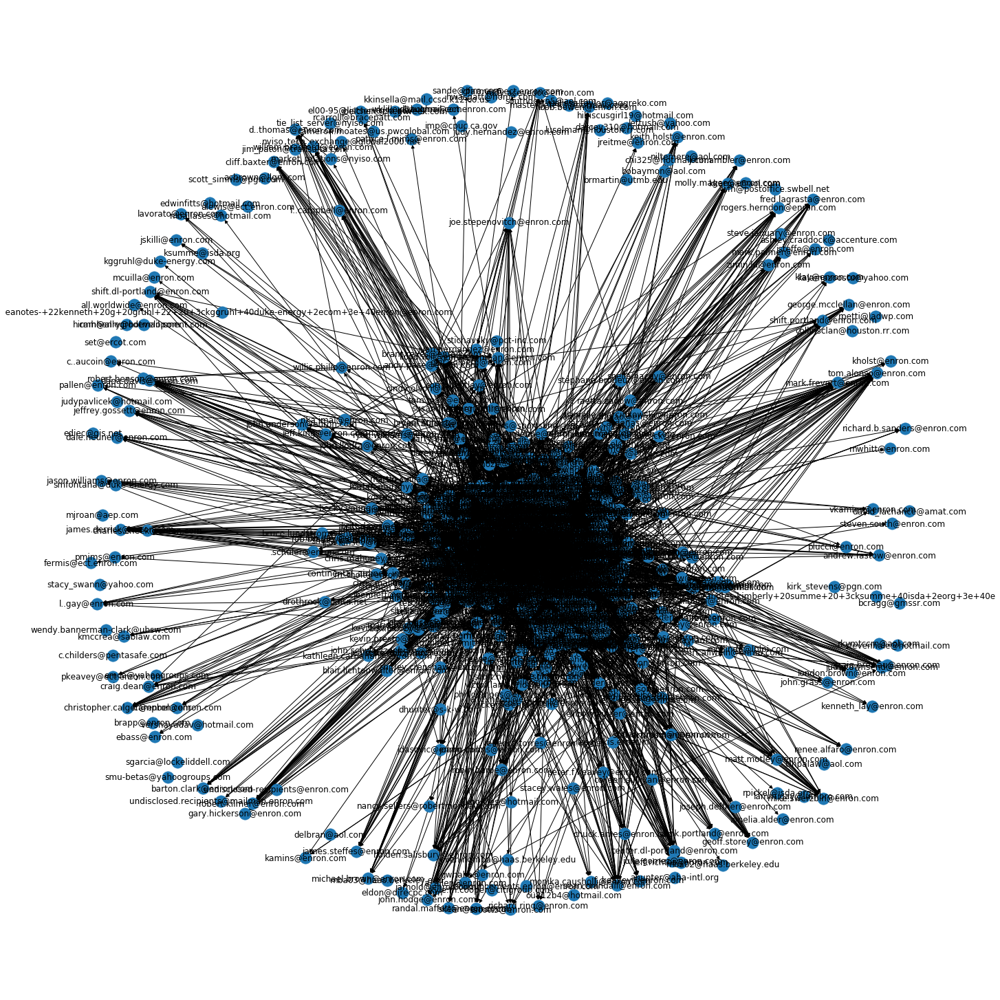

In [44]:
import matplotlib.pyplot as plt
%matplotlib inline

l = [n for n,degree in dict(g.degree()).items() if degree > 10]
h = g.subgraph(l)
plt.figure(figsize=(20,20))
nx.write_gml(h, "./datasets/enron/maildir/network.gml")
nx.draw_spring(h, with_labels=True)

Let's find the employees with the highest degree:

In [45]:
import operator
h_employees = sorted(dict(g.degree()).items(), key=operator.itemgetter(1), reverse=True)
h_employees[:10]

[('jeff.dasovich@enron.com', 683),
 ('sara.shackleton@enron.com', 641),
 ('tana.jones@enron.com', 584),
 ('gerald.nemec@enron.com', 534),
 ('kay.mann@enron.com', 471),
 ('kenneth.lay@enron.com', 466),
 ('vince.kaminski@enron.com', 434),
 ('debra.perlingiere@enron.com', 420),
 ('sally.beck@enron.com', 369),
 ('jeff.skilling@enron.com', 363)]

From [cross-referencing](http://www.inf.ed.ac.uk/teaching/courses/tts/assessed/roles.txt) the highest degree employees with  their organization roles,
we can observe that the list includes both the company CEO and some of the company management.

Let's find the network's communities and find employees that are connected to the highest number of communities:

In [46]:
from networkx.algorithms.community import greedy_modularity_communities
cc = greedy_modularity_communities(g.to_undirected())

# add the community each node belong to
for i in range(len(cc)):
    c = cc[i]
    if len(c) < 2:
        continue # skip this community
    for n in c:
        g.nodes[n]['community'] = i 

node_communities_num_dict = {}
for v in g.nodes():
    connected_communities = [g.nodes[u]['community'] for u in g.neighbors(v) if 'community' in g.nodes[u]]
    node_communities_num_dict[v] = len(set(connected_communities))

c_employees = sorted(node_communities_num_dict.items(), key=operator.itemgetter(1), reverse=True)
c_employees[:10] 

[('tana.jones@enron.com', 21),
 ('kay.mann@enron.com', 20),
 ('elizabeth.sager@enron.com', 20),
 ('mark.taylor@enron.com', 20),
 ('sara.shackleton@enron.com', 18),
 ('mark.haedicke@enron.com', 15),
 ('richard.sanders@enron.com', 15),
 ('steven.kean@enron.com', 14),
 ('benjamin.rogers@enron.com', 14),
 ('sally.beck@enron.com', 13)]

In [47]:
set([e[0] for e in c_employees[:10]]) - set([e[0] for e in h_employees[:10]])

{'benjamin.rogers@enron.com',
 'elizabeth.sager@enron.com',
 'mark.haedicke@enron.com',
 'mark.taylor@enron.com',
 'richard.sanders@enron.com',
 'steven.kean@enron.com'}

We can see that finding vertices that are connected to the highest number of communities ranked some key employees (VPs) higher. In the past, we found using machine learning and network centrality properties to be an efficient way to [identify managers in organizational network](https://www.researchgate.net/profile/Michael_Fire/publication/256326703_Organization_Mining_Using_Online_Social_Networks/links/0046353bc52a153940000000/Organization-Mining-Using-Online-Social-Networks.pdf) and to [identifying malicious profiles in social networks](http://www.academia.edu/download/13963288/fake_ieee.pdf).

Another [interesting method for identify an Anomalous vertices](https://pdfs.semanticscholar.org/5b45/6027eb4296c4806c8ea7f46716ce2f3680fd.pdf) is by identifying vertices with many links that have relative low probabilities of existing.
Overall, we can use networks and machine learning as useful tools to identify interesting and useful patterns in data.

## Example 4 - Network Embedding
Combing new algorithms for embedding vertices, links, and networks, with machine learning algorithms can be very useful to tackle various tasks. In this example, we will use the [Karateclub package](https://github.com/benedekrozemberczki/karateclub), and use it to analyze [Marvel Universe Social Network](https://www.kaggle.com/csanhueza/the-marvel-universe-social-network#edges.csv):

In [48]:
!pip install karateclub

     |████████████████████████████████| 1.8MB 123kB/s eta 0:00:01
     |████████████████████████████████| 24.7MB 129kB/s eta 0:00:01
     |████████████████████████████████| 71kB 163kB/s eta 0:00:01
     |████████████████████████████████| 133kB 191kB/s eta 0:00:01
     |████████████████████████████████| 71kB 260kB/s eta 0:00:011
     |████████████████████████████████| 6.0MB 97kB/s eta 0:00:012
  Created wheel for karateclub: filename=karateclub-0.45.27-cp36-none-any.whl size=58989 sha256=8ad4d3b34723eb6cb93f25feff2ca45b73d1a5cd3831cf061fc23ff1a90848aa
  Stored in directory: /Users/michael/Library/Caches/pip/wheels/2d/d1/47/ea066f44a277c80f2e6e63f0564982b4f037dbae1968f537ab
  Created wheel for python-louvain: filename=python_louvain-0.13-cp36-none-any.whl size=9224 sha256=e02a5f405a49f9aaa1e247c49a60129cec3ad16e953453dce30c733cec88bae6
  Stored in directory: /Users/michael/Library/Caches/pip/wheels/f9/74/a9/14f051b00dddd46d71529db15507796da13a43ee2c0bc39def
  Created wheel for smart-open

In [49]:
import networkx as nx
import turicreate as tc 


e_sf = tc.SFrame.read_csv("./datasets/the-marvel-universe-social-network/hero-network.csv")
g = nx.Graph() # Creating Undirected Graph
# adding all nodes and vertices at once
g.add_edges_from([(r['hero1'],r['hero2']) for r in e_sf])
print(nx.info(g))

Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/the-marvel-universe-social-network/hero-network.csv

Parsing completed. Parsed 100 lines in 0.359907 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/michael/Dropbox (BGU)/massive data mining/ 2020/notebooks/datasets/the-marvel-universe-social-network/hero-network.csv

Parsing completed. Parsed 574467 lines in 0.412592 secs.

Name: 
Type: Graph
Number of nodes: 6426
Number of edges: 167219
Average degree:  52.0445


In [50]:
print(nx.info(g))

Name: 
Type: Graph
Number of nodes: 6426
Number of edges: 167219
Average degree:  52.0445


Let's convert the network from nodes represented by string to network with nodes represented by numbers:

In [51]:
?zip

In [52]:
l =  zip(g.nodes(), range(len(g.nodes())))
l = list(l)
l[:10]

[('LITTLE, ABNER', 0),
 ('PRINCESS ZANDA', 1),
 ("BLACK PANTHER/T'CHAL", 2),
 ('STEELE, SIMON/WOLFGA', 3),
 ('FORTUNE, DOMINIC', 4),
 ('ERWIN, CLYTEMNESTRA', 5),
 ('IRON MAN/TONY STARK ', 6),
 ('IRON MAN IV/JAMES R.', 7),
 ('RAVEN, SABBATH II/EL', 8),
 ('CARNIVORE/COUNT ANDR', 9)]

In [53]:
nodes_dict = dict(l)
r_node_dict = {v:k for k,v in nodes_dict.items()}
list(r_node_dict.items())[:10]

[(0, 'LITTLE, ABNER'),
 (1, 'PRINCESS ZANDA'),
 (2, "BLACK PANTHER/T'CHAL"),
 (3, 'STEELE, SIMON/WOLFGA'),
 (4, 'FORTUNE, DOMINIC'),
 (5, 'ERWIN, CLYTEMNESTRA'),
 (6, 'IRON MAN/TONY STARK '),
 (7, 'IRON MAN IV/JAMES R.'),
 (8, 'RAVEN, SABBATH II/EL'),
 (9, 'CARNIVORE/COUNT ANDR')]

In [54]:
h = nx.Graph()
for e1,e2 in g.edges():
  h.add_edge(nodes_dict[e1], nodes_dict[e2])
print(nx.info(g))
print(nx.info(h))

Name: 
Type: Graph
Number of nodes: 6426
Number of edges: 167219
Average degree:  52.0445
Name: 
Type: Graph
Number of nodes: 6426
Number of edges: 167219
Average degree:  52.0445


In [55]:
import karateclub

model = karateclub.DeepWalk()

model.fit(h)
embedding = model.get_embedding()
embedding

array([[-2.5230888e-01,  2.1942803e-01,  3.9325047e-01, ...,
         8.0445331e-01,  8.6050415e-01,  5.6829518e-01],
       [-6.4737716e-04, -3.0545467e-01, -4.9890757e-01, ...,
         7.1850640e-01,  1.2542717e-01, -3.6118843e-02],
       [-8.6070493e-02, -8.7616992e-01, -1.2812385e-01, ...,
        -3.3246413e-01,  2.0374957e-01, -1.3656873e-01],
       ...,
       [ 4.5686007e-01, -8.5251468e-01, -1.3106056e+00, ...,
        -2.7054662e-01,  5.0023836e-01,  3.3003602e-02],
       [-3.5845125e-01, -3.8729647e-01, -1.4844893e+00, ...,
        -4.4031414e-01,  2.6876664e-02, -6.6099894e-01],
       [-2.3275574e-01, -2.5555986e-01, -1.0960025e+00, ...,
        -1.7732528e-01,  2.7379677e-01, -2.6486269e-01]], dtype=float32)

Let's find the node that is most similar to Spiderman:

In [56]:
v_num = nodes_dict['SPIDER-MAN/PETER PAR']
spidermane_vec = embedding[v_num]
spidermane_vec

array([ 0.19827282,  0.13032648,  0.72196484,  0.43101284, -0.8846227 ,
       -0.727539  , -0.35108215, -0.1711583 ,  0.09590934,  0.9597193 ,
        0.03184221,  0.0617909 ,  0.14822243, -1.1702482 ,  0.10078843,
       -0.07806872, -0.20651299,  0.38594657, -0.09394898, -0.6628536 ,
        0.42972386,  0.09866206,  0.13831659,  0.10098277, -0.09144103,
       -0.00866084, -0.06907464,  1.0177587 ,  0.30289915, -0.26135647,
        0.18501773, -0.41467813, -0.25721902, -0.83799565, -0.11560664,
        0.8847891 , -0.43046832,  0.26269603,  0.00659289, -0.5196305 ,
       -0.8598284 ,  0.7953562 , -0.9247003 , -0.04753971,  0.26688823,
        0.20745671,  1.0298038 ,  0.7505756 ,  0.8044109 , -0.46253362,
       -0.19486125, -0.37960613,  0.04198214, -0.37185225, -0.92459714,
       -0.65314627, -0.42800704,  0.08757861, -0.18766505,  0.502004  ,
       -0.28240997, -0.36110273, -0.28608617,  0.02847825, -0.03159843,
        0.15497266, -0.01810539, -0.27789897, -0.07285538,  0.12

In [57]:
# more details in https://stackoverflow.com/questions/32446703/find-closest-vector-from-a-list-of-vectors-python 
# and 
from scipy import spatial
tree = spatial.KDTree(embedding)


In [58]:
tree.query(x=spidermane_vec, k=3)


(array([0.        , 4.92906105, 5.24917978]), array([ 48, 152, 160]))

We can see that nodes 152 and 160 are the closest to Spiderman, let's look who they are:

In [59]:
r_node_dict[152]

'WATSON-PARKER, MARY '

In [60]:
r_node_dict[160]

'JAMESON, J. JONAH'

Let's use [t-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding) to perform dimensionality reduction of each node's vector to plot the nodes in 2D:

In [61]:
import numpy as np
import pandas as pd
from sklearn.manifold import TSNE

X = embedding
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2,perplexity=20, n_iter=5000, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)


Computed X:  (6426, 128)
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 6426 samples in 0.028s...
[t-SNE] Computed neighbors for 6426 samples in 9.601s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6426
[t-SNE] Computed conditional probabilities for sample 2000 / 6426
[t-SNE] Computed conditional probabilities for sample 3000 / 6426
[t-SNE] Computed conditional probabilities for sample 4000 / 6426
[t-SNE] Computed conditional probabilities for sample 5000 / 6426
[t-SNE] Computed conditional probabilities for sample 6000 / 6426
[t-SNE] Computed conditional probabilities for sample 6426 / 6426
[t-SNE] Mean sigma: 2.431555
[t-SNE] Computed conditional probabilities in 0.203s
[t-SNE] Iteration 50: error = 95.7192612, gradient norm = 0.1105676 (50 iterations in 5.615s)
[t-SNE] Iteration 100: error = 93.7761459, gradient norm = 0.0743413 (50 iterations in 4.093s)
[t-SNE] Iteration 150: error = 93.2534790, gradient norm = 0.0581694 (50 iterations in 4.454s)
[t-SNE

[t-SNE] Iteration 4000: error = 1.3001302, gradient norm = 0.0000363 (50 iterations in 2.519s)
[t-SNE] Iteration 4050: error = 1.2998954, gradient norm = 0.0000397 (50 iterations in 2.500s)
[t-SNE] Iteration 4100: error = 1.2996739, gradient norm = 0.0000338 (50 iterations in 2.419s)
[t-SNE] Iteration 4150: error = 1.2994212, gradient norm = 0.0000369 (50 iterations in 2.424s)
[t-SNE] Iteration 4200: error = 1.2992495, gradient norm = 0.0000356 (50 iterations in 2.505s)
[t-SNE] Iteration 4250: error = 1.2990921, gradient norm = 0.0000345 (50 iterations in 2.631s)
[t-SNE] Iteration 4300: error = 1.2988284, gradient norm = 0.0000375 (50 iterations in 2.834s)
[t-SNE] Iteration 4350: error = 1.2986108, gradient norm = 0.0000340 (50 iterations in 2.781s)
[t-SNE] Iteration 4400: error = 1.2984010, gradient norm = 0.0000367 (50 iterations in 2.670s)
[t-SNE] Iteration 4450: error = 1.2982188, gradient norm = 0.0000275 (50 iterations in 2.549s)
[t-SNE] Iteration 4500: error = 1.2979944, gradien

In [62]:
df = pd.DataFrame(columns=['x', 'y', 'name'])
df['x'], df['y'], df['name'] = X_embedded[:,0], X_embedded[:,1], [r_node_dict[i] for i in range(len(h.nodes()))]
df

,x,y,name
0,-67.128647,26.735348,"LITTLE, ABNER"
1,-67.196983,26.665539,PRINCESS ZANDA
2,8.755240,7.400807,BLACK PANTHER/T'CHAL
3,-47.913811,-17.693964,"STEELE, SIMON/WOLFGA"
4,-47.976772,-17.585226,"FORTUNE, DOMINIC"
...,...,...,...
6421,-59.862041,-68.874100,BLACKWULF
6422,-59.714642,-68.938393,"JILLETE, RANDI"
6423,-59.715588,-68.878082,"JENKINS, WALTER"
6424,-68.148941,-62.327248,"WAGNER, ERNIE WHACK"


In [63]:
import plotly.express as px
%matplotlib inline

fig = px.scatter(df, x="x", y="y", hover_name="name")
fig.show()


In [64]:
selected_heros = [n for n, deg in g.degree() if deg > 200]
df2 = df[df['name'].isin(selected_heros)]
df2


,x,y,name
2,8.755240,7.400807,BLACK PANTHER/T'CHAL
6,7.861028,10.275428,IRON MAN/TONY STARK
7,-59.643700,40.364540,IRON MAN IV/JAMES R.
17,40.234772,44.918255,"ROM, SPACEKNIGHT"
23,15.975105,-5.468272,MYSTIQUE/RAVEN DARKH
...,...,...,...
2395,67.429108,78.170242,GUARDIAN/JAMES MACDO
2586,62.153511,21.837105,SILHOUETTE
2699,73.867767,-84.398773,"MADDICKS, ARTHUR ART"
2984,68.760399,-88.057838,CHAMBER/JONOTHON STA


In [65]:
import plotly.express as px
%matplotlib inline

fig = px.scatter(df2, x="x", y="y", hover_name="name")
fig.show()


## Further Readings
* Fire, Michael, et al. "[Link prediction in social networks using computationally efficient topological features](http://www.ise.bgu.ac.il/faculty/liorr/conf5.pdf),” 2011

* Altshuler, Yaniv, et al. "[How many makes a crowd? On the evolution of learning as a factor of community coverage](http://web.media.mit.edu/~yanival/SBP-How_many_makes_a_crowd.pdf)." International Conference on Social  Computing, Behavioral-Cultural Modeling, and Prediction. Springer, Berlin, Heidelberg, 2012.

* Fire, Michael, et al. "[Predicting student exam’s scores by analyzing social network data](http://www.ise.bgu.ac.il/faculty/liorr/fire2012predicting.pdf)." International Conference on Active Media Technology. Springer, Berlin, Heidelberg, 2012

* Fire, Michael, and Yuval Elovici. "[Data mining of online genealogy datasets for revealing lifespan patterns in human population](http://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.764.2039&rep=rep1&type=pdf)." ACM Transactions on Intelligent Systems and Technology (TIST) 6.2 (2015): 28


* Fire, Michael, and Rami Puzis. "[Organization mining using online social networks](http://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.759.185&rep=rep1&type=pdf)." Networks and Spatial Economics 16.2 (2016): 545-578 


* Kagan, Dima, Yuval Elovichi, and Michael Fire. "[Generic anomalous vertices detection utilizing a link prediction algorithm.](https://arxiv.org/pdf/1610.07525.pdf)" Social Network Analysis and Mining 8.1 (2018): 27

* Primož Godec, [Graph Embeddings — The Summary](https://towardsdatascience.com/graph-embeddings-the-summary-cc6075aba007)

 